In [1]:
import os

os.chdir("./content")

lm_dir = "tf-levenberg-marquardt"
if not os.path.exists(lm_dir):
  !git clone https://github.com/fabiodimarco/$lm_dir

os.chdir(lm_dir)

In [2]:
!pip install --upgrade pip
!pip install tensorflow 
!pip install openpyxl
!pip install RegscorePy

/tmp/ipykernel_214690/1105938615.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


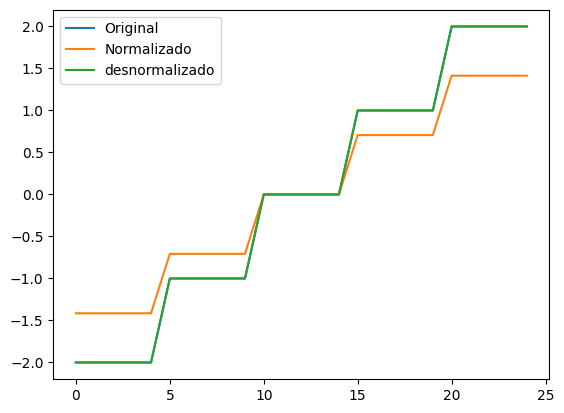

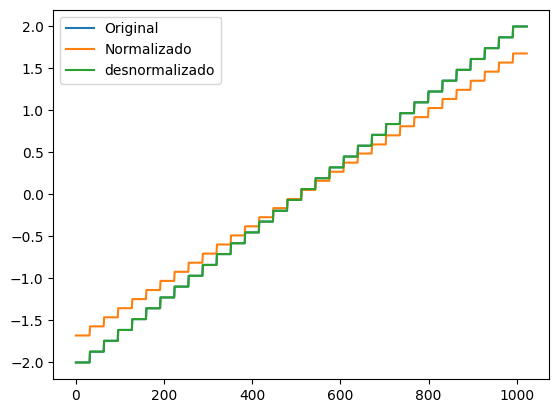

In [3]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

scaler = StandardScaler()
out_scaler = StandardScaler()

def peaks(grid):
    x = np.linspace(-2, 2, grid)
    y = np.linspace(-2, 2, grid)
    x, y = np.meshgrid(x, y)
    z = 3*(1-x)**2 * np.exp(-(x**2) - (y+1)**2) - 10*(x/5 - x**3 - y**5) * np.exp(-x**2 - y**2) - 1/3 * np.exp(-(x+1)**2 - y**2)
    return x, y, z

def create_dataframe(grid):
   x, y, z = peaks(grid)
   data = {'X': x.flatten(), 'Y': y.flatten(), 'Z': z.flatten()}
   df = pd.DataFrame(data)
   return df

def show_norm(df, label="Peaks", plot=False):
    df_norm = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)
    df_denorm = pd.DataFrame(scaler.inverse_transform(df_norm), columns=df_norm.columns)

    if (plot):
        df.plot(title=f"{label}: Original data")
        df_norm.plot(title=f"{label}: Normalized data")
        df_denorm.plot(title=f"{label}: Denormalized data")
    return (df_norm)


def test_out_scaler(df):
    out = df["Y"].values.reshape(-1, 1)  
    plt.plot(out, label='Original')
    out_scaler.fit(out)
    norm = out_scaler.transform(out)
    plt.plot(norm, label='Normalizado')
    plt.plot(out_scaler.inverse_transform(norm), label='desnormalizado')
    plt.legend()
    plt.show()


df_25 = create_dataframe(grid=5)
df_25_norm = show_norm(df_25)
test_out_scaler(df_25)

df_1000 = create_dataframe(grid=32)
df_1000_norm = show_norm(df_1000)
test_out_scaler(df_1000)



In [4]:
def split_df(df):
    _input = np.vstack([df['X'], df['Y']]).T
    _output = np.array(df['Z'])
    return (_input, _output)

In [5]:
import tensorflow as tf
import numpy as np
from keras import regularizers
from keras import initializers
import levenberg_marquardt as lm

# layers, neurons
class ShuffleArchitecture:
    def __init__(self, input_size, hidden_sizes, output_size, act_h, act_o, param_reg):
        self.input_size = input_size
        self.hidden_sizes = hidden_sizes
        self.output_size = output_size
        self.act_h = act_h
        self.act_o = act_o
        self.regularizer = regularizers.L2(param_reg)
        self.initializer = initializers.RandomUniform(minval=-0.5, maxval=0.5, seed=np.random.randint(1, 10000))

    def compute_k(self):
        total_parameters = 0
        for layer in self.model.layers:
            weights = layer.get_weights()
            if len(weights) > 0:  
                for w in weights:
                    total_parameters += np.prod(w.shape)
        return total_parameters
        
    def set_architecture(self):
        self.model = tf.keras.Sequential()
        self.model.add(tf.keras.layers.Dense(self.hidden_sizes[0],
                        input_shape=(self.input_size,),
                        activation=self.act_h,
                        kernel_regularizer=self.regularizer,
                        kernel_initializer=self.initializer,                        
                        ))  # input layer

        for size in self.hidden_sizes[1:]:  # hidden layers
            self.model.add(tf.keras.layers.Dense(size,
                            activation=self.act_h,
                            kernel_regularizer=self.regularizer,
                            kernel_initializer=self.initializer,  
                        ))

        self.model.add(tf.keras.layers.Dense(self.output_size,
                        activation=self.act_o,
                        kernel_regularizer=self.regularizer,
                        kernel_initializer=self.initializer,  
                        ))  # output layer

    def create_model(self, _learning_rate):
        self.model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=_learning_rate),
            loss=tf.keras.losses.MeanSquaredError())

        self.lm_model = lm.ModelWrapper(
            tf.keras.models.clone_model(self.model))

        self.lm_model.compile(
            optimizer=tf.keras.optimizers.SGD(learning_rate=_learning_rate),
            loss=lm.MeanSquaredError())
        return(self.lm_model)

2024-05-03 21:18:38.493939: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-05-03 21:18:38.536853: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-03 21:18:38.536898: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-03 21:18:38.537925: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-05-03 21:18:38.544133: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-05-03 21:18:38.544679: I tensorflow/core/platform/cpu_feature_guard.cc:1

In [6]:
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping
from sklearn.metrics import r2_score, mean_squared_error, root_mean_squared_error, mean_absolute_percentage_error 

class TrainWithSmallDataset:
    def __init__(self, batch_size=1000):
        self.batch_size = batch_size
        self.betters = []
        self.k = 0

    def create_dataset(self, input, output):
      input = tf.expand_dims(tf.cast(input, tf.float32), axis=-1)
      output = tf.expand_dims(tf.cast(output, tf.float32), axis=-1)
      dataset = tf.data.Dataset.from_tensor_slices((input, output))
      dataset = dataset.shuffle(len(input))
      dataset = dataset.batch(self.batch_size).cache()
      dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)
      return (dataset, input, output)

    def split_dataset(self, input, output, sup_input, sup_output):
      input_train, input_vt, output_train, output_vt = train_test_split(input, output, test_size=0.3, shuffle = True)
      input_val, input_test, output_val, output_test = train_test_split(input_vt, output_vt, test_size=0.5, shuffle = True)

      self.train_dataset, self.train_input, self.train_output = self.create_dataset(input_train, output_train)
      self.val_dataset, self.val_input, self.val_output = self.create_dataset(input_val, output_val)
      self.test_dataset, self.test_input, self.test_output = self.create_dataset(input_test, output_test)
      self.vt_dataset, self.vt_input, self.vt_output = self.create_dataset(input_vt, output_vt)
      self.sup_dataset, self.sup_input, self.sup_output = self.create_dataset(sup_input, sup_output)
      self.dataset, self.input, self.output = self.create_dataset(input, output)

      self._data = (input, output)
      self._train = (input_train, output_train)
      self._vt = (input_vt, output_vt)
      self._val = (input_val, output_val)
      self._test = (input_test, output_test)
      self._sup = (sup_input, sup_output)

    def train_using_lm(self, train_dataset, epochs=1000):
      early_stopping_monitor = EarlyStopping(monitor='val_loss',
                                              patience=6,
                                              restore_best_weights=True)

      self.results = self.lm_model.fit(train_dataset,
                                            epochs=epochs,
                                            validation_data=self.val_dataset,
                                            callbacks=[early_stopping_monitor],
                                            verbose=0)
      print ("Stopped at epoch: ", early_stopping_monitor.stopped_epoch)
    
    def get_new_metrics(self, orig, pred, r2, mse):
      n = len(orig) # N: quantidade de saidas
      k = self.k
      waste = (orig.flatten() - pred.flatten())

      mape = mean_absolute_percentage_error(orig, pred)  
      r2_adj = 1 - (((n - 1)/(n - k - 1)) * (1 - r2))
      rsd = np.sqrt(np.sum(waste ** 2) / (n - 2))
      rmse = root_mean_squared_error(orig, pred)          
      aic = (-2 * np.log(mse)) + (2 * k)
      bic = (-2 * np.log(mse)) + (k * np.log(n))
      return (mape, r2_adj, rsd, rmse, aic, bic)
      

    def get_metrics(self):
          # Calculando a saida com os dados normalizados
          pred = self.lm_model.predict(self.input).flatten()
          test_pred = self.lm_model.predict(self.test_input).flatten()
          val_pred = self.lm_model.predict(self.val_input).flatten()
          vt_pred = self.lm_model.predict(self.vt_input).flatten()
          sup_pred = self.lm_model.predict(self.sup_input).flatten()

          # Calculando as metricas com a saida desnormalizada
          pred_denorm = out_scaler.inverse_transform(pred.reshape(-1, 1))
          test_pred_denorm = out_scaler.inverse_transform(test_pred.reshape(-1, 1))
          val_pred_denorm = out_scaler.inverse_transform(val_pred.reshape(-1, 1))
          vt_pred_denorm = out_scaler.inverse_transform(vt_pred.reshape(-1, 1))
          sup_pred_denorm = out_scaler.inverse_transform(sup_pred.reshape(-1, 1))

          out_denorm = out_scaler.inverse_transform(self._data[1].reshape(-1, 1))
          test_denorm = out_scaler.inverse_transform(self._test[1].reshape(-1, 1))
          val_denorm = out_scaler.inverse_transform(self._val[1].reshape(-1, 1))
          vt_denorm = out_scaler.inverse_transform(self._vt[1].reshape(-1, 1))    
          sup_denorm = out_scaler.inverse_transform(self._sup[1].reshape(-1, 1))

          r2 = r2_score(out_denorm, pred_denorm)
          r2_test = r2_score(test_denorm, test_pred_denorm)
          r2_val = r2_score(val_denorm, val_pred_denorm)
          r2_vt = r2_score(vt_denorm,  vt_pred_denorm)
          r2_sup = r2_score(sup_denorm,  sup_pred_denorm)

          mse = mean_squared_error(out_denorm, pred_denorm)
          mse_test = mean_squared_error(test_denorm, test_pred_denorm)
          mse_val = mean_squared_error(val_denorm, val_pred_denorm)
          mse_vt = mean_squared_error(vt_denorm,  vt_pred_denorm)
          mse_sup = mean_squared_error(sup_denorm,  sup_pred_denorm)
          
          mape, r2_adj, rsd, rmse, aic, bic = self.get_new_metrics(out_denorm, pred_denorm, r2, mse)
          metrics = {
                          'r2': r2,
                          'r2_sup': r2_sup,
                          'r2_test': r2_test,
                          'r2_val': r2_val,
                          'r2_vt': r2_vt,
                          'mse': mse,
                          'mse_sup': mse_sup,
                          'mse_test': mse_test,
                          'mse_val': mse_val,
                          'mse_vt': mse_vt,
                          'mape': mape,
                          'rmse': rmse,
                          'r2_adj': r2_adj,
                          'rsd': rsd,
                          'aic': aic,
                          'bic': bic
                          }

          return metrics

In [7]:
import pickle
from itertools import product

class Tester:
  def __init__(self, run_times=500, dataset_run_times=10):
    self.run_times = run_times
    self.better_metrics = {}
    self.dataset_run_times = dataset_run_times
    self.input_25, self.output_25 = split_df(df_25_norm)
    self.input_1000, self.output_1000 = split_df(df_1000_norm)
  
  def setArchitecure(self, trainer, _hidden_sizes, _pg, _lr):
    shuffler = ShuffleArchitecture(input_size=2,
                                    hidden_sizes=_hidden_sizes,
                                    output_size=1,
                                    act_h='tanh',
                                    act_o='linear',
                                    param_reg=_pg)
    shuffler.set_architecture()    
    trainer.lm_model = shuffler.create_model(_lr)
    trainer.k = shuffler.compute_k()

  def Train(self, trainer, epochs=1000):
    trainer.train_using_lm(trainer.train_dataset, epochs=epochs)
    return(trainer.get_metrics(), trainer.lm_model)

  def SaveModelWeights(self, model, fileName):
    path = f"../models/{fileName}.keras"
    open(path,'w').close()
    model.save_weights(path)

  def SaveDataset(self, trainer, fileName):
    path = f"../dataset/{fileName}.pkl" 
    with open(path, 'wb') as f:
      pickle.dump((trainer._data, trainer._train, trainer._vt, trainer._val, trainer._test), f)
      
  def LoopWeights(self, sort_by, boundarie, trainer, idx):
    better_model = 0
    save = False

    for i in range(self.run_times):
      print (f"+++++++++++ [{idx}] | {i + 1} ++++++++++++++++++")
      metrics, model = self.Train(trainer)
      if (metrics[sort_by] <= boundarie): # should be >= to acsending metrics
        fileName = f"model_{idx}_{better_model}"
        self.SaveModelWeights(model, fileName)
        self.better_metrics[fileName] = metrics
        better_model += 1
        save = True
    return(save)

  def Loop(self, sort_by, boundarie, hidden_sizes, regularizers, learning_rate):
    trainer = TrainWithSmallDataset()

    for count, (hidden_size, reg, lr) in enumerate(product(hidden_sizes, regularizers, learning_rate), start=1):
      header =  f"Hidden Size={hidden_size}, regularizer={reg}, learning_rate={lr}"
      print(f"Testando combinacao{count}: {header}")
      self.setArchitecure(trainer, hidden_size, reg, lr)
      for j in range(self.dataset_run_times):
        trainer.split_dataset(self.input_25, self.output_25, self.input_1000, self.output_1000)
        if (self.LoopWeights(sort_by, boundarie, trainer, f"{count}_{j}") == True):
          self.SaveDataset(trainer, f"dataset_{count}_{j}")
          self.DisplayBetterResults('mse_sup', header, f"{count}_{j}")
        self.better_metrics = {}

  def DisplayBetterResults(self, sort_by, header, dataset=0):
    df = pd.DataFrame.from_dict(self.better_metrics, orient='index')
    df = df.sort_values([sort_by])
    display(df)
    path = f'../results/metrics_{dataset}'
    df.to_excel(f"{path}.xlsx", index=True)
    print(f"DataFrame salvo em {path}")
    with open(f"{path}.txt", 'w') as arquivo:
      arquivo.write(header)

# Treinando com 25 dados


In [8]:
tester = Tester(run_times=25, dataset_run_times=10)
tester.Loop(sort_by='mse_sup',
            boundarie = 0.5,
            hidden_sizes = [[40, 39], [20, 4], [15, 14], [26,18], [33, 21], [21, 12], [30, 21], [15, 2], [24, 7], [30, 16]],
            regularizers=[0.2, 0.0, 0.2, 0.5],
            learning_rate=[0.01, 0.1])

Testando combinacao1: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.01
+++++++++++ [1_0] | 1 ++++++++++++++++++


Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_3_13,0.784250,0.702963,0.464911,0.774312,0.737346,0.306226,0.421601,0.187896,0.176647,0.182271,1.047984,0.553377,1.002984,0.576935,3520.366866,5664.369442
model_1_3_12,0.780045,0.699632,0.457707,0.770078,0.733135,0.312194,0.426329,0.190426,0.179961,0.185193,1.058441,0.558743,1.003043,0.582530,3520.328260,5664.330836
model_1_3_11,0.775743,0.696213,0.450311,0.765640,0.728762,0.318301,0.431181,0.193023,0.183434,0.188228,1.069015,0.564182,1.003102,0.588200,3520.289516,5664.292092
model_1_3_10,0.771341,0.692705,0.442721,0.760994,0.724222,0.324548,0.436161,0.195688,0.187070,0.191379,1.079711,0.569691,1.003163,0.593944,3520.250642,5664.253218
model_1_3_9,0.766838,0.689105,0.434940,0.756135,0.719513,0.330939,0.441271,0.198420,0.190873,0.194647,1.090531,0.575273,1.003225,0.599764,3520.211641,5664.214217
model_1_3_8,0.762233,0.685411,0.426970,0.751058,0.714633,0.337476,0.446513,0.201219,0.194847,0.198033,1.101473,0.580927,1.003289,0.605658,3520.172522,5664.175097
model_1_3_7,0.757523,0.681622,0.418812,0.745759,0.709581,0.344162,0.451892,0.204084,0.198994,0.201539,1.113000,0.586653,1.003354,0.611628,3520.133288,5664.135864
model_1_3_6,0.752706,0.677735,0.410467,0.740234,0.704354,0.350998,0.457408,0.207014,0.203319,0.205167,1.125432,0.592451,1.003421,0.617673,3520.093950,5664.096526
model_1_3_5,0.747781,0.673749,0.401943,0.734476,0.698950,0.357988,0.463065,0.210007,0.207826,0.208916,1.138008,0.598321,1.003489,0.623793,3520.054510,5664.057086
model_1_3_4,0.742746,0.669662,0.393245,0.728482,0.693369,0.365135,0.468866,0.213061,0.212517,0.212789,1.150729,0.604264,1.003559,0.629988,3520.014978,5664.017554


DataFrame salvo em ../results/metrics_1_3
+++++++++++ [1_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_4_24,0.875779,0.778855,0.789731,0.918680,0.922867,0.176314,0.313883,0.023536,0.108790,0.066163,0.798206,0.419897,1.001718,0.437773,3521.470982,5665.473558
model_1_4_23,0.873139,0.776784,0.779196,0.916764,0.920685,0.180061,0.316822,0.024715,0.111354,0.068034,0.805587,0.424336,1.001755,0.442401,3521.428917,5665.431493
model_1_4_22,0.870427,0.774647,0.767976,0.914728,0.918366,0.183910,0.319856,0.025971,0.114077,0.070024,0.813041,0.428848,1.001792,0.447105,3521.386614,5665.389190
model_1_4_21,0.867642,0.772441,0.756055,0.912570,0.915905,0.187863,0.322987,0.027305,0.116965,0.072135,0.820572,0.433432,1.001831,0.451884,3521.344080,5665.346656
model_1_4_20,0.864782,0.770164,0.743413,0.910285,0.913298,0.191923,0.326218,0.028720,0.120021,0.074371,0.828249,0.438090,1.001870,0.456740,3521.301323,5665.303899
model_1_4_19,0.861845,0.767816,0.730032,0.907871,0.910543,0.196091,0.329551,0.030218,0.123250,0.076734,0.837647,0.442822,1.001911,0.461673,3521.258353,5665.260929
model_1_4_18,0.858830,0.765394,0.715896,0.905325,0.907635,0.200370,0.332989,0.031800,0.126657,0.079229,0.847140,0.447627,1.001953,0.466684,3521.215177,5665.217753
model_1_4_17,0.855735,0.762897,0.700987,0.902642,0.904570,0.204763,0.336534,0.033469,0.130247,0.081858,0.856736,0.452507,1.001996,0.471771,3521.171806,5665.174382
model_1_4_16,0.852559,0.760322,0.685283,0.899819,0.901344,0.209271,0.340188,0.035226,0.134023,0.084625,0.866425,0.457462,1.002040,0.476937,3521.128247,5665.130823
model_1_4_15,0.849299,0.757669,0.668768,0.896853,0.897953,0.213899,0.343954,0.037075,0.137991,0.087533,0.876222,0.462492,1.002085,0.482181,3521.084506,5665.087082


DataFrame salvo em ../results/metrics_1_4
+++++++++++ [1_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_5_24,0.909574,0.803905,0.053380,0.947842,0.914597,0.128347,0.278329,0.208683,0.259259,0.233971,0.647595,0.358256,1.001251,0.373507,3522.106035,5666.108611
model_1_5_23,0.908567,0.803206,0.052690,0.947442,0.914206,0.129776,0.279321,0.208836,0.261249,0.235043,0.652776,0.360244,1.001265,0.375581,3522.083889,5666.086465
model_1_5_22,0.907537,0.802486,0.051984,0.947028,0.913802,0.131238,0.280342,0.208991,0.263305,0.236148,0.658000,0.362268,1.001279,0.377691,3522.061480,5666.064056
model_1_5_21,0.906483,0.801747,0.051262,0.946601,0.913385,0.132734,0.281392,0.209150,0.265429,0.237290,0.663263,0.364327,1.001294,0.379838,3522.038810,5666.041385
model_1_5_20,0.905404,0.800986,0.050526,0.946160,0.912955,0.134265,0.282472,0.209313,0.267623,0.238468,0.668569,0.366422,1.001309,0.382022,3522.015876,5666.018452
model_1_5_19,0.904300,0.800203,0.049773,0.945704,0.912511,0.135832,0.283583,0.209479,0.269889,0.239684,0.673915,0.368554,1.001324,0.384244,3521.992676,5665.995252
model_1_5_18,0.903171,0.799398,0.049006,0.945232,0.912053,0.137435,0.284725,0.209648,0.272232,0.240940,0.679303,0.370722,1.001339,0.386505,3521.969209,5665.971785
model_1_5_17,0.902015,0.798570,0.048222,0.944745,0.911580,0.139076,0.285901,0.209821,0.274652,0.242236,0.684734,0.372928,1.001355,0.388805,3521.945476,5665.948052
model_1_5_16,0.900832,0.797719,0.047423,0.944242,0.911091,0.140755,0.287109,0.209997,0.277154,0.243576,0.690203,0.375173,1.001372,0.391145,3521.921475,5665.924051
model_1_5_15,0.899621,0.796843,0.046609,0.943722,0.910586,0.142473,0.288352,0.210176,0.279741,0.244958,0.695714,0.377456,1.001389,0.393525,3521.897204,5665.899780


DataFrame salvo em ../results/metrics_1_5
+++++++++++ [1_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_6_24,0.937405,0.821192,0.871939,0.918038,0.922254,0.088844,0.253792,0.070468,0.181676,0.126072,0.622665,0.298067,1.000866,0.310757,3522.841742,5666.844318
model_1_6_23,0.936582,0.820704,0.871854,0.917546,0.921903,0.090013,0.254485,0.070514,0.182767,0.126641,0.623105,0.300021,1.000877,0.312793,3522.815613,5666.818189
model_1_6_22,0.935739,0.820201,0.871779,0.917028,0.921537,0.091209,0.255198,0.070556,0.183914,0.127235,0.623586,0.302008,1.000889,0.314865,3522.789204,5666.791780
model_1_6_21,0.934876,0.819685,0.871715,0.916485,0.921155,0.092434,0.255932,0.070591,0.185118,0.127855,0.624544,0.304030,1.000901,0.316973,3522.762516,5666.765092
model_1_6_20,0.933992,0.819153,0.871661,0.915915,0.920756,0.093689,0.256686,0.070621,0.186382,0.128501,0.625468,0.306086,1.000913,0.319117,3522.735551,5666.738127
model_1_6_19,0.933087,0.818606,0.871618,0.915317,0.920340,0.094974,0.257462,0.070645,0.187707,0.129176,0.626365,0.308178,1.000926,0.321298,3522.708307,5666.710883
model_1_6_18,0.932159,0.818044,0.871584,0.914691,0.919906,0.096290,0.258260,0.070663,0.189095,0.129879,0.627232,0.310306,1.000938,0.323516,3522.680785,5666.683361
model_1_6_17,0.931210,0.817466,0.871560,0.914035,0.919454,0.097638,0.259081,0.070676,0.190549,0.130613,0.628060,0.312470,1.000952,0.325773,3522.652982,5666.655558
model_1_6_16,0.930237,0.816871,0.871547,0.913349,0.918982,0.099018,0.259924,0.070683,0.192071,0.131377,0.628854,0.314672,1.000965,0.328068,3522.624904,5666.627480
model_1_6_15,0.929241,0.816261,0.871543,0.912631,0.918491,0.100432,0.260791,0.070686,0.193662,0.132174,0.629604,0.316910,1.000979,0.330402,3522.596548,5666.599124


DataFrame salvo em ../results/metrics_1_6
+++++++++++ [1_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [1_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_7_24,0.955493,0.836808,0.869270,0.940825,0.944625,0.063171,0.231627,0.116095,0.065377,0.090736,0.649961,0.251338,1.000616,0.262038,3523.523822,5667.526398
model_1_7_23,0.955020,0.836418,0.870701,0.939798,0.944667,0.063843,0.232181,0.114823,0.066512,0.090667,0.649169,0.252671,1.000622,0.263428,3523.502670,5667.505246
model_1_7_22,0.954530,0.836012,0.872117,0.938727,0.944689,0.064538,0.232757,0.113566,0.067695,0.090631,0.648327,0.254044,1.000629,0.264859,3523.480989,5667.483565
model_1_7_21,0.954022,0.835590,0.873515,0.937610,0.944692,0.065259,0.233357,0.112325,0.068929,0.090627,0.647447,0.255459,1.000636,0.266334,3523.458775,5667.461351
model_1_7_20,0.953496,0.835150,0.874894,0.936447,0.944673,0.066006,0.233980,0.111100,0.070214,0.090657,0.646519,0.256915,1.000643,0.267853,3523.436033,5667.438609
model_1_7_19,0.952952,0.834694,0.876253,0.935237,0.944634,0.066778,0.234629,0.109893,0.071551,0.090722,0.645543,0.258414,1.000651,0.269416,3523.412763,5667.415339
model_1_7_18,0.952389,0.834219,0.877593,0.933978,0.944572,0.067577,0.235302,0.108704,0.072942,0.090823,0.644520,0.259956,1.000659,0.271023,3523.388968,5667.391544
model_1_7_17,0.951806,0.833726,0.878910,0.932669,0.944488,0.068404,0.236001,0.107534,0.074387,0.090961,0.643447,0.261541,1.000667,0.272676,3523.364651,5667.367227
model_1_7_16,0.951204,0.833215,0.880204,0.931310,0.944380,0.069259,0.236727,0.106384,0.075889,0.091137,0.642370,0.263170,1.000675,0.274374,3523.339813,5667.342389
model_1_7_15,0.950582,0.832685,0.881475,0.929899,0.944249,0.070142,0.237479,0.105256,0.077448,0.091352,0.641623,0.264844,1.000684,0.276119,3523.314456,5667.317032


DataFrame salvo em ../results/metrics_1_7
+++++++++++ [1_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_8_15,0.963275,0.838046,0.846314,0.879987,0.865241,0.052126,0.229870,0.108255,0.033934,0.071095,0.583912,0.228310,1.000508,0.238030,3523.908196,5667.910772
model_1_8_14,0.962896,0.838043,0.845863,0.882412,0.865590,0.052663,0.229874,0.108573,0.033248,0.070911,0.587596,0.229485,1.000513,0.239254,3523.887674,5667.890250
model_1_8_16,0.963641,0.838040,0.846724,0.877537,0.864858,0.051606,0.229879,0.107967,0.034627,0.071297,0.580273,0.227169,1.000503,0.236840,3523.928241,5667.930817
model_1_8_13,0.962505,0.838033,0.845370,0.884810,0.865903,0.053219,0.229889,0.108921,0.032570,0.070745,0.591319,0.230692,1.000519,0.240513,3523.866686,5667.869261
model_1_8_17,0.963995,0.838026,0.847093,0.875063,0.864441,0.051103,0.229898,0.107707,0.035326,0.071516,0.576669,0.226060,1.000498,0.235684,3523.947814,5667.950390
model_1_8_12,0.962100,0.838013,0.844833,0.887180,0.866180,0.053793,0.229917,0.109299,0.031900,0.070599,0.595084,0.231933,1.000524,0.241807,3523.845224,5667.847800
model_1_8_18,0.964338,0.838004,0.847423,0.872567,0.863993,0.050617,0.229929,0.107474,0.036032,0.071753,0.573109,0.224983,1.000493,0.234561,3523.966919,5667.969495
model_1_8_11,0.961682,0.837984,0.844251,0.889519,0.866418,0.054386,0.229959,0.109709,0.031239,0.070474,0.598890,0.233209,1.000530,0.243137,3523.823289,5667.825865
model_1_8_19,0.964668,0.837975,0.847716,0.870049,0.863514,0.050148,0.229971,0.107268,0.036744,0.072006,0.569587,0.223938,1.000489,0.233471,3523.985552,5667.988128
model_1_8_10,0.961251,0.837945,0.843623,0.891826,0.866617,0.054999,0.230013,0.110151,0.030586,0.070369,0.602743,0.234519,1.000536,0.244502,3523.800882,5667.803458


DataFrame salvo em ../results/metrics_1_8
+++++++++++ [1_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_9_8,0.971096,0.838182,0.971832,0.979754,0.978948,0.041025,0.229678,0.055170,0.003344,0.029257,0.753761,0.202546,1.000400,0.211169,3524.387158,5668.389734
model_1_9_7,0.970620,0.838181,0.971666,0.980506,0.978876,0.041701,0.229679,0.055497,0.003220,0.029358,0.731967,0.204208,1.000406,0.212901,3524.354468,5668.357044
model_1_9_9,0.971556,0.838171,0.971991,0.978699,0.978998,0.040372,0.229692,0.054860,0.003518,0.029189,0.775240,0.200928,1.000393,0.209482,3524.419238,5668.421814
model_1_9_6,0.970127,0.838168,0.971491,0.980942,0.978779,0.042401,0.229697,0.055839,0.003148,0.029493,0.710439,0.205915,1.000413,0.214681,3524.321174,5668.323750
model_1_9_10,0.972000,0.838150,0.972142,0.977350,0.979024,0.039742,0.229723,0.054563,0.003741,0.029152,0.796413,0.199354,1.000387,0.207841,3524.450699,5668.453274
model_1_9_5,0.969616,0.838143,0.971308,0.981050,0.978656,0.043126,0.229733,0.056198,0.003130,0.029664,0.688887,0.207667,1.000420,0.216508,3524.287278,5668.289854
model_1_9_11,0.972428,0.838118,0.972286,0.975719,0.979029,0.039134,0.229769,0.054281,0.004010,0.029146,0.817288,0.197823,1.000381,0.206245,3524.481532,5668.484108
model_1_9_4,0.969088,0.838106,0.971116,0.980819,0.978507,0.043876,0.229785,0.056574,0.003168,0.029871,0.667016,0.209465,1.000428,0.218382,3524.252793,5668.255369
model_1_9_12,0.972842,0.838075,0.972424,0.973818,0.979012,0.038547,0.229829,0.054012,0.004324,0.029168,0.837871,0.196335,1.000376,0.204693,3524.511740,5668.514316
model_1_9_3,0.968541,0.838056,0.970914,0.980235,0.978330,0.044652,0.229856,0.056968,0.003264,0.030116,0.644816,0.211310,1.000435,0.220306,3524.217717,5668.220293


DataFrame salvo em ../results/metrics_1_9
Testando combinacao2: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.1
+++++++++++ [2_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [=====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_0_9,0.866026,0.784962,0.712845,0.051583,0.525153,0.190157,0.305215,0.377040,0.537409,0.457224,1.803186,0.436069,1.001853,0.454634,3521.319815,5665.322391
model_2_0_8,0.863237,0.784928,0.713318,0.120545,0.545767,0.194115,0.305264,0.376418,0.498332,0.437375,1.947181,0.440585,1.001892,0.459342,3521.278608,5665.281184
model_2_0_10,0.867482,0.783931,0.711273,-0.014031,0.504775,0.188090,0.306679,0.379104,0.574588,0.476846,1.673662,0.433693,1.001833,0.452157,3521.341670,5665.344246
model_2_0_7,0.858692,0.783431,0.712286,0.192293,0.566174,0.200566,0.307388,0.377773,0.457677,0.417725,2.107264,0.447846,1.001955,0.466911,3521.213227,5665.215803
model_2_0_11,0.867939,0.782141,0.708922,-0.075954,0.484952,0.187442,0.309220,0.382190,0.609676,0.495933,1.557148,0.432946,1.001827,0.451377,3521.348572,5665.351148
model_2_0_6,0.851855,0.779965,0.709229,0.265964,0.585766,0.210270,0.312308,0.381788,0.415933,0.398860,2.285232,0.458552,1.002049,0.478073,3521.118727,5665.121303
model_2_0_12,0.867657,0.779832,0.706041,-0.134012,0.465905,0.187842,0.312497,0.385973,0.642574,0.514273,1.452341,0.433407,1.001831,0.451858,3521.344312,5665.346888
model_2_0_13,0.866842,0.777188,0.702822,-0.188150,0.447780,0.188998,0.316250,0.390200,0.673251,0.531725,1.358061,0.434739,1.001842,0.453247,3521.332036,5665.334612
model_2_0_14,0.865653,0.774349,0.699412,-0.238403,0.430669,0.190686,0.320279,0.394677,0.701726,0.548201,1.273249,0.436676,1.001858,0.455266,3521.314259,5665.316835
model_2_0_5,0.842047,0.773881,0.703478,0.340299,0.603718,0.224192,0.320943,0.389338,0.373811,0.381575,2.484161,0.473489,1.002185,0.493646,3520.990508,5664.993084


DataFrame salvo em ../results/metrics_2_0
+++++++++++ [2_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [2_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_1] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_1_15,0.917471,0.840479,-0.695125,0.825976,0.499778,0.117138,0.226417,0.594713,0.111043,0.352878,1.128244,0.342254,1.001142,0.356825,3522.288806,5666.291382
model_2_1_14,0.917813,0.840447,-0.683445,0.833964,0.506295,0.116653,0.226463,0.590615,0.105946,0.348281,1.103481,0.341544,1.001137,0.356085,3522.297109,5666.299685
model_2_1_16,0.917098,0.840427,-0.705383,0.818600,0.493891,0.117668,0.226490,0.598312,0.115750,0.357031,1.150540,0.343027,1.001147,0.357631,3522.279783,5666.282359
model_2_1_17,0.916709,0.840315,-0.714407,0.811808,0.488576,0.118220,0.226650,0.601478,0.120084,0.360781,1.170570,0.343831,1.001152,0.358468,3522.270424,5666.273000
model_2_1_13,0.918103,0.840300,-0.670136,0.842585,0.513503,0.116241,0.226671,0.585946,0.100445,0.343196,1.076034,0.340941,1.001133,0.355456,3522.304178,5666.306754
model_2_1_18,0.916316,0.840160,-0.722357,0.805572,0.483779,0.118777,0.226869,0.604267,0.124063,0.364165,1.188537,0.344640,1.001158,0.359313,3522.261014,5666.263590
model_2_1_12,0.918313,0.839999,-0.654965,0.851852,0.521467,0.115942,0.227099,0.580623,0.094532,0.337578,1.045692,0.340503,1.001130,0.354999,3522.309326,5666.311902
model_2_1_19,0.915928,0.839978,-0.729372,0.799859,0.479450,0.119328,0.227127,0.606728,0.127709,0.367218,1.204639,0.345439,1.001163,0.360145,3522.251753,5666.254329
model_2_1_20,0.915550,0.839780,-0.735575,0.794637,0.475546,0.119865,0.227410,0.608904,0.131041,0.369972,1.219049,0.346215,1.001168,0.360954,3522.242786,5666.245362
model_2_1_21,0.915187,0.839572,-0.741067,0.789872,0.472025,0.120380,0.227704,0.610831,0.134081,0.372456,1.231933,0.346958,1.001173,0.361728,3522.234210,5666.236786


DataFrame salvo em ../results/metrics_2_1
+++++++++++ [2_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_2_4,0.957069,0.864909,0.872392,0.894924,0.885346,0.060934,0.191741,0.073938,0.079825,0.076881,1.360263,0.246849,1.000594,0.257358,3523.595912,5667.598488
model_2_2_5,0.959340,0.864636,0.873981,0.862479,0.867654,0.057710,0.192130,0.073017,0.104472,0.088745,1.354084,0.240230,1.000562,0.250457,3523.704637,5667.707213
model_2_2_3,0.953324,0.864036,0.871284,0.923928,0.901297,0.066250,0.192981,0.074580,0.057790,0.066185,1.360256,0.257390,1.000646,0.268348,3523.428650,5667.431226
model_2_2_6,0.960504,0.863554,0.875737,0.828319,0.849062,0.056060,0.193665,0.072000,0.130423,0.101211,1.343968,0.236769,1.000546,0.246849,3523.762682,5667.765258
model_2_2_7,0.960862,0.861924,0.877350,0.793945,0.830287,0.055551,0.195979,0.071065,0.156537,0.113801,1.331699,0.235693,1.000541,0.245727,3523.780894,5667.783470
model_2_2_2,0.947692,0.861595,0.870706,0.947861,0.914604,0.074244,0.196445,0.074915,0.039609,0.057262,1.351559,0.272477,1.000724,0.284077,3523.200805,5667.203381
model_2_2_8,0.960652,0.859931,0.878602,0.760473,0.811867,0.055848,0.198807,0.070340,0.181965,0.126152,1.319813,0.236322,1.000544,0.246383,3523.770239,5667.772815
model_2_2_9,0.960054,0.857712,0.879368,0.728625,0.794157,0.056697,0.201958,0.069896,0.206159,0.138028,1.309715,0.238112,1.000553,0.248249,3523.740063,5667.742639
model_2_2_1,0.939705,0.857083,0.869993,0.965481,0.924277,0.085580,0.202850,0.075328,0.026224,0.050776,1.331403,0.292540,1.000834,0.304994,3522.916616,5666.919192
model_2_2_10,0.959196,0.855364,0.879601,0.698802,0.777365,0.057915,0.205290,0.069761,0.228815,0.149288,1.300967,0.240655,1.000564,0.250900,3523.697567,5667.700142


DataFrame salvo em ../results/metrics_2_2
+++++++++++ [2_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [2_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_3_0,0.948827,0.829728,0.951009,0.798300,0.829334,0.072632,0.241677,0.014200,0.248600,0.131400,1.263613,0.269503,1.000708,0.280977,3523.244698,5667.247274
model_2_3_1,0.950605,0.828180,0.927337,0.787217,0.816007,0.070109,0.243873,0.021061,0.262260,0.141661,1.224905,0.264780,1.000683,0.276053,3523.315416,5667.317992
model_2_3_2,0.951259,0.825972,0.891660,0.776445,0.800669,0.069181,0.247008,0.031402,0.275537,0.153469,1.189509,0.263022,1.000674,0.274219,3523.342071,5667.344647
model_2_3_3,0.951096,0.823327,0.847854,0.766230,0.784248,0.069412,0.250762,0.044099,0.288126,0.166113,1.157446,0.263461,1.000676,0.274677,3523.335405,5667.337981
model_2_3_4,0.950358,0.820421,0.799196,0.756684,0.767448,0.070459,0.254886,0.058203,0.299893,0.179048,1.128759,0.265442,1.000687,0.276742,3523.305439,5667.308014
model_2_3_5,0.949229,0.817386,0.748238,0.747839,0.750776,0.072062,0.259194,0.072973,0.310794,0.191883,1.103319,0.268445,1.000702,0.279873,3523.260444,5667.263020
model_2_3_6,0.947846,0.814319,0.696853,0.739688,0.734579,0.074024,0.263547,0.087867,0.320841,0.204354,1.080869,0.272074,1.000721,0.283657,3523.206719,5667.209295
model_2_3_7,0.946313,0.811290,0.646340,0.732200,0.719077,0.076201,0.267847,0.102508,0.330070,0.216289,1.061109,0.276046,1.000743,0.287797,3523.148758,5667.151334
model_2_3_8,0.944702,0.808349,0.597560,0.725335,0.704401,0.078487,0.272021,0.116646,0.338531,0.227589,1.043737,0.280155,1.000765,0.292082,3523.089645,5667.092221
model_2_3_9,0.943068,0.805529,0.551054,0.719051,0.690617,0.080806,0.276023,0.130126,0.346276,0.238201,1.028448,0.284264,1.000788,0.296366,3523.031407,5667.033983


DataFrame salvo em ../results/metrics_2_3
+++++++++++ [2_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_4_24,0.949488,0.826879,0.570836,0.692225,0.707046,0.071695,0.245720,0.065501,0.381384,0.223443,0.260932,0.267759,1.000699,0.279159,3523.270665,5667.273241
model_2_4_23,0.949681,0.826846,0.577107,0.693067,0.708357,0.071420,0.245767,0.064544,0.380341,0.222443,0.266531,0.267246,1.000696,0.278623,3523.278344,5667.280920
model_2_4_22,0.949889,0.826802,0.584043,0.693986,0.709798,0.071125,0.245830,0.063486,0.379202,0.221344,0.272745,0.266692,1.000693,0.278046,3523.286641,5667.289216
model_2_4_21,0.950112,0.826744,0.591708,0.694987,0.711378,0.070808,0.245912,0.062316,0.377961,0.220139,0.279652,0.266098,1.000690,0.277427,3523.295560,5667.298136
model_2_4_20,0.950350,0.826669,0.600179,0.696074,0.713109,0.070471,0.246019,0.061023,0.376614,0.218819,0.287311,0.265464,1.000687,0.276765,3523.305103,5667.307678
model_2_4_19,0.950601,0.826572,0.609527,0.697251,0.715000,0.070115,0.246156,0.059596,0.375156,0.217376,0.295814,0.264792,1.000683,0.276065,3523.315236,5667.317812
model_2_4_18,0.950864,0.826447,0.619836,0.698519,0.717061,0.069742,0.246333,0.058023,0.373585,0.215804,0.305257,0.264087,1.000680,0.275330,3523.325905,5667.328480
model_2_4_17,0.951136,0.826289,0.631190,0.699877,0.719301,0.069356,0.246557,0.056290,0.371901,0.214096,0.315736,0.263355,1.000676,0.274567,3523.337005,5667.339581
model_2_4_16,0.951413,0.826088,0.643682,0.701327,0.721728,0.068962,0.246843,0.054383,0.370105,0.212244,0.327369,0.262606,1.000672,0.273786,3523.348403,5667.350979
model_2_4_15,0.951691,0.825834,0.657405,0.702860,0.724347,0.068568,0.247203,0.052289,0.368205,0.210247,0.340288,0.261854,1.000668,0.273002,3523.359866,5667.362442


DataFrame salvo em ../results/metrics_2_4
+++++++++++ [2_5] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_5] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_5_1,0.988780,0.847890,0.803972,0.971521,0.961133,0.015926,0.215898,0.024885,0.010519,0.017702,0.294869,0.126197,1.000155,0.131570,3526.279632,5670.282208
model_2_5_0,0.987437,0.847806,0.815919,0.975599,0.964452,0.017831,0.216017,0.023368,0.009013,0.016190,0.290435,0.133532,1.000174,0.139217,3526.053650,5670.056226
model_2_5_2,0.989807,0.847760,0.791720,0.967581,0.957829,0.014468,0.216083,0.026440,0.011975,0.019207,0.298933,0.120283,1.000141,0.125404,3526.471617,5670.474192
model_2_5_3,0.990585,0.847472,0.779542,0.963823,0.954607,0.013364,0.216492,0.027986,0.013363,0.020674,0.302645,0.115601,1.000130,0.120522,3526.630443,5670.633019
model_2_5_4,0.991167,0.847070,0.767698,0.960272,0.951517,0.012537,0.217062,0.029489,0.014674,0.022082,0.306020,0.111968,1.000122,0.116735,3526.758167,5670.760743
model_2_5_5,0.991596,0.846591,0.756354,0.956943,0.948586,0.011928,0.217742,0.030929,0.015904,0.023417,0.309084,0.109215,1.000116,0.113865,3526.857742,5670.860318
model_2_5_6,0.991905,0.846062,0.745617,0.953840,0.945831,0.011489,0.218492,0.032292,0.017050,0.024671,0.311856,0.107187,1.000112,0.111751,3526.932705,5670.935281
model_2_5_7,0.992121,0.845506,0.735545,0.950961,0.943261,0.011182,0.219282,0.033571,0.018114,0.025842,0.314364,0.105747,1.000109,0.110249,3526.986816,5670.989392
model_2_5_8,0.992266,0.844939,0.726161,0.948301,0.940874,0.010978,0.220087,0.034762,0.019096,0.026929,0.316632,0.104775,1.000107,0.109236,3527.023744,5671.026320
model_2_5_9,0.992355,0.844374,0.717465,0.945850,0.938668,0.010852,0.220889,0.035866,0.020002,0.027934,0.318684,0.104171,1.000106,0.108606,3527.046894,5671.049470


DataFrame salvo em ../results/metrics_2_5
+++++++++++ [2_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_6_7,0.996002,0.842478,0.992698,0.993662,0.993759,0.005675,0.223580,0.005767,0.019416,0.012592,0.268462,0.075330,1.000055,0.078536,3528.343533,5672.346109
model_2_6_6,0.995884,0.842471,0.993865,0.993808,0.994098,0.005842,0.223589,0.004846,0.018969,0.011907,0.271934,0.076434,1.000057,0.079688,3528.285316,5672.287892
model_2_6_8,0.996072,0.842435,0.991549,0.993522,0.993427,0.005576,0.223641,0.006675,0.019846,0.013260,0.265555,0.074669,1.000054,0.077848,3528.378734,5672.381310
model_2_6_5,0.995703,0.842398,0.995031,0.993958,0.994440,0.006099,0.223694,0.003925,0.018510,0.011217,0.276121,0.078095,1.000059,0.081420,3528.199294,5672.201870
model_2_6_9,0.996105,0.842356,0.990433,0.993389,0.993108,0.005529,0.223753,0.007556,0.020255,0.013906,0.263098,0.074355,1.000054,0.077521,3528.395607,5672.398183
model_2_6_10,0.996110,0.842252,0.989359,0.993262,0.992802,0.005521,0.223901,0.008404,0.020641,0.014523,0.261004,0.074304,1.000054,0.077467,3528.398383,5672.400959
model_2_6_4,0.995441,0.842234,0.996172,0.994109,0.994778,0.006471,0.223926,0.003024,0.018046,0.010535,0.281222,0.080441,1.000063,0.083865,3528.080937,5672.083513
model_2_6_11,0.996095,0.842132,0.988335,0.993144,0.992511,0.005542,0.224071,0.009213,0.021004,0.015108,0.259211,0.074446,1.000054,0.077616,3528.390708,5672.393284
model_2_6_12,0.996066,0.842002,0.987367,0.993034,0.992238,0.005584,0.224255,0.009978,0.021342,0.015660,0.257661,0.074728,1.000054,0.077909,3528.375595,5672.378171
model_2_6_3,0.995075,0.841952,0.997256,0.994259,0.995104,0.006990,0.224326,0.002167,0.017589,0.009878,0.287508,0.083607,1.000068,0.087166,3527.926515,5671.929091


DataFrame salvo em ../results/metrics_2_6
+++++++++++ [2_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [2_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_7_0,0.995583,0.840215,0.998028,0.971074,0.993127,0.006269,0.226791,0.006207,0.020598,0.013402,0.230279,0.079176,1.000061,0.082546,3528.144338,5672.146913
model_2_7_1,0.995605,0.839758,0.997769,0.969173,0.992571,0.006239,0.227440,0.007022,0.021951,0.014487,0.213585,0.078985,1.000061,0.082348,3528.153975,5672.156551
model_2_7_2,0.995581,0.839303,0.997517,0.967312,0.992028,0.006272,0.228086,0.007814,0.023277,0.015545,0.198610,0.079198,1.000061,0.082569,3528.143227,5672.145803
model_2_7_3,0.995525,0.838857,0.997276,0.965516,0.991505,0.006352,0.228719,0.008574,0.024555,0.016564,0.185171,0.079697,1.000062,0.083090,3528.118110,5672.120686
model_2_7_4,0.995447,0.838427,0.997046,0.963803,0.991007,0.006462,0.229329,0.009296,0.025775,0.017536,0.173102,0.080389,1.000063,0.083812,3528.083495,5672.086071
model_2_7_5,0.995354,0.838017,0.996830,0.962182,0.990536,0.006594,0.229912,0.009977,0.026929,0.018453,0.162263,0.081205,1.000064,0.084662,3528.043114,5672.045690
model_2_7_6,0.995252,0.837628,0.996627,0.960660,0.990095,0.006739,0.230464,0.010615,0.028013,0.019314,0.152530,0.082090,1.000066,0.085584,3527.999769,5672.002345
model_2_7_7,0.995146,0.837262,0.996438,0.959238,0.989683,0.006890,0.230983,0.011209,0.029025,0.020117,0.143783,0.083004,1.000067,0.086538,3527.955452,5671.958028
model_2_7_8,0.995038,0.836920,0.996263,0.957917,0.989300,0.007043,0.231468,0.011761,0.029966,0.020864,0.135923,0.083920,1.000069,0.087493,3527.911554,5671.914130
model_2_7_9,0.994932,0.836602,0.996101,0.956693,0.988946,0.007194,0.231920,0.012271,0.030838,0.021554,0.128854,0.084817,1.000070,0.088428,3527.869017,5671.871593


DataFrame salvo em ../results/metrics_2_7
+++++++++++ [2_8] | 1 ++++++++++++++++++
Stopped at epoch:  78
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 3 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_8_22,0.997059,0.844794,0.952961,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615858,0.064614,1.000041,0.067365,3528.957297,5672.959873
model_2_8_21,0.997059,0.844794,0.952961,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615858,0.064614,1.000041,0.067365,3528.957297,5672.959873
model_2_8_24,0.997059,0.844794,0.952961,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_8_23,0.997059,0.844794,0.952961,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_8_20,0.997059,0.844794,0.952961,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615857,0.064614,1.000041,0.067365,3528.957301,5672.959877
model_2_8_19,0.997059,0.844794,0.952961,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615855,0.064614,1.000041,0.067365,3528.957307,5672.959883
model_2_8_18,0.997059,0.844793,0.952962,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615852,0.064614,1.000041,0.067364,3528.957315,5672.959891
model_2_8_17,0.997059,0.844793,0.952962,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615849,0.064614,1.000041,0.067364,3528.957320,5672.959896
model_2_8_16,0.997059,0.844793,0.952962,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615849,0.064614,1.000041,0.067364,3528.957317,5672.959893
model_2_8_15,0.997059,0.844793,0.952962,0.997231,0.994917,0.004175,0.220293,0.012829,0.013264,0.013047,0.615846,0.064614,1.000041,0.067364,3528.957325,5672.959901


DataFrame salvo em ../results/metrics_2_8
+++++++++++ [2_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [2_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_9_0,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_22,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_21,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_20,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_19,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_18,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_17,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_16,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_15,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872
model_2_9_14,0.997059,0.844794,0.99967,0.992903,0.99826,0.004175,0.220293,0.000745,0.004563,0.002654,0.615859,0.064614,1.000041,0.067365,3528.957296,5672.959872


DataFrame salvo em ../results/metrics_2_9
Testando combinacao3: Hidden Size=[40, 39], regularizer=0.0, learning_rate=0.01
+++++++++++ [3_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 2 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 5 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [===

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_0_0,0.846878,0.698381,-0.454161,0.785667,0.533497,0.217334,0.428104,0.951769,0.406567,0.679168,0.312714,0.466191,1.002118,0.486037,3521.052642,5665.055218
model_3_0_1,0.846878,0.698381,-0.454164,0.785668,0.533497,0.217334,0.428105,0.951771,0.406566,0.679169,0.312671,0.466191,1.002118,0.486038,3521.052640,5665.055216
model_3_0_2,0.846878,0.698381,-0.454164,0.785668,0.533497,0.217334,0.428105,0.951772,0.406566,0.679169,0.312667,0.466191,1.002118,0.486038,3521.052639,5665.055215
model_3_0_3,0.846878,0.698380,-0.454164,0.785668,0.533497,0.217334,0.428105,0.951771,0.406567,0.679169,0.312662,0.466191,1.002118,0.486038,3521.052640,5665.055216
model_3_0_4,0.846878,0.698380,-0.454165,0.785668,0.533497,0.217334,0.428105,0.951772,0.406567,0.679169,0.312657,0.466191,1.002118,0.486038,3521.052639,5665.055215
model_3_0_5,0.846878,0.698380,-0.454164,0.785667,0.533497,0.217334,0.428105,0.951771,0.406567,0.679169,0.312655,0.466191,1.002118,0.486038,3521.052639,5665.055215
model_3_0_6,0.846878,0.698380,-0.454165,0.785667,0.533497,0.217334,0.428105,0.951772,0.406567,0.679169,0.312650,0.466191,1.002118,0.486038,3521.052639,5665.055215
model_3_0_7,0.846878,0.698380,-0.454165,0.785667,0.533497,0.217334,0.428105,0.951772,0.406567,0.679169,0.312649,0.466191,1.002118,0.486038,3521.052638,5665.055214
model_3_0_8,0.846878,0.698378,-0.454183,0.785671,0.533495,0.217335,0.428109,0.951784,0.406561,0.679172,0.312477,0.466192,1.002118,0.486039,3521.052630,5665.055205
model_3_0_9,0.846877,0.698376,-0.454192,0.785672,0.533493,0.217336,0.428111,0.951789,0.406559,0.679174,0.312440,0.466193,1.002118,0.486040,3521.052624,5665.055200


DataFrame salvo em ../results/metrics_3_0
+++++++++++ [3_1] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_1] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_1_24,0.873373,0.735873,-0.810782,0.763198,0.312628,0.179728,0.374890,0.807726,0.023265,0.415495,0.331240,0.423944,1.001752,0.441992,3521.432620,5665.435196
model_3_1_23,0.873097,0.735121,-0.806739,0.780042,0.315488,0.180120,0.375957,0.805923,0.021610,0.413767,0.330351,0.424406,1.001755,0.442474,3521.428261,5665.430836
model_3_1_22,0.872788,0.734336,-0.803026,0.796620,0.318205,0.180559,0.377071,0.804267,0.019981,0.412124,0.329423,0.424923,1.001760,0.443012,3521.423393,5665.425969
model_3_1_21,0.872445,0.733518,-0.799643,0.812881,0.320775,0.181046,0.378233,0.802758,0.018384,0.410571,0.328465,0.425495,1.001764,0.443609,3521.418010,5665.420586
model_3_1_20,0.872067,0.732666,-0.796599,0.828770,0.323190,0.181582,0.379441,0.801400,0.016823,0.409111,0.327475,0.426125,1.001770,0.444266,3521.412091,5665.414667
model_3_1_19,0.871653,0.731782,-0.793892,0.844227,0.325444,0.182170,0.380697,0.800192,0.015304,0.407748,0.326458,0.426814,1.001775,0.444984,3521.405631,5665.408207
model_3_1_18,0.871202,0.730865,-0.791522,0.859192,0.327535,0.182810,0.381998,0.799135,0.013834,0.406485,0.325413,0.427563,1.001782,0.445765,3521.398619,5665.401195
model_3_1_17,0.870714,0.729915,-0.789491,0.873604,0.329456,0.183503,0.383346,0.798229,0.012418,0.405323,0.324348,0.428373,1.001788,0.446610,3521.391046,5665.393622
model_3_1_16,0.870186,0.728934,-0.787791,0.887404,0.331204,0.184251,0.384739,0.797471,0.011062,0.404266,0.323267,0.429245,1.001796,0.447519,3521.382907,5665.385483
model_3_1_15,0.869620,0.727921,-0.786423,0.900533,0.332776,0.185056,0.386177,0.796861,0.009772,0.403316,0.322172,0.430181,1.001804,0.448495,3521.374196,5665.376772


DataFrame salvo em ../results/metrics_3_1
+++++++++++ [3_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_2_18,0.899099,0.741920,0.923484,0.274722,0.803352,0.143214,0.366307,0.099116,0.227793,0.163454,0.367171,0.378436,1.001396,0.394547,3521.886829,5665.889405
model_3_2_19,0.900094,0.741917,0.922651,0.270248,0.801858,0.141802,0.366311,0.100194,0.229198,0.164696,0.368136,0.376566,1.001382,0.392597,3521.906649,5665.909225
model_3_2_17,0.898073,0.741897,0.924313,0.279057,0.804816,0.144671,0.366340,0.098042,0.226431,0.162237,0.366155,0.380356,1.001410,0.396549,3521.866586,5665.869162
model_3_2_20,0.901058,0.741889,0.921815,0.265637,0.800335,0.140433,0.366351,0.101277,0.230646,0.165962,0.369048,0.374744,1.001369,0.390698,3521.926048,5665.928624
model_3_2_16,0.897014,0.741846,0.925136,0.283253,0.806251,0.146173,0.366412,0.096976,0.225113,0.161045,0.365068,0.382326,1.001425,0.398603,3521.845923,5665.848499
model_3_2_21,0.901993,0.741836,0.920977,0.260892,0.798786,0.139107,0.366427,0.102363,0.232136,0.167250,0.369915,0.372970,1.001356,0.388848,3521.945026,5665.947602
model_3_2_15,0.895923,0.741768,0.925952,0.287312,0.807654,0.147722,0.366523,0.095918,0.223838,0.159878,0.363909,0.384347,1.001440,0.400709,3521.824842,5665.827418
model_3_2_22,0.902898,0.741759,0.920138,0.256011,0.797209,0.137822,0.366536,0.103451,0.233669,0.168560,0.370745,0.371244,1.001343,0.387049,3521.963581,5665.966157
model_3_2_14,0.894798,0.741661,0.926761,0.291236,0.809025,0.149319,0.366675,0.094871,0.222606,0.158739,0.362670,0.386418,1.001455,0.402868,3521.803346,5665.805922
model_3_2_23,0.903774,0.741658,0.919297,0.250999,0.795607,0.136578,0.366679,0.104540,0.235244,0.169892,0.371546,0.369565,1.001331,0.385298,3521.981713,5665.984289


DataFrame salvo em ../results/metrics_3_2
+++++++++++ [3_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_3_24,0.924583,0.749625,0.896654,0.969680,0.908647,0.107044,0.355371,0.280402,0.016150,0.148276,0.333232,0.327175,1.001043,0.341104,3522.469037,5666.471613
model_3_3_23,0.924064,0.749510,0.897594,0.970464,0.909561,0.107780,0.355534,0.277852,0.015733,0.146792,0.334624,0.328299,1.001050,0.342276,3522.455318,5666.457894
model_3_3_22,0.923525,0.749381,0.898528,0.971239,0.910469,0.108545,0.355718,0.275317,0.015319,0.145318,0.336028,0.329462,1.001058,0.343487,3522.441182,5666.443758
model_3_3_21,0.922967,0.749236,0.899457,0.972006,0.911371,0.109338,0.355923,0.272796,0.014911,0.143854,0.337444,0.330662,1.001066,0.344739,3522.426629,5666.429205
model_3_3_20,0.922388,0.749077,0.900380,0.972764,0.912267,0.110159,0.356149,0.270292,0.014507,0.142400,0.338870,0.331903,1.001074,0.346032,3522.411654,5666.414230
model_3_3_19,0.921788,0.748902,0.901297,0.973512,0.913157,0.111011,0.356397,0.267804,0.014109,0.140956,0.340312,0.333183,1.001082,0.347367,3522.396256,5666.398832
model_3_3_18,0.921167,0.748711,0.902208,0.974250,0.914039,0.111892,0.356668,0.265332,0.013716,0.139524,0.341768,0.334503,1.001090,0.348744,3522.380437,5666.383013
model_3_3_17,0.920524,0.748504,0.903113,0.974976,0.914914,0.112805,0.356962,0.262878,0.013329,0.138103,0.343236,0.335864,1.001099,0.350163,3522.364192,5666.366768
model_3_3_16,0.919859,0.748280,0.904011,0.975691,0.915782,0.113749,0.357280,0.260441,0.012948,0.136694,0.344713,0.337267,1.001109,0.351625,3522.347521,5666.350097
model_3_3_15,0.919171,0.748039,0.904902,0.976395,0.916643,0.114725,0.357622,0.258023,0.012573,0.135298,0.346207,0.338711,1.001118,0.353131,3522.330427,5666.333003


DataFrame salvo em ../results/metrics_3_3
+++++++++++ [3_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_4_24,0.943037,0.777921,0.862437,0.873378,0.868951,0.080851,0.315209,0.060861,0.050391,0.055626,0.330803,0.284343,1.000788,0.296448,3523.030302,5667.032878
model_3_4_23,0.942725,0.777039,0.868758,0.879530,0.875129,0.081294,0.316461,0.058065,0.047942,0.053004,0.330558,0.285121,1.000792,0.297259,3523.019372,5667.021948
model_3_4_22,0.942385,0.776138,0.874989,0.885575,0.881210,0.081776,0.317740,0.055308,0.045537,0.050422,0.330329,0.285965,1.000797,0.298139,3523.007539,5667.010115
model_3_4_21,0.942017,0.775218,0.881126,0.891506,0.887189,0.082299,0.319046,0.052593,0.043177,0.047885,0.330114,0.286878,1.000802,0.299091,3522.994791,5666.997367
model_3_4_20,0.941619,0.774279,0.887165,0.897316,0.893060,0.082864,0.320379,0.049921,0.040864,0.045393,0.329921,0.287861,1.000808,0.300116,3522.981111,5666.983687
model_3_4_19,0.941190,0.773320,0.893103,0.902997,0.898817,0.083472,0.321739,0.047294,0.038604,0.042949,0.329745,0.288915,1.000814,0.301215,3522.966491,5666.969067
model_3_4_18,0.940730,0.772342,0.898934,0.908542,0.904456,0.084124,0.323128,0.044714,0.036397,0.040555,0.329592,0.290042,1.000820,0.302390,3522.950915,5666.953491
model_3_4_17,0.940238,0.771343,0.904656,0.913942,0.909969,0.084823,0.324545,0.042183,0.034248,0.038215,0.329462,0.291244,1.000827,0.303643,3522.934378,5666.936954
model_3_4_16,0.939713,0.770325,0.910263,0.919189,0.915351,0.085569,0.325991,0.039702,0.032160,0.035931,0.329354,0.292521,1.000834,0.304975,3522.916869,5666.919445
model_3_4_15,0.939153,0.769286,0.915751,0.924275,0.920595,0.086363,0.327465,0.037274,0.030136,0.033705,0.329275,0.293877,1.000842,0.306388,3522.898382,5666.900958


DataFrame salvo em ../results/metrics_3_4
+++++++++++ [3_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_5_0,0.943571,0.777806,0.983425,0.295711,0.922370,0.080093,0.315372,0.037685,0.171983,0.104834,0.340438,0.283007,1.000781,0.295055,3523.049138,5667.051714
model_3_5_1,0.944084,0.777679,0.983184,0.292917,0.921914,0.079365,0.315553,0.038234,0.172666,0.105450,0.350092,0.281717,1.000773,0.293711,3523.067406,5667.069982
model_3_5_2,0.944577,0.777539,0.982910,0.290146,0.921433,0.078665,0.315752,0.038855,0.173342,0.106099,0.359729,0.280474,1.000767,0.292414,3523.085102,5667.087678
model_3_5_3,0.945049,0.777387,0.982606,0.287397,0.920929,0.077995,0.315967,0.039546,0.174014,0.106780,0.369307,0.279275,1.000760,0.291164,3523.102231,5667.104807
model_3_5_4,0.945503,0.777223,0.982273,0.284669,0.920401,0.077351,0.316200,0.040304,0.174680,0.107492,0.378823,0.278121,1.000754,0.289961,3523.118797,5667.121373
model_3_5_5,0.945937,0.777048,0.981912,0.281962,0.919853,0.076735,0.316448,0.041126,0.175341,0.108233,0.388270,0.277010,1.000748,0.288803,3523.134806,5667.137382
model_3_5_6,0.946353,0.776863,0.981524,0.279275,0.919283,0.076144,0.316711,0.042009,0.175997,0.109003,0.397645,0.275942,1.000742,0.287689,3523.150261,5667.152837
model_3_5_7,0.946752,0.776667,0.981109,0.276604,0.918693,0.075578,0.316989,0.042950,0.176649,0.109800,0.406943,0.274915,1.000737,0.286619,3523.165168,5667.167744
model_3_5_8,0.947133,0.776461,0.980671,0.273952,0.918084,0.075038,0.317282,0.043947,0.177297,0.110622,0.416162,0.273930,1.000731,0.285591,3523.179535,5667.182111
model_3_5_9,0.947497,0.776245,0.980209,0.271317,0.917457,0.074520,0.317588,0.044997,0.177940,0.111469,0.425292,0.272984,1.000726,0.284606,3523.193365,5667.195941


DataFrame salvo em ../results/metrics_3_5
+++++++++++ [3_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [3_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_6_11,0.950290,0.773297,0.897222,0.043711,0.688060,0.070556,0.321772,0.060697,0.197050,0.128873,0.710725,0.265623,1.000688,0.276932,3523.302703,5667.305278
model_3_6_10,0.950472,0.773296,0.899946,0.061784,0.694514,0.070298,0.321774,0.059088,0.193326,0.126207,0.698494,0.265138,1.000685,0.276425,3523.310023,5667.312599
model_3_6_12,0.950094,0.773283,0.894435,0.025539,0.681536,0.070835,0.321792,0.062343,0.200794,0.131569,0.722730,0.266148,1.000690,0.277478,3523.294814,5667.297390
model_3_6_9,0.950638,0.773279,0.902600,0.079753,0.700892,0.070062,0.321797,0.057521,0.189623,0.123572,0.686045,0.264693,1.000683,0.275962,3523.316737,5667.319313
model_3_6_13,0.949883,0.773255,0.891592,0.007271,0.674949,0.071134,0.321832,0.064022,0.204558,0.134290,0.734510,0.266709,1.000693,0.278063,3523.286389,5667.288965
model_3_6_8,0.950787,0.773247,0.905174,0.097618,0.707188,0.069850,0.321843,0.056001,0.185942,0.120971,0.673379,0.264292,1.000681,0.275543,3523.322808,5667.325384
model_3_6_14,0.949659,0.773213,0.888700,-0.011091,0.668303,0.071452,0.321891,0.065730,0.208342,0.137036,0.746064,0.267305,1.000696,0.278684,3523.277467,5667.280043
model_3_6_7,0.950920,0.773198,0.907663,0.115375,0.713395,0.069662,0.321913,0.054531,0.182283,0.118407,0.660497,0.263936,1.000679,0.275172,3523.328198,5667.330774
model_3_6_15,0.949422,0.773158,0.885766,-0.029545,0.661604,0.071788,0.321969,0.067462,0.212145,0.139804,0.757392,0.267933,1.000700,0.279339,3523.268078,5667.270654
model_3_6_6,0.951034,0.773131,0.910056,0.133022,0.719506,0.069500,0.322008,0.053118,0.178647,0.115882,0.647403,0.263628,1.000677,0.274851,3523.332868,5667.335444


DataFrame salvo em ../results/metrics_3_6
+++++++++++ [3_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_7_17,0.952803,0.781097,0.955782,0.980684,0.978896,0.066990,0.310701,0.055961,0.047639,0.051800,0.746398,0.258824,1.000653,0.269842,3523.406434,5667.409010
model_3_7_18,0.952584,0.781084,0.951794,0.979398,0.977222,0.067301,0.310719,0.061007,0.050811,0.055909,0.742445,0.259424,1.000656,0.270468,3523.397165,5667.399741
model_3_7_16,0.952975,0.781066,0.959639,0.981921,0.980511,0.066745,0.310745,0.051079,0.044590,0.047835,0.750391,0.258350,1.000650,0.269349,3523.413754,5667.416330
model_3_7_19,0.952319,0.781031,0.947684,0.978063,0.975491,0.067676,0.310795,0.066209,0.054104,0.060157,0.738527,0.260146,1.000660,0.271221,3523.386045,5667.388621
model_3_7_15,0.953099,0.780990,0.963358,0.983105,0.982065,0.066570,0.310853,0.046373,0.041669,0.044021,0.754420,0.258011,1.000649,0.268995,3523.419015,5667.421591
model_3_7_20,0.952012,0.780937,0.943459,0.976682,0.973708,0.068113,0.310928,0.071557,0.057511,0.064534,0.734649,0.260984,1.000664,0.272095,3523.373185,5667.375761
model_3_7_14,0.953171,0.780867,0.966930,0.984235,0.983554,0.066466,0.311027,0.041852,0.038881,0.040367,0.758486,0.257811,1.000648,0.268786,3523.422118,5667.424693
model_3_7_21,0.951663,0.780805,0.939126,0.975255,0.971874,0.068608,0.311115,0.077040,0.061030,0.069035,0.730807,0.261931,1.000669,0.273082,3523.358694,5667.361270
model_3_7_13,0.953191,0.780696,0.970348,0.985310,0.984975,0.066438,0.311270,0.037526,0.036230,0.036878,0.762788,0.257756,1.000647,0.268729,3523.422970,5667.425545
model_3_7_22,0.951274,0.780637,0.934692,0.973785,0.969993,0.069159,0.311354,0.082651,0.064655,0.073653,0.726998,0.262982,1.000674,0.274178,3523.342681,5667.345257


DataFrame salvo em ../results/metrics_3_7
+++++++++++ [3_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_8_0,0.950659,0.780152,-0.132056,0.936480,0.921979,0.070033,0.312042,0.052958,0.145788,0.099373,0.745680,0.264637,1.000683,0.275903,3523.317583,5667.320159
model_3_8_1,0.950907,0.780088,-0.150466,0.935746,0.920980,0.069680,0.312133,0.053819,0.147472,0.100645,0.773837,0.263969,1.000679,0.275207,3523.327691,5667.330267
model_3_8_2,0.951132,0.780005,-0.169800,0.934979,0.919933,0.069361,0.312251,0.054724,0.149234,0.101979,0.801838,0.263365,1.000676,0.274577,3523.336852,5667.339428
model_3_8_3,0.951332,0.779903,-0.190044,0.934178,0.918840,0.069077,0.312395,0.055671,0.151071,0.103371,0.829676,0.262824,1.000673,0.274013,3523.345080,5667.347656
model_3_8_4,0.951510,0.779784,-0.211181,0.933346,0.917702,0.068824,0.312565,0.056659,0.152980,0.104820,0.857354,0.262344,1.000671,0.273512,3523.352396,5667.354972
model_3_8_5,0.951665,0.779647,-0.233212,0.932485,0.916522,0.068604,0.312759,0.057690,0.154957,0.106324,0.884874,0.261924,1.000669,0.273074,3523.358809,5667.361385
model_3_8_6,0.951799,0.779493,-0.256120,0.931595,0.915299,0.068414,0.312978,0.058762,0.156999,0.107880,0.912230,0.261562,1.000667,0.272697,3523.364343,5667.366919
model_3_8_7,0.951911,0.779322,-0.279887,0.930679,0.914037,0.068255,0.313220,0.059873,0.159102,0.109488,0.939422,0.261256,1.000665,0.272378,3523.369018,5667.371594
model_3_8_8,0.952004,0.779136,-0.304499,0.929738,0.912737,0.068124,0.313485,0.061025,0.161262,0.111144,0.966446,0.261006,1.000664,0.272117,3523.372854,5667.375429
model_3_8_9,0.952076,0.778934,-0.329949,0.928773,0.911401,0.068021,0.313771,0.062215,0.163476,0.112846,0.993303,0.260808,1.000663,0.271912,3523.375876,5667.378451


DataFrame salvo em ../results/metrics_3_8
+++++++++++ [3_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_9_0,0.951381,0.774090,0.883454,0.651540,0.830488,0.069007,0.320647,0.064179,0.074073,0.069126,1.383421,0.262693,1.000673,0.273876,3523.347084,5667.349660
model_3_9_1,0.951523,0.773768,0.881316,0.635583,0.824885,0.068807,0.321104,0.065356,0.077465,0.071410,1.391968,0.262310,1.000671,0.273477,3523.352912,5667.355488
model_3_9_2,0.951637,0.773426,0.879140,0.619138,0.819130,0.068644,0.321588,0.066554,0.080961,0.073758,1.400527,0.262001,1.000669,0.273155,3523.357633,5667.360209
model_3_9_3,0.951725,0.773066,0.876927,0.602227,0.813228,0.068519,0.322100,0.067773,0.084555,0.076164,1.409100,0.261762,1.000668,0.272906,3523.361281,5667.363857
model_3_9_4,0.951788,0.772687,0.874679,0.584875,0.807188,0.068430,0.322638,0.069011,0.088244,0.078627,1.417909,0.261591,1.000667,0.272728,3523.363888,5667.366464
model_3_9_5,0.951827,0.772291,0.872400,0.567105,0.801017,0.068375,0.323199,0.070266,0.092022,0.081144,1.426909,0.261487,1.000666,0.272619,3523.365489,5667.368065
model_3_9_6,0.951842,0.771879,0.870090,0.548937,0.794722,0.068354,0.323785,0.071538,0.095883,0.083711,1.435893,0.261445,1.000666,0.272576,3523.366120,5667.368696
model_3_9_7,0.951834,0.771451,0.867752,0.530396,0.788311,0.068364,0.324392,0.072826,0.099825,0.086325,1.444863,0.261465,1.000666,0.272596,3523.365814,5667.368390
model_3_9_8,0.951805,0.771008,0.865387,0.511499,0.781789,0.068405,0.325021,0.074128,0.103842,0.088985,1.453992,0.261544,1.000667,0.272678,3523.364611,5667.367187
model_3_9_9,0.951756,0.770550,0.862998,0.492272,0.775164,0.068476,0.325671,0.075443,0.107929,0.091686,1.463237,0.261679,1.000667,0.272819,3523.362543,5667.365119


DataFrame salvo em ../results/metrics_3_9
Testando combinacao4: Hidden Size=[40, 39], regularizer=0.0, learning_rate=0.1
+++++++++++ [4_0] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_0_10,0.921219,0.820671,0.644572,0.594376,0.780331,0.111818,0.254532,0.441539,0.150038,0.295788,1.667383,0.334392,1.001090,0.348628,3522.381767,5666.384343
model_4_0_11,0.922813,0.820608,0.644624,0.577270,0.778005,0.109556,0.254621,0.441474,0.156365,0.298920,1.613541,0.330992,1.001068,0.345083,3522.422644,5666.425220
model_4_0_9,0.918948,0.820254,0.643299,0.612295,0.782205,0.115042,0.255123,0.443121,0.143410,0.293265,1.727154,0.339178,1.001121,0.353617,3522.324923,5666.327499
model_4_0_12,0.923884,0.820197,0.643790,0.561083,0.775397,0.108036,0.255204,0.442511,0.162353,0.302432,1.565036,0.328689,1.001053,0.342682,3522.450576,5666.453152
model_4_0_13,0.924553,0.819542,0.642328,0.545874,0.772634,0.107086,0.256135,0.444327,0.167978,0.306153,1.521356,0.327241,1.001044,0.341172,3522.468239,5666.470815
model_4_0_8,0.915805,0.819190,0.640375,0.630859,0.783405,0.119503,0.256634,0.446754,0.136543,0.291648,1.793497,0.345692,1.001165,0.360409,3522.248830,5666.251406
model_4_0_14,0.924917,0.818720,0.640440,0.531668,0.769811,0.106569,0.257301,0.446673,0.173233,0.309953,1.482024,0.326449,1.001039,0.340347,3522.477923,5666.480499
model_4_0_15,0.925053,0.817793,0.638277,0.518465,0.767000,0.106377,0.258616,0.449359,0.178117,0.313738,1.446606,0.326154,1.001037,0.340039,3522.481540,5666.484116
model_4_0_7,0.911546,0.817263,0.635250,0.649821,0.783646,0.125548,0.259369,0.453119,0.129529,0.291324,1.867106,0.354328,1.001224,0.369412,3522.150133,5666.152709
model_4_0_16,0.925019,0.816808,0.635958,0.506243,0.764252,0.106424,0.260015,0.452240,0.182638,0.317439,1.414717,0.326227,1.001037,0.340115,3522.480649,5666.483225


DataFrame salvo em ../results/metrics_4_0
+++++++++++ [4_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_1_0,0.931412,0.811912,0.993347,-0.684144,0.932340,0.097350,0.266964,0.005192,0.186359,0.095775,1.146358,0.312010,1.000949,0.325293,3522.658878,5666.661454
model_4_1_1,0.937354,0.811803,0.981215,-0.840151,0.922898,0.088917,0.267118,0.014659,0.203622,0.109140,1.059859,0.298190,1.000867,0.310884,3522.840100,5666.842676
model_4_1_2,0.941101,0.809990,0.961629,-0.980512,0.912014,0.083599,0.269692,0.029942,0.219153,0.124548,0.983257,0.289135,1.000815,0.301444,3522.963446,5666.966021
model_4_1_3,0.943199,0.806999,0.936951,-1.105681,0.900319,0.080621,0.273937,0.049200,0.233004,0.141102,0.914727,0.283938,1.000786,0.296026,3523.035991,5667.038567
model_4_1_4,0.944044,0.803178,0.908818,-1.217515,0.888194,0.079421,0.279360,0.071153,0.245379,0.158266,0.853591,0.281817,1.000774,0.293815,3523.065988,5667.068563
model_4_1_5,0.943925,0.798767,0.878349,-1.318361,0.875854,0.079590,0.285622,0.094929,0.256538,0.175734,0.798750,0.282117,1.000776,0.294128,3523.061730,5667.064306
model_4_1_6,0.943056,0.793932,0.846331,-1.410532,0.863426,0.080824,0.292483,0.119914,0.266737,0.193326,0.749564,0.284296,1.000788,0.296399,3523.030959,5667.033535
model_4_1_7,0.941602,0.788807,0.813363,-1.496057,0.850996,0.082887,0.299758,0.145641,0.276201,0.210921,0.705448,0.287901,1.000808,0.300157,3522.980556,5666.983132
model_4_1_8,0.939702,0.783500,0.779950,-1.576451,0.838644,0.085584,0.307290,0.171714,0.285097,0.228406,0.665864,0.292548,1.000834,0.305002,3522.916511,5666.919087
model_4_1_9,0.937473,0.778110,0.746561,-1.652672,0.826462,0.088748,0.314940,0.197770,0.293531,0.245650,0.630322,0.297906,1.000865,0.310588,3522.843910,5666.846485


DataFrame salvo em ../results/metrics_4_1
+++++++++++ [4_2] | 1 ++++++++++++++++++


2024-05-03 21:31:15.581967: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  131
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 5 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_2] | 9 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_2_12,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_22,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_21,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_20,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_19,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_18,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_17,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_16,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_15,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_2_14,0.973772,0.786897,0.905,0.842323,0.896546,0.037227,0.302469,0.025481,0.207185,0.116333,0.221950,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_2
+++++++++++ [4_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_3] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_3_0,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_22,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_21,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_20,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_19,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_18,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_17,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_16,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_15,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_3_14,0.973772,0.786897,0.997117,1.0,0.997665,0.037227,0.302469,0.008408,2.431840e-13,0.004204,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_3
+++++++++++ [4_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_4_0,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_22,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_21,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_20,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_19,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_18,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_17,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_16,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_15,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_4_14,0.973772,0.786897,1.0,0.995018,0.999619,0.037227,0.302469,8.599903e-14,0.001273,0.000637,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_4
+++++++++++ [4_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_5_0,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_22,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_21,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_20,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_19,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_18,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_17,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_16,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_15,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_5_14,0.973772,0.786897,0.987561,0.982202,0.988617,0.037227,0.302469,0.02322,0.008408,0.015814,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_5
+++++++++++ [4_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_6_0,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_1,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_2,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_3,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_24,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_5,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_22,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_21,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_20,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_6_19,0.973772,0.786897,1.0,0.087185,0.880256,0.037227,0.302469,1.946501e-13,0.181697,0.090848,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_6
+++++++++++ [4_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [4_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_7_0,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_22,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_21,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_20,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_19,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_18,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_17,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_16,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_15,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_7_14,0.973772,0.786897,0.905185,0.99639,0.929118,0.037227,0.302469,0.175235,0.00232,0.088777,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_7
+++++++++++ [4_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_8_0,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_22,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_21,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_20,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_19,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_18,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_17,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_16,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_15,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_8_14,0.973772,0.786897,0.986964,0.999807,0.99394,0.037227,0.302469,0.007683,0.000052,0.003868,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_8
+++++++++++ [4_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_9_0,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_22,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_21,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_20,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_19,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_18,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_17,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_16,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_15,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043
model_4_9_14,0.973772,0.786897,0.984087,1.0,0.987606,0.037227,0.302469,0.032902,3.545201e-13,0.016451,0.22195,0.192942,1.000363,0.201156,3524.581467,5668.584043


DataFrame salvo em ../results/metrics_4_9
Testando combinacao5: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.01
+++++++++++ [5_0] | 1 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [5_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [===

2024-05-03 21:33:51.901993: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_1] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_1] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_1] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_1] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_1] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_1] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_1] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_4_16,0.825722,0.685672,0.547981,-0.119210,0.261415,0.247362,0.446143,0.201630,0.425403,0.313516,3.487934,0.497355,1.002411,0.518529,3520.793803,5664.796379
model_5_4_15,0.822871,0.683713,0.543021,-0.130861,0.253592,0.251409,0.448924,0.203842,0.429832,0.316837,3.523110,0.501407,1.002450,0.522753,3520.761348,5664.763924
model_5_4_14,0.819967,0.681710,0.538016,-0.142704,0.245660,0.255531,0.451767,0.206075,0.434333,0.320204,3.558591,0.505501,1.002490,0.527021,3520.728824,5664.731399
model_5_4_13,0.817009,0.679663,0.532971,-0.154742,0.237620,0.259730,0.454673,0.208325,0.438909,0.323617,3.594378,0.509637,1.002531,0.531333,3520.696228,5664.698804
model_5_4_12,0.813996,0.677570,0.527884,-0.166977,0.229469,0.264006,0.457643,0.210595,0.443559,0.327077,3.630613,0.513815,1.002573,0.535689,3520.663566,5664.666142
model_5_4_11,0.810927,0.675431,0.522759,-0.179414,0.221208,0.268362,0.460678,0.212881,0.448286,0.330584,3.668473,0.518036,1.002615,0.540090,3520.630838,5664.633414
model_5_4_10,0.807801,0.673245,0.517596,-0.192057,0.212835,0.272798,0.463781,0.215184,0.453092,0.334138,3.706664,0.522301,1.002659,0.544536,3520.598045,5664.600621
model_5_4_9,0.804618,0.671011,0.512399,-0.204908,0.204351,0.277317,0.466952,0.217502,0.457976,0.337739,3.745188,0.526609,1.002703,0.549028,3520.565190,5664.567766
model_5_4_8,0.801375,0.668728,0.507167,-0.217971,0.195753,0.281919,0.470192,0.219836,0.462942,0.341389,3.784045,0.530961,1.002748,0.553565,3520.532270,5664.534846
model_5_4_7,0.798073,0.666395,0.501906,-0.231254,0.187042,0.286606,0.473504,0.222182,0.467990,0.345086,3.823242,0.535356,1.002793,0.558148,3520.499291,5664.501867


DataFrame salvo em ../results/metrics_5_4
+++++++++++ [5_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_5_24,0.876907,0.711442,-2.019428,0.717021,0.474289,0.174712,0.409566,0.252973,0.221001,0.236987,2.776438,0.417986,1.001703,0.435781,3521.489228,5665.491804
model_5_5_23,0.875263,0.710698,-2.029747,0.715512,0.472023,0.177046,0.410622,0.253838,0.222179,0.238009,2.801756,0.420768,1.001725,0.438681,3521.462692,5665.465268
model_5_5_22,0.873589,0.709933,-2.040024,0.713986,0.469746,0.179422,0.411708,0.254699,0.223371,0.239035,2.827316,0.423582,1.001749,0.441615,3521.436033,5665.438609
model_5_5_21,0.871885,0.709147,-2.050235,0.712444,0.467462,0.181840,0.412823,0.255554,0.224575,0.240065,2.853123,0.426427,1.001772,0.444581,3521.409255,5665.411831
model_5_5_20,0.870151,0.708341,-2.060371,0.710885,0.465169,0.184302,0.413968,0.256403,0.225793,0.241098,2.879178,0.429304,1.001796,0.447581,3521.382359,5665.384934
model_5_5_19,0.868385,0.707512,-2.070411,0.709309,0.462871,0.186808,0.415144,0.257245,0.227024,0.242134,2.905484,0.432213,1.001821,0.450613,3521.355346,5665.357921
model_5_5_18,0.866588,0.706662,-2.080341,0.707716,0.460569,0.189359,0.416350,0.258077,0.228268,0.243172,2.932042,0.435154,1.001845,0.453679,3521.328221,5665.330797
model_5_5_17,0.864759,0.705790,-2.090137,0.706106,0.458264,0.191955,0.417588,0.258897,0.229525,0.244211,2.958854,0.438127,1.001871,0.456779,3521.300986,5665.303562
model_5_5_16,0.862897,0.704895,-2.099784,0.704478,0.455957,0.194598,0.418859,0.259705,0.230796,0.245251,2.985925,0.441132,1.001897,0.459912,3521.273642,5665.276218
model_5_5_15,0.861002,0.703977,-2.109268,0.702833,0.453651,0.197287,0.420162,0.260500,0.232081,0.246291,3.013251,0.444170,1.001923,0.463079,3521.246192,5665.248768


DataFrame salvo em ../results/metrics_5_5
+++++++++++ [5_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_6_24,0.921951,0.733749,0.661743,-0.166907,0.611389,0.110779,0.377904,0.212269,0.064629,0.138449,1.551435,0.332835,1.001080,0.347005,3522.400429,5666.403005
model_5_6_23,0.920672,0.733295,0.659935,-0.199144,0.607291,0.112594,0.378549,0.213403,0.066414,0.139908,1.593934,0.335551,1.001097,0.349836,3522.367931,5666.370507
model_5_6_22,0.919358,0.732811,0.658026,-0.232897,0.602986,0.114460,0.379236,0.214601,0.068283,0.141442,1.636867,0.338319,1.001116,0.352722,3522.335061,5666.337637
model_5_6_21,0.918007,0.732298,0.656012,-0.268214,0.598467,0.116378,0.379965,0.215865,0.070239,0.143052,1.680239,0.341142,1.001134,0.355665,3522.301828,5666.304404
model_5_6_20,0.916618,0.731753,0.653890,-0.305147,0.593727,0.118349,0.380738,0.217197,0.072285,0.144741,1.724072,0.344019,1.001153,0.358665,3522.268230,5666.270806
model_5_6_19,0.915190,0.731177,0.651657,-0.343732,0.588761,0.120375,0.381555,0.218598,0.074422,0.146510,1.768366,0.346952,1.001173,0.361722,3522.234280,5666.236856
model_5_6_18,0.913723,0.730568,0.649310,-0.384026,0.583563,0.122458,0.382420,0.220070,0.076654,0.148362,1.813147,0.349940,1.001193,0.364837,3522.199978,5666.202554
model_5_6_17,0.912215,0.729926,0.646847,-0.426068,0.578125,0.124597,0.383331,0.221617,0.078982,0.150299,1.858421,0.352984,1.001214,0.368011,3522.165334,5666.167910
model_5_6_16,0.910666,0.729249,0.644261,-0.469912,0.572440,0.126796,0.384292,0.223239,0.081410,0.152325,1.904203,0.356084,1.001236,0.371244,3522.130350,5666.132926
model_5_6_15,0.909075,0.728537,0.641552,-0.515620,0.566501,0.129055,0.385303,0.224939,0.083942,0.154441,1.950509,0.359242,1.001258,0.374536,3522.095033,5666.097609


DataFrame salvo em ../results/metrics_5_6
+++++++++++ [5_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_7_24,0.945759,0.761859,0.960491,0.946484,0.961048,0.076987,0.338006,0.084299,0.067168,0.075733,1.230821,0.277466,1.000750,0.289278,3523.128227,5667.130802
model_5_7_23,0.945138,0.761073,0.960465,0.947477,0.961355,0.077868,0.339122,0.084353,0.065922,0.075137,1.241651,0.279048,1.000759,0.290928,3523.105480,5667.108056
model_5_7_22,0.944496,0.760264,0.960423,0.948452,0.961646,0.078780,0.340270,0.084442,0.064699,0.074570,1.252720,0.280677,1.000768,0.292626,3523.082203,5667.084779
model_5_7_21,0.943831,0.759432,0.960365,0.949406,0.961922,0.079723,0.341451,0.084567,0.063501,0.074034,1.263956,0.282353,1.000777,0.294373,3523.058388,5667.060964
model_5_7_20,0.943143,0.758576,0.960288,0.950339,0.962181,0.080700,0.342667,0.084731,0.062330,0.073530,1.275311,0.284078,1.000786,0.296171,3523.034033,5667.036609
model_5_7_19,0.942431,0.757694,0.960192,0.951251,0.962423,0.081711,0.343918,0.084936,0.061186,0.073061,1.286968,0.285851,1.000796,0.298020,3523.009138,5667.011714
model_5_7_18,0.941694,0.756788,0.960076,0.952139,0.962646,0.082757,0.345205,0.085183,0.060071,0.072627,1.298894,0.287675,1.000807,0.299921,3522.983702,5666.986278
model_5_7_17,0.940932,0.755855,0.959939,0.953003,0.962850,0.083838,0.346529,0.085475,0.058986,0.072230,1.310941,0.289549,1.000817,0.301875,3522.957727,5666.960303
model_5_7_16,0.940144,0.754895,0.959781,0.953843,0.963034,0.084957,0.347890,0.085813,0.057932,0.071873,1.323111,0.291474,1.000828,0.303883,3522.931211,5666.933787
model_5_7_15,0.939328,0.753908,0.959599,0.954656,0.963196,0.086114,0.349292,0.086201,0.056911,0.071556,1.335408,0.293453,1.000839,0.305945,3522.904157,5666.906733


DataFrame salvo em ../results/metrics_5_7
+++++++++++ [5_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_8_24,0.962760,0.770987,0.673399,0.910773,0.822285,0.052857,0.325051,0.092209,0.041681,0.066945,0.987526,0.229906,1.000515,0.239694,3523.880332,5667.882908
model_5_8_23,0.962330,0.770825,0.669104,0.913744,0.822518,0.053467,0.325281,0.093422,0.040293,0.066857,0.994554,0.231229,1.000521,0.241073,3523.857384,5667.859960
model_5_8_22,0.961883,0.770649,0.664683,0.916634,0.822653,0.054102,0.325530,0.094670,0.038943,0.066806,1.001655,0.232598,1.000527,0.242500,3523.833782,5667.836358
model_5_8_21,0.961418,0.770459,0.660133,0.919440,0.822688,0.054762,0.325800,0.095954,0.037632,0.066793,1.008827,0.234012,1.000534,0.243975,3523.809528,5667.812104
model_5_8_20,0.960935,0.770255,0.655451,0.922157,0.822619,0.055448,0.326090,0.097276,0.036362,0.066819,1.016075,0.235473,1.000540,0.245498,3523.784628,5667.787204
model_5_8_19,0.960432,0.770036,0.650635,0.924785,0.822443,0.056160,0.326401,0.098636,0.035135,0.066885,1.023392,0.236982,1.000547,0.247071,3523.759086,5667.761662
model_5_8_18,0.959911,0.769802,0.645682,0.927321,0.822159,0.056900,0.326733,0.100034,0.033951,0.066992,1.030785,0.238537,1.000555,0.248692,3523.732917,5667.735493
model_5_8_17,0.959371,0.769551,0.640590,0.929760,0.821763,0.057668,0.327088,0.101472,0.032811,0.067141,1.038252,0.240141,1.000562,0.250364,3523.706117,5667.708693
model_5_8_16,0.958810,0.769285,0.635356,0.932101,0.821253,0.058464,0.327466,0.102950,0.031718,0.067334,1.046323,0.241792,1.000570,0.252086,3523.678702,5667.681278
model_5_8_15,0.958229,0.769003,0.629977,0.934340,0.820626,0.059289,0.327867,0.104468,0.030672,0.067570,1.056281,0.243492,1.000578,0.253858,3523.650678,5667.653254


DataFrame salvo em ../results/metrics_5_8
+++++++++++ [5_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_9_24,0.971460,0.776286,0.928609,0.722274,0.885546,0.040508,0.317529,0.062271,0.063895,0.063083,0.696094,0.201266,1.000395,0.209835,3524.412503,5668.415079
model_5_9_23,0.971243,0.776191,0.928797,0.724379,0.886134,0.040817,0.317664,0.062107,0.063411,0.062759,0.706664,0.202032,1.000398,0.210633,3524.397324,5668.399900
model_5_9_22,0.971016,0.776089,0.928956,0.726479,0.886698,0.041138,0.317810,0.061968,0.062928,0.062448,0.717317,0.202825,1.000401,0.211460,3524.381644,5668.384220
model_5_9_21,0.970781,0.775978,0.929086,0.728571,0.887237,0.041472,0.317967,0.061855,0.062446,0.062151,0.728052,0.203647,1.000404,0.212317,3524.365468,5668.368044
model_5_9_20,0.970536,0.775859,0.929184,0.730657,0.887751,0.041819,0.318136,0.061769,0.061966,0.061868,0.738878,0.204498,1.000408,0.213204,3524.348789,5668.351365
model_5_9_19,0.970282,0.775732,0.929252,0.732734,0.888237,0.042180,0.318316,0.061710,0.061489,0.061599,0.749783,0.205379,1.000411,0.214122,3524.331597,5668.334173
model_5_9_18,0.970018,0.775596,0.929286,0.734802,0.888696,0.042555,0.318509,0.061680,0.061013,0.061347,0.760780,0.206290,1.000415,0.215072,3524.313899,5668.316475
model_5_9_17,0.969744,0.775451,0.929286,0.736863,0.889127,0.042945,0.318715,0.061680,0.060539,0.061109,0.771863,0.207231,1.000419,0.216053,3524.295691,5668.298267
model_5_9_16,0.969459,0.775297,0.929252,0.738911,0.889527,0.043348,0.318934,0.061710,0.060068,0.060889,0.783036,0.208203,1.000422,0.217067,3524.276967,5668.279542
model_5_9_15,0.969164,0.775133,0.929181,0.740950,0.889897,0.043767,0.319166,0.061772,0.059598,0.060685,0.794295,0.209207,1.000427,0.218113,3524.257732,5668.260308


DataFrame salvo em ../results/metrics_5_9
Testando combinacao6: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.1
+++++++++++ [6_0] | 1 ++++++++++++++++++
Stopped at epoch:  24
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_1_14,0.955763,0.790266,0.517240,0.632265,0.724860,0.062788,0.297687,0.132194,0.189414,0.160804,0.506629,0.250575,1.000612,0.261243,3523.535985,5667.538561
model_6_1_15,0.957169,0.790179,0.549817,0.613065,0.724030,0.060793,0.297810,0.123273,0.199304,0.161289,0.478223,0.246562,1.000592,0.257059,3523.600563,5667.603139
model_6_1_13,0.953895,0.790075,0.478218,0.653026,0.724867,0.065439,0.297958,0.142880,0.178721,0.160800,0.537948,0.255811,1.000638,0.266702,3523.453259,5667.455835
model_6_1_16,0.958210,0.789892,0.577004,0.595397,0.722614,0.059315,0.298218,0.115829,0.208405,0.162117,0.452490,0.243548,1.000578,0.253916,3523.649770,5667.652346
model_6_1_12,0.951444,0.789504,0.431555,0.675337,0.723766,0.068918,0.298768,0.155657,0.167229,0.161443,0.572440,0.262522,1.000672,0.273699,3523.349675,5667.352251
model_6_1_17,0.958965,0.789466,0.599706,0.579207,0.720798,0.058243,0.298822,0.109612,0.216744,0.163178,0.429199,0.241336,1.000568,0.251610,3523.686258,5667.688834
model_6_1_18,0.959499,0.788948,0.618698,0.564422,0.718732,0.057486,0.299557,0.104412,0.224360,0.164386,0.408130,0.239761,1.000560,0.249969,3523.712444,5667.715020
model_6_1_11,0.948265,0.788428,0.375932,0.699137,0.721224,0.073431,0.300295,0.170888,0.154970,0.162929,0.610367,0.270981,1.000716,0.282517,3523.222829,5667.225405
model_6_1_19,0.959861,0.788375,0.634618,0.550956,0.716527,0.056971,0.300372,0.100052,0.231296,0.165674,0.389092,0.238686,1.000555,0.248847,3523.730433,5667.733009
model_6_1_20,0.960093,0.787772,0.648003,0.538718,0.714270,0.056642,0.301227,0.096387,0.237599,0.166993,0.371894,0.237996,1.000552,0.248127,3523.742014,5667.744590


DataFrame salvo em ../results/metrics_6_1
+++++++++++ [6_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_2_9,0.970285,0.793938,0.917949,0.862698,0.918062,0.042177,0.292476,0.169781,0.078786,0.124284,0.227319,0.205370,1.000411,0.214113,3524.331777,5668.334353
model_6_2_8,0.970345,0.793931,0.918618,0.867340,0.919397,0.042091,0.292485,0.168396,0.076122,0.122259,0.232939,0.205162,1.000410,0.213896,3524.335831,5668.338407
model_6_2_10,0.970174,0.793902,0.917277,0.858441,0.916799,0.042334,0.292526,0.171172,0.081228,0.126200,0.224447,0.205752,1.000413,0.214512,3524.324328,5668.326903
model_6_2_7,0.970335,0.793867,0.919274,0.872385,0.920798,0.042105,0.292575,0.167041,0.073227,0.120134,0.239130,0.205195,1.000410,0.213931,3524.335177,5668.337753
model_6_2_11,0.970027,0.793836,0.916613,0.854548,0.915610,0.042542,0.292620,0.172545,0.083462,0.128004,0.222597,0.206256,1.000415,0.215037,3524.314542,5668.317118
model_6_2_12,0.969858,0.793749,0.915965,0.850996,0.914496,0.042783,0.292744,0.173886,0.085500,0.129693,0.220954,0.206840,1.000417,0.215646,3524.303237,5668.305813
model_6_2_6,0.970231,0.793730,0.919900,0.877843,0.922258,0.042253,0.292770,0.165745,0.070095,0.117920,0.245946,0.205554,1.000412,0.214305,3524.328179,5668.330755
model_6_2_13,0.969673,0.793646,0.915339,0.847761,0.913457,0.043044,0.292889,0.175181,0.087357,0.131269,0.219493,0.207471,1.000420,0.216304,3524.291053,5668.293629
model_6_2_14,0.969482,0.793535,0.914740,0.844819,0.912492,0.043316,0.293047,0.176421,0.089045,0.132733,0.218202,0.208125,1.000422,0.216985,3524.278471,5668.281047
model_6_2_5,0.970003,0.793496,0.920481,0.883718,0.923765,0.042577,0.293103,0.164543,0.066724,0.115634,0.253429,0.206342,1.000415,0.215126,3524.312881,5668.315457


DataFrame salvo em ../results/metrics_6_2
+++++++++++ [6_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 9 ++++++++++++++++

2024-05-03 21:38:17.687918: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_3] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_3_2,0.967466,0.796350,0.751595,0.985053,0.948210,0.046177,0.289051,0.144225,0.036281,0.090253,0.247280,0.214888,1.000450,0.224036,3524.150561,5668.153137
model_6_3_1,0.968918,0.796155,0.812592,0.986049,0.959064,0.044116,0.289329,0.108810,0.033863,0.071337,0.228743,0.210038,1.000430,0.218980,3524.241864,5668.244440
model_6_3_3,0.965142,0.795806,0.685546,0.984014,0.936484,0.049476,0.289823,0.182573,0.038802,0.110688,0.265778,0.222433,1.000482,0.231902,3524.012521,5668.015097
model_6_3_0,0.969169,0.794974,0.865872,0.986907,0.968538,0.043760,0.291005,0.077875,0.031779,0.054827,0.219198,0.209188,1.000426,0.218093,3524.258092,5668.260668
model_6_3_4,0.962228,0.794726,0.616956,0.982999,0.924351,0.053612,0.291356,0.222397,0.041264,0.131831,0.282915,0.231542,1.000522,0.241399,3523.851983,5667.854559
model_6_3_5,0.958964,0.793279,0.548013,0.982054,0.912208,0.058245,0.293411,0.262425,0.043558,0.152992,0.298532,0.241340,1.000568,0.251615,3523.686191,5667.688767
model_6_3_6,0.955538,0.791602,0.480502,0.981206,0.900371,0.063108,0.295790,0.301623,0.045618,0.173620,0.312865,0.251212,1.000615,0.261907,3523.525829,5667.528405
model_6_3_7,0.952096,0.789809,0.415778,0.980466,0.889073,0.067993,0.298335,0.339202,0.047414,0.193308,0.326040,0.260755,1.000663,0.271856,3523.376697,5667.379273
model_6_3_8,0.948741,0.787985,0.354776,0.979834,0.878471,0.072754,0.300924,0.374620,0.048946,0.211783,0.337588,0.269730,1.000709,0.281213,3523.241335,5667.243911
model_6_3_9,0.945544,0.786193,0.298060,0.979304,0.868654,0.077293,0.303468,0.407549,0.050235,0.228892,0.347646,0.278015,1.000753,0.289851,3523.120315,5667.122891


DataFrame salvo em ../results/metrics_6_3
+++++++++++ [6_4] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_4_6,0.978780,0.809069,0.956156,0.981506,0.964409,0.030119,0.270999,0.096122,0.014913,0.055517,0.647985,0.173548,1.000294,0.180936,3525.005205,5669.007781
model_6_4_7,0.979688,0.809029,0.953618,0.980155,0.962276,0.028830,0.271056,0.101688,0.016004,0.058846,0.661679,0.169793,1.000281,0.177021,3525.092701,5669.095277
model_6_4_5,0.977506,0.808908,0.958770,0.982986,0.966628,0.031927,0.271228,0.090392,0.013720,0.052056,0.632275,0.178682,1.000311,0.186289,3524.888589,5668.891165
model_6_4_8,0.980310,0.808845,0.951167,0.978917,0.960233,0.027947,0.271317,0.107061,0.017001,0.062031,0.673626,0.167172,1.000272,0.174289,3525.154923,5669.157499
model_6_4_9,0.980710,0.808560,0.948814,0.977783,0.958287,0.027379,0.271721,0.112219,0.017916,0.065067,0.684061,0.165467,1.000267,0.172511,3525.195930,5669.198506
model_6_4_4,0.975766,0.808467,0.961442,0.984609,0.968926,0.034397,0.271854,0.084533,0.012411,0.048472,0.614271,0.185464,1.000335,0.193359,3524.739584,5668.742160
model_6_4_10,0.980938,0.808207,0.946568,0.976744,0.956440,0.027056,0.272222,0.117142,0.018754,0.067948,0.693195,0.164488,1.000264,0.171490,3525.219679,5669.222255
model_6_4_11,0.981034,0.807811,0.944435,0.975791,0.954695,0.026919,0.272784,0.121820,0.019522,0.070671,0.701212,0.164072,1.000262,0.171056,3525.229811,5669.232387
model_6_4_3,0.973434,0.807639,0.964155,0.986392,0.971293,0.037707,0.273029,0.078585,0.010974,0.044779,0.593832,0.194182,1.000367,0.202449,3524.555829,5668.558405
model_6_4_12,0.981031,0.807390,0.942417,0.974917,0.953051,0.026923,0.273382,0.126243,0.020227,0.073235,0.708262,0.164083,1.000262,0.171069,3525.229520,5669.232096


DataFrame salvo em ../results/metrics_6_4
+++++++++++ [6_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_5_24,0.989384,0.834449,0.859250,0.787803,0.892602,0.015067,0.234976,0.059165,0.034063,0.046614,0.222936,0.122749,1.000147,0.127974,3526.390468,5670.393044
model_6_5_23,0.989522,0.834437,0.861563,0.790726,0.894262,0.014872,0.234993,0.058193,0.033594,0.045893,0.229371,0.121950,1.000145,0.127142,3526.416562,5670.419138
model_6_5_22,0.989671,0.834418,0.864114,0.793952,0.896094,0.014661,0.235019,0.057120,0.033076,0.045098,0.236505,0.121083,1.000143,0.126238,3526.445109,5670.447685
model_6_5_21,0.989830,0.834392,0.866925,0.797507,0.898113,0.014435,0.235056,0.055939,0.032505,0.044222,0.244414,0.120144,1.000141,0.125259,3526.476247,5670.478823
model_6_5_20,0.990001,0.834356,0.870019,0.801424,0.900335,0.014192,0.235108,0.054638,0.031876,0.043257,0.253172,0.119132,1.000138,0.124204,3526.510085,5670.512661
model_6_5_19,0.990182,0.834306,0.873420,0.805735,0.902779,0.013935,0.235179,0.053209,0.031184,0.042196,0.262868,0.118047,1.000136,0.123073,3526.546682,5670.549258
model_6_5_18,0.990373,0.834239,0.877153,0.810472,0.905463,0.013664,0.235274,0.051639,0.030424,0.041032,0.273603,0.116892,1.000133,0.121868,3526.586016,5670.588592
model_6_5_17,0.990573,0.834151,0.881244,0.815672,0.908406,0.013380,0.235399,0.049920,0.029589,0.039754,0.285468,0.115673,1.000130,0.120597,3526.627957,5670.630533
model_6_5_16,0.990779,0.834035,0.885719,0.821366,0.911626,0.013087,0.235563,0.048039,0.028675,0.038357,0.298584,0.114400,1.000128,0.119271,3526.672200,5670.674776
model_6_5_15,0.990989,0.833885,0.890602,0.827592,0.915142,0.012790,0.235776,0.045986,0.027676,0.036831,0.313059,0.113092,1.000125,0.117907,3526.718209,5670.720785


DataFrame salvo em ../results/metrics_6_5
+++++++++++ [6_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_6_0,0.990777,0.833811,0.937633,0.945686,0.938873,0.013091,0.235881,0.038227,0.001096,0.019661,0.149412,0.114417,1.000128,0.119288,3526.671625,5670.674201
model_6_6_1,0.991809,0.832996,0.939206,0.951333,0.940549,0.011626,0.237038,0.037263,0.000982,0.019123,0.158186,0.107824,1.000113,0.112415,3526.909008,5670.911584
model_6_6_2,0.992557,0.832063,0.939959,0.932905,0.940689,0.010565,0.238362,0.036801,0.001354,0.019077,0.238355,0.102785,1.000103,0.107161,3527.100454,5671.103030
model_6_6_3,0.993081,0.831061,0.940091,0.896770,0.939682,0.009821,0.239784,0.036721,0.002082,0.019402,0.312609,0.099100,1.000096,0.103319,3527.246513,5671.249089
model_6_6_4,0.993431,0.830026,0.939758,0.848055,0.937837,0.009324,0.241253,0.036925,0.003065,0.019995,0.382682,0.096561,1.000091,0.100672,3527.350301,5671.352877
model_6_6_5,0.993646,0.828986,0.939085,0.790841,0.935401,0.009019,0.242730,0.037337,0.004219,0.020778,0.446101,0.094967,1.000088,0.099010,3527.416908,5671.419484
model_6_6_6,0.993758,0.827961,0.938174,0.728342,0.932573,0.008859,0.244185,0.037896,0.005480,0.021688,0.503462,0.094125,1.000086,0.098132,3527.452536,5671.455112
model_6_6_7,0.993793,0.826965,0.937101,0.663052,0.929504,0.008811,0.245598,0.038553,0.006797,0.022675,0.555312,0.093865,1.000086,0.097861,3527.463591,5671.466167
model_6_6_8,0.993769,0.826010,0.935930,0.596884,0.926312,0.008844,0.246953,0.039271,0.008132,0.023702,0.602158,0.094041,1.000086,0.098044,3527.456100,5671.458676
model_6_6_9,0.993704,0.825102,0.934706,0.531249,0.923088,0.008936,0.248242,0.040022,0.009456,0.024739,0.644468,0.094532,1.000087,0.098556,3527.435268,5671.437844


DataFrame salvo em ../results/metrics_6_6
+++++++++++ [6_7] | 1 ++++++++++++++++++
Stopped at epoch:  21
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_7_24,0.997849,0.827370,0.967415,0.997861,0.994417,0.003053,0.245024,0.013198,0.005873,0.009536,0.056243,0.055250,1.000030,0.057603,3529.583519,5673.586095
model_6_7_23,0.997851,0.827364,0.967391,0.997871,0.994423,0.003050,0.245032,0.013208,0.005844,0.009526,0.057625,0.055226,1.000030,0.057577,3529.585318,5673.587894
model_6_7_22,0.997853,0.827358,0.967365,0.997882,0.994429,0.003047,0.245040,0.013218,0.005813,0.009516,0.059155,0.055198,1.000030,0.057548,3529.587286,5673.589862
model_6_7_21,0.997856,0.827351,0.967336,0.997895,0.994436,0.003044,0.245050,0.013230,0.005778,0.009504,0.060854,0.055169,1.000030,0.057518,3529.589421,5673.591997
model_6_7_20,0.997858,0.827344,0.967303,0.997909,0.994443,0.003040,0.245061,0.013243,0.005739,0.009491,0.062746,0.055137,1.000030,0.057484,3529.591729,5673.594305
model_6_7_19,0.997861,0.827335,0.967267,0.997925,0.994451,0.003036,0.245073,0.013258,0.005697,0.009477,0.064847,0.055103,1.000030,0.057449,3529.594223,5673.596799
model_6_7_18,0.997864,0.827326,0.967226,0.997942,0.994460,0.003032,0.245086,0.013275,0.005650,0.009462,0.067181,0.055066,1.000030,0.057410,3529.596888,5673.599464
model_6_7_17,0.997867,0.827315,0.967181,0.997961,0.994470,0.003028,0.245102,0.013293,0.005598,0.009445,0.069773,0.055027,1.000030,0.057369,3529.599753,5673.602329
model_6_7_16,0.997870,0.827303,0.967130,0.997982,0.994481,0.003023,0.245119,0.013314,0.005541,0.009427,0.072657,0.054985,1.000029,0.057326,3529.602773,5673.605349
model_6_7_15,0.997873,0.827289,0.967073,0.998004,0.994492,0.003019,0.245138,0.013337,0.005478,0.009407,0.075856,0.054941,1.000029,0.057280,3529.605947,5673.608523


DataFrame salvo em ../results/metrics_6_7
+++++++++++ [6_8] | 1 ++++++++++++++++++
Stopped at epoch:  73
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 3 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 9 ++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_8_0,0.99865,0.822391,0.979808,0.998230,0.997191,0.001915,0.252091,0.005019,0.006953,0.005986,0.044439,0.043766,1.000019,0.045629,3530.515567,5674.518143
model_6_8_1,0.99865,0.822390,0.979806,0.998230,0.997191,0.001916,0.252092,0.005019,0.006953,0.005986,0.044439,0.043767,1.000019,0.045630,3530.515496,5674.518072
model_6_8_2,0.99865,0.822388,0.979795,0.998230,0.997190,0.001916,0.252095,0.005022,0.006952,0.005987,0.044431,0.043771,1.000019,0.045634,3530.515179,5674.517755
model_6_8_3,0.99865,0.822387,0.979794,0.998230,0.997190,0.001916,0.252095,0.005022,0.006952,0.005987,0.044431,0.043771,1.000019,0.045634,3530.515150,5674.517726
model_6_8_4,0.99865,0.822387,0.979793,0.998230,0.997190,0.001916,0.252096,0.005022,0.006952,0.005987,0.044434,0.043771,1.000019,0.045635,3530.515123,5674.517698
model_6_8_5,0.99865,0.822387,0.979792,0.998230,0.997190,0.001916,0.252096,0.005023,0.006952,0.005987,0.044429,0.043771,1.000019,0.045635,3530.515099,5674.517675
model_6_8_6,0.99865,0.822387,0.979791,0.998231,0.997190,0.001916,0.252096,0.005023,0.006952,0.005987,0.044429,0.043772,1.000019,0.045635,3530.515081,5674.517657
model_6_8_7,0.99865,0.822387,0.979791,0.998231,0.997190,0.001916,0.252096,0.005023,0.006952,0.005987,0.044431,0.043772,1.000019,0.045635,3530.515068,5674.517644
model_6_8_8,0.99865,0.822387,0.979790,0.998231,0.997190,0.001916,0.252096,0.005023,0.006952,0.005987,0.044431,0.043772,1.000019,0.045635,3530.515042,5674.517618
model_6_8_9,0.99865,0.822387,0.979790,0.998231,0.997190,0.001916,0.252097,0.005023,0.006952,0.005988,0.044431,0.043772,1.000019,0.045636,3530.515025,5674.517601


DataFrame salvo em ../results/metrics_6_8
+++++++++++ [6_9] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_9_0,0.998753,0.822378,0.972239,0.999106,0.996486,0.001770,0.252109,0.008953,0.001155,0.005054,0.047503,0.042068,1.000017,0.043859,3530.673833,5674.676409
model_6_9_1,0.998734,0.822363,0.971273,0.999074,0.996364,0.001797,0.252129,0.009264,0.001197,0.005230,0.047686,0.042395,1.000018,0.044199,3530.642945,5674.645521
model_6_9_2,0.998714,0.822349,0.970385,0.999044,0.996251,0.001826,0.252150,0.009550,0.001235,0.005393,0.047853,0.042730,1.000018,0.044549,3530.611436,5674.614012
model_6_9_3,0.998693,0.822335,0.969572,0.999016,0.996147,0.001855,0.252170,0.009813,0.001271,0.005542,0.048001,0.043064,1.000018,0.044898,3530.580232,5674.582808
model_6_9_4,0.998673,0.822321,0.968829,0.998990,0.996052,0.001883,0.252189,0.010052,0.001305,0.005678,0.048131,0.043391,1.000018,0.045239,3530.549967,5674.552543
model_6_9_5,0.998654,0.822308,0.968150,0.998966,0.995965,0.001910,0.252208,0.010271,0.001335,0.005803,0.048251,0.043707,1.000019,0.045567,3530.521026,5674.523602
model_6_9_6,0.998636,0.822296,0.967532,0.998944,0.995886,0.001937,0.252225,0.010470,0.001364,0.005917,0.048357,0.044006,1.000019,0.045880,3530.493690,5674.496266
model_6_9_7,0.998618,0.822284,0.966970,0.998924,0.995814,0.001962,0.252242,0.010652,0.001389,0.006021,0.048453,0.044289,1.000019,0.046175,3530.468045,5674.470621
model_6_9_8,0.998601,0.822273,0.966459,0.998906,0.995749,0.001985,0.252257,0.010817,0.001413,0.006115,0.048537,0.044554,1.000019,0.046451,3530.444214,5674.446790
model_6_9_9,0.998586,0.822263,0.965995,0.998889,0.995689,0.002007,0.252272,0.010966,0.001435,0.006200,0.048614,0.044800,1.000020,0.046708,3530.422147,5674.424723


DataFrame salvo em ../results/metrics_6_9
Testando combinacao7: Hidden Size=[40, 39], regularizer=0.5, learning_rate=0.01
+++++++++++ [7_0] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [===

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_3_7,0.797422,0.669124,0.926731,0.674851,0.882366,0.287530,0.469630,0.232495,0.245606,0.239051,3.343532,0.536219,1.002802,0.559046,3520.492854,5664.495430
model_7_3_6,0.794326,0.666702,0.926773,0.673932,0.882228,0.291925,0.473068,0.232361,0.246300,0.239331,3.364946,0.540300,1.002845,0.563302,3520.462520,5664.465096
model_7_3_5,0.791152,0.664206,0.926775,0.673002,0.882057,0.296429,0.476611,0.232357,0.247002,0.239680,3.386448,0.544453,1.002889,0.567631,3520.431897,5664.434473
model_7_3_4,0.787898,0.661634,0.926730,0.672064,0.881848,0.301047,0.480261,0.232498,0.247712,0.240105,3.408045,0.548678,1.002934,0.572036,3520.400975,5664.403551
model_7_3_3,0.784561,0.658983,0.926636,0.671117,0.881598,0.305784,0.484024,0.232797,0.248427,0.240612,3.429752,0.552977,1.002980,0.576519,3520.369752,5664.372328
model_7_3_2,0.781138,0.656250,0.926487,0.670165,0.881304,0.310643,0.487904,0.233271,0.249146,0.241208,3.451581,0.557353,1.003027,0.581081,3520.338223,5664.340798
model_7_3_1,0.777626,0.653430,0.926277,0.669208,0.880963,0.315628,0.491905,0.233935,0.249869,0.241902,3.473555,0.561808,1.003076,0.585725,3520.306380,5664.308956
model_7_3_0,0.774021,0.650521,0.926002,0.668247,0.880570,0.320745,0.496034,0.234808,0.250595,0.242701,3.495697,0.566343,1.003126,0.590454,3520.274220,5664.276796


DataFrame salvo em ../results/metrics_7_3
+++++++++++ [7_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [7_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_4_24,0.841129,0.718501,0.688750,0.259718,0.466660,0.225494,0.399548,0.191245,0.552167,0.371706,2.639561,0.474862,1.002198,0.495078,3520.978925,5664.981501
model_7_4_23,0.839930,0.717097,0.686368,0.265548,0.468730,0.227196,0.401539,0.192709,0.547818,0.370263,2.663917,0.476651,1.002214,0.496943,3520.963881,5664.966457
model_7_4_22,0.838693,0.715655,0.683904,0.271376,0.470762,0.228951,0.403587,0.194222,0.543471,0.368847,2.688540,0.478488,1.002231,0.498859,3520.948493,5664.951069
model_7_4_21,0.837419,0.714172,0.681357,0.277198,0.472755,0.230760,0.405691,0.195787,0.539129,0.367458,2.713430,0.480375,1.002249,0.500825,3520.932757,5664.935333
model_7_4_20,0.836106,0.712649,0.678724,0.283010,0.474704,0.232624,0.407853,0.197405,0.534793,0.366099,2.738591,0.482311,1.002267,0.502844,3520.916668,5664.919244
model_7_4_19,0.834753,0.711084,0.676005,0.288811,0.476609,0.234544,0.410075,0.199076,0.530467,0.364771,2.764027,0.484297,1.002286,0.504915,3520.900224,5664.902800
model_7_4_18,0.833359,0.709475,0.673196,0.294598,0.478468,0.236523,0.412358,0.200802,0.526150,0.363476,2.789740,0.486336,1.002305,0.507040,3520.883423,5664.885999
model_7_4_17,0.831923,0.707823,0.670296,0.300367,0.480277,0.238561,0.414703,0.202584,0.521847,0.362216,2.815737,0.488427,1.002325,0.509220,3520.866262,5664.868838
model_7_4_16,0.830444,0.706125,0.667304,0.306112,0.482032,0.240660,0.417113,0.204423,0.517562,0.360992,2.842016,0.490572,1.002345,0.511456,3520.848736,5664.851312
model_7_4_15,0.828920,0.704381,0.664217,0.311835,0.483734,0.242823,0.419588,0.206319,0.513293,0.359806,2.868937,0.492771,1.002367,0.513749,3520.830847,5664.833423


DataFrame salvo em ../results/metrics_7_4
+++++++++++ [7_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_5_24,0.903446,0.778041,0.982901,0.981017,0.982731,0.137044,0.315038,0.010346,0.091160,0.050753,2.024099,0.370195,1.001336,0.385955,3521.974904,5665.977480
model_7_5_23,0.901809,0.776483,0.984041,0.981043,0.982870,0.139368,0.317250,0.009656,0.091034,0.050345,2.043126,0.373320,1.001358,0.389213,3521.941279,5665.943855
model_7_5_22,0.900114,0.774870,0.985036,0.981046,0.982975,0.141773,0.319540,0.009054,0.091022,0.050038,2.062346,0.376528,1.001382,0.392557,3521.907053,5665.909629
model_7_5_21,0.898360,0.773199,0.985880,0.981024,0.983044,0.144263,0.321911,0.008544,0.091126,0.049835,2.081758,0.379820,1.001406,0.395989,3521.872234,5665.874810
model_7_5_20,0.896545,0.771470,0.986567,0.980978,0.983076,0.146839,0.324365,0.008128,0.091351,0.049739,2.101369,0.383196,1.001431,0.399509,3521.836835,5665.839411
model_7_5_19,0.894668,0.769681,0.987092,0.980905,0.983071,0.149504,0.326905,0.007810,0.091701,0.049755,2.121178,0.386658,1.001457,0.403118,3521.800864,5665.803440
model_7_5_18,0.892726,0.767830,0.987448,0.980805,0.983026,0.152260,0.329532,0.007595,0.092179,0.049887,2.141185,0.390205,1.001484,0.406817,3521.764333,5665.766909
model_7_5_17,0.890718,0.765915,0.987628,0.980678,0.982940,0.155109,0.332249,0.007486,0.092791,0.050139,2.161396,0.393839,1.001512,0.410606,3521.727251,5665.729827
model_7_5_16,0.888643,0.763936,0.987625,0.980521,0.982813,0.158054,0.335059,0.007487,0.093541,0.050514,2.185345,0.397561,1.001540,0.414486,3521.689631,5665.692207
model_7_5_15,0.886499,0.761890,0.987434,0.980336,0.982641,0.161098,0.337963,0.007603,0.094433,0.051018,2.209816,0.401370,1.001570,0.418458,3521.651483,5665.654059


DataFrame salvo em ../results/metrics_7_5
+++++++++++ [7_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_6_24,0.936538,0.808893,0.863377,0.773070,0.851372,0.090075,0.271248,0.111519,0.134959,0.123239,1.606243,0.300124,1.000878,0.312901,3522.814235,5666.816811
model_7_6_23,0.935561,0.807970,0.863213,0.769513,0.850016,0.091462,0.272559,0.111653,0.137075,0.124364,1.620648,0.302427,1.000891,0.315302,3522.783664,5666.786240
model_7_6_22,0.934558,0.807023,0.863009,0.765851,0.848602,0.092885,0.273902,0.111819,0.139253,0.125536,1.635183,0.304771,1.000905,0.317745,3522.752783,5666.755359
model_7_6_21,0.933530,0.806054,0.862766,0.762083,0.847131,0.094345,0.275278,0.112018,0.141494,0.126756,1.649849,0.307156,1.000919,0.320232,3522.721595,5666.724171
model_7_6_20,0.932475,0.805061,0.862483,0.758207,0.845602,0.095842,0.276687,0.112249,0.143799,0.128024,1.664643,0.309583,1.000934,0.322763,3522.690114,5666.692690
model_7_6_19,0.931394,0.804045,0.862160,0.754222,0.844014,0.097376,0.278130,0.112512,0.146169,0.129340,1.679567,0.312051,1.000949,0.325336,3522.658349,5666.660925
model_7_6_18,0.930286,0.803004,0.861798,0.750126,0.842367,0.098949,0.279607,0.112808,0.148605,0.130706,1.694618,0.314561,1.000964,0.327953,3522.626307,5666.628883
model_7_6_17,0.929151,0.801940,0.861396,0.745917,0.840660,0.100560,0.281118,0.113136,0.151108,0.132122,1.709799,0.317112,1.000980,0.330612,3522.593999,5666.596575
model_7_6_16,0.927988,0.800850,0.860954,0.741594,0.838892,0.102211,0.282664,0.113497,0.153679,0.133588,1.725099,0.319704,1.000996,0.333315,3522.561433,5666.564009
model_7_6_15,0.926796,0.799735,0.860473,0.737155,0.837063,0.103902,0.284246,0.113890,0.156319,0.135104,1.740997,0.322338,1.001013,0.336061,3522.528616,5666.531192


DataFrame salvo em ../results/metrics_7_6
+++++++++++ [7_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_7_10,0.941091,0.809432,0.424447,0.956897,0.922076,0.083612,0.270484,0.146040,0.113518,0.129779,1.652439,0.289158,1.000815,0.301468,3522.963134,5666.965710
model_7_7_11,0.941424,0.809429,0.419578,0.956499,0.921390,0.083140,0.270488,0.147276,0.114566,0.130921,1.656013,0.288340,1.000810,0.300615,3522.974461,5666.977037
model_7_7_9,0.940746,0.809427,0.429296,0.957295,0.922760,0.084102,0.270490,0.144810,0.112469,0.128639,1.648773,0.290003,1.000820,0.302349,3522.951451,5666.954027
model_7_7_12,0.941745,0.809418,0.414693,0.956102,0.920704,0.082685,0.270504,0.148515,0.115612,0.132064,1.659500,0.287550,1.000806,0.299791,3522.985437,5666.988013
model_7_7_8,0.940389,0.809415,0.434125,0.957694,0.923443,0.084610,0.270508,0.143584,0.111420,0.127502,1.645011,0.290878,1.000825,0.303261,3522.939409,5666.941985
model_7_7_13,0.942053,0.809399,0.409792,0.955705,0.920017,0.082247,0.270530,0.149759,0.116658,0.133208,1.662906,0.286787,1.000802,0.298996,3522.996064,5666.998640
model_7_7_7,0.940018,0.809393,0.438931,0.958093,0.924124,0.085136,0.270538,0.142365,0.110369,0.126367,1.641154,0.291781,1.000830,0.304203,3522.927002,5666.929578
model_7_7_14,0.942351,0.809373,0.404878,0.955308,0.919329,0.081825,0.270567,0.151005,0.117703,0.134354,1.666228,0.286050,1.000797,0.298228,3523.006348,5667.008924
model_7_7_6,0.939633,0.809364,0.443711,0.958491,0.924804,0.085682,0.270580,0.141152,0.109319,0.125235,1.637192,0.292715,1.000835,0.305176,3522.914228,5666.916804
model_7_7_15,0.942637,0.809340,0.399952,0.954912,0.918640,0.081419,0.270614,0.152255,0.118747,0.135501,1.669474,0.285340,1.000793,0.297488,3523.016293,5667.018869


DataFrame salvo em ../results/metrics_7_7
+++++++++++ [7_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_8_0,0.945282,0.808523,-0.666035,0.837245,0.866687,0.077664,0.271774,0.061519,0.125349,0.093434,1.679643,0.278683,1.000757,0.290548,3523.110714,5667.113290
model_7_8_1,0.945800,0.808279,-0.666831,0.835536,0.865727,0.076929,0.272119,0.061549,0.126665,0.094107,1.663834,0.277361,1.000750,0.289169,3523.129737,5667.132313
model_7_8_2,0.946302,0.808028,-0.667979,0.833816,0.864752,0.076216,0.272476,0.061591,0.127990,0.094790,1.648175,0.276073,1.000743,0.287826,3523.148358,5667.150934
model_7_8_3,0.946789,0.807768,-0.669486,0.832087,0.863762,0.075525,0.272845,0.061647,0.129321,0.095484,1.632668,0.274818,1.000736,0.286518,3523.166579,5667.169155
model_7_8_4,0.947261,0.807501,-0.671328,0.830349,0.862759,0.074855,0.273225,0.061715,0.130659,0.096187,1.617437,0.273597,1.000730,0.285244,3523.184399,5667.186975
model_7_8_5,0.947718,0.807225,-0.673498,0.828603,0.861742,0.074206,0.273616,0.061795,0.132005,0.096900,1.602412,0.272408,1.000723,0.284005,3523.201819,5667.204395
model_7_8_6,0.948162,0.806943,-0.675979,0.826848,0.860713,0.073577,0.274016,0.061887,0.133356,0.097621,1.587534,0.271251,1.000717,0.282799,3523.218841,5667.221417
model_7_8_7,0.948591,0.806653,-0.678773,0.825086,0.859671,0.072968,0.274427,0.061990,0.134713,0.098351,1.572800,0.270126,1.000711,0.281626,3523.235463,5667.238039
model_7_8_8,0.949006,0.806357,-0.681852,0.823316,0.858618,0.072379,0.274848,0.062103,0.136076,0.099090,1.558210,0.269033,1.000705,0.280486,3523.251690,5667.254266
model_7_8_9,0.949408,0.806055,-0.685215,0.821540,0.857553,0.071808,0.275277,0.062228,0.137444,0.099836,1.543761,0.267970,1.000700,0.279378,3523.267522,5667.270098


DataFrame salvo em ../results/metrics_7_8
+++++++++++ [7_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_9_24,0.961416,0.807745,0.755955,0.710313,0.812921,0.054765,0.272878,0.168670,0.044246,0.106458,1.083824,0.234019,1.000534,0.243981,3523.809417,5667.811993
model_7_9_23,0.961222,0.807566,0.756235,0.715013,0.813722,0.055039,0.273132,0.168476,0.043528,0.106002,1.093437,0.234604,1.000536,0.244592,3523.799419,5667.801995
model_7_9_22,0.961022,0.807381,0.756510,0.719683,0.814516,0.055323,0.273395,0.168286,0.042815,0.105550,1.103145,0.235209,1.000539,0.245223,3523.789118,5667.791694
model_7_9_21,0.960815,0.807189,0.756781,0.724318,0.815302,0.055618,0.273668,0.168099,0.042107,0.105103,1.112949,0.235834,1.000542,0.245874,3523.778508,5667.781084
model_7_9_20,0.960600,0.806990,0.757047,0.728915,0.816081,0.055922,0.273950,0.167915,0.041405,0.104660,1.122848,0.236479,1.000545,0.246546,3523.767585,5667.770161
model_7_9_19,0.960378,0.806784,0.757308,0.733471,0.816851,0.056237,0.274242,0.167734,0.040709,0.104222,1.132848,0.237144,1.000548,0.247240,3523.756346,5667.758922
model_7_9_18,0.960149,0.806571,0.757565,0.737983,0.817612,0.056563,0.274545,0.167557,0.040020,0.103788,1.142943,0.237831,1.000551,0.247956,3523.744786,5667.747362
model_7_9_17,0.959911,0.806350,0.757817,0.742444,0.818364,0.056901,0.274858,0.167383,0.039338,0.103360,1.153146,0.238538,1.000555,0.248694,3523.732898,5667.735474
model_7_9_16,0.959665,0.806122,0.758065,0.746854,0.819106,0.057249,0.275181,0.167212,0.038665,0.102938,1.163444,0.239268,1.000558,0.249454,3523.720685,5667.723261
model_7_9_15,0.959412,0.805887,0.758308,0.751207,0.819838,0.057609,0.275516,0.167044,0.038000,0.102522,1.173847,0.240020,1.000561,0.250238,3523.708139,5667.710715


DataFrame salvo em ../results/metrics_7_9
Testando combinacao8: Hidden Size=[40, 39], regularizer=0.5, learning_rate=0.1
+++++++++++ [8_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [=====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_0_10,0.835374,0.704959,0.179424,0.608006,0.320510,0.233663,0.418767,1.179792,0.226407,0.703100,1.197193,0.483387,1.002277,0.503965,3520.907755,5664.910330
model_8_0_9,0.833423,0.703816,0.176563,0.607204,0.318298,0.236432,0.420391,1.183906,0.226870,0.705388,1.283451,0.486243,1.002304,0.506943,3520.884189,5664.886765
model_8_0_8,0.831015,0.702307,0.173231,0.605745,0.315577,0.239850,0.422532,1.188696,0.227713,0.708205,1.379276,0.489744,1.002338,0.510594,3520.855487,5664.858063
model_8_0_7,0.828042,0.700336,0.169335,0.603416,0.312220,0.244069,0.425329,1.194298,0.229058,0.711678,1.485737,0.494034,1.002379,0.515066,3520.820606,5664.823182
model_8_0_6,0.824369,0.697780,0.164759,0.599949,0.308073,0.249283,0.428957,1.200877,0.231061,0.715969,1.604015,0.499282,1.002429,0.520537,3520.778337,5664.780913
model_8_0_5,0.819829,0.694486,0.159361,0.595002,0.302942,0.255726,0.433633,1.208638,0.233918,0.721278,1.735417,0.505694,1.002492,0.527222,3520.727297,5664.729873
model_8_0_4,0.814215,0.690260,0.152960,0.588139,0.296579,0.263695,0.439631,1.217842,0.237882,0.727862,1.881407,0.513513,1.002570,0.535374,3520.665922,5664.668498
model_8_0_3,0.807266,0.684862,0.145330,0.578806,0.288675,0.273558,0.447293,1.228811,0.243272,0.736042,2.049242,0.523028,1.002666,0.545294,3520.592483,5664.595058
model_8_0_2,0.798661,0.677988,0.136189,0.566302,0.278834,0.285772,0.457050,1.241954,0.250494,0.746224,2.246883,0.534576,1.002785,0.557334,3520.505124,5664.507700
model_8_0_1,0.787996,0.669258,0.125171,0.549733,0.266555,0.300909,0.469440,1.257795,0.260065,0.758929,2.468677,0.548552,1.002933,0.571905,3520.401896,5664.404471


DataFrame salvo em ../results/metrics_8_0
+++++++++++ [8_1] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_1_6,0.895098,0.744283,0.793884,0.662610,0.696419,0.148893,0.362953,0.048132,0.775601,0.411867,0.618991,0.385866,1.001451,0.402293,3521.809059,5665.811635
model_8_1_5,0.893258,0.744198,0.801724,0.665609,0.699635,0.151505,0.363074,0.046301,0.768706,0.407504,0.659987,0.389237,1.001477,0.405807,3521.774272,5665.776848
model_8_1_7,0.896452,0.743999,0.786232,0.659782,0.693365,0.146972,0.363356,0.049919,0.782102,0.416011,0.581781,0.383369,1.001432,0.399690,3521.835029,5665.837605
model_8_1_4,0.890799,0.743611,0.809743,0.668760,0.702995,0.154996,0.363906,0.044429,0.761463,0.402946,0.705111,0.393695,1.001511,0.410455,3521.728718,5665.731294
model_8_1_8,0.897423,0.743447,0.778791,0.657134,0.690481,0.145594,0.364139,0.051657,0.788190,0.419923,0.548018,0.381568,1.001419,0.397812,3521.853870,5665.856446
model_8_1_9,0.898095,0.742709,0.771587,0.654667,0.687771,0.144640,0.365187,0.053339,0.793860,0.423600,0.517408,0.380315,1.001410,0.396506,3521.867019,5665.869595
model_8_1_3,0.887556,0.742361,0.817947,0.672028,0.706469,0.159597,0.365681,0.042513,0.753951,0.398232,0.754766,0.399496,1.001555,0.416504,3521.670202,5665.672778
model_8_1_10,0.898535,0.741846,0.764650,0.652378,0.685235,0.144015,0.366411,0.054959,0.799121,0.427040,0.489676,0.379493,1.001404,0.395649,3521.875678,5665.878254
model_8_1_11,0.898797,0.740909,0.758009,0.650262,0.682871,0.143643,0.367742,0.056510,0.803986,0.430248,0.464604,0.379003,1.001400,0.395138,3521.880845,5665.883421
model_8_1_2,0.883324,0.740240,0.826360,0.675354,0.710011,0.165604,0.368691,0.040548,0.746305,0.393427,0.809375,0.406945,1.001614,0.424270,3521.596308,5665.598884


DataFrame salvo em ../results/metrics_8_1
+++++++++++ [8_2] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [8_2] | 5 ++++++++++++++++++


2024-05-03 21:44:54.588385: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [8_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_2] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_2_0,0.894825,0.732364,0.701506,0.929619,0.731786,0.149280,0.379870,0.877237,0.030980,0.454108,0.196722,0.386368,1.001455,0.402817,3521.803857,5665.806433
model_8_2_1,0.893993,0.731934,0.697576,0.928248,0.728198,0.150462,0.380481,0.888786,0.031583,0.460184,0.188997,0.387894,1.001466,0.404407,3521.788096,5665.790672
model_8_2_2,0.893200,0.731502,0.694074,0.926912,0.724984,0.151587,0.381094,0.899080,0.032171,0.465625,0.182025,0.389342,1.001477,0.405917,3521.773189,5665.775765
model_8_2_3,0.892456,0.731079,0.690966,0.925612,0.722118,0.152644,0.381695,0.908213,0.032743,0.470478,0.175736,0.390696,1.001488,0.407329,3521.759300,5665.761876
model_8_2_4,0.891765,0.730671,0.688217,0.924353,0.719568,0.153624,0.382274,0.916294,0.033297,0.474795,0.170061,0.391950,1.001497,0.408636,3521.746489,5665.749065
model_8_2_5,0.891128,0.730282,0.685788,0.923140,0.717302,0.154528,0.382825,0.923432,0.033831,0.478631,0.164939,0.393101,1.001506,0.409836,3521.734755,5665.737331
model_8_2_6,0.890544,0.729915,0.683644,0.921979,0.715290,0.155357,0.383346,0.929733,0.034342,0.482038,0.160318,0.394154,1.001514,0.410934,3521.724059,5665.726635
model_8_2_7,0.890011,0.729572,0.681750,0.920875,0.713504,0.156114,0.383834,0.935297,0.034828,0.485063,0.156148,0.395112,1.001521,0.411933,3521.714339,5665.716915
model_8_2_8,0.889525,0.729251,0.680078,0.919831,0.711917,0.156803,0.384289,0.940211,0.035288,0.487749,0.152384,0.395983,1.001528,0.412841,3521.705531,5665.708107
model_8_2_9,0.889084,0.728954,0.678601,0.918849,0.710507,0.157429,0.384711,0.944554,0.035720,0.490137,0.148991,0.396773,1.001534,0.413664,3521.697564,5665.700140


DataFrame salvo em ../results/metrics_8_2
+++++++++++ [8_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_3_6,0.950372,0.768605,0.628187,0.938181,0.918729,0.070439,0.328432,0.103149,0.107555,0.105352,1.761212,0.265404,1.000686,0.276703,3523.306009,5667.308585
model_8_3_5,0.947875,0.768323,0.682330,0.947687,0.930902,0.073983,0.328832,0.088129,0.091016,0.089572,1.676735,0.271999,1.000721,0.283578,3523.207831,5667.210407
model_8_3_7,0.951804,0.768028,0.571937,0.929393,0.906813,0.068407,0.329251,0.118754,0.122844,0.120799,1.828049,0.261548,1.000667,0.272682,3523.364553,5667.367129
model_8_3_4,0.944004,0.766904,0.733192,0.957819,0.943144,0.079478,0.330846,0.074018,0.073387,0.073703,1.567392,0.281919,1.000775,0.293921,3523.064539,5667.067115
model_8_3_8,0.952425,0.766822,0.514781,0.921354,0.895302,0.067526,0.330962,0.134610,0.136832,0.135721,1.881967,0.259859,1.000658,0.270921,3523.390471,5667.393047
model_8_3_9,0.952440,0.765177,0.457806,0.914052,0.884305,0.067505,0.333297,0.150417,0.149535,0.149976,1.926465,0.259817,1.000658,0.270878,3523.391109,5667.393685
model_8_3_3,0.938385,0.764026,0.779887,0.968376,0.955225,0.087453,0.334932,0.061064,0.055021,0.058043,1.422048,0.295724,1.000852,0.308314,3522.873311,5666.875887
model_8_3_10,0.952013,0.763240,0.401900,0.907455,0.873896,0.068111,0.336046,0.165926,0.161012,0.163469,1.964294,0.260980,1.000664,0.272090,3523.373246,5667.375822
model_8_3_11,0.951273,0.761128,0.347759,0.901516,0.864117,0.069161,0.339044,0.180946,0.171345,0.176146,1.996149,0.262984,1.000674,0.274180,3523.342649,5667.345225
model_8_3_2,0.930565,0.759303,0.821966,0.978937,0.966815,0.098553,0.341635,0.049391,0.036645,0.043018,1.225474,0.313931,1.000960,0.327296,3522.634323,5666.636899


DataFrame salvo em ../results/metrics_8_3
+++++++++++ [8_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_4_24,0.995568,0.782148,0.914857,0.972098,0.958047,0.006290,0.309209,0.021552,0.015282,0.018417,0.219474,0.079312,1.000061,0.082688,3528.137466,5672.140042
model_8_4_23,0.995574,0.782133,0.916738,0.972381,0.958766,0.006283,0.309230,0.021075,0.015127,0.018101,0.234559,0.079263,1.000061,0.082637,3528.139933,5672.142509
model_8_4_22,0.995570,0.782110,0.918766,0.972701,0.959551,0.006288,0.309264,0.020562,0.014951,0.017757,0.251313,0.079295,1.000061,0.082670,3528.138343,5672.140919
model_8_4_21,0.995554,0.782076,0.920940,0.973064,0.960404,0.006310,0.309312,0.020012,0.014752,0.017382,0.269917,0.079435,1.000061,0.082817,3528.131240,5672.133816
model_8_4_20,0.995522,0.782027,0.923257,0.973477,0.961329,0.006356,0.309381,0.019425,0.014527,0.016976,0.290580,0.079723,1.000062,0.083117,3528.116810,5672.119386
model_8_4_19,0.995468,0.781961,0.925712,0.973946,0.962329,0.006432,0.309475,0.018804,0.014270,0.016537,0.313527,0.080201,1.000063,0.083615,3528.092892,5672.095468
model_8_4_18,0.995386,0.781871,0.928290,0.974479,0.963406,0.006549,0.309602,0.018152,0.013977,0.016065,0.339008,0.080926,1.000064,0.084371,3528.056887,5672.059463
model_8_4_17,0.995267,0.781753,0.930969,0.975088,0.964558,0.006718,0.309770,0.017473,0.013644,0.015559,0.367300,0.081965,1.000065,0.085454,3528.005865,5672.008441
model_8_4_16,0.995100,0.781596,0.933716,0.975783,0.965783,0.006955,0.309992,0.016778,0.013264,0.015021,0.398712,0.083397,1.000068,0.086948,3527.936566,5671.939142
model_8_4_15,0.994872,0.781393,0.936484,0.976576,0.967076,0.007279,0.310281,0.016077,0.012829,0.014453,0.433589,0.085315,1.000071,0.088947,3527.845603,5671.848179


DataFrame salvo em ../results/metrics_8_4
+++++++++++ [8_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_5_24,0.995433,0.792160,0.989652,0.959011,0.981376,0.006482,0.294999,0.011264,0.029075,0.020169,0.265111,0.080510,1.000063,0.083938,3528.077488,5672.080064
model_8_5_23,0.995489,0.792128,0.989845,0.959466,0.981622,0.006403,0.295044,0.011054,0.028752,0.019903,0.264486,0.080020,1.000062,0.083426,3528.101925,5672.104501
model_8_5_22,0.995549,0.792091,0.990057,0.959969,0.981894,0.006317,0.295097,0.010823,0.028395,0.019609,0.263789,0.079481,1.000062,0.082864,3528.128973,5672.131549
model_8_5_21,0.995615,0.792049,0.990289,0.960526,0.982193,0.006223,0.295157,0.010570,0.028000,0.019285,0.263025,0.078889,1.000061,0.082247,3528.158877,5672.161453
model_8_5_20,0.995687,0.792000,0.990543,0.961142,0.982522,0.006121,0.295226,0.010294,0.027563,0.018928,0.262178,0.078240,1.000060,0.081571,3528.191900,5672.194476
model_8_5_19,0.995765,0.791944,0.990820,0.961823,0.982885,0.006011,0.295305,0.009992,0.027080,0.018536,0.261242,0.077531,1.000059,0.080831,3528.228334,5672.230910
model_8_5_18,0.995849,0.791879,0.991123,0.962575,0.983283,0.005892,0.295397,0.009663,0.026547,0.018105,0.260212,0.076757,1.000057,0.080025,3528.268443,5672.271018
model_8_5_17,0.995940,0.791804,0.991451,0.963405,0.983720,0.005763,0.295504,0.009305,0.025958,0.017632,0.259079,0.075916,1.000056,0.079148,3528.312495,5672.315071
model_8_5_16,0.996036,0.791717,0.991807,0.964320,0.984198,0.005626,0.295627,0.008918,0.025309,0.017113,0.257831,0.075006,1.000055,0.078199,3528.360744,5672.363320
model_8_5_15,0.996139,0.791616,0.992191,0.965327,0.984721,0.005480,0.295771,0.008500,0.024594,0.016547,0.256460,0.074026,1.000053,0.077177,3528.413368,5672.415944


DataFrame salvo em ../results/metrics_8_5
+++++++++++ [8_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_6_0,0.996017,0.791719,0.996180,0.996113,0.997889,0.005654,0.295625,0.005512,0.006079,0.005795,0.285075,0.075192,1.000055,0.078393,3528.350828,5672.353404
model_8_6_1,0.996477,0.791263,0.995968,0.996020,0.997807,0.005001,0.296272,0.005818,0.006224,0.006021,0.303395,0.070717,1.000049,0.073728,3528.596278,5672.598854
model_8_6_2,0.996838,0.790806,0.995747,0.995931,0.997724,0.004488,0.296921,0.006137,0.006362,0.006250,0.320145,0.066990,1.000044,0.069841,3528.812877,5672.815453
model_8_6_3,0.997121,0.790358,0.995523,0.995848,0.997641,0.004086,0.297556,0.006460,0.006493,0.006477,0.335411,0.063920,1.000040,0.066641,3529.000509,5673.003085
model_8_6_4,0.997342,0.789927,0.995303,0.995769,0.997561,0.003773,0.298169,0.006779,0.006616,0.006697,0.349293,0.061421,1.000037,0.064036,3529.160018,5673.162594
model_8_6_5,0.997513,0.789516,0.995088,0.995697,0.997484,0.003530,0.298752,0.007089,0.006729,0.006909,0.361899,0.059412,1.000034,0.061941,3529.293030,5673.295606
model_8_6_6,0.997645,0.789127,0.994881,0.995630,0.997411,0.003343,0.299303,0.007387,0.006834,0.007110,0.373325,0.057818,1.000033,0.060280,3529.401800,5673.404376
model_8_6_7,0.997745,0.788763,0.994685,0.995568,0.997341,0.003200,0.299820,0.007670,0.006930,0.007300,0.383676,0.056572,1.000031,0.058980,3529.488987,5673.491563
model_8_6_8,0.997821,0.788425,0.994499,0.995512,0.997277,0.003093,0.300301,0.007937,0.007018,0.007478,0.393035,0.055612,1.000030,0.057979,3529.557453,5673.560029
model_8_6_9,0.997878,0.788110,0.994326,0.995461,0.997216,0.003012,0.300747,0.008188,0.007099,0.007643,0.401499,0.054886,1.000029,0.057222,3529.610014,5673.612590


DataFrame salvo em ../results/metrics_8_6
+++++++++++ [8_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_7_10,0.999666,0.786763,0.999524,0.979603,0.999062,0.000474,0.302660,0.000556,0.000641,0.000598,0.178522,0.021776,1.000005,0.022703,3533.307803,5677.310379
model_8_7_11,0.999691,0.786762,0.999481,0.977529,0.998972,0.000439,0.302661,0.000605,0.000707,0.000656,0.165877,0.020947,1.000004,0.021838,3533.463120,5677.465696
model_8_7_9,0.999633,0.786758,0.999568,0.981771,0.999156,0.000521,0.302666,0.000503,0.000573,0.000538,0.192573,0.022831,1.000005,0.023803,3533.118533,5677.121109
model_8_7_12,0.999709,0.786757,0.999442,0.975563,0.998888,0.000412,0.302668,0.000651,0.000768,0.000709,0.154494,0.020309,1.000004,0.021174,3533.586672,5677.589248
model_8_7_13,0.999723,0.786749,0.999405,0.973713,0.998809,0.000393,0.302679,0.000693,0.000827,0.000760,0.144249,0.019833,1.000004,0.020678,3533.681597,5677.684173
model_8_7_8,0.999589,0.786747,0.999616,0.984013,0.999255,0.000583,0.302682,0.000448,0.000503,0.000475,0.208192,0.024147,1.000006,0.025175,3532.894424,5676.897000
model_8_7_14,0.999732,0.786740,0.999372,0.971985,0.998735,0.000380,0.302692,0.000733,0.000881,0.000807,0.135032,0.019489,1.000004,0.020319,3533.751579,5677.754155
model_8_7_15,0.999739,0.786729,0.999340,0.970376,0.998667,0.000371,0.302707,0.000769,0.000932,0.000850,0.126735,0.019252,1.000004,0.020071,3533.800625,5677.803201
model_8_7_7,0.999533,0.786726,0.999665,0.986296,0.999356,0.000663,0.302711,0.000390,0.000431,0.000411,0.225546,0.025758,1.000006,0.026855,3532.635973,5676.638549
model_8_7_16,0.999743,0.786718,0.999312,0.968884,0.998604,0.000365,0.302722,0.000803,0.000978,0.000890,0.119267,0.019099,1.000004,0.019912,3533.832575,5677.835151


DataFrame salvo em ../results/metrics_8_7
+++++++++++ [8_8] | 1 ++++++++++++++++++
Stopped at epoch:  49
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 2 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_8] | 3 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_8] | 4 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_8] | 9 ++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_8_0,0.999948,0.786452,0.999860,0.999967,0.999923,0.000074,0.303100,0.000376,0.000086,0.000231,0.028335,0.008593,1.000001,0.008959,3537.027325,5681.029901
model_8_8_1,0.999948,0.786451,0.999860,0.999967,0.999923,0.000074,0.303102,0.000375,0.000086,0.000230,0.028351,0.008589,1.000001,0.008954,3537.029312,5681.031888
model_8_8_2,0.999948,0.786451,0.999860,0.999967,0.999923,0.000074,0.303102,0.000374,0.000086,0.000230,0.028360,0.008587,1.000001,0.008953,3537.030011,5681.032587
model_8_8_3,0.999948,0.786450,0.999860,0.999966,0.999923,0.000074,0.303103,0.000374,0.000087,0.000230,0.028371,0.008584,1.000001,0.008949,3537.031431,5681.034007
model_8_8_4,0.999948,0.786450,0.999860,0.999966,0.999923,0.000074,0.303103,0.000374,0.000087,0.000230,0.028371,0.008584,1.000001,0.008949,3537.031553,5681.034129
model_8_8_5,0.999948,0.786450,0.999861,0.999966,0.999923,0.000074,0.303103,0.000373,0.000087,0.000230,0.028372,0.008584,1.000001,0.008949,3537.031618,5681.034194
model_8_8_6,0.999948,0.786450,0.999861,0.999966,0.999923,0.000074,0.303103,0.000373,0.000087,0.000230,0.028371,0.008583,1.000001,0.008949,3537.031764,5681.034340
model_8_8_7,0.999948,0.786450,0.999861,0.999966,0.999923,0.000074,0.303104,0.000373,0.000087,0.000230,0.028373,0.008583,1.000001,0.008949,3537.031802,5681.034378
model_8_8_8,0.999948,0.786450,0.999861,0.999966,0.999923,0.000074,0.303104,0.000373,0.000087,0.000230,0.028375,0.008583,1.000001,0.008948,3537.031951,5681.034527
model_8_8_9,0.999948,0.786450,0.999861,0.999966,0.999923,0.000074,0.303104,0.000373,0.000087,0.000230,0.028378,0.008582,1.000001,0.008948,3537.032200,5681.034776


DataFrame salvo em ../results/metrics_8_8
+++++++++++ [8_9] | 1 ++++++++++++++++++
Stopped at epoch:  45
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [8_9] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_9_24,0.999934,0.787149,0.999756,0.999352,0.999516,0.000094,0.302111,0.000103,0.000484,0.000294,0.058246,0.009697,1.000001,0.010110,3536.543667,5680.546242
model_8_9_23,0.999934,0.787149,0.999756,0.999352,0.999516,0.000094,0.302111,0.000103,0.000484,0.000294,0.058246,0.009697,1.000001,0.010110,3536.543867,5680.546442
model_8_9_22,0.999934,0.787149,0.999756,0.999353,0.999516,0.000094,0.302111,0.000103,0.000484,0.000294,0.058241,0.009695,1.000001,0.010108,3536.544422,5680.546998
model_8_9_21,0.999934,0.787149,0.999757,0.999354,0.999517,0.000094,0.302112,0.000103,0.000483,0.000293,0.058215,0.009688,1.000001,0.010100,3536.547568,5680.550144
model_8_9_20,0.999934,0.787149,0.999757,0.999354,0.999517,0.000094,0.302112,0.000103,0.000483,0.000293,0.058210,0.009686,1.000001,0.010099,3536.548230,5680.550806
model_8_9_19,0.999934,0.787148,0.999757,0.999354,0.999517,0.000094,0.302112,0.000103,0.000483,0.000293,0.058207,0.009684,1.000001,0.010097,3536.548994,5680.551570
model_8_9_18,0.999934,0.787148,0.999757,0.999354,0.999518,0.000094,0.302112,0.000103,0.000483,0.000293,0.058196,0.009682,1.000001,0.010095,3536.549817,5680.552393
model_8_9_17,0.999934,0.787148,0.999757,0.999355,0.999518,0.000094,0.302112,0.000103,0.000483,0.000293,0.058190,0.009680,1.000001,0.010092,3536.550700,5680.553276
model_8_9_16,0.999934,0.787148,0.999757,0.999355,0.999518,0.000094,0.302112,0.000103,0.000482,0.000293,0.058182,0.009678,1.000001,0.010090,3536.551764,5680.554340
model_8_9_15,0.999934,0.787148,0.999757,0.999355,0.999518,0.000094,0.302113,0.000103,0.000482,0.000293,0.058175,0.009675,1.000001,0.010087,3536.552813,5680.555388


DataFrame salvo em ../results/metrics_8_9
Testando combinacao9: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.01
+++++++++++ [9_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [=====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_3_5,0.765328,0.658103,0.705033,0.747448,0.752691,0.333083,0.485272,0.794336,0.782693,0.788514,1.585523,0.577133,1.045057,0.601703,300.198730,481.811227
model_9_3_4,0.763645,0.656246,0.703058,0.747652,0.751957,0.335472,0.487909,0.799654,0.782059,0.790856,1.600469,0.579199,1.045380,0.603857,300.184433,481.796931
model_9_3_3,0.761939,0.654365,0.701060,0.747879,0.751223,0.337894,0.490579,0.805035,0.781355,0.793195,1.615618,0.581286,1.045708,0.606033,300.170048,481.782546
model_9_3_2,0.760210,0.652461,0.699040,0.748131,0.750492,0.340347,0.493281,0.810475,0.780576,0.795526,1.630978,0.583393,1.046040,0.608229,300.155580,481.768078
model_9_3_1,0.758460,0.650534,0.696998,0.748408,0.749765,0.342831,0.496017,0.815972,0.779718,0.797845,1.646555,0.585518,1.046376,0.610444,300.141035,481.753533
model_9_3_0,0.756688,0.648584,0.694938,0.748712,0.749043,0.345345,0.498784,0.821521,0.778774,0.800148,1.662354,0.587661,1.046716,0.612679,300.126420,481.738918


DataFrame salvo em ../results/metrics_9_3
+++++++++++ [9_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_4_24,0.846723,0.730309,-0.013687,0.887182,0.747167,0.217555,0.382787,0.211127,0.067693,0.139410,0.829723,0.466428,1.029429,0.486285,301.050608,482.663105
model_9_4_23,0.844541,0.728520,0.008938,0.883651,0.749519,0.220651,0.385327,0.206415,0.069811,0.138113,0.855767,0.469735,1.029848,0.489733,301.022343,482.634841
model_9_4_22,0.842286,0.726657,0.030920,0.879993,0.751680,0.223853,0.387971,0.201836,0.072006,0.136921,0.882120,0.473131,1.030281,0.493273,300.993533,482.606031
model_9_4_21,0.839954,0.724719,0.052232,0.876203,0.753643,0.227162,0.390722,0.197397,0.074280,0.135839,0.908787,0.476615,1.030729,0.496905,300.964185,482.576683
model_9_4_20,0.837545,0.722702,0.072849,0.872276,0.755400,0.230581,0.393584,0.193104,0.076636,0.134870,0.935769,0.480189,1.031191,0.500632,300.934303,482.546801
model_9_4_19,0.835056,0.720607,0.092740,0.868211,0.756945,0.234114,0.396558,0.188961,0.079076,0.134018,0.963071,0.483853,1.031669,0.504452,300.903893,482.516391
model_9_4_18,0.832485,0.718429,0.111879,0.864003,0.758270,0.237763,0.399650,0.184974,0.081600,0.133287,0.990689,0.487609,1.032163,0.508368,300.872962,482.485460
model_9_4_17,0.829831,0.716166,0.130240,0.859648,0.759368,0.241531,0.402861,0.181150,0.084213,0.132682,1.018630,0.491458,1.032673,0.512380,300.841518,482.454015
model_9_4_16,0.827090,0.713817,0.147788,0.855144,0.760232,0.245420,0.406195,0.177495,0.086916,0.132206,1.046890,0.495399,1.033199,0.516489,300.809567,482.422065
model_9_4_15,0.824262,0.711379,0.164498,0.850486,0.760854,0.249434,0.409655,0.174015,0.089711,0.131863,1.075789,0.499434,1.033742,0.520696,300.777119,482.389617


DataFrame salvo em ../results/metrics_9_4
+++++++++++ [9_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_5_24,0.910683,0.788185,0.874647,0.935349,0.937840,0.126772,0.300640,0.026853,0.037601,0.032227,0.522546,0.356051,1.017149,0.371208,302.130729,483.743227
model_9_5_23,0.908899,0.786760,0.872467,0.934337,0.936822,0.129304,0.302663,0.027320,0.038189,0.032755,0.531505,0.359589,1.017491,0.374897,302.091178,483.703676
model_9_5_22,0.907065,0.785280,0.869800,0.933250,0.935661,0.131908,0.304764,0.027892,0.038822,0.033357,0.541205,0.363191,1.017844,0.378653,302.051307,483.663805
model_9_5_21,0.905179,0.783743,0.866634,0.932081,0.934351,0.134585,0.306946,0.028570,0.039502,0.034036,0.551560,0.366858,1.018206,0.382476,302.011120,483.623618
model_9_5_20,0.903239,0.782147,0.862952,0.930825,0.932886,0.137338,0.309211,0.029359,0.040232,0.034795,0.562030,0.370592,1.018578,0.386368,301.970619,483.583117
model_9_5_19,0.901245,0.780490,0.858741,0.929476,0.931260,0.140169,0.311562,0.030261,0.041017,0.035639,0.572620,0.374391,1.018961,0.390330,301.929813,483.542311
model_9_5_18,0.899194,0.778771,0.853986,0.928027,0.929464,0.143080,0.314003,0.031279,0.041859,0.036569,0.583334,0.378259,1.019355,0.394362,301.888706,483.501204
model_9_5_17,0.897085,0.776986,0.848671,0.926472,0.927494,0.146073,0.316536,0.032418,0.042764,0.037591,0.594175,0.382195,1.019760,0.398466,301.847299,483.459797
model_9_5_16,0.894917,0.775133,0.842780,0.924800,0.925339,0.149151,0.319165,0.033680,0.043736,0.038708,0.605146,0.386200,1.020176,0.402642,301.805596,483.418094
model_9_5_15,0.892687,0.773211,0.836297,0.923005,0.922993,0.152316,0.321894,0.035069,0.044780,0.039925,0.616251,0.390276,1.020604,0.406891,301.763600,483.376098


DataFrame salvo em ../results/metrics_9_5
+++++++++++ [9_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_6_24,0.928755,0.799107,0.804282,0.889317,0.895702,0.101123,0.285139,0.057550,0.290796,0.174173,0.460402,0.317998,1.013679,0.331536,302.582843,484.195341
model_9_6_23,0.928204,0.798839,0.804417,0.889635,0.895964,0.101904,0.285519,0.057510,0.289960,0.173735,0.462715,0.319224,1.013785,0.332814,302.567454,484.179952
model_9_6_22,0.927642,0.798560,0.804548,0.889957,0.896229,0.102702,0.285916,0.057471,0.289114,0.173293,0.465048,0.320471,1.013893,0.334115,302.551849,484.164347
model_9_6_21,0.927067,0.798269,0.804675,0.890284,0.896497,0.103518,0.286328,0.057434,0.288256,0.172845,0.467390,0.321742,1.014003,0.335439,302.536027,484.148525
model_9_6_20,0.926480,0.797966,0.804795,0.890615,0.896768,0.104351,0.286757,0.057399,0.287387,0.172393,0.469751,0.323034,1.014116,0.336787,302.519985,484.132483
model_9_6_19,0.925880,0.797652,0.804911,0.890950,0.897042,0.105203,0.287204,0.057365,0.286506,0.171935,0.472125,0.324350,1.014231,0.338158,302.503726,484.116224
model_9_6_18,0.925266,0.797325,0.805019,0.891290,0.897319,0.106074,0.287668,0.057333,0.285613,0.171473,0.474516,0.325689,1.014349,0.339555,302.487244,484.099742
model_9_6_17,0.924640,0.796985,0.805121,0.891634,0.897599,0.106963,0.288151,0.057303,0.284709,0.171006,0.476920,0.327052,1.014469,0.340976,302.470540,484.083038
model_9_6_16,0.923999,0.796631,0.805216,0.891983,0.897881,0.107872,0.288652,0.057275,0.283793,0.170534,0.479341,0.328439,1.014592,0.342422,302.453612,484.066110
model_9_6_15,0.923344,0.796265,0.805301,0.892336,0.898167,0.108801,0.289173,0.057250,0.282865,0.170057,0.481775,0.329851,1.014718,0.343893,302.436462,484.048959


DataFrame salvo em ../results/metrics_9_6
+++++++++++ [9_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [9_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_7_0,0.929151,0.798788,0.904776,-0.220015,0.908835,0.100559,0.285591,0.216008,0.035966,0.125987,0.460071,0.317111,1.013603,0.330611,302.594017,484.206515
model_9_7_1,0.929520,0.798455,0.902869,-0.215909,0.907313,0.100036,0.286064,0.220335,0.035845,0.128090,0.459830,0.316284,1.013532,0.329749,302.604460,484.216958
model_9_7_2,0.929863,0.798107,0.900959,-0.214566,0.905760,0.099549,0.286558,0.224666,0.035805,0.130236,0.459559,0.315514,1.013466,0.328946,302.614210,484.226708
model_9_7_3,0.930181,0.797746,0.899051,-0.215801,0.904181,0.099098,0.287070,0.228996,0.035842,0.132419,0.459267,0.314798,1.013405,0.328199,302.623300,484.235798
model_9_7_4,0.930476,0.797374,0.897145,-0.219420,0.902578,0.098679,0.287599,0.233319,0.035949,0.134634,0.458946,0.314133,1.013349,0.327506,302.631761,484.244259
model_9_7_5,0.930749,0.796990,0.895243,-0.225262,0.900955,0.098292,0.288143,0.237633,0.036121,0.136877,0.458601,0.313516,1.013296,0.326863,302.639624,484.252122
model_9_7_6,0.931001,0.796597,0.893347,-0.233155,0.899315,0.097934,0.288701,0.241933,0.036353,0.139143,0.458233,0.312945,1.013248,0.326267,302.646917,484.259415
model_9_7_7,0.931233,0.796195,0.891459,-0.242959,0.897660,0.097604,0.289271,0.246217,0.036642,0.141430,0.457844,0.312417,1.013203,0.325717,302.653670,484.266168
model_9_7_8,0.931447,0.795785,0.889579,-0.254523,0.895994,0.097300,0.289854,0.250481,0.036983,0.143732,0.457436,0.311930,1.013162,0.325210,302.659906,484.272404
model_9_7_9,0.931644,0.795367,0.887709,-0.267727,0.894318,0.097022,0.290447,0.254724,0.037373,0.146048,0.457009,0.311483,1.013124,0.324743,302.665645,484.278143


DataFrame salvo em ../results/metrics_9_7
+++++++++++ [9_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [9_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [9_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_8_24,0.944164,0.793014,-0.442534,0.937367,0.881182,0.079250,0.293787,0.157234,0.160544,0.158889,0.360993,0.281515,1.010720,0.293499,303.070284,484.682782
model_9_8_23,0.943849,0.792950,-0.439650,0.937559,0.881483,0.079698,0.293878,0.156920,0.160052,0.158486,0.364019,0.282308,1.010781,0.294326,303.059027,484.671525
model_9_8_22,0.943525,0.792878,-0.436888,0.937755,0.881783,0.080158,0.293979,0.156619,0.159550,0.158085,0.367086,0.283121,1.010843,0.295174,303.047520,484.660018
model_9_8_21,0.943192,0.792800,-0.434257,0.937954,0.882081,0.080630,0.294091,0.156332,0.159040,0.157686,0.370187,0.283954,1.010907,0.296043,303.035766,484.648264
model_9_8_20,0.942850,0.792714,-0.431762,0.938157,0.882377,0.081116,0.294213,0.156060,0.158521,0.157291,0.373324,0.284808,1.010973,0.296933,303.023759,484.636257
model_9_8_19,0.942499,0.792620,-0.429420,0.938363,0.882670,0.081615,0.294346,0.155805,0.157992,0.156898,0.376505,0.285683,1.011040,0.297845,303.011489,484.623987
model_9_8_18,0.942137,0.792518,-0.427238,0.938573,0.882961,0.082128,0.294491,0.155567,0.157453,0.156510,0.379721,0.286580,1.011110,0.298780,302.998957,484.611455
model_9_8_17,0.941766,0.792408,-0.425218,0.938787,0.883248,0.082655,0.294647,0.155347,0.156904,0.156125,0.382976,0.287498,1.011181,0.299737,302.986160,484.598658
model_9_8_16,0.941384,0.792289,-0.423379,0.939005,0.883532,0.083197,0.294816,0.155147,0.156345,0.155746,0.386273,0.288439,1.011254,0.300718,302.973091,484.585589
model_9_8_15,0.940992,0.792160,-0.421727,0.939227,0.883812,0.083754,0.294998,0.154966,0.155776,0.155371,0.389611,0.289403,1.011330,0.301723,302.959746,484.572244


DataFrame salvo em ../results/metrics_9_8
+++++++++++ [9_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [9_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_9_0,0.944767,0.792898,-0.427549,0.959992,0.721832,0.078395,0.293951,0.168251,0.021349,0.094800,0.364855,0.279990,1.010605,0.291910,303.091999,484.704496
model_9_9_1,0.945353,0.792772,-0.433006,0.959733,0.720687,0.077563,0.294130,0.168894,0.021487,0.095191,0.368670,0.278502,1.010492,0.290358,303.113320,484.725818
model_9_9_2,0.945922,0.792637,-0.438597,0.959448,0.719497,0.076756,0.294321,0.169553,0.021639,0.095596,0.372440,0.277049,1.010383,0.288843,303.134248,484.746746
model_9_9_3,0.946474,0.792493,-0.444323,0.959137,0.718263,0.075972,0.294526,0.170228,0.021805,0.096017,0.376157,0.275630,1.010277,0.287364,303.154783,484.767281
model_9_9_4,0.947011,0.792340,-0.450178,0.958800,0.716986,0.075211,0.294744,0.170918,0.021985,0.096452,0.379831,0.274246,1.010174,0.285921,303.174922,484.787420
model_9_9_5,0.947531,0.792178,-0.456153,0.958438,0.715670,0.074472,0.294973,0.171623,0.022178,0.096900,0.383457,0.272895,1.010074,0.284513,303.194668,484.807166
model_9_9_6,0.948036,0.792009,-0.462246,0.958053,0.714315,0.073755,0.295214,0.172341,0.022384,0.097362,0.387035,0.271578,1.009977,0.283140,303.214019,484.826517
model_9_9_7,0.948527,0.791831,-0.468452,0.957645,0.712922,0.073059,0.295466,0.173072,0.022602,0.097837,0.390566,0.270294,1.009883,0.281801,303.232975,484.845473
model_9_9_8,0.949002,0.791646,-0.474766,0.957214,0.711493,0.072384,0.295728,0.173816,0.022831,0.098324,0.394049,0.269043,1.009792,0.280497,303.251538,484.864036
model_9_9_9,0.949463,0.791454,-0.481183,0.956761,0.710029,0.071729,0.296001,0.174573,0.023073,0.098823,0.397491,0.267824,1.009703,0.279225,303.269707,484.882205


DataFrame salvo em ../results/metrics_9_9
Testando combinacao10: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.1
+++++++++++ [10_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_0_14,0.849213,0.724340,0.735425,0.327239,0.617684,0.214021,0.391259,0.348062,0.958354,0.653208,1.559870,0.462624,1.028951,0.482318,301.083366,482.695864
model_10_0_15,0.849389,0.724316,0.738082,0.321717,0.616405,0.213771,0.391294,0.344567,0.966220,0.655393,1.517617,0.462354,1.028917,0.482037,301.085700,482.698198
model_10_0_13,0.848903,0.724251,0.732330,0.333306,0.619022,0.214461,0.391385,0.352134,0.949712,0.650923,1.606967,0.463099,1.029011,0.482814,301.079255,482.691753
model_10_0_16,0.849463,0.724208,0.740370,0.316697,0.615193,0.213665,0.391446,0.341557,0.973371,0.657464,1.479697,0.462239,1.028903,0.481917,301.086693,482.699191
model_10_0_17,0.849463,0.724043,0.742346,0.312138,0.614054,0.213665,0.391681,0.338957,0.979865,0.659411,1.445650,0.462240,1.028903,0.481918,301.086688,482.699186
model_10_0_12,0.848416,0.724007,0.728715,0.339963,0.620405,0.215152,0.391732,0.356889,0.940229,0.648560,1.659494,0.463844,1.029104,0.483591,301.072825,482.685323
model_10_0_18,0.849408,0.723839,0.744058,0.308003,0.612989,0.213743,0.391970,0.336705,0.985756,0.661231,1.415071,0.462324,1.028914,0.482006,301.085958,482.698456
model_10_0_11,0.847700,0.723557,0.724478,0.347252,0.621813,0.216168,0.392370,0.362464,0.929845,0.646154,1.718115,0.464939,1.029242,0.484732,301.063396,482.675894
model_10_0_10,0.846686,0.722835,0.719496,0.355222,0.623217,0.217606,0.393396,0.369018,0.918492,0.643755,1.783584,0.466483,1.029436,0.486342,301.050134,482.662632
model_10_0_9,0.845291,0.721757,0.713618,0.363914,0.624578,0.219586,0.394926,0.376750,0.906110,0.641430,1.856764,0.468601,1.029704,0.488550,301.032018,482.644516


DataFrame salvo em ../results/metrics_10_0
+++++++++++ [10_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [10_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_1_7,0.927512,0.792137,-0.424777,0.323627,0.401689,0.102885,0.295031,0.161165,0.267161,0.214163,2.243341,0.320758,1.013918,0.334413,302.548277,484.160775
model_10_1_6,0.925652,0.791903,-0.444067,0.414462,0.448758,0.105527,0.295363,0.163347,0.231283,0.197315,2.211188,0.324849,1.014275,0.338678,302.497581,484.110079
model_10_1_8,0.928536,0.791616,-0.406794,0.238537,0.357581,0.101433,0.295771,0.159130,0.300771,0.229951,2.269350,0.318485,1.013721,0.332044,302.576716,484.189213
model_10_1_5,0.922679,0.790625,-0.463781,0.510429,0.498593,0.109746,0.297178,0.165577,0.193376,0.179476,2.170440,0.331279,1.014846,0.345382,302.419176,484.031674
model_10_1_9,0.928935,0.790558,-0.390625,0.159482,0.316518,0.100866,0.297272,0.157301,0.331997,0.244649,2.290945,0.317594,1.013644,0.331115,302.587924,484.200421
model_10_1_10,0.928877,0.789131,-0.376491,0.086533,0.278502,0.100949,0.299298,0.155703,0.360812,0.258257,2.309345,0.317724,1.013656,0.331251,302.586284,484.198782
model_10_1_4,0.918241,0.787915,-0.482541,0.610450,0.550815,0.116045,0.301024,0.167699,0.153869,0.160784,2.119785,0.340654,1.015698,0.355157,302.307550,483.920047
model_10_1_11,0.928490,0.787463,-0.364425,0.019591,0.243473,0.101498,0.301666,0.154338,0.387253,0.270795,2.325387,0.318587,1.013730,0.332150,302.575435,484.187933
model_10_1_12,0.927875,0.785651,-0.354338,-0.041555,0.211330,0.102371,0.304237,0.153197,0.411405,0.282301,2.339649,0.319955,1.013848,0.333577,302.558295,484.170793
model_10_1_13,0.927107,0.783769,-0.346068,-0.097198,0.181936,0.103461,0.306909,0.152261,0.433384,0.292822,2.352526,0.321654,1.013995,0.335347,302.537120,484.149618


DataFrame salvo em ../results/metrics_10_1
+++++++++++ [10_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_2_12,0.978538,0.812975,0.727841,0.991321,0.946789,0.030462,0.265455,0.134244,0.019387,0.076816,1.753714,0.174534,1.004121,0.181964,304.982551,486.595049
model_10_2_11,0.978173,0.812960,0.741177,0.990787,0.948654,0.030980,0.265476,0.127666,0.020581,0.074123,1.780877,0.176013,1.004191,0.183506,304.948797,486.561295
model_10_2_13,0.978740,0.812874,0.715430,0.991736,0.944990,0.030175,0.265598,0.140366,0.018460,0.079413,1.729173,0.173711,1.004082,0.181106,305.001450,486.613948
model_10_2_10,0.977592,0.812787,0.755431,0.990102,0.950560,0.031804,0.265722,0.120635,0.022111,0.071373,1.810915,0.178337,1.004302,0.185930,304.896313,486.508811
model_10_2_14,0.978819,0.812690,0.703932,0.992057,0.943274,0.030063,0.265860,0.146037,0.017744,0.081891,1.707009,0.173387,1.004067,0.180769,305.008912,486.621410
model_10_2_15,0.978808,0.812448,0.693318,0.992303,0.941651,0.030080,0.266202,0.151272,0.017194,0.084233,1.687018,0.173435,1.004069,0.180818,305.007816,486.620314
model_10_2_9,0.976732,0.812399,0.770569,0.989227,0.952469,0.033026,0.266272,0.113168,0.024065,0.068617,1.844099,0.181731,1.004468,0.189468,304.820906,486.433404
model_10_2_16,0.978730,0.812170,0.683552,0.992491,0.940128,0.030189,0.266597,0.156089,0.016775,0.086432,1.668988,0.173751,1.004084,0.181148,305.000527,486.613025
model_10_2_17,0.978606,0.811870,0.674591,0.992632,0.938707,0.030365,0.267023,0.160510,0.016458,0.088484,1.652733,0.174256,1.004108,0.181674,304.988924,486.601421
model_10_2_8,0.975507,0.811730,0.786521,0.988113,0.954332,0.034764,0.267223,0.105300,0.026554,0.065927,1.880716,0.186450,1.004703,0.194388,304.718363,486.330861


DataFrame salvo em ../results/metrics_10_2
+++++++++++ [10_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_3_0,0.979350,0.807930,0.972571,0.934306,0.958303,0.029310,0.272615,0.008609,0.041107,0.024858,1.788817,0.171202,1.003965,0.178491,305.059637,486.672135
model_10_3_1,0.980246,0.805159,0.952747,0.915775,0.943360,0.028037,0.276548,0.014831,0.052702,0.033767,1.984718,0.167444,1.003793,0.174572,305.148426,486.760924
model_10_3_2,0.980336,0.801875,0.928526,0.896003,0.926608,0.027910,0.281210,0.022434,0.065074,0.043754,2.162967,0.167062,1.003775,0.174174,305.157572,486.770070
model_10_3_3,0.979849,0.798324,0.900872,0.876196,0.908933,0.028602,0.286250,0.031113,0.077469,0.054291,2.324026,0.169121,1.003869,0.176321,305.108565,486.721063
model_10_3_4,0.978956,0.794675,0.870757,0.857060,0.890963,0.029869,0.291429,0.040566,0.089442,0.065004,2.468924,0.172828,1.004041,0.180185,305.021843,486.634341
model_10_3_5,0.977788,0.791042,0.839103,0.838981,0.873143,0.031526,0.296586,0.050501,0.100755,0.075628,2.599099,0.177556,1.004265,0.185115,304.913874,486.526372
model_10_3_6,0.976446,0.787501,0.806739,0.822139,0.855785,0.033431,0.301612,0.060659,0.111294,0.085976,2.716070,0.182842,1.004522,0.190626,304.796528,486.409025
model_10_3_7,0.975004,0.784102,0.774364,0.806598,0.839107,0.035478,0.306436,0.070820,0.121018,0.095919,2.821080,0.188355,1.004799,0.196374,304.677703,486.290201
model_10_3_8,0.973519,0.780877,0.742546,0.792349,0.823253,0.037585,0.311013,0.080807,0.129934,0.105371,2.915155,0.193870,1.005084,0.202123,304.562275,486.174773
model_10_3_9,0.972033,0.777843,0.711716,0.779344,0.808312,0.039695,0.315320,0.090484,0.138072,0.114278,2.999408,0.199237,1.005370,0.207719,304.453043,486.065541


DataFrame salvo em ../results/metrics_10_3
+++++++++++ [10_4] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_4] | 9 ++++++

2024-05-03 21:52:59.388820: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [10_4] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_4] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_4_0,0.977738,0.758906,0.994914,0.985876,0.988800,0.031598,0.342197,0.004478,0.031024,0.017751,2.402678,0.177759,1.004274,0.185326,304.909311,486.521809
model_10_4_1,0.979977,0.756740,0.993564,0.981255,0.985223,0.028420,0.345273,0.005667,0.041174,0.023420,2.168760,0.168582,1.003844,0.175759,305.121328,486.733826
model_10_4_2,0.981636,0.754236,0.992179,0.977045,0.981921,0.026065,0.348827,0.006886,0.050422,0.028654,1.956498,0.161446,1.003526,0.168319,305.294334,486.906832
model_10_4_3,0.982856,0.751622,0.990694,0.973323,0.978930,0.024334,0.352537,0.008194,0.058596,0.033395,1.764592,0.155993,1.003292,0.162634,305.431772,487.044270
model_10_4_4,0.983737,0.749026,0.989098,0.970074,0.976235,0.023083,0.356221,0.009599,0.065733,0.037666,1.597585,0.151932,1.003123,0.158400,305.537299,487.149797
model_10_4_5,0.984356,0.746520,0.987415,0.967246,0.973808,0.022204,0.359778,0.011080,0.071945,0.041513,1.447874,0.149010,1.003004,0.155354,305.614959,487.227457
model_10_4_6,0.984773,0.744144,0.985684,0.964780,0.971619,0.021612,0.363150,0.012604,0.077361,0.044983,1.313241,0.147010,1.002924,0.153269,305.669016,487.281514
model_10_4_7,0.985035,0.741919,0.983942,0.962625,0.969642,0.021240,0.366309,0.014138,0.082096,0.048117,1.192753,0.145740,1.002873,0.151945,305.703711,487.316209
model_10_4_8,0.985179,0.739852,0.982220,0.960733,0.967853,0.021037,0.369242,0.015655,0.086251,0.050953,1.084863,0.145040,1.002846,0.151215,305.722974,487.335471
model_10_4_9,0.985233,0.737946,0.980542,0.959067,0.966233,0.020960,0.371947,0.017132,0.089909,0.053520,0.987782,0.144775,1.002835,0.150939,305.730292,487.342790


DataFrame salvo em ../results/metrics_10_4
+++++++++++ [10_5] | 1 ++++++++++++++++++
Stopped at epoch:  30
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_5_24,0.989904,0.793465,0.969429,0.933504,0.943342,0.014329,0.293146,0.010277,0.079278,0.044777,1.399417,0.119705,1.001938,0.124801,306.490903,488.103401
model_10_5_23,0.989913,0.793444,0.969452,0.933560,0.943389,0.014317,0.293177,0.010269,0.079210,0.044740,1.398488,0.119655,1.001937,0.124749,306.492565,488.105063
model_10_5_22,0.989922,0.793420,0.969478,0.933623,0.943442,0.014304,0.293211,0.010260,0.079136,0.044698,1.397455,0.119600,1.001935,0.124692,306.494409,488.106907
model_10_5_21,0.989932,0.793393,0.969507,0.933692,0.943500,0.014290,0.293248,0.010250,0.079053,0.044652,1.396313,0.119539,1.001933,0.124628,306.496444,488.108942
model_10_5_20,0.989944,0.793364,0.969539,0.933769,0.943565,0.014273,0.293290,0.010240,0.078961,0.044600,1.395039,0.119471,1.001931,0.124558,306.498711,488.111209
model_10_5_19,0.989956,0.793331,0.969575,0.933855,0.943638,0.014255,0.293337,0.010228,0.078859,0.044543,1.393621,0.119396,1.001928,0.124479,306.501235,488.113733
model_10_5_18,0.989970,0.793294,0.969614,0.933950,0.943718,0.014235,0.293389,0.010214,0.078745,0.044480,1.392048,0.119313,1.001926,0.124392,306.504035,488.116533
model_10_5_17,0.989986,0.793254,0.969658,0.934056,0.943807,0.014213,0.293447,0.010200,0.078619,0.044409,1.390299,0.119220,1.001923,0.124295,306.507140,488.119638
model_10_5_16,0.990003,0.793208,0.969706,0.934174,0.943906,0.014189,0.293511,0.010183,0.078478,0.044331,1.388355,0.119117,1.001919,0.124188,306.510590,488.123088
model_10_5_15,0.990022,0.793158,0.969760,0.934305,0.944016,0.014162,0.293583,0.010165,0.078323,0.044244,1.386196,0.119003,1.001916,0.124070,306.514414,488.126912


DataFrame salvo em ../results/metrics_10_5
+++++++++++ [10_6] | 1 ++++++++++++++++++
Stopped at epoch:  110
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_6_1,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_2,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_3,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_12,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_22,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_21,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_20,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_19,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_18,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_6_17,0.988612,0.794088,0.888608,0.992237,0.958585,0.016164,0.292262,0.089598,0.011424,0.050511,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486


DataFrame salvo em ../results/metrics_10_6
+++++++++++ [10_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_7_0,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_22,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_21,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_20,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_19,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_18,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_17,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_16,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_15,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_7_14,0.988612,0.794088,0.998886,0.925993,0.975083,0.016164,0.292262,0.001275,0.058651,0.029963,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486


DataFrame salvo em ../results/metrics_10_7
+++++++++++ [10_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_8_0,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_22,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_21,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_20,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_19,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_18,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_17,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_16,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_15,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_8_14,0.988612,0.794088,0.984292,1.0,0.989613,0.016164,0.292262,0.030947,1.815030e-13,0.015474,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486


DataFrame salvo em ../results/metrics_10_8
+++++++++++ [10_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_9_0,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_22,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_21,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_20,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_19,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_18,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_17,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_16,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_15,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486
model_10_9_14,0.988612,0.794088,0.979213,0.999624,0.998567,0.016164,0.292262,0.001243,0.00041,0.000827,1.405834,0.127136,1.002186,0.132549,306.249988,487.862486


DataFrame salvo em ../results/metrics_10_9
Testando combinacao11: Hidden Size=[20, 4], regularizer=0.0, learning_rate=0.01
+++++++++++ [11_0] | 1 ++++++++++++++++++
Stopped at epoch:  46
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_1_24,0.821152,0.732311,0.804673,0.663418,0.793573,0.253848,0.379946,0.511178,0.104938,0.308058,1.062732,0.503833,1.034339,0.525283,300.742038,482.354536
model_11_1_23,0.818540,0.730481,0.802554,0.670183,0.792421,0.257556,0.382544,0.516725,0.102829,0.309777,1.070220,0.507500,1.034840,0.529106,300.713033,482.325531
model_11_1_22,0.815866,0.728598,0.800401,0.676783,0.791222,0.261351,0.385215,0.522359,0.100771,0.311565,1.077788,0.511225,1.035354,0.532989,300.683781,482.296279
model_11_1_21,0.813130,0.726662,0.798215,0.683209,0.789977,0.265234,0.387963,0.528081,0.098767,0.313424,1.085442,0.515009,1.035879,0.536934,300.654282,482.266780
model_11_1_20,0.810331,0.724672,0.795994,0.689452,0.788681,0.269208,0.390789,0.533893,0.096821,0.315357,1.093179,0.518853,1.036417,0.540941,300.624541,482.237039
model_11_1_19,0.807466,0.722625,0.793738,0.695503,0.787336,0.273274,0.393694,0.539796,0.094934,0.317365,1.101002,0.522756,1.036967,0.545011,300.594558,482.207056
model_11_1_18,0.804534,0.720520,0.791447,0.701351,0.785937,0.277435,0.396681,0.545792,0.093111,0.319452,1.108913,0.526721,1.037529,0.549145,300.564334,482.176832
model_11_1_17,0.801534,0.718357,0.789120,0.706987,0.784486,0.281693,0.399751,0.551883,0.091354,0.321618,1.116911,0.530748,1.038105,0.553343,300.533872,482.146370
model_11_1_16,0.798464,0.716134,0.786756,0.712400,0.782978,0.286050,0.402907,0.558070,0.089666,0.323868,1.125003,0.534837,1.038695,0.557606,300.503174,482.115672
model_11_1_15,0.795323,0.713849,0.784354,0.717578,0.781414,0.290509,0.406150,0.564353,0.088052,0.326203,1.134122,0.538989,1.039298,0.561935,300.472242,482.084740


DataFrame salvo em ../results/metrics_11_1
+++++++++++ [11_2] | 1 ++++++++++++++++++
Stopped at epoch:  56
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_2_20,0.952194,0.828006,0.909249,0.963474,0.951618,0.067853,0.244121,0.117349,0.045918,0.081634,1.116408,0.260487,1.009179,0.271576,303.380811,484.993309
model_11_2_19,0.951834,0.827997,0.910487,0.963874,0.952241,0.068364,0.244133,0.115749,0.045416,0.080582,1.098717,0.261466,1.009248,0.272597,303.365806,484.978304
model_11_2_21,0.952533,0.827995,0.907963,0.963059,0.950970,0.067372,0.244136,0.119013,0.046440,0.082726,1.133914,0.259562,1.009114,0.270612,303.395042,485.007540
model_11_2_18,0.951453,0.827969,0.911675,0.964258,0.952839,0.068906,0.244173,0.114213,0.044933,0.079573,1.080841,0.262500,1.009321,0.273675,303.350021,484.962519
model_11_2_22,0.952852,0.827966,0.906631,0.962629,0.950300,0.066920,0.244177,0.120735,0.046981,0.083858,1.151237,0.258690,1.009052,0.269703,303.408504,485.021002
model_11_2_17,0.951048,0.827921,0.912810,0.964625,0.953411,0.069480,0.244242,0.112744,0.044471,0.078608,1.062782,0.263590,1.009399,0.274811,303.333445,484.945943
model_11_2_23,0.953150,0.827919,0.905254,0.962185,0.949606,0.066497,0.244243,0.122515,0.047540,0.085027,1.168377,0.257869,1.008995,0.268847,303.421208,485.033706
model_11_2_24,0.953429,0.827855,0.903835,0.961726,0.948892,0.066100,0.244334,0.124350,0.048116,0.086233,1.185335,0.257100,1.008942,0.268045,303.433160,485.045658
model_11_2_16,0.950622,0.827851,0.913892,0.964976,0.953956,0.070086,0.244340,0.111346,0.044030,0.077688,1.044537,0.264737,1.009481,0.276007,303.316078,484.928576
model_11_2_15,0.950171,0.827760,0.914916,0.965310,0.954473,0.070725,0.244469,0.110021,0.043611,0.076816,1.026108,0.265941,1.009567,0.277263,303.297916,484.910414


DataFrame salvo em ../results/metrics_11_2
+++++++++++ [11_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_3_0,0.953929,0.827654,0.924450,0.697666,0.870587,0.065391,0.244620,0.023372,0.071256,0.047314,1.170332,0.255716,1.008846,0.266603,303.454745,485.067243
model_11_3_1,0.954383,0.827417,0.922010,0.691464,0.867556,0.064746,0.244957,0.024127,0.072718,0.048423,1.155590,0.254453,1.008758,0.265285,303.474560,485.087058
model_11_3_2,0.954793,0.827145,0.919317,0.684447,0.864155,0.064165,0.245343,0.024961,0.074372,0.049666,1.141111,0.253308,1.008680,0.264091,303.492604,485.105102
model_11_3_3,0.955160,0.826840,0.916379,0.676640,0.860395,0.063645,0.245776,0.025869,0.076212,0.051041,1.126891,0.252279,1.008609,0.263019,303.508883,485.121381
model_11_3_4,0.955484,0.826502,0.913205,0.668071,0.856291,0.063184,0.246255,0.026851,0.078232,0.052541,1.112926,0.251364,1.008547,0.262065,303.523408,485.135906
model_11_3_5,0.955768,0.826134,0.909803,0.658764,0.851851,0.062781,0.246778,0.027904,0.080425,0.054165,1.099834,0.250562,1.008493,0.261229,303.536199,485.148697
model_11_3_6,0.956012,0.825735,0.906180,0.648744,0.847089,0.062435,0.247344,0.029024,0.082787,0.055906,1.088641,0.249869,1.008446,0.260507,303.547268,485.159766
model_11_3_7,0.956218,0.825308,0.902344,0.638039,0.842016,0.062142,0.247951,0.030211,0.085310,0.057760,1.077688,0.249284,1.008406,0.259896,303.556651,485.169149
model_11_3_8,0.956386,0.824852,0.898303,0.626670,0.836642,0.061903,0.248597,0.031461,0.087989,0.059725,1.066971,0.248803,1.008374,0.259395,303.564371,485.176869
model_11_3_9,0.956519,0.824370,0.894065,0.614663,0.830978,0.061715,0.249281,0.032773,0.090819,0.061796,1.056485,0.248425,1.008348,0.259001,303.570463,485.182961


DataFrame salvo em ../results/metrics_11_3
+++++++++++ [11_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_4_0,0.955117,0.814467,0.594777,0.980896,0.930391,0.063705,0.263337,0.190562,0.059699,0.125131,0.933638,0.252398,1.008618,0.263143,303.506992,485.119490
model_11_4_1,0.955307,0.814356,0.593362,0.980707,0.930043,0.063435,0.263495,0.191227,0.060288,0.125758,0.926464,0.251863,1.008581,0.262585,303.515480,485.127978
model_11_4_2,0.955488,0.814239,0.591960,0.980509,0.929687,0.063178,0.263661,0.191887,0.060906,0.126396,0.919363,0.251353,1.008546,0.262054,303.523587,485.136085
model_11_4_3,0.955660,0.814116,0.590570,0.980303,0.929326,0.062934,0.263835,0.192540,0.061551,0.127046,0.912328,0.250867,1.008513,0.261547,303.531326,485.143824
model_11_4_4,0.955823,0.813987,0.589194,0.980088,0.928959,0.062702,0.264018,0.193187,0.062223,0.127705,0.905365,0.250405,1.008482,0.261065,303.538709,485.151207
model_11_4_5,0.955978,0.813853,0.587830,0.979865,0.928587,0.062482,0.264209,0.193829,0.062919,0.128374,0.898467,0.249965,1.008452,0.260606,303.545739,485.158237
model_11_4_6,0.956125,0.813713,0.586480,0.979635,0.928210,0.062274,0.264407,0.194464,0.063639,0.129051,0.891637,0.249547,1.008424,0.260171,303.552433,485.164930
model_11_4_7,0.956265,0.813569,0.585143,0.979398,0.927829,0.062076,0.264612,0.195092,0.064380,0.129736,0.884873,0.249150,1.008397,0.259757,303.558797,485.171294
model_11_4_8,0.956397,0.813419,0.583819,0.979154,0.927444,0.061889,0.264824,0.195715,0.065141,0.130428,0.878176,0.248774,1.008372,0.259365,303.564839,485.177337
model_11_4_9,0.956521,0.813265,0.582508,0.978904,0.927056,0.061712,0.265043,0.196331,0.065922,0.131127,0.871542,0.248418,1.008348,0.258994,303.570570,485.183068


DataFrame salvo em ../results/metrics_11_4
+++++++++++ [11_5] | 1 ++++++++++++++++++
Stopped at epoch:  97
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_5_0,0.985358,0.805015,0.945030,0.958200,0.955411,0.020782,0.276752,0.039919,0.056778,0.048348,0.335357,0.144161,1.002811,0.150298,305.747299,487.359796
model_11_5_1,0.985392,0.804875,0.944544,0.958196,0.955245,0.020734,0.276951,0.040272,0.056784,0.048528,0.333274,0.143994,1.002805,0.150124,305.751945,487.364443
model_11_5_2,0.985424,0.804736,0.944060,0.958187,0.955078,0.020689,0.277149,0.040623,0.056796,0.048709,0.331217,0.143835,1.002799,0.149959,305.756341,487.368839
model_11_5_3,0.985454,0.804597,0.943580,0.958174,0.954909,0.020646,0.277346,0.040972,0.056813,0.048893,0.329186,0.143686,1.002793,0.149803,305.760487,487.372985
model_11_5_4,0.985482,0.804458,0.943102,0.958157,0.954738,0.020606,0.277543,0.041319,0.056836,0.049078,0.327182,0.143546,1.002787,0.149657,305.764392,487.376890
model_11_5_5,0.985509,0.804320,0.942627,0.958136,0.954566,0.020568,0.277739,0.041664,0.056865,0.049265,0.325202,0.143415,1.002782,0.149520,305.768059,487.380557
model_11_5_6,0.985534,0.804182,0.942154,0.958111,0.954392,0.020532,0.277935,0.042007,0.056899,0.049453,0.323245,0.143291,1.002777,0.149392,305.771500,487.383998
model_11_5_7,0.985557,0.804045,0.941685,0.958083,0.954217,0.020499,0.278130,0.042348,0.056937,0.049643,0.321313,0.143176,1.002773,0.149272,305.774716,487.387214
model_11_5_8,0.985579,0.803908,0.941219,0.958051,0.954041,0.020469,0.278325,0.042686,0.056981,0.049834,0.319404,0.143069,1.002769,0.149160,305.777713,487.390211
model_11_5_9,0.985599,0.803771,0.940756,0.958015,0.953864,0.020440,0.278519,0.043023,0.057029,0.050026,0.317520,0.142970,1.002765,0.149056,305.780495,487.392993


DataFrame salvo em ../results/metrics_11_5
+++++++++++ [11_6] | 1 ++++++++++++++++++
Stopped at epoch:  140
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
1/1 [==============================] - 0s 16ms/step


2024-05-03 21:57:06.670775: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_6] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_6] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_6_0,0.992514,0.794862,0.987242,0.893418,0.977485,0.010626,0.291163,0.028765,0.032922,0.030844,0.133871,0.103082,1.001437,0.107470,307.088933,488.701431
model_11_6_1,0.992505,0.794800,0.987167,0.893417,0.977424,0.010638,0.291251,0.028934,0.032923,0.030928,0.133377,0.103140,1.001439,0.107530,307.086687,488.699184
model_11_6_2,0.992497,0.794739,0.987093,0.893415,0.977363,0.010650,0.291338,0.029101,0.032923,0.031012,0.132884,0.103198,1.001441,0.107592,307.084410,488.696908
model_11_6_3,0.992488,0.794678,0.987019,0.893412,0.977301,0.010662,0.291425,0.029267,0.032924,0.031096,0.132401,0.103258,1.001442,0.107654,307.082096,488.694594
model_11_6_4,0.992479,0.794616,0.986946,0.893408,0.977241,0.010675,0.291512,0.029433,0.032925,0.031179,0.131922,0.103318,1.001444,0.107717,307.079757,488.692255
model_11_6_5,0.992470,0.794556,0.986873,0.893402,0.977180,0.010687,0.291598,0.029597,0.032927,0.031262,0.131448,0.103380,1.001446,0.107781,307.077389,488.689887
model_11_6_6,0.992461,0.794495,0.986800,0.893396,0.977120,0.010700,0.291684,0.029760,0.032929,0.031345,0.130978,0.103442,1.001447,0.107845,307.074989,488.687487
model_11_6_7,0.992452,0.794435,0.986728,0.893389,0.977060,0.010713,0.291770,0.029922,0.032931,0.031427,0.130511,0.103504,1.001449,0.107911,307.072570,488.685068
model_11_6_8,0.992443,0.794375,0.986657,0.893381,0.977000,0.010726,0.291855,0.030083,0.032934,0.031509,0.130052,0.103567,1.001451,0.107977,307.070129,488.682627
model_11_6_9,0.992434,0.794316,0.986586,0.893372,0.976941,0.010739,0.291939,0.030243,0.032936,0.031590,0.129594,0.103631,1.001453,0.108043,307.067666,488.680164


DataFrame salvo em ../results/metrics_11_6
+++++++++++ [11_7] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_7_24,0.995065,0.801304,0.998366,0.986903,0.998333,0.007005,0.282020,0.003652,0.000742,0.002197,0.105587,0.083694,1.000948,0.087257,307.922369,489.534867
model_11_7_23,0.994989,0.801054,0.998413,0.987228,0.998380,0.007113,0.282375,0.003547,0.000723,0.002135,0.106114,0.084338,1.000962,0.087928,307.891707,489.504205
model_11_7_22,0.994910,0.800800,0.998460,0.987546,0.998426,0.007224,0.282736,0.003443,0.000705,0.002074,0.106646,0.084994,1.000977,0.088612,307.860709,489.473207
model_11_7_21,0.994830,0.800542,0.998506,0.987855,0.998472,0.007338,0.283101,0.003340,0.000688,0.002014,0.107184,0.085662,1.000993,0.089309,307.829388,489.441886
model_11_7_20,0.994748,0.800281,0.998551,0.988156,0.998516,0.007455,0.283472,0.003239,0.000671,0.001955,0.107726,0.086342,1.001008,0.090018,307.797741,489.410238
model_11_7_19,0.994663,0.800016,0.998595,0.988448,0.998560,0.007575,0.283849,0.003140,0.000654,0.001897,0.108279,0.087035,1.001025,0.090740,307.765774,489.378272
model_11_7_18,0.994576,0.799747,0.998639,0.988730,0.998604,0.007698,0.284231,0.003041,0.000638,0.001840,0.108832,0.087740,1.001041,0.091476,307.733494,489.345992
model_11_7_17,0.994487,0.799474,0.998682,0.989003,0.998646,0.007825,0.284618,0.002945,0.000623,0.001784,0.109392,0.088458,1.001058,0.092224,307.700906,489.313404
model_11_7_16,0.994396,0.799197,0.998725,0.989265,0.998688,0.007955,0.285011,0.002850,0.000608,0.001729,0.109962,0.089189,1.001076,0.092986,307.668010,489.280508
model_11_7_15,0.994302,0.798916,0.998766,0.989517,0.998729,0.008088,0.285410,0.002757,0.000594,0.001675,0.110533,0.089932,1.001094,0.093761,307.634806,489.247304


DataFrame salvo em ../results/metrics_11_7
+++++++++++ [11_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_8_24,0.996239,0.804570,0.991798,0.994503,0.995116,0.005338,0.277385,0.004375,0.011868,0.008121,0.139395,0.073059,1.000722,0.076169,308.465946,490.078444
model_11_8_23,0.996208,0.804467,0.991805,0.994534,0.995137,0.005382,0.277531,0.004371,0.011802,0.008087,0.138130,0.073363,1.000728,0.076486,308.449341,490.061839
model_11_8_22,0.996176,0.804362,0.991807,0.994564,0.995157,0.005428,0.277680,0.004370,0.011736,0.008053,0.136859,0.073676,1.000734,0.076813,308.432312,490.044810
model_11_8_21,0.996142,0.804255,0.991805,0.994595,0.995177,0.005476,0.277832,0.004371,0.011670,0.008021,0.135581,0.073998,1.000741,0.077148,308.414872,490.027370
model_11_8_20,0.996108,0.804146,0.991798,0.994626,0.995196,0.005525,0.277987,0.004375,0.011604,0.007989,0.134292,0.074329,1.000747,0.077493,308.397010,490.009508
model_11_8_19,0.996072,0.804035,0.991785,0.994656,0.995214,0.005576,0.278145,0.004382,0.011537,0.007960,0.132997,0.074670,1.000754,0.077849,308.378726,489.991224
model_11_8_18,0.996035,0.803921,0.991767,0.994687,0.995231,0.005628,0.278305,0.004391,0.011471,0.007931,0.131694,0.075020,1.000761,0.078213,308.360021,489.972519
model_11_8_17,0.995997,0.803806,0.991744,0.994718,0.995247,0.005682,0.278469,0.004404,0.011404,0.007904,0.130382,0.075379,1.000769,0.078588,308.340887,489.953385
model_11_8_16,0.995957,0.803688,0.991715,0.994749,0.995263,0.005738,0.278636,0.004419,0.011337,0.007878,0.129062,0.075749,1.000776,0.078974,308.321327,489.933825
model_11_8_15,0.995917,0.803568,0.991680,0.994780,0.995277,0.005796,0.278806,0.004438,0.011270,0.007854,0.127738,0.076128,1.000784,0.079369,308.301335,489.913833


DataFrame salvo em ../results/metrics_11_8
+++++++++++ [11_9] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [11_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_9_24,0.997155,0.809366,0.817452,0.988998,0.983939,0.004038,0.270578,0.003721,0.005975,0.004848,0.237674,0.063546,1.000546,0.066251,309.023968,490.636466
model_11_9_23,0.997155,0.809258,0.825462,0.989271,0.984456,0.004039,0.270730,0.003558,0.005827,0.004692,0.234764,0.063551,1.000546,0.066256,309.023662,490.636160
model_11_9_22,0.997153,0.809149,0.833358,0.989537,0.984961,0.004041,0.270886,0.003397,0.005682,0.004540,0.231835,0.063572,1.000547,0.066278,309.022351,490.634849
model_11_9_21,0.997149,0.809037,0.841133,0.989795,0.985456,0.004046,0.271045,0.003238,0.005542,0.004390,0.228885,0.063609,1.000547,0.066317,309.020001,490.632499
model_11_9_20,0.997144,0.808922,0.848783,0.990045,0.985939,0.004053,0.271208,0.003082,0.005407,0.004244,0.225917,0.063664,1.000548,0.066374,309.016564,490.629062
model_11_9_19,0.997138,0.808804,0.856304,0.990286,0.986410,0.004062,0.271375,0.002929,0.005275,0.004102,0.222929,0.063735,1.000550,0.066449,309.012056,490.624554
model_11_9_18,0.997130,0.808683,0.863688,0.990519,0.986869,0.004074,0.271546,0.002778,0.005149,0.003964,0.219921,0.063825,1.000551,0.066543,309.006413,490.618911
model_11_9_17,0.997120,0.808560,0.870930,0.990744,0.987315,0.004088,0.271721,0.002631,0.005027,0.003829,0.216896,0.063934,1.000553,0.066656,308.999628,490.612126
model_11_9_16,0.997109,0.808434,0.878027,0.990958,0.987748,0.004104,0.271900,0.002486,0.004910,0.003698,0.213853,0.064061,1.000555,0.066788,308.991680,490.604178
model_11_9_15,0.997095,0.808305,0.884974,0.991163,0.988167,0.004123,0.272084,0.002345,0.004799,0.003572,0.210787,0.064207,1.000558,0.066941,308.982551,490.595049


DataFrame salvo em ../results/metrics_11_9
Testando combinacao12: Hidden Size=[20, 4], regularizer=0.0, learning_rate=0.1
+++++++++++ [12_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

2024-05-03 21:58:38.042041: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_0] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_0] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_0] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_0_4,0.770913,0.679942,-2.049584,-19.199156,-2.402065,0.325156,0.454275,0.454693,0.944922,0.699808,2.741631,0.570225,1.043985,0.594500,300.246898,481.859396
model_12_0_5,0.774558,0.679629,-2.042945,-21.108050,-2.616719,0.319982,0.454720,0.453703,1.034221,0.743962,2.872848,0.565669,1.043285,0.589751,300.278984,481.891481
model_12_0_3,0.764442,0.677984,-2.069556,-17.173271,-2.178941,0.334340,0.457055,0.457671,0.850151,0.653911,2.600165,0.578221,1.045227,0.602837,300.191195,481.803693
model_12_0_6,0.776083,0.677679,-2.045989,-22.895549,-2.821078,0.317818,0.457487,0.454157,1.117840,0.785999,2.993771,0.563754,1.042992,0.587754,300.292551,481.905049
model_12_0_7,0.776037,0.674584,-2.055890,-24.560504,-3.013987,0.317884,0.461881,0.455634,1.195727,0.825680,3.104684,0.563812,1.043001,0.587814,300.292140,481.904638
model_12_0_2,0.754257,0.672937,-2.107458,-15.039120,-1.950005,0.348796,0.464219,0.463322,0.750314,0.606818,2.449020,0.590590,1.047183,0.615733,300.106534,481.719032
model_12_0_8,0.774853,0.670721,-2.070462,-26.104287,-3.194811,0.319564,0.467364,0.457806,1.267946,0.862876,3.206059,0.565300,1.043228,0.589366,300.281595,481.894093
model_12_0_9,0.772866,0.666378,-2.088063,-27.530174,-3.363327,0.322384,0.473528,0.460431,1.334649,0.897540,3.298478,0.567789,1.043610,0.591961,300.264023,481.876521
model_12_0_1,0.739226,0.663750,-2.169064,-12.810947,-1.718968,0.370130,0.477258,0.472508,0.646080,0.559294,2.289574,0.608383,1.050069,0.634283,299.987800,481.600298
model_12_0_10,0.770335,0.661772,-2.107459,-28.842722,-3.519606,0.325976,0.480065,0.463322,1.396051,0.929687,3.382558,0.570943,1.044096,0.595249,300.241864,481.854362


DataFrame salvo em ../results/metrics_12_0
+++++++++++ [12_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 3 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_1_7,0.915016,0.689620,-0.357541,0.874964,0.629710,0.120622,0.440539,0.460144,0.149069,0.304606,2.133171,0.347306,1.016317,0.362092,302.230191,483.842689
model_12_1_8,0.915071,0.689494,-0.414641,0.868678,0.613390,0.120544,0.440718,0.479498,0.156564,0.318031,2.058844,0.347194,1.016306,0.361975,302.231485,483.843983
model_12_1_6,0.914407,0.689421,-0.295195,0.880900,0.646855,0.121487,0.440822,0.439012,0.141993,0.290502,2.213312,0.348550,1.016434,0.363389,302.215893,483.828391
model_12_1_9,0.914715,0.689115,-0.466612,0.862176,0.597972,0.121049,0.441257,0.497114,0.164315,0.330715,1.990181,0.347921,1.016375,0.362733,302.223120,483.835618
model_12_1_5,0.913066,0.688820,-0.227577,0.886334,0.664724,0.123391,0.441674,0.416092,0.135514,0.275803,2.299307,0.351270,1.016691,0.366224,302.184801,483.797299
model_12_1_10,0.914064,0.688546,-0.513664,0.855585,0.583502,0.121973,0.442064,0.513063,0.172173,0.342618,1.926946,0.349247,1.016500,0.364115,302.207908,483.820406
model_12_1_11,0.913209,0.687842,-0.556111,0.849020,0.569999,0.123187,0.443063,0.527450,0.180000,0.353725,1.868869,0.350980,1.016664,0.365922,302.188103,483.800600
model_12_1_4,0.910780,0.687753,-0.154560,0.891059,0.683191,0.126635,0.443190,0.391343,0.129881,0.260612,2.391032,0.355858,1.017130,0.371008,302.132889,483.745387
model_12_1_12,0.912222,0.687049,-0.594288,0.842577,0.557465,0.124589,0.444189,0.540390,0.187682,0.364036,1.815668,0.352971,1.016853,0.367998,302.165476,483.777974
model_12_1_13,0.911157,0.686201,-0.628565,0.836335,0.545880,0.126100,0.445392,0.552009,0.195123,0.373566,1.767025,0.355105,1.017058,0.370223,302.141364,483.753861


DataFrame salvo em ../results/metrics_12_1
+++++++++++ [12_2] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_2] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_2_0,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_22,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_21,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_20,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_19,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_18,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_17,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_16,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_15,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_2_14,0.973488,0.802481,0.85559,0.922709,0.892811,0.03763,0.280349,0.195209,0.039977,0.117593,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421


DataFrame salvo em ../results/metrics_12_2
+++++++++++ [12_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_3_0,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_22,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_21,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_20,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_19,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_18,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_17,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_16,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_15,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_3_14,0.973488,0.802481,0.991418,0.998046,0.997803,0.03763,0.280349,0.001789,0.004198,0.002994,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421


DataFrame salvo em ../results/metrics_12_3
+++++++++++ [12_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_4_0,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_22,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_21,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_20,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_19,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_18,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_17,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_16,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_15,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_4_14,0.973488,0.802481,0.797106,0.895343,0.893589,0.03763,0.280349,0.030297,0.01834,0.024319,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421


DataFrame salvo em ../results/metrics_12_4
+++++++++++ [12_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [12_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [12_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_5_0,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_22,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_21,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_20,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_19,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_18,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_17,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_16,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_15,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_5_14,0.973488,0.802481,0.948755,0.393358,0.754833,0.03763,0.280349,0.022477,0.181275,0.101876,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421


DataFrame salvo em ../results/metrics_12_5
+++++++++++ [12_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [12_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [12_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_6_0,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_22,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_21,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_20,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_19,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_18,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_17,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_16,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_15,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_6_14,0.973488,0.802481,1.0,0.999484,0.999531,0.03763,0.280349,2.230440e-12,0.002574,0.001287,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421


DataFrame salvo em ../results/metrics_12_6
+++++++++++ [12_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_7_0,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_22,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_21,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_20,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_19,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_18,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_17,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_16,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_15,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_7_14,0.973488,0.802481,1.0,0.926601,0.994031,0.03763,0.280349,2.161421e-13,0.01834,0.00917,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421


DataFrame salvo em ../results/metrics_12_7
+++++++++++ [12_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_8_0,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_22,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_21,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_20,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_19,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_18,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_17,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_16,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_15,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421
model_12_8_14,0.973488,0.802481,1.0,0.996809,0.999782,0.03763,0.280349,3.762687e-13,0.000785,0.000393,1.400359,0.193984,1.00509,0.202242,304.559923,486.172421


DataFrame salvo em ../results/metrics_12_8
+++++++++++ [12_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [12_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_9_0,0.973488,0.802481,0.993545,0.988727,0.989532,0.037630,0.280349,0.000785,0.029512,0.015148,1.400359,0.193984,1.005090,0.202242,304.559923,486.172421
model_12_9_1,0.973495,0.802481,0.993558,0.988723,0.989529,0.037619,0.280350,0.000784,0.029522,0.015153,1.400805,0.193957,1.005089,0.202214,304.560469,486.172967
model_12_9_2,0.978159,0.799434,0.993437,0.989190,0.989946,0.031000,0.284675,0.000798,0.028301,0.014550,1.368292,0.176068,1.004193,0.183563,304.947543,486.560041
model_12_9_3,0.981561,0.796200,0.978448,0.989142,0.989273,0.026171,0.289265,0.002622,0.028424,0.015523,1.340840,0.161776,1.003540,0.168663,305.286180,486.898678
model_12_9_4,0.984010,0.792985,0.954469,0.988730,0.987892,0.022696,0.293828,0.005539,0.029503,0.017521,1.319410,0.150651,1.003070,0.157064,305.571167,487.183665
model_12_9_5,0.985745,0.789865,0.925411,0.988074,0.986077,0.020234,0.298256,0.009074,0.031222,0.020148,1.300634,0.142245,1.002737,0.148301,305.800821,487.413319
model_12_9_6,0.986941,0.786882,0.893790,0.987259,0.984011,0.018535,0.302490,0.012920,0.033355,0.023138,1.284375,0.136142,1.002507,0.141938,305.976226,487.588724
model_12_9_7,0.987733,0.784061,0.861245,0.986349,0.981819,0.017411,0.306494,0.016879,0.035738,0.026309,1.270389,0.131950,1.002355,0.137567,306.101327,487.713825
model_12_9_8,0.988220,0.781412,0.828844,0.985388,0.979589,0.016719,0.310253,0.020821,0.038252,0.029537,1.258412,0.129304,1.002262,0.134809,306.182360,487.794858
model_12_9_9,0.988479,0.778941,0.797287,0.984411,0.977378,0.016352,0.313760,0.024660,0.040812,0.032736,1.248176,0.127874,1.002212,0.133318,306.226830,487.839328


DataFrame salvo em ../results/metrics_12_9
Testando combinacao13: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.01
+++++++++++ [13_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_2_3,0.777739,0.660223,0.717449,-1.685453,0.489408,0.315467,0.482264,0.099702,0.102501,0.101102,1.023881,0.561664,1.042674,0.585576,300.307402,481.919900
model_13_2_2,0.773539,0.656734,0.709157,-1.642368,0.486172,0.321428,0.487217,0.102628,0.100857,0.101742,1.021644,0.566946,1.043480,0.591082,300.269964,481.882462
model_13_2_1,0.769233,0.653146,0.700599,-1.602469,0.482392,0.327541,0.492308,0.105648,0.099334,0.102491,1.019163,0.572312,1.044307,0.596676,300.232287,481.844784
model_13_2_0,0.764817,0.649459,0.691767,-1.565835,0.478053,0.333808,0.497543,0.108764,0.097936,0.103350,1.016429,0.577761,1.045155,0.602358,300.194378,481.806876


DataFrame salvo em ../results/metrics_13_2
+++++++++++ [13_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [13_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_3_24,0.839848,0.728580,0.901807,0.682606,0.779048,0.227313,0.385242,0.098907,0.440599,0.269753,0.837447,0.476774,1.030749,0.497071,300.962853,482.575351
model_13_3_23,0.837875,0.726378,0.899758,0.684291,0.779161,0.230113,0.388367,0.100971,0.438259,0.269615,0.844366,0.479701,1.031128,0.500123,300.938366,482.550864
model_13_3_22,0.835873,0.724135,0.897650,0.686090,0.779314,0.232954,0.391551,0.103094,0.435762,0.269428,0.851295,0.482653,1.031512,0.503201,300.913826,482.526324
model_13_3_21,0.833842,0.721850,0.895485,0.688001,0.779507,0.235837,0.394793,0.105275,0.433110,0.269193,0.858231,0.485631,1.031902,0.506305,300.889229,482.501727
model_13_3_20,0.831781,0.719525,0.893267,0.690018,0.779739,0.238763,0.398094,0.107509,0.430310,0.268909,0.865171,0.488634,1.032298,0.509436,300.864569,482.477067
model_13_3_19,0.829688,0.717157,0.891000,0.692139,0.780010,0.241733,0.401454,0.109793,0.427365,0.268579,0.872112,0.491664,1.032700,0.512595,300.839843,482.452340
model_13_3_18,0.827563,0.714748,0.888686,0.694357,0.780316,0.244750,0.404873,0.112124,0.424286,0.268205,0.879055,0.494722,1.033108,0.515783,300.815037,482.427535
model_13_3_17,0.825403,0.712297,0.886329,0.696665,0.780656,0.247815,0.408352,0.114498,0.421082,0.267790,0.885998,0.497810,1.033523,0.519003,300.790145,482.402642
model_13_3_16,0.823207,0.709804,0.883931,0.699055,0.781026,0.250932,0.411891,0.116912,0.417765,0.267339,0.892941,0.500931,1.033944,0.522256,300.765150,482.377648
model_13_3_15,0.820974,0.707268,0.881496,0.701516,0.781420,0.254102,0.415490,0.119366,0.414349,0.266857,0.899885,0.504085,1.034373,0.525545,300.740039,482.352537


DataFrame salvo em ../results/metrics_13_3
+++++++++++ [13_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [13_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_4_24,0.873148,0.767175,0.712121,0.783229,0.777101,0.180049,0.330461,0.227199,0.407235,0.317217,0.690581,0.424321,1.024356,0.442386,301.429056,483.041554
model_13_4_23,0.872023,0.765937,0.714385,0.782290,0.777109,0.181645,0.332219,0.225413,0.408999,0.317206,0.696430,0.426198,1.024572,0.444342,301.411406,483.023904
model_13_4_22,0.870882,0.764675,0.716696,0.781358,0.777135,0.183265,0.334010,0.223588,0.410749,0.317169,0.702314,0.428095,1.024791,0.446319,301.393645,483.006142
model_13_4_21,0.869723,0.763390,0.719057,0.780436,0.777181,0.184910,0.335833,0.221726,0.412482,0.317104,0.708223,0.430012,1.025013,0.448318,301.375773,482.988271
model_13_4_20,0.868546,0.762081,0.721468,0.779523,0.777247,0.186579,0.337691,0.219823,0.414196,0.317010,0.714161,0.431948,1.025239,0.450337,301.357796,482.970294
model_13_4_19,0.867353,0.760748,0.723931,0.778622,0.777335,0.188274,0.339583,0.217879,0.415889,0.316884,0.720118,0.433905,1.025468,0.452378,301.339715,482.952213
model_13_4_18,0.866141,0.759391,0.726447,0.777734,0.777447,0.189993,0.341509,0.215893,0.417557,0.316725,0.726092,0.435882,1.025701,0.454438,301.321535,482.934033
model_13_4_17,0.864912,0.758009,0.729018,0.776861,0.777583,0.191737,0.343471,0.213864,0.419198,0.316531,0.732082,0.437878,1.025937,0.456520,301.303258,482.915756
model_13_4_16,0.863666,0.756602,0.731645,0.776004,0.777746,0.193506,0.345469,0.211790,0.420808,0.316299,0.738082,0.439894,1.026176,0.458621,301.284889,482.897386
model_13_4_15,0.862402,0.755169,0.734330,0.775165,0.777937,0.195301,0.347502,0.209671,0.422385,0.316028,0.744087,0.441928,1.026419,0.460742,301.266430,482.878928


DataFrame salvo em ../results/metrics_13_4
+++++++++++ [13_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_5_24,0.915102,0.799626,0.679090,0.792523,0.779561,0.120500,0.284402,0.031605,0.158105,0.094855,0.613632,0.347131,1.016300,0.361909,302.232215,483.844713
model_13_5_23,0.913811,0.798678,0.688237,0.791314,0.779537,0.122333,0.285747,0.030704,0.159027,0.094865,0.616240,0.349762,1.016548,0.364652,302.202011,483.814509
model_13_5_22,0.912490,0.797706,0.697274,0.790091,0.779488,0.124207,0.287127,0.029814,0.159958,0.094886,0.618870,0.352431,1.016802,0.367435,302.171604,483.784102
model_13_5_21,0.911141,0.796708,0.706194,0.788855,0.779414,0.126123,0.288544,0.028935,0.160901,0.094918,0.621528,0.355138,1.017061,0.370257,302.140993,483.753491
model_13_5_20,0.909761,0.795684,0.714990,0.787606,0.779315,0.128081,0.289997,0.028069,0.161852,0.094961,0.624209,0.357884,1.017326,0.373119,302.110190,483.722688
model_13_5_19,0.908352,0.794634,0.723655,0.786347,0.779192,0.130081,0.291488,0.027216,0.162812,0.095014,0.626967,0.360668,1.017596,0.376022,302.079194,483.691692
model_13_5_18,0.906912,0.793556,0.732186,0.785080,0.779046,0.132125,0.293017,0.026376,0.163777,0.095076,0.629890,0.363490,1.017873,0.378964,302.048017,483.660515
model_13_5_17,0.905441,0.792452,0.740574,0.783806,0.778878,0.134213,0.294585,0.025550,0.164748,0.095149,0.632844,0.366351,1.018155,0.381947,302.016659,483.629157
model_13_5_16,0.903939,0.791319,0.748814,0.782528,0.778689,0.136345,0.296193,0.024738,0.165722,0.095230,0.635822,0.369250,1.018444,0.384969,301.985130,483.597628
model_13_5_15,0.902404,0.790157,0.756895,0.781247,0.778480,0.138523,0.297842,0.023942,0.166698,0.095320,0.638827,0.372187,1.018738,0.388032,301.953434,483.565932


DataFrame salvo em ../results/metrics_13_5
+++++++++++ [13_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_6_20,0.932087,0.803969,0.866295,0.803042,0.882247,0.096393,0.278238,0.255826,0.136378,0.196102,0.528473,0.310472,1.013039,0.323689,302.678650,484.291148
model_13_6_21,0.932637,0.803965,0.867487,0.800768,0.882459,0.095612,0.278243,0.253547,0.137953,0.195750,0.524775,0.309211,1.012934,0.322375,302.694921,484.307419
model_13_6_19,0.931517,0.803958,0.865066,0.805296,0.882009,0.097201,0.278253,0.258179,0.134818,0.196498,0.532203,0.311771,1.013149,0.325044,302.661943,484.274441
model_13_6_22,0.933169,0.803946,0.868640,0.798475,0.882645,0.094858,0.278270,0.251339,0.139541,0.195440,0.521113,0.307990,1.012832,0.321101,302.710758,484.323256
model_13_6_18,0.930928,0.803931,0.863796,0.807529,0.881744,0.098038,0.278292,0.260608,0.133272,0.196940,0.535964,0.313110,1.013262,0.326440,302.644800,484.257297
model_13_6_23,0.933682,0.803913,0.869757,0.796166,0.882806,0.094129,0.278317,0.249202,0.141140,0.195171,0.517482,0.306805,1.012733,0.319867,302.726168,484.338666
model_13_6_17,0.930318,0.803888,0.862487,0.809738,0.881451,0.098904,0.278353,0.263114,0.131742,0.197428,0.539757,0.314490,1.013379,0.327878,302.627214,484.239712
model_13_6_24,0.934177,0.803866,0.870839,0.793840,0.882944,0.093427,0.278384,0.247133,0.142750,0.194942,0.513879,0.305658,1.012638,0.318671,302.741154,484.353652
model_13_6_16,0.929687,0.803827,0.861135,0.811923,0.881129,0.099800,0.278439,0.265699,0.130229,0.197964,0.543582,0.315911,1.013500,0.329360,302.609184,484.221682
model_13_6_15,0.929034,0.803750,0.859741,0.814081,0.880777,0.100726,0.278549,0.268367,0.128735,0.198551,0.547439,0.317373,1.013625,0.330885,302.590705,484.203203


DataFrame salvo em ../results/metrics_13_6
+++++++++++ [13_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_7_24,0.944104,0.811446,0.921464,0.855086,0.910972,0.079337,0.267625,0.214150,0.144290,0.179220,0.441125,0.281668,1.010732,0.293659,303.068106,484.680604
model_13_7_23,0.943821,0.811259,0.921385,0.855591,0.911043,0.079737,0.267891,0.214365,0.143788,0.179076,0.443523,0.282378,1.010786,0.294399,303.058036,484.670534
model_13_7_22,0.943531,0.811063,0.921300,0.856097,0.911111,0.080149,0.268168,0.214597,0.143283,0.178940,0.445949,0.283107,1.010842,0.295159,303.047727,484.660225
model_13_7_21,0.943233,0.810859,0.921208,0.856607,0.911175,0.080573,0.268458,0.214848,0.142776,0.178812,0.448400,0.283854,1.010899,0.295938,303.037180,484.649677
model_13_7_20,0.942925,0.810647,0.921109,0.857119,0.911234,0.081009,0.268759,0.215118,0.142266,0.178692,0.451021,0.284621,1.010958,0.296738,303.026390,484.638888
model_13_7_19,0.942610,0.810426,0.921003,0.857634,0.911290,0.081457,0.269073,0.215407,0.141753,0.178580,0.453699,0.285407,1.011019,0.297557,303.015356,484.627854
model_13_7_18,0.942285,0.810196,0.920890,0.858151,0.911341,0.081918,0.269399,0.215716,0.141238,0.178477,0.456407,0.286213,1.011081,0.298398,303.004074,484.616572
model_13_7_17,0.941951,0.809957,0.920769,0.858672,0.911388,0.082391,0.269738,0.216046,0.140720,0.178383,0.459146,0.287039,1.011145,0.299259,302.992546,484.605044
model_13_7_16,0.941609,0.809709,0.920641,0.859195,0.911430,0.082878,0.270090,0.216395,0.140199,0.178297,0.461913,0.287885,1.011211,0.300141,302.980771,484.593269
model_13_7_15,0.941256,0.809451,0.920504,0.859721,0.911468,0.083378,0.270456,0.216766,0.139675,0.178221,0.464708,0.288753,1.011279,0.301045,302.968741,484.581239


DataFrame salvo em ../results/metrics_13_7
+++++++++++ [13_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_8_24,0.962986,0.820329,0.806139,0.991576,0.945995,0.052536,0.255017,0.050670,0.006754,0.028712,0.422192,0.229208,1.007107,0.238965,303.892510,485.505008
model_13_8_23,0.962431,0.820142,0.808999,0.991360,0.946536,0.053324,0.255283,0.049922,0.006927,0.028425,0.421158,0.230920,1.007213,0.240750,303.862744,485.475242
model_13_8_22,0.961862,0.819943,0.811857,0.991130,0.947065,0.054131,0.255565,0.049176,0.007111,0.028144,0.420053,0.232661,1.007322,0.242566,303.832688,485.445185
model_13_8_21,0.961279,0.819732,0.814712,0.990886,0.947583,0.054959,0.255864,0.048429,0.007307,0.027868,0.418879,0.234433,1.007434,0.244413,303.802344,485.414842
model_13_8_20,0.960681,0.819510,0.817562,0.990628,0.948088,0.055807,0.256180,0.047685,0.007514,0.027599,0.417638,0.236235,1.007549,0.246292,303.771712,485.384210
model_13_8_19,0.960069,0.819274,0.820406,0.990355,0.948581,0.056676,0.256514,0.046941,0.007733,0.027337,0.416321,0.238068,1.007667,0.248203,303.740798,485.353296
model_13_8_18,0.959441,0.819027,0.823244,0.990066,0.949061,0.057567,0.256865,0.046199,0.007965,0.027082,0.414937,0.239932,1.007787,0.250146,303.709605,485.322103
model_13_8_17,0.958798,0.818766,0.826074,0.989761,0.949527,0.058480,0.257235,0.045460,0.008209,0.026835,0.413480,0.241827,1.007911,0.252122,303.678136,485.290634
model_13_8_16,0.958139,0.818492,0.828895,0.989440,0.949978,0.059416,0.257624,0.044722,0.008467,0.026595,0.411951,0.243753,1.008037,0.254130,303.646393,485.258891
model_13_8_15,0.957463,0.818205,0.831705,0.989102,0.950414,0.060374,0.258032,0.043988,0.008738,0.026363,0.410350,0.245712,1.008167,0.256173,303.614379,485.226877


DataFrame salvo em ../results/metrics_13_8
+++++++++++ [13_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_9_24,0.973351,0.835443,0.943349,0.933858,0.940567,0.037825,0.233565,0.020319,0.083896,0.052108,0.372235,0.194486,1.005117,0.202766,304.549574,486.162071
model_13_9_23,0.973045,0.834984,0.944430,0.933534,0.940554,0.038258,0.234216,0.019932,0.084308,0.052120,0.373988,0.195598,1.005175,0.203925,304.526780,486.139278
model_13_9_22,0.972732,0.834515,0.945486,0.933205,0.940532,0.038703,0.234882,0.019553,0.084725,0.052139,0.375759,0.196731,1.005235,0.205106,304.503673,486.116171
model_13_9_21,0.972411,0.834035,0.946516,0.932872,0.940502,0.039159,0.235563,0.019183,0.085147,0.052165,0.377551,0.197886,1.005297,0.206311,304.480254,486.092752
model_13_9_20,0.972081,0.833544,0.947518,0.932536,0.940463,0.039626,0.236260,0.018824,0.085574,0.052199,0.379360,0.199064,1.005360,0.207538,304.456524,486.069022
model_13_9_19,0.971744,0.833042,0.948492,0.932194,0.940416,0.040105,0.236972,0.018474,0.086007,0.052241,0.381185,0.200263,1.005425,0.208789,304.432488,486.044986
model_13_9_18,0.971398,0.832529,0.949438,0.931849,0.940359,0.040596,0.237700,0.018135,0.086445,0.052290,0.383033,0.201486,1.005492,0.210063,304.408149,486.020647
model_13_9_17,0.971043,0.832005,0.950353,0.931500,0.940294,0.041100,0.238445,0.017807,0.086888,0.052347,0.384898,0.202731,1.005560,0.211361,304.383507,485.996005
model_13_9_16,0.970680,0.831469,0.951237,0.931146,0.940219,0.041616,0.239206,0.017490,0.087336,0.052413,0.386783,0.203999,1.005629,0.212684,304.358563,485.971061
model_13_9_15,0.970308,0.830921,0.952090,0.930789,0.940135,0.042144,0.239984,0.017184,0.087789,0.052487,0.388688,0.205290,1.005701,0.214029,304.333329,485.945827


DataFrame salvo em ../results/metrics_13_9
Testando combinacao14: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.1
+++++++++++ [14_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_0_11,0.867068,0.806867,0.805051,0.218776,0.634153,0.188678,0.274125,0.388450,0.642770,0.515610,0.894678,0.434370,1.025523,0.452862,301.335431,482.947929
model_14_0_10,0.863836,0.806582,0.801776,0.234143,0.636323,0.193265,0.274529,0.394976,0.630127,0.512551,0.905629,0.439619,1.026143,0.458334,301.287389,482.899887
model_14_0_12,0.869373,0.806518,0.807369,0.203781,0.631414,0.185407,0.274620,0.383831,0.655107,0.519469,0.884671,0.430589,1.025080,0.448920,301.370409,482.982907
model_14_0_13,0.870956,0.805713,0.808940,0.189338,0.628309,0.183159,0.275762,0.380701,0.666991,0.523846,0.875535,0.427970,1.024776,0.446190,301.394805,483.007303
model_14_0_9,0.859419,0.805437,0.797281,0.249622,0.637663,0.199535,0.276154,0.403933,0.617391,0.510662,0.917589,0.446693,1.026992,0.465710,301.223536,482.836034
model_14_0_14,0.871984,0.804590,0.809934,0.175568,0.624992,0.181700,0.277356,0.378720,0.678321,0.528520,0.867211,0.426263,1.024579,0.444410,301.410791,483.023289
model_14_0_15,0.872586,0.803256,0.810487,0.162550,0.621583,0.180846,0.279249,0.377620,0.689032,0.533326,0.859643,0.425260,1.024464,0.443365,301.420215,483.032713
model_14_0_8,0.853494,0.803144,0.791242,0.264859,0.637842,0.207944,0.279409,0.415965,0.604854,0.510410,0.930623,0.456009,1.028129,0.475422,301.140970,482.753468
model_14_0_16,0.872865,0.801794,0.810705,0.150326,0.618169,0.180449,0.281325,0.377185,0.699089,0.538137,0.852756,0.424793,1.024410,0.442878,301.424610,483.037108
model_14_0_17,0.872904,0.800265,0.810674,0.138912,0.614815,0.180394,0.283495,0.377246,0.708480,0.542863,0.846507,0.424728,1.024402,0.442809,301.425228,483.037726


DataFrame salvo em ../results/metrics_14_0
+++++++++++ [14_1] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_1_3,0.905340,0.820531,0.814431,0.953673,0.895875,0.134355,0.254730,0.585705,0.099629,0.342667,0.560012,0.366545,1.018175,0.382150,302.014533,483.627031
model_14_1_2,0.904491,0.820373,0.820670,0.957945,0.900263,0.135562,0.254954,0.566014,0.090442,0.328228,0.592062,0.368187,1.018338,0.383862,301.996655,483.609153
model_14_1_4,0.905325,0.819905,0.808475,0.948669,0.891384,0.134377,0.255619,0.604506,0.110389,0.357448,0.531307,0.366575,1.018178,0.382180,302.014214,483.626711
model_14_1_1,0.902461,0.819150,0.827086,0.961126,0.904379,0.138443,0.256691,0.545763,0.083601,0.314682,0.627792,0.372079,1.018728,0.387919,301.954599,483.567097
model_14_1_5,0.904681,0.818711,0.802844,0.943212,0.886900,0.135292,0.257313,0.622278,0.122127,0.372202,0.506120,0.367820,1.018301,0.383479,302.000643,483.613141
model_14_1_6,0.903584,0.817119,0.797548,0.937511,0.882498,0.136849,0.259572,0.638994,0.134387,0.386690,0.486451,0.369931,1.018512,0.385679,301.977759,483.590257
model_14_1_0,0.898832,0.816494,0.833479,0.962760,0.907978,0.143593,0.260460,0.525586,0.080086,0.302836,0.667594,0.378936,1.019424,0.395068,301.881549,483.494047
model_14_1_7,0.902169,0.815258,0.792577,0.931727,0.878224,0.138857,0.262214,0.654683,0.146825,0.400754,0.468396,0.372635,1.018784,0.388499,301.948624,483.561122
model_14_1_8,0.900539,0.813230,0.787916,0.925982,0.874112,0.141170,0.265094,0.669394,0.159180,0.414287,0.451884,0.375726,1.019096,0.391721,301.915582,483.528080
model_14_1_9,0.898776,0.811111,0.783551,0.920367,0.870184,0.143673,0.268101,0.683172,0.171256,0.427214,0.436819,0.379042,1.019435,0.395178,301.880435,483.492933


DataFrame salvo em ../results/metrics_14_1
+++++++++++ [14_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_2_0,0.905891,0.796173,0.112905,0.993992,0.785926,0.133573,0.289303,0.226295,0.004791,0.115543,0.387236,0.365477,1.018069,0.381036,302.026209,483.638707
model_14_2_1,0.914800,0.795954,-0.008158,0.990238,0.754544,0.120929,0.289613,0.257178,0.007784,0.132481,0.405532,0.347748,1.016358,0.362552,302.225110,483.837608
model_14_2_2,0.921127,0.793706,-0.134992,0.985818,0.721305,0.111949,0.292805,0.289533,0.011309,0.150421,0.417576,0.334587,1.015144,0.348831,302.379430,483.991928
model_14_2_3,0.925427,0.790044,-0.263431,0.980813,0.687256,0.105845,0.298001,0.322297,0.015299,0.168798,0.425053,0.325339,1.014318,0.339189,302.491550,484.104048
model_14_2_4,0.928150,0.785453,-0.390393,0.975309,0.653188,0.101981,0.304518,0.354685,0.019688,0.187186,0.429037,0.319344,1.013795,0.332939,302.565947,484.178445
model_14_2_5,0.929660,0.780298,-0.513622,0.969406,0.619706,0.099837,0.311835,0.386120,0.024395,0.205257,0.431042,0.315970,1.013505,0.329422,302.608428,484.220926
model_14_2_6,0.930250,0.774850,-0.631562,0.963217,0.587262,0.099000,0.319567,0.416206,0.029330,0.222768,0.431162,0.314642,1.013392,0.328037,302.625273,484.237771
model_14_2_7,0.930153,0.769309,-0.743222,0.956858,0.556178,0.099137,0.327433,0.444690,0.034401,0.239546,0.429962,0.314860,1.013411,0.328265,302.622504,484.235002
model_14_2_8,0.929555,0.763813,-0.848040,0.950442,0.526668,0.099986,0.335233,0.471429,0.039517,0.255473,0.427860,0.316206,1.013525,0.329667,302.605447,484.217945
model_14_2_9,0.928601,0.758463,-0.945778,0.944067,0.498862,0.101341,0.342827,0.496362,0.044601,0.270481,0.425176,0.318341,1.013709,0.331893,302.578532,484.191030


DataFrame salvo em ../results/metrics_14_2
+++++++++++ [14_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_3_8,0.919201,0.746980,0.490599,-1.473403,0.229272,0.114682,0.359125,0.389756,0.290614,0.340185,0.666288,0.338648,1.015513,0.353065,302.331180,483.943678
model_14_3_7,0.921273,0.746839,0.525092,-1.468498,0.259821,0.111742,0.359326,0.363365,0.290037,0.326701,0.657335,0.334278,1.015116,0.348509,302.383126,483.995624
model_14_3_9,0.917009,0.746828,0.457479,-1.482310,0.199379,0.117793,0.359341,0.415098,0.291660,0.353379,0.673846,0.343210,1.015934,0.357821,302.277652,483.890150
model_14_3_10,0.914777,0.746470,0.426034,-1.493933,0.170578,0.120962,0.359849,0.439157,0.293026,0.366091,0.680270,0.347796,1.016363,0.362603,302.224553,483.837051
model_14_3_6,0.923117,0.746289,0.560489,-1.469286,0.290396,0.109124,0.360106,0.336282,0.290130,0.313206,0.646650,0.330339,1.014762,0.344403,302.430538,484.043036
model_14_3_11,0.912560,0.745972,0.396445,-1.507295,0.143153,0.124109,0.360556,0.461796,0.294596,0.378196,0.685764,0.352291,1.016789,0.367289,302.173192,483.785689
model_14_3_12,0.910399,0.745384,0.368801,-1.521663,0.117281,0.127175,0.361390,0.482947,0.296284,0.389616,0.690485,0.356616,1.017203,0.371798,302.124382,483.736880
model_14_3_5,0.924592,0.745179,0.596118,-1.478007,0.320116,0.107031,0.361681,0.309021,0.291155,0.300088,0.633794,0.327156,1.014478,0.341084,302.469268,484.081766
model_14_3_13,0.908324,0.744743,0.343123,-1.536481,0.093052,0.130121,0.362300,0.502594,0.298025,0.400310,0.694564,0.360723,1.017602,0.376080,302.078577,483.691075
model_14_3_14,0.906351,0.744077,0.319382,-1.551337,0.070497,0.132922,0.363246,0.520759,0.299771,0.410265,0.698102,0.364584,1.017981,0.380106,302.035988,483.648486


DataFrame salvo em ../results/metrics_14_3
+++++++++++ [14_4] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [14_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [14_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_4_16,0.964028,0.819358,0.945807,0.915731,0.925944,0.051057,0.256395,0.050795,0.256078,0.153436,0.202435,0.225958,1.006907,0.235578,303.949622,485.562119
model_14_4_17,0.963625,0.819344,0.943649,0.914455,0.924520,0.051629,0.256415,0.052818,0.259956,0.156387,0.195420,0.227221,1.006984,0.236894,303.927335,485.539833
model_14_4_15,0.964432,0.819336,0.948105,0.917147,0.927502,0.050483,0.256426,0.048641,0.251776,0.150208,0.210237,0.224685,1.006829,0.234250,303.972220,485.584718
model_14_4_18,0.963230,0.819304,0.941633,0.913306,0.923221,0.052189,0.256472,0.054708,0.263449,0.159078,0.189106,0.228450,1.007060,0.238175,303.905760,485.518258
model_14_4_14,0.964827,0.819266,0.950536,0.918717,0.929203,0.049923,0.256525,0.046362,0.247005,0.146684,0.218905,0.223434,1.006753,0.232946,303.994566,485.607064
model_14_4_19,0.962850,0.819246,0.939758,0.912271,0.922038,0.052730,0.256554,0.056464,0.266594,0.161529,0.183434,0.229629,1.007133,0.239405,303.885160,485.497658
model_14_4_20,0.962486,0.819176,0.938023,0.911339,0.920962,0.053245,0.256653,0.058091,0.269426,0.163759,0.178325,0.230750,1.007203,0.240573,303.865690,485.478188
model_14_4_13,0.965200,0.819132,0.953089,0.920456,0.931056,0.049394,0.256715,0.043969,0.241721,0.142845,0.228542,0.222248,1.006682,0.231709,304.015848,485.628346
model_14_4_21,0.962142,0.819098,0.936421,0.910500,0.919985,0.053733,0.256764,0.059593,0.271975,0.165784,0.173732,0.231804,1.007269,0.241673,303.847447,485.459945
model_14_4_22,0.961820,0.819017,0.934948,0.909745,0.919098,0.054192,0.256879,0.060973,0.274269,0.167621,0.169597,0.232791,1.007331,0.242701,303.830462,485.442960


DataFrame salvo em ../results/metrics_14_4
+++++++++++ [14_5] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 5ms/step
+++++++++++ [14_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_5_2,0.960718,0.835132,0.967065,0.824559,0.936711,0.055755,0.234006,0.101851,0.147750,0.124800,0.187944,0.236126,1.007542,0.246178,303.773567,485.386065
model_14_5_3,0.957482,0.835099,0.955591,0.810046,0.924615,0.060348,0.234054,0.137332,0.159972,0.148652,0.191765,0.245658,1.008163,0.256117,303.615252,485.227750
model_14_5_4,0.953788,0.834238,0.943790,0.796278,0.912421,0.065591,0.235275,0.173828,0.171567,0.172698,0.194776,0.256108,1.008873,0.267011,303.448623,485.061121
model_14_5_1,0.963183,0.834005,0.977620,0.839757,0.948232,0.052257,0.235606,0.069211,0.134951,0.102081,0.183120,0.228597,1.007069,0.238329,303.903176,485.515674
model_14_5_5,0.949863,0.832806,0.932070,0.783288,0.900457,0.071162,0.237307,0.210071,0.182506,0.196289,0.197146,0.266763,1.009626,0.278119,303.285583,484.898081
model_14_5_0,0.964461,0.831287,0.986447,0.855551,0.958527,0.050443,0.239464,0.041911,0.121649,0.081780,0.177076,0.224595,1.006824,0.234157,303.973818,485.586316
model_14_5_6,0.945868,0.830998,0.920704,0.771095,0.888941,0.076832,0.239874,0.245220,0.192775,0.218997,0.199030,0.277186,1.010393,0.288986,303.132273,484.744771
model_14_5_7,0.941917,0.828958,0.909864,0.759701,0.878008,0.082440,0.242769,0.278742,0.202371,0.240556,0.200521,0.287124,1.011152,0.299348,302.991361,484.603859
model_14_5_8,0.938084,0.826794,0.899649,0.749094,0.867733,0.087881,0.245841,0.310332,0.211303,0.260818,0.201713,0.296447,1.011888,0.309068,302.863543,484.476041
model_14_5_9,0.934418,0.824585,0.890110,0.739256,0.858152,0.093084,0.248976,0.339832,0.219589,0.279710,0.203980,0.305096,1.012592,0.318085,302.748515,484.361013


DataFrame salvo em ../results/metrics_14_5
+++++++++++ [14_6] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_6_1,0.948691,0.824192,0.669421,0.960752,0.894242,0.072826,0.249534,0.103396,0.032660,0.068028,0.307331,0.269862,1.009851,0.281351,303.239377,484.851875
model_14_6_0,0.943195,0.823433,0.790005,0.950419,0.916875,0.080627,0.250611,0.065681,0.041258,0.053469,0.293516,0.283948,1.010907,0.296037,303.035851,484.648349
model_14_6_2,0.951595,0.823065,0.533927,0.968023,0.866004,0.068704,0.251134,0.145774,0.026609,0.086192,0.317351,0.262114,1.009294,0.273273,303.355901,484.968399
model_14_6_3,0.952542,0.820584,0.389456,0.972716,0.833916,0.067359,0.254655,0.190961,0.022704,0.106832,0.324779,0.259537,1.009112,0.270586,303.395427,485.007925
model_14_6_4,0.952040,0.817157,0.240673,0.975364,0.799456,0.068072,0.259520,0.237496,0.020501,0.128998,0.330466,0.260906,1.009208,0.272013,303.374387,484.986885
model_14_6_5,0.950487,0.813092,0.091129,0.976450,0.763801,0.070277,0.265289,0.284269,0.019597,0.151933,0.335033,0.265098,1.009507,0.276384,303.310623,484.923120
model_14_6_6,0.948189,0.808623,-0.056563,0.976381,0.727849,0.073539,0.271631,0.330463,0.019654,0.175059,0.338859,0.271180,1.009948,0.282725,303.219885,484.832383
model_14_6_7,0.945384,0.803931,-0.200477,0.975479,0.692278,0.077520,0.278291,0.375476,0.020404,0.197940,0.342159,0.278424,1.010486,0.290277,303.114436,484.726933
model_14_6_8,0.942253,0.799150,-0.339252,0.973995,0.657578,0.081963,0.285077,0.418881,0.021640,0.220260,0.345094,0.286292,1.011087,0.298480,303.002972,484.615470
model_14_6_9,0.938937,0.794383,-0.471949,0.972118,0.624103,0.086670,0.291844,0.460385,0.023201,0.241793,0.347750,0.294399,1.011724,0.306932,302.891284,484.503782


DataFrame salvo em ../results/metrics_14_6
+++++++++++ [14_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_7_24,0.917026,0.776499,-0.625861,0.867551,0.736356,0.117770,0.317228,0.525547,0.209816,0.367682,0.875531,0.343176,1.015931,0.357785,302.278051,483.890549
model_14_7_23,0.917174,0.776490,-0.630202,0.869369,0.736886,0.117559,0.317241,0.526950,0.206936,0.366943,0.870297,0.342869,1.015903,0.357466,302.281623,483.894121
model_14_7_22,0.917332,0.776474,-0.635039,0.871370,0.737461,0.117335,0.317263,0.528513,0.203767,0.366140,0.864493,0.342542,1.015872,0.357124,302.285449,483.897947
model_14_7_21,0.917501,0.776449,-0.640434,0.873569,0.738086,0.117096,0.317298,0.530257,0.200282,0.365270,0.858066,0.342193,1.015840,0.356761,302.289522,483.902020
model_14_7_20,0.917678,0.776413,-0.646448,0.875984,0.738760,0.116844,0.317349,0.532201,0.196457,0.364329,0.850952,0.341825,1.015806,0.356377,302.293827,483.906325
model_14_7_19,0.917863,0.776362,-0.653158,0.878632,0.739486,0.116581,0.317422,0.534370,0.192263,0.363317,0.843073,0.341439,1.015770,0.355975,302.298341,483.910839
model_14_7_18,0.918055,0.776293,-0.660648,0.881530,0.740264,0.116309,0.317520,0.536791,0.187672,0.362232,0.834362,0.341040,1.015733,0.355559,302.303016,483.915514
model_14_7_17,0.918251,0.776199,-0.669010,0.884695,0.741093,0.116031,0.317653,0.539495,0.182658,0.361076,0.824730,0.340634,1.015696,0.355135,302.307791,483.920289
model_14_7_16,0.918446,0.776076,-0.678356,0.888147,0.741970,0.115754,0.317828,0.542515,0.177190,0.359853,0.814084,0.340226,1.015658,0.354710,302.312578,483.925076
model_14_7_15,0.918636,0.775914,-0.688805,0.891900,0.742890,0.115484,0.318057,0.545893,0.171245,0.358569,0.802341,0.339829,1.015622,0.354296,302.317249,483.929747


DataFrame salvo em ../results/metrics_14_7
+++++++++++ [14_8] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [14_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_8_6,0.979692,0.824707,0.987754,0.968054,0.978792,0.028824,0.248804,0.027808,0.090419,0.059114,0.367117,0.169777,1.003899,0.177005,305.093076,486.705574
model_14_8_7,0.980262,0.824630,0.986428,0.966746,0.977588,0.028016,0.248912,0.030818,0.094121,0.062470,0.345233,0.167379,1.003790,0.174505,305.149976,486.762474
model_14_8_5,0.978817,0.824549,0.989118,0.969351,0.980005,0.030066,0.249027,0.024711,0.086750,0.055730,0.391502,0.173395,1.004067,0.180776,305.008744,486.621242
model_14_8_8,0.980597,0.824383,0.985152,0.965455,0.976412,0.027539,0.249263,0.033717,0.097775,0.065746,0.325594,0.165950,1.003725,0.173015,305.184268,486.796766
model_14_8_4,0.977549,0.824078,0.990504,0.970599,0.981204,0.031866,0.249696,0.021564,0.083217,0.052391,0.419814,0.178511,1.004311,0.186111,304.892417,486.504915
model_14_8_9,0.980755,0.824015,0.983933,0.964201,0.975279,0.027315,0.249785,0.036485,0.101326,0.068905,0.307962,0.165274,1.003695,0.172310,305.200603,486.813101
model_14_8_10,0.980780,0.823566,0.982777,0.962996,0.974196,0.027280,0.250423,0.039110,0.104735,0.071922,0.292136,0.165168,1.003690,0.172200,305.203167,486.815665
model_14_8_3,0.975775,0.823190,0.991892,0.971748,0.982353,0.034384,0.250956,0.018412,0.079964,0.049188,0.451403,0.185429,1.004651,0.193323,304.740326,486.352823
model_14_8_11,0.980706,0.823064,0.981687,0.961852,0.973171,0.027385,0.251135,0.041586,0.107975,0.074780,0.278279,0.165483,1.003704,0.172528,305.195544,486.808042
model_14_8_12,0.980562,0.822533,0.980664,0.960772,0.972206,0.027589,0.251888,0.043908,0.111030,0.077469,0.266674,0.166099,1.003732,0.173170,305.180697,486.793195


DataFrame salvo em ../results/metrics_14_8
+++++++++++ [14_9] | 1 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_9_0,0.981443,0.807590,0.337857,0.947924,0.919982,0.026339,0.273099,0.091255,0.061120,0.076187,0.402095,0.162294,1.003563,0.169204,305.273374,486.885872
model_14_9_1,0.981004,0.806450,0.314481,0.945367,0.916714,0.026963,0.274716,0.094476,0.064121,0.079299,0.413355,0.164203,1.003647,0.171193,305.226607,486.839104
model_14_9_2,0.980554,0.805375,0.291914,0.943016,0.913632,0.027600,0.276242,0.097586,0.066880,0.082233,0.423400,0.166133,1.003734,0.173205,305.179873,486.792371
model_14_9_3,0.980107,0.804366,0.270376,0.940859,0.910744,0.028236,0.277674,0.100555,0.069411,0.084983,0.432357,0.168035,1.003820,0.175188,305.134343,486.746841
model_14_9_4,0.979668,0.803425,0.249997,0.938886,0.908053,0.028858,0.279009,0.103363,0.071727,0.087545,0.440356,0.169876,1.003904,0.177107,305.090757,486.703255
model_14_9_5,0.979245,0.802553,0.230856,0.937083,0.905556,0.029458,0.280248,0.106001,0.073843,0.089922,0.447503,0.171634,1.003985,0.178941,305.049570,486.662068
model_14_9_6,0.978842,0.801746,0.212983,0.935438,0.903249,0.030031,0.281393,0.108464,0.075774,0.092119,0.453889,0.173296,1.004062,0.180673,305.011027,486.623525
model_14_9_7,0.978459,0.801003,0.196375,0.933939,0.901123,0.030574,0.282448,0.110753,0.077533,0.094143,0.459601,0.174854,1.004136,0.182298,304.975222,486.587720
model_14_9_8,0.978100,0.800320,0.181005,0.932576,0.899170,0.031084,0.283417,0.112872,0.079133,0.096002,0.464713,0.176306,1.004205,0.183811,304.942147,486.554644
model_14_9_9,0.977765,0.799695,0.166833,0.931337,0.897381,0.031560,0.284304,0.114825,0.080587,0.097706,0.469289,0.177651,1.004269,0.185214,304.911741,486.524238


DataFrame salvo em ../results/metrics_14_9
Testando combinacao15: Hidden Size=[20, 4], regularizer=0.5, learning_rate=0.01
+++++++++++ [15_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_3_19,0.783333,0.681303,0.695007,0.672903,0.691821,0.307528,0.452344,0.791707,0.456540,0.624123,1.882285,0.554552,1.041600,0.578160,300.358380,481.970878
model_15_3_18,0.781507,0.680048,0.692667,0.675458,0.691202,0.310119,0.454126,0.797781,0.452974,0.625377,1.896288,0.556883,1.041951,0.580591,300.341599,481.954097
model_15_3_17,0.779633,0.678752,0.690288,0.677976,0.690545,0.312779,0.455965,0.803955,0.449460,0.626708,1.910428,0.559266,1.042310,0.583075,300.324518,481.937016
model_15_3_16,0.777710,0.677415,0.687871,0.680453,0.689849,0.315509,0.457862,0.810230,0.446002,0.628116,1.924715,0.561702,1.042680,0.585615,300.307136,481.919634
model_15_3_15,0.775736,0.676036,0.685415,0.682890,0.689115,0.318311,0.459820,0.816606,0.442601,0.629603,1.939144,0.564190,1.043059,0.588209,300.289454,481.901951
model_15_3_14,0.773710,0.674614,0.682920,0.685282,0.688340,0.321186,0.461839,0.823083,0.439261,0.631172,1.953719,0.566732,1.043448,0.590859,300.271472,481.883970
model_15_3_13,0.771632,0.673147,0.680385,0.687630,0.687525,0.324135,0.463920,0.829661,0.435985,0.632823,1.968439,0.569329,1.043847,0.593566,300.253190,481.865688
model_15_3_12,0.769501,0.671635,0.677812,0.689931,0.686668,0.327160,0.466066,0.836342,0.432774,0.634558,1.983307,0.571979,1.044256,0.596330,300.234611,481.847109
model_15_3_11,0.767315,0.670077,0.675198,0.692182,0.685770,0.330263,0.468277,0.843126,0.429631,0.636378,1.998328,0.574685,1.044676,0.599150,300.215734,481.828232
model_15_3_10,0.765074,0.668472,0.672546,0.694384,0.684828,0.333444,0.470556,0.850012,0.426559,0.638285,2.013499,0.577446,1.045106,0.602029,300.196561,481.809059


DataFrame salvo em ../results/metrics_15_3
+++++++++++ [15_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_4_24,0.838246,0.733701,0.850733,0.690849,0.818228,0.229586,0.377973,0.471655,0.335257,0.403456,1.517529,0.479152,1.031057,0.499550,300.942954,482.555451
model_15_4_23,0.836828,0.732377,0.850676,0.691156,0.818262,0.231599,0.379852,0.471835,0.334924,0.403380,1.530189,0.481247,1.031329,0.501735,300.925499,482.537997
model_15_4_22,0.835360,0.731002,0.850582,0.691398,0.818254,0.233682,0.381803,0.472132,0.334662,0.403397,1.542962,0.483407,1.031611,0.503986,300.907587,482.520085
model_15_4_21,0.833841,0.729575,0.850450,0.691570,0.818203,0.235839,0.383829,0.472549,0.334475,0.403512,1.555851,0.485632,1.031903,0.506307,300.889214,482.501712
model_15_4_20,0.832268,0.728093,0.850278,0.691669,0.818104,0.238071,0.385933,0.473092,0.334368,0.403730,1.568851,0.487926,1.032205,0.508698,300.870370,482.482868
model_15_4_19,0.830640,0.726555,0.850064,0.691689,0.817957,0.240382,0.388116,0.473768,0.334346,0.404057,1.581965,0.490288,1.032517,0.511161,300.851050,482.463547
model_15_4_18,0.828955,0.724958,0.849807,0.691626,0.817758,0.242774,0.390382,0.474582,0.334415,0.404498,1.595195,0.492721,1.032841,0.513697,300.831247,482.443744
model_15_4_17,0.827210,0.723302,0.849503,0.691474,0.817505,0.245250,0.392733,0.475540,0.334580,0.405060,1.608537,0.495227,1.033176,0.516310,300.810953,482.423451
model_15_4_16,0.825405,0.721584,0.849152,0.691228,0.817195,0.247813,0.395172,0.476650,0.334846,0.405748,1.621991,0.497808,1.033522,0.519001,300.790164,482.402662
model_15_4_15,0.823536,0.719802,0.848751,0.690884,0.816825,0.250465,0.397701,0.477917,0.335219,0.406568,1.635559,0.500464,1.033881,0.521770,300.768875,482.381373


DataFrame salvo em ../results/metrics_15_4
+++++++++++ [15_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_5_0,0.839843,0.733673,0.672759,0.799231,0.754192,0.227319,0.378012,0.593285,0.258823,0.426054,1.507197,0.476780,1.030750,0.497077,300.962801,482.575299
model_15_5_1,0.841414,0.733637,0.672616,0.801470,0.754949,0.225090,0.378063,0.593545,0.255937,0.424741,1.496869,0.474436,1.030448,0.494634,300.982514,482.595012
model_15_5_2,0.842958,0.733594,0.672507,0.803648,0.755702,0.222898,0.378125,0.593742,0.253129,0.423435,1.486545,0.472121,1.030152,0.492220,301.002081,482.614579
model_15_5_3,0.844475,0.733542,0.672427,0.805770,0.756450,0.220745,0.378198,0.593886,0.250394,0.422140,1.476228,0.469835,1.029861,0.489837,301.021493,482.633991
model_15_5_4,0.845965,0.733484,0.672371,0.807838,0.757189,0.218631,0.378281,0.593988,0.247728,0.420858,1.465923,0.467580,1.029575,0.487486,301.040740,482.653238
model_15_5_5,0.847427,0.733419,0.672335,0.809853,0.757920,0.216556,0.378373,0.594054,0.245130,0.419592,1.455636,0.465355,1.029294,0.485167,301.059815,482.672313
model_15_5_6,0.848861,0.733347,0.672311,0.811820,0.758639,0.214520,0.378476,0.594097,0.242595,0.418346,1.445363,0.463163,1.029019,0.482881,301.078705,482.691203
model_15_5_7,0.850267,0.733267,0.672295,0.813739,0.759344,0.212524,0.378588,0.594126,0.240121,0.417124,1.435115,0.461003,1.028749,0.480629,301.097399,482.709897
model_15_5_8,0.851645,0.733181,0.672282,0.815612,0.760034,0.210569,0.378710,0.594150,0.237706,0.415928,1.424892,0.458878,1.028484,0.478413,301.115884,482.728382
model_15_5_9,0.852994,0.733088,0.672269,0.817441,0.760707,0.208654,0.378842,0.594174,0.235348,0.414761,1.414698,0.456787,1.028225,0.476233,301.134154,482.746652


DataFrame salvo em ../results/metrics_15_5
+++++++++++ [15_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [15_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_6_24,0.910435,0.749535,-0.992191,0.852523,0.509783,0.127124,0.355499,0.327127,0.077848,0.202487,1.004662,0.356545,1.017196,0.371724,302.125178,483.737675
model_15_6_23,0.909316,0.749157,-1.020099,0.857377,0.507338,0.128713,0.356036,0.331709,0.075285,0.203497,1.014164,0.358766,1.017411,0.374039,302.100340,483.712838
model_15_6_22,0.908162,0.748756,-1.048727,0.862172,0.504711,0.130351,0.356605,0.336410,0.072754,0.204582,1.023749,0.361042,1.017633,0.376412,302.075046,483.687544
model_15_6_21,0.906972,0.748332,-1.078088,0.866902,0.501897,0.132040,0.357207,0.341232,0.070257,0.205744,1.033417,0.363373,1.017861,0.378843,302.049298,483.661795
model_15_6_20,0.905745,0.747883,-1.108188,0.871561,0.498891,0.133781,0.357844,0.346174,0.067798,0.206986,1.043171,0.365761,1.018097,0.381333,302.023096,483.635594
model_15_6_19,0.904480,0.747409,-1.139028,0.876139,0.495686,0.135576,0.358516,0.351238,0.065382,0.208310,1.053007,0.368207,1.018340,0.383882,301.996444,483.608942
model_15_6_18,0.903177,0.746908,-1.170619,0.880630,0.492277,0.137426,0.359227,0.356425,0.063011,0.209718,1.062927,0.370710,1.018590,0.386491,301.969345,483.581843
model_15_6_17,0.901835,0.746381,-1.202960,0.885026,0.488658,0.139331,0.359976,0.361736,0.060691,0.211213,1.072933,0.373271,1.018848,0.389162,301.941801,483.554299
model_15_6_16,0.900452,0.745824,-1.236054,0.889316,0.484821,0.141295,0.360766,0.367170,0.058426,0.212798,1.083022,0.375892,1.019113,0.391894,301.913817,483.526315
model_15_6_15,0.899027,0.745238,-1.269904,0.893493,0.480761,0.143317,0.361598,0.372729,0.056221,0.214475,1.093191,0.378572,1.019387,0.394689,301.885396,483.497894


DataFrame salvo em ../results/metrics_15_6
+++++++++++ [15_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_7_19,0.923565,0.755638,0.575100,0.642432,0.881072,0.108489,0.346836,0.171426,0.300241,0.235833,0.850237,0.329376,1.014676,0.343398,302.442222,484.054720
model_15_7_20,0.923829,0.755637,0.577270,0.639282,0.880626,0.108114,0.346837,0.170550,0.302886,0.236718,0.844416,0.328806,1.014625,0.342804,302.449145,484.061643
model_15_7_18,0.923270,0.755615,0.572426,0.645599,0.881471,0.108907,0.346868,0.172505,0.297582,0.235043,0.856120,0.330011,1.014732,0.344060,302.434520,484.047018
model_15_7_21,0.924063,0.755613,0.578952,0.636148,0.880134,0.107781,0.346871,0.169872,0.305518,0.237695,0.838647,0.328300,1.014580,0.342277,302.455304,484.067802
model_15_7_17,0.922943,0.755568,0.569228,0.648780,0.881819,0.109371,0.346936,0.173795,0.294910,0.234353,0.862064,0.330713,1.014795,0.344792,302.426017,484.038515
model_15_7_22,0.924269,0.755567,0.580165,0.633030,0.879597,0.107490,0.346937,0.169382,0.308135,0.238759,0.832940,0.327856,1.014540,0.341814,302.460719,484.073217
model_15_7_23,0.924446,0.755500,0.580926,0.629930,0.879018,0.107238,0.347033,0.169075,0.310739,0.239907,0.827287,0.327471,1.014506,0.341413,302.465417,484.077915
model_15_7_16,0.922583,0.755494,0.565489,0.651977,0.882115,0.109882,0.347040,0.175303,0.292226,0.233765,0.868064,0.331484,1.014864,0.345596,302.416698,484.029196
model_15_7_24,0.924597,0.755411,0.581252,0.626847,0.878398,0.107024,0.347158,0.168944,0.313328,0.241136,0.821690,0.327145,1.014477,0.341072,302.469410,484.081908
model_15_7_15,0.922189,0.755395,0.561193,0.655188,0.882358,0.110441,0.347182,0.177036,0.289530,0.233283,0.874132,0.332327,1.014940,0.346474,302.406548,484.019046


DataFrame salvo em ../results/metrics_15_7
+++++++++++ [15_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_8_24,0.938717,0.758429,0.713180,0.829067,0.842356,0.086983,0.342875,0.099063,0.250589,0.174826,0.674361,0.294928,1.011766,0.307484,302.884091,484.496589
model_15_8_23,0.938294,0.758390,0.714298,0.828936,0.842442,0.087583,0.342930,0.098677,0.250782,0.174730,0.679608,0.295943,1.011848,0.308542,302.870348,484.482846
model_15_8_22,0.937862,0.758346,0.715439,0.828794,0.842526,0.088196,0.342993,0.098283,0.250990,0.174637,0.684904,0.296978,1.011931,0.309621,302.856382,484.468880
model_15_8_21,0.937419,0.758296,0.716605,0.828641,0.842607,0.088824,0.343064,0.097881,0.251214,0.174547,0.690249,0.298034,1.012015,0.310722,302.842194,484.454692
model_15_8_20,0.936967,0.758241,0.717796,0.828477,0.842684,0.089467,0.343141,0.097469,0.251454,0.174462,0.695644,0.299110,1.012102,0.311843,302.827781,484.440279
model_15_8_19,0.936504,0.758181,0.719014,0.828302,0.842758,0.090124,0.343227,0.097048,0.251711,0.174380,0.701094,0.300206,1.012191,0.312987,302.813142,484.425640
model_15_8_18,0.936030,0.758114,0.720259,0.828115,0.842828,0.090796,0.343321,0.096619,0.251986,0.174302,0.706593,0.301324,1.012282,0.314152,302.798272,484.410770
model_15_8_17,0.935545,0.758042,0.721530,0.827915,0.842894,0.091485,0.343424,0.096180,0.252278,0.174229,0.712146,0.302464,1.012375,0.315341,302.783171,484.395669
model_15_8_16,0.935049,0.757963,0.722829,0.827702,0.842956,0.092189,0.343536,0.095731,0.252591,0.174161,0.717752,0.303626,1.012471,0.316552,302.767836,484.380334
model_15_8_15,0.934541,0.757878,0.724156,0.827476,0.843013,0.092909,0.343657,0.095272,0.252922,0.174097,0.723410,0.304810,1.012568,0.317786,302.752266,484.364764


DataFrame salvo em ../results/metrics_15_8
+++++++++++ [15_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [15_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_9_22,0.954354,0.760262,0.853635,0.956122,0.909252,0.064787,0.340273,0.137079,0.024711,0.080895,0.570086,0.254533,1.008764,0.265369,303.473292,485.085790
model_15_9_21,0.953860,0.760261,0.854228,0.956116,0.909562,0.065489,0.340274,0.136523,0.024714,0.080619,0.574673,0.255908,1.008859,0.266802,303.451753,485.064251
model_15_9_23,0.954835,0.760257,0.853015,0.956129,0.908929,0.064105,0.340281,0.137659,0.024707,0.081183,0.565506,0.253190,1.008672,0.263969,303.494460,485.106958
model_15_9_20,0.953352,0.760255,0.854794,0.956111,0.909858,0.066210,0.340283,0.135993,0.024717,0.080355,0.579271,0.257314,1.008956,0.268268,303.429837,485.042335
model_15_9_24,0.955302,0.760246,0.852371,0.956137,0.908593,0.063442,0.340296,0.138262,0.024702,0.081482,0.560938,0.251877,1.008582,0.262600,303.515252,485.127750
model_15_9_19,0.952829,0.760243,0.855332,0.956107,0.910139,0.066952,0.340301,0.135489,0.024719,0.080104,0.583877,0.258752,1.009057,0.269767,303.407547,485.020045
model_15_9_18,0.952291,0.760224,0.855840,0.956105,0.910405,0.067715,0.340328,0.135013,0.024720,0.079867,0.588489,0.260222,1.009160,0.271300,303.384881,484.997379
model_15_9_17,0.951739,0.760199,0.856318,0.956104,0.910656,0.068500,0.340363,0.134566,0.024721,0.079643,0.593103,0.261725,1.009266,0.272867,303.361840,484.974338
model_15_9_16,0.951170,0.760167,0.856763,0.956105,0.910890,0.069307,0.340408,0.134149,0.024720,0.079435,0.597719,0.263262,1.009375,0.274469,303.338424,484.950922
model_15_9_15,0.950586,0.760128,0.857174,0.956108,0.911107,0.070136,0.340463,0.133764,0.024719,0.079241,0.602338,0.264832,1.009488,0.276107,303.314634,484.927131


DataFrame salvo em ../results/metrics_15_9
Testando combinacao16: Hidden Size=[20, 4], regularizer=0.5, learning_rate=0.1
+++++++++++ [16_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_0_17,0.886327,0.778736,0.081977,0.843838,0.687327,0.161342,0.314053,0.596106,0.385411,0.490759,0.568368,0.401674,1.021825,0.418774,301.648457,483.260955
model_16_0_16,0.885835,0.778282,0.089605,0.842618,0.687946,0.162040,0.314697,0.591153,0.388423,0.489788,0.610154,0.402542,1.021920,0.419679,301.639823,483.252321
model_16_0_15,0.885161,0.777664,0.097745,0.841206,0.688520,0.162997,0.315574,0.585867,0.391907,0.488887,0.656567,0.403729,1.022049,0.420917,301.628044,483.240542
model_16_0_14,0.884252,0.776837,0.106359,0.839568,0.689014,0.164287,0.316748,0.580274,0.395949,0.488112,0.708123,0.405323,1.022224,0.422579,301.612282,483.224780
model_16_0_13,0.883044,0.775743,0.115378,0.837661,0.689380,0.166002,0.318300,0.574417,0.400657,0.487537,0.765389,0.407434,1.022456,0.424779,301.591510,483.204008
model_16_0_12,0.881453,0.774310,0.124691,0.835430,0.689552,0.168261,0.320334,0.568371,0.406163,0.487267,0.828995,0.410196,1.022761,0.427659,301.564479,483.176977
model_16_0_11,0.879372,0.772445,0.134114,0.832807,0.689440,0.171214,0.322981,0.562252,0.412635,0.487443,0.899645,0.413780,1.023161,0.431396,301.529680,483.142178
model_16_0_10,0.876666,0.770032,0.143379,0.829706,0.688918,0.175055,0.326407,0.556236,0.420290,0.488263,0.981140,0.418395,1.023680,0.436207,301.485315,483.097813
model_16_0_9,0.873161,0.766920,0.152095,0.826009,0.687814,0.180030,0.330824,0.550576,0.429414,0.489995,1.073970,0.424300,1.024353,0.442363,301.429261,483.041759
model_16_0_8,0.868630,0.762917,0.159715,0.821557,0.685890,0.186461,0.336505,0.545628,0.440402,0.493015,1.176989,0.431811,1.025223,0.450194,301.359071,482.971569


DataFrame salvo em ../results/metrics_16_0
+++++++++++ [16_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_1_1,0.891483,0.795229,0.369154,0.956433,0.877546,0.154024,0.290643,0.392745,0.154584,0.273664,0.478743,0.392459,1.020835,0.409167,301.741288,483.353786
model_16_1_0,0.893868,0.793726,0.416191,0.984478,0.906360,0.150640,0.292776,0.363462,0.055075,0.209269,0.514323,0.388123,1.020377,0.404646,301.785731,483.398229
model_16_1_2,0.886080,0.789095,0.314371,0.929291,0.848368,0.161693,0.299349,0.426851,0.250891,0.338871,0.453515,0.402111,1.021873,0.419229,301.644113,483.256610
model_16_1_3,0.878994,0.779759,0.258029,0.903173,0.819787,0.171750,0.312600,0.461929,0.343562,0.402745,0.432690,0.414428,1.023233,0.432071,301.523425,483.135923
model_16_1_4,0.871128,0.768982,0.203756,0.878434,0.792588,0.182915,0.327897,0.495717,0.431343,0.463530,0.413018,0.427686,1.024743,0.445894,301.397463,483.009961
model_16_1_5,0.863034,0.757668,0.153083,0.855366,0.767217,0.194404,0.343956,0.527265,0.513193,0.520229,0.394558,0.440912,1.026298,0.459683,301.275636,482.888134
model_16_1_6,0.855014,0.746322,0.106384,0.834065,0.743803,0.205787,0.360060,0.556338,0.588771,0.572555,0.377419,0.453638,1.027837,0.472950,301.161825,482.774323
model_16_1_7,0.847233,0.735238,0.063568,0.814509,0.722315,0.216830,0.375791,0.582994,0.658160,0.620577,0.361645,0.465650,1.029331,0.485474,301.057284,482.669782
model_16_1_8,0.839789,0.724592,0.024398,0.796619,0.702657,0.227397,0.390902,0.607380,0.721639,0.664510,0.347226,0.476861,1.030761,0.497162,300.962117,482.574615
model_16_1_9,0.832733,0.714484,-0.011391,0.780289,0.684709,0.237412,0.405249,0.629661,0.779581,0.704621,0.334099,0.487249,1.032115,0.507992,300.875919,482.488417


DataFrame salvo em ../results/metrics_16_1
+++++++++++ [16_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [16_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_2_11,0.864705,0.730563,-0.229224,0.408909,0.023657,0.192031,0.382426,0.916862,0.225573,0.571217,0.662945,0.438213,1.025977,0.456869,301.300196,482.912694
model_16_2_10,0.864523,0.730341,-0.244513,0.469771,0.033760,0.192290,0.382741,0.928266,0.202347,0.565306,0.629259,0.438509,1.026012,0.457177,301.297504,482.910002
model_16_2_12,0.864441,0.730178,-0.217213,0.350648,0.012312,0.192407,0.382973,0.907903,0.247806,0.577855,0.699557,0.438642,1.026027,0.457316,301.296285,482.908783
model_16_2_9,0.863740,0.729352,-0.263245,0.531469,0.041942,0.193401,0.384145,0.942238,0.178801,0.560520,0.598358,0.439774,1.026162,0.458496,301.285980,482.898478
model_16_2_13,0.863862,0.729343,-0.208112,0.296152,0.000340,0.193228,0.384159,0.901115,0.268603,0.584859,0.737842,0.439578,1.026139,0.458291,301.287764,482.900262
model_16_2_14,0.863076,0.728193,-0.201458,0.246006,-0.011773,0.194344,0.385791,0.896152,0.287740,0.591946,0.775881,0.440844,1.026289,0.459612,301.276254,482.888752
model_16_2_8,0.862201,0.727455,-0.285240,0.591844,0.047612,0.195586,0.386838,0.958644,0.155761,0.557202,0.570890,0.442251,1.026457,0.461079,301.263511,482.876009
model_16_2_15,0.862165,0.726841,-0.196780,0.200366,-0.023676,0.195637,0.387709,0.892663,0.305157,0.598910,0.812986,0.442309,1.026464,0.461139,301.262985,482.875483
model_16_2_16,0.861188,0.725376,-0.193646,0.159117,-0.035131,0.197024,0.389789,0.890325,0.320899,0.605611,0.848629,0.443874,1.026652,0.462771,301.248858,482.861356
model_16_2_7,0.859774,0.724553,-0.309861,0.648854,0.050510,0.199031,0.390957,0.977008,0.134005,0.555507,0.546936,0.446129,1.026923,0.465121,301.228592,482.841090


DataFrame salvo em ../results/metrics_16_2
+++++++++++ [16_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_3_12,0.865776,0.732272,0.985924,0.076345,0.331364,0.190511,0.380001,0.005056,1.169949,0.587503,0.595058,0.436476,1.025771,0.455058,301.316088,482.928586
model_16_3_11,0.866367,0.732264,0.985728,0.083412,0.336418,0.189673,0.380013,0.005127,1.160998,0.583062,0.617480,0.435515,1.025658,0.454055,301.324908,482.937406
model_16_3_13,0.865145,0.732220,0.986103,0.069541,0.326496,0.191407,0.380075,0.004992,1.178568,0.591780,0.574458,0.437501,1.025892,0.456126,301.306708,482.919206
model_16_3_10,0.866896,0.732177,0.985503,0.090721,0.341640,0.188922,0.380137,0.005208,1.151740,0.578474,0.641887,0.434652,1.025556,0.453156,301.332839,482.945336
model_16_3_14,0.864491,0.732120,0.986272,0.063015,0.321827,0.192336,0.380217,0.004931,1.186834,0.595882,0.555532,0.438561,1.026018,0.457231,301.297027,482.909524
model_16_3_9,0.867336,0.731990,0.985229,0.098248,0.347009,0.188297,0.380401,0.005306,1.142205,0.573756,0.668444,0.433932,1.025471,0.452405,301.339474,482.951972
model_16_3_15,0.863827,0.731984,0.986436,0.056782,0.317367,0.193278,0.380410,0.004872,1.194729,0.599801,0.538142,0.439634,1.026145,0.458350,301.287254,482.899752
model_16_3_16,0.863164,0.731823,0.986596,0.050847,0.313123,0.194218,0.380638,0.004815,1.202246,0.603531,0.522164,0.440702,1.026272,0.459463,301.277546,482.890044
model_16_3_8,0.867657,0.731680,0.984880,0.105965,0.352500,0.187842,0.380841,0.005432,1.132431,0.568931,0.697326,0.433407,1.025410,0.451858,301.344311,482.956809
model_16_3_17,0.862512,0.731644,0.986753,0.045218,0.309097,0.195145,0.380893,0.004759,1.209376,0.607068,0.507481,0.441752,1.026398,0.460558,301.268030,482.880528


DataFrame salvo em ../results/metrics_16_3
+++++++++++ [16_4] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_4_0,0.939727,0.778901,0.839774,0.953013,0.945855,0.085549,0.313818,0.033079,0.125376,0.079227,0.401755,0.292488,1.011572,0.304940,302.917328,484.529826
model_16_4_1,0.945126,0.778420,0.808685,0.946152,0.937406,0.077885,0.314500,0.039498,0.143684,0.091591,0.387562,0.279080,1.010536,0.290961,303.105032,484.717530
model_16_4_2,0.948942,0.777267,0.777791,0.939370,0.929044,0.072469,0.316137,0.045876,0.161779,0.103827,0.377083,0.269202,1.009803,0.280662,303.249180,484.861678
model_16_4_3,0.951543,0.775671,0.747655,0.932745,0.920877,0.068777,0.318403,0.052098,0.179456,0.115777,0.367791,0.262254,1.009304,0.273419,303.353767,484.966265
model_16_4_4,0.953223,0.773798,0.718685,0.926367,0.913018,0.066393,0.321061,0.058078,0.196474,0.127276,0.359456,0.257668,1.008981,0.268637,303.424338,485.036836
model_16_4_5,0.954212,0.771772,0.691155,0.920312,0.905555,0.064989,0.323936,0.063762,0.212632,0.138197,0.351931,0.254929,1.008791,0.265782,303.467073,485.079571
model_16_4_6,0.954689,0.769682,0.665228,0.914630,0.898545,0.064312,0.326902,0.069115,0.227794,0.148454,0.345107,0.253598,1.008700,0.264395,303.488013,485.100511
model_16_4_7,0.954792,0.767592,0.640989,0.909348,0.892020,0.064166,0.329870,0.074119,0.241886,0.158003,0.338912,0.253310,1.008680,0.264094,303.492567,485.105065
model_16_4_8,0.954627,0.765544,0.618467,0.904476,0.885988,0.064400,0.332776,0.078769,0.254887,0.166828,0.333285,0.253771,1.008712,0.264575,303.485291,485.097789
model_16_4_9,0.954276,0.763571,0.597640,0.900008,0.880445,0.064899,0.335576,0.083069,0.266810,0.174939,0.328176,0.254753,1.008779,0.265599,303.469837,485.082335


DataFrame salvo em ../results/metrics_16_4
+++++++++++ [16_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [16_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_5_5,0.940795,0.768351,-0.218773,0.979153,0.759934,0.084033,0.328792,0.376478,0.025696,0.201087,0.389431,0.289884,1.011367,0.302225,302.953093,484.565591
model_16_5_4,0.944015,0.768158,-0.029438,0.978901,0.794660,0.079463,0.329066,0.317992,0.026007,0.171999,0.395573,0.281892,1.010749,0.293893,303.064927,484.677425
model_16_5_6,0.938308,0.768053,-0.368174,0.979410,0.732576,0.087563,0.329215,0.422628,0.025380,0.224004,0.381259,0.295910,1.011845,0.308508,302.870799,484.483297
model_16_5_7,0.936332,0.767466,-0.487766,0.979651,0.710702,0.090367,0.330049,0.459569,0.025082,0.242326,0.372378,0.300611,1.012224,0.313409,302.807746,484.420244
model_16_5_3,0.948137,0.767136,0.209336,0.978687,0.838530,0.073611,0.330517,0.244235,0.026271,0.135253,0.397021,0.271314,1.009958,0.282865,303.217911,484.830409
model_16_5_8,0.934705,0.766711,-0.585201,0.979868,0.692895,0.092677,0.331120,0.489667,0.024815,0.257241,0.363577,0.304429,1.012537,0.317389,302.757270,484.369768
model_16_5_9,0.933321,0.765867,-0.665894,0.980058,0.678156,0.094642,0.332318,0.514593,0.024581,0.269587,0.355471,0.307639,1.012802,0.320736,302.715316,484.327814
model_16_5_10,0.932113,0.764983,-0.733654,0.980220,0.665782,0.096356,0.333573,0.535524,0.024381,0.279952,0.347752,0.310412,1.013034,0.323627,302.679420,484.291918
model_16_5_2,0.952732,0.764773,0.490383,0.978525,0.890232,0.067089,0.333871,0.157420,0.026471,0.091945,0.388677,0.259016,1.009075,0.270043,303.403456,485.015954
model_16_5_11,0.931040,0.764092,-0.791209,0.980359,0.655271,0.097878,0.334837,0.553303,0.024210,0.288757,0.340513,0.312855,1.013240,0.326174,302.648057,484.260555


DataFrame salvo em ../results/metrics_16_5
+++++++++++ [16_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_6_24,0.930131,0.803223,-1.539046,0.997150,0.762198,0.099169,0.279296,0.612680,0.006725,0.309702,0.271742,0.314911,1.013415,0.328317,302.621866,484.234364
model_16_6_23,0.929911,0.802778,-1.548058,0.997284,0.761484,0.099481,0.279929,0.614854,0.006408,0.310631,0.268949,0.315406,1.013457,0.328834,302.615578,484.228075
model_16_6_22,0.929679,0.802282,-1.557526,0.997427,0.760737,0.099811,0.280632,0.617139,0.006071,0.311605,0.265843,0.315929,1.013502,0.329379,302.608951,484.221449
model_16_6_21,0.929434,0.801732,-1.567400,0.997578,0.759959,0.100158,0.281412,0.619521,0.005714,0.312618,0.262379,0.316477,1.013549,0.329951,302.602013,484.214511
model_16_6_20,0.929179,0.801122,-1.577594,0.997738,0.759159,0.100520,0.282279,0.621981,0.005338,0.313660,0.258525,0.317048,1.013598,0.330546,302.594804,484.207302
model_16_6_19,0.928916,0.800444,-1.588007,0.997904,0.758345,0.100894,0.283241,0.624494,0.004945,0.314720,0.254235,0.317638,1.013648,0.331160,302.587377,484.199875
model_16_6_18,0.928646,0.799692,-1.598498,0.998077,0.757529,0.101276,0.284309,0.627026,0.004538,0.315782,0.249459,0.318240,1.013700,0.331788,302.579804,484.192302
model_16_6_17,0.928374,0.798857,-1.608882,0.998254,0.756728,0.101663,0.285493,0.629531,0.004120,0.316826,0.244147,0.318847,1.013752,0.332421,302.572178,484.184675
model_16_6_16,0.928102,0.797933,-1.618951,0.998434,0.755958,0.102049,0.286805,0.631961,0.003695,0.317828,0.238241,0.319452,1.013805,0.333051,302.564596,484.177094
model_16_6_15,0.927835,0.796909,-1.628433,0.998614,0.755243,0.102428,0.288258,0.634249,0.003270,0.318759,0.231680,0.320044,1.013856,0.333669,302.557192,484.169690


DataFrame salvo em ../results/metrics_16_6
+++++++++++ [16_7] | 1 ++++++++++++++++++
Stopped at epoch:  111
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_7] | 3 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_7_0,0.986149,0.783507,0.937212,0.953357,0.967527,0.019659,0.307280,0.053624,0.069247,0.061435,0.417414,0.140212,1.002659,0.146181,305.858411,487.470909
model_16_7_1,0.986149,0.783507,0.937212,0.953357,0.967527,0.019659,0.307280,0.053624,0.069247,0.061435,0.417413,0.140212,1.002659,0.146181,305.858409,487.470907
model_16_7_2,0.986149,0.783507,0.937212,0.953357,0.967527,0.019659,0.307280,0.053624,0.069247,0.061435,0.417415,0.140212,1.002659,0.146181,305.858406,487.470904
model_16_7_3,0.986149,0.783507,0.937212,0.953357,0.967527,0.019659,0.307280,0.053624,0.069247,0.061435,0.417416,0.140212,1.002659,0.146181,305.858404,487.470902
model_16_7_4,0.986149,0.783507,0.937211,0.953358,0.967527,0.019659,0.307280,0.053624,0.069247,0.061435,0.417415,0.140212,1.002659,0.146181,305.858405,487.470903
model_16_7_5,0.986149,0.783507,0.937211,0.953358,0.967527,0.019659,0.307280,0.053624,0.069247,0.061435,0.417415,0.140212,1.002659,0.146181,305.858404,487.470902
model_16_7_7,0.986149,0.783507,0.937211,0.953357,0.967527,0.019659,0.307280,0.053624,0.069247,0.061436,0.417415,0.140212,1.002659,0.146181,305.858401,487.470899
model_16_7_6,0.986149,0.783507,0.937211,0.953358,0.967527,0.019659,0.307280,0.053624,0.069247,0.061435,0.417415,0.140212,1.002659,0.146181,305.858404,487.470902
model_16_7_8,0.986149,0.783507,0.937211,0.953358,0.967527,0.019659,0.307280,0.053624,0.069247,0.061436,0.417415,0.140212,1.002659,0.146181,305.858402,487.470900
model_16_7_9,0.986149,0.783507,0.937211,0.953358,0.967527,0.019659,0.307280,0.053624,0.069247,0.061436,0.417415,0.140212,1.002659,0.146181,305.858400,487.470898


DataFrame salvo em ../results/metrics_16_7
+++++++++++ [16_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 8ms/step
+++++++++++ [16_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_8_0,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_22,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_21,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_20,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_19,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_18,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_17,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_16,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_15,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_8_14,0.986149,0.783507,0.999913,0.989257,0.999016,0.019659,0.307281,0.000229,0.002769,0.001499,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089


DataFrame salvo em ../results/metrics_16_8
+++++++++++ [16_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_9_0,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_22,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_21,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_20,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_19,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_18,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_17,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_16,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_15,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089
model_16_9_14,0.986149,0.783507,0.937366,0.999282,0.986645,0.019659,0.307281,0.051829,0.001851,0.02684,0.417415,0.140212,1.002659,0.146181,305.858392,487.47089


DataFrame salvo em ../results/metrics_16_9
Testando combinacao17: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.01
+++++++++++ [17_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [17_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [17_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_4_14,0.822502,0.668046,0.743956,-1.021683,0.607345,0.251933,0.471160,0.446053,0.615776,0.530914,1.039389,0.501929,1.016384,0.523298,570.757183,916.917917
model_17_4_13,0.820863,0.666872,0.740734,-1.016842,0.605814,0.254259,0.472827,0.451667,0.614302,0.532984,1.043520,0.504241,1.016536,0.525708,570.738801,916.899535
model_17_4_12,0.819194,0.665672,0.737453,-1.011866,0.604262,0.256628,0.474530,0.457381,0.612786,0.535084,1.047600,0.506585,1.016690,0.528152,570.720252,916.880986
model_17_4_11,0.817493,0.664447,0.734115,-1.006750,0.602687,0.259042,0.476269,0.463198,0.611228,0.537213,1.051623,0.508961,1.016847,0.530629,570.701533,916.862268
model_17_4_10,0.815762,0.663196,0.730717,-1.001492,0.601090,0.261499,0.478045,0.469117,0.609626,0.539372,1.055590,0.511370,1.017007,0.533140,570.682646,916.843381
model_17_4_9,0.813998,0.661918,0.727257,-0.996084,0.599471,0.264003,0.479858,0.475144,0.607979,0.541561,1.059494,0.513812,1.017169,0.535686,570.663592,916.824326
model_17_4_8,0.812202,0.660613,0.723736,-0.990526,0.597828,0.266553,0.481710,0.481278,0.606286,0.543782,1.063327,0.516287,1.017335,0.538267,570.644368,916.805102
model_17_4_7,0.810372,0.659281,0.720151,-0.984808,0.596163,0.269149,0.483601,0.487524,0.604544,0.546034,1.067091,0.518796,1.017504,0.540882,570.624977,916.785711
model_17_4_6,0.808508,0.657920,0.716502,-0.978933,0.594474,0.271795,0.485532,0.493881,0.602755,0.548318,1.070779,0.521339,1.017676,0.543534,570.605416,916.766151
model_17_4_5,0.806610,0.656531,0.712786,-0.972891,0.592761,0.274489,0.487504,0.500354,0.600915,0.550634,1.074386,0.523917,1.017851,0.546221,570.585688,916.746422


DataFrame salvo em ../results/metrics_17_4
+++++++++++ [17_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_5_24,0.891142,0.728235,0.703280,0.966845,0.913354,0.154508,0.385731,0.286624,0.074953,0.180788,0.806225,0.393075,1.010048,0.409809,571.735020,917.895754
model_17_5_23,0.889210,0.726609,0.700643,0.965822,0.912190,0.157251,0.388039,0.289171,0.077265,0.183218,0.814484,0.396549,1.010227,0.413431,571.699824,917.860558
model_17_5_22,0.887221,0.724931,0.697907,0.964734,0.910967,0.160073,0.390421,0.291814,0.079725,0.185769,0.822827,0.400092,1.010410,0.417124,571.664248,917.824982
model_17_5_21,0.885176,0.723198,0.695070,0.963579,0.909685,0.162976,0.392881,0.294554,0.082336,0.188445,0.831256,0.403703,1.010599,0.420890,571.628301,917.789036
model_17_5_20,0.883072,0.721409,0.692127,0.962354,0.908340,0.165962,0.395420,0.297397,0.085104,0.191251,0.839769,0.407385,1.010793,0.424728,571.591989,917.752723
model_17_5_19,0.880908,0.719562,0.689076,0.961058,0.906932,0.169034,0.398041,0.300345,0.088034,0.194189,0.848370,0.411137,1.010993,0.428640,571.555315,917.716050
model_17_5_18,0.878683,0.717657,0.685913,0.959689,0.905458,0.172192,0.400745,0.303400,0.091130,0.197265,0.857058,0.414960,1.011199,0.432626,571.518288,917.679022
model_17_5_17,0.876394,0.715691,0.682635,0.958243,0.903916,0.175440,0.403536,0.306566,0.094398,0.200482,0.865833,0.418856,1.011410,0.436687,571.480914,917.641648
model_17_5_16,0.874041,0.713663,0.679240,0.956719,0.902304,0.178780,0.406414,0.309846,0.097843,0.203844,0.874698,0.422824,1.011627,0.440824,571.443197,917.603931
model_17_5_15,0.871622,0.711571,0.675723,0.955115,0.900621,0.182214,0.409383,0.313243,0.101470,0.207356,0.883648,0.426865,1.011850,0.445038,571.405147,917.565881


DataFrame salvo em ../results/metrics_17_5
+++++++++++ [17_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [17_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_6_24,0.927392,0.744700,0.905704,0.964292,0.926041,0.103056,0.362361,0.246510,0.037962,0.142236,0.613004,0.321023,1.006702,0.334690,572.544966,918.705700
model_17_6_23,0.926607,0.744615,0.906224,0.963337,0.926130,0.104171,0.362482,0.245153,0.038976,0.142065,0.618336,0.322755,1.006775,0.336495,572.523448,918.684183
model_17_6_22,0.925777,0.744493,0.906673,0.962322,0.926155,0.105349,0.362655,0.243977,0.040056,0.142016,0.623928,0.324574,1.006851,0.338392,572.500961,918.661696
model_17_6_21,0.924902,0.744333,0.907052,0.961244,0.926114,0.106591,0.362883,0.242988,0.041202,0.142095,0.630332,0.326483,1.006932,0.340382,572.477505,918.638239
model_17_6_20,0.923979,0.744132,0.907355,0.960101,0.926005,0.107901,0.363167,0.242194,0.042416,0.142305,0.636906,0.328483,1.007017,0.342467,572.453081,918.613815
model_17_6_19,0.923008,0.743891,0.907582,0.958893,0.925825,0.109279,0.363509,0.241601,0.043701,0.142651,0.643593,0.330574,1.007107,0.344647,572.427696,918.588430
model_17_6_18,0.921987,0.743608,0.907730,0.957617,0.925572,0.110728,0.363912,0.241216,0.045058,0.143137,0.650346,0.332758,1.007201,0.346925,572.401354,918.562088
model_17_6_17,0.920915,0.743281,0.907794,0.956271,0.925244,0.112250,0.364376,0.241047,0.046488,0.143767,0.657166,0.335037,1.007300,0.349300,572.374060,918.534794
model_17_6_16,0.919791,0.742909,0.907774,0.954855,0.924839,0.113846,0.364904,0.241100,0.047994,0.144547,0.664054,0.337410,1.007404,0.351774,572.345824,918.506558
model_17_6_15,0.918612,0.742490,0.907666,0.953366,0.924354,0.115518,0.365497,0.241383,0.049577,0.145480,0.671012,0.339880,1.007513,0.354349,572.316655,918.477390


DataFrame salvo em ../results/metrics_17_6
+++++++++++ [17_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [17_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_7_8,0.930992,0.745149,0.830691,0.676542,0.900041,0.097946,0.361724,0.366862,0.033162,0.200012,0.571763,0.312964,1.006370,0.326287,572.646674,918.807409
model_17_7_7,0.930649,0.745146,0.831169,0.678773,0.900356,0.098433,0.361729,0.365828,0.032933,0.199381,0.575917,0.313740,1.006402,0.327097,572.636759,918.797493
model_17_7_9,0.931322,0.745142,0.830206,0.674169,0.899717,0.097478,0.361734,0.367913,0.033406,0.200659,0.567655,0.312215,1.006339,0.325506,572.656257,918.816991
model_17_7_6,0.930293,0.745131,0.831638,0.680858,0.900664,0.098939,0.361749,0.364811,0.032720,0.198765,0.580118,0.314546,1.006434,0.327936,572.626505,918.787239
model_17_7_10,0.931639,0.745125,0.829714,0.671658,0.899386,0.097028,0.361758,0.368981,0.033663,0.201322,0.563596,0.311494,1.006310,0.324755,572.665505,918.826239
model_17_7_5,0.929923,0.745106,0.832099,0.682798,0.900963,0.099465,0.361785,0.363813,0.032521,0.198167,0.584366,0.315380,1.006469,0.328806,572.615909,918.776643
model_17_7_11,0.931943,0.745097,0.829214,0.669010,0.899048,0.096596,0.361797,0.370064,0.033934,0.201999,0.559578,0.310800,1.006282,0.324031,572.674428,918.835163
model_17_7_4,0.929538,0.745069,0.832551,0.684585,0.901254,0.100010,0.361838,0.362834,0.032338,0.197586,0.588866,0.316244,1.006504,0.329707,572.604967,918.765701
model_17_7_12,0.932235,0.745060,0.828707,0.666230,0.898702,0.096182,0.361850,0.371162,0.034219,0.202691,0.555607,0.310132,1.006255,0.323335,572.683024,918.843759
model_17_7_3,0.929139,0.745020,0.832993,0.686221,0.901535,0.100576,0.361907,0.361875,0.032170,0.197022,0.593475,0.317138,1.006541,0.330639,572.593674,918.754408


DataFrame salvo em ../results/metrics_17_7
+++++++++++ [17_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [17_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_8_24,0.951254,0.770508,0.981815,0.883438,0.970367,0.069188,0.325731,0.023834,0.094116,0.058975,0.421334,0.263037,1.004500,0.274235,573.341842,919.502576
model_17_8_23,0.950988,0.769778,0.981886,0.888308,0.971378,0.069565,0.326766,0.023742,0.090183,0.056962,0.423045,0.263752,1.004524,0.274980,573.330986,919.491720
model_17_8_22,0.950696,0.769024,0.981944,0.893069,0.972363,0.069979,0.327837,0.023666,0.086340,0.055003,0.424914,0.264536,1.004551,0.275798,573.319115,919.479849
model_17_8_21,0.950378,0.768245,0.981989,0.897713,0.973320,0.070432,0.328943,0.023607,0.082589,0.053098,0.426941,0.265390,1.004581,0.276688,573.306217,919.466952
model_17_8_20,0.950031,0.767441,0.982022,0.902238,0.974248,0.070924,0.330084,0.023564,0.078936,0.051250,0.429124,0.266316,1.004613,0.277654,573.292282,919.453016
model_17_8_19,0.949655,0.766611,0.982042,0.906637,0.975147,0.071458,0.331262,0.023536,0.075384,0.049461,0.431467,0.267316,1.004647,0.278696,573.277301,919.438036
model_17_8_18,0.949250,0.765755,0.982051,0.910905,0.976016,0.072033,0.332476,0.023525,0.071938,0.047732,0.433972,0.268389,1.004685,0.279815,573.261274,919.422009
model_17_8_17,0.948815,0.764874,0.982048,0.915038,0.976854,0.072650,0.333728,0.023529,0.068601,0.046065,0.436635,0.269537,1.004725,0.281012,573.244194,919.404928
model_17_8_16,0.948348,0.763965,0.982033,0.919030,0.977658,0.073312,0.335017,0.023549,0.065377,0.044463,0.439460,0.270762,1.004768,0.282289,573.226058,919.386792
model_17_8_15,0.947850,0.763030,0.982006,0.922877,0.978430,0.074019,0.336345,0.023584,0.062271,0.042928,0.442443,0.272064,1.004814,0.283647,573.206867,919.367602


DataFrame salvo em ../results/metrics_17_8
+++++++++++ [17_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_9_0,0.951455,0.770165,0.849487,-0.735640,0.843012,0.068903,0.326217,0.200549,0.024454,0.112502,0.418318,0.262493,1.004481,0.273668,573.350121,919.510855
model_17_9_1,0.951646,0.769819,0.847705,-0.736964,0.841342,0.068632,0.326709,0.202924,0.024473,0.113698,0.415331,0.261976,1.004463,0.273129,573.358003,919.518737
model_17_9_2,0.951827,0.769469,0.845921,-0.738750,0.839666,0.068375,0.327205,0.205301,0.024498,0.114899,0.412374,0.261486,1.004447,0.272618,573.365494,919.526228
model_17_9_3,0.951997,0.769116,0.844136,-0.740999,0.837984,0.068133,0.327707,0.207680,0.024530,0.116105,0.409447,0.261022,1.004431,0.272134,573.372599,919.533333
model_17_9_4,0.952159,0.768759,0.842349,-0.743696,0.836297,0.067904,0.328213,0.210060,0.024568,0.117314,0.406547,0.260584,1.004416,0.271677,573.379325,919.540059
model_17_9_5,0.952310,0.768400,0.840562,-0.746844,0.834604,0.067689,0.328723,0.212442,0.024612,0.118527,0.403674,0.260170,1.004402,0.271246,573.385674,919.546408
model_17_9_6,0.952453,0.768037,0.838774,-0.750432,0.832907,0.067486,0.329237,0.214824,0.024662,0.119743,0.400833,0.259781,1.004389,0.270841,573.391658,919.552392
model_17_9_7,0.952586,0.767672,0.836986,-0.754437,0.831205,0.067297,0.329756,0.217207,0.024719,0.120963,0.398017,0.259417,1.004377,0.270461,573.397279,919.558013
model_17_9_8,0.952711,0.767304,0.835198,-0.758870,0.829499,0.067120,0.330278,0.219589,0.024781,0.122185,0.395229,0.259075,1.004365,0.270105,573.402544,919.563278
model_17_9_9,0.952827,0.766934,0.833410,-0.763707,0.827790,0.066955,0.330803,0.221971,0.024849,0.123410,0.392469,0.258757,1.004354,0.269773,573.407461,919.568195


DataFrame salvo em ../results/metrics_17_9
Testando combinacao18: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.1
+++++++++++ [18_0] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_0_5,0.786888,0.677409,-3.927794,-1.406369,-1.610750,0.302481,0.457872,0.241855,1.280940,0.761397,1.435893,0.549983,1.019672,0.573397,570.391473,916.552207
model_18_0_6,0.788902,0.677258,-4.108916,-1.487763,-1.700271,0.299623,0.458086,0.250744,1.324266,0.787505,1.347902,0.547378,1.019486,0.570681,570.410461,916.571195
model_18_0_4,0.783498,0.676416,-3.737552,-1.317672,-1.513795,0.307293,0.459280,0.232518,1.233725,0.733121,1.535339,0.554340,1.019985,0.577939,570.359908,916.520643
model_18_0_7,0.789869,0.676270,-4.279743,-1.562422,-1.782782,0.298251,0.459487,0.259128,1.364009,0.811569,1.268487,0.546123,1.019397,0.569373,570.419643,916.580377
model_18_0_8,0.790050,0.674688,-4.439702,-1.630860,-1.858699,0.297993,0.461733,0.266979,1.400439,0.833709,1.196861,0.545888,1.019380,0.569127,570.421368,916.582102
model_18_0_3,0.778318,0.673890,-3.540220,-1.221009,-1.408974,0.314645,0.462866,0.222833,1.182270,0.702551,1.651461,0.560933,1.020463,0.584813,570.312618,916.473353
model_18_0_9,0.789652,0.672699,-4.588625,-1.693533,-1.928426,0.298559,0.464556,0.274288,1.433800,0.854044,1.132297,0.546405,1.019417,0.569667,570.417578,916.578312
model_18_0_10,0.788836,0.670449,-4.726638,-1.750869,-1.992366,0.299716,0.467749,0.281062,1.464321,0.872691,1.074120,0.547463,1.019492,0.570770,570.409838,916.570573
model_18_0_2,0.770827,0.669336,-3.339144,-1.115595,-1.295852,0.325277,0.469330,0.212964,1.126157,0.669561,1.779893,0.570331,1.021154,0.594611,570.246155,916.406890
model_18_0_11,0.787731,0.668050,-4.854027,-1.803259,-2.050897,0.301286,0.471155,0.287314,1.492209,0.889761,1.021721,0.548895,1.019594,0.572262,570.399394,916.560128


DataFrame salvo em ../results/metrics_18_0
+++++++++++ [18_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_1_7,0.935100,0.747646,0.481307,0.981458,0.859552,0.092116,0.358181,0.208186,0.023076,0.115631,0.496290,0.303506,1.005991,0.316427,572.769418,918.930153
model_18_1_6,0.930019,0.747161,0.566370,0.983648,0.881942,0.099328,0.358868,0.174044,0.020350,0.097197,0.529619,0.315163,1.006460,0.328581,572.618655,918.779389
model_18_1_8,0.938683,0.747126,0.403449,0.978992,0.838710,0.087030,0.358918,0.239435,0.026145,0.132790,0.465549,0.295009,1.005660,0.307568,572.882996,919.043730
model_18_1_9,0.941170,0.745951,0.333623,0.976375,0.819712,0.083500,0.360585,0.267461,0.029401,0.148431,0.437735,0.288964,1.005430,0.301266,572.965816,919.126550
model_18_1_5,0.922889,0.745198,0.656441,0.985431,0.905245,0.109449,0.361655,0.137893,0.018131,0.078012,0.565569,0.330830,1.007118,0.344914,572.424602,918.585336
model_18_1_10,0.942855,0.744371,0.271796,0.973713,0.802630,0.081109,0.362828,0.292276,0.032714,0.162495,0.417747,0.284796,1.005275,0.296921,573.023925,919.184660
model_18_1_11,0.943951,0.742560,0.217476,0.971088,0.787405,0.079553,0.365399,0.314078,0.035981,0.175030,0.399247,0.282052,1.005174,0.294060,573.062655,919.223390
model_18_1_4,0.912972,0.741130,0.747435,0.986694,0.928380,0.123524,0.367428,0.101371,0.016560,0.058965,0.604122,0.351460,1.008033,0.366422,572.182640,918.343375
model_18_1_12,0.944615,0.740639,0.169957,0.968557,0.773909,0.078611,0.368125,0.333151,0.039131,0.186141,0.382164,0.280376,1.005112,0.292312,573.086492,919.247226
model_18_1_13,0.944963,0.738691,0.128473,0.966157,0.761984,0.078117,0.370890,0.349801,0.042117,0.195959,0.366418,0.279494,1.005080,0.291392,573.099104,919.259839


DataFrame salvo em ../results/metrics_18_1
+++++++++++ [18_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_2_24,0.956841,0.730380,0.608732,0.966176,0.798865,0.061258,0.382686,0.348417,0.034130,0.191274,0.371790,0.247504,1.003984,0.258041,573.585317,919.746052
model_18_2_23,0.956787,0.730380,0.608211,0.966237,0.798654,0.061334,0.382687,0.348881,0.034069,0.191475,0.370818,0.247658,1.003989,0.258201,573.582833,919.743567
model_18_2_22,0.956726,0.730378,0.607631,0.966302,0.798417,0.061421,0.382689,0.349397,0.034003,0.191700,0.369738,0.247833,1.003995,0.258383,573.580007,919.740741
model_18_2_21,0.956656,0.730374,0.606984,0.966372,0.798151,0.061520,0.382695,0.349974,0.033933,0.191953,0.368539,0.248032,1.004001,0.258592,573.576783,919.737518
model_18_2_20,0.956576,0.730368,0.606261,0.966446,0.797852,0.061633,0.382704,0.350617,0.033858,0.192238,0.367208,0.248261,1.004008,0.258830,573.573103,919.733838
model_18_2_19,0.956485,0.730358,0.605454,0.966523,0.797515,0.061763,0.382717,0.351336,0.033780,0.192558,0.365729,0.248522,1.004017,0.259102,573.568891,919.729625
model_18_2_18,0.956380,0.730344,0.604552,0.966604,0.797136,0.061913,0.382737,0.352139,0.033698,0.192919,0.364085,0.248823,1.004026,0.259416,573.564057,919.724792
model_18_2_17,0.956258,0.730325,0.603543,0.966688,0.796708,0.062085,0.382765,0.353037,0.033614,0.193325,0.362257,0.249168,1.004038,0.259776,573.558505,919.719239
model_18_2_16,0.956118,0.730298,0.602416,0.966772,0.796225,0.062284,0.382803,0.354041,0.033528,0.193785,0.360233,0.249567,1.004051,0.260191,573.552113,919.712847
model_18_2_15,0.955956,0.730262,0.601154,0.966857,0.795679,0.062514,0.382854,0.355165,0.033443,0.194304,0.357977,0.250028,1.004066,0.260672,573.544735,919.705469


DataFrame salvo em ../results/metrics_18_2
+++++++++++ [18_3] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_3_4,0.972358,0.776000,0.615687,0.969235,0.935571,0.039234,0.317935,0.126325,0.094691,0.110508,1.010664,0.198076,1.002552,0.206508,574.476424,920.637158
model_18_3_3,0.973408,0.775978,0.642474,0.971242,0.939938,0.037744,0.317967,0.117520,0.088515,0.103018,0.983228,0.194278,1.002455,0.202548,574.553867,920.714601
model_18_3_5,0.971308,0.775907,0.590964,0.967359,0.931518,0.040723,0.318068,0.134452,0.100466,0.117459,1.035431,0.201800,1.002648,0.210392,574.401903,920.562637
model_18_3_2,0.974430,0.775797,0.671355,0.973376,0.944620,0.036293,0.318224,0.108027,0.081946,0.094986,0.952871,0.190507,1.002360,0.198617,574.632263,920.792997
model_18_3_6,0.970280,0.775731,0.568234,0.965613,0.927773,0.042183,0.318317,0.141923,0.105840,0.123882,1.057765,0.205386,1.002743,0.214129,574.331461,920.492195
model_18_3_7,0.969287,0.775499,0.547404,0.963995,0.924326,0.043593,0.318646,0.148770,0.110821,0.129795,1.077889,0.208790,1.002835,0.217679,574.265705,920.426439
model_18_3_1,0.975386,0.775402,0.702306,0.975631,0.949609,0.034936,0.318785,0.097853,0.075007,0.086430,0.919338,0.186911,1.002272,0.194869,574.708483,920.869217
model_18_3_8,0.968338,0.775231,0.528365,0.962500,0.921160,0.044940,0.319028,0.155028,0.115421,0.135225,1.096015,0.211990,1.002923,0.221015,574.204866,920.365600
model_18_3_9,0.967440,0.774941,0.511002,0.961124,0.918262,0.046214,0.319439,0.160736,0.119657,0.140196,1.112325,0.214974,1.003006,0.224126,574.148944,920.309678
model_18_3_0,0.976225,0.774723,0.735218,0.977993,0.954882,0.033746,0.319748,0.087035,0.067736,0.077386,0.882365,0.183700,1.002195,0.191521,574.777804,920.938538


DataFrame salvo em ../results/metrics_18_3
+++++++++++ [18_4] | 1 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_4_0,0.991196,0.781242,0.889508,0.985132,0.958275,0.012496,0.310496,0.046275,0.008983,0.027629,0.398095,0.111788,1.000813,0.116547,576.764619,922.925353
model_18_4_1,0.991290,0.780886,0.882600,0.984117,0.955627,0.012363,0.311000,0.049168,0.009596,0.029382,0.371649,0.111189,1.000804,0.115922,576.786103,922.946838
model_18_4_2,0.991319,0.780528,0.876201,0.983169,0.953171,0.012321,0.311509,0.051848,0.010169,0.031008,0.347896,0.110999,1.000801,0.115725,576.792928,922.953662
model_18_4_3,0.991302,0.780173,0.870299,0.982287,0.950902,0.012346,0.312012,0.054320,0.010702,0.032511,0.326548,0.111112,1.000803,0.115843,576.788853,922.949587
model_18_4_4,0.991250,0.779829,0.864871,0.981469,0.948813,0.012420,0.312501,0.056593,0.011196,0.033895,0.307367,0.111444,1.000808,0.116188,576.776944,922.937678
model_18_4_5,0.991174,0.779498,0.859894,0.980713,0.946894,0.012527,0.312970,0.058677,0.011653,0.035165,0.290127,0.111925,1.000815,0.116690,576.759691,922.920425
model_18_4_6,0.991082,0.779184,0.855341,0.980017,0.945136,0.012658,0.313417,0.060584,0.012074,0.036329,0.274630,0.112506,1.000823,0.117296,576.738997,922.899731
model_18_4_7,0.990980,0.778887,0.851184,0.979376,0.943530,0.012802,0.313838,0.062325,0.012461,0.037393,0.260689,0.113146,1.000833,0.117962,576.716320,922.877055
model_18_4_8,0.990874,0.778608,0.847395,0.978789,0.942064,0.012954,0.314233,0.063912,0.012815,0.038364,0.248158,0.113814,1.000842,0.118660,576.692752,922.853486
model_18_4_9,0.990765,0.778349,0.843948,0.978252,0.940728,0.013108,0.314602,0.065356,0.013140,0.039248,0.236884,0.114490,1.000852,0.119364,576.669073,922.829807


DataFrame salvo em ../results/metrics_18_4
+++++++++++ [18_5] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_5_0,0.991183,0.774847,0.707592,0.983947,0.944129,0.012514,0.319571,0.058821,0.017401,0.038111,0.110258,0.111867,1.000814,0.116630,576.761762,922.922496
model_18_5_1,0.991262,0.774701,0.707266,0.984305,0.944365,0.012402,0.319779,0.058887,0.017013,0.037950,0.106908,0.111365,1.000807,0.116106,576.779770,922.940505
model_18_5_2,0.991329,0.774565,0.706999,0.984616,0.944573,0.012308,0.319972,0.058941,0.016675,0.037808,0.103912,0.110940,1.000800,0.115663,576.795074,922.955808
model_18_5_3,0.991385,0.774439,0.706780,0.984888,0.944757,0.012228,0.320152,0.058985,0.016381,0.037683,0.101226,0.110579,1.000795,0.115287,576.808090,922.968824
model_18_5_4,0.991433,0.774321,0.706599,0.985126,0.944919,0.012160,0.320318,0.059021,0.016123,0.037572,0.098818,0.110273,1.000791,0.114968,576.819178,922.979912
model_18_5_5,0.991473,0.774213,0.706449,0.985334,0.945063,0.012103,0.320471,0.059051,0.015897,0.037474,0.096659,0.110013,1.000787,0.114696,576.828636,922.989370
model_18_5_6,0.991507,0.774114,0.706325,0.985517,0.945190,0.012054,0.320612,0.059076,0.015699,0.037388,0.094724,0.109790,1.000784,0.114464,576.836726,922.997460
model_18_5_7,0.991537,0.774023,0.706221,0.985678,0.945302,0.012012,0.320741,0.059097,0.015524,0.037311,0.092983,0.109601,1.000781,0.114266,576.843652,923.004386
model_18_5_8,0.991562,0.773940,0.706136,0.985820,0.945402,0.011977,0.320860,0.059114,0.015370,0.037242,0.091424,0.109438,1.000779,0.114096,576.849607,923.010341
model_18_5_9,0.991584,0.773864,0.706062,0.985945,0.945491,0.011946,0.320968,0.059129,0.015235,0.037182,0.090022,0.109298,1.000777,0.113951,576.854720,923.015454


DataFrame salvo em ../results/metrics_18_5
+++++++++++ [18_6] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_6_0,0.994578,0.771077,0.999150,0.997179,0.998205,0.007696,0.324923,0.000589,0.001818,0.001204,0.092767,0.087729,1.000501,0.091464,577.734005,923.894739
model_18_6_1,0.995526,0.769937,0.998225,0.997682,0.997968,0.006350,0.326541,0.001231,0.001494,0.001362,0.098750,0.079690,1.000413,0.083082,578.118458,924.279193
model_18_6_2,0.996243,0.768815,0.997116,0.997804,0.997454,0.005332,0.328133,0.002000,0.001415,0.001708,0.104079,0.073021,1.000347,0.076130,578.468023,924.628758
model_18_6_3,0.996781,0.767729,0.995901,0.997663,0.996758,0.004569,0.329675,0.002843,0.001506,0.002174,0.109070,0.067593,1.000297,0.070470,578.777008,924.937743
model_18_6_4,0.997179,0.766690,0.994638,0.997344,0.995951,0.004004,0.331149,0.003719,0.001712,0.002715,0.113505,0.063275,1.000260,0.065969,579.041033,925.201767
model_18_6_5,0.997469,0.765708,0.993367,0.996908,0.995085,0.003593,0.332544,0.004600,0.001992,0.003296,0.117439,0.059939,1.000234,0.062490,579.257738,925.418473
model_18_6_6,0.997675,0.764784,0.992118,0.996401,0.994195,0.003300,0.333855,0.005466,0.002319,0.003893,0.121453,0.057449,1.000215,0.059895,579.427414,925.588148
model_18_6_7,0.997816,0.763922,0.990910,0.995855,0.993308,0.003100,0.335078,0.006304,0.002671,0.004488,0.125282,0.055675,1.000202,0.058045,579.552892,925.713626
model_18_6_8,0.997908,0.763122,0.989757,0.995293,0.992442,0.002969,0.336214,0.007103,0.003033,0.005068,0.128697,0.054489,1.000193,0.056809,579.639021,925.799756
model_18_6_9,0.997963,0.762381,0.988667,0.994732,0.991609,0.002892,0.337265,0.007859,0.003395,0.005627,0.131731,0.053773,1.000188,0.056063,579.691898,925.852632


DataFrame salvo em ../results/metrics_18_6
+++++++++++ [18_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_7_24,0.999046,0.768012,0.980267,0.988921,0.992307,0.001354,0.329274,0.003259,0.005148,0.004203,0.342331,0.036794,1.000088,0.038361,581.209664,927.370399
model_18_7_23,0.999063,0.767942,0.980589,0.989164,0.992459,0.001329,0.329373,0.003206,0.005035,0.004120,0.340307,0.036459,1.000086,0.038011,581.246232,927.406967
model_18_7_22,0.999082,0.767863,0.980934,0.989430,0.992624,0.001303,0.329485,0.003149,0.004911,0.004030,0.338491,0.036096,1.000085,0.037632,581.286324,927.447059
model_18_7_21,0.999102,0.767775,0.981303,0.989721,0.992803,0.001275,0.329610,0.003088,0.004776,0.003932,0.336471,0.035702,1.000083,0.037222,581.330179,927.490913
model_18_7_20,0.999123,0.767676,0.981695,0.990038,0.992997,0.001245,0.329750,0.003023,0.004629,0.003826,0.334224,0.035279,1.000081,0.036780,581.377924,927.538658
model_18_7_19,0.999146,0.767565,0.982107,0.990383,0.993206,0.001213,0.329908,0.002955,0.004468,0.003712,0.331721,0.034825,1.000079,0.036307,581.429704,927.590438
model_18_7_18,0.999169,0.767440,0.982536,0.990757,0.993431,0.001179,0.330085,0.002884,0.004294,0.003589,0.328942,0.034343,1.000077,0.035805,581.485398,927.646132
model_18_7_17,0.999193,0.767300,0.982979,0.991162,0.993670,0.001145,0.330283,0.002811,0.004106,0.003459,0.325849,0.033836,1.000074,0.035277,581.544865,927.705599
model_18_7_16,0.999218,0.767143,0.983427,0.991599,0.993923,0.001110,0.330507,0.002737,0.003903,0.003320,0.322408,0.033310,1.000072,0.034728,581.607555,927.768290
model_18_7_15,0.999243,0.766965,0.983872,0.992066,0.994189,0.001074,0.330759,0.002664,0.003686,0.003175,0.318583,0.032774,1.000070,0.034169,581.672532,927.833267


DataFrame salvo em ../results/metrics_18_7
+++++++++++ [18_8] | 1 ++++++++++++++++++
Stopped at epoch:  91
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [18_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_8_0,0.998727,0.760408,0.990317,0.996551,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038617,0.042504,1.000117,0.044314,580.632599,926.793333
model_18_8_1,0.998727,0.760407,0.990317,0.996551,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038612,0.042505,1.000117,0.044314,580.632578,926.793312
model_18_8_2,0.998727,0.760407,0.990317,0.996551,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038607,0.042505,1.000117,0.044315,580.632536,926.793270
model_18_8_3,0.998727,0.760407,0.990317,0.996551,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038605,0.042505,1.000117,0.044315,580.632519,926.793253
model_18_8_4,0.998727,0.760407,0.990317,0.996550,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038602,0.042505,1.000117,0.044315,580.632499,926.793233
model_18_8_5,0.998727,0.760407,0.990317,0.996550,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038601,0.042506,1.000118,0.044315,580.632469,926.793203
model_18_8_6,0.998727,0.760407,0.990317,0.996550,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038601,0.042506,1.000118,0.044315,580.632450,926.793184
model_18_8_7,0.998727,0.760407,0.990317,0.996550,0.993387,0.001807,0.340067,0.008776,0.002516,0.005646,0.038598,0.042506,1.000118,0.044316,580.632436,926.793170
model_18_8_8,0.998727,0.760407,0.990317,0.996550,0.993387,0.001807,0.340067,0.008777,0.002516,0.005646,0.038596,0.042506,1.000118,0.044316,580.632420,926.793154
model_18_8_9,0.998727,0.760407,0.990317,0.996550,0.993387,0.001807,0.340067,0.008777,0.002516,0.005646,0.038597,0.042506,1.000118,0.044316,580.632410,926.793144


DataFrame salvo em ../results/metrics_18_8
+++++++++++ [18_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 2 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_9_24,0.998454,0.767604,0.998584,0.989309,0.996294,0.002195,0.329852,2.815127e-03,0.010867,0.006841,0.035912,0.046850,1.000143,0.048845,580.243211,926.403945
model_18_9_23,0.998467,0.767541,0.998613,0.989383,0.996330,0.002175,0.329942,2.758374e-03,0.010792,0.006775,0.035898,0.046639,1.000141,0.048624,580.261284,926.422018
model_18_9_22,0.998483,0.767470,0.998644,0.989465,0.996369,0.002154,0.330042,2.695941e-03,0.010709,0.006703,0.035883,0.046407,1.000140,0.048383,580.281228,926.441962
model_18_9_21,0.998499,0.767391,0.998679,0.989555,0.996412,0.002130,0.330154,2.627554e-03,0.010618,0.006623,0.035866,0.046153,1.000139,0.048118,580.303183,926.463917
model_18_9_20,0.998517,0.767303,0.998716,0.989653,0.996460,0.002105,0.330279,2.552623e-03,0.010517,0.006535,0.035847,0.045875,1.000137,0.047828,580.327323,926.488057
model_18_9_19,0.998537,0.767205,0.998757,0.989762,0.996512,0.002077,0.330419,2.470651e-03,0.010407,0.006439,0.035823,0.045573,1.000135,0.047513,580.353797,926.514531
model_18_9_18,0.998558,0.767095,0.998802,0.989882,0.996569,0.002047,0.330575,2.381200e-03,0.010285,0.006333,0.035798,0.045243,1.000133,0.047170,580.382791,926.543525
model_18_9_17,0.998580,0.766972,0.998851,0.990013,0.996632,0.002015,0.330749,2.283820e-03,0.010152,0.006218,0.035769,0.044887,1.000131,0.046798,580.414454,926.575189
model_18_9_16,0.998605,0.766835,0.998905,0.990157,0.996700,0.001980,0.330944,2.178097e-03,0.010006,0.006092,0.035737,0.044502,1.000129,0.046396,580.448890,926.609624
model_18_9_15,0.998630,0.766682,0.998962,0.990314,0.996774,0.001944,0.331162,2.063624e-03,0.009846,0.005955,0.035694,0.044089,1.000126,0.045966,580.486194,926.646928


DataFrame salvo em ../results/metrics_18_9
Testando combinacao19: Hidden Size=[15, 14], regularizer=0.0, learning_rate=0.01
+++++++++++ [19_0] | 1 ++++++++++++++++++
Stopped at epoch:  53
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_0_24,0.810470,0.754498,0.552732,0.729581,0.736040,0.269010,0.348455,0.117044,0.124774,0.120909,1.115065,0.518662,1.017495,0.540743,570.626011,916.786745
model_19_0_23,0.807475,0.752033,0.555228,0.734062,0.739010,0.273261,0.351953,0.116391,0.122707,0.119549,1.121252,0.522744,1.017772,0.544998,570.594656,916.755390
model_19_0_22,0.804395,0.749489,0.557320,0.738419,0.741802,0.277633,0.355565,0.115843,0.120696,0.118270,1.127500,0.526909,1.018056,0.549341,570.562907,916.723642
model_19_0_21,0.801227,0.746862,0.558995,0.742649,0.744411,0.282130,0.359292,0.115405,0.118745,0.117075,1.133809,0.531159,1.018348,0.553772,570.530775,916.691509
model_19_0_20,0.797969,0.744152,0.560240,0.746745,0.746829,0.286754,0.363139,0.115079,0.116855,0.115967,1.140183,0.535494,1.018649,0.558291,570.498261,916.658995
model_19_0_19,0.794619,0.741356,0.561042,0.750703,0.749052,0.291508,0.367107,0.114869,0.115028,0.114949,1.146621,0.539915,1.018958,0.562900,570.465374,916.626108
model_19_0_18,0.791176,0.738473,0.561388,0.754517,0.751072,0.296396,0.371200,0.114779,0.113269,0.114024,1.153123,0.544422,1.019276,0.567600,570.432119,916.592854
model_19_0_17,0.787636,0.735499,0.561263,0.758182,0.752882,0.301420,0.375421,0.114811,0.111577,0.113194,1.159691,0.549017,1.019603,0.572390,570.398504,916.559238
model_19_0_16,0.783998,0.732433,0.560655,0.761692,0.754476,0.306583,0.379773,0.114971,0.109958,0.112464,1.166325,0.553699,1.019939,0.577272,570.364533,916.525267
model_19_0_15,0.780260,0.729272,0.559548,0.765042,0.755848,0.311889,0.384259,0.115260,0.108412,0.111836,1.173026,0.558471,1.020284,0.582246,570.330213,916.490948


DataFrame salvo em ../results/metrics_19_0
+++++++++++ [19_1] | 1 ++++++++++++++++++
Stopped at epoch:  906
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 2 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 3 ++++++++++++++++++
Stopped at epoch:  23
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_1] | 4 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 5 ++++++++++++++++++
Stopped at epoch:  47
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 7 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 9 

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_1_0,0.942485,0.769160,0.323056,0.937160,0.678877,0.081634,0.327644,0.452868,0.057347,0.255107,0.251614,0.285717,1.005309,0.297881,573.011011,919.171746
model_19_1_1,0.942485,0.769159,0.323053,0.937160,0.678875,0.081635,0.327645,0.452869,0.057347,0.255108,0.251611,0.285718,1.005309,0.297881,573.011004,919.171739
model_19_1_2,0.942484,0.769157,0.323043,0.937161,0.678872,0.081636,0.327649,0.452876,0.057346,0.255111,0.251593,0.285719,1.005309,0.297883,573.010980,919.171714
model_19_1_3,0.942484,0.769156,0.323040,0.937161,0.678870,0.081636,0.327650,0.452878,0.057346,0.255112,0.251591,0.285720,1.005309,0.297884,573.010973,919.171708
model_19_1_4,0.942483,0.769151,0.323027,0.937163,0.678865,0.081637,0.327656,0.452887,0.057345,0.255116,0.251566,0.285722,1.005309,0.297886,573.010943,919.171677
model_19_1_5,0.942483,0.769151,0.323026,0.937163,0.678865,0.081637,0.327656,0.452887,0.057345,0.255116,0.251565,0.285722,1.005309,0.297886,573.010941,919.171675
model_19_1_6,0.942483,0.769151,0.323024,0.937163,0.678864,0.081637,0.327657,0.452889,0.057345,0.255117,0.251565,0.285723,1.005309,0.297886,573.010934,919.171669
model_19_1_7,0.942483,0.769150,0.323023,0.937162,0.678864,0.081638,0.327658,0.452890,0.057345,0.255117,0.251565,0.285723,1.005309,0.297887,573.010932,919.171666
model_19_1_8,0.942483,0.769150,0.323023,0.937162,0.678864,0.081638,0.327658,0.452890,0.057345,0.255117,0.251566,0.285723,1.005309,0.297887,573.010932,919.171666
model_19_1_9,0.942483,0.769150,0.323022,0.937162,0.678863,0.081638,0.327658,0.452890,0.057345,0.255118,0.251567,0.285723,1.005309,0.297887,573.010929,919.171663


DataFrame salvo em ../results/metrics_19_1
+++++++++++ [19_2] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_2] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_2] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_2] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [19_2] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_2] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_2_0,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_22,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_21,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_20,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_19,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_18,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_17,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_16,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_15,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_2_14,0.942481,0.769145,0.999,0.974311,0.993444,0.081639,0.327666,0.003408,0.025867,0.014637,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162


DataFrame salvo em ../results/metrics_19_2
+++++++++++ [19_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [19_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_3_0,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_22,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_21,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_20,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_19,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_18,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_17,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_16,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_15,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_3_14,0.942481,0.769145,0.985369,0.976313,0.987793,0.081639,0.327666,0.021924,0.029307,0.025616,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162


DataFrame salvo em ../results/metrics_19_3
+++++++++++ [19_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [19_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_4_0,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_22,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_21,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_20,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_19,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_18,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_17,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_16,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_15,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162
model_19_4_14,0.942481,0.769145,0.983522,0.988807,0.987078,0.081639,0.327666,0.029307,0.010759,0.020033,0.251528,0.285726,1.005309,0.29789,573.010886,919.17162


DataFrame salvo em ../results/metrics_19_4
+++++++++++ [19_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_5_24,0.950944,0.772287,0.813467,0.998592,0.876665,0.069628,0.323206,0.361058,4.698523e-04,0.180764,0.223122,0.263872,1.004528,0.275105,573.329167,919.489901
model_19_5_23,0.950641,0.772186,0.812836,0.998699,0.876261,0.070057,0.323349,0.362278,4.341738e-04,0.181356,0.224222,0.264683,1.004556,0.275951,573.316884,919.477618
model_19_5_22,0.950334,0.772082,0.812198,0.998803,0.875851,0.070494,0.323496,0.363514,3.995419e-04,0.181957,0.225333,0.265506,1.004585,0.276810,573.304465,919.465199
model_19_5_21,0.950021,0.771976,0.811552,0.998903,0.875436,0.070938,0.323647,0.364764,3.660432e-04,0.182565,0.226462,0.266341,1.004613,0.277680,573.291910,919.452644
model_19_5_20,0.949703,0.771867,0.810898,0.999000,0.875015,0.071389,0.323802,0.366030,3.336622e-04,0.183182,0.227600,0.267187,1.004643,0.278562,573.279219,919.439953
model_19_5_19,0.949379,0.771754,0.810236,0.999094,0.874588,0.071849,0.323962,0.367312,3.024739e-04,0.183807,0.228747,0.268046,1.004673,0.279457,573.266388,919.427123
model_19_5_18,0.949050,0.771639,0.809566,0.999183,0.874156,0.072316,0.324125,0.368609,2.725277e-04,0.184441,0.229908,0.268917,1.004703,0.280365,573.253417,919.414152
model_19_5_17,0.948715,0.771521,0.808887,0.999269,0.873718,0.072792,0.324293,0.369922,2.438426e-04,0.185083,0.231080,0.269799,1.004734,0.281285,573.240309,919.401043
model_19_5_16,0.948374,0.771399,0.808201,0.999351,0.873274,0.073275,0.324466,0.371251,2.164891e-04,0.185734,0.232265,0.270694,1.004765,0.282218,573.227060,919.387794
model_19_5_15,0.948027,0.771274,0.807505,0.999429,0.872823,0.073768,0.324643,0.372597,1.904988e-04,0.186394,0.233460,0.271602,1.004797,0.283165,573.213669,919.374403


DataFrame salvo em ../results/metrics_19_5
+++++++++++ [19_6] | 1 ++++++++++++++++++
Stopped at epoch:  31
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_6_0,0.955867,0.768738,0.625347,0.984551,0.817769,0.062640,0.328243,0.327575,0.009796,0.168685,0.209602,0.250279,1.004074,0.260934,573.540711,919.701445
model_19_6_1,0.956029,0.768608,0.625755,0.984548,0.817961,0.062411,0.328428,0.327217,0.009798,0.168508,0.209143,0.249821,1.004059,0.260456,573.548042,919.708777
model_19_6_2,0.956189,0.768479,0.626183,0.984538,0.818159,0.062183,0.328611,0.326844,0.009804,0.168324,0.208692,0.249365,1.004044,0.259981,573.555354,919.716088
model_19_6_3,0.956349,0.768351,0.626630,0.984521,0.818365,0.061956,0.328792,0.326453,0.009815,0.168134,0.208241,0.248911,1.004029,0.259507,573.562647,919.723382
model_19_6_4,0.956507,0.768224,0.627095,0.984498,0.818577,0.061731,0.328972,0.326046,0.009830,0.167938,0.207794,0.248458,1.004015,0.259036,573.569922,919.730656
model_19_6_5,0.956665,0.768099,0.627580,0.984467,0.818795,0.061508,0.329150,0.325622,0.009849,0.167735,0.207351,0.248008,1.004000,0.258566,573.577185,919.737919
model_19_6_6,0.956822,0.767974,0.628084,0.984428,0.819020,0.061285,0.329327,0.325181,0.009874,0.167527,0.206908,0.247559,1.003986,0.258098,573.584433,919.745167
model_19_6_7,0.956978,0.767851,0.628608,0.984383,0.819252,0.061064,0.329501,0.324723,0.009903,0.167313,0.206472,0.247111,1.003971,0.257631,573.591669,919.752403
model_19_6_8,0.957133,0.767729,0.629151,0.984329,0.819490,0.060844,0.329675,0.324248,0.009936,0.167092,0.206037,0.246665,1.003957,0.257166,573.598896,919.759630
model_19_6_9,0.957287,0.767608,0.629712,0.984268,0.819734,0.060625,0.329846,0.323758,0.009975,0.166866,0.205604,0.246221,1.003943,0.256703,573.606109,919.766844


DataFrame salvo em ../results/metrics_19_6
+++++++++++ [19_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_7_24,0.973951,0.784135,0.975331,0.996345,0.992738,0.036973,0.306389,0.015816,0.010541,0.013178,0.336876,0.192283,1.002405,0.200469,574.595155,920.755889
model_19_7_23,0.973516,0.783533,0.975513,0.996408,0.992820,0.037590,0.307243,0.015699,0.010358,0.013029,0.331925,0.193883,1.002445,0.202136,574.562012,920.722746
model_19_7_22,0.973070,0.782922,0.975687,0.996472,0.992902,0.038223,0.308110,0.015588,0.010175,0.012881,0.326898,0.195506,1.002486,0.203829,574.528656,920.689390
model_19_7_21,0.972615,0.782301,0.975853,0.996535,0.992981,0.038870,0.308992,0.015481,0.009993,0.012737,0.321792,0.197154,1.002528,0.205547,574.495090,920.655824
model_19_7_20,0.972148,0.781671,0.976010,0.996598,0.993059,0.039531,0.309887,0.015380,0.009811,0.012595,0.316614,0.198825,1.002571,0.207289,574.461320,920.622055
model_19_7_19,0.971671,0.781030,0.976159,0.996661,0.993136,0.040209,0.310796,0.015285,0.009629,0.012457,0.311358,0.200521,1.002615,0.209057,574.427350,920.588084
model_19_7_18,0.971183,0.780380,0.976300,0.996724,0.993211,0.040901,0.311719,0.015194,0.009447,0.012320,0.306029,0.202241,1.002660,0.210850,574.393189,920.553924
model_19_7_17,0.970684,0.779719,0.976433,0.996787,0.993284,0.041610,0.312657,0.015110,0.009265,0.012187,0.300619,0.203985,1.002706,0.212669,574.358836,920.519570
model_19_7_16,0.970173,0.779048,0.976556,0.996850,0.993356,0.042335,0.313610,0.015030,0.009084,0.012057,0.295137,0.205754,1.002753,0.214513,574.324294,920.485029
model_19_7_15,0.969651,0.778366,0.976672,0.996913,0.993426,0.043076,0.314577,0.014956,0.008903,0.011930,0.289577,0.207548,1.002801,0.216384,574.289572,920.450306


DataFrame salvo em ../results/metrics_19_7
+++++++++++ [19_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [19_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_8_24,0.981396,0.798278,0.991333,0.955571,0.982184,0.026406,0.286315,0.011891,0.021311,0.016601,0.305926,0.162499,1.001717,0.169416,575.268346,921.429080
model_19_8_23,0.981225,0.797850,0.991421,0.957742,0.982808,0.026648,0.286922,0.011770,0.020269,0.016019,0.306904,0.163243,1.001733,0.170192,575.250071,921.410805
model_19_8_22,0.981046,0.797413,0.991508,0.959872,0.983420,0.026903,0.287542,0.011651,0.019248,0.015449,0.307901,0.164020,1.001750,0.171003,575.231060,921.391794
model_19_8_21,0.980858,0.796966,0.991594,0.961957,0.984019,0.027170,0.288177,0.011533,0.018248,0.014890,0.308908,0.164832,1.001767,0.171850,575.211305,921.372039
model_19_8_20,0.980660,0.796509,0.991678,0.963996,0.984606,0.027450,0.288826,0.011417,0.017269,0.014343,0.309931,0.165679,1.001785,0.172733,575.190801,921.351535
model_19_8_19,0.980454,0.796041,0.991761,0.965988,0.985180,0.027743,0.289491,0.011304,0.016314,0.013809,0.310968,0.166562,1.001804,0.173653,575.169555,921.330289
model_19_8_18,0.980238,0.795562,0.991843,0.967930,0.985740,0.028049,0.290170,0.011192,0.015382,0.013287,0.312025,0.167480,1.001824,0.174610,575.147570,921.308304
model_19_8_17,0.980012,0.795073,0.991923,0.969821,0.986286,0.028370,0.290864,0.011082,0.014475,0.012779,0.313095,0.168434,1.001845,0.175605,575.124843,921.285577
model_19_8_16,0.979776,0.794572,0.992001,0.971659,0.986816,0.028705,0.291575,0.010974,0.013594,0.012284,0.314182,0.169425,1.001867,0.176638,575.101376,921.262110
model_19_8_15,0.979530,0.794061,0.992078,0.973441,0.987332,0.029054,0.292301,0.010869,0.012739,0.011804,0.315285,0.170453,1.001890,0.177710,575.077176,921.237911


DataFrame salvo em ../results/metrics_19_8
+++++++++++ [19_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_9_0,0.981427,0.798076,0.567988,0.615945,0.644572,0.026362,0.286601,0.015257,0.124498,0.069878,0.303694,0.162365,1.001714,0.169277,575.271641,921.432376
model_19_9_1,0.981456,0.797876,0.566967,0.615319,0.643964,0.026321,0.286886,0.015293,0.124701,0.069997,0.301491,0.162237,1.001712,0.169144,575.274783,921.435517
model_19_9_2,0.981483,0.797675,0.565858,0.614693,0.643349,0.026282,0.287170,0.015332,0.124904,0.070118,0.299305,0.162116,1.001709,0.169018,575.277774,921.438508
model_19_9_3,0.981510,0.797476,0.564668,0.614068,0.642726,0.026244,0.287454,0.015374,0.125107,0.070241,0.297138,0.162001,1.001707,0.168898,575.280614,921.441348
model_19_9_4,0.981535,0.797277,0.563395,0.613442,0.642096,0.026209,0.287736,0.015419,0.125310,0.070364,0.294995,0.161892,1.001704,0.168784,575.283309,921.444044
model_19_9_5,0.981558,0.797079,0.562048,0.612818,0.641460,0.026175,0.288017,0.015467,0.125512,0.070490,0.292871,0.161788,1.001702,0.168676,575.285864,921.446599
model_19_9_6,0.981580,0.796882,0.560625,0.612194,0.640818,0.026144,0.288297,0.015517,0.125714,0.070616,0.290771,0.161690,1.001700,0.168574,575.288285,921.449019
model_19_9_7,0.981601,0.796685,0.559129,0.611571,0.640170,0.026114,0.288576,0.015570,0.125916,0.070743,0.288693,0.161598,1.001698,0.168478,575.290564,921.451299
model_19_9_8,0.981621,0.796489,0.557560,0.610948,0.639515,0.026086,0.288854,0.015625,0.126118,0.070872,0.286668,0.161512,1.001697,0.168388,575.292710,921.453445
model_19_9_9,0.981640,0.796294,0.555929,0.610326,0.638856,0.026060,0.289131,0.015683,0.126320,0.071001,0.284718,0.161430,1.001695,0.168303,575.294728,921.455462


DataFrame salvo em ../results/metrics_19_9
Testando combinacao20: Hidden Size=[15, 14], regularizer=0.0, learning_rate=0.1
+++++++++++ [20_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 6ms/step
+++++++++++ [20_0] | 2 ++++++++++++++++++
Stopped at epoch:  129
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [20_0] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_0] | 8 ++++++++++++++++++
Stopped at epoch:  0


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_3_5,0.894149,0.735267,-8.636219,0.857026,0.747232,0.150241,0.375751,0.223698,0.247342,0.235520,0.601507,0.387609,1.009771,0.404110,571.791034,917.951768
model_20_3_6,0.894959,0.733998,-9.971533,0.827798,0.703465,0.149090,0.377551,0.254696,0.297906,0.276301,0.601713,0.386122,1.009696,0.402560,571.806406,917.967140
model_20_3_4,0.890533,0.733792,-7.518784,0.886718,0.788717,0.155373,0.377843,0.197757,0.195975,0.196866,0.600177,0.394174,1.010105,0.410955,571.723853,917.884587
model_20_3_7,0.893859,0.730885,-11.403305,0.799753,0.659594,0.150651,0.381970,0.287934,0.346424,0.317179,0.601123,0.388138,1.009798,0.404662,571.785573,917.946307
model_20_3_3,0.882887,0.728384,-6.797620,0.915754,0.824655,0.166225,0.385520,0.181016,0.145744,0.163380,0.606995,0.407707,1.010810,0.425063,571.588831,917.749565
model_20_3_8,0.891495,0.726584,-12.852512,0.773323,0.617005,0.154008,0.388074,0.321576,0.392147,0.356861,0.600017,0.392438,1.010016,0.409145,571.741504,917.902239
model_20_3_9,0.888329,0.721570,-14.269333,0.748743,0.576536,0.158501,0.395190,0.354466,0.434671,0.394569,0.598632,0.398121,1.010308,0.415070,571.683994,917.844728
model_20_3_2,0.869604,0.717581,-6.711959,0.942525,0.850575,0.185078,0.400852,0.179027,0.099430,0.139229,0.617100,0.430206,1.012037,0.448521,571.373960,917.534695
model_20_3_10,0.884696,0.716185,-15.623414,0.726110,0.538657,0.163658,0.402834,0.385900,0.473825,0.429863,0.597066,0.404546,1.010643,0.421768,571.619959,917.780693
model_20_3_11,0.880830,0.710670,-16.897721,0.705426,0.503581,0.169144,0.410662,0.415482,0.509608,0.462545,0.595352,0.411272,1.011000,0.428780,571.554006,917.714740


DataFrame salvo em ../results/metrics_20_3
+++++++++++ [20_4] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [20_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [20_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_4_8,0.959858,0.725849,0.920912,0.944034,0.926579,0.056976,0.389118,0.195718,0.044114,0.119916,0.347587,0.238697,1.003705,0.248859,573.730243,919.890977
model_20_4_9,0.962260,0.725827,0.922083,0.939203,0.926301,0.053566,0.389148,0.192820,0.047922,0.120371,0.333549,0.231444,1.003484,0.241297,573.853670,920.014404
model_20_4_7,0.956885,0.725712,0.919701,0.949287,0.926929,0.061196,0.389312,0.198715,0.039973,0.119344,0.363611,0.247378,1.003980,0.257909,573.587357,919.748092
model_20_4_10,0.964201,0.725692,0.923204,0.934743,0.926074,0.050811,0.389340,0.190044,0.051438,0.120741,0.321256,0.225414,1.003305,0.235010,573.959268,920.120003
model_20_4_11,0.965767,0.725475,0.924267,0.930615,0.925883,0.048588,0.389648,0.187414,0.054691,0.121053,0.310475,0.220428,1.003160,0.229812,574.048742,920.209476
model_20_4_6,0.953202,0.725350,0.918450,0.955025,0.927366,0.066422,0.389825,0.201809,0.035451,0.118630,0.384405,0.257726,1.004320,0.268697,573.423440,919.584174
model_20_4_12,0.967029,0.725201,0.925264,0.926792,0.925716,0.046797,0.390038,0.184948,0.057705,0.121326,0.301010,0.216327,1.003043,0.225537,574.123853,920.284587
model_20_4_13,0.968043,0.724887,0.926190,0.923252,0.925563,0.045358,0.390482,0.182656,0.060495,0.121575,0.292684,0.212973,1.002950,0.222040,574.186351,920.347085
model_20_4_5,0.948627,0.724658,0.917135,0.961310,0.927887,0.072917,0.390807,0.205063,0.030497,0.117780,0.413378,0.270031,1.004742,0.281527,573.236868,919.397602
model_20_4_14,0.968857,0.724550,0.927045,0.919975,0.925420,0.044203,0.390962,0.180540,0.063078,0.121809,0.285351,0.210245,1.002875,0.219195,574.237929,920.398663


DataFrame salvo em ../results/metrics_20_4
+++++++++++ [20_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_5_0,0.971627,0.720988,0.816545,0.929221,0.926931,0.040271,0.396017,0.058018,0.172563,0.115290,0.231022,0.200676,1.002619,0.209219,574.424264,920.584998
model_20_5_1,0.971482,0.720530,0.818516,0.926798,0.925257,0.040478,0.396667,0.057395,0.178470,0.117932,0.217686,0.201191,1.002632,0.209756,574.414006,920.574741
model_20_5_2,0.971262,0.720054,0.819929,0.924489,0.923614,0.040789,0.397343,0.056948,0.184099,0.120524,0.209015,0.201963,1.002653,0.210561,574.398689,920.559423
model_20_5_3,0.970992,0.719573,0.820912,0.922301,0.922022,0.041173,0.398025,0.056637,0.189434,0.123035,0.202405,0.202910,1.002678,0.211549,574.379966,920.540700
model_20_5_4,0.970689,0.719097,0.821567,0.920238,0.920494,0.041603,0.398701,0.056430,0.194464,0.125447,0.196297,0.203969,1.002706,0.212653,574.359147,920.519881
model_20_5_5,0.970365,0.718633,0.821973,0.918301,0.919038,0.042062,0.399359,0.056302,0.199186,0.127744,0.190663,0.205090,1.002735,0.213821,574.337226,920.497960
model_20_5_6,0.970033,0.718187,0.822189,0.916490,0.917661,0.042533,0.399993,0.056233,0.203601,0.129917,0.185481,0.206236,1.002766,0.215016,574.314943,920.475678
model_20_5_7,0.969701,0.717761,0.822268,0.914804,0.916366,0.043005,0.400597,0.056208,0.207713,0.131961,0.180714,0.207377,1.002797,0.216206,574.292866,920.453600
model_20_5_8,0.969374,0.717358,0.822246,0.913238,0.915154,0.043470,0.401169,0.056215,0.211531,0.133873,0.176347,0.208494,1.002827,0.217370,574.271375,920.432109
model_20_5_9,0.969056,0.716980,0.822151,0.911788,0.914024,0.043921,0.401706,0.056245,0.215065,0.135655,0.172347,0.209573,1.002856,0.218495,574.250740,920.411475


DataFrame salvo em ../results/metrics_20_5
+++++++++++ [20_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [20_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_6_16,0.961622,0.725542,0.963650,0.869818,0.915224,0.054472,0.389553,0.046220,0.292678,0.169449,1.250506,0.233393,1.003543,0.243329,573.820124,919.980858
model_20_6_15,0.961945,0.725540,0.965142,0.870411,0.916032,0.054014,0.389557,0.044323,0.291345,0.167834,1.226707,0.232409,1.003513,0.242303,573.837031,919.997765
model_20_6_17,0.961323,0.725536,0.962282,0.869281,0.914487,0.054897,0.389562,0.047959,0.293887,0.170923,1.271887,0.234300,1.003570,0.244275,573.804608,919.965343
model_20_6_14,0.962292,0.725525,0.966767,0.871064,0.916916,0.053520,0.389578,0.042256,0.289878,0.166067,1.200208,0.231345,1.003481,0.241194,573.855383,920.016118
model_20_6_18,0.961047,0.725523,0.961032,0.868794,0.913815,0.055288,0.389580,0.049548,0.294981,0.172265,1.291096,0.235133,1.003596,0.245144,573.790408,919.951142
model_20_6_19,0.960794,0.725506,0.959892,0.868353,0.913205,0.055647,0.389604,0.050998,0.295972,0.173485,1.308351,0.235897,1.003619,0.245939,573.777444,919.938178
model_20_6_13,0.962665,0.725493,0.968531,0.871782,0.917881,0.052992,0.389623,0.040013,0.288262,0.164138,1.170692,0.230200,1.003446,0.240000,573.875232,920.035966
model_20_6_20,0.960562,0.725486,0.958853,0.867954,0.912650,0.055977,0.389632,0.052319,0.296869,0.174594,1.323864,0.236595,1.003640,0.246667,573.765628,919.926362
model_20_6_21,0.960349,0.725465,0.957908,0.867593,0.912146,0.056279,0.389663,0.053521,0.297680,0.175600,1.337803,0.237231,1.003660,0.247331,573.754876,919.915611
model_20_6_22,0.960155,0.725442,0.957049,0.867268,0.911690,0.056554,0.389695,0.054613,0.298412,0.176513,1.350339,0.237811,1.003678,0.247935,573.745111,919.905845


DataFrame salvo em ../results/metrics_20_6
+++++++++++ [20_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_7_0,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_22,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_21,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_20,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_19,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_18,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_17,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_16,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_15,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_7_14,0.97475,0.753629,0.953132,0.916317,0.93592,0.035839,0.349687,0.039,0.184995,0.111998,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155


DataFrame salvo em ../results/metrics_20_7
+++++++++++ [20_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [20_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_8_0,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_22,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_21,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_20,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_19,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_18,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_17,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_16,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_15,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_8_14,0.97475,0.753629,0.94805,0.935538,0.9378,0.035839,0.349687,0.025603,0.17447,0.100037,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155


DataFrame salvo em ../results/metrics_20_8
+++++++++++ [20_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_9_0,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_22,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_21,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_20,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_19,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_18,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_17,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_16,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_15,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155
model_20_9_14,0.97475,0.753629,1.0,0.997481,0.999254,0.035839,0.349687,4.214605e-12,0.002435,0.001218,0.066939,0.189313,1.002331,0.197372,574.657421,920.818155


DataFrame salvo em ../results/metrics_20_9
Testando combinacao21: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.01
+++++++++++ [21_0] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-03 22:32:45.848741: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_4] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_4] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_4] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_4_2,0.777974,0.653580,0.631099,0.846046,0.747185,0.315134,0.491692,0.399492,0.156047,0.277770,2.392856,0.561368,1.020495,0.585267,570.309514,916.470248
model_21_4_1,0.774137,0.650960,0.630480,0.841476,0.744771,0.320580,0.495412,0.400163,0.160679,0.280421,2.413873,0.566198,1.020849,0.590302,570.275245,916.435980
model_21_4_0,0.770210,0.648262,0.629775,0.836789,0.742262,0.326154,0.499242,0.400927,0.165430,0.283178,2.435105,0.571099,1.021211,0.595411,570.240774,916.401508


DataFrame salvo em ../results/metrics_21_4
+++++++++++ [21_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [21_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [21_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_5_24,0.852945,0.724681,0.458982,0.839513,0.803897,0.208723,0.390775,0.248151,0.421165,0.334658,1.869673,0.456862,1.013574,0.476312,571.133493,917.294227
model_21_5_23,0.850734,0.722598,0.456568,0.837376,0.801929,0.211862,0.393731,0.249258,0.426775,0.338017,1.888095,0.460285,1.013778,0.479880,571.103640,917.264374
model_21_5_22,0.848468,0.720463,0.453992,0.835183,0.799897,0.215078,0.396763,0.250440,0.432528,0.341484,1.906712,0.463765,1.013988,0.483508,571.073513,917.234247
model_21_5_21,0.846147,0.718273,0.451247,0.832935,0.797800,0.218372,0.399871,0.251699,0.438428,0.345063,1.925524,0.467302,1.014202,0.487196,571.043114,917.203849
model_21_5_20,0.843770,0.716028,0.448327,0.830630,0.795635,0.221746,0.403057,0.253038,0.444477,0.348758,1.944533,0.470899,1.014421,0.490947,571.012444,917.173178
model_21_5_19,0.841334,0.713727,0.445223,0.828267,0.793400,0.225203,0.406323,0.254462,0.450680,0.352571,1.963744,0.474556,1.014646,0.494759,570.981504,917.142238
model_21_5_18,0.838839,0.711367,0.441930,0.825843,0.791094,0.228745,0.409672,0.255972,0.457041,0.356507,1.983155,0.478273,1.014876,0.498634,570.950296,917.111031
model_21_5_17,0.836283,0.708949,0.438440,0.823357,0.788714,0.232373,0.413105,0.257573,0.463563,0.360568,2.002769,0.482051,1.015112,0.502573,570.918824,917.079558
model_21_5_16,0.833664,0.706470,0.434745,0.820809,0.786258,0.236090,0.416624,0.259268,0.470251,0.364760,2.022590,0.485891,1.015354,0.506576,570.887086,917.047821
model_21_5_15,0.830981,0.703928,0.430839,0.818196,0.783724,0.239897,0.420231,0.261060,0.477109,0.369084,2.042619,0.489793,1.015602,0.510645,570.855087,917.015821


DataFrame salvo em ../results/metrics_21_5
+++++++++++ [21_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [21_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_6_24,0.900165,0.756119,0.914177,-2.814691,0.874551,0.141702,0.346154,0.224707,0.112120,0.168414,1.515948,0.376433,1.009216,0.392458,571.908063,918.068798
model_21_6_23,0.898715,0.755203,0.912894,-2.758630,0.873913,0.143759,0.347454,0.228066,0.110472,0.169269,1.528562,0.379156,1.009349,0.395298,571.879229,918.039963
model_21_6_22,0.897234,0.754262,0.911588,-2.702370,0.873256,0.145862,0.348789,0.231485,0.108819,0.170152,1.541298,0.381919,1.009486,0.398178,571.850187,918.010921
model_21_6_21,0.895720,0.753296,0.910259,-2.645912,0.872578,0.148011,0.350160,0.234965,0.107159,0.171062,1.554152,0.384721,1.009626,0.401100,571.820943,917.981678
model_21_6_20,0.894173,0.752305,0.908906,-2.589260,0.871879,0.150206,0.351567,0.238506,0.105494,0.172000,1.567125,0.387564,1.009769,0.404063,571.791501,917.952235
model_21_6_19,0.892594,0.751288,0.907531,-2.532423,0.871160,0.152448,0.353011,0.242108,0.103824,0.172966,1.580223,0.390446,1.009914,0.407068,571.761866,917.922600
model_21_6_18,0.890980,0.750244,0.906131,-2.475399,0.870420,0.154739,0.354493,0.245772,0.102148,0.173960,1.593447,0.393368,1.010063,0.410115,571.732036,917.892770
model_21_6_17,0.889331,0.749173,0.904708,-2.418188,0.869658,0.157079,0.356013,0.249498,0.100466,0.174982,1.606796,0.396331,1.010216,0.413204,571.702019,917.862753
model_21_6_16,0.887647,0.748075,0.903261,-2.360804,0.868875,0.159468,0.357571,0.253287,0.098779,0.176033,1.620270,0.399335,1.010371,0.416336,571.671818,917.832552
model_21_6_15,0.885928,0.746948,0.901790,-2.303250,0.868071,0.161909,0.359170,0.257139,0.097088,0.177113,1.633871,0.402380,1.010530,0.419510,571.641437,917.802172


DataFrame salvo em ../results/metrics_21_6
+++++++++++ [21_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_7_24,0.930942,0.782562,-1.227355,0.670389,0.492217,0.098018,0.308621,0.073330,0.077101,0.075216,1.228896,0.313078,1.006375,0.326407,572.645209,918.805944
model_21_7_23,0.930037,0.781820,-1.221991,0.675475,0.496829,0.099302,0.309675,0.073154,0.075911,0.074532,1.239134,0.315123,1.006458,0.328538,572.619172,918.779906
model_21_7_22,0.929109,0.781056,-1.216579,0.680507,0.501404,0.100619,0.310759,0.072976,0.074734,0.073855,1.249466,0.317205,1.006544,0.330709,572.592828,918.753562
model_21_7_21,0.928158,0.780270,-1.211114,0.685481,0.505938,0.101969,0.311875,0.072796,0.073571,0.073183,1.259894,0.319326,1.006632,0.332920,572.566175,918.726909
model_21_7_20,0.927183,0.779461,-1.205609,0.690395,0.510431,0.103352,0.313022,0.072614,0.072421,0.072518,1.270422,0.321485,1.006722,0.335171,572.539220,918.699955
model_21_7_19,0.926184,0.778630,-1.200053,0.695248,0.514880,0.104771,0.314203,0.072431,0.071286,0.071859,1.281049,0.323683,1.006814,0.337463,572.511963,918.672697
model_21_7_18,0.925160,0.777774,-1.194444,0.700035,0.519283,0.106224,0.315417,0.072247,0.070166,0.071206,1.291775,0.325920,1.006908,0.339795,572.484409,918.645144
model_21_7_17,0.924111,0.776894,-1.188796,0.704753,0.523636,0.107714,0.316666,0.072061,0.069063,0.070562,1.302598,0.328198,1.007005,0.342170,572.456555,918.617289
model_21_7_16,0.923035,0.775990,-1.183103,0.709403,0.527940,0.109240,0.317950,0.071873,0.067975,0.069924,1.313526,0.330515,1.007104,0.344586,572.428410,918.589144
model_21_7_15,0.921933,0.775059,-1.177363,0.713978,0.532191,0.110804,0.319271,0.071684,0.066905,0.069295,1.324552,0.332873,1.007206,0.347044,572.399976,918.560710


DataFrame salvo em ../results/metrics_21_7
+++++++++++ [21_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [21_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_8_24,0.952502,0.797534,0.937366,0.804068,0.943099,0.067416,0.287371,0.096115,0.053501,0.074808,0.997437,0.259646,1.004384,0.270700,573.393740,919.554475
model_21_8_23,0.951863,0.797157,0.937525,0.802625,0.943042,0.068324,0.287907,0.095870,0.053895,0.074882,1.005060,0.261388,1.004443,0.272516,573.367001,919.527736
model_21_8_22,0.951209,0.796765,0.937680,0.801140,0.942978,0.069252,0.288462,0.095633,0.054300,0.074967,1.012753,0.263158,1.004504,0.274361,573.340003,919.500737
model_21_8_21,0.950539,0.796360,0.937828,0.799609,0.942905,0.070202,0.289038,0.095405,0.054718,0.075062,1.020517,0.264957,1.004566,0.276237,573.312747,919.473481
model_21_8_20,0.949854,0.795939,0.937970,0.798033,0.942825,0.071175,0.289635,0.095187,0.055149,0.075168,1.028356,0.266786,1.004629,0.278144,573.285233,919.445967
model_21_8_19,0.949153,0.795503,0.938106,0.796410,0.942735,0.072170,0.290254,0.094979,0.055592,0.075286,1.036272,0.268645,1.004694,0.280082,573.257459,919.418193
model_21_8_18,0.948435,0.795051,0.938233,0.794737,0.942636,0.073189,0.290896,0.094784,0.056049,0.075416,1.044264,0.270534,1.004760,0.282052,573.229423,919.390158
model_21_8_17,0.947700,0.794582,0.938352,0.793016,0.942527,0.074232,0.291561,0.094601,0.056519,0.075560,1.052334,0.272455,1.004828,0.284054,573.201127,919.361862
model_21_8_16,0.946948,0.794097,0.938462,0.791242,0.942407,0.075299,0.292250,0.094432,0.057003,0.075717,1.060483,0.274407,1.004897,0.286089,573.172570,919.333304
model_21_8_15,0.946178,0.793594,0.938563,0.789415,0.942275,0.076392,0.292964,0.094278,0.057502,0.075890,1.068712,0.276392,1.004968,0.288158,573.143745,919.304479


DataFrame salvo em ../results/metrics_21_8
+++++++++++ [21_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [21_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_9_24,0.966888,0.806325,0.846368,0.966668,0.960733,0.046997,0.274893,0.047930,0.073376,0.060653,0.825587,0.216789,1.003056,0.226018,574.115323,920.276058
model_21_9_23,0.966460,0.806084,0.846712,0.966486,0.960638,0.047605,0.275235,0.047822,0.073776,0.060799,0.832523,0.218187,1.003096,0.227475,574.089620,920.250354
model_21_9_22,0.966021,0.805836,0.847024,0.966300,0.960537,0.048228,0.275588,0.047725,0.074187,0.060956,0.839455,0.219609,1.003137,0.228958,574.063635,920.224369
model_21_9_21,0.965572,0.805579,0.847301,0.966109,0.960428,0.048866,0.275952,0.047639,0.074608,0.061123,0.846388,0.221056,1.003178,0.230466,574.037363,920.198097
model_21_9_20,0.965112,0.805315,0.847542,0.965913,0.960313,0.049519,0.276328,0.047563,0.075039,0.061301,0.853312,0.222528,1.003220,0.232001,574.010817,920.171551
model_21_9_19,0.964641,0.805042,0.847748,0.965712,0.960191,0.050187,0.276715,0.047499,0.075481,0.061490,0.860222,0.224025,1.003264,0.233562,573.983995,920.144729
model_21_9_18,0.964159,0.804760,0.847914,0.965507,0.960061,0.050872,0.277115,0.047447,0.075933,0.061690,0.867115,0.225548,1.003308,0.235150,573.956898,920.117632
model_21_9_17,0.963665,0.804470,0.848041,0.965296,0.959924,0.051573,0.277527,0.047408,0.076396,0.061902,0.873987,0.227096,1.003354,0.236764,573.929529,920.090263
model_21_9_16,0.963159,0.804171,0.848127,0.965081,0.959780,0.052290,0.277951,0.047381,0.076870,0.062125,0.880830,0.228670,1.003401,0.238405,573.901896,920.062630
model_21_9_15,0.962642,0.803863,0.848170,0.964861,0.959627,0.053025,0.278389,0.047367,0.077354,0.062361,0.887640,0.230271,1.003448,0.240074,573.873993,920.034727


DataFrame salvo em ../results/metrics_21_9
Testando combinacao22: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.1
+++++++++++ [22_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_0] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 5ms/step
+++++++++++ [22_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_0_15,0.841416,0.716612,-0.626030,-1.585173,0.416256,0.225087,0.402229,1.307921,0.075355,0.691638,1.049291,0.474434,1.014639,0.494631,570.982535,917.143270
model_22_0_16,0.841804,0.716598,-0.626425,-1.609600,0.415821,0.224536,0.402247,1.308239,0.076067,0.692153,1.064071,0.473853,1.014603,0.494025,570.987437,917.148171
model_22_0_14,0.840902,0.716542,-0.625669,-1.561938,0.416664,0.225816,0.402327,1.307631,0.074677,0.691154,1.032866,0.475201,1.014686,0.495432,570.976067,917.136802
model_22_0_13,0.840230,0.716361,-0.625365,-1.540929,0.417026,0.226771,0.402585,1.307386,0.074065,0.690725,1.014622,0.476205,1.014748,0.496478,570.967631,917.128365
model_22_0_12,0.839357,0.716031,-0.625147,-1.523506,0.417314,0.228010,0.403053,1.307211,0.073557,0.690384,0.994354,0.477504,1.014829,0.497832,570.956731,917.117465
model_22_0_11,0.838231,0.715505,-0.625058,-1.511409,0.417493,0.229608,0.403800,1.307139,0.073204,0.690172,0.971839,0.479174,1.014933,0.499574,570.942764,917.103498
model_22_0_10,0.836787,0.714723,-0.625150,-1.506911,0.417518,0.231657,0.404909,1.307213,0.073073,0.690143,0.946832,0.481307,1.015066,0.501798,570.924997,917.085731
model_22_0_9,0.834945,0.713612,-0.625492,-1.512903,0.417328,0.234271,0.406487,1.307488,0.073248,0.690368,0.919050,0.484016,1.015236,0.504621,570.902550,917.063284
model_22_0_8,0.832603,0.712075,-0.626179,-1.533034,0.416847,0.237595,0.408668,1.308041,0.073835,0.690938,0.888187,0.487438,1.015452,0.508189,570.874373,917.035107
model_22_0_7,0.829636,0.709994,-0.627331,-1.571956,0.415977,0.241808,0.411622,1.308967,0.074969,0.691968,0.853903,0.491739,1.015726,0.512674,570.839226,916.999961


DataFrame salvo em ../results/metrics_22_0
+++++++++++ [22_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_1_0,0.859465,0.716367,-0.667274,0.887343,0.198167,0.199469,0.402575,0.662565,0.036080,0.349322,0.994378,0.446619,1.012972,0.465633,571.224197,917.384931
model_22_1_1,0.873071,0.715175,-0.658982,0.902020,0.207343,0.180157,0.404268,0.659270,0.031379,0.345325,0.932361,0.424449,1.011716,0.442518,571.427857,917.588591
model_22_1_2,0.883240,0.712931,-0.660557,0.910195,0.209630,0.165724,0.407453,0.659896,0.028761,0.344328,0.885204,0.407093,1.010778,0.424423,571.594859,917.755593
model_22_1_3,0.890766,0.709628,-0.669106,0.913330,0.206883,0.155041,0.412141,0.663293,0.027757,0.345525,0.835517,0.393753,1.010083,0.410516,571.728127,917.888861
model_22_1_4,0.896323,0.705415,-0.682226,0.912948,0.200758,0.147154,0.418121,0.668507,0.027879,0.348193,0.785008,0.383607,1.009570,0.399938,571.832551,917.993285
model_22_1_5,0.900422,0.700557,-0.698111,0.910443,0.192592,0.141336,0.425017,0.674820,0.028682,0.351751,0.736340,0.375947,1.009192,0.391952,571.913226,918.073960
model_22_1_6,0.903437,0.695335,-0.715463,0.906849,0.183358,0.137057,0.432428,0.681715,0.029833,0.355774,0.691057,0.370213,1.008914,0.385974,571.974709,918.135444
model_22_1_7,0.905638,0.689985,-0.733375,0.902815,0.173705,0.133933,0.440022,0.688834,0.031125,0.359979,0.649693,0.365968,1.008710,0.381548,572.020838,918.181572
model_22_1_8,0.907225,0.684677,-0.751247,0.898703,0.164043,0.131681,0.447555,0.695936,0.032442,0.364189,0.612236,0.362878,1.008564,0.378327,572.054752,918.215486
model_22_1_9,0.908344,0.679526,-0.768681,0.894701,0.154620,0.130092,0.454866,0.702864,0.033723,0.368294,0.578437,0.360683,1.008461,0.376038,572.079023,918.239758


DataFrame salvo em ../results/metrics_22_1
+++++++++++ [22_2] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_2_3,0.928742,0.649212,0.991773,-0.024209,0.822285,0.101141,0.497893,0.022754,0.581994,0.302374,0.228616,0.318027,1.006578,0.331566,572.582481,918.743216
model_22_2_4,0.929475,0.649206,0.991289,-0.019639,0.822656,0.100099,0.497901,0.024091,0.579397,0.301744,0.219334,0.316385,1.006510,0.329854,572.603184,918.763918
model_22_2_5,0.930045,0.649100,0.990806,-0.015855,0.822895,0.099291,0.498052,0.025427,0.577247,0.301337,0.210911,0.315105,1.006457,0.328519,572.619400,918.780135
model_22_2_2,0.927800,0.649070,0.992245,-0.029758,0.821743,0.102478,0.498094,0.021447,0.585148,0.303297,0.238814,0.320121,1.006665,0.333750,572.556220,918.716954
model_22_2_6,0.930485,0.648927,0.990333,-0.012705,0.823036,0.098667,0.498298,0.026736,0.575457,0.301097,0.203278,0.314112,1.006417,0.327485,572.632016,918.792751
model_22_2_1,0.926595,0.648717,0.992692,-0.036536,0.820975,0.104188,0.498595,0.020210,0.588999,0.304605,0.249979,0.322782,1.006776,0.336524,572.523108,918.683842
model_22_2_7,0.930823,0.648710,0.989875,-0.010070,0.823104,0.098187,0.498605,0.028003,0.573960,0.300982,0.196373,0.313349,1.006386,0.326688,572.641756,918.802490
model_22_2_8,0.931080,0.648469,0.989437,-0.007855,0.823118,0.097822,0.498948,0.029214,0.572701,0.300958,0.190130,0.312765,1.006362,0.326080,572.649208,918.809942
model_22_2_9,0.931274,0.648214,0.989022,-0.005983,0.823093,0.097547,0.499309,0.030363,0.571638,0.301000,0.184493,0.312325,1.006344,0.325621,572.654850,918.815584
model_22_2_0,0.925056,0.648063,0.993096,-0.044858,0.819913,0.106372,0.499523,0.019095,0.593728,0.306411,0.262155,0.326147,1.006918,0.340032,572.481625,918.642359


DataFrame salvo em ../results/metrics_22_2
+++++++++++ [22_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [22_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_3_23,0.936561,0.655211,-0.633571,0.984523,0.230051,0.090043,0.489377,0.557083,0.005415,0.281249,0.350498,0.300071,1.005856,0.312846,572.814942,918.975676
model_22_3_22,0.936571,0.655173,-0.633338,0.984747,0.230267,0.090028,0.489433,0.557003,0.005336,0.281170,0.349002,0.300046,1.005855,0.312820,572.815277,918.976012
model_22_3_21,0.936582,0.655128,-0.633080,0.984992,0.230504,0.090012,0.489495,0.556915,0.005251,0.281083,0.347334,0.300021,1.005854,0.312793,572.815617,918.976351
model_22_3_20,0.936593,0.655078,-0.632795,0.985259,0.230765,0.089997,0.489567,0.556818,0.005157,0.280988,0.345472,0.299995,1.005853,0.312767,572.815952,918.976686
model_22_3_19,0.936603,0.655021,-0.632481,0.985549,0.231051,0.089983,0.489648,0.556711,0.005056,0.280883,0.343395,0.299972,1.005852,0.312742,572.816270,918.977005
model_22_3_18,0.936612,0.654955,-0.632132,0.985865,0.231365,0.089970,0.489741,0.556592,0.004945,0.280769,0.341077,0.299950,1.005851,0.312719,572.816563,918.977298
model_22_3_17,0.936620,0.654880,-0.631749,0.986206,0.231707,0.089959,0.489847,0.556462,0.004826,0.280644,0.338491,0.299931,1.005850,0.312700,572.816807,918.977542
model_22_3_16,0.936626,0.654794,-0.631326,0.986575,0.232081,0.089951,0.489970,0.556317,0.004697,0.280507,0.335609,0.299918,1.005850,0.312686,572.816983,918.977717
model_22_3_15,0.936628,0.654695,-0.630861,0.986971,0.232488,0.089948,0.490110,0.556159,0.004558,0.280358,0.332386,0.299913,1.005850,0.312681,572.817055,918.977789
model_22_3_14,0.936626,0.654581,-0.630348,0.987393,0.232929,0.089951,0.490272,0.555984,0.004411,0.280197,0.328778,0.299918,1.005850,0.312686,572.816988,918.977722


DataFrame salvo em ../results/metrics_22_3
+++++++++++ [22_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [22_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [22_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_4_5,0.929894,0.717918,0.699316,0.670698,0.702496,0.099505,0.400374,0.176047,0.280387,0.228217,0.519146,0.315444,1.006471,0.328873,572.615098,918.775833
model_22_4_4,0.934663,0.717508,0.753970,0.730176,0.756363,0.092736,0.400956,0.144048,0.229744,0.186896,0.507995,0.304526,1.006031,0.317490,572.755993,918.916727
model_22_4_6,0.925364,0.717316,0.651914,0.618165,0.655252,0.105934,0.401229,0.203800,0.325116,0.264458,0.526273,0.325475,1.006889,0.339332,572.489873,918.650607
model_22_4_7,0.921104,0.716115,0.611002,0.571515,0.613749,0.111982,0.402933,0.227754,0.364837,0.296295,0.530577,0.334637,1.007283,0.348883,572.378840,918.539574
model_22_4_3,0.939475,0.715284,0.815659,0.796905,0.816938,0.085906,0.404114,0.107930,0.172927,0.140428,0.491291,0.293097,1.005587,0.305575,572.909007,919.069741
model_22_4_8,0.917100,0.714550,0.575633,0.529735,0.577064,0.117664,0.405155,0.248462,0.400411,0.324436,0.532929,0.343022,1.007652,0.357625,572.279847,918.440581
model_22_4_9,0.913338,0.712764,0.544940,0.492033,0.544427,0.123004,0.407689,0.266432,0.432513,0.349473,0.533949,0.350720,1.008000,0.365651,572.191071,918.351805
model_22_4_10,0.909804,0.710857,0.518194,0.457821,0.515234,0.128020,0.410397,0.282092,0.461643,0.371867,0.534057,0.357799,1.008326,0.373032,572.111132,918.271866
model_22_4_2,0.943665,0.709720,0.881263,0.868021,0.881442,0.079959,0.412010,0.069519,0.112375,0.090947,0.467435,0.282770,1.005200,0.294809,573.052479,919.213213
model_22_4_11,0.906490,0.708897,0.494799,0.426666,0.489015,0.132724,0.413178,0.295789,0.488170,0.391980,0.533558,0.364313,1.008632,0.379822,572.038972,918.199706


DataFrame salvo em ../results/metrics_22_4
+++++++++++ [22_5] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [22_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_5_4,0.968683,0.760339,0.978850,0.443957,0.906629,0.044450,0.340164,0.030649,0.145393,0.088021,0.476758,0.210832,1.002891,0.219808,574.226767,920.387501
model_22_5_3,0.967905,0.760279,0.980872,0.497588,0.915620,0.045555,0.340249,0.027720,0.131370,0.079545,0.483211,0.213435,1.002963,0.222522,574.177684,920.338418
model_22_5_5,0.969046,0.760080,0.976931,0.393039,0.898092,0.043934,0.340532,0.033431,0.158707,0.096069,0.470764,0.209605,1.002857,0.218528,574.250128,920.410862
model_22_5_2,0.966580,0.759781,0.982976,0.553640,0.925011,0.047435,0.340957,0.024670,0.116713,0.070692,0.490020,0.217796,1.003085,0.227068,574.096788,920.257522
model_22_5_6,0.969100,0.759591,0.975124,0.345001,0.890040,0.043859,0.341226,0.036050,0.171268,0.103659,0.465288,0.209424,1.002852,0.218340,574.253570,920.414304
model_22_5_7,0.968924,0.758944,0.973433,0.299918,0.882488,0.044108,0.342145,0.038500,0.183056,0.110778,0.460351,0.210018,1.002869,0.218959,574.242241,920.402976
model_22_5_1,0.964540,0.758694,0.985135,0.611664,0.934718,0.050330,0.342498,0.021542,0.101541,0.061542,0.497166,0.224343,1.003273,0.233894,573.978318,920.139052
model_22_5_8,0.968584,0.758193,0.971860,0.257792,0.875438,0.044591,0.343210,0.040779,0.194071,0.117425,0.455948,0.211166,1.002900,0.220155,574.220452,920.381186
model_22_5_9,0.968128,0.757380,0.970404,0.218579,0.868880,0.045237,0.344364,0.042890,0.204324,0.123607,0.452059,0.212691,1.002942,0.221745,574.191668,920.352402
model_22_5_0,0.961573,0.756827,0.987303,0.671003,0.944614,0.054541,0.345149,0.018400,0.086026,0.052213,0.504899,0.233541,1.003547,0.243483,573.817589,919.978324


DataFrame salvo em ../results/metrics_22_5
+++++++++++ [22_6] | 1 ++++++++++++++++++
Stopped at epoch:  78
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 2 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [22_6] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_6_0,0.971202,0.730414,0.890040,0.517749,0.839891,0.040874,0.382639,0.090991,0.164471,0.127731,0.625149,0.202173,1.002658,0.210780,574.394528,920.555262
model_22_6_1,0.971196,0.730403,0.889987,0.517716,0.839857,0.040883,0.382654,0.091034,0.164482,0.127758,0.625304,0.202194,1.002659,0.210802,574.394101,920.554835
model_22_6_2,0.971196,0.730402,0.889982,0.517712,0.839854,0.040883,0.382656,0.091038,0.164483,0.127761,0.625317,0.202197,1.002659,0.210804,574.394060,920.554794
model_22_6_3,0.971195,0.730401,0.889978,0.517710,0.839851,0.040884,0.382657,0.091042,0.164484,0.127763,0.625328,0.202198,1.002659,0.210806,574.394027,920.554761
model_22_6_4,0.971195,0.730400,0.889974,0.517707,0.839849,0.040885,0.382658,0.091045,0.164485,0.127765,0.625342,0.202200,1.002659,0.210808,574.393994,920.554728
model_22_6_5,0.971194,0.730399,0.889971,0.517705,0.839846,0.040885,0.382659,0.091047,0.164486,0.127767,0.625354,0.202201,1.002659,0.210809,574.393968,920.554702
model_22_6_6,0.971194,0.730399,0.889968,0.517703,0.839844,0.040886,0.382660,0.091050,0.164486,0.127768,0.625361,0.202203,1.002659,0.210811,574.393942,920.554676
model_22_6_7,0.971194,0.730398,0.889965,0.517701,0.839843,0.040886,0.382661,0.091052,0.164487,0.127770,0.625372,0.202204,1.002659,0.210812,574.393918,920.554653
model_22_6_8,0.971192,0.730395,0.889952,0.517692,0.839834,0.040889,0.382665,0.091063,0.164490,0.127777,0.625411,0.202209,1.002659,0.210818,574.393808,920.554542
model_22_6_9,0.971192,0.730395,0.889949,0.517692,0.839832,0.040889,0.382665,0.091065,0.164490,0.127778,0.625416,0.202210,1.002659,0.210819,574.393791,920.554525


DataFrame salvo em ../results/metrics_22_6
+++++++++++ [22_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_7_10,0.981585,0.761749,0.992708,0.944211,0.952251,0.026137,0.338163,0.001817,0.136594,0.069205,0.452289,0.161671,1.001700,0.168553,575.288773,921.449508
model_22_7_11,0.980847,0.761727,0.992755,0.939594,0.948355,0.027185,0.338194,0.001805,0.147899,0.074852,0.439550,0.164879,1.001768,0.171898,575.210169,921.370904
model_22_7_9,0.982296,0.761643,0.992663,0.949185,0.956449,0.025128,0.338314,0.001828,0.124415,0.063122,0.466107,0.158519,1.001634,0.165268,575.367519,921.528253
model_22_7_12,0.980104,0.761614,0.992803,0.935330,0.944758,0.028239,0.338355,0.001793,0.158339,0.080066,0.427860,0.168044,1.001837,0.175198,575.134118,921.294852
model_22_7_13,0.979374,0.761437,0.992848,0.931409,0.941450,0.029275,0.338605,0.001782,0.167938,0.084860,0.417168,0.171100,1.001904,0.178384,575.062038,921.222772
model_22_7_8,0.982948,0.761359,0.992623,0.954507,0.960941,0.024203,0.338717,0.001838,0.111385,0.056611,0.481020,0.155573,1.001574,0.162197,575.442549,921.603283
model_22_7_14,0.978668,0.761220,0.992892,0.927816,0.938419,0.030278,0.338914,0.001771,0.176736,0.089254,0.407416,0.174005,1.001969,0.181413,574.994675,921.155409
model_22_7_15,0.977992,0.760977,0.992933,0.924531,0.935648,0.031237,0.339258,0.001761,0.184779,0.093270,0.398541,0.176739,1.002031,0.184263,574.932328,921.093062
model_22_7_7,0.983497,0.760833,0.992593,0.960151,0.965705,0.023424,0.339463,0.001846,0.097567,0.049707,0.496985,0.153048,1.001523,0.159564,575.508010,921.668745
model_22_7_16,0.977353,0.760721,0.992971,0.921535,0.933121,0.032144,0.339622,0.001751,0.192114,0.096933,0.390475,0.179288,1.002091,0.186921,574.875036,921.035771


DataFrame salvo em ../results/metrics_22_7
+++++++++++ [22_8] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_8_5,0.991157,0.767164,0.997776,0.970995,0.993741,0.012552,0.330477,0.007136,0.018644,0.012890,0.422757,0.112034,1.000816,0.116803,576.755823,922.916558
model_22_8_4,0.990245,0.767149,0.998147,0.975880,0.994793,0.013846,0.330499,0.005946,0.015504,0.010725,0.415539,0.117671,1.000901,0.122680,576.559457,922.720191
model_22_8_6,0.991820,0.767023,0.997422,0.966287,0.992731,0.011611,0.330677,0.008273,0.021670,0.014971,0.428984,0.107753,1.000755,0.112340,576.911658,923.072393
model_22_8_3,0.989010,0.766918,0.998530,0.980854,0.995867,0.015598,0.330826,0.004717,0.012307,0.008512,0.407194,0.124892,1.001014,0.130209,576.321210,922.481944
model_22_8_7,0.992290,0.766773,0.997086,0.961811,0.991771,0.010944,0.331031,0.009350,0.024547,0.016948,0.434351,0.104612,1.000712,0.109065,577.030002,923.190736
model_22_8_8,0.992611,0.766450,0.996771,0.957599,0.990868,0.010487,0.331491,0.010363,0.027254,0.018808,0.438978,0.102408,1.000682,0.106768,577.115163,923.275897
model_22_8_2,0.987361,0.766393,0.998916,0.985781,0.996937,0.017939,0.331572,0.003478,0.009139,0.006308,0.397586,0.133936,1.001167,0.139638,576.041570,922.202304
model_22_8_9,0.992819,0.766078,0.996475,0.953666,0.990024,0.010193,0.332018,0.011311,0.029782,0.020547,0.442962,0.100959,1.000663,0.105257,577.172155,923.332889
model_22_8_10,0.992940,0.765680,0.996200,0.950017,0.989240,0.010021,0.332583,0.012196,0.032127,0.022162,0.446398,0.100105,1.000652,0.104366,577.206155,923.366889
model_22_8_1,0.985177,0.765471,0.999291,0.990460,0.997959,0.021040,0.332879,0.002276,0.006132,0.004204,0.386631,0.145051,1.001368,0.151226,575.722686,921.883420


DataFrame salvo em ../results/metrics_22_8
+++++++++++ [22_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_9_11,0.993236,0.765789,0.989167,0.989537,0.990216,0.009601,0.332429,0.031836,0.024063,0.027950,0.408101,0.097983,1.000624,0.102154,577.291844,923.452578
model_22_9_12,0.993028,0.765782,0.988894,0.988744,0.989757,0.009896,0.332438,0.032639,0.025886,0.029262,0.406301,0.099479,1.000644,0.103714,577.231221,923.391955
model_22_9_10,0.993444,0.765779,0.989462,0.990382,0.990708,0.009305,0.332443,0.030971,0.022118,0.026544,0.410069,0.096461,1.000605,0.100568,577.354454,923.515188
model_22_9_13,0.992824,0.765764,0.988642,0.988005,0.989330,0.010186,0.332464,0.033380,0.027586,0.030483,0.404635,0.100924,1.000662,0.105221,577.173534,923.334269
model_22_9_9,0.993648,0.765748,0.989778,0.991278,0.991232,0.009016,0.332487,0.030040,0.020058,0.025049,0.412222,0.094953,1.000586,0.098995,577.417497,923.578231
model_22_9_14,0.992627,0.765738,0.988410,0.987318,0.988934,0.010466,0.332501,0.034062,0.029164,0.031613,0.403098,0.102301,1.000681,0.106657,577.119328,923.280063
model_22_9_15,0.992438,0.765706,0.988197,0.986684,0.988569,0.010733,0.332546,0.034689,0.030624,0.032656,0.401676,0.103600,1.000698,0.108011,577.068860,923.229595
model_22_9_8,0.993839,0.765688,0.990116,0.992220,0.991785,0.008745,0.332572,0.029047,0.017891,0.023469,0.414506,0.093512,1.000569,0.097493,577.478656,923.639390
model_22_9_16,0.992260,0.765671,0.988001,0.986099,0.988233,0.010986,0.332595,0.035262,0.031969,0.033616,0.400375,0.104816,1.000714,0.109278,577.022210,923.182945
model_22_9_17,0.992092,0.765635,0.987823,0.985561,0.987925,0.011225,0.332648,0.035787,0.033206,0.034496,0.399181,0.105946,1.000730,0.110456,576.979310,923.140044


DataFrame salvo em ../results/metrics_22_9
Testando combinacao23: Hidden Size=[15, 14], regularizer=0.5, learning_rate=0.01
+++++++++++ [23_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_3_24,0.787404,0.721100,0.418538,0.791173,0.769970,0.301750,0.395858,0.762807,0.097158,0.429982,2.373269,0.549317,1.019624,0.572703,570.396316,916.557050
model_23_3_23,0.784884,0.718742,0.417724,0.790152,0.769557,0.305326,0.399205,0.763874,0.097633,0.430753,2.396420,0.552563,1.019857,0.576087,570.372749,916.533483
model_23_3_22,0.782310,0.716336,0.416911,0.789010,0.769130,0.308979,0.402620,0.764941,0.098164,0.431552,2.419770,0.555859,1.020094,0.579523,570.348963,916.509697
model_23_3_21,0.779682,0.713881,0.416097,0.787749,0.768687,0.312710,0.406105,0.766009,0.098751,0.432380,2.443319,0.559205,1.020337,0.583011,570.324958,916.485692
model_23_3_20,0.776997,0.711376,0.415281,0.786368,0.768230,0.316520,0.409661,0.767078,0.099393,0.433236,2.467071,0.562601,1.020585,0.586552,570.300736,916.461470
model_23_3_19,0.774256,0.708820,0.414464,0.784869,0.767756,0.320411,0.413288,0.768151,0.100091,0.434121,2.491026,0.566049,1.020838,0.590147,570.276299,916.437033
model_23_3_18,0.771456,0.706213,0.413644,0.783252,0.767267,0.324385,0.416988,0.769227,0.100843,0.435035,2.515181,0.569548,1.021096,0.593795,570.251649,916.412383
model_23_3_17,0.768597,0.703553,0.412819,0.781519,0.766762,0.328443,0.420763,0.770308,0.101649,0.435979,2.539542,0.573099,1.021360,0.597497,570.226786,916.387520
model_23_3_16,0.765678,0.700841,0.411990,0.779671,0.766241,0.332586,0.424613,0.771396,0.102509,0.436953,2.564106,0.576703,1.021630,0.601254,570.201713,916.362448
model_23_3_15,0.762697,0.698074,0.411154,0.777710,0.765704,0.336817,0.428540,0.772493,0.103421,0.437957,2.588878,0.580359,1.021905,0.605066,570.176432,916.337166


DataFrame salvo em ../results/metrics_23_3
+++++++++++ [23_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_4_24,0.835583,0.746736,0.740424,0.416480,0.747351,0.233367,0.359471,0.801633,0.179758,0.490696,2.048269,0.483080,1.015177,0.503646,570.910289,917.071023
model_23_4_23,0.834203,0.746150,0.738536,0.427096,0.746692,0.235325,0.360303,0.807463,0.176488,0.491975,2.059361,0.485103,1.015304,0.505755,570.893572,917.054307
model_23_4_22,0.832784,0.745533,0.736621,0.437507,0.745995,0.237339,0.361179,0.813379,0.173281,0.493330,2.070592,0.487175,1.015435,0.507915,570.876528,917.037263
model_23_4_21,0.831325,0.744884,0.734677,0.447707,0.745259,0.239410,0.362100,0.819381,0.170138,0.494760,2.081961,0.489295,1.015570,0.510125,570.859158,917.019893
model_23_4_20,0.829826,0.744203,0.732705,0.457690,0.744483,0.241537,0.363066,0.825471,0.167063,0.496267,2.093477,0.491465,1.015708,0.512387,570.841462,917.002196
model_23_4_19,0.828286,0.743489,0.730704,0.467450,0.743666,0.243724,0.364080,0.831651,0.164057,0.497854,2.105138,0.493684,1.015851,0.514701,570.823440,916.984174
model_23_4_18,0.826703,0.742741,0.728673,0.476980,0.742807,0.245970,0.365142,0.837923,0.161121,0.499522,2.116950,0.495954,1.015997,0.517068,570.805089,916.965823
model_23_4_17,0.825077,0.741959,0.726612,0.486276,0.741906,0.248278,0.366252,0.844287,0.158257,0.501272,2.128912,0.498275,1.016147,0.519488,570.786413,916.947147
model_23_4_16,0.823407,0.741141,0.724521,0.495333,0.740961,0.250648,0.367413,0.850746,0.155467,0.503107,2.141030,0.500647,1.016301,0.521961,570.767413,916.928147
model_23_4_15,0.821693,0.740287,0.722398,0.504145,0.739972,0.253081,0.368625,0.857302,0.152752,0.505027,2.153303,0.503072,1.016459,0.524489,570.748089,916.908823


DataFrame salvo em ../results/metrics_23_4
+++++++++++ [23_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_5_24,0.870747,0.771886,0.680960,0.804268,0.739889,0.183456,0.323774,0.601271,0.085579,0.343425,1.481135,0.428318,1.011931,0.446552,571.391559,917.552293
model_23_5_23,0.869637,0.771134,0.680326,0.805831,0.739695,0.185032,0.324842,0.602466,0.084896,0.343681,1.500547,0.430153,1.012034,0.448466,571.374456,917.535190
model_23_5_22,0.868505,0.770363,0.679698,0.807364,0.739501,0.186638,0.325937,0.603650,0.084226,0.343938,1.520216,0.432016,1.012138,0.450408,571.357170,917.517904
model_23_5_21,0.867352,0.769573,0.679077,0.808865,0.739307,0.188275,0.327057,0.604820,0.083569,0.344195,1.540141,0.433907,1.012244,0.452379,571.339702,917.500436
model_23_5_20,0.866176,0.768765,0.678463,0.810333,0.739112,0.189944,0.328205,0.605977,0.082928,0.344452,1.560325,0.435826,1.012353,0.454380,571.322051,917.482785
model_23_5_19,0.864977,0.767937,0.677857,0.811765,0.738916,0.191645,0.329380,0.607119,0.082301,0.344710,1.580773,0.437773,1.012464,0.456410,571.304217,917.464951
model_23_5_18,0.863755,0.767089,0.677260,0.813161,0.738721,0.193379,0.330583,0.608244,0.081691,0.344968,1.601484,0.439749,1.012576,0.458470,571.286202,917.446937
model_23_5_17,0.862510,0.766222,0.676672,0.814519,0.738526,0.195147,0.331814,0.609352,0.081097,0.345225,1.622464,0.441754,1.012691,0.460561,571.268005,917.428739
model_23_5_16,0.861241,0.765333,0.676094,0.815837,0.738332,0.196948,0.333075,0.610442,0.080521,0.345481,1.643714,0.443789,1.012809,0.462682,571.249628,917.410363
model_23_5_15,0.859947,0.764424,0.675526,0.817115,0.738138,0.198784,0.334365,0.611512,0.079962,0.345737,1.665233,0.445852,1.012928,0.464833,571.231070,917.391804


DataFrame salvo em ../results/metrics_23_5
+++++++++++ [23_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_6_24,0.907017,0.794309,0.309786,0.814194,0.705905,0.131976,0.291948,0.151782,0.123067,0.137424,1.223500,0.363286,1.008583,0.378751,572.050265,918.210999
model_23_6_23,0.906046,0.793872,0.322390,0.813877,0.708647,0.133354,0.292569,0.149010,0.123276,0.136143,1.232306,0.365177,1.008673,0.380723,572.029494,918.190228
model_23_6_22,0.905042,0.793402,0.334871,0.813498,0.711315,0.134779,0.293236,0.146265,0.123527,0.134896,1.241187,0.367123,1.008765,0.382752,572.008235,918.168969
model_23_6_21,0.904004,0.792899,0.347220,0.813055,0.713907,0.136253,0.293950,0.143550,0.123821,0.133685,1.250145,0.369124,1.008861,0.384839,571.986486,918.147220
model_23_6_20,0.902930,0.792363,0.359430,0.812548,0.716421,0.137776,0.294711,0.140865,0.124157,0.132511,1.259176,0.371182,1.008960,0.386984,571.964251,918.124985
model_23_6_19,0.901822,0.791792,0.371491,0.811977,0.718854,0.139350,0.295521,0.138212,0.124535,0.131374,1.268286,0.373296,1.009063,0.389188,571.941533,918.102267
model_23_6_18,0.900676,0.791186,0.383398,0.811340,0.721204,0.140976,0.296381,0.135594,0.124957,0.130276,1.277471,0.375467,1.009168,0.391452,571.918335,918.079069
model_23_6_17,0.899493,0.790544,0.395137,0.810637,0.723468,0.142655,0.297292,0.133013,0.125422,0.129218,1.286732,0.377696,1.009278,0.393776,571.894657,918.055392
model_23_6_16,0.898272,0.789866,0.406704,0.809867,0.725645,0.144388,0.298255,0.130469,0.125932,0.128201,1.296066,0.379984,1.009390,0.396161,571.870506,918.031240
model_23_6_15,0.897012,0.789151,0.418090,0.809031,0.727731,0.146176,0.299270,0.127965,0.126486,0.127226,1.305477,0.382330,1.009507,0.398607,571.845884,918.006618


DataFrame salvo em ../results/metrics_23_6
+++++++++++ [23_7] | 1 ++++++++++++++++++
Stopped at epoch:  19
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_7_24,0.934717,0.805162,0.775271,0.890512,0.873507,0.092660,0.276545,0.117267,0.287027,0.202147,0.929495,0.304401,1.006026,0.317360,572.757634,918.918368
model_23_7_23,0.934237,0.805055,0.776552,0.889985,0.873284,0.093341,0.276696,0.116598,0.288408,0.202503,0.935594,0.305518,1.006070,0.318524,572.742990,918.903724
model_23_7_22,0.933747,0.804942,0.777844,0.889448,0.873054,0.094037,0.276857,0.115924,0.289816,0.202870,0.941763,0.306654,1.006116,0.319709,572.728137,918.888871
model_23_7_21,0.933246,0.804821,0.779147,0.888900,0.872818,0.094748,0.277028,0.115245,0.291251,0.203248,0.948002,0.307811,1.006162,0.320915,572.713076,918.873811
model_23_7_20,0.932734,0.804694,0.780461,0.888343,0.872575,0.095474,0.277209,0.114559,0.292713,0.203636,0.954313,0.308988,1.006209,0.322143,572.697806,918.858540
model_23_7_19,0.932212,0.804558,0.781786,0.887774,0.872325,0.096216,0.277401,0.113868,0.294203,0.204035,0.960695,0.310187,1.006257,0.323392,572.682323,918.843058
model_23_7_18,0.931678,0.804415,0.783122,0.887195,0.872069,0.096974,0.277604,0.113170,0.295721,0.204445,0.967153,0.311406,1.006307,0.324663,572.666631,918.827365
model_23_7_17,0.931132,0.804264,0.784470,0.886605,0.871805,0.097748,0.277818,0.112467,0.297267,0.204867,0.973680,0.312647,1.006357,0.325957,572.650726,918.811461
model_23_7_16,0.930575,0.804105,0.785829,0.886004,0.871533,0.098539,0.278044,0.111758,0.298844,0.205301,0.980289,0.313909,1.006408,0.327273,572.634607,918.795341
model_23_7_15,0.930006,0.803938,0.787198,0.885392,0.871255,0.099347,0.278282,0.111043,0.300449,0.205746,0.986968,0.315193,1.006461,0.328612,572.618275,918.779009


DataFrame salvo em ../results/metrics_23_7
+++++++++++ [23_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_8_24,0.954370,0.810939,0.600375,0.976177,0.963459,0.064765,0.268345,0.038507,0.056615,0.047561,0.702393,0.254490,1.004212,0.265324,573.473975,919.634709
model_23_8_23,0.953811,0.810844,0.606420,0.976490,0.963968,0.065559,0.268479,0.037925,0.055871,0.046898,0.710137,0.256045,1.004264,0.266946,573.449602,919.610337
model_23_8_22,0.953235,0.810741,0.612429,0.976800,0.964473,0.066375,0.268626,0.037345,0.055135,0.046240,0.717973,0.257634,1.004317,0.268602,573.424855,919.585589
model_23_8_21,0.952644,0.810629,0.618397,0.977106,0.964974,0.067215,0.268785,0.036770,0.054407,0.045589,0.725903,0.259258,1.004371,0.270295,573.399732,919.560466
model_23_8_20,0.952037,0.810507,0.624325,0.977409,0.965470,0.068077,0.268958,0.036199,0.053687,0.044943,0.733925,0.260915,1.004427,0.272023,573.374241,919.534975
model_23_8_19,0.951413,0.810376,0.630211,0.977708,0.965961,0.068963,0.269144,0.035632,0.052977,0.044304,0.742048,0.262608,1.004485,0.273787,573.348378,919.509112
model_23_8_18,0.950771,0.810234,0.636051,0.978003,0.966446,0.069873,0.269345,0.035069,0.052276,0.043672,0.750269,0.264335,1.004544,0.275589,573.322147,919.482881
model_23_8_17,0.950112,0.810083,0.641843,0.978294,0.966926,0.070808,0.269560,0.034511,0.051585,0.043048,0.758590,0.266099,1.004605,0.277427,573.295553,919.456287
model_23_8_16,0.949435,0.809921,0.647585,0.978579,0.967399,0.071769,0.269790,0.033958,0.050905,0.042432,0.767019,0.267898,1.004668,0.279303,573.268594,919.429328
model_23_8_15,0.948740,0.809748,0.653278,0.978861,0.967867,0.072757,0.270035,0.033409,0.050237,0.041823,0.775553,0.269734,1.004732,0.281217,573.241274,919.402008


DataFrame salvo em ../results/metrics_23_8
+++++++++++ [23_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 9 ++++++

2024-05-03 22:42:34.941908: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [23_9] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [23_9] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_9] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_9] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_9_24,0.967122,0.813520,0.688468,0.938361,0.927807,0.046665,0.264681,0.042646,0.049617,0.046132,0.525441,0.216021,1.003035,0.225218,574.129515,920.290249
model_23_9_23,0.966764,0.813504,0.694301,0.938455,0.928492,0.047173,0.264703,0.041848,0.049541,0.045695,0.531583,0.217194,1.003068,0.226440,574.107856,920.268591
model_23_9_22,0.966396,0.813483,0.700116,0.938539,0.929167,0.047696,0.264734,0.041052,0.049474,0.045263,0.537791,0.218395,1.003102,0.227692,574.085805,920.246540
model_23_9_21,0.966017,0.813456,0.705911,0.938612,0.929834,0.048235,0.264772,0.040259,0.049415,0.044837,0.544061,0.219624,1.003137,0.228973,574.063361,920.224096
model_23_9_20,0.965626,0.813423,0.711683,0.938674,0.930491,0.048788,0.264820,0.039468,0.049365,0.044417,0.550398,0.220881,1.003173,0.230284,574.040528,920.201262
model_23_9_19,0.965225,0.813383,0.717432,0.938724,0.931139,0.049358,0.264876,0.038681,0.049324,0.044003,0.556800,0.222167,1.003210,0.231625,574.017306,920.178040
model_23_9_18,0.964812,0.813337,0.723155,0.938763,0.931776,0.049944,0.264941,0.037898,0.049293,0.043596,0.563270,0.223482,1.003248,0.232996,573.993693,920.154427
model_23_9_17,0.964387,0.813284,0.728851,0.938789,0.932403,0.050547,0.265016,0.037118,0.049272,0.043195,0.569808,0.224827,1.003287,0.234399,573.969693,920.130427
model_23_9_16,0.963950,0.813225,0.734517,0.938802,0.933018,0.051167,0.265100,0.036343,0.049261,0.042802,0.576414,0.226202,1.003328,0.235832,573.945306,920.106041
model_23_9_15,0.963501,0.813158,0.740152,0.938802,0.933622,0.051805,0.265195,0.035571,0.049261,0.042416,0.583088,0.227607,1.003369,0.237297,573.920537,920.081271


DataFrame salvo em ../results/metrics_23_9
Testando combinacao24: Hidden Size=[15, 14], regularizer=0.5, learning_rate=0.1
+++++++++++ [24_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [24_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_1_13,0.863993,0.764228,-0.933233,0.422977,0.367013,0.193042,0.334644,0.276391,0.860235,0.568313,0.539998,0.439365,1.012554,0.458070,571.289700,917.450434
model_24_1_14,0.862812,0.764218,-0.916054,0.405401,0.353788,0.194719,0.334658,0.273935,0.886437,0.580186,0.540190,0.441270,1.012664,0.460056,571.272395,917.433129
model_24_1_15,0.861578,0.764057,-0.900502,0.389358,0.341708,0.196471,0.334886,0.271711,0.910354,0.591032,0.540732,0.443250,1.012777,0.462120,571.254485,917.415220
model_24_1_12,0.865071,0.764026,-0.952174,0.442186,0.381453,0.191512,0.334930,0.279099,0.831597,0.555348,0.540321,0.437621,1.012455,0.456251,571.305612,917.466347
model_24_1_16,0.860330,0.763790,-0.886452,0.374749,0.330696,0.198241,0.335265,0.269702,0.932134,0.600918,0.541505,0.445243,1.012893,0.464197,571.236544,917.397279
model_24_1_11,0.865977,0.763534,-0.973010,0.463122,0.397175,0.190227,0.335629,0.282078,0.800386,0.541232,0.541370,0.436150,1.012371,0.454718,571.319076,917.479810
model_24_1_17,0.859098,0.763453,-0.873771,0.361467,0.320680,0.199990,0.335745,0.267890,0.951934,0.609912,0.542427,0.447203,1.013006,0.466241,571.218975,917.379709
model_24_1_18,0.857901,0.763070,-0.862338,0.349414,0.311583,0.201689,0.336288,0.266255,0.969903,0.618079,0.543745,0.449098,1.013117,0.468217,571.202057,917.362791
model_24_1_19,0.856753,0.762662,-0.852042,0.338491,0.303334,0.203318,0.336866,0.264783,0.986188,0.625486,0.546122,0.450908,1.013223,0.470104,571.185968,917.346702
model_24_1_10,0.866621,0.762649,-0.995834,0.485873,0.414247,0.189312,0.336886,0.285341,0.766469,0.525905,0.543443,0.435100,1.012312,0.453623,571.328721,917.489456


DataFrame salvo em ../results/metrics_24_1
+++++++++++ [24_2] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_2_0,0.887996,0.749030,0.924267,0.662418,0.842563,0.158973,0.356215,0.175740,0.424365,0.300053,0.585618,0.398714,1.010339,0.415689,571.678039,917.838774
model_24_2_1,0.883129,0.736378,0.899589,0.616209,0.812300,0.165882,0.374173,0.233007,0.482453,0.357730,0.589559,0.407286,1.010788,0.424625,571.592962,917.753697
model_24_2_2,0.877190,0.723084,0.874809,0.573048,0.782980,0.174311,0.393042,0.290510,0.536709,0.413609,0.590041,0.417506,1.011336,0.435280,571.493830,917.654564
model_24_2_3,0.870334,0.709254,0.850050,0.531877,0.754329,0.184043,0.412672,0.347964,0.588463,0.468213,0.588453,0.429002,1.011969,0.447265,571.385176,917.545911
model_24_2_4,0.862511,0.694899,0.825087,0.491197,0.725716,0.195146,0.433046,0.405890,0.639601,0.522745,0.586655,0.441754,1.012691,0.460560,571.268013,917.428747
model_24_2_5,0.853915,0.680315,0.800173,0.450667,0.697182,0.207347,0.453747,0.463705,0.690550,0.577128,0.585503,0.455353,1.013485,0.474739,571.146725,917.307460
model_24_2_6,0.844892,0.665910,0.775859,0.410711,0.669203,0.220154,0.474192,0.520126,0.740777,0.630452,0.583721,0.469206,1.014318,0.489181,571.026857,917.187591
model_24_2_7,0.835783,0.652037,0.752686,0.371934,0.642308,0.233082,0.493883,0.573898,0.789524,0.681711,0.581312,0.482785,1.015158,0.503339,570.912732,917.073467


DataFrame salvo em ../results/metrics_24_2
+++++++++++ [24_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [24_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [24_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_3_11,0.935609,0.724398,0.616948,0.659303,0.643117,0.091394,0.391177,0.199416,0.284325,0.241871,0.664130,0.302315,1.005944,0.315185,572.785147,918.945881
model_24_3_12,0.934748,0.724322,0.603928,0.638389,0.625241,0.092616,0.391284,0.206195,0.301778,0.253986,0.668928,0.304329,1.006023,0.317285,572.758577,918.919312
model_24_3_10,0.936219,0.724128,0.630828,0.681659,0.662213,0.090528,0.391561,0.192191,0.265668,0.228929,0.658774,0.300879,1.005888,0.313689,572.804182,918.964916
model_24_3_13,0.933719,0.723993,0.591771,0.618926,0.608588,0.094076,0.391752,0.212524,0.318021,0.265273,0.673228,0.306719,1.006118,0.319777,572.727295,918.888029
model_24_3_14,0.932587,0.723483,0.580466,0.600892,0.593143,0.095682,0.392475,0.218409,0.333071,0.275740,0.677083,0.309326,1.006223,0.322495,572.693440,918.854174
model_24_3_9,0.936470,0.723394,0.645544,0.705412,0.682490,0.090172,0.392602,0.184529,0.245845,0.215187,0.652787,0.300287,1.005864,0.313071,572.812071,918.972805
model_24_3_15,0.931402,0.722852,0.569995,0.584245,0.578873,0.097364,0.393372,0.223860,0.346964,0.285412,0.680540,0.312033,1.006332,0.325317,572.658589,918.819323
model_24_3_16,0.930201,0.722142,0.560327,0.568929,0.565729,0.099070,0.394379,0.228893,0.359746,0.294320,0.683644,0.314754,1.006443,0.328154,572.623857,918.784591
model_24_3_8,0.936225,0.722054,0.661066,0.730468,0.703878,0.090519,0.394505,0.176449,0.224935,0.200692,0.646097,0.300865,1.005887,0.313673,572.804380,918.965115
model_24_3_17,0.929010,0.721390,0.551425,0.554874,0.553657,0.100760,0.395447,0.233528,0.371475,0.302501,0.686436,0.317428,1.006553,0.330941,572.590019,918.750754


DataFrame salvo em ../results/metrics_24_3
+++++++++++ [24_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_4_5,0.969660,0.740566,0.993861,0.855619,0.959278,0.043064,0.368229,0.013226,0.118672,0.065949,0.516658,0.207518,1.002801,0.216352,574.290152,920.450887
model_24_4_4,0.966706,0.740340,0.995009,0.859334,0.960984,0.047255,0.368550,0.010754,0.115618,0.063186,0.539948,0.217383,1.003073,0.226637,574.104380,920.265114
model_24_4_6,0.971258,0.739901,0.992664,0.844559,0.955675,0.040795,0.369173,0.015805,0.127762,0.071784,0.497307,0.201978,1.002653,0.210577,574.398385,920.559119
model_24_4_3,0.962131,0.738977,0.996153,0.854262,0.960458,0.053750,0.370484,0.008288,0.119787,0.064038,0.565897,0.231840,1.003496,0.241710,573.846825,920.007559
model_24_4_7,0.971778,0.738569,0.991386,0.827932,0.950606,0.040058,0.371063,0.018559,0.141428,0.079994,0.482753,0.200144,1.002605,0.208665,574.434868,920.595602
model_24_4_8,0.971471,0.736764,0.990018,0.807418,0.944490,0.040493,0.373626,0.021506,0.158290,0.089898,0.470075,0.201228,1.002633,0.209795,574.413270,920.574004
model_24_4_2,0.955729,0.736254,0.997322,0.840078,0.957637,0.062836,0.374349,0.005770,0.131446,0.068608,0.594665,0.250671,1.004087,0.261343,573.534454,919.695188
model_24_4_9,0.970555,0.734640,0.988573,0.784438,0.937698,0.041793,0.376640,0.024620,0.177178,0.100899,0.458874,0.204433,1.002718,0.213136,574.350064,920.510798
model_24_4_10,0.969208,0.732321,0.987073,0.760132,0.930533,0.043705,0.379931,0.027849,0.197156,0.112503,0.448878,0.209056,1.002842,0.217956,574.260603,920.421337
model_24_4_1,0.947398,0.732004,0.998478,0.818254,0.952867,0.074660,0.380382,0.003280,0.149384,0.076332,0.626298,0.273240,1.004856,0.284873,573.189615,919.350350


DataFrame salvo em ../results/metrics_24_4
+++++++++++ [24_5] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_5_1,0.979050,0.731079,0.948671,0.909365,0.936004,0.029736,0.381694,0.055989,0.049171,0.052580,0.285433,0.172441,1.001934,0.179783,575.030792,921.191526
model_24_5_0,0.978655,0.731060,0.953244,0.928726,0.945432,0.030296,0.381721,0.051000,0.038667,0.044834,0.293945,0.174058,1.001970,0.181468,574.993468,921.154202
model_24_5_2,0.979036,0.730828,0.944279,0.889655,0.926581,0.029756,0.382050,0.060779,0.059865,0.060322,0.277666,0.172499,1.001935,0.179843,575.029457,921.190191
model_24_5_3,0.978724,0.730393,0.940095,0.870067,0.917337,0.030198,0.382668,0.065343,0.070491,0.067917,0.270605,0.173776,1.001964,0.181174,574.999948,921.160682
model_24_5_4,0.978200,0.729835,0.936135,0.850933,0.908391,0.030941,0.383460,0.069663,0.080872,0.075267,0.264199,0.175902,1.002012,0.183390,574.951319,921.112053
model_24_5_5,0.977531,0.729201,0.932406,0.832483,0.899824,0.031891,0.384361,0.073731,0.090881,0.082306,0.258408,0.178582,1.002074,0.186184,574.890836,921.051571
model_24_5_6,0.976767,0.728523,0.928912,0.814868,0.891689,0.032976,0.385323,0.077542,0.100438,0.088990,0.253181,0.181592,1.002145,0.189323,574.823968,920.984703
model_24_5_7,0.975948,0.727826,0.925651,0.798185,0.884016,0.034139,0.386311,0.081099,0.109489,0.095294,0.248460,0.184767,1.002220,0.192633,574.754632,920.915366
model_24_5_8,0.975102,0.727129,0.922618,0.782487,0.876821,0.035339,0.387301,0.084406,0.118005,0.101206,0.244208,0.187987,1.002298,0.195990,574.685535,920.846269
model_24_5_9,0.974253,0.726444,0.919808,0.767796,0.870105,0.036544,0.388272,0.087472,0.125975,0.106724,0.240375,0.191166,1.002377,0.199304,574.618458,920.779192


DataFrame salvo em ../results/metrics_24_5
+++++++++++ [24_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_6_0,0.969039,0.719596,0.849466,0.699338,0.801736,0.043945,0.397993,0.078933,0.082040,0.080487,0.211932,0.209630,1.002858,0.218555,574.249642,920.410376
model_24_6_1,0.971812,0.718942,0.855224,0.699482,0.805503,0.040009,0.398921,0.075914,0.082000,0.078957,0.211041,0.200023,1.002602,0.208538,574.437298,920.598032
model_24_6_2,0.974070,0.718044,0.860017,0.699770,0.808696,0.036803,0.400196,0.073401,0.081922,0.077661,0.210826,0.191842,1.002394,0.200009,574.604328,920.765063
model_24_6_3,0.975894,0.716975,0.863709,0.700177,0.811217,0.034215,0.401714,0.071465,0.081811,0.076638,0.210968,0.184973,1.002225,0.192848,574.750185,920.910919
model_24_6_4,0.977353,0.715792,0.866292,0.700669,0.813050,0.032144,0.403393,0.070111,0.081677,0.075894,0.211136,0.179289,1.002091,0.186921,574.875035,921.035770
model_24_6_5,0.978508,0.714539,0.867844,0.701208,0.814234,0.030505,0.405170,0.069297,0.081529,0.075413,0.211241,0.174657,1.001984,0.182093,574.979716,921.140451
model_24_6_6,0.979412,0.713252,0.868495,0.701760,0.814840,0.029222,0.406997,0.068955,0.081379,0.075167,0.211760,0.170945,1.001900,0.178222,575.065664,921.226398
model_24_6_7,0.980111,0.711957,0.868396,0.702299,0.814957,0.028230,0.408835,0.069007,0.081232,0.075119,0.212294,0.168018,1.001836,0.175171,575.134735,921.295469
model_24_6_8,0.980643,0.710676,0.867701,0.702803,0.814677,0.027474,0.410653,0.069372,0.081094,0.075233,0.212748,0.165754,1.001787,0.172810,575.189007,921.349741
model_24_6_9,0.981042,0.709424,0.866550,0.703255,0.814086,0.026909,0.412430,0.069975,0.080971,0.075473,0.213102,0.164039,1.001750,0.171022,575.230614,921.391349


DataFrame salvo em ../results/metrics_24_6
+++++++++++ [24_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [24_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_7_17,0.991764,0.704298,0.992096,0.977653,0.985282,0.011690,0.419706,0.013683,0.057606,0.035644,0.095001,0.108122,1.000760,0.112725,576.897967,923.058701
model_24_7_16,0.991748,0.704297,0.992385,0.977568,0.985340,0.011712,0.419708,0.013183,0.057824,0.035503,0.097087,0.108223,1.000762,0.112830,576.894249,923.054983
model_24_7_18,0.991772,0.704295,0.991832,0.977727,0.985227,0.011679,0.419711,0.014140,0.057414,0.035777,0.093114,0.108069,1.000760,0.112670,576.899929,923.060663
model_24_7_15,0.991723,0.704291,0.992699,0.977472,0.985401,0.011748,0.419716,0.012639,0.058073,0.035356,0.099396,0.108386,1.000764,0.113000,576.888223,923.048958
model_24_7_19,0.991774,0.704289,0.991590,0.977792,0.985176,0.011675,0.419718,0.014559,0.057246,0.035902,0.091404,0.108052,1.000759,0.112652,576.900577,923.061311
model_24_7_20,0.991773,0.704282,0.991370,0.977850,0.985128,0.011677,0.419729,0.014940,0.057098,0.036019,0.089862,0.108061,1.000759,0.112661,576.900251,923.060985
model_24_7_14,0.991686,0.704278,0.993040,0.977361,0.985464,0.011801,0.419735,0.012048,0.058359,0.035204,0.101939,0.108631,1.000767,0.113256,576.879194,923.039928
model_24_7_21,0.991769,0.704273,0.991169,0.977901,0.985083,0.011683,0.419741,0.015288,0.056967,0.036127,0.088466,0.108088,1.000760,0.112690,576.899232,923.059966
model_24_7_22,0.991763,0.704264,0.990986,0.977946,0.985041,0.011692,0.419754,0.015604,0.056851,0.036228,0.087211,0.108129,1.000760,0.112732,576.897724,923.058458
model_24_7_13,0.991632,0.704256,0.993409,0.977233,0.985528,0.011877,0.419766,0.011409,0.058688,0.035049,0.104749,0.108982,1.000772,0.113621,576.866303,923.027038


DataFrame salvo em ../results/metrics_24_7
+++++++++++ [24_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_8_24,0.984575,0.728629,0.527454,0.873824,0.621830,0.021893,0.385172,0.124471,0.012023,0.068247,0.175919,0.147964,1.001424,0.154263,575.643157,921.803891
model_24_8_23,0.984753,0.728576,0.533159,0.875478,0.626430,0.021640,0.385247,0.122968,0.011865,0.067417,0.175875,0.147107,1.001407,0.153369,575.666392,921.827127
model_24_8_22,0.984950,0.728516,0.539482,0.877311,0.631529,0.021362,0.385333,0.121302,0.011690,0.066496,0.175811,0.146156,1.001389,0.152378,575.692319,921.853053
model_24_8_21,0.985166,0.728446,0.546486,0.879339,0.637175,0.021055,0.385432,0.119458,0.011497,0.065477,0.175731,0.145103,1.001369,0.151281,575.721237,921.881971
model_24_8_20,0.985403,0.728365,0.554240,0.881584,0.643427,0.020718,0.385547,0.117415,0.011283,0.064349,0.175616,0.143937,1.001347,0.150065,575.753509,921.914243
model_24_8_19,0.985664,0.728270,0.562820,0.884067,0.650344,0.020348,0.385681,0.115155,0.011047,0.063101,0.175472,0.142647,1.001323,0.148720,575.789532,921.950266
model_24_8_18,0.985949,0.728161,0.572309,0.886812,0.657994,0.019943,0.385836,0.112656,0.010785,0.061720,0.175284,0.141220,1.001297,0.147232,575.829756,921.990490
model_24_8_17,0.986261,0.728033,0.582797,0.889843,0.666448,0.019500,0.386018,0.109893,0.010496,0.060195,0.175044,0.139642,1.001268,0.145587,575.874685,922.035420
model_24_8_16,0.986602,0.727882,0.594381,0.893189,0.675785,0.019017,0.386232,0.106842,0.010178,0.058510,0.174728,0.137901,1.001237,0.143771,575.924884,922.085618
model_24_8_15,0.986972,0.727705,0.607160,0.896875,0.686084,0.018491,0.386483,0.103476,0.009826,0.056651,0.174325,0.135981,1.001203,0.141770,575.980958,922.141693


DataFrame salvo em ../results/metrics_24_8
+++++++++++ [24_9] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 6ms/step
+++++++++++ [24_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_9_0,0.996074,0.732342,0.998599,0.902446,0.994921,0.005572,0.379902,0.003275,0.012929,0.008102,0.609359,0.074646,1.000362,0.077824,578.380001,924.540735
model_24_9_1,0.996372,0.732182,0.998434,0.898572,0.994639,0.005150,0.380129,0.003661,0.013443,0.008552,0.634350,0.071763,1.000335,0.074818,578.537535,924.698269
model_24_9_2,0.996597,0.731999,0.998280,0.894725,0.994366,0.004831,0.380388,0.004021,0.013952,0.008987,0.656569,0.069503,1.000314,0.072462,578.665532,924.826267
model_24_9_3,0.996765,0.731803,0.998138,0.890971,0.994106,0.004592,0.380667,0.004354,0.014450,0.009402,0.676337,0.067766,1.000299,0.070651,578.766754,924.927489
model_24_9_4,0.996888,0.731600,0.998006,0.887359,0.993860,0.004417,0.380955,0.004662,0.014929,0.009795,0.693951,0.066462,1.000287,0.069291,578.844496,925.005230
model_24_9_5,0.996976,0.731397,0.997886,0.883922,0.993628,0.004292,0.381243,0.004943,0.015384,0.010164,0.709649,0.065510,1.000279,0.068299,578.902225,925.062959
model_24_9_6,0.997038,0.731198,0.997775,0.880678,0.993413,0.004204,0.381526,0.005201,0.015814,0.010508,0.723662,0.064840,1.000273,0.067600,578.943349,925.104083
model_24_9_7,0.997079,0.731005,0.997675,0.877637,0.993213,0.004146,0.381800,0.005436,0.016217,0.010827,0.736177,0.064392,1.000270,0.067134,578.971032,925.131767
model_24_9_8,0.997103,0.730820,0.997583,0.874802,0.993028,0.004111,0.382062,0.005650,0.016593,0.011122,0.747365,0.064119,1.000267,0.066849,578.988067,925.148801
model_24_9_9,0.997116,0.730645,0.997500,0.872172,0.992858,0.004093,0.382311,0.005845,0.016941,0.011393,0.757372,0.063978,1.000266,0.066702,578.996869,925.157603


DataFrame salvo em ../results/metrics_24_9
Testando combinacao25: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.01
+++++++++++ [25_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [25_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_1_9,0.736104,0.683196,0.378472,0.635812,0.639508,0.374562,0.449658,0.245136,0.757150,0.501143,1.647264,0.612015,1.011330,0.638069,1167.963996,1878.568601
model_25_1_8,0.731878,0.679891,0.381412,0.630318,0.635816,0.380560,0.454349,0.243977,0.768572,0.506274,1.663521,0.616896,1.011512,0.643158,1167.932221,1878.536827
model_25_1_7,0.727536,0.676475,0.383863,0.624689,0.631955,0.386723,0.459196,0.243010,0.780274,0.511642,1.679947,0.621870,1.011698,0.648345,1167.900094,1878.504700
model_25_1_6,0.723075,0.672947,0.385801,0.618920,0.627916,0.393055,0.464205,0.242245,0.792268,0.517257,1.696549,0.626941,1.011889,0.653631,1167.867612,1878.472218
model_25_1_5,0.718491,0.669301,0.387205,0.613006,0.623693,0.399561,0.469379,0.241692,0.804564,0.523128,1.713324,0.632108,1.012086,0.659019,1167.834778,1878.439383
model_25_1_4,0.713781,0.665535,0.388050,0.606940,0.619277,0.406247,0.474725,0.241358,0.817175,0.529267,1.730281,0.637375,1.012288,0.664509,1167.801588,1878.406194
model_25_1_3,0.708940,0.661644,0.388309,0.600717,0.614660,0.413118,0.480247,0.241256,0.830113,0.535685,1.747419,0.642743,1.012496,0.670105,1167.768044,1878.372650
model_25_1_2,0.703964,0.657624,0.387956,0.594330,0.609834,0.420180,0.485953,0.241396,0.843392,0.542394,1.764741,0.648213,1.012710,0.675809,1167.734144,1878.338749
model_25_1_1,0.698850,0.653472,0.386962,0.587771,0.604789,0.427439,0.491847,0.241788,0.857027,0.549408,1.782250,0.653788,1.012930,0.681622,1167.699886,1878.304492
model_25_1_0,0.693592,0.649181,0.385295,0.581034,0.599515,0.434902,0.497936,0.242445,0.871034,0.556740,1.799953,0.659471,1.013155,0.687546,1167.665269,1878.269875


DataFrame salvo em ../results/metrics_25_1
+++++++++++ [25_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_2_24,0.796084,0.727982,0.604132,0.144002,0.654175,0.289429,0.386090,0.560559,0.267488,0.414023,1.865360,0.537986,1.008755,0.560889,1168.479689,1879.084295
model_25_2_23,0.793895,0.726669,0.602778,0.151678,0.654376,0.292537,0.387953,0.562477,0.265089,0.413783,1.864450,0.540867,1.008849,0.563893,1168.458330,1879.062935
model_25_2_22,0.791692,0.725335,0.601475,0.160016,0.654694,0.295664,0.389847,0.564321,0.262484,0.413403,1.862953,0.543750,1.008943,0.566898,1168.437066,1879.041672
model_25_2_21,0.789477,0.723978,0.600229,0.169064,0.655138,0.298807,0.391773,0.566085,0.259657,0.412871,1.860813,0.546633,1.009039,0.569904,1168.415912,1879.020518
model_25_2_20,0.787251,0.722599,0.599045,0.178867,0.655717,0.301966,0.393731,0.567761,0.256593,0.412177,1.860209,0.549515,1.009134,0.572909,1168.394880,1878.999486
model_25_2_19,0.785017,0.721196,0.597928,0.189475,0.656441,0.305138,0.395722,0.569344,0.253278,0.411311,1.858960,0.552393,1.009230,0.575909,1168.373983,1878.978589
model_25_2_18,0.782774,0.719769,0.596882,0.200928,0.657316,0.308320,0.397748,0.570825,0.249699,0.410262,1.857245,0.555266,1.009326,0.578905,1168.353232,1878.957838
model_25_2_17,0.780526,0.718316,0.595911,0.213267,0.658353,0.311512,0.399809,0.572200,0.245844,0.409022,1.854959,0.558133,1.009423,0.581894,1168.332634,1878.937240
model_25_2_16,0.778271,0.716837,0.595019,0.226528,0.659556,0.314712,0.401909,0.573463,0.241700,0.407581,1.851781,0.560992,1.009520,0.584874,1168.312197,1878.916803
model_25_2_15,0.776012,0.715329,0.594211,0.240737,0.660933,0.317918,0.404050,0.574607,0.237260,0.405933,1.847640,0.563843,1.009617,0.587846,1168.291921,1878.896527


DataFrame salvo em ../results/metrics_25_2
+++++++++++ [25_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_3_24,0.882156,0.771446,0.947523,0.970724,0.964168,0.167263,0.324400,0.033999,0.044215,0.039107,1.685226,0.408977,1.005059,0.426388,1169.576381,1880.180987
model_25_3_23,0.879768,0.770358,0.948126,0.969454,0.963469,0.170652,0.325943,0.033609,0.046133,0.039871,1.683323,0.413100,1.005162,0.430687,1169.536262,1880.140868
model_25_3_22,0.877315,0.769225,0.948623,0.968111,0.962687,0.174133,0.327552,0.033286,0.048162,0.040724,1.681154,0.417293,1.005267,0.435058,1169.495868,1880.100474
model_25_3_21,0.874794,0.768044,0.949007,0.966688,0.961816,0.177711,0.329228,0.033038,0.050311,0.041674,1.678785,0.421558,1.005376,0.439505,1169.455188,1880.059794
model_25_3_20,0.872203,0.766815,0.949267,0.965180,0.960850,0.181389,0.330972,0.032869,0.052588,0.042729,1.676277,0.425898,1.005487,0.444029,1169.414221,1880.018827
model_25_3_19,0.869539,0.765537,0.949394,0.963581,0.959781,0.185171,0.332787,0.032787,0.055003,0.043895,1.673720,0.430315,1.005601,0.448634,1169.372954,1879.977560
model_25_3_18,0.866799,0.764208,0.949377,0.961885,0.958603,0.189060,0.334672,0.032798,0.057565,0.045181,1.671216,0.434810,1.005719,0.453321,1169.331382,1879.935988
model_25_3_17,0.863980,0.762828,0.949204,0.960085,0.957306,0.193061,0.336631,0.032910,0.060283,0.046597,1.668885,0.439387,1.005840,0.458093,1169.289498,1879.894104
model_25_3_16,0.861079,0.761396,0.948863,0.958174,0.955883,0.197178,0.338663,0.033131,0.063169,0.048150,1.666870,0.444048,1.005964,0.462952,1169.247293,1879.851899
model_25_3_15,0.858093,0.759912,0.948340,0.956146,0.954325,0.201416,0.340771,0.033470,0.066231,0.049851,1.665329,0.448794,1.006093,0.467900,1169.204763,1879.809368


DataFrame salvo em ../results/metrics_25_3
+++++++++++ [25_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_4_24,0.904710,0.787766,0.762142,0.977165,0.860413,0.135250,0.301235,0.519287,0.036032,0.277660,1.340329,0.367763,1.004091,0.383419,1170.001266,1880.605872
model_25_4_23,0.904233,0.787487,0.762910,0.977153,0.860829,0.135927,0.301631,0.517612,0.036052,0.276832,1.351573,0.368683,1.004112,0.384379,1169.991270,1880.595876
model_25_4_22,0.903726,0.787184,0.763636,0.977108,0.861211,0.136646,0.302062,0.516025,0.036122,0.276073,1.363492,0.369657,1.004133,0.385394,1169.980718,1880.585324
model_25_4_21,0.903190,0.786855,0.764322,0.977031,0.861556,0.137408,0.302529,0.514529,0.036244,0.275386,1.375542,0.370686,1.004156,0.386467,1169.969603,1880.574209
model_25_4_20,0.902623,0.786499,0.764965,0.976919,0.861865,0.138213,0.303033,0.513124,0.036420,0.274772,1.387721,0.371769,1.004181,0.387596,1169.957925,1880.562531
model_25_4_19,0.902025,0.786117,0.765566,0.976772,0.862136,0.139062,0.303575,0.511813,0.036653,0.274233,1.400035,0.372910,1.004206,0.388785,1169.945676,1880.550282
model_25_4_18,0.901395,0.785708,0.766122,0.976587,0.862368,0.139956,0.304157,0.510598,0.036944,0.273771,1.412481,0.374107,1.004234,0.390034,1169.932853,1880.537459
model_25_4_17,0.900732,0.785270,0.766635,0.976363,0.862560,0.140897,0.304779,0.509479,0.037297,0.273388,1.425066,0.375362,1.004262,0.391342,1169.919453,1880.524059
model_25_4_16,0.900035,0.784802,0.767102,0.976100,0.862712,0.141885,0.305442,0.508459,0.037714,0.273086,1.437788,0.376677,1.004292,0.392713,1169.905470,1880.510076
model_25_4_15,0.899305,0.784305,0.767523,0.975794,0.862822,0.142923,0.306148,0.507539,0.038196,0.272868,1.450648,0.378051,1.004323,0.394146,1169.890904,1880.495510


DataFrame salvo em ../results/metrics_25_4
+++++++++++ [25_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [25_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_5_24,0.927854,0.801870,0.617175,0.941117,0.928012,0.102400,0.281217,0.271663,0.014644,0.143154,1.045758,0.320000,1.003097,0.333624,1170.557731,1881.162337
model_25_5_23,0.927183,0.801557,0.618498,0.942271,0.928320,0.103353,0.281661,0.270724,0.014357,0.142541,1.055006,0.321485,1.003126,0.335172,1170.539215,1881.143821
model_25_5_22,0.926494,0.801227,0.619830,0.943337,0.928624,0.104331,0.282130,0.269779,0.014092,0.141935,1.065633,0.323003,1.003156,0.336754,1170.520376,1881.124982
model_25_5_21,0.925787,0.800879,0.621173,0.944312,0.928925,0.105335,0.282624,0.268826,0.013849,0.141338,1.076363,0.324554,1.003186,0.338371,1170.501218,1881.105824
model_25_5_20,0.925060,0.800512,0.622526,0.945196,0.929222,0.106366,0.283144,0.267866,0.013630,0.140748,1.087197,0.326138,1.003217,0.340022,1170.481738,1881.086344
model_25_5_19,0.924315,0.800127,0.623891,0.945986,0.929515,0.107424,0.283690,0.266897,0.013433,0.140165,1.098134,0.327756,1.003249,0.341709,1170.461941,1881.066547
model_25_5_18,0.923550,0.799723,0.625267,0.946677,0.929803,0.108510,0.284264,0.265921,0.013261,0.139591,1.109177,0.329409,1.003282,0.343432,1170.441826,1881.046431
model_25_5_17,0.922765,0.799299,0.626656,0.947269,0.930088,0.109624,0.284866,0.264935,0.013114,0.139025,1.120325,0.331095,1.003316,0.345191,1170.421394,1881.026000
model_25_5_16,0.921959,0.798855,0.628057,0.947758,0.930369,0.110767,0.285496,0.263941,0.012993,0.138467,1.131581,0.332817,1.003351,0.346986,1170.400648,1881.005254
model_25_5_15,0.921133,0.798390,0.629471,0.948142,0.930645,0.111940,0.286156,0.262937,0.012897,0.137917,1.142943,0.334574,1.003386,0.348818,1170.379587,1880.984193


DataFrame salvo em ../results/metrics_25_5
+++++++++++ [25_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [25_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_6_0,0.928433,0.801736,0.900224,0.846436,0.875950,0.101579,0.281408,0.043764,0.204071,0.123918,1.036871,0.318714,1.003073,0.332283,1170.573841,1881.178447
model_25_6_1,0.928992,0.801588,0.898139,0.845069,0.874582,0.100786,0.281616,0.044679,0.205888,0.125284,1.028080,0.317468,1.003049,0.330983,1170.589518,1881.194124
model_25_6_2,0.929531,0.801429,0.896037,0.843692,0.873205,0.100020,0.281843,0.045601,0.207718,0.126659,1.019374,0.316260,1.003025,0.329723,1170.604767,1881.209373
model_25_6_3,0.930052,0.801257,0.893918,0.842307,0.871818,0.099281,0.282087,0.046530,0.209559,0.128045,1.010761,0.315090,1.003003,0.328504,1170.619593,1881.224198
model_25_6_4,0.930554,0.801073,0.891785,0.840913,0.870423,0.098569,0.282348,0.047466,0.211411,0.129439,1.002495,0.313957,1.002982,0.327323,1170.633994,1881.238600
model_25_6_5,0.931038,0.800878,0.889637,0.839512,0.869019,0.097882,0.282625,0.048408,0.213274,0.130841,0.994347,0.312861,1.002961,0.326181,1170.647980,1881.252586
model_25_6_6,0.931504,0.800672,0.887477,0.838104,0.867608,0.097220,0.282917,0.049356,0.215145,0.132250,0.986280,0.311802,1.002941,0.325076,1170.661552,1881.266158
model_25_6_7,0.931953,0.800456,0.885306,0.836689,0.866191,0.096582,0.283224,0.050308,0.217024,0.133666,0.978293,0.310777,1.002922,0.324008,1170.674716,1881.279322
model_25_6_8,0.932386,0.800230,0.883124,0.835269,0.864767,0.095968,0.283544,0.051265,0.218912,0.135088,0.970385,0.309787,1.002903,0.322976,1170.687476,1881.292082
model_25_6_9,0.932803,0.799994,0.880934,0.833843,0.863338,0.095377,0.283879,0.052225,0.220806,0.136516,0.962555,0.308832,1.002885,0.321979,1170.699837,1881.304443


DataFrame salvo em ../results/metrics_25_6
+++++++++++ [25_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_7_22,0.956605,0.798091,0.975323,0.914857,0.951653,0.061594,0.286581,0.010835,0.068836,0.039835,0.876528,0.248181,1.001863,0.258746,1171.574394,1882.179000
model_25_7_23,0.957197,0.798087,0.974435,0.914324,0.951155,0.060753,0.286586,0.011225,0.069266,0.040246,0.879388,0.246481,1.001838,0.256974,1171.601883,1882.206489
model_25_7_21,0.955995,0.798085,0.976187,0.915364,0.952132,0.062459,0.286589,0.010455,0.068425,0.039440,0.873682,0.249918,1.001889,0.260558,1171.546489,1882.151095
model_25_7_24,0.957772,0.798074,0.973523,0.913767,0.950639,0.059936,0.286605,0.011625,0.069716,0.040671,0.882249,0.244818,1.001813,0.255241,1171.628955,1882.233561
model_25_7_20,0.955367,0.798070,0.977026,0.915846,0.952592,0.063350,0.286610,0.010087,0.068036,0.039061,0.870864,0.251693,1.001916,0.262409,1171.518173,1882.122779
model_25_7_19,0.954722,0.798045,0.977839,0.916303,0.953033,0.064266,0.286645,0.009730,0.067667,0.038698,0.868081,0.253507,1.001944,0.264300,1171.489451,1882.094057
model_25_7_18,0.954058,0.798011,0.978624,0.916733,0.953453,0.065208,0.286694,0.009385,0.067319,0.038352,0.865349,0.255359,1.001972,0.266231,1171.460333,1882.064939
model_25_7_17,0.953375,0.797967,0.979380,0.917136,0.953852,0.066178,0.286756,0.009053,0.066993,0.038023,0.862687,0.257250,1.002002,0.268202,1171.430822,1882.035428
model_25_7_16,0.952672,0.797913,0.980107,0.917513,0.954231,0.067175,0.286832,0.008734,0.066688,0.037711,0.860103,0.259181,1.002032,0.270214,1171.400922,1882.005528
model_25_7_15,0.951951,0.797850,0.980802,0.917862,0.954587,0.068199,0.286922,0.008429,0.066406,0.037418,0.857624,0.261150,1.002063,0.272268,1171.370644,1881.975250


DataFrame salvo em ../results/metrics_25_7
+++++++++++ [25_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_8_0,0.957860,0.797746,0.798391,0.918264,0.917738,0.059811,0.287071,0.069266,0.174805,0.122035,0.875182,0.244564,1.001809,0.254975,1171.633119,1882.237725
model_25_8_1,0.957941,0.797414,0.797770,0.917491,0.917108,0.059697,0.287541,0.069479,0.176459,0.122969,0.868190,0.244330,1.001806,0.254732,1171.636941,1882.241546
model_25_8_2,0.958014,0.797080,0.797114,0.916717,0.916475,0.059593,0.288015,0.069705,0.178114,0.123909,0.861272,0.244117,1.001803,0.254510,1171.640423,1882.245028
model_25_8_3,0.958080,0.796744,0.796427,0.915942,0.915837,0.059500,0.288492,0.069941,0.179771,0.124856,0.854431,0.243925,1.001800,0.254310,1171.643575,1882.248181
model_25_8_4,0.958139,0.796405,0.795709,0.915167,0.915195,0.059415,0.288973,0.070187,0.181428,0.125808,0.847663,0.243753,1.001797,0.254130,1171.646406,1882.251012
model_25_8_5,0.958192,0.796064,0.794961,0.914392,0.914550,0.059341,0.289457,0.070444,0.183086,0.126765,0.840966,0.243599,1.001795,0.253970,1171.648921,1882.253527
model_25_8_6,0.958238,0.795721,0.794185,0.913617,0.913901,0.059275,0.289945,0.070711,0.184744,0.127728,0.834343,0.243465,1.001793,0.253830,1171.651130,1882.255736
model_25_8_7,0.958278,0.795375,0.793381,0.912842,0.913249,0.059219,0.290435,0.070987,0.186402,0.128695,0.827789,0.243349,1.001791,0.253709,1171.653039,1882.257645
model_25_8_8,0.958311,0.795028,0.792551,0.912066,0.912594,0.059171,0.290928,0.071272,0.188061,0.129667,0.821309,0.243251,1.001790,0.253606,1171.654653,1882.259259
model_25_8_9,0.958339,0.794679,0.791696,0.911291,0.911936,0.059131,0.291423,0.071566,0.189719,0.130643,0.814895,0.243170,1.001789,0.253522,1171.655983,1882.260589


DataFrame salvo em ../results/metrics_25_8
+++++++++++ [25_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_9_23,0.967515,0.791147,0.913513,0.891119,0.906054,0.046107,0.296436,0.038861,0.054325,0.046593,0.717597,0.214726,1.001395,0.223867,1172.153567,1882.758173
model_25_9_22,0.967252,0.791146,0.913781,0.894131,0.907690,0.046481,0.296437,0.038741,0.052822,0.045781,0.718649,0.215595,1.001406,0.224773,1172.137415,1882.742021
model_25_9_24,0.967770,0.791143,0.913250,0.888102,0.904417,0.045746,0.296442,0.038979,0.055830,0.047405,0.716521,0.213883,1.001384,0.222989,1172.169299,1882.773905
model_25_9_21,0.966979,0.791141,0.914055,0.897138,0.909327,0.046868,0.296446,0.038618,0.051321,0.044970,0.719672,0.216490,1.001418,0.225707,1172.120841,1882.725447
model_25_9_20,0.966698,0.791130,0.914333,0.900138,0.910962,0.047268,0.296461,0.038493,0.049825,0.044159,0.720664,0.217412,1.001430,0.226668,1172.103843,1882.708449
model_25_9_19,0.966406,0.791113,0.914618,0.903131,0.912596,0.047682,0.296484,0.038365,0.048331,0.043348,0.721624,0.218361,1.001442,0.227657,1172.086416,1882.691022
model_25_9_18,0.966105,0.791091,0.914908,0.906114,0.914229,0.048109,0.296515,0.038235,0.046843,0.042539,0.722548,0.219338,1.001455,0.228676,1172.068565,1882.673171
model_25_9_17,0.965794,0.791064,0.915205,0.909088,0.915859,0.048551,0.296555,0.038101,0.045359,0.041730,0.723435,0.220343,1.001469,0.229723,1172.050281,1882.654887
model_25_9_16,0.965472,0.791030,0.915508,0.912050,0.917486,0.049007,0.296603,0.037965,0.043881,0.040923,0.724278,0.221376,1.001482,0.230801,1172.031566,1882.636172
model_25_9_15,0.965140,0.790990,0.915818,0.915000,0.919110,0.049479,0.296659,0.037826,0.042410,0.040118,0.725074,0.222439,1.001497,0.231908,1172.012416,1882.617022


DataFrame salvo em ../results/metrics_25_9
Testando combinacao26: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.1
+++++++++++ [26_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_0_18,0.787396,0.778364,-0.025077,0.442791,0.454347,0.301761,0.314580,0.586944,1.276974,0.931959,0.577310,0.549328,1.009128,0.572714,1168.396241,1879.000847
model_26_0_17,0.787120,0.777926,-0.016140,0.441756,0.455151,0.302152,0.315202,0.581827,1.279346,0.930586,0.588756,0.549683,1.009140,0.573084,1168.393653,1878.998259
model_26_0_16,0.786725,0.777352,-0.006308,0.440565,0.456000,0.302713,0.316017,0.576197,1.282075,0.929136,0.601501,0.550193,1.009157,0.573616,1168.389943,1878.994549
model_26_0_15,0.786176,0.776605,0.004498,0.439191,0.456889,0.303493,0.317077,0.570010,1.285224,0.927617,0.615694,0.550902,1.009180,0.574355,1168.384795,1878.989401
model_26_0_14,0.785428,0.775641,0.016358,0.437600,0.457810,0.304554,0.318446,0.563219,1.288871,0.926045,0.631503,0.551864,1.009212,0.575358,1168.377816,1878.982422
model_26_0_13,0.784428,0.774403,0.029354,0.435751,0.458748,0.305973,0.320202,0.555777,1.293107,0.924442,0.649123,0.553148,1.009255,0.576697,1168.368519,1878.973125
model_26_0_12,0.783108,0.772822,0.043570,0.433596,0.459685,0.307847,0.322447,0.547638,1.298046,0.922842,0.668763,0.554840,1.009312,0.578460,1168.356304,1878.960910
model_26_0_11,0.781381,0.770810,0.059090,0.431075,0.460595,0.310299,0.325301,0.538751,1.303824,0.921288,0.690670,0.557044,1.009386,0.580759,1168.340441,1878.945047
model_26_0_10,0.779139,0.768261,0.075994,0.428113,0.461441,0.313480,0.328920,0.529072,1.310613,0.919842,0.715119,0.559893,1.009482,0.583728,1168.320041,1878.924647
model_26_0_9,0.776249,0.765037,0.094358,0.424618,0.462175,0.317582,0.333496,0.518557,1.318622,0.918590,0.742418,0.563544,1.009606,0.587535,1168.294040,1878.898646


DataFrame salvo em ../results/metrics_26_0
+++++++++++ [26_1] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_1_4,0.908553,0.836343,0.697417,0.639064,0.708022,0.129796,0.232288,0.206859,0.154728,0.180793,0.496838,0.360272,1.003926,0.375610,1170.083579,1880.688185
model_26_1_3,0.901282,0.836299,0.744661,0.655719,0.739868,0.140117,0.232350,0.174560,0.147589,0.161074,0.508661,0.374321,1.004238,0.390257,1169.930561,1880.535167
model_26_1_5,0.913299,0.834934,0.651345,0.613289,0.673666,0.123060,0.234287,0.238356,0.165777,0.202067,0.485327,0.350799,1.003722,0.365733,1170.190171,1880.794777
model_26_1_2,0.890679,0.834180,0.791595,0.659017,0.766918,0.155166,0.235357,0.142475,0.146175,0.144325,0.520098,0.393911,1.004694,0.410680,1169.726524,1880.331130
model_26_1_6,0.916087,0.832463,0.606859,0.581302,0.638036,0.119102,0.237795,0.268768,0.179490,0.224129,0.475132,0.345112,1.003603,0.359804,1170.255544,1880.860150
model_26_1_7,0.917340,0.829193,0.564016,0.545051,0.601836,0.117324,0.242435,0.298057,0.195030,0.246544,0.466772,0.342525,1.003549,0.357107,1170.285639,1880.890245
model_26_1_1,0.875578,0.828975,0.834327,0.644196,0.785377,0.176599,0.242745,0.113261,0.152528,0.132895,0.530735,0.420237,1.005342,0.438127,1169.467746,1880.072352
model_26_1_8,0.917395,0.825328,0.522819,0.505948,0.565558,0.117245,0.247921,0.326222,0.211793,0.269008,0.460323,0.342411,1.003547,0.356988,1170.286972,1880.891578
model_26_1_9,0.916531,0.821036,0.483310,0.465119,0.529614,0.118472,0.254014,0.353231,0.229296,0.291264,0.455594,0.344198,1.003584,0.358851,1170.266155,1880.870761
model_26_1_0,0.854436,0.819199,0.865900,0.608272,0.790371,0.206608,0.256621,0.091677,0.167928,0.129803,0.539927,0.454541,1.006250,0.473892,1169.153868,1879.758474


DataFrame salvo em ../results/metrics_26_1
+++++++++++ [26_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_2_14,0.961506,0.817679,0.224826,0.992057,0.885674,0.054636,0.258778,0.292168,0.018499,0.155333,0.327760,0.233744,1.001653,0.243695,1171.814109,1882.418715
model_26_2_13,0.960693,0.817652,0.222062,0.992511,0.885680,0.055791,0.258816,0.293209,0.017441,0.155325,0.321251,0.236200,1.001688,0.246256,1171.772301,1882.376907
model_26_2_15,0.962166,0.817624,0.227502,0.991624,0.885674,0.053700,0.258856,0.291159,0.019507,0.155333,0.334139,0.231732,1.001624,0.241597,1171.848694,1882.453300
model_26_2_12,0.959692,0.817514,0.219257,0.992985,0.885697,0.057212,0.259012,0.294266,0.016338,0.155302,0.314839,0.239190,1.001731,0.249373,1171.721989,1882.326595
model_26_2_16,0.962701,0.817509,0.230057,0.991213,0.885677,0.052940,0.259020,0.290196,0.020464,0.155330,0.340340,0.230087,1.001601,0.239882,1171.877188,1882.481794
model_26_2_17,0.963135,0.817352,0.232471,0.990825,0.885679,0.052325,0.259243,0.289286,0.021366,0.155326,0.346191,0.228746,1.001583,0.238484,1171.900578,1882.505184
model_26_2_11,0.958459,0.817229,0.216481,0.993476,0.885733,0.058961,0.259417,0.295313,0.015194,0.155253,0.308840,0.242819,1.001784,0.253156,1171.661758,1882.266364
model_26_2_18,0.963486,0.817167,0.234734,0.990462,0.885681,0.051826,0.259505,0.288433,0.022214,0.155323,0.351606,0.227653,1.001568,0.237345,1171.919723,1882.524329
model_26_2_19,0.963770,0.816965,0.236839,0.990121,0.885682,0.051423,0.259792,0.287640,0.023006,0.155323,0.356582,0.226766,1.001555,0.236420,1171.935347,1882.539953
model_26_2_20,0.964000,0.816754,0.238790,0.989805,0.885681,0.051097,0.260091,0.286904,0.023744,0.155324,0.361113,0.226046,1.001546,0.235669,1171.948073,1882.552679


DataFrame salvo em ../results/metrics_26_2
+++++++++++ [26_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [26_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [26_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_3_2,0.967206,0.817883,0.741871,0.978779,0.880349,0.046546,0.258489,0.239483,0.010077,0.124780,0.377782,0.215745,1.001408,0.224930,1172.134629,1882.739235
model_26_3_1,0.966911,0.817809,0.744624,0.988757,0.883845,0.046965,0.258594,0.236929,0.005339,0.121134,0.373278,0.216715,1.001421,0.225941,1172.116692,1882.721298
model_26_3_3,0.967136,0.817578,0.738571,0.967112,0.876225,0.046646,0.258922,0.242545,0.015618,0.129081,0.382333,0.215976,1.001411,0.225171,1172.130344,1882.734949
model_26_3_0,0.966097,0.817214,0.746452,0.995936,0.886293,0.048120,0.259438,0.235233,0.001930,0.118582,0.369031,0.219363,1.001456,0.228702,1172.068112,1882.672718
model_26_3_4,0.966811,0.817007,0.734970,0.954554,0.871764,0.047107,0.259732,0.245886,0.021581,0.133734,0.387061,0.217040,1.001425,0.226280,1172.110687,1882.715293
model_26_3_5,0.966314,0.816259,0.731231,0.941675,0.867168,0.047812,0.260793,0.249355,0.027697,0.138526,0.391926,0.218659,1.001446,0.227968,1172.080970,1882.685576
model_26_3_6,0.965706,0.815402,0.727465,0.928874,0.862578,0.048675,0.262010,0.252849,0.033776,0.143313,0.396845,0.220625,1.001472,0.230017,1172.045171,1882.649777
model_26_3_7,0.965031,0.814485,0.723750,0.916422,0.858091,0.049633,0.263312,0.256296,0.039689,0.147992,0.401719,0.222786,1.001501,0.232270,1172.006180,1882.610786
model_26_3_8,0.964322,0.813546,0.720140,0.904502,0.853771,0.050640,0.264645,0.259645,0.045350,0.152497,0.406470,0.225033,1.001532,0.234613,1171.966041,1882.570647
model_26_3_9,0.963604,0.812610,0.716674,0.893221,0.849661,0.051660,0.265973,0.262861,0.050707,0.156784,0.411039,0.227287,1.001563,0.236963,1171.926161,1882.530767


DataFrame salvo em ../results/metrics_26_3
+++++++++++ [26_4] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [26_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_4_8,0.960452,0.813040,0.956422,0.273157,0.756182,0.056133,0.265362,0.034707,0.311588,0.173147,0.404348,0.236924,1.001698,0.247010,1171.760069,1882.364675
model_26_4_7,0.960681,0.813033,0.956862,0.279546,0.758357,0.055808,0.265373,0.034356,0.308849,0.171603,0.403924,0.236238,1.001688,0.246295,1171.771668,1882.376274
model_26_4_9,0.960213,0.813017,0.955909,0.267170,0.754087,0.056471,0.265396,0.035116,0.314154,0.174635,0.405158,0.237637,1.001708,0.247754,1171.748043,1882.352649
model_26_4_6,0.960891,0.812984,0.957198,0.286330,0.760593,0.055509,0.265443,0.034089,0.305940,0.170015,0.403874,0.235604,1.001679,0.245635,1171.782405,1882.387010
model_26_4_10,0.959971,0.812970,0.955346,0.261585,0.752085,0.056815,0.265462,0.035564,0.316548,0.176056,0.406045,0.238358,1.001719,0.248506,1171.735922,1882.340528
model_26_4_11,0.959731,0.812906,0.954755,0.256392,0.750187,0.057156,0.265552,0.036035,0.318775,0.177405,0.406967,0.239073,1.001729,0.249251,1171.723949,1882.328555
model_26_4_5,0.961073,0.812881,0.957392,0.293494,0.762864,0.055251,0.265589,0.033934,0.302869,0.168402,0.404105,0.235056,1.001671,0.245063,1171.791725,1882.396331
model_26_4_12,0.959496,0.812831,0.954152,0.251580,0.748396,0.057489,0.265659,0.036515,0.320837,0.178676,0.407904,0.239769,1.001739,0.249977,1171.712310,1882.316916
model_26_4_13,0.959269,0.812749,0.953549,0.247137,0.746717,0.057812,0.265775,0.036995,0.322742,0.179869,0.408835,0.240440,1.001749,0.250676,1171.701132,1882.305737
model_26_4_4,0.961213,0.812709,0.957403,0.301014,0.765140,0.055053,0.265832,0.033926,0.299646,0.166786,0.404705,0.234633,1.001665,0.244622,1171.798934,1882.403540


DataFrame salvo em ../results/metrics_26_4
+++++++++++ [26_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_5_24,0.965647,0.815129,0.307912,0.962628,0.721641,0.048759,0.262398,0.292432,0.012275,0.152354,0.248632,0.220814,1.001475,0.230214,1172.041740,1882.646345
model_26_5_23,0.965597,0.815120,0.306593,0.963005,0.721245,0.048829,0.262410,0.292989,0.012151,0.152570,0.249994,0.220974,1.001477,0.230381,1172.038845,1882.643450
model_26_5_22,0.965542,0.815110,0.305125,0.963421,0.720803,0.048908,0.262425,0.293610,0.012015,0.152812,0.251507,0.221152,1.001479,0.230567,1172.035613,1882.640218
model_26_5_21,0.965479,0.815098,0.303488,0.963881,0.720309,0.048997,0.262441,0.294301,0.011864,0.153083,0.253190,0.221352,1.001482,0.230776,1172.031996,1882.636602
model_26_5_20,0.965410,0.815084,0.301664,0.964387,0.719757,0.049096,0.262461,0.295072,0.011697,0.153385,0.255063,0.221576,1.001485,0.231009,1172.027951,1882.632557
model_26_5_19,0.965331,0.815069,0.299629,0.964946,0.719139,0.049207,0.262483,0.295932,0.011514,0.153723,0.257146,0.221827,1.001488,0.231271,1172.023425,1882.628031
model_26_5_18,0.965243,0.815050,0.297361,0.965561,0.718448,0.049332,0.262510,0.296891,0.011312,0.154101,0.259466,0.222108,1.001492,0.231564,1172.018358,1882.622964
model_26_5_17,0.965144,0.815028,0.294827,0.966236,0.717673,0.049473,0.262540,0.297961,0.011090,0.154525,0.262047,0.222424,1.001496,0.231893,1172.012674,1882.617280
model_26_5_16,0.965033,0.815003,0.291998,0.966978,0.716804,0.049631,0.262576,0.299157,0.010846,0.155001,0.264921,0.222779,1.001501,0.232263,1172.006297,1882.610902
model_26_5_15,0.964908,0.814973,0.288836,0.967792,0.715827,0.049809,0.262619,0.300492,0.010579,0.155536,0.268122,0.223178,1.001507,0.232680,1171.999134,1882.603740


DataFrame salvo em ../results/metrics_26_5
+++++++++++ [26_6] | 1 ++++++++++++++++++
Stopped at epoch:  86
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 7 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_6_24,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_22,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_21,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_20,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_19,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_18,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_17,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_16,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_15,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_6_23,0.962864,0.830409,0.273700,0.978329,0.673007,0.052709,0.240710,0.319384,0.010049,0.164716,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534


DataFrame salvo em ../results/metrics_26_6
+++++++++++ [26_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_7_0,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_22,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_21,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_20,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_19,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_18,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_17,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_16,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_15,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_7_14,0.962864,0.830409,0.998724,1.0,0.999288,0.052709,0.24071,0.00253,4.644604e-13,0.001265,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534


DataFrame salvo em ../results/metrics_26_7
+++++++++++ [26_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_8_0,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_22,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_21,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_20,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_19,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_18,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_17,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_16,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_15,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_8_14,0.962864,0.830409,0.999971,0.861401,0.941378,0.052709,0.24071,0.000048,0.318904,0.159476,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534


DataFrame salvo em ../results/metrics_26_8
+++++++++++ [26_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_9_0,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_22,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_21,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_20,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_19,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_18,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_17,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_16,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_15,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534
model_26_9_14,0.962864,0.830409,0.999942,0.976602,0.99391,0.052709,0.24071,0.000029,0.007887,0.003958,0.093787,0.229585,1.001594,0.239359,1171.885928,1882.490534


DataFrame salvo em ../results/metrics_26_9
Testando combinacao27: Hidden Size=[26, 18], regularizer=0.0, learning_rate=0.01
+++++++++++ [27_0] | 1 ++++++++++++++++++
Stopped at epoch:  203
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_0] | 8 ++++++++++++++++++
Stopped at epoch:  6

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_0_24,0.849434,0.747587,0.390688,0.460061,0.702886,0.213707,0.358264,0.122671,1.014504,0.568587,1.129194,0.462285,1.006464,0.481965,1169.086297,1879.690902
model_27_0_23,0.849032,0.747334,0.389647,0.460420,0.703008,0.214278,0.358622,0.122880,1.013828,0.568354,1.135946,0.462901,1.006482,0.482608,1169.080965,1879.685571
model_27_0_22,0.848617,0.747071,0.388536,0.460770,0.703121,0.214866,0.358996,0.123104,1.013171,0.568137,1.142770,0.463537,1.006499,0.483270,1169.075478,1879.680084
model_27_0_21,0.848189,0.746796,0.387352,0.461109,0.703225,0.215474,0.359387,0.123342,1.012533,0.567938,1.149662,0.464192,1.006518,0.483953,1169.069831,1879.674437
model_27_0_20,0.847747,0.746508,0.386094,0.461438,0.703321,0.216101,0.359794,0.123596,1.011915,0.567756,1.156622,0.464866,1.006537,0.484657,1169.064022,1879.668628
model_27_0_19,0.847292,0.746209,0.384761,0.461756,0.703406,0.216747,0.360220,0.123864,1.011319,0.567591,1.163655,0.465561,1.006556,0.485381,1169.058048,1879.662654
model_27_0_18,0.846822,0.745897,0.383348,0.462062,0.703482,0.217414,0.360663,0.124149,1.010744,0.567446,1.170759,0.466276,1.006577,0.486127,1169.051906,1879.656512
model_27_0_17,0.846338,0.745571,0.381853,0.462356,0.703548,0.218101,0.361124,0.124449,1.010191,0.567320,1.177933,0.467013,1.006597,0.486895,1169.045592,1879.650198
model_27_0_16,0.845839,0.745233,0.380276,0.462637,0.703603,0.218810,0.361605,0.124767,1.009662,0.567215,1.185184,0.467771,1.006619,0.487685,1169.039105,1879.643711
model_27_0_15,0.845324,0.744881,0.378614,0.462906,0.703648,0.219540,0.362105,0.125102,1.009157,0.567129,1.192506,0.468551,1.006641,0.488498,1169.032441,1879.637047


DataFrame salvo em ../results/metrics_27_0
+++++++++++ [27_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_1_24,0.895009,0.773595,0.974112,-1.237083,0.859958,0.149019,0.321349,0.021901,0.143349,0.082625,1.387830,0.386030,1.004508,0.402464,1169.807365,1880.411971
model_27_1_23,0.893909,0.772959,0.973756,-1.142411,0.864844,0.150581,0.322252,0.022202,0.137282,0.079742,1.377863,0.388047,1.004555,0.404567,1169.786511,1880.391117
model_27_1_22,0.892753,0.772274,0.973353,-1.050190,0.869563,0.152222,0.323225,0.022543,0.131373,0.076958,1.367825,0.390156,1.004605,0.406766,1169.764830,1880.369436
model_27_1_21,0.891538,0.771543,0.972904,-0.960643,0.874104,0.153946,0.324261,0.022922,0.125635,0.074279,1.357741,0.392360,1.004657,0.409063,1169.742305,1880.346911
model_27_1_20,0.890263,0.770770,0.972413,-0.873892,0.878463,0.155755,0.325358,0.023338,0.120076,0.071707,1.347620,0.394658,1.004711,0.411460,1169.718941,1880.323547
model_27_1_19,0.888928,0.769959,0.971881,-0.789967,0.882639,0.157650,0.326510,0.023788,0.114698,0.069243,1.337452,0.397052,1.004769,0.413956,1169.694750,1880.299356
model_27_1_18,0.887532,0.769111,0.971312,-0.708805,0.886638,0.159632,0.327713,0.024270,0.109498,0.066884,1.327230,0.399540,1.004829,0.416550,1169.669762,1880.274368
model_27_1_17,0.886074,0.768231,0.970705,-0.630279,0.890467,0.161701,0.328963,0.024783,0.104466,0.064624,1.316932,0.402121,1.004891,0.419240,1169.644009,1880.248615
model_27_1_16,0.884556,0.767320,0.970064,-0.554228,0.894138,0.163857,0.330255,0.025325,0.099593,0.062459,1.306532,0.404792,1.004956,0.422025,1169.617528,1880.222134
model_27_1_15,0.882977,0.766382,0.969389,-0.480462,0.897660,0.166098,0.331587,0.025896,0.094866,0.060381,1.296002,0.407551,1.005024,0.424901,1169.590359,1880.194964


DataFrame salvo em ../results/metrics_27_1
+++++++++++ [27_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_2_24,0.914622,0.787087,0.922624,0.964350,0.933888,0.121181,0.302199,0.227831,0.037141,0.132486,1.127815,0.348111,1.003666,0.362930,1170.220939,1880.825545
model_27_2_23,0.914236,0.786942,0.924295,0.965967,0.935536,0.121729,0.302405,0.222912,0.035456,0.129184,1.136581,0.348897,1.003682,0.363751,1170.211909,1880.816515
model_27_2_22,0.913828,0.786773,0.925981,0.967545,0.937185,0.122309,0.302644,0.217946,0.033812,0.125879,1.145449,0.349727,1.003700,0.364616,1170.202405,1880.807011
model_27_2_21,0.913395,0.786581,0.927683,0.969084,0.938835,0.122923,0.302917,0.212937,0.032209,0.122573,1.154418,0.350603,1.003718,0.365529,1170.192402,1880.797007
model_27_2_20,0.912939,0.786363,0.929397,0.970581,0.940484,0.123570,0.303226,0.207889,0.030649,0.119269,1.163487,0.351526,1.003738,0.366491,1170.181887,1880.786493
model_27_2_19,0.912457,0.786120,0.931123,0.972036,0.942130,0.124255,0.303572,0.202806,0.029134,0.115970,1.172662,0.352498,1.003759,0.367504,1170.170843,1880.775448
model_27_2_18,0.911948,0.785849,0.932860,0.973446,0.943772,0.124977,0.303957,0.197693,0.027665,0.112679,1.181940,0.353521,1.003780,0.368571,1170.159249,1880.763855
model_27_2_17,0.911411,0.785549,0.934604,0.974811,0.945409,0.125740,0.304383,0.192556,0.026243,0.109399,1.191328,0.354598,1.003803,0.369694,1170.147086,1880.751692
model_27_2_16,0.910844,0.785219,0.936355,0.976129,0.947038,0.126544,0.304851,0.187401,0.024869,0.106135,1.200821,0.355730,1.003828,0.370874,1170.134337,1880.738943
model_27_2_15,0.910247,0.784858,0.938109,0.977399,0.948657,0.127392,0.305363,0.182235,0.023546,0.102891,1.210430,0.356920,1.003853,0.372115,1170.120973,1880.725579


DataFrame salvo em ../results/metrics_27_2
+++++++++++ [27_3] | 1 ++++++++++++++++++
Stopped at epoch:  114
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_3_0,0.962755,0.836152,0.931781,0.914578,0.935537,0.052864,0.232559,0.232586,0.021564,0.127075,0.418005,0.229921,1.001599,0.239709,1171.880076,1882.484682
model_27_3_1,0.962737,0.836079,0.931288,0.914574,0.935110,0.052890,0.232662,0.234267,0.021565,0.127916,0.415031,0.229978,1.001600,0.239769,1171.879088,1882.483694
model_27_3_2,0.962716,0.836004,0.930797,0.914564,0.934685,0.052920,0.232769,0.235939,0.021567,0.128753,0.412073,0.230043,1.001601,0.239836,1171.877961,1882.482567
model_27_3_3,0.962692,0.835925,0.930310,0.914548,0.934262,0.052953,0.232880,0.237602,0.021571,0.129587,0.409141,0.230115,1.001602,0.239912,1171.876697,1882.481303
model_27_3_4,0.962666,0.835844,0.929824,0.914525,0.933841,0.052990,0.232995,0.239257,0.021577,0.130417,0.406229,0.230196,1.001603,0.239996,1171.875303,1882.479909
model_27_3_5,0.962638,0.835760,0.929341,0.914496,0.933422,0.053030,0.233114,0.240903,0.021584,0.131244,0.403340,0.230283,1.001604,0.240087,1171.873780,1882.478386
model_27_3_6,0.962607,0.835674,0.928861,0.914461,0.933004,0.053074,0.233237,0.242540,0.021593,0.132067,0.400473,0.230378,1.001605,0.240186,1171.872134,1882.476740
model_27_3_7,0.962574,0.835585,0.928383,0.914420,0.932588,0.053121,0.233363,0.244169,0.021603,0.132886,0.397630,0.230480,1.001607,0.240292,1171.870366,1882.474972
model_27_3_8,0.962539,0.835494,0.927908,0.914373,0.932174,0.053171,0.233492,0.245789,0.021615,0.133702,0.394813,0.230589,1.001608,0.240405,1171.868481,1882.473087
model_27_3_9,0.962501,0.835400,0.927436,0.914320,0.931763,0.053224,0.233625,0.247399,0.021629,0.134514,0.392014,0.230703,1.001610,0.240525,1171.866490,1882.471096


DataFrame salvo em ../results/metrics_27_3
+++++++++++ [27_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [27_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [27_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_4_0,0.961917,0.833744,0.965522,0.901013,0.930150,0.054053,0.235977,0.027312,0.148179,0.087745,0.352231,0.232494,1.001635,0.242392,1171.835564,1882.440170
model_27_4_1,0.962088,0.833696,0.965125,0.900083,0.929471,0.053810,0.236045,0.027626,0.149572,0.088599,0.351892,0.231970,1.001628,0.241846,1171.844586,1882.449192
model_27_4_2,0.962245,0.833636,0.964649,0.899151,0.928765,0.053587,0.236130,0.028004,0.150966,0.089485,0.351528,0.231489,1.001621,0.241344,1171.852884,1882.457490
model_27_4_3,0.962388,0.833564,0.964095,0.898219,0.928036,0.053385,0.236231,0.028442,0.152361,0.090402,0.351140,0.231051,1.001615,0.240887,1171.860467,1882.465073
model_27_4_4,0.962517,0.833482,0.963466,0.897287,0.927282,0.053201,0.236348,0.028941,0.153756,0.091348,0.350731,0.230654,1.001609,0.240473,1171.867347,1882.471953
model_27_4_5,0.962633,0.833389,0.962763,0.896355,0.926505,0.053037,0.236481,0.029497,0.155152,0.092324,0.350305,0.230297,1.001604,0.240101,1171.873539,1882.478145
model_27_4_6,0.962736,0.833285,0.961989,0.895424,0.925706,0.052891,0.236628,0.030111,0.156545,0.093328,0.349853,0.229980,1.001600,0.239771,1171.879051,1882.483657
model_27_4_7,0.962826,0.833171,0.961144,0.894494,0.924885,0.052763,0.236790,0.030780,0.157938,0.094359,0.349385,0.229701,1.001596,0.239480,1171.883899,1882.488505
model_27_4_8,0.962904,0.833047,0.960231,0.893565,0.924044,0.052652,0.236966,0.031504,0.159329,0.095416,0.348904,0.229461,1.001593,0.239229,1171.888095,1882.492701
model_27_4_9,0.962970,0.832913,0.959251,0.892637,0.923182,0.052559,0.237156,0.032280,0.160717,0.096498,0.348397,0.229256,1.001590,0.239016,1171.891655,1882.496261


DataFrame salvo em ../results/metrics_27_4
+++++++++++ [27_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_5_22,0.968737,0.832743,0.833667,0.975735,0.928111,0.044373,0.237397,0.074128,0.019766,0.046947,0.325889,0.210649,1.001342,0.219617,1172.230246,1882.834852
model_27_5_21,0.968621,0.832742,0.838478,0.976404,0.930170,0.044538,0.237399,0.071984,0.019220,0.045602,0.326473,0.211040,1.001347,0.220025,1172.222823,1882.827429
model_27_5_23,0.968843,0.832736,0.828826,0.975059,0.926037,0.044223,0.237407,0.076285,0.020317,0.048301,0.325313,0.210293,1.001338,0.219245,1172.237023,1882.841629
model_27_5_20,0.968494,0.832731,0.843257,0.977068,0.932214,0.044718,0.237414,0.069854,0.018680,0.044267,0.327067,0.211467,1.001353,0.220469,1172.214754,1882.819360
model_27_5_24,0.968939,0.832721,0.823958,0.974376,0.923951,0.044087,0.237428,0.078455,0.020872,0.049663,0.324745,0.209969,1.001334,0.218908,1172.243175,1882.847781
model_27_5_19,0.968356,0.832712,0.848002,0.977724,0.934242,0.044914,0.237441,0.067739,0.018146,0.042943,0.327669,0.211929,1.001359,0.220952,1172.206011,1882.810617
model_27_5_18,0.968207,0.832683,0.852709,0.978373,0.936253,0.045126,0.237482,0.065641,0.017617,0.041629,0.328277,0.212429,1.001365,0.221472,1172.196595,1882.801201
model_27_5_17,0.968046,0.832645,0.857377,0.979014,0.938246,0.045355,0.237536,0.063561,0.017095,0.040328,0.328968,0.212966,1.001372,0.222032,1172.186490,1882.791096
model_27_5_16,0.967873,0.832597,0.862004,0.979648,0.940220,0.045600,0.237605,0.061499,0.016578,0.039039,0.329729,0.213542,1.001379,0.222633,1172.175685,1882.780291
model_27_5_15,0.967687,0.832538,0.866586,0.980274,0.942174,0.045864,0.237688,0.059457,0.016069,0.037763,0.330502,0.214158,1.001387,0.223275,1172.164171,1882.768777


DataFrame salvo em ../results/metrics_27_5
+++++++++++ [27_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_6_24,0.975975,0.840757,0.976621,0.927440,0.951785,0.034100,0.226023,0.010530,0.076036,0.043283,0.280874,0.184663,1.001031,0.192524,1172.756899,1883.361505
model_27_6_23,0.975810,0.840560,0.976068,0.928737,0.952403,0.034334,0.226302,0.010779,0.074677,0.042728,0.282202,0.185293,1.001039,0.193181,1172.743265,1883.347871
model_27_6_22,0.975638,0.840355,0.975498,0.930023,0.953010,0.034578,0.226593,0.011036,0.073330,0.042183,0.283545,0.185952,1.001046,0.193868,1172.729071,1883.333677
model_27_6_21,0.975458,0.840141,0.974910,0.931297,0.953606,0.034834,0.226897,0.011301,0.071994,0.041648,0.284910,0.186640,1.001054,0.194585,1172.714300,1883.318906
model_27_6_20,0.975269,0.839917,0.974305,0.932560,0.954191,0.035103,0.227214,0.011573,0.070672,0.041122,0.286283,0.187357,1.001062,0.195333,1172.698964,1883.303570
model_27_6_19,0.975071,0.839685,0.973681,0.933810,0.954765,0.035383,0.227545,0.011854,0.069362,0.040608,0.287675,0.188104,1.001070,0.196112,1172.683048,1883.287654
model_27_6_18,0.974865,0.839442,0.973039,0.935047,0.955325,0.035676,0.227889,0.012143,0.068066,0.040105,0.289082,0.188881,1.001079,0.196922,1172.666553,1883.271159
model_27_6_17,0.974649,0.839190,0.972378,0.936270,0.955873,0.035982,0.228247,0.012441,0.066784,0.039613,0.290507,0.189689,1.001088,0.197765,1172.649477,1883.254083
model_27_6_16,0.974424,0.838928,0.971697,0.937478,0.956408,0.036301,0.228619,0.012748,0.065517,0.039133,0.291954,0.190528,1.001098,0.198640,1172.631815,1883.236421
model_27_6_15,0.974190,0.838655,0.970995,0.938672,0.956929,0.036634,0.229006,0.013064,0.064267,0.038665,0.293415,0.191400,1.001108,0.199548,1172.613569,1883.218174


DataFrame salvo em ../results/metrics_27_6
+++++++++++ [27_7] | 1 ++++++++++++++++++
Stopped at epoch:  32
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_7_24,0.984852,0.844613,0.979368,0.845829,0.965598,0.021501,0.220550,0.052570,0.048110,0.050340,0.434942,0.146631,1.000650,0.152874,1173.679340,1884.283946
model_27_7_23,0.984759,0.844608,0.979275,0.846131,0.965549,0.021633,0.220556,0.052805,0.048016,0.050411,0.432681,0.147081,1.000654,0.153342,1173.667101,1884.271707
model_27_7_22,0.984664,0.844602,0.979181,0.846424,0.965499,0.021768,0.220565,0.053044,0.047925,0.050484,0.430392,0.147539,1.000658,0.153820,1173.654648,1884.259254
model_27_7_21,0.984566,0.844593,0.979086,0.846706,0.965447,0.021906,0.220577,0.053286,0.047837,0.050561,0.428081,0.148007,1.000663,0.154308,1173.641973,1884.246578
model_27_7_20,0.984466,0.844583,0.978990,0.846978,0.965392,0.022048,0.220592,0.053530,0.047752,0.050641,0.425751,0.148485,1.000667,0.154807,1173.629076,1884.233681
model_27_7_19,0.984364,0.844571,0.978893,0.847239,0.965335,0.022193,0.220609,0.053778,0.047671,0.050724,0.423392,0.148973,1.000671,0.155315,1173.615962,1884.220567
model_27_7_18,0.984259,0.844557,0.978795,0.847489,0.965276,0.022341,0.220629,0.054029,0.047592,0.050811,0.421008,0.149471,1.000676,0.155834,1173.602623,1884.207229
model_27_7_17,0.984152,0.844540,0.978695,0.847728,0.965215,0.022494,0.220652,0.054283,0.047518,0.050900,0.418600,0.149978,1.000680,0.156363,1173.589056,1884.193662
model_27_7_16,0.984043,0.844522,0.978594,0.847956,0.965151,0.022649,0.220678,0.054540,0.047447,0.050993,0.416172,0.150496,1.000685,0.156903,1173.575267,1884.179873
model_27_7_15,0.983930,0.844502,0.978492,0.848172,0.965085,0.022808,0.220707,0.054801,0.047379,0.051090,0.413711,0.151025,1.000690,0.157454,1173.561250,1884.165855


DataFrame salvo em ../results/metrics_27_7
+++++++++++ [27_8] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_8_0,0.985381,0.842628,0.925618,0.996161,0.972040,0.020749,0.223367,0.043042,0.004051,0.023546,0.416003,0.144046,1.000628,0.150179,1173.750477,1884.355083
model_27_8_1,0.985432,0.842331,0.923567,0.996158,0.971333,0.020677,0.223788,0.044229,0.004054,0.024142,0.413666,0.143795,1.000625,0.149917,1173.757462,1884.362068
model_27_8_2,0.985477,0.842032,0.921492,0.996150,0.970616,0.020613,0.224212,0.045430,0.004062,0.024746,0.411352,0.143572,1.000624,0.149684,1173.763686,1884.368292
model_27_8_3,0.985517,0.841731,0.919393,0.996139,0.969887,0.020556,0.224640,0.046645,0.004074,0.025359,0.409066,0.143375,1.000622,0.149479,1173.769159,1884.373765
model_27_8_4,0.985551,0.841426,0.917272,0.996124,0.969150,0.020508,0.225072,0.047872,0.004090,0.025981,0.406803,0.143206,1.000620,0.149302,1173.773895,1884.378501
model_27_8_5,0.985580,0.841120,0.915131,0.996105,0.968402,0.020467,0.225507,0.049111,0.004110,0.026610,0.404567,0.143062,1.000619,0.149153,1173.777906,1884.382512
model_27_8_6,0.985604,0.840811,0.912968,0.996082,0.967645,0.020433,0.225946,0.050362,0.004133,0.027248,0.402355,0.142944,1.000618,0.149029,1173.781207,1884.385813
model_27_8_7,0.985623,0.840500,0.910787,0.996056,0.966879,0.020406,0.226387,0.051624,0.004161,0.027893,0.400164,0.142851,1.000617,0.148932,1173.783820,1884.388426
model_27_8_8,0.985637,0.840187,0.908587,0.996027,0.966105,0.020387,0.226831,0.052897,0.004192,0.028545,0.397998,0.142782,1.000617,0.148860,1173.785752,1884.390357
model_27_8_9,0.985646,0.839872,0.906370,0.995994,0.965322,0.020374,0.227278,0.054180,0.004227,0.029204,0.395855,0.142736,1.000616,0.148813,1173.787028,1884.391633


DataFrame salvo em ../results/metrics_27_8
+++++++++++ [27_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [27_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_9_0,0.985455,0.834921,0.999084,0.887387,0.970751,0.020645,0.234305,0.000900,0.040476,0.020688,0.371143,0.143682,1.000624,0.149799,1173.760603,1884.365209
model_27_9_1,0.985611,0.834846,0.999102,0.886339,0.970497,0.020423,0.234412,0.000881,0.040853,0.020867,0.375963,0.142910,1.000618,0.148994,1173.782167,1884.386773
model_27_9_2,0.985762,0.834767,0.999118,0.885275,0.970237,0.020209,0.234524,0.000866,0.041235,0.021051,0.380841,0.142157,1.000611,0.148209,1173.803286,1884.407892
model_27_9_3,0.985908,0.834685,0.999131,0.884196,0.969972,0.020001,0.234640,0.000854,0.041623,0.021238,0.385682,0.141424,1.000605,0.147445,1173.823958,1884.428564
model_27_9_4,0.986050,0.834600,0.999141,0.883103,0.969701,0.019800,0.234761,0.000844,0.042016,0.021430,0.390480,0.140711,1.000599,0.146701,1173.844187,1884.448793
model_27_9_5,0.986188,0.834512,0.999148,0.881997,0.969425,0.019605,0.234887,0.000836,0.042413,0.021625,0.395231,0.140017,1.000593,0.145978,1173.863967,1884.468573
model_27_9_6,0.986320,0.834420,0.999153,0.880878,0.969144,0.019416,0.235016,0.000832,0.042816,0.021824,0.399942,0.139342,1.000587,0.145274,1173.883298,1884.487904
model_27_9_7,0.986449,0.834326,0.999155,0.879745,0.968858,0.019234,0.235150,0.000829,0.043223,0.022026,0.404604,0.138686,1.000582,0.144590,1173.902180,1884.506786
model_27_9_8,0.986573,0.834229,0.999156,0.878601,0.968568,0.019057,0.235288,0.000829,0.043634,0.022232,0.409226,0.138048,1.000576,0.143925,1173.920619,1884.525225
model_27_9_9,0.986694,0.834129,0.999153,0.877444,0.968272,0.018887,0.235430,0.000831,0.044050,0.022441,0.413806,0.137429,1.000571,0.143279,1173.938604,1884.543210


DataFrame salvo em ../results/metrics_27_9
Testando combinacao28: Hidden Size=[26, 18], regularizer=0.0, learning_rate=0.1
+++++++++++ [28_0] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_0] | 2 ++++++++++++++++++


2024-05-03 22:57:54.204249: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_0] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/st

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_1_15,0.867827,0.775747,-0.024832,0.202545,0.091634,0.187601,0.318294,0.622588,0.484184,0.553386,2.146435,0.433129,1.005675,0.451568,1169.346880,1879.951486
model_28_1_16,0.867738,0.775711,-0.034964,0.190769,0.080714,0.187727,0.318346,0.628743,0.491334,0.560039,2.164346,0.433275,1.005679,0.451720,1169.345535,1879.950141
model_28_1_14,0.867758,0.775630,-0.013517,0.215688,0.103824,0.187699,0.318461,0.615714,0.476204,0.545959,2.127220,0.433242,1.005678,0.451686,1169.345833,1879.950439
model_28_1_17,0.867535,0.775564,-0.044044,0.180206,0.070923,0.188015,0.318554,0.634259,0.497748,0.566003,2.180995,0.433607,1.005687,0.452066,1169.342469,1879.947075
model_28_1_18,0.867253,0.775340,-0.052183,0.170727,0.062141,0.188415,0.318872,0.639204,0.503503,0.571353,2.196435,0.434068,1.005699,0.452547,1169.338217,1879.942823
model_28_1_13,0.867474,0.775304,-0.000864,0.230373,0.117451,0.188101,0.318923,0.608027,0.467288,0.537658,2.106673,0.433706,1.005690,0.452170,1169.341550,1879.946156
model_28_1_19,0.866919,0.775065,-0.059482,0.162214,0.054259,0.188889,0.319262,0.643638,0.508672,0.576155,2.210722,0.434614,1.005714,0.453117,1169.333186,1879.937792
model_28_1_20,0.866553,0.774759,-0.066025,0.154563,0.047185,0.189409,0.319697,0.647613,0.513317,0.580465,2.223913,0.435211,1.005729,0.453739,1169.327694,1879.932300
model_28_1_12,0.866906,0.774699,0.013321,0.246803,0.132711,0.188908,0.319782,0.599410,0.457313,0.528361,2.084767,0.434636,1.005714,0.453139,1169.332990,1879.937596
model_28_1_21,0.866171,0.774435,-0.071890,0.147686,0.040833,0.189951,0.320157,0.651176,0.517493,0.584334,2.236075,0.435834,1.005746,0.454388,1169.321978,1879.926584


DataFrame salvo em ../results/metrics_28_1
+++++++++++ [28_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [28_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_2_3,0.901021,0.798643,0.898270,0.921794,0.918447,0.140486,0.285797,0.132147,0.414813,0.273480,1.519960,0.374814,1.004250,0.390771,1169.925298,1880.529904
model_28_2_4,0.902828,0.798137,0.889845,0.915067,0.911495,0.137922,0.286516,0.143091,0.450496,0.296793,1.379715,0.371378,1.004172,0.387189,1169.962137,1880.566743
model_28_2_2,0.897460,0.797510,0.905131,0.928716,0.925251,0.145541,0.287405,0.123235,0.378097,0.250666,1.674625,0.381498,1.004402,0.397739,1169.854597,1880.459203
model_28_2_5,0.903382,0.796519,0.880677,0.908660,0.904653,0.137135,0.288811,0.155000,0.484479,0.319739,1.252914,0.370317,1.004148,0.386083,1169.973579,1880.578185
model_28_2_6,0.903033,0.794152,0.871205,0.902628,0.898048,0.137631,0.292172,0.167304,0.516474,0.341889,1.139568,0.370986,1.004163,0.386780,1169.966359,1880.570965
model_28_2_1,0.891368,0.793944,0.908802,0.935560,0.931374,0.154187,0.292467,0.118467,0.341798,0.230133,1.844528,0.392666,1.004664,0.409383,1169.739179,1880.343785
model_28_2_7,0.902034,0.791291,0.861689,0.896990,0.891746,0.139049,0.296232,0.179666,0.546378,0.363022,1.040277,0.372893,1.004206,0.388767,1169.945859,1880.550465
model_28_2_8,0.900577,0.788125,0.852297,0.891748,0.885781,0.141116,0.300726,0.191866,0.574182,0.383024,0.950733,0.375654,1.004269,0.391646,1169.916346,1880.520952
model_28_2_0,0.881522,0.786767,0.906300,0.941767,0.935798,0.168163,0.302653,0.121716,0.308877,0.215296,2.030833,0.410077,1.005087,0.427534,1169.565645,1880.170250
model_28_2_9,0.898811,0.784792,0.843147,0.886894,0.880170,0.143624,0.305456,0.203752,0.599929,0.401840,0.869977,0.378977,1.004344,0.395111,1169.881117,1880.485723


DataFrame salvo em ../results/metrics_28_2
+++++++++++ [28_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 5 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_3_10,0.937487,0.794879,0.766715,-0.547251,0.471655,0.088729,0.291140,0.156176,0.364058,0.260117,0.441889,0.297874,1.002684,0.310555,1170.844342,1881.448948
model_28_3_11,0.937978,0.794878,0.764344,-0.549686,0.469462,0.088032,0.291141,0.157763,0.364631,0.261197,0.461874,0.296701,1.002663,0.309332,1170.860121,1881.464727
model_28_3_12,0.938339,0.794780,0.762131,-0.552217,0.467352,0.087519,0.291280,0.159245,0.365226,0.262236,0.479422,0.295836,1.002647,0.308430,1170.871799,1881.476405
model_28_3_9,0.936830,0.794748,0.769241,-0.544999,0.473911,0.089661,0.291326,0.154485,0.363528,0.259007,0.419176,0.299434,1.002712,0.312182,1170.823444,1881.428050
model_28_3_13,0.938598,0.794614,0.760074,-0.554777,0.465341,0.087151,0.291516,0.160622,0.365829,0.263225,0.494804,0.295214,1.002636,0.307782,1170.880220,1881.484826
model_28_3_8,0.935965,0.794439,0.771913,-0.543020,0.476200,0.090889,0.291764,0.152696,0.363063,0.257879,0.393469,0.301478,1.002749,0.314312,1170.796236,1881.400842
model_28_3_14,0.938778,0.794401,0.758169,-0.557314,0.463440,0.086896,0.291818,0.161897,0.366426,0.264161,0.508285,0.294782,1.002629,0.307331,1170.886080,1881.490686
model_28_3_15,0.938896,0.794158,0.756413,-0.559786,0.461656,0.086728,0.292162,0.163073,0.367007,0.265040,0.520108,0.294497,1.002623,0.307034,1170.889951,1881.494557
model_28_3_16,0.938967,0.793899,0.754798,-0.562166,0.459989,0.086627,0.292531,0.164154,0.367567,0.265861,0.530475,0.294325,1.002620,0.306855,1170.892287,1881.496893
model_28_3_7,0.934837,0.793897,0.774719,-0.541423,0.478490,0.092489,0.292533,0.150818,0.362687,0.256752,0.364572,0.304120,1.002798,0.317067,1170.761335,1881.365941


DataFrame salvo em ../results/metrics_28_3
+++++++++++ [28_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_4_1,0.955043,0.804930,0.862571,0.990870,0.985105,0.063809,0.276874,0.022288,0.022919,0.022603,0.451094,0.252605,1.001930,0.263359,1171.503711,1882.108317
model_28_4_2,0.957495,0.804836,0.776275,0.978807,0.970515,0.060330,0.277007,0.036283,0.053203,0.044743,0.380324,0.245621,1.001825,0.256078,1171.615863,1882.220469
model_28_4_3,0.957334,0.801709,0.683499,0.962929,0.952424,0.060558,0.281446,0.051329,0.093064,0.072196,0.307208,0.246086,1.001832,0.256563,1171.608294,1882.212900
model_28_4_0,0.949064,0.800937,0.927248,0.997982,0.994443,0.072297,0.282541,0.011799,0.005066,0.008432,0.516291,0.268881,1.002187,0.280327,1171.253951,1881.858557
model_28_4_4,0.955469,0.796655,0.593415,0.944876,0.932678,0.063205,0.288619,0.065939,0.138383,0.102161,0.283621,0.251407,1.001912,0.262110,1171.522735,1882.127341
model_28_4_5,0.952610,0.790583,0.509790,0.926114,0.912691,0.067263,0.297237,0.079501,0.185483,0.132492,0.373843,0.259351,1.002035,0.270392,1171.398298,1882.002904
model_28_4_6,0.949213,0.784089,0.433510,0.907567,0.893273,0.072084,0.306454,0.091872,0.232044,0.161958,0.447733,0.268485,1.002180,0.279915,1171.259836,1881.864441
model_28_4_7,0.945544,0.777517,0.364396,0.889696,0.874798,0.077292,0.315782,0.103080,0.276908,0.189994,0.506975,0.278015,1.002338,0.289850,1171.120323,1881.724929
model_28_4_8,0.941763,0.771063,0.301905,0.872716,0.857414,0.082658,0.324943,0.113215,0.319533,0.216374,0.554129,0.287504,1.002500,0.299743,1170.986080,1881.590686
model_28_4_9,0.937979,0.764845,0.245364,0.856744,0.841182,0.088029,0.333768,0.122385,0.359630,0.241007,0.591874,0.296697,1.002663,0.309328,1170.860170,1881.464776


DataFrame salvo em ../results/metrics_28_4
+++++++++++ [28_5] | 1 ++++++++++++++++++
Stopped at epoch:  119
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_5] | 2 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_5_0,0.943152,0.786358,0.394972,0.941996,0.774619,0.080687,0.303234,0.414222,0.090074,0.252148,0.308669,0.284055,1.002441,0.296148,1171.034349,1881.638954
model_28_5_1,0.943152,0.786358,0.394969,0.941996,0.774618,0.080688,0.303234,0.414223,0.090074,0.252149,0.308668,0.284056,1.002441,0.296148,1171.034342,1881.638948
model_28_5_22,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943
model_28_5_21,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943
model_28_5_20,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943
model_28_5_19,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943
model_28_5_18,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943
model_28_5_17,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943
model_28_5_16,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943
model_28_5_15,0.943152,0.786358,0.394968,0.941996,0.774618,0.080688,0.303234,0.414224,0.090074,0.252149,0.308666,0.284056,1.002441,0.296149,1171.034338,1881.638943


DataFrame salvo em ../results/metrics_28_5
+++++++++++ [28_6] | 1 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_6_24,0.975899,0.833188,0.922016,0.193812,0.865796,0.034208,0.236766,0.077883,0.133825,0.105854,0.152932,0.184953,1.001035,0.192827,1172.750610,1883.355216
model_28_6_23,0.976112,0.833131,0.923498,0.199211,0.867302,0.033906,0.236847,0.076404,0.132929,0.104666,0.154395,0.184136,1.001026,0.191975,1172.768328,1883.372934
model_28_6_22,0.976339,0.833060,0.925131,0.205186,0.868964,0.033583,0.236947,0.074773,0.131937,0.103355,0.156020,0.183257,1.001016,0.191059,1172.787462,1883.392068
model_28_6_21,0.976581,0.832974,0.926929,0.211791,0.870798,0.033240,0.237070,0.072977,0.130841,0.101909,0.157824,0.182318,1.001005,0.190080,1172.808009,1883.412615
model_28_6_20,0.976836,0.832867,0.928906,0.219093,0.872818,0.032878,0.237220,0.071002,0.129629,0.100315,0.159826,0.181322,1.000995,0.189041,1172.829931,1883.434537
model_28_6_19,0.977103,0.832737,0.931078,0.227157,0.875041,0.032499,0.237405,0.068834,0.128290,0.098562,0.162048,0.180274,1.000983,0.187948,1172.853116,1883.457722
model_28_6_18,0.977379,0.832577,0.933458,0.236059,0.877485,0.032107,0.237632,0.066456,0.126812,0.096634,0.164512,0.179184,1.000971,0.186812,1172.877378,1883.481984
model_28_6_17,0.977660,0.832381,0.936061,0.245877,0.880166,0.031708,0.237911,0.063856,0.125183,0.094519,0.167247,0.178067,1.000959,0.185647,1172.902391,1883.506997
model_28_6_16,0.977941,0.832140,0.938902,0.256691,0.883102,0.031309,0.238253,0.061020,0.123387,0.092204,0.170284,0.176945,1.000947,0.184478,1172.927669,1883.532275
model_28_6_15,0.978213,0.831844,0.941992,0.268592,0.886311,0.030923,0.238673,0.057933,0.121412,0.089673,0.173652,0.175849,1.000935,0.183335,1172.952516,1883.557122


DataFrame salvo em ../results/metrics_28_6
+++++++++++ [28_7] | 1 ++++++++++++++++++
Stopped at epoch:  117
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_7_0,0.980427,0.822975,0.074308,0.973349,0.947311,0.02778,0.251262,0.103535,0.070092,0.086814,0.236064,0.166675,1.00084,0.17377,1173.166848,1883.771453
model_28_7_22,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_21,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_20,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_19,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_18,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_17,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_16,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_15,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_7_14,0.980427,0.822975,0.074307,0.973349,0.947311,0.02778,0.251262,0.103535,0.070093,0.086814,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452


DataFrame salvo em ../results/metrics_28_7
+++++++++++ [28_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_8_0,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_22,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_21,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_20,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_19,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_18,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_17,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_16,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_15,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_8_14,0.980427,0.822975,0.900016,0.989838,0.974057,0.02778,0.251262,0.064777,0.026592,0.045685,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452


DataFrame salvo em ../results/metrics_28_8
+++++++++++ [28_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_9_0,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_22,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_21,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_20,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_19,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_18,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_17,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_16,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_15,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452
model_28_9_14,0.980427,0.822975,0.99807,1.0,0.999486,0.02778,0.251262,0.001836,1.470516e-12,0.000918,0.236063,0.166675,1.00084,0.17377,1173.166846,1883.771452


DataFrame salvo em ../results/metrics_28_9
Testando combinacao29: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.01
+++++++++++ [29_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [29_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_4_17,0.753030,0.681205,0.677906,0.395682,0.554715,0.350538,0.452484,0.312436,1.003245,0.657841,1.790989,0.592063,1.010603,0.617268,1168.096570,1878.701176
model_29_4_16,0.750718,0.679466,0.677005,0.394572,0.553795,0.353819,0.454951,0.313310,1.005089,0.659200,1.806626,0.594827,1.010703,0.620150,1168.077937,1878.682543
model_29_4_15,0.748375,0.677700,0.676155,0.393482,0.552904,0.357145,0.457457,0.314135,1.006898,0.660516,1.822420,0.597616,1.010803,0.623058,1168.059228,1878.663834
model_29_4_14,0.746001,0.675907,0.675361,0.392419,0.552045,0.360514,0.460003,0.314906,1.008663,0.661785,1.838371,0.600428,1.010905,0.625990,1168.040449,1878.645054
model_29_4_13,0.743597,0.674085,0.674626,0.391382,0.551222,0.363927,0.462588,0.315618,1.010384,0.663001,1.854483,0.603264,1.011008,0.628946,1168.021605,1878.626211
model_29_4_12,0.741162,0.672237,0.673957,0.390378,0.550438,0.367383,0.465212,0.316268,1.012052,0.664160,1.870756,0.606121,1.011113,0.631925,1168.002701,1878.607307
model_29_4_11,0.738697,0.670361,0.673356,0.389408,0.549695,0.370882,0.467875,0.316850,1.013662,0.665256,1.887192,0.609001,1.011219,0.634927,1167.983742,1878.588347
model_29_4_10,0.736201,0.668458,0.672830,0.388475,0.548999,0.374424,0.470576,0.317360,1.015210,0.666285,1.903794,0.611902,1.011326,0.637952,1167.964733,1878.569339
model_29_4_9,0.733676,0.666527,0.672384,0.387584,0.548352,0.378008,0.473316,0.317793,1.016690,0.667241,1.920601,0.614823,1.011434,0.640998,1167.945680,1878.550286
model_29_4_8,0.731122,0.664571,0.672023,0.386738,0.547758,0.381633,0.476093,0.318143,1.018093,0.668119,1.939225,0.617765,1.011544,0.644064,1167.926589,1878.531195


DataFrame salvo em ../results/metrics_29_4
+++++++++++ [29_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [29_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_5_24,0.849140,0.737756,0.806328,0.473467,0.767227,0.214124,0.372217,0.144528,0.185796,0.165162,1.425211,0.462735,1.006477,0.482435,1169.082403,1879.687009
model_29_5_23,0.846370,0.736220,0.803932,0.467037,0.764368,0.218055,0.374398,0.146317,0.188065,0.167191,1.437347,0.466964,1.006596,0.486843,1169.046016,1879.650622
model_29_5_22,0.843531,0.734642,0.801361,0.460426,0.761372,0.222085,0.376637,0.148235,0.190398,0.169317,1.449633,0.471259,1.006718,0.491321,1169.009394,1879.614000
model_29_5_21,0.840621,0.733022,0.798610,0.453623,0.758234,0.226215,0.378936,0.150288,0.192798,0.171543,1.462071,0.475621,1.006843,0.495869,1168.972539,1879.577145
model_29_5_20,0.837638,0.731358,0.795675,0.446616,0.754948,0.230449,0.381298,0.152478,0.195271,0.173874,1.474658,0.480051,1.006971,0.500488,1168.935452,1879.540058
model_29_5_19,0.834580,0.729648,0.792549,0.439387,0.751506,0.234790,0.383725,0.154811,0.197822,0.176316,1.487402,0.484551,1.007102,0.505180,1168.898127,1879.502733
model_29_5_18,0.831444,0.727891,0.789226,0.431918,0.747902,0.239241,0.386219,0.157291,0.200458,0.178874,1.500306,0.489123,1.007237,0.509946,1168.860568,1879.465174
model_29_5_17,0.828228,0.726085,0.785699,0.424188,0.744125,0.243805,0.388783,0.159923,0.203185,0.181554,1.513367,0.493766,1.007375,0.514787,1168.822771,1879.427376
model_29_5_16,0.824929,0.724227,0.781961,0.416172,0.740166,0.248487,0.391420,0.162713,0.206014,0.184363,1.526722,0.498485,1.007516,0.519707,1168.784726,1879.389332
model_29_5_15,0.821545,0.722314,0.778003,0.407844,0.736014,0.253291,0.394135,0.165666,0.208952,0.187309,1.540649,0.503280,1.007662,0.524706,1168.746434,1879.351040


DataFrame salvo em ../results/metrics_29_5
+++++++++++ [29_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 1s 12ms/step
+++++++++++ [29_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [29_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [29_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_6_24,0.895515,0.783495,0.581177,0.377763,0.543310,0.148301,0.307297,0.145010,0.356382,0.250696,0.964044,0.385098,1.004486,0.401493,1169.817028,1880.421634
model_29_6_23,0.894115,0.782086,0.576475,0.373997,0.539863,0.150289,0.309297,0.146638,0.358539,0.252588,0.979114,0.387671,1.004546,0.404175,1169.790390,1880.394996
model_29_6_22,0.892682,0.780648,0.571623,0.370134,0.536317,0.152323,0.311339,0.148318,0.360752,0.254535,0.994265,0.390286,1.004608,0.406901,1169.763506,1880.368112
model_29_6_21,0.891216,0.779179,0.566617,0.366170,0.532671,0.154403,0.313423,0.150051,0.363022,0.256536,1.009497,0.392942,1.004671,0.409670,1169.736377,1880.340983
model_29_6_20,0.889717,0.777679,0.561455,0.362105,0.528922,0.156530,0.315552,0.151838,0.365350,0.258594,1.024804,0.395639,1.004735,0.412483,1169.709009,1880.313615
model_29_6_19,0.888184,0.776148,0.556133,0.357934,0.525068,0.158706,0.317726,0.153681,0.367739,0.260710,1.040190,0.398380,1.004801,0.415339,1169.681401,1880.286007
model_29_6_18,0.886616,0.774584,0.550646,0.353655,0.521105,0.160931,0.319946,0.155581,0.370190,0.262885,1.055649,0.401163,1.004868,0.418241,1169.653553,1880.258159
model_29_6_17,0.885013,0.772987,0.544993,0.349267,0.517033,0.163207,0.322212,0.157538,0.372703,0.265120,1.071177,0.403989,1.004937,0.421187,1169.625472,1880.230078
model_29_6_16,0.883374,0.771357,0.539171,0.344766,0.512849,0.165534,0.324526,0.159554,0.375281,0.267417,1.086781,0.406859,1.005007,0.424180,1169.597157,1880.201763
model_29_6_15,0.881697,0.769692,0.533174,0.340149,0.508549,0.167914,0.326889,0.161630,0.377925,0.269778,1.102450,0.409773,1.005079,0.427218,1169.568611,1880.173217


DataFrame salvo em ../results/metrics_29_6
+++++++++++ [29_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [29_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_7_12,0.911632,0.784568,0.761109,0.891731,0.909434,0.125425,0.305774,0.165235,0.155182,0.160208,0.864121,0.354154,1.003794,0.369231,1170.152094,1880.756700
model_29_7_11,0.910651,0.784566,0.762748,0.891439,0.909636,0.126819,0.305778,0.164102,0.155599,0.159850,0.871379,0.356116,1.003836,0.371277,1170.129996,1880.734602
model_29_7_13,0.912574,0.784559,0.759457,0.891914,0.909185,0.124088,0.305787,0.166378,0.154919,0.160649,0.856930,0.352261,1.003754,0.367258,1170.173529,1880.778135
model_29_7_10,0.909628,0.784551,0.764368,0.891041,0.909792,0.128269,0.305798,0.162981,0.156171,0.159576,0.878700,0.358147,1.003880,0.373394,1170.107244,1880.711850
model_29_7_14,0.913477,0.784538,0.757796,0.891988,0.908890,0.122807,0.305817,0.167527,0.154813,0.161170,0.849806,0.350438,1.003715,0.365357,1170.194289,1880.798895
model_29_7_9,0.908565,0.784525,0.765964,0.890537,0.909899,0.129778,0.305836,0.161877,0.156893,0.159385,0.886087,0.360248,1.003926,0.375584,1170.083853,1880.688458
model_29_7_15,0.914341,0.784506,0.756130,0.891951,0.908550,0.121580,0.305863,0.168679,0.154865,0.161772,0.842747,0.348683,1.003678,0.363527,1170.214368,1880.818974
model_29_7_8,0.907460,0.784486,0.767529,0.889930,0.909959,0.131347,0.305891,0.160795,0.157763,0.159279,0.893537,0.362418,1.003973,0.377847,1170.059832,1880.664438
model_29_7_16,0.915168,0.784461,0.754462,0.891805,0.908165,0.120407,0.305927,0.169833,0.155075,0.162454,0.835753,0.346997,1.003642,0.361769,1170.233757,1880.838363
model_29_7_7,0.906313,0.784435,0.769053,0.889223,0.909971,0.132975,0.305963,0.159741,0.158776,0.159258,0.901051,0.364657,1.004022,0.380181,1170.035192,1880.639798


DataFrame salvo em ../results/metrics_29_7
+++++++++++ [29_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [29_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [29_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_8_24,0.934467,0.795375,0.916607,0.816599,0.870686,0.093014,0.290436,0.030502,0.331989,0.181246,0.678260,0.304982,1.002814,0.317966,1170.750006,1881.354612
model_29_8_23,0.934118,0.795086,0.916807,0.817301,0.871165,0.093510,0.290846,0.030429,0.330719,0.180574,0.682383,0.305793,1.002829,0.318812,1170.739382,1881.343988
model_29_8_22,0.933755,0.794785,0.917008,0.817984,0.871632,0.094025,0.291273,0.030356,0.329482,0.179919,0.686533,0.306635,1.002844,0.319689,1170.728393,1881.332999
model_29_8_21,0.933378,0.794471,0.917208,0.818648,0.872088,0.094560,0.291718,0.030283,0.328279,0.179281,0.690713,0.307506,1.002860,0.320598,1170.717037,1881.321643
model_29_8_20,0.932986,0.794146,0.917406,0.819293,0.872530,0.095116,0.292180,0.030210,0.327113,0.178661,0.694919,0.308410,1.002877,0.321539,1170.705307,1881.309913
model_29_8_19,0.932579,0.793807,0.917601,0.819917,0.872958,0.095694,0.292661,0.030139,0.325983,0.178061,0.699153,0.309345,1.002895,0.322514,1170.693197,1881.297803
model_29_8_18,0.932157,0.793455,0.917791,0.820519,0.873372,0.096294,0.293160,0.030069,0.324893,0.177481,0.703413,0.310313,1.002913,0.323523,1170.680700,1881.285306
model_29_8_17,0.931718,0.793090,0.917975,0.821099,0.873770,0.096916,0.293679,0.030002,0.323843,0.176922,0.707704,0.311314,1.002932,0.324567,1170.667812,1881.272418
model_29_8_16,0.931263,0.792710,0.918151,0.821656,0.874153,0.097562,0.294218,0.029938,0.322835,0.176386,0.712022,0.312350,1.002951,0.325647,1170.654525,1881.259131
model_29_8_15,0.930791,0.792316,0.918318,0.822189,0.874519,0.098232,0.294777,0.029877,0.321870,0.175873,0.716370,0.313421,1.002971,0.326764,1170.640837,1881.245442


DataFrame salvo em ../results/metrics_29_8
+++++++++++ [29_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_9_23,0.947208,0.799378,0.564984,0.977909,0.934820,0.074931,0.284754,0.137608,0.059977,0.098793,0.607560,0.273736,1.002267,0.285389,1171.182370,1881.786976
model_29_9_24,0.947506,0.799378,0.556401,0.977900,0.933916,0.074507,0.284754,0.140323,0.060002,0.100163,0.605539,0.272960,1.002254,0.284581,1171.193719,1881.798325
model_29_9_22,0.946895,0.799368,0.573531,0.977917,0.935719,0.075375,0.284768,0.134905,0.059956,0.097431,0.609596,0.274546,1.002280,0.286234,1171.170550,1881.775156
model_29_9_21,0.946567,0.799347,0.582037,0.977922,0.936611,0.075840,0.284798,0.132214,0.059942,0.096078,0.611648,0.275391,1.002294,0.287115,1171.158247,1881.762853
model_29_9_20,0.946224,0.799314,0.590499,0.977925,0.937497,0.076327,0.284844,0.129537,0.059934,0.094736,0.613718,0.276273,1.002309,0.288035,1171.145460,1881.750066
model_29_9_19,0.945866,0.799271,0.598913,0.977925,0.938375,0.076836,0.284906,0.126876,0.059933,0.093404,0.616250,0.277192,1.002324,0.288993,1171.132176,1881.736782
model_29_9_18,0.945491,0.799215,0.607274,0.977923,0.939245,0.077367,0.284985,0.124231,0.059940,0.092085,0.618809,0.278149,1.002340,0.289991,1171.118387,1881.722993
model_29_9_17,0.945100,0.799147,0.615575,0.977918,0.940107,0.077922,0.285082,0.121605,0.059955,0.090780,0.621394,0.279145,1.002357,0.291029,1171.104089,1881.708695
model_29_9_16,0.944692,0.799067,0.623813,0.977909,0.940959,0.078502,0.285196,0.118999,0.059978,0.089489,0.624006,0.280181,1.002375,0.292109,1171.089271,1881.693877
model_29_9_15,0.944266,0.798973,0.631980,0.977897,0.941800,0.079106,0.285328,0.116415,0.060011,0.088213,0.626648,0.281259,1.002393,0.293232,1171.073922,1881.678528


DataFrame salvo em ../results/metrics_29_9
Testando combinacao30: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.1
+++++++++++ [30_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

2024-05-03 23:05:26.262302: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_0] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_0] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_0] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_0] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_0_14,0.901578,0.784505,-0.504919,0.914372,0.760993,0.139696,0.305864,0.628625,0.164464,0.396544,0.725563,0.373760,1.004226,0.389672,1169.936567,1880.541173
model_30_0_13,0.900614,0.784394,-0.490485,0.916583,0.764090,0.141065,0.306021,0.622595,0.160218,0.391406,0.771555,0.375586,1.004267,0.391575,1169.917075,1880.521681
model_30_0_15,0.902196,0.784375,-0.517982,0.912135,0.758054,0.138819,0.306048,0.634081,0.168761,0.401421,0.684185,0.372584,1.004199,0.388446,1169.949168,1880.553774
model_30_0_16,0.902550,0.784074,-0.529802,0.909924,0.755286,0.138315,0.306475,0.639019,0.173008,0.406013,0.646956,0.371908,1.004184,0.387741,1169.956437,1880.561042
model_30_0_12,0.899199,0.783957,-0.474539,0.918697,0.767321,0.143072,0.306642,0.615934,0.156158,0.386046,0.822681,0.378249,1.004328,0.394351,1169.888815,1880.493421
model_30_0_17,0.902707,0.783654,-0.540489,0.907775,0.752697,0.138093,0.307072,0.643483,0.177136,0.410309,0.613458,0.371609,1.004177,0.387429,1169.959655,1880.564261
model_30_0_18,0.902717,0.783155,-0.550151,0.905713,0.750287,0.138079,0.307780,0.647519,0.181096,0.414307,0.583313,0.371590,1.004177,0.387410,1169.959852,1880.564457
model_30_0_11,0.897203,0.783081,-0.456930,0.920618,0.770649,0.145906,0.307884,0.608579,0.152469,0.380524,0.879525,0.381976,1.004413,0.398238,1169.849589,1880.454195
model_30_0_10,0.894458,0.781627,-0.437483,0.922217,0.774023,0.149802,0.309949,0.600456,0.149396,0.374926,0.942728,0.387042,1.004531,0.403520,1169.796885,1880.401491
model_30_0_9,0.890755,0.779415,-0.416006,0.923328,0.777369,0.155057,0.313089,0.591485,0.147263,0.369374,1.013021,0.393772,1.004690,0.410536,1169.727928,1880.332534


DataFrame salvo em ../results/metrics_30_0
+++++++++++ [30_1] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [30_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_1_3,0.944896,0.799970,0.975776,0.614413,0.837001,0.078212,0.283914,0.019107,0.236538,0.127823,0.552304,0.279665,1.002366,0.291571,1171.096656,1881.701262
model_30_1_2,0.940901,0.799837,0.981232,0.636647,0.848442,0.083882,0.284102,0.014803,0.222899,0.118851,0.506615,0.289623,1.002537,0.301953,1170.956694,1881.561300
model_30_1_4,0.947537,0.799216,0.969049,0.590446,0.824244,0.074463,0.284983,0.024413,0.251241,0.137827,0.595450,0.272880,1.002252,0.284497,1171.194900,1881.799506
model_30_1_1,0.935176,0.798508,0.985127,0.655902,0.857932,0.092008,0.285989,0.011731,0.211087,0.111409,0.463995,0.303328,1.002783,0.316241,1170.771764,1881.376370
model_30_1_5,0.949165,0.797834,0.961647,0.565855,0.810903,0.072153,0.286945,0.030252,0.266326,0.148289,0.631985,0.268614,1.002183,0.280049,1171.257920,1881.862526
model_30_1_6,0.950067,0.796037,0.954235,0.541542,0.797666,0.070872,0.289496,0.036098,0.281241,0.158669,0.660366,0.266218,1.002144,0.277552,1171.293753,1881.898359
model_30_1_0,0.927281,0.795598,0.987437,0.670690,0.864878,0.103215,0.290119,0.009909,0.202015,0.105962,0.442991,0.321270,1.003122,0.334948,1170.541888,1881.146494
model_30_1_7,0.950470,0.793996,0.947315,0.518112,0.785021,0.070301,0.292393,0.041556,0.295614,0.168585,0.681009,0.265144,1.002127,0.276431,1171.309933,1881.914539
model_30_1_8,0.950534,0.791836,0.941160,0.495917,0.773245,0.070209,0.295459,0.046411,0.309229,0.177820,0.695198,0.264970,1.002124,0.276251,1171.312550,1881.917156
model_30_1_9,0.950376,0.789645,0.935866,0.475163,0.762464,0.070434,0.298569,0.050587,0.321961,0.186274,0.704440,0.265393,1.002131,0.276692,1171.306169,1881.910775


DataFrame salvo em ../results/metrics_30_1
+++++++++++ [30_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_2_2,0.953682,0.776547,0.980086,0.821601,0.954214,0.065742,0.317159,0.046009,0.168308,0.107159,0.864353,0.256402,1.001989,0.267317,1171.444041,1882.048647
model_30_2_1,0.952997,0.776179,0.988859,0.843324,0.962923,0.066714,0.317682,0.025741,0.147813,0.086777,0.814454,0.258291,1.002018,0.269287,1171.414678,1882.019284
model_30_2_3,0.953199,0.775835,0.970357,0.800933,0.945246,0.066428,0.318169,0.068489,0.187807,0.128148,0.906432,0.257736,1.002009,0.268708,1171.423284,1882.027890
model_30_2_4,0.952067,0.774626,0.960477,0.782313,0.936617,0.068034,0.319886,0.091314,0.205374,0.148344,0.939419,0.260834,1.002058,0.271938,1171.375483,1881.980089
model_30_2_0,0.950349,0.773785,0.995579,0.863598,0.970326,0.070472,0.321079,0.010214,0.128687,0.069450,0.762727,0.265466,1.002132,0.276768,1171.305072,1881.909678
model_30_2_5,0.950605,0.773247,0.950957,0.765939,0.928618,0.070110,0.321844,0.113309,0.220821,0.167065,0.963235,0.264782,1.002121,0.276054,1171.315391,1881.919997
model_30_2_6,0.948997,0.771870,0.942067,0.751647,0.921349,0.072391,0.323798,0.133848,0.234306,0.184077,0.979425,0.269055,1.002190,0.280510,1171.251352,1881.855958
model_30_2_7,0.947348,0.770576,0.933922,0.739143,0.914808,0.074732,0.325634,0.152668,0.246103,0.199385,0.990718,0.273371,1.002261,0.285009,1171.187701,1881.792307
model_30_2_8,0.945714,0.769399,0.926544,0.728123,0.908946,0.077052,0.327305,0.169715,0.256499,0.213107,0.997480,0.277582,1.002331,0.289399,1171.126555,1881.731161
model_30_2_9,0.944125,0.768347,0.919908,0.718322,0.903695,0.079307,0.328798,0.185047,0.265745,0.225396,1.000697,0.281614,1.002399,0.293603,1171.068865,1881.673471


DataFrame salvo em ../results/metrics_30_2
+++++++++++ [30_3] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_3_1,0.972486,0.794189,0.973653,0.741499,0.955091,0.039052,0.292119,0.054482,0.111892,0.083187,0.752797,0.197615,1.001181,0.206028,1172.485734,1883.090340
model_30_3_2,0.973525,0.794150,0.968703,0.752611,0.953627,0.037578,0.292174,0.064717,0.107082,0.085900,0.737906,0.193850,1.001137,0.202102,1172.562692,1883.167298
model_30_3_0,0.970965,0.793828,0.978568,0.728475,0.956313,0.041211,0.292632,0.044318,0.117530,0.080924,0.769282,0.203005,1.001247,0.211647,1172.378101,1882.982707
model_30_3_3,0.974191,0.793826,0.963813,0.762166,0.952013,0.036632,0.292634,0.074829,0.102946,0.088888,0.724464,0.191394,1.001108,0.199542,1172.613687,1883.218293
model_30_3_4,0.974572,0.793306,0.959047,0.770442,0.950320,0.036091,0.293372,0.084685,0.099364,0.092024,0.712325,0.189976,1.001092,0.198063,1172.643440,1883.248046
model_30_3_5,0.974736,0.792658,0.954449,0.777657,0.948597,0.035858,0.294292,0.094192,0.096241,0.095217,0.701359,0.189363,1.001085,0.197424,1172.656368,1883.260974
model_30_3_6,0.974737,0.791931,0.950050,0.783981,0.946880,0.035858,0.295323,0.103290,0.093504,0.098397,0.691455,0.189362,1.001085,0.197423,1172.656385,1883.260991
model_30_3_7,0.974615,0.791164,0.945868,0.789548,0.945196,0.036030,0.296413,0.111937,0.091094,0.101515,0.682499,0.189815,1.001090,0.197896,1172.646821,1883.251427
model_30_3_8,0.974406,0.790382,0.941916,0.794466,0.943565,0.036326,0.297522,0.120109,0.088965,0.104537,0.674403,0.190595,1.001099,0.198709,1172.630421,1883.235026
model_30_3_9,0.974136,0.789607,0.938199,0.798823,0.941999,0.036710,0.298622,0.127795,0.087079,0.107437,0.667079,0.191600,1.001110,0.199757,1172.609387,1883.213993


DataFrame salvo em ../results/metrics_30_3
+++++++++++ [30_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_4_8,0.981993,0.802979,0.839764,0.982900,0.966626,0.025559,0.279642,0.072496,0.060275,0.066385,0.332403,0.159871,1.000773,0.166678,1173.333540,1883.938146
model_30_4_9,0.981508,0.802966,0.823344,0.982334,0.964258,0.026247,0.279662,0.079925,0.062269,0.071097,0.314368,0.162010,1.000794,0.168907,1173.280399,1883.885005
model_30_4_10,0.980966,0.802835,0.807951,0.981768,0.962006,0.027017,0.279848,0.086889,0.064265,0.075577,0.298084,0.164368,1.000817,0.171365,1173.222600,1883.827206
model_30_4_7,0.982380,0.802827,0.857082,0.983446,0.969080,0.025008,0.279858,0.064661,0.058348,0.061504,0.352371,0.158141,1.000756,0.164873,1173.377084,1883.981690
model_30_4_11,0.980395,0.802622,0.793648,0.981214,0.959888,0.027827,0.280149,0.093360,0.066217,0.079789,0.283379,0.166813,1.000842,0.173915,1173.163521,1883.768127
model_30_4_6,0.982617,0.802446,0.875080,0.983946,0.971570,0.024672,0.280399,0.056518,0.056586,0.056552,0.374476,0.157074,1.000746,0.163761,1173.404146,1884.008752
model_30_4_12,0.979816,0.802357,0.780445,0.980680,0.957914,0.028648,0.280526,0.099334,0.068098,0.083716,0.270110,0.169256,1.000867,0.176462,1173.105367,1883.709972
model_30_4_13,0.979245,0.802059,0.768322,0.980172,0.956085,0.029459,0.280949,0.104819,0.069890,0.087354,0.258141,0.171636,1.000891,0.178943,1173.049518,1883.654124
model_30_4_5,0.982631,0.801752,0.893422,0.984358,0.974021,0.024653,0.281384,0.048219,0.055135,0.051677,0.398944,0.157014,1.000746,0.163699,1173.405678,1884.010283
model_30_4_14,0.978690,0.801743,0.757235,0.979692,0.954399,0.030246,0.281396,0.109835,0.071581,0.090708,0.247340,0.173914,1.000915,0.181318,1172.996774,1883.601380


DataFrame salvo em ../results/metrics_30_4
+++++++++++ [30_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [30_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_5_24,0.990079,0.815993,0.810463,0.985410,0.974333,0.014081,0.261171,0.045558,0.041689,0.043623,0.097080,0.118664,1.000426,0.123716,1174.525837,1885.130443
model_30_5_23,0.990086,0.815987,0.811331,0.985421,0.974403,0.014071,0.261180,0.045349,0.041657,0.043503,0.097829,0.118622,1.000426,0.123672,1174.527242,1885.131847
model_30_5_22,0.990091,0.815978,0.812294,0.985432,0.974481,0.014064,0.261193,0.045118,0.041625,0.043371,0.098661,0.118593,1.000425,0.123641,1174.528242,1885.132847
model_30_5_21,0.990093,0.815964,0.813364,0.985443,0.974566,0.014061,0.261212,0.044861,0.041592,0.043226,0.099586,0.118580,1.000425,0.123629,1174.528655,1885.133261
model_30_5_20,0.990091,0.815946,0.814550,0.985455,0.974660,0.014064,0.261238,0.044575,0.041560,0.043068,0.100611,0.118593,1.000425,0.123641,1174.528240,1885.132846
model_30_5_19,0.990084,0.815921,0.815867,0.985466,0.974762,0.014075,0.261274,0.044259,0.041528,0.042894,0.101750,0.118638,1.000426,0.123688,1174.526721,1885.131326
model_30_5_18,0.990069,0.815887,0.817326,0.985476,0.974874,0.014096,0.261321,0.043908,0.041500,0.042704,0.103014,0.118727,1.000426,0.123782,1174.523707,1885.128313
model_30_5_17,0.990044,0.815843,0.818945,0.985484,0.974995,0.014131,0.261384,0.043519,0.041476,0.042498,0.104415,0.118875,1.000427,0.123935,1174.518742,1885.123348
model_30_5_16,0.990007,0.815785,0.820738,0.985490,0.975127,0.014184,0.261467,0.043088,0.041459,0.042274,0.105974,0.119098,1.000429,0.124168,1174.511238,1885.115844
model_30_5_15,0.989953,0.815709,0.822723,0.985493,0.975269,0.014261,0.261574,0.042611,0.041452,0.042031,0.107701,0.119419,1.000431,0.124503,1174.500471,1885.105077


DataFrame salvo em ../results/metrics_30_5
+++++++++++ [30_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_6_0,0.990838,0.814940,0.719158,0.997802,0.977921,0.013004,0.262666,0.029426,0.002399,0.015912,0.126367,0.114037,1.000393,0.118892,1174.684928,1885.289534
model_30_6_1,0.991275,0.813729,0.672970,0.997190,0.974100,0.012384,0.264385,0.034265,0.003068,0.018666,0.153571,0.111284,1.000375,0.116022,1174.782677,1885.387283
model_30_6_2,0.991466,0.812422,0.626609,0.996228,0.970001,0.012113,0.266239,0.039123,0.004117,0.021620,0.178646,0.110057,1.000366,0.114742,1174.827027,1885.431633
model_30_6_3,0.991473,0.811070,0.581083,0.995009,0.965769,0.012103,0.268158,0.043893,0.005447,0.024670,0.201647,0.110013,1.000366,0.114696,1174.828645,1885.433251
model_30_6_4,0.991344,0.809710,0.537115,0.993610,0.961513,0.012285,0.270089,0.048500,0.006975,0.027737,0.222666,0.110839,1.000372,0.115558,1174.798699,1885.403305
model_30_6_5,0.991119,0.808369,0.495202,0.992095,0.957319,0.012605,0.271993,0.052891,0.008628,0.030760,0.241811,0.112273,1.000381,0.117053,1174.747277,1885.351883
model_30_6_6,0.990827,0.807068,0.455660,0.990516,0.953250,0.013019,0.273840,0.057034,0.010352,0.033693,0.259203,0.114103,1.000394,0.118960,1174.682623,1885.287229
model_30_6_7,0.990493,0.805820,0.418658,0.988916,0.949348,0.013494,0.275610,0.060911,0.012099,0.036505,0.274974,0.116165,1.000408,0.121110,1174.610974,1885.215580
model_30_6_8,0.990133,0.804636,0.384263,0.987326,0.945644,0.014004,0.277291,0.064515,0.013834,0.039174,0.289248,0.118340,1.000424,0.123378,1174.536785,1885.141391
model_30_6_9,0.989763,0.803520,0.352459,0.985772,0.942155,0.014530,0.278875,0.067847,0.015530,0.041689,0.302152,0.120540,1.000440,0.125672,1174.463083,1885.067688


DataFrame salvo em ../results/metrics_30_6
+++++++++++ [30_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_7_24,0.995112,0.812705,0.971541,0.991268,0.984280,0.006938,0.265838,0.027792,0.015052,0.021422,0.315609,0.083297,1.000210,0.086843,1175.941369,1886.545975
model_30_7_23,0.995145,0.812653,0.971990,0.991257,0.984434,0.006891,0.265912,0.027353,0.015071,0.021212,0.316183,0.083011,1.000208,0.086545,1175.955126,1886.559732
model_30_7_22,0.995180,0.812594,0.972487,0.991245,0.984604,0.006841,0.265996,0.026868,0.015093,0.020981,0.316818,0.082710,1.000207,0.086231,1175.969674,1886.574280
model_30_7_21,0.995217,0.812525,0.973035,0.991231,0.984791,0.006789,0.266093,0.026333,0.015117,0.020725,0.317535,0.082395,1.000205,0.085903,1175.984900,1886.589506
model_30_7_20,0.995254,0.812446,0.973639,0.991214,0.984998,0.006736,0.266205,0.025743,0.015145,0.020444,0.318334,0.082072,1.000204,0.085566,1176.000613,1886.605219
model_30_7_19,0.995292,0.812355,0.974305,0.991196,0.985225,0.006682,0.266335,0.025093,0.015177,0.020135,0.319223,0.081746,1.000202,0.085226,1176.016559,1886.621165
model_30_7_18,0.995329,0.812250,0.975037,0.991175,0.985474,0.006630,0.266485,0.024378,0.015213,0.019795,0.320221,0.081424,1.000201,0.084890,1176.032339,1886.636945
model_30_7_17,0.995364,0.812127,0.975842,0.991151,0.985747,0.006580,0.266659,0.023592,0.015254,0.019423,0.321334,0.081118,1.000199,0.084572,1176.047388,1886.651994
model_30_7_16,0.995395,0.811984,0.976724,0.991124,0.986045,0.006536,0.266862,0.022731,0.015301,0.019016,0.322585,0.080844,1.000198,0.084285,1176.060958,1886.665564
model_30_7_15,0.995421,0.811816,0.977688,0.991092,0.986371,0.006500,0.267100,0.021789,0.015356,0.018572,0.323984,0.080620,1.000197,0.084052,1176.072030,1886.676635


DataFrame salvo em ../results/metrics_30_7
+++++++++++ [30_8] | 1 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 5ms/step
+++++++++++ [30_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [30_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 9 +++++

2024-05-03 23:08:31.410556: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_8] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_8] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_8] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_8] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_8] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_8_24,0.998628,0.819446,0.992763,0.997931,0.996638,0.001947,0.256271,0.007540,0.004607,0.006073,0.053940,0.044121,1.000059,0.045999,1178.483290,1889.087896
model_30_8_23,0.998632,0.819440,0.992778,0.997940,0.996648,0.001942,0.256279,0.007524,0.004588,0.006056,0.054595,0.044066,1.000059,0.045942,1178.488297,1889.092903
model_30_8_22,0.998636,0.819433,0.992794,0.997950,0.996658,0.001936,0.256289,0.007507,0.004566,0.006037,0.055321,0.044005,1.000059,0.045879,1178.493779,1889.098385
model_30_8_21,0.998640,0.819426,0.992813,0.997961,0.996670,0.001931,0.256299,0.007488,0.004542,0.006015,0.056131,0.043940,1.000058,0.045810,1178.499743,1889.104349
model_30_8_20,0.998644,0.819417,0.992833,0.997972,0.996684,0.001924,0.256311,0.007467,0.004516,0.005991,0.057030,0.043869,1.000058,0.045736,1178.506204,1889.110810
model_30_8_19,0.998649,0.819408,0.992856,0.997986,0.996698,0.001918,0.256324,0.007443,0.004486,0.005965,0.058024,0.043792,1.000058,0.045656,1178.513218,1889.117824
model_30_8_18,0.998654,0.819397,0.992880,0.998000,0.996714,0.001911,0.256340,0.007417,0.004454,0.005936,0.059135,0.043710,1.000058,0.045570,1178.520752,1889.125358
model_30_8_17,0.998659,0.819385,0.992908,0.998016,0.996732,0.001903,0.256357,0.007389,0.004418,0.005903,0.060366,0.043621,1.000058,0.045478,1178.528857,1889.133463
model_30_8_16,0.998665,0.819371,0.992938,0.998034,0.996752,0.001895,0.256376,0.007357,0.004379,0.005868,0.061735,0.043527,1.000057,0.045380,1178.537478,1889.142084
model_30_8_15,0.998671,0.819356,0.992972,0.998054,0.996774,0.001886,0.256398,0.007322,0.004335,0.005828,0.063256,0.043428,1.000057,0.045277,1178.546616,1889.151222


DataFrame salvo em ../results/metrics_30_8
+++++++++++ [30_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_9_0,0.998830,0.819254,0.999954,0.997823,0.999000,0.001661,0.256543,0.000036,0.002390,0.001213,0.058501,0.040759,1.000050,0.042495,1178.800270,1889.404876
model_30_9_1,0.998984,0.819061,0.999832,0.997782,0.998943,0.001442,0.256816,0.000129,0.002434,0.001282,0.062681,0.037974,1.000044,0.039590,1179.083432,1889.688038
model_30_9_2,0.999102,0.818871,0.999657,0.997741,0.998869,0.001275,0.257087,0.000264,0.002479,0.001372,0.066501,0.035708,1.000039,0.037229,1179.329479,1889.934084
model_30_9_3,0.999190,0.818686,0.999447,0.997700,0.998783,0.001150,0.257349,0.000426,0.002524,0.001475,0.069977,0.033906,1.000035,0.035349,1179.536658,1890.141264
model_30_9_4,0.999255,0.818508,0.999214,0.997660,0.998691,0.001057,0.257601,0.000606,0.002568,0.001587,0.073150,0.032508,1.000032,0.033892,1179.705048,1890.309654
model_30_9_5,0.999303,0.818339,0.998969,0.997622,0.998596,0.000990,0.257841,0.000794,0.002610,0.001702,0.076028,0.031457,1.000030,0.032796,1179.836526,1890.441132
model_30_9_6,0.999336,0.818180,0.998720,0.997585,0.998500,0.000942,0.258067,0.000986,0.002650,0.001818,0.078643,0.030697,1.000029,0.032003,1179.934418,1890.539024
model_30_9_7,0.999359,0.818030,0.998472,0.997551,0.998406,0.000910,0.258280,0.001177,0.002688,0.001933,0.081016,0.030174,1.000028,0.031459,1180.003075,1890.607681
model_30_9_8,0.999373,0.817891,0.998230,0.997518,0.998314,0.000891,0.258477,0.001364,0.002724,0.002044,0.083167,0.029843,1.000027,0.031113,1180.047257,1890.651863
model_30_9_9,0.999380,0.817762,0.997997,0.997488,0.998227,0.000880,0.258661,0.001543,0.002757,0.002150,0.085118,0.029661,1.000027,0.030923,1180.071743,1890.676349


DataFrame salvo em ../results/metrics_30_9
Testando combinacao31: Hidden Size=[26, 18], regularizer=0.5, learning_rate=0.01
+++++++++++ [31_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_2_6,0.733965,0.660991,0.656032,0.676191,0.723036,0.377599,0.481174,0.631078,0.747159,0.689119,1.592888,0.614491,1.011422,0.640651,1167.947847,1878.552453
model_31_2_5,0.731397,0.659153,0.655308,0.675540,0.722468,0.381243,0.483783,0.632406,0.748660,0.690533,1.607112,0.617449,1.011532,0.643735,1167.928635,1878.533241
model_31_2_4,0.728787,0.657282,0.654585,0.674902,0.721905,0.384948,0.486438,0.633733,0.750132,0.691932,1.621459,0.620442,1.011644,0.646855,1167.909295,1878.513901
model_31_2_3,0.726133,0.655379,0.653859,0.674276,0.721347,0.388715,0.489140,0.635064,0.751578,0.693321,1.635923,0.623470,1.011758,0.650013,1167.889817,1878.494423
model_31_2_2,0.723432,0.653439,0.653128,0.673659,0.720791,0.392548,0.491893,0.636406,0.753001,0.694704,1.650509,0.626537,1.011874,0.653210,1167.870193,1878.474799
model_31_2_1,0.720682,0.651462,0.652384,0.673049,0.720234,0.396451,0.494700,0.637771,0.754409,0.696090,1.665211,0.629643,1.011992,0.656449,1167.850407,1878.455013
model_31_2_0,0.717881,0.649444,0.651621,0.672443,0.719672,0.400427,0.497563,0.639170,0.755806,0.697488,1.680032,0.632793,1.012112,0.659733,1167.830446,1878.435052


DataFrame salvo em ../results/metrics_31_2
+++++++++++ [31_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_3_24,0.834050,0.751899,0.814688,0.821629,0.823277,0.235542,0.352144,0.118527,0.163347,0.140937,1.272798,0.485327,1.007125,0.505988,1168.891733,1879.496338
model_31_3_23,0.831006,0.749179,0.813763,0.819170,0.821494,0.239862,0.356004,0.119119,0.165598,0.142358,1.284584,0.489757,1.007256,0.510607,1168.855381,1879.459987
model_31_3_22,0.827896,0.746398,0.812793,0.816637,0.819650,0.244277,0.359952,0.119739,0.167918,0.143829,1.296439,0.494243,1.007389,0.515284,1168.818908,1879.423514
model_31_3_21,0.824718,0.743553,0.811778,0.814025,0.817744,0.248787,0.363989,0.120388,0.170310,0.145349,1.308362,0.498785,1.007526,0.520020,1168.782317,1879.386923
model_31_3_20,0.821472,0.740644,0.810717,0.811332,0.815772,0.253395,0.368118,0.121067,0.172776,0.146921,1.320356,0.503384,1.007665,0.524814,1168.745609,1879.350215
model_31_3_19,0.818154,0.737669,0.809608,0.808556,0.813733,0.258104,0.372341,0.121777,0.175318,0.148547,1.332425,0.508040,1.007807,0.529668,1168.708784,1879.313390
model_31_3_18,0.814764,0.734626,0.808450,0.805692,0.811625,0.262916,0.376660,0.122517,0.177941,0.150229,1.344568,0.512753,1.007953,0.534582,1168.671843,1879.276449
model_31_3_17,0.811300,0.731513,0.807241,0.802738,0.809444,0.267832,0.381078,0.123290,0.180646,0.151968,1.356788,0.517525,1.008102,0.539557,1168.634789,1879.239394
model_31_3_16,0.807760,0.728329,0.805981,0.799690,0.807189,0.272856,0.385598,0.124096,0.183438,0.153767,1.369085,0.522356,1.008254,0.544594,1168.597621,1879.202227
model_31_3_15,0.804143,0.725071,0.804667,0.796543,0.804855,0.277990,0.390222,0.124937,0.186319,0.155628,1.381460,0.527248,1.008409,0.549694,1168.560339,1879.164945


DataFrame salvo em ../results/metrics_31_3
+++++++++++ [31_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [31_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_4_24,0.882551,0.793607,0.861482,0.835046,0.841095,0.166702,0.292945,0.056525,0.360819,0.208672,1.253705,0.408291,1.005043,0.425673,1169.583100,1880.187706
model_31_4_23,0.881149,0.792439,0.864995,0.834492,0.841180,0.168692,0.294603,0.055091,0.362031,0.208561,1.254245,0.410722,1.005103,0.428207,1169.559356,1880.163962
model_31_4_22,0.879709,0.791237,0.868479,0.833911,0.841238,0.170735,0.296309,0.053669,0.363300,0.208485,1.254772,0.413201,1.005165,0.430792,1169.535281,1880.139887
model_31_4_21,0.878232,0.790000,0.871930,0.833304,0.841268,0.172832,0.298064,0.052261,0.364629,0.208445,1.255296,0.415730,1.005228,0.433429,1169.510873,1880.115479
model_31_4_20,0.876717,0.788727,0.875346,0.832669,0.841270,0.174983,0.299871,0.050867,0.366019,0.208443,1.255806,0.418310,1.005293,0.436118,1169.486134,1880.090740
model_31_4_19,0.875162,0.787418,0.878724,0.832004,0.841242,0.177190,0.301730,0.049489,0.367471,0.208480,1.256313,0.420940,1.005360,0.438860,1169.461064,1880.065670
model_31_4_18,0.873566,0.786070,0.882061,0.831311,0.841182,0.179455,0.303642,0.048127,0.368989,0.208558,1.256808,0.423621,1.005428,0.441655,1169.435665,1880.040271
model_31_4_17,0.871929,0.784684,0.885355,0.830586,0.841091,0.181778,0.305609,0.046783,0.370573,0.208678,1.257299,0.426355,1.005499,0.444505,1169.409936,1880.014542
model_31_4_16,0.870250,0.783259,0.888601,0.829831,0.840966,0.184162,0.307632,0.045458,0.372226,0.208842,1.257784,0.429141,1.005571,0.447410,1169.383879,1879.988485
model_31_4_15,0.868526,0.781793,0.891797,0.829042,0.840806,0.186608,0.309713,0.044154,0.373950,0.209052,1.258261,0.431981,1.005645,0.450371,1169.357495,1879.962101


DataFrame salvo em ../results/metrics_31_4
+++++++++++ [31_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_5_24,0.917702,0.818051,0.786770,0.304942,0.766050,0.116810,0.258251,0.184950,0.029976,0.107463,1.085404,0.341775,1.003533,0.356325,1170.294408,1880.899014
model_31_5_23,0.916647,0.817362,0.787144,0.322311,0.767218,0.118308,0.259228,0.184627,0.029227,0.106927,1.091718,0.343959,1.003579,0.358602,1170.268933,1880.873539
model_31_5_22,0.915567,0.816653,0.787549,0.338915,0.768380,0.119840,0.260234,0.184275,0.028510,0.106393,1.097980,0.346179,1.003625,0.360916,1170.243200,1880.847806
model_31_5_21,0.914463,0.815924,0.787985,0.354742,0.769535,0.121407,0.261269,0.183897,0.027828,0.105862,1.104189,0.348435,1.003672,0.363269,1170.217213,1880.821819
model_31_5_20,0.913333,0.815174,0.788454,0.369772,0.770683,0.123011,0.262334,0.183490,0.027180,0.105335,1.110349,0.350729,1.003721,0.365660,1170.190968,1880.795574
model_31_5_19,0.912177,0.814402,0.788955,0.383986,0.771823,0.124651,0.263429,0.183056,0.026567,0.104811,1.116454,0.353060,1.003771,0.368090,1170.164469,1880.769075
model_31_5_18,0.910995,0.813609,0.789489,0.397361,0.772955,0.126330,0.264555,0.182593,0.025990,0.104291,1.122513,0.355429,1.003821,0.370560,1170.137718,1880.742324
model_31_5_17,0.909785,0.812793,0.790054,0.409878,0.774077,0.128047,0.265713,0.182102,0.025450,0.103776,1.128523,0.357836,1.003873,0.373070,1170.110717,1880.715323
model_31_5_16,0.908547,0.811954,0.790653,0.421511,0.775188,0.129804,0.266904,0.181583,0.024948,0.103266,1.134486,0.360283,1.003926,0.375621,1170.083462,1880.688068
model_31_5_15,0.907281,0.811092,0.791285,0.432240,0.776288,0.131601,0.268128,0.181035,0.024486,0.102760,1.140407,0.362769,1.003981,0.378213,1170.055959,1880.660565


DataFrame salvo em ../results/metrics_31_5
+++++++++++ [31_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_6_24,0.944135,0.837890,0.855467,0.947073,0.928354,0.079292,0.230092,0.113839,0.036580,0.075209,0.848409,0.281588,1.002398,0.293575,1171.069245,1881.673851
model_31_6_23,0.943369,0.837376,0.854726,0.948217,0.928453,0.080380,0.230821,0.114422,0.035789,0.075105,0.856743,0.283513,1.002431,0.295583,1171.041990,1881.646596
model_31_6_22,0.942582,0.836844,0.853969,0.949327,0.928534,0.081496,0.231577,0.115019,0.035022,0.075021,0.865160,0.285476,1.002465,0.297629,1171.014394,1881.618999
model_31_6_21,0.941775,0.836292,0.853193,0.950400,0.928596,0.082643,0.232360,0.115630,0.034281,0.074955,0.873664,0.287476,1.002500,0.299715,1170.986459,1881.591065
model_31_6_20,0.940946,0.835720,0.852399,0.951436,0.928639,0.083819,0.233172,0.116255,0.033565,0.074910,0.882257,0.289515,1.002535,0.301840,1170.958191,1881.562797
model_31_6_19,0.940095,0.835127,0.851586,0.952432,0.928662,0.085026,0.234013,0.116895,0.032876,0.074886,0.890939,0.291592,1.002572,0.304006,1170.929593,1881.534199
model_31_6_18,0.939223,0.834514,0.850755,0.953389,0.928665,0.086265,0.234884,0.117550,0.032214,0.074882,0.899710,0.293709,1.002609,0.306213,1170.900667,1881.505273
model_31_6_17,0.938327,0.833878,0.849903,0.954305,0.928647,0.087536,0.235785,0.118221,0.031582,0.074901,0.908570,0.295864,1.002648,0.308460,1170.871417,1881.476023
model_31_6_16,0.937409,0.833221,0.849031,0.955177,0.928607,0.088840,0.236718,0.118908,0.030979,0.074943,0.917524,0.298060,1.002687,0.310749,1170.841847,1881.446453
model_31_6_15,0.936466,0.832541,0.848138,0.956006,0.928545,0.090177,0.237683,0.119611,0.030406,0.075008,0.926569,0.300295,1.002728,0.313079,1170.811962,1881.416568


DataFrame salvo em ../results/metrics_31_6
+++++++++++ [31_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [31_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_7_19,0.957092,0.840356,0.955204,0.859291,0.946280,0.060901,0.226591,0.097625,0.043132,0.070379,0.676603,0.246781,1.001842,0.257287,1171.597012,1882.201618
model_31_7_20,0.957558,0.840353,0.955239,0.856934,0.946034,0.060241,0.226595,0.097549,0.043854,0.070702,0.668404,0.245440,1.001822,0.255889,1171.618813,1882.223418
model_31_7_18,0.956613,0.840350,0.955163,0.861578,0.946514,0.061582,0.226600,0.097715,0.042431,0.070073,0.684841,0.248157,1.001863,0.258722,1171.574767,1882.179373
model_31_7_21,0.958008,0.840341,0.955268,0.854509,0.945774,0.059601,0.226612,0.097486,0.044598,0.071042,0.660247,0.244133,1.001803,0.254527,1171.640164,1882.244770
model_31_7_17,0.956117,0.840334,0.955116,0.863792,0.946734,0.062285,0.226622,0.097817,0.041752,0.069785,0.693119,0.249569,1.001884,0.260194,1171.552074,1882.156680
model_31_7_22,0.958445,0.840320,0.955292,0.852018,0.945502,0.058981,0.226642,0.097434,0.045361,0.071398,0.652133,0.242861,1.001784,0.253200,1171.661067,1882.265673
model_31_7_16,0.955607,0.840308,0.955062,0.865930,0.946939,0.063010,0.226659,0.097934,0.041097,0.069515,0.701439,0.251017,1.001906,0.261704,1171.528934,1882.133540
model_31_7_23,0.958868,0.840291,0.955310,0.849464,0.945219,0.058381,0.226683,0.097394,0.046144,0.071769,0.644063,0.241622,1.001766,0.251908,1171.681521,1882.286127
model_31_7_15,0.955080,0.840272,0.955002,0.867991,0.947130,0.063757,0.226711,0.098065,0.040465,0.069265,0.709795,0.252502,1.001929,0.263251,1171.505351,1882.109957
model_31_7_24,0.959277,0.840254,0.955323,0.846848,0.944924,0.057800,0.226736,0.097365,0.046946,0.072156,0.636034,0.240417,1.001748,0.250652,1171.701527,1882.306133


DataFrame salvo em ../results/metrics_31_7
+++++++++++ [31_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_8_24,0.965514,0.851815,0.970203,0.854726,0.880072,0.048948,0.210328,0.008391,0.166911,0.087651,0.529762,0.221242,1.001481,0.230661,1172.033990,1882.638596
model_31_8_23,0.965362,0.851460,0.969560,0.856016,0.880962,0.049164,0.210831,0.008573,0.165428,0.087000,0.533501,0.221729,1.001487,0.231169,1172.025192,1882.629798
model_31_8_22,0.965203,0.851097,0.968891,0.857308,0.881849,0.049389,0.211346,0.008761,0.163944,0.086352,0.537279,0.222237,1.001494,0.231698,1172.016047,1882.620653
model_31_8_21,0.965037,0.850727,0.968195,0.858601,0.882731,0.049624,0.211871,0.008957,0.162458,0.085707,0.541097,0.222765,1.001501,0.232248,1172.006553,1882.611159
model_31_8_20,0.964865,0.850349,0.967472,0.859896,0.883609,0.049869,0.212408,0.009161,0.160971,0.085066,0.544950,0.223314,1.001508,0.232821,1171.996703,1882.601309
model_31_8_19,0.964685,0.849963,0.966721,0.861191,0.884482,0.050124,0.212956,0.009372,0.159483,0.084427,0.548850,0.223885,1.001516,0.233416,1171.986495,1882.591101
model_31_8_18,0.964498,0.849568,0.965942,0.862487,0.885351,0.050390,0.213516,0.009591,0.157994,0.083793,0.552789,0.224477,1.001524,0.234034,1171.975921,1882.580527
model_31_8_17,0.964303,0.849165,0.965133,0.863783,0.886214,0.050667,0.214088,0.009819,0.156505,0.083162,0.556769,0.225092,1.001533,0.234675,1171.964978,1882.569584
model_31_8_16,0.964101,0.848754,0.964295,0.865080,0.887072,0.050954,0.214672,0.010055,0.155015,0.082535,0.560789,0.225730,1.001541,0.235340,1171.953666,1882.558272
model_31_8_15,0.963890,0.848333,0.963427,0.866377,0.887924,0.051253,0.215269,0.010300,0.153525,0.081912,0.564852,0.226390,1.001550,0.236028,1171.941979,1882.546585


DataFrame salvo em ../results/metrics_31_8
+++++++++++ [31_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_9_15,0.972208,0.853086,0.965282,0.914798,0.940725,0.039446,0.208523,0.016701,0.045282,0.030991,0.450523,0.198611,1.001193,0.207066,1172.465625,1883.070231
model_31_9_16,0.972523,0.853084,0.963778,0.914514,0.939889,0.038999,0.208527,0.017424,0.045433,0.031428,0.445880,0.197482,1.001180,0.205889,1172.488439,1883.093045
model_31_9_14,0.971882,0.853081,0.966746,0.915077,0.941540,0.039909,0.208531,0.015996,0.045133,0.030565,0.455201,0.199773,1.001207,0.208277,1172.442300,1883.046906
model_31_9_17,0.972828,0.853073,0.962236,0.914226,0.939033,0.038567,0.208542,0.018166,0.045586,0.031876,0.441277,0.196384,1.001167,0.204744,1172.510740,1883.115346
model_31_9_13,0.971545,0.853066,0.968170,0.915352,0.942335,0.040388,0.208551,0.015312,0.044987,0.030150,0.459917,0.200967,1.001222,0.209522,1172.418467,1883.023073
model_31_9_18,0.973122,0.853054,0.960657,0.913933,0.938158,0.038149,0.208569,0.018925,0.045741,0.032333,0.436710,0.195317,1.001154,0.203632,1172.532524,1883.137130
model_31_9_12,0.971197,0.853043,0.969551,0.915622,0.943108,0.040882,0.208584,0.014647,0.044844,0.029745,0.464670,0.202193,1.001237,0.210801,1172.394129,1882.998734
model_31_9_19,0.973407,0.853027,0.959042,0.913637,0.937265,0.037745,0.208606,0.019702,0.045899,0.032800,0.432181,0.194281,1.001142,0.202552,1172.553790,1883.158396
model_31_9_11,0.970837,0.853011,0.970889,0.915887,0.943858,0.041393,0.208630,0.014004,0.044703,0.029353,0.469460,0.203452,1.001252,0.212114,1172.369294,1882.973900
model_31_9_20,0.973681,0.852993,0.957393,0.913338,0.936354,0.037356,0.208654,0.020495,0.046058,0.033277,0.427688,0.193276,1.001130,0.201504,1172.574540,1883.179146


DataFrame salvo em ../results/metrics_31_9
Testando combinacao32: Hidden Size=[26, 18], regularizer=0.5, learning_rate=0.1
+++++++++++ [32_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [32_0] | 2 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_2_9,0.931983,0.727751,-1.563224,0.956815,0.885691,0.096540,0.386418,0.354973,0.117963,0.236468,0.873727,0.310709,1.002920,0.323937,1170.675588,1881.280194
model_32_2_10,0.929836,0.727475,-1.813559,0.953460,0.875096,0.099588,0.386810,0.389641,0.127128,0.258385,0.834194,0.315576,1.003012,0.329011,1170.613424,1881.218030
model_32_2_8,0.933710,0.727416,-1.302259,0.960385,0.896783,0.094089,0.386893,0.318833,0.108212,0.213522,0.917494,0.306740,1.002846,0.319798,1170.727021,1881.331627
model_32_2_11,0.927423,0.726762,-2.051257,0.950323,0.865069,0.103012,0.387821,0.422560,0.135696,0.279128,0.798724,0.320955,1.003116,0.334619,1170.545811,1881.150417
model_32_2_7,0.934817,0.726245,-1.033769,0.964163,0.908264,0.092518,0.388555,0.281651,0.097891,0.189771,0.965938,0.304168,1.002799,0.317117,1170.760698,1881.365304
model_32_2_12,0.924864,0.725750,-2.275143,0.947407,0.855650,0.106644,0.389259,0.453565,0.143660,0.298613,0.766618,0.326565,1.003226,0.340467,1170.476511,1881.081117
model_32_2_13,0.922249,0.724540,-2.484642,0.944710,0.846857,0.110357,0.390975,0.482578,0.151028,0.316803,0.737557,0.332200,1.003338,0.346342,1170.408076,1881.012682
model_32_2_6,0.935049,0.723953,-0.762348,0.968146,0.919979,0.092188,0.391809,0.244062,0.087012,0.165537,1.019699,0.303625,1.002789,0.316551,1170.767849,1881.372455
model_32_2_14,0.919643,0.723213,-2.679636,0.942227,0.838690,0.114055,0.392859,0.509582,0.157812,0.333697,0.711253,0.337720,1.003450,0.352098,1170.342149,1880.946755
model_32_2_15,0.917095,0.721826,-2.860316,0.939949,0.831138,0.117671,0.394827,0.534604,0.164035,0.349319,0.687459,0.343032,1.003559,0.357636,1170.279721,1880.884327


DataFrame salvo em ../results/metrics_32_2
+++++++++++ [32_3] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [32_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_3_4,0.958876,0.761527,0.599870,0.958918,0.927209,0.058370,0.338478,0.131834,0.139730,0.135782,0.313210,0.241599,1.001766,0.251885,1171.681901,1882.286507
model_32_3_3,0.959003,0.761380,0.616081,0.964215,0.933470,0.058189,0.338687,0.126492,0.121713,0.124103,0.326400,0.241223,1.001760,0.251493,1171.688126,1882.292732
model_32_3_5,0.958266,0.761302,0.584297,0.953562,0.920950,0.059236,0.338798,0.136965,0.157946,0.147456,0.301575,0.243384,1.001792,0.253745,1171.652460,1882.257066
model_32_3_6,0.957293,0.760799,0.569408,0.948210,0.914757,0.060616,0.339512,0.141870,0.176148,0.159009,0.291304,0.246204,1.001834,0.256685,1171.606380,1882.210986
model_32_3_2,0.958504,0.760742,0.632869,0.969383,0.939664,0.058898,0.339592,0.120961,0.104135,0.112548,0.341356,0.242688,1.001782,0.253020,1171.663908,1882.268513
model_32_3_7,0.956055,0.760093,0.555233,0.942918,0.908680,0.062374,0.340512,0.146541,0.194148,0.170344,0.282228,0.249747,1.001887,0.260379,1171.549225,1882.153831
model_32_3_1,0.957201,0.759468,0.650150,0.974346,0.945714,0.060747,0.341401,0.115268,0.087256,0.101262,0.358324,0.246468,1.001838,0.256961,1171.602086,1882.206692
model_32_3_8,0.954631,0.759246,0.541788,0.937731,0.902764,0.064395,0.341715,0.150970,0.211789,0.181380,0.274221,0.253762,1.001948,0.264565,1171.485432,1882.090038
model_32_3_9,0.953084,0.758303,0.529076,0.932688,0.897043,0.066591,0.343054,0.155159,0.228944,0.192051,0.267377,0.258052,1.002014,0.269038,1171.418373,1882.022979
model_32_3_0,0.954882,0.757378,0.667827,0.979021,0.951538,0.064038,0.344366,0.109443,0.071353,0.090398,0.377563,0.253057,1.001937,0.263830,1171.496561,1882.101167


DataFrame salvo em ../results/metrics_32_3
+++++++++++ [32_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [32_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_4_9,0.946231,0.767692,0.934195,0.575639,0.915438,0.076318,0.329728,0.328978,0.126947,0.227962,0.631662,0.276257,1.002309,0.288018,1171.145699,1881.750305
model_32_4_8,0.946747,0.767635,0.934268,0.606300,0.917207,0.075585,0.329808,0.328613,0.117775,0.223194,0.605972,0.274927,1.002286,0.286632,1171.164994,1881.769600
model_32_4_10,0.945631,0.767626,0.934050,0.546873,0.913708,0.077169,0.329821,0.329701,0.135552,0.232626,0.654559,0.277793,1.002334,0.289619,1171.123521,1881.728126
model_32_4_11,0.944987,0.767479,0.933860,0.520092,0.912046,0.078083,0.330029,0.330649,0.143564,0.237107,0.674950,0.279434,1.002362,0.291330,1171.099956,1881.704561
model_32_4_7,0.947128,0.767402,0.934234,0.638657,0.918971,0.075045,0.330140,0.328782,0.108095,0.218438,0.577189,0.273943,1.002270,0.285605,1171.179347,1881.783953
model_32_4_12,0.944325,0.767281,0.933644,0.495308,0.910471,0.079022,0.330311,0.331729,0.150978,0.241353,0.693111,0.281109,1.002390,0.293076,1171.076050,1881.680656
model_32_4_13,0.943666,0.767051,0.933416,0.472481,0.908993,0.079958,0.330637,0.332871,0.157807,0.245339,0.709287,0.282768,1.002419,0.294806,1171.052518,1881.657124
model_32_4_6,0.947304,0.766915,0.934048,0.672361,0.920668,0.074795,0.330831,0.329713,0.098013,0.213863,0.545020,0.273486,1.002262,0.285129,1171.186021,1881.790627
model_32_4_14,0.943024,0.766805,0.933184,0.451540,0.907616,0.080870,0.330987,0.334029,0.164071,0.249050,0.723696,0.284376,1.002446,0.296483,1171.029829,1881.634435
model_32_4_15,0.942406,0.766553,0.932956,0.432387,0.906342,0.081746,0.331345,0.335170,0.169801,0.252485,0.736534,0.285913,1.002473,0.298085,1171.008275,1881.612881


DataFrame salvo em ../results/metrics_32_4
+++++++++++ [32_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_5_6,0.970630,0.775435,0.979187,0.242846,0.749317,0.041686,0.318737,0.007518,0.176811,0.092164,0.456499,0.204171,1.001261,0.212863,1172.355182,1882.959788
model_32_5_7,0.972372,0.775416,0.982710,0.241384,0.750583,0.039214,0.318765,0.006245,0.177152,0.091699,0.424071,0.198026,1.001186,0.206456,1172.477431,1883.082037
model_32_5_5,0.968459,0.775266,0.974708,0.244120,0.747521,0.044768,0.318977,0.009136,0.176513,0.092825,0.492399,0.211583,1.001354,0.220591,1172.212545,1882.817151
model_32_5_8,0.973767,0.775260,0.985468,0.239803,0.751436,0.037234,0.318986,0.005249,0.177522,0.091385,0.394797,0.192961,1.001126,0.201176,1172.581059,1883.185665
model_32_5_9,0.974883,0.775008,0.987614,0.238156,0.751967,0.035650,0.319343,0.004474,0.177906,0.091190,0.368379,0.188813,1.001078,0.196851,1172.668001,1883.272607
model_32_5_4,0.965755,0.774841,0.969030,0.245110,0.745046,0.048606,0.319581,0.011187,0.176282,0.093734,0.532134,0.220468,1.001470,0.229853,1172.048017,1882.652623
model_32_5_10,0.975774,0.774692,0.989269,0.236487,0.752250,0.034385,0.319792,0.003876,0.178296,0.091086,0.344527,0.185433,1.001040,0.193327,1172.740243,1883.344849
model_32_5_11,0.976484,0.774335,0.990531,0.234824,0.752342,0.033378,0.320298,0.003420,0.178684,0.091052,0.322997,0.182696,1.001010,0.190473,1172.799735,1883.404341
model_32_5_3,0.962388,0.774070,0.961839,0.245685,0.741696,0.053385,0.320675,0.013784,0.176148,0.094966,0.576111,0.231051,1.001615,0.240887,1171.860468,1882.465074
model_32_5_12,0.977048,0.773956,0.991481,0.233196,0.752291,0.032577,0.320837,0.003077,0.179064,0.091071,0.303566,0.180490,1.000985,0.188174,1172.848319,1883.452925


DataFrame salvo em ../results/metrics_32_5
+++++++++++ [32_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_6_3,0.980124,0.775750,0.997901,0.342352,0.969630,0.028211,0.318290,0.005179,0.096936,0.051057,0.207713,0.167961,1.000853,0.175111,1173.136093,1883.740699
model_32_6_2,0.981047,0.775540,0.998522,0.504770,0.977206,0.026901,0.318588,0.003647,0.072996,0.038321,0.201767,0.164014,1.000814,0.170996,1173.231216,1883.835822
model_32_6_4,0.978772,0.775516,0.997266,0.176426,0.961891,0.030130,0.318623,0.006743,0.121393,0.064068,0.212956,0.173579,1.000911,0.180968,1173.004493,1883.609099
model_32_6_5,0.977138,0.774964,0.996640,0.011282,0.954191,0.032450,0.319407,0.008289,0.145734,0.077012,0.217592,0.180139,1.000982,0.187807,1172.856117,1883.460723
model_32_6_1,0.981350,0.774717,0.999097,0.657749,0.984334,0.026471,0.319757,0.002227,0.050447,0.026337,0.195042,0.162698,1.000801,0.169625,1173.263433,1883.868039
model_32_6_6,0.975330,0.774191,0.996034,-0.150011,0.946676,0.035015,0.320502,0.009783,0.169509,0.089646,0.221704,0.187123,1.001059,0.195089,1172.703962,1883.308568
model_32_6_7,0.973434,0.773274,0.995457,-0.305323,0.939444,0.037707,0.321805,0.011207,0.192401,0.101804,0.225551,0.194182,1.001141,0.202449,1172.555834,1883.160440
model_32_6_0,0.980778,0.773045,0.999578,0.793022,0.990617,0.027283,0.322130,0.001040,0.030508,0.015774,0.187485,0.165176,1.000825,0.172208,1173.202981,1883.807587
model_32_6_8,0.971510,0.772268,0.994913,-0.453234,0.932561,0.040437,0.323232,0.012548,0.214203,0.113375,0.229175,0.201091,1.001223,0.209651,1172.415999,1883.020605
model_32_6_9,0.969604,0.771217,0.994405,-0.592872,0.926067,0.043143,0.324724,0.013801,0.234785,0.124293,0.232429,0.207709,1.001305,0.216551,1172.286475,1882.891081


DataFrame salvo em ../results/metrics_32_6
+++++++++++ [32_7] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_7_24,0.971566,0.777846,0.998247,0.485227,0.787587,0.040358,0.315315,0.001219,0.250879,0.126049,0.290130,0.200893,1.001221,0.209446,1172.419927,1883.024533
model_32_7_23,0.971526,0.777825,0.998231,0.484586,0.787314,0.040415,0.315345,0.001231,0.251191,0.126211,0.290013,0.201035,1.001223,0.209594,1172.417099,1883.021705
model_32_7_22,0.971480,0.777801,0.998211,0.483873,0.787010,0.040479,0.315379,0.001244,0.251538,0.126391,0.289883,0.201195,1.001224,0.209760,1172.413923,1883.018529
model_32_7_21,0.971429,0.777773,0.998187,0.483082,0.786671,0.040552,0.315419,0.001261,0.251924,0.126592,0.289737,0.201375,1.001227,0.209948,1172.410350,1883.014956
model_32_7_20,0.971372,0.777741,0.998158,0.482202,0.786292,0.040634,0.315464,0.001281,0.252353,0.126817,0.289576,0.201578,1.001229,0.210159,1172.406321,1883.010927
model_32_7_19,0.971307,0.777705,0.998123,0.481223,0.785870,0.040726,0.315516,0.001305,0.252830,0.127068,0.289395,0.201807,1.001232,0.210398,1172.401775,1883.006381
model_32_7_18,0.971233,0.777663,0.998081,0.480134,0.785398,0.040831,0.315575,0.001335,0.253361,0.127348,0.289192,0.202066,1.001235,0.210669,1172.396640,1883.001246
model_32_7_17,0.971149,0.777614,0.998029,0.478924,0.784871,0.040949,0.315645,0.001371,0.253950,0.127660,0.288968,0.202360,1.001239,0.210975,1172.390833,1882.995439
model_32_7_16,0.971054,0.777557,0.997966,0.477580,0.784282,0.041084,0.315725,0.001415,0.254606,0.128010,0.288745,0.202693,1.001243,0.211322,1172.384258,1882.988863
model_32_7_15,0.970946,0.777491,0.997889,0.476085,0.783623,0.041238,0.315819,0.001468,0.255334,0.128401,0.288494,0.203071,1.001247,0.211716,1172.376801,1882.981407


DataFrame salvo em ../results/metrics_32_7
+++++++++++ [32_8] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_8] | 3 ++++++++++++++++++


2024-05-03 23:16:01.098420: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [32_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_8_4,0.987918,0.789235,0.966221,0.942365,0.956770,0.017149,0.299151,0.011728,0.025113,0.018420,0.314501,0.130954,1.000519,0.136529,1174.131629,1884.736235
model_32_8_5,0.988450,0.789193,0.957163,0.929586,0.946545,0.016394,0.299210,0.014873,0.030681,0.022777,0.343624,0.128040,1.000496,0.133491,1174.221659,1884.826265
model_32_8_3,0.987023,0.788976,0.975061,0.955235,0.966951,0.018419,0.299518,0.008659,0.019506,0.014082,0.281445,0.135718,1.000557,0.141495,1173.988713,1884.593319
model_32_8_6,0.988710,0.788936,0.948136,0.917151,0.936510,0.016025,0.299575,0.018007,0.036100,0.027053,0.369415,0.126590,1.000485,0.131979,1174.267205,1884.871811
model_32_8_7,0.988769,0.788529,0.939317,0.905225,0.926819,0.015941,0.300153,0.021068,0.041296,0.031182,0.392474,0.126258,1.000482,0.131633,1174.277699,1884.882305
model_32_8_2,0.985647,0.788303,0.983334,0.967816,0.976755,0.020372,0.300473,0.005786,0.014023,0.009905,0.243853,0.142732,1.000616,0.148808,1173.787158,1884.391764
model_32_8_8,0.988682,0.788022,0.930828,0.893912,0.917576,0.016065,0.300872,0.024016,0.046226,0.035121,0.412929,0.126747,1.000486,0.132143,1174.262243,1884.866849
model_32_8_9,0.988490,0.787454,0.922749,0.883268,0.908843,0.016336,0.301679,0.026821,0.050864,0.038842,0.431096,0.127813,1.000494,0.133254,1174.228754,1884.833360
model_32_8_1,0.983638,0.787072,0.990571,0.979559,0.985707,0.023224,0.302220,0.003274,0.008907,0.006090,0.200999,0.152393,1.000702,0.158881,1173.525170,1884.129776
model_32_8_10,0.988228,0.786852,0.915126,0.873321,0.900651,0.016709,0.302533,0.029467,0.055198,0.042333,0.447258,0.129263,1.000505,0.134766,1174.183617,1884.788222


DataFrame salvo em ../results/metrics_32_8
+++++++++++ [32_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_9_7,0.990608,0.789934,0.999981,-12.152930,0.980244,0.013331,0.298157,0.000057,0.059782,0.029919,0.320651,0.115461,1.000403,0.120376,1174.635289,1885.239894
model_32_9_8,0.990316,0.789892,0.999980,-13.701799,0.977919,0.013744,0.298217,0.000061,0.066821,0.033441,0.303176,0.117236,1.000416,0.122227,1174.574256,1885.178861
model_32_9_6,0.990801,0.789855,0.999982,-10.563453,0.982631,0.013056,0.298270,0.000054,0.052557,0.026306,0.340098,0.114264,1.000395,0.119128,1174.676983,1885.281589
model_32_9_9,0.989960,0.789762,0.999978,-15.191512,0.975682,0.014250,0.298402,0.000066,0.073592,0.036829,0.287469,0.119374,1.000431,0.124456,1174.501966,1885.106572
model_32_9_5,0.990857,0.789612,0.999983,-8.959758,0.985038,0.012978,0.298615,0.000052,0.045268,0.022660,0.361734,0.113920,1.000393,0.118770,1174.689041,1885.293647
model_32_9_10,0.989563,0.789571,0.999976,-16.609709,0.973552,0.014814,0.298673,0.000071,0.080038,0.040055,0.273347,0.121713,1.000448,0.126895,1174.424356,1885.028962
model_32_9_11,0.989143,0.789339,0.999974,-17.948764,0.971541,0.015409,0.299002,0.000077,0.086124,0.043101,0.260650,0.124135,1.000466,0.129420,1174.345548,1884.950154
model_32_9_4,0.990721,0.789149,0.999983,-7.378454,0.987411,0.013171,0.299272,0.000050,0.038081,0.019066,0.385853,0.114764,1.000398,0.119650,1174.659497,1885.264103
model_32_9_12,0.988716,0.789082,0.999972,-19.204591,0.969654,0.016016,0.299368,0.000084,0.091832,0.045958,0.249232,0.126556,1.000484,0.131944,1174.268276,1884.872882
model_32_9_13,0.988290,0.788811,0.999970,-20.375870,0.967894,0.016620,0.299752,0.000091,0.097156,0.048623,0.238964,0.128920,1.000503,0.134409,1174.194246,1884.798852


DataFrame salvo em ../results/metrics_32_9
Testando combinacao33: Hidden Size=[33, 21], regularizer=0.2, learning_rate=0.01
+++++++++++ [33_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_2_15,0.792484,0.683189,-0.073623,0.657863,0.666964,0.294539,0.449667,0.478748,0.635472,0.557110,2.343412,0.542714,1.006141,0.565819,1672.444690,2690.206004
model_33_2_14,0.789343,0.681341,-0.076883,0.651596,0.663050,0.298997,0.452290,0.480202,0.647113,0.563657,2.360729,0.546806,1.006234,0.570085,1672.414642,2690.175956
model_33_2_13,0.786141,0.679442,-0.080119,0.645196,0.659066,0.303541,0.454985,0.481645,0.659000,0.570322,2.378259,0.550946,1.006329,0.574401,1672.384474,2690.145788
model_33_2_12,0.782879,0.677490,-0.083324,0.638662,0.655012,0.308172,0.457756,0.483074,0.671135,0.577105,2.396002,0.555133,1.006425,0.578766,1672.354193,2690.115506
model_33_2_11,0.779554,0.675484,-0.086492,0.631993,0.650887,0.312891,0.460603,0.484487,0.683523,0.584005,2.413965,0.559366,1.006524,0.583180,1672.323802,2690.085116
model_33_2_10,0.776167,0.673423,-0.089616,0.625186,0.646691,0.317698,0.463528,0.485880,0.696166,0.591023,2.432149,0.563647,1.006624,0.587642,1672.293310,2690.054623
model_33_2_9,0.772718,0.671306,-0.092686,0.618240,0.642426,0.322594,0.466533,0.487249,0.709066,0.598157,2.450556,0.567974,1.006726,0.592153,1672.262721,2690.024035
model_33_2_8,0.769205,0.669132,-0.095694,0.611155,0.638092,0.327581,0.469619,0.488590,0.722227,0.605408,2.469192,0.572347,1.006830,0.596713,1672.232042,2689.993356
model_33_2_7,0.765627,0.666900,-0.098632,0.603929,0.633689,0.332658,0.472787,0.489900,0.735648,0.612774,2.488056,0.576765,1.006936,0.601319,1672.201282,2689.962595
model_33_2_6,0.761986,0.664608,-0.101489,0.596561,0.629218,0.337827,0.476040,0.491174,0.749333,0.620253,2.507151,0.581229,1.007044,0.605973,1672.170445,2689.931759


DataFrame salvo em ../results/metrics_33_2
+++++++++++ [33_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [33_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_3_24,0.845688,0.723888,0.210739,0.730276,0.703372,0.219024,0.391901,0.414130,0.395798,0.404964,1.996233,0.468000,1.004567,0.487923,1673.037152,2690.798466
model_33_3_23,0.844142,0.722793,0.208300,0.729532,0.702503,0.221218,0.393455,0.415410,0.396891,0.406150,2.008126,0.470338,1.004612,0.490361,1673.017214,2690.778528
model_33_3_22,0.842557,0.721663,0.205809,0.728724,0.701590,0.223468,0.395059,0.416717,0.398076,0.407396,2.020445,0.472724,1.004659,0.492849,1672.996973,2690.758287
model_33_3_21,0.840931,0.720496,0.203265,0.727850,0.700632,0.225776,0.396715,0.418051,0.399358,0.408705,2.032879,0.475159,1.004707,0.495387,1672.976427,2690.737740
model_33_3_20,0.839263,0.719292,0.200665,0.726908,0.699626,0.228142,0.398424,0.419416,0.400740,0.410078,2.045425,0.477642,1.004757,0.497977,1672.955572,2690.716886
model_33_3_19,0.837554,0.718049,0.198007,0.725897,0.698572,0.230569,0.400188,0.420810,0.402225,0.411518,2.058088,0.480176,1.004807,0.500618,1672.934409,2690.695723
model_33_3_18,0.835800,0.716767,0.195288,0.724812,0.697466,0.233058,0.402008,0.422237,0.403817,0.413027,2.070863,0.482761,1.004859,0.503313,1672.912935,2690.674249
model_33_3_17,0.834002,0.715444,0.192505,0.723652,0.696308,0.235610,0.403886,0.423697,0.405518,0.414608,2.083753,0.485397,1.004912,0.506062,1672.891151,2690.652465
model_33_3_16,0.832158,0.714079,0.189655,0.722415,0.695096,0.238228,0.405823,0.425193,0.407333,0.416263,2.096755,0.488086,1.004967,0.508865,1672.869054,2690.630368
model_33_3_15,0.830266,0.712671,0.186734,0.721098,0.693827,0.240913,0.407822,0.426725,0.409266,0.417996,2.109871,0.490828,1.005023,0.511724,1672.846643,2690.607956


DataFrame salvo em ../results/metrics_33_3
+++++++++++ [33_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [33_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_4_24,0.880922,0.734368,0.887543,0.166903,0.678324,0.169014,0.377026,0.092281,0.547250,0.319766,1.704138,0.411113,1.003524,0.428615,1673.555551,2691.316865
model_33_4_23,0.879909,0.734225,0.889024,0.164245,0.678057,0.170451,0.377229,0.091066,0.548996,0.320031,1.714402,0.412857,1.003554,0.430433,1673.538614,2691.299928
model_33_4_22,0.878869,0.734064,0.890476,0.161512,0.677754,0.171927,0.377458,0.089874,0.550791,0.320333,1.724778,0.414641,1.003585,0.432293,1673.521368,2691.282681
model_33_4_21,0.877801,0.733884,0.891900,0.158704,0.677414,0.173443,0.377712,0.088706,0.552636,0.320671,1.735264,0.416465,1.003616,0.434195,1673.503811,2691.265125
model_33_4_20,0.876705,0.733686,0.893292,0.155819,0.677035,0.175000,0.377994,0.087563,0.554531,0.321047,1.745866,0.418330,1.003649,0.436139,1673.485943,2691.247257
model_33_4_19,0.875579,0.733467,0.894653,0.152853,0.676617,0.176598,0.378304,0.086447,0.556479,0.321463,1.756581,0.420235,1.003682,0.438126,1673.467761,2691.229074
model_33_4_18,0.874423,0.733229,0.895979,0.149804,0.676157,0.178239,0.378643,0.085359,0.558482,0.321921,1.767414,0.422183,1.003716,0.440157,1673.449261,2691.210575
model_33_4_17,0.873236,0.732969,0.897269,0.146671,0.675654,0.179924,0.379012,0.084300,0.560540,0.322420,1.778366,0.424174,1.003751,0.442232,1673.430446,2691.191759
model_33_4_16,0.872017,0.732687,0.898522,0.143451,0.675107,0.181653,0.379412,0.083272,0.562655,0.322963,1.789436,0.426208,1.003787,0.444352,1673.411312,2691.172625
model_33_4_15,0.870766,0.732383,0.899736,0.140143,0.674515,0.183429,0.379843,0.082276,0.564828,0.323552,1.800623,0.428286,1.003824,0.446519,1673.391858,2691.153172


DataFrame salvo em ../results/metrics_33_4
+++++++++++ [33_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_5_24,0.894832,0.737839,0.351908,-1.141463,0.233169,0.149271,0.372099,0.454677,0.246944,0.350811,1.570024,0.386356,1.003112,0.402804,1673.803983,2691.565297
model_33_5_23,0.894459,0.737829,0.354493,-1.145109,0.234691,0.149800,0.372113,0.452864,0.247364,0.350114,1.574886,0.387039,1.003123,0.403517,1673.796915,2691.558228
model_33_5_22,0.894075,0.737811,0.357065,-1.148816,0.236197,0.150346,0.372139,0.451059,0.247792,0.349425,1.579789,0.387745,1.003135,0.404252,1673.789634,2691.550948
model_33_5_21,0.893677,0.737784,0.359623,-1.152586,0.237683,0.150910,0.372177,0.449264,0.248227,0.348745,1.584731,0.388472,1.003146,0.405010,1673.782138,2691.543452
model_33_5_20,0.893266,0.737749,0.362167,-1.156421,0.239150,0.151494,0.372228,0.447480,0.248669,0.348074,1.589711,0.389222,1.003159,0.405792,1673.774422,2691.535736
model_33_5_19,0.892841,0.737704,0.364693,-1.160324,0.240595,0.152096,0.372292,0.445707,0.249119,0.347413,1.594736,0.389995,1.003171,0.406598,1673.766481,2691.527795
model_33_5_18,0.892403,0.737649,0.367203,-1.164293,0.242020,0.152719,0.372369,0.443946,0.249577,0.346762,1.599800,0.390792,1.003184,0.407429,1673.758315,2691.519629
model_33_5_17,0.891950,0.737585,0.369695,-1.168333,0.243421,0.153361,0.372460,0.442198,0.250043,0.346120,1.604908,0.391614,1.003198,0.408285,1673.749919,2691.511232
model_33_5_16,0.891483,0.737511,0.372168,-1.172446,0.244799,0.154024,0.372565,0.440464,0.250517,0.345490,1.610056,0.392459,1.003211,0.409167,1673.741288,2691.502602
model_33_5_15,0.891001,0.737426,0.374620,-1.176630,0.246151,0.154709,0.372685,0.438743,0.250999,0.344871,1.615245,0.393330,1.003226,0.410075,1673.732421,2691.493735


DataFrame salvo em ../results/metrics_33_5
+++++++++++ [33_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_6_24,0.931061,0.761290,-3.670423,0.969869,0.963510,0.097849,0.338814,0.033695,0.148210,0.090953,1.191325,0.312808,1.002040,0.326125,1674.648665,2692.409979
model_33_6_23,0.930057,0.760711,-3.923486,0.970204,0.963475,0.099273,0.339637,0.035521,0.146561,0.091041,1.204013,0.315077,1.002070,0.328490,1674.619756,2692.381070
model_33_6_22,0.929023,0.760106,-4.186317,0.970534,0.963420,0.100742,0.340494,0.037417,0.144939,0.091178,1.217111,0.317398,1.002100,0.330911,1674.590390,2692.351703
model_33_6_21,0.927957,0.759476,-4.459184,0.970859,0.963345,0.102255,0.341389,0.039386,0.143344,0.091365,1.230507,0.319773,1.002132,0.333387,1674.560571,2692.321885
model_33_6_20,0.926858,0.758820,-4.742326,0.971177,0.963250,0.103814,0.342320,0.041429,0.141777,0.091603,1.244035,0.322202,1.002164,0.335919,1674.530308,2692.291622
model_33_6_19,0.925727,0.758137,-5.036041,0.971490,0.963133,0.105420,0.343289,0.043548,0.140238,0.091893,1.257700,0.324685,1.002198,0.338507,1674.499604,2692.260918
model_33_6_18,0.924561,0.757427,-5.340591,0.971797,0.962995,0.107074,0.344297,0.045745,0.138728,0.092237,1.271507,0.327222,1.002232,0.341152,1674.468470,2692.229784
model_33_6_17,0.923362,0.756689,-5.656302,0.972098,0.962835,0.108777,0.345344,0.048023,0.137250,0.092636,1.285450,0.329814,1.002268,0.343855,1674.436909,2692.198223
model_33_6_16,0.922126,0.755923,-5.983440,0.972392,0.962652,0.110530,0.346432,0.050383,0.135802,0.093092,1.299533,0.332461,1.002305,0.346615,1674.404930,2692.166244
model_33_6_15,0.920855,0.755127,-6.322408,0.972680,0.962445,0.112335,0.347562,0.052828,0.134387,0.093607,1.313761,0.335164,1.002342,0.349433,1674.372539,2692.133852


DataFrame salvo em ../results/metrics_33_6
+++++++++++ [33_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_7_24,0.953070,0.778732,0.949418,0.946653,0.949943,0.066610,0.314058,0.027594,0.109429,0.068512,0.910924,0.258090,1.001389,0.269077,1675.417794,2693.179108
model_33_7_23,0.952462,0.778289,0.949267,0.946827,0.950044,0.067473,0.314686,0.027676,0.109071,0.068373,0.920803,0.259756,1.001407,0.270814,1675.392048,2693.153362
model_33_7_22,0.951835,0.777829,0.949058,0.946994,0.950127,0.068363,0.315340,0.027790,0.108730,0.068260,0.930784,0.261462,1.001425,0.272593,1675.365860,2693.127174
model_33_7_21,0.951190,0.777350,0.948788,0.947151,0.950191,0.069279,0.316019,0.027937,0.108406,0.068172,0.940865,0.263209,1.001444,0.274414,1675.339233,2693.100547
model_33_7_20,0.950525,0.776853,0.948453,0.947300,0.950236,0.070223,0.316725,0.028120,0.108101,0.068111,0.951055,0.264996,1.001464,0.276277,1675.312164,2693.073477
model_33_7_19,0.949840,0.776337,0.948051,0.947440,0.950260,0.071195,0.317458,0.028339,0.107815,0.068077,0.961347,0.266824,1.001484,0.278183,1675.284661,2693.045974
model_33_7_18,0.949134,0.775801,0.947578,0.947570,0.950263,0.072197,0.318218,0.028597,0.107548,0.068072,0.971747,0.268694,1.001505,0.280133,1675.256722,2693.018036
model_33_7_17,0.948408,0.775245,0.947031,0.947691,0.950245,0.073228,0.319007,0.028896,0.107299,0.068097,0.982255,0.270607,1.001527,0.282127,1675.228355,2692.989668
model_33_7_16,0.947659,0.774669,0.946406,0.947803,0.950204,0.074290,0.319825,0.029237,0.107070,0.068153,0.992872,0.272562,1.001549,0.284165,1675.199559,2692.960873
model_33_7_15,0.946889,0.774072,0.945700,0.947905,0.950140,0.075383,0.320672,0.029622,0.106861,0.068241,1.003599,0.274560,1.001572,0.286249,1675.170337,2692.931650


DataFrame salvo em ../results/metrics_33_7
+++++++++++ [33_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [33_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_8_24,0.966724,0.782149,0.188619,0.918541,0.813674,0.047231,0.309208,0.105007,0.033000,0.069004,0.849336,0.217327,1.000985,0.226579,1676.105411,2693.866725
model_33_8_23,0.966346,0.782123,0.182245,0.920146,0.813438,0.047767,0.309245,0.105832,0.032350,0.069091,0.852293,0.218557,1.000996,0.227861,1676.082834,2693.844148
model_33_8_22,0.965958,0.782092,0.175775,0.921724,0.813171,0.048317,0.309289,0.106669,0.031711,0.069190,0.855877,0.219812,1.001007,0.229170,1676.059933,2693.821247
model_33_8_21,0.965561,0.782056,0.169202,0.923274,0.812870,0.048882,0.309340,0.107520,0.031083,0.069302,0.859230,0.221092,1.001019,0.230505,1676.036703,2693.798016
model_33_8_20,0.965152,0.782014,0.162510,0.924791,0.812530,0.049461,0.309399,0.108386,0.030469,0.069427,0.862329,0.222399,1.001031,0.231867,1676.013125,2693.774438
model_33_8_19,0.964733,0.781966,0.155691,0.926272,0.812149,0.050057,0.309467,0.109268,0.029868,0.069568,0.865173,0.223734,1.001044,0.233259,1675.989192,2693.750506
model_33_8_18,0.964302,0.781911,0.148732,0.927715,0.811722,0.050669,0.309545,0.110169,0.029284,0.069726,0.867764,0.225097,1.001056,0.234680,1675.964894,2693.726208
model_33_8_17,0.963858,0.781849,0.141617,0.929115,0.811245,0.051298,0.309634,0.111090,0.028717,0.069903,0.870112,0.226490,1.001070,0.236132,1675.940216,2693.701530
model_33_8_16,0.963403,0.781779,0.134337,0.930469,0.810714,0.051945,0.309733,0.112032,0.028168,0.070100,0.872218,0.227914,1.001083,0.237617,1675.915149,2693.676463
model_33_8_15,0.962933,0.781700,0.126869,0.931773,0.810122,0.052611,0.309845,0.112998,0.027640,0.070319,0.874089,0.229370,1.001097,0.239135,1675.889676,2693.650990


DataFrame salvo em ../results/metrics_33_8
+++++++++++ [33_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_9_0,0.966711,0.781719,0.563531,0.985109,0.943132,0.047250,0.309818,0.120196,0.033184,0.076690,0.837223,0.217370,1.000985,0.226623,1676.104625,2693.865939
model_33_9_1,0.966686,0.781284,0.555511,0.984737,0.942007,0.047284,0.310436,0.122404,0.034012,0.078208,0.825505,0.217449,1.000986,0.226706,1676.103166,2693.864480
model_33_9_2,0.966651,0.780844,0.547412,0.984358,0.940866,0.047334,0.311060,0.124635,0.034857,0.079746,0.813724,0.217564,1.000987,0.226826,1676.101057,2693.862371
model_33_9_3,0.966606,0.780399,0.539240,0.983971,0.939712,0.047399,0.311692,0.126885,0.035720,0.081302,0.801883,0.217712,1.000988,0.226981,1676.098327,2693.859640
model_33_9_4,0.966550,0.779949,0.531001,0.983576,0.938545,0.047478,0.312330,0.129154,0.036600,0.082877,0.789988,0.217893,1.000990,0.227170,1676.094997,2693.856311
model_33_9_5,0.966485,0.779496,0.522703,0.983173,0.937364,0.047570,0.312974,0.131439,0.037498,0.084468,0.778045,0.218106,1.000992,0.227391,1676.091094,2693.852408
model_33_9_6,0.966410,0.779038,0.514350,0.982763,0.936173,0.047676,0.313623,0.133739,0.038412,0.086076,0.766062,0.218349,1.000994,0.227645,1676.086638,2693.847951
model_33_9_7,0.966326,0.778577,0.505949,0.982346,0.934970,0.047795,0.314278,0.136053,0.039342,0.087697,0.754039,0.218621,1.000997,0.227929,1676.081656,2693.842970
model_33_9_8,0.966234,0.778112,0.497507,0.981921,0.933757,0.047926,0.314937,0.138377,0.040288,0.089333,0.741981,0.218921,1.000999,0.228241,1676.076174,2693.837488
model_33_9_9,0.966133,0.777645,0.489028,0.981489,0.932535,0.048070,0.315601,0.140712,0.041250,0.090981,0.729898,0.219248,1.001002,0.228582,1676.070211,2693.831525


DataFrame salvo em ../results/metrics_33_9
Testando combinacao34: Hidden Size=[33, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [34_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_0_8,0.821622,0.729429,0.163200,-0.457430,-0.096672,0.253182,0.384036,0.533389,0.774308,0.653848,1.631674,0.503172,1.005279,0.524593,1672.747294,2690.508608
model_34_0_7,0.818993,0.729349,0.183648,-0.403999,-0.061936,0.256913,0.384150,0.520355,0.745921,0.633138,1.750040,0.506866,1.005357,0.528444,1672.718037,2690.479351
model_34_0_9,0.823007,0.728497,0.141970,-0.507395,-0.130283,0.251215,0.385358,0.546921,0.800853,0.673887,1.525232,0.501214,1.005238,0.522552,1672.762890,2690.524203
model_34_0_6,0.814722,0.727878,0.202459,-0.347215,-0.026580,0.262975,0.386238,0.508364,0.715753,0.612059,1.881671,0.512811,1.005483,0.534642,1672.671393,2690.432707
model_34_0_10,0.823464,0.726849,0.120593,-0.553870,-0.162417,0.250567,0.387698,0.560547,0.825545,0.693046,1.429506,0.500567,1.005224,0.521877,1672.768056,2690.529370
model_34_0_11,0.823237,0.724712,0.099529,-0.596914,-0.192855,0.250889,0.390731,0.573973,0.848413,0.711193,1.343406,0.500888,1.005231,0.522212,1672.765488,2690.526802
model_34_0_5,0.808300,0.724529,0.218486,-0.287344,0.008663,0.272090,0.390991,0.498149,0.683944,0.591046,2.028085,0.521623,1.005673,0.543829,1672.603243,2690.364557
model_34_0_12,0.822519,0.722261,0.079107,-0.636633,-0.221468,0.251909,0.394210,0.586991,0.869515,0.728253,1.265955,0.501906,1.005252,0.523273,1672.757373,2690.518687
model_34_0_13,0.821456,0.719629,0.059545,-0.673168,-0.248203,0.253417,0.397946,0.599460,0.888926,0.744193,1.196285,0.503406,1.005284,0.524837,1672.745435,2690.506749
model_34_0_4,0.799082,0.718683,0.230218,-0.224831,0.042787,0.285174,0.399289,0.490671,0.650732,0.570701,2.190952,0.534016,1.005946,0.556751,1672.509314,2690.270628


DataFrame salvo em ../results/metrics_34_0
+++++++++++ [34_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_1_10,0.930304,0.826052,0.637666,0.228507,0.606911,0.098924,0.246894,0.294840,0.182956,0.238898,0.516344,0.314522,1.002063,0.327912,1674.626806,2692.388120
model_34_1_11,0.929860,0.826002,0.609071,0.197486,0.581716,0.099554,0.246966,0.318108,0.190313,0.254211,0.501406,0.315521,1.002076,0.328954,1674.614116,2692.375429
model_34_1_12,0.929007,0.825498,0.581936,0.167545,0.557709,0.100764,0.247680,0.340188,0.197413,0.268801,0.488225,0.317434,1.002101,0.330948,1674.589940,2692.351254
model_34_1_9,0.930180,0.825488,0.667540,0.260353,0.633124,0.099099,0.247694,0.270531,0.175404,0.222968,0.533344,0.314800,1.002066,0.328201,1674.623274,2692.384588
model_34_1_13,0.927869,0.824673,0.556376,0.138866,0.535002,0.102380,0.248852,0.360987,0.204214,0.282601,0.476547,0.319968,1.002135,0.333590,1674.558135,2692.319448
model_34_1_8,0.929293,0.824112,0.698448,0.292680,0.660123,0.100358,0.249647,0.245380,0.167738,0.206559,0.552777,0.316793,1.002092,0.330280,1674.598022,2692.359336
model_34_1_14,0.926543,0.823628,0.532453,0.111581,0.513662,0.104261,0.250334,0.380454,0.210685,0.295570,0.466159,0.322895,1.002174,0.336641,1674.521711,2692.283025
model_34_1_15,0.925105,0.822444,0.510182,0.085777,0.493719,0.106303,0.252015,0.398577,0.216804,0.307691,0.456889,0.326041,1.002216,0.339921,1674.482933,2692.244247
model_34_1_7,0.927397,0.821689,0.730082,0.325027,0.687611,0.103049,0.253087,0.219639,0.160067,0.189853,0.575025,0.321013,1.002149,0.334679,1674.545094,2692.306408
model_34_1_16,0.923612,0.821182,0.489544,0.061502,0.475166,0.108422,0.253806,0.415371,0.222561,0.318966,0.448595,0.329275,1.002261,0.343293,1674.443447,2692.204760


DataFrame salvo em ../results/metrics_34_1
+++++++++++ [34_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_2_5,0.949801,0.838169,0.750664,0.848446,0.805915,0.071250,0.229696,0.202379,0.094343,0.148361,1.070499,0.266927,1.001486,0.278290,1675.283126,2693.044440
model_34_2_6,0.949687,0.837805,0.728900,0.829716,0.786734,0.071413,0.230212,0.220043,0.106003,0.163024,1.126514,0.267231,1.001489,0.278608,1675.278562,2693.039875
model_34_2_4,0.948977,0.837697,0.773214,0.863425,0.823986,0.072419,0.230365,0.184076,0.085019,0.134547,1.004190,0.269108,1.001510,0.280565,1675.250565,2693.011879
model_34_2_7,0.948877,0.836802,0.708261,0.808267,0.767043,0.072562,0.231635,0.236796,0.119355,0.178076,1.175325,0.269373,1.001513,0.280841,1675.246634,2693.007947
model_34_2_3,0.946868,0.836169,0.795740,0.873227,0.839937,0.075413,0.232534,0.165792,0.078917,0.122355,0.923831,0.274615,1.001572,0.286306,1675.169544,2692.930858
model_34_2_8,0.947560,0.835336,0.688855,0.784988,0.747261,0.074432,0.233717,0.252548,0.133847,0.193197,1.218957,0.272822,1.001552,0.284436,1675.195748,2692.957062
model_34_2_9,0.945884,0.833552,0.670700,0.760662,0.727718,0.076809,0.236248,0.267283,0.148990,0.208136,1.258542,0.277145,1.001601,0.288944,1675.132859,2692.894173
model_34_2_2,0.942970,0.833298,0.816725,0.875743,0.852102,0.080946,0.236609,0.148759,0.077351,0.113055,0.826141,0.284509,1.001688,0.296621,1675.027958,2692.789272
model_34_2_10,0.943972,0.831570,0.653779,0.735952,0.708672,0.079523,0.239062,0.281017,0.164372,0.222695,1.294750,0.281999,1.001658,0.294004,1675.063413,2692.824726
model_34_2_11,0.941919,0.829478,0.638059,0.711385,0.690324,0.082438,0.242031,0.293777,0.179665,0.236721,1.339590,0.287120,1.001719,0.299343,1674.991426,2692.752740


DataFrame salvo em ../results/metrics_34_2
+++++++++++ [34_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_3_2,0.945743,0.821404,0.662046,0.992117,0.974156,0.077009,0.253492,0.093991,0.037700,0.065846,2.081766,0.277506,1.001606,0.289320,1675.127653,2692.888967
model_34_3_3,0.948609,0.820570,0.597027,0.987330,0.966115,0.072941,0.254674,0.112074,0.060595,0.086334,2.183610,0.270077,1.001521,0.281574,1675.236198,2692.997512
model_34_3_1,0.940483,0.820108,0.721044,0.996107,0.981121,0.084476,0.255330,0.077583,0.018621,0.048102,1.963714,0.290648,1.001761,0.303022,1674.942569,2692.703882
model_34_3_4,0.949666,0.818204,0.528410,0.982059,0.957422,0.071441,0.258033,0.131157,0.085807,0.108482,2.272343,0.267285,1.001490,0.278664,1675.277755,2693.039069
model_34_3_0,0.932112,0.815918,0.770938,0.998891,0.986457,0.096357,0.261278,0.063706,0.005305,0.034506,1.825376,0.310414,1.002009,0.323629,1674.679389,2692.440703
model_34_3_5,0.949381,0.814760,0.458150,0.976532,0.948401,0.071847,0.262921,0.150698,0.112237,0.131467,2.350163,0.268043,1.001498,0.279454,1675.266438,2693.027751
model_34_3_6,0.948120,0.810588,0.387858,0.970920,0.939296,0.073635,0.268843,0.170247,0.139079,0.154663,2.418672,0.271359,1.001535,0.282911,1675.217256,2692.978570
model_34_3_7,0.946174,0.805958,0.318868,0.965346,0.930300,0.076398,0.275415,0.189435,0.165734,0.177584,2.479096,0.276402,1.001593,0.288169,1675.143590,2692.904904
model_34_3_8,0.943766,0.801081,0.252231,0.959906,0.921557,0.079816,0.282337,0.207967,0.191754,0.199860,2.532450,0.282516,1.001664,0.294544,1675.056075,2692.817389
model_34_3_9,0.941072,0.796118,0.188719,0.954666,0.913173,0.083640,0.289381,0.225631,0.216814,0.221223,2.579601,0.289206,1.001744,0.301518,1674.962469,2692.723783


DataFrame salvo em ../results/metrics_34_3
+++++++++++ [34_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_4_6,0.962910,0.792214,0.946593,0.961640,0.958263,0.052644,0.294922,0.140000,0.038607,0.089303,1.490014,0.229443,1.001098,0.239211,1675.888404,2693.649718
model_34_4_7,0.963085,0.791846,0.939048,0.954524,0.951968,0.052395,0.295444,0.159777,0.045769,0.102773,1.360884,0.228900,1.001092,0.238645,1675.897874,2693.659188
model_34_4_5,0.961816,0.791721,0.953519,0.968868,0.964206,0.054197,0.295622,0.121844,0.031332,0.076588,1.633374,0.232803,1.001130,0.242714,1675.830247,2693.591561
model_34_4_8,0.962601,0.790863,0.931248,0.947619,0.945566,0.053082,0.296839,0.180224,0.052719,0.116471,1.244596,0.230396,1.001107,0.240204,1675.871829,2693.633142
model_34_4_4,0.959460,0.790051,0.959316,0.976062,0.969449,0.057540,0.297992,0.106648,0.024092,0.065370,1.792492,0.239875,1.001200,0.250087,1675.710549,2693.471863
model_34_4_9,0.961656,0.789453,0.923447,0.940993,0.939229,0.054424,0.298841,0.200673,0.059388,0.130030,1.139894,0.233290,1.001135,0.243221,1675.821899,2693.583213
model_34_4_10,0.960399,0.787760,0.915820,0.934691,0.933074,0.056208,0.301244,0.220667,0.065730,0.143199,1.045638,0.237083,1.001172,0.247176,1675.757376,2693.518689
model_34_4_3,0.955398,0.786798,0.963280,0.983011,0.973511,0.063306,0.302609,0.096256,0.017099,0.056677,1.969051,0.251607,1.001320,0.262318,1675.519555,2693.280869
model_34_4_11,0.958942,0.785893,0.908481,0.928740,0.927179,0.058275,0.303893,0.239905,0.071720,0.155812,0.960792,0.241403,1.001215,0.251680,1675.685147,2693.446461
model_34_4_12,0.957371,0.783937,0.901503,0.923155,0.921592,0.060505,0.306670,0.258195,0.077340,0.167768,0.884579,0.245978,1.001262,0.256449,1675.610058,2693.371371


DataFrame salvo em ../results/metrics_34_4
+++++++++++ [34_5] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_5_5,0.973087,0.811658,0.803763,0.963860,0.930864,0.038199,0.267324,0.131192,0.058368,0.094780,0.917106,0.195447,1.000796,0.203767,1676.529868,2694.291181
model_34_5_6,0.971785,0.811594,0.784607,0.958840,0.923237,0.040047,0.267415,0.143998,0.066474,0.105236,0.943212,0.200118,1.000835,0.208638,1676.435385,2694.196699
model_34_5_4,0.974215,0.811493,0.823924,0.968876,0.938735,0.036598,0.267558,0.117713,0.050267,0.083990,0.888225,0.191307,1.000763,0.199452,1676.615499,2694.376812
model_34_5_7,0.970376,0.811360,0.766543,0.953888,0.915915,0.042047,0.267748,0.156074,0.074473,0.115274,0.966790,0.205054,1.000877,0.213783,1676.337933,2694.099247
model_34_5_3,0.975084,0.811023,0.844955,0.973804,0.946765,0.035365,0.268226,0.103653,0.042308,0.072981,0.856299,0.188055,1.000737,0.196061,1676.684075,2694.445388
model_34_5_8,0.968913,0.811003,0.749615,0.949059,0.908944,0.044124,0.268253,0.167391,0.082272,0.124831,0.988208,0.210057,1.000920,0.219000,1676.241500,2694.002814
model_34_5_9,0.967435,0.810563,0.733838,0.944399,0.902352,0.046221,0.268879,0.177939,0.089798,0.133868,1.007555,0.214992,1.000964,0.224144,1676.148624,2693.909938
model_34_5_2,0.975587,0.810154,0.866653,0.978545,0.954849,0.034650,0.269459,0.089147,0.034650,0.061899,0.821034,0.186145,1.000722,0.194070,1676.724907,2694.486221
model_34_5_10,0.965973,0.810067,0.719200,0.939940,0.896156,0.048296,0.269582,0.187725,0.096999,0.142362,1.024998,0.219763,1.001007,0.229119,1676.060814,2693.822128
model_34_5_11,0.964550,0.809540,0.705673,0.935707,0.890364,0.050316,0.270330,0.196768,0.103836,0.150302,1.040717,0.224312,1.001049,0.233862,1675.978862,2693.740176


DataFrame salvo em ../results/metrics_34_5
+++++++++++ [34_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 10ms/step
+++++++++++ [34_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [34_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_6_24,0.991473,0.840602,0.907327,0.787464,0.928677,0.012103,0.226242,0.070051,0.003785,0.036918,0.150410,0.110013,1.000252,0.114697,1678.828613,2696.589926
model_34_6_23,0.991517,0.840554,0.908307,0.791808,0.929467,0.012040,0.226311,0.069310,0.003707,0.036509,0.158765,0.109726,1.000251,0.114397,1678.839081,2696.600395
model_34_6_22,0.991559,0.840493,0.909371,0.796585,0.930327,0.011981,0.226397,0.068506,0.003622,0.036064,0.168039,0.109458,1.000250,0.114117,1678.848874,2696.610188
model_34_6_21,0.991595,0.840418,0.910525,0.801819,0.931259,0.011930,0.226503,0.067634,0.003529,0.035582,0.178334,0.109223,1.000249,0.113873,1678.857461,2696.618774
model_34_6_20,0.991623,0.840326,0.911770,0.807557,0.932267,0.011890,0.226634,0.066693,0.003427,0.035060,0.189760,0.109041,1.000248,0.113683,1678.864133,2696.625447
model_34_6_19,0.991639,0.840212,0.913108,0.813827,0.933352,0.011867,0.226796,0.065681,0.003315,0.034498,0.202447,0.108936,1.000247,0.113574,1678.867972,2696.629285
model_34_6_18,0.991638,0.840071,0.914541,0.820664,0.934515,0.011868,0.226996,0.064598,0.003194,0.033896,0.216526,0.108941,1.000247,0.113578,1678.867813,2696.629127
model_34_6_17,0.991615,0.839897,0.916064,0.828097,0.935756,0.011901,0.227243,0.063446,0.003061,0.033254,0.232155,0.109094,1.000248,0.113738,1678.862186,2696.623500
model_34_6_16,0.991561,0.839684,0.917674,0.836153,0.937070,0.011979,0.227546,0.062230,0.002918,0.032574,0.249494,0.109447,1.000250,0.114106,1678.849276,2696.610590
model_34_6_15,0.991466,0.839421,0.919360,0.844854,0.938451,0.012113,0.227919,0.060955,0.002763,0.031859,0.268739,0.110060,1.000253,0.114746,1678.826902,2696.588216


DataFrame salvo em ../results/metrics_34_6
+++++++++++ [34_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_7_24,0.985776,0.846400,0.865912,0.980940,0.937593,0.020189,0.218013,0.110348,0.015666,0.063007,0.049271,0.142090,1.000421,0.148139,1677.805192,2695.566506
model_34_7_23,0.985878,0.846388,0.866894,0.981114,0.938064,0.020044,0.218029,0.109541,0.015523,0.062532,0.049964,0.141576,1.000418,0.147603,1677.819684,2695.580997
model_34_7_22,0.985991,0.846375,0.867980,0.981306,0.938585,0.019883,0.218048,0.108647,0.015365,0.062006,0.050734,0.141008,1.000415,0.147011,1677.835755,2695.597068
model_34_7_21,0.986116,0.846359,0.869182,0.981518,0.939161,0.019707,0.218071,0.107657,0.015191,0.061424,0.051588,0.140381,1.000411,0.146357,1677.853582,2695.614896
model_34_7_20,0.986252,0.846341,0.870513,0.981750,0.939798,0.019513,0.218097,0.106562,0.015000,0.060781,0.052534,0.139689,1.000407,0.145636,1677.873343,2695.634657
model_34_7_19,0.986402,0.846318,0.871984,0.982005,0.940502,0.019301,0.218129,0.105351,0.014791,0.060071,0.053585,0.138926,1.000402,0.144841,1677.895243,2695.656557
model_34_7_18,0.986566,0.846292,0.873611,0.982284,0.941278,0.019068,0.218166,0.104012,0.014561,0.059287,0.054749,0.138087,1.000398,0.143965,1677.919500,2695.680814
model_34_7_17,0.986745,0.846260,0.875408,0.982590,0.942135,0.018814,0.218211,0.102533,0.014310,0.058422,0.056044,0.137163,1.000392,0.143002,1677.946347,2695.707660
model_34_7_16,0.986940,0.846223,0.877392,0.982923,0.943079,0.018536,0.218265,0.100901,0.014036,0.057469,0.057479,0.136149,1.000386,0.141945,1677.976030,2695.737344
model_34_7_15,0.987153,0.846177,0.879580,0.983285,0.944118,0.018235,0.218329,0.099100,0.013738,0.056419,0.059469,0.135037,1.000380,0.140786,1678.008823,2695.770136


DataFrame salvo em ../results/metrics_34_7
+++++++++++ [34_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_8_0,0.988452,0.844470,0.998477,0.988034,0.997083,0.016391,0.220753,0.000291,0.000489,0.000390,0.141043,0.128028,1.000342,0.133479,1678.222015,2695.983329
model_34_8_1,0.990481,0.842271,0.996747,0.956566,0.991035,0.013511,0.223873,0.000621,0.001777,0.001199,0.233883,0.116238,1.000282,0.121186,1678.608478,2696.369791
model_34_8_2,0.991977,0.839893,0.994346,0.905868,0.981568,0.011388,0.227248,0.001079,0.003850,0.002465,0.324677,0.106714,1.000237,0.111257,1678.950430,2696.711744
model_34_8_3,0.993035,0.837406,0.991443,0.837444,0.969031,0.009886,0.230778,0.001634,0.006649,0.004142,0.412344,0.099429,1.000206,0.103662,1679.233231,2696.994545
model_34_8_4,0.993734,0.834866,0.988161,0.753370,0.953830,0.008893,0.234384,0.002261,0.010088,0.006174,0.496206,0.094303,1.000185,0.098317,1679.444988,2697.206302
model_34_8_5,0.994144,0.832319,0.984604,0.656024,0.936404,0.008312,0.237999,0.002940,0.014070,0.008505,0.575602,0.091171,1.000173,0.095053,1679.580061,2697.341375
model_34_8_6,0.994319,0.829804,0.980871,0.547873,0.917199,0.008063,0.241569,0.003653,0.018494,0.011073,0.650318,0.089795,1.000168,0.093617,1679.640915,2697.402229
model_34_8_7,0.994309,0.827350,0.977047,0.431356,0.896650,0.008077,0.245052,0.004383,0.023260,0.013821,0.720945,0.089874,1.000168,0.093701,1679.637366,2697.398680
model_34_8_8,0.994154,0.824981,0.973212,0.308805,0.875170,0.008298,0.248414,0.005115,0.028273,0.016694,0.786685,0.091091,1.000173,0.094969,1679.583568,2697.344881
model_34_8_9,0.993888,0.822714,0.969431,0.182409,0.853140,0.008675,0.251631,0.005837,0.033444,0.019640,0.847604,0.093142,1.000181,0.097107,1679.494513,2697.255827


DataFrame salvo em ../results/metrics_34_8
+++++++++++ [34_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [34_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_9_24,0.995395,0.829032,0.960977,0.996733,0.988198,0.006537,0.242664,0.032767,0.007541,0.020154,0.172011,0.080849,1.000136,0.084291,1680.060697,2697.822011
model_34_9_23,0.995465,0.828899,0.961786,0.996763,0.988417,0.006437,0.242852,0.032088,0.007472,0.019780,0.181839,0.080232,1.000134,0.083648,1680.091317,2697.852631
model_34_9_22,0.995540,0.828749,0.962673,0.996796,0.988658,0.006331,0.243065,0.031343,0.007396,0.019369,0.192761,0.079568,1.000132,0.082955,1680.124594,2697.885908
model_34_9_21,0.995619,0.828580,0.963646,0.996832,0.988921,0.006218,0.243306,0.030526,0.007312,0.018919,0.204892,0.078855,1.000130,0.082212,1680.160600,2697.921914
model_34_9_20,0.995703,0.828387,0.964709,0.996872,0.989210,0.006099,0.243579,0.029633,0.007220,0.018426,0.218368,0.078095,1.000127,0.081419,1680.199328,2697.960642
model_34_9_19,0.995791,0.828169,0.965871,0.996916,0.989525,0.005974,0.243889,0.028658,0.007119,0.017889,0.233337,0.077291,1.000125,0.080582,1680.240686,2698.002000
model_34_9_18,0.995882,0.827921,0.967135,0.996964,0.989868,0.005845,0.244241,0.027596,0.007009,0.017302,0.249966,0.076451,1.000122,0.079706,1680.284416,2698.045730
model_34_9_17,0.995975,0.827639,0.968509,0.997016,0.990241,0.005713,0.244642,0.026442,0.006888,0.016665,0.268438,0.075584,1.000119,0.078801,1680.330056,2698.091370
model_34_9_16,0.996068,0.827316,0.969997,0.997073,0.990645,0.005581,0.245099,0.025193,0.006756,0.015975,0.288955,0.074705,1.000116,0.077885,1680.376855,2698.138169
model_34_9_15,0.996159,0.826949,0.971603,0.997135,0.991082,0.005452,0.245621,0.023845,0.006613,0.015229,0.311744,0.073835,1.000114,0.076979,1680.423676,2698.184990


DataFrame salvo em ../results/metrics_34_9
Testando combinacao35: Hidden Size=[33, 21], regularizer=0.0, learning_rate=0.01
+++++++++++ [35_0] | 1 ++++++++++++++++++
Stopped at epoch:  99
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


2024-05-03 23:25:41.164733: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_1] | 8 ++++++++++++++++++
Stopped at epoch:  19
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 10 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 12 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_1] | 13 ++++++++++++++++++
Stopped at epoch:  42
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 14 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 15 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_1_0,0.863267,0.724745,-0.411491,0.849896,0.816174,0.194073,0.390684,0.380827,0.832129,0.606478,0.127952,0.440537,1.004046,0.459292,1673.279042,2691.040356
model_35_1_1,0.863266,0.724743,-0.411531,0.849897,0.816173,0.194074,0.390687,0.380837,0.832127,0.606482,0.127925,0.440539,1.004046,0.459293,1673.279029,2691.040342
model_35_1_2,0.863265,0.724741,-0.411573,0.849897,0.816172,0.194076,0.390690,0.380849,0.832123,0.606486,0.127896,0.440540,1.004046,0.459295,1673.279016,2691.040329
model_35_1_3,0.863265,0.724741,-0.411574,0.849897,0.816172,0.194076,0.390690,0.380849,0.832123,0.606486,0.127897,0.440540,1.004046,0.459295,1673.279015,2691.040329
model_35_1_4,0.863265,0.724740,-0.411584,0.849897,0.816172,0.194076,0.390691,0.380852,0.832124,0.606488,0.127888,0.440541,1.004046,0.459295,1673.279010,2691.040324
model_35_1_5,0.863264,0.724739,-0.411610,0.849898,0.816171,0.194077,0.390693,0.380859,0.832120,0.606489,0.127873,0.440541,1.004046,0.459296,1673.279005,2691.040319
model_35_1_6,0.863264,0.724739,-0.411611,0.849898,0.816171,0.194077,0.390693,0.380859,0.832120,0.606489,0.127872,0.440541,1.004046,0.459296,1673.279004,2691.040318
model_35_1_7,0.863264,0.724738,-0.411620,0.849898,0.816171,0.194077,0.390694,0.380861,0.832120,0.606491,0.127859,0.440542,1.004046,0.459296,1673.279001,2691.040314
model_35_1_8,0.863264,0.724738,-0.411621,0.849898,0.816171,0.194077,0.390694,0.380862,0.832120,0.606491,0.127859,0.440542,1.004046,0.459297,1673.279000,2691.040314
model_35_1_9,0.863264,0.724738,-0.411623,0.849898,0.816170,0.194077,0.390694,0.380862,0.832120,0.606491,0.127857,0.440542,1.004046,0.459297,1673.278999,2691.040313


DataFrame salvo em ../results/metrics_35_1
+++++++++++ [35_2] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_2] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_2] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_2] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_2] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_2_0,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_22,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_21,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_20,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_19,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_18,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_17,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_16,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_15,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_2_14,0.863264,0.724737,-1.518811,1.0,0.735102,0.194078,0.390696,0.26019,1.397592e-11,0.130095,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_2
+++++++++++ [35_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_3_0,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_22,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_21,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_20,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_19,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_18,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_17,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_16,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_15,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_3_14,0.863264,0.724737,0.941349,0.999795,0.995304,0.194078,0.390696,0.006024,0.000236,0.00313,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_3
+++++++++++ [35_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_4_0,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_22,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_21,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_20,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_19,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_18,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_17,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_16,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_15,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_4_14,0.863264,0.724737,0.878256,0.547867,0.851242,0.194078,0.390696,0.18052,0.621435,0.400977,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_4
+++++++++++ [35_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_5_0,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_22,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_21,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_20,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_19,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_18,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_17,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_16,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_15,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_5_14,0.863264,0.724737,1.0,0.664173,0.73776,0.194078,0.390696,2.729631e-10,0.621435,0.310718,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_5
+++++++++++ [35_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_6_0,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_22,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_21,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_20,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_19,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_18,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_17,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_16,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_15,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_6_14,0.863264,0.724737,-0.328882,0.903717,0.687396,0.194078,0.390696,0.26038,0.030307,0.145343,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_6
+++++++++++ [35_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [35_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [35_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_7_0,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_22,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_21,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_20,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_19,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_18,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_17,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_16,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_15,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_7_14,0.863264,0.724737,0.549214,1.0,0.700771,0.194078,0.390696,0.735709,2.638388e-10,0.367855,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_7
+++++++++++ [35_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_8_0,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_22,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_21,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_20,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_19,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_18,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_17,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_16,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_15,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_8_14,0.863264,0.724737,0.786509,0.921181,0.822957,0.194078,0.390696,0.374699,0.030497,0.202598,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_8
+++++++++++ [35_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_9_0,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_22,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_21,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_20,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_19,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_18,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_17,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_16,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_15,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308
model_35_9_14,0.863264,0.724737,0.689655,0.999062,0.774206,0.194078,0.390696,0.266214,0.000191,0.133202,0.127841,0.440542,1.004046,0.459297,1673.278995,2691.040308


DataFrame salvo em ../results/metrics_35_9
Testando combinacao36: Hidden Size=[33, 21], regularizer=0.0, learning_rate=0.1
+++++++++++ [36_0] | 1 ++++++++++++++++++
Stopped at epoch:  125
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 2 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 2ms/step
+++++++++++ [36_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 8 ++++++++++++++++++
Stopped at epoch:  0

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_0_0,0.846617,0.716818,-3.845427,0.671909,0.505732,0.217705,0.401936,0.491662,0.868997,0.680329,1.757817,0.466589,1.004539,0.486453,1673.049225,2690.810539
model_36_0_1,0.846616,0.716817,-3.845451,0.671909,0.505731,0.217706,0.401936,0.491664,0.868997,0.680330,1.757809,0.466589,1.004539,0.486453,1673.049222,2690.810536
model_36_0_2,0.846616,0.716817,-3.845454,0.671909,0.505731,0.217706,0.401936,0.491664,0.868997,0.680331,1.757810,0.466590,1.004539,0.486453,1673.049221,2690.810535
model_36_0_3,0.846616,0.716817,-3.845459,0.671909,0.505731,0.217706,0.401937,0.491665,0.868997,0.680331,1.757810,0.466590,1.004539,0.486453,1673.049220,2690.810534
model_36_0_4,0.846616,0.716817,-3.845459,0.671909,0.505731,0.217706,0.401937,0.491665,0.868998,0.680331,1.757809,0.466590,1.004539,0.486453,1673.049220,2690.810534
model_36_0_22,0.846616,0.716817,-3.845461,0.671909,0.505731,0.217706,0.401937,0.491665,0.868997,0.680331,1.757805,0.466590,1.004539,0.486453,1673.049220,2690.810533
model_36_0_21,0.846616,0.716817,-3.845461,0.671909,0.505731,0.217706,0.401937,0.491665,0.868997,0.680331,1.757805,0.466590,1.004539,0.486453,1673.049220,2690.810533
model_36_0_20,0.846616,0.716817,-3.845461,0.671909,0.505731,0.217706,0.401937,0.491665,0.868997,0.680331,1.757805,0.466590,1.004539,0.486453,1673.049220,2690.810533
model_36_0_19,0.846616,0.716817,-3.845461,0.671909,0.505731,0.217706,0.401937,0.491665,0.868997,0.680331,1.757805,0.466590,1.004539,0.486453,1673.049220,2690.810533
model_36_0_18,0.846616,0.716817,-3.845461,0.671909,0.505731,0.217706,0.401937,0.491665,0.868997,0.680331,1.757805,0.466590,1.004539,0.486453,1673.049220,2690.810533


DataFrame salvo em ../results/metrics_36_0
+++++++++++ [36_1] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_1] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_1] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_1] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_1] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_1] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [36_1] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_1] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [36_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_1_0,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_22,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_21,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_20,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_19,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_18,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_17,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_16,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_15,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_1_14,0.846616,0.716817,1.0,-0.924626,0.602941,0.217706,0.401937,2.380635e-13,0.450139,0.22507,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533


DataFrame salvo em ../results/metrics_36_1
+++++++++++ [36_2] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_2] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [36_2] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_2] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_2] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [36_2] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_2_0,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_22,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_21,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_20,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_19,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_18,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_17,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_16,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_15,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_2_14,0.846616,0.716817,0.851473,1.0,0.936989,0.217706,0.401937,0.358304,6.974561e-13,0.179152,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533


DataFrame salvo em ../results/metrics_36_2
+++++++++++ [36_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 8ms/step
+++++++++++ [36_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_3_0,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_22,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_21,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_20,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_19,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_18,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_17,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_16,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_15,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_3_14,0.846616,0.716817,1.0,0.869362,0.965476,0.217706,0.401937,7.112843e-13,0.057299,0.02865,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533


DataFrame salvo em ../results/metrics_36_3
+++++++++++ [36_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [36_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [36_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [36_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [36_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_4_0,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_22,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_21,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_20,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_19,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_18,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_17,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_16,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_15,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533
model_36_4_14,0.846616,0.716817,0.966453,0.984924,0.974324,0.217706,0.401937,0.057299,0.000706,0.029003,1.757805,0.46659,1.004539,0.486453,1673.04922,2690.810533


DataFrame salvo em ../results/metrics_36_4
+++++++++++ [36_5] | 1 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_5_0,0.862322,0.724578,-0.377989,0.999613,0.064064,0.195414,0.390921,0.474362,0.000063,0.237212,1.780848,0.442057,1.004074,0.460876,1673.265267,2691.026581
model_36_5_1,0.873729,0.724331,-0.479762,0.971283,-0.014120,0.179224,0.391272,0.509397,0.004659,0.257028,1.656552,0.423349,1.003737,0.441371,1673.438238,2691.199552
model_36_5_2,0.882360,0.723492,-0.553123,0.901183,-0.086377,0.166973,0.392463,0.534651,0.016033,0.275342,1.543100,0.408623,1.003481,0.426019,1673.579845,2691.341159
model_36_5_3,0.888518,0.721792,-0.614150,0.801367,-0.159770,0.158233,0.394876,0.555659,0.032227,0.293943,1.440069,0.397785,1.003299,0.414719,1673.687379,2691.448693
model_36_5_4,0.892594,0.719008,-0.671239,0.683560,-0.236247,0.152447,0.398828,0.575311,0.051341,0.313326,1.347449,0.390445,1.003178,0.407067,1673.761872,2691.523186
model_36_5_5,0.895063,0.715212,-0.726238,0.557975,-0.313794,0.148943,0.404215,0.594244,0.071716,0.332980,1.267532,0.385931,1.003105,0.402361,1673.808385,2691.569699
model_36_5_6,0.896393,0.710729,-0.777651,0.432056,-0.389013,0.147055,0.410578,0.611943,0.092146,0.352044,1.196072,0.383477,1.003066,0.399803,1673.833900,2691.595213
model_36_5_7,0.896959,0.705906,-0.823763,0.310340,-0.459285,0.146252,0.417424,0.627816,0.111894,0.369855,1.132170,0.382430,1.003049,0.398710,1673.844843,2691.606157
model_36_5_8,0.897023,0.701000,-0.863788,0.195250,-0.523305,0.146161,0.424387,0.641595,0.130567,0.386081,1.074748,0.382311,1.003047,0.398586,1673.846087,2691.607401
model_36_5_9,0.896763,0.696173,-0.897747,0.087910,-0.580723,0.146530,0.431238,0.653285,0.147982,0.400633,1.023087,0.382793,1.003055,0.399089,1673.841047,2691.602361


DataFrame salvo em ../results/metrics_36_5
+++++++++++ [36_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [36_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [36_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_6_15,0.941838,0.756248,-7.166048,0.911427,0.791867,0.082553,0.345970,0.290456,0.203431,0.246944,0.455431,0.287320,1.001721,0.299552,1674.988629,2692.749943
model_36_6_14,0.943346,0.756224,-6.906099,0.915527,0.799733,0.080411,0.346004,0.281210,0.194013,0.237611,0.464754,0.283569,1.001677,0.295641,1675.041198,2692.802512
model_36_6_16,0.940437,0.756192,-7.399098,0.907773,0.784837,0.084541,0.346050,0.298745,0.211823,0.255284,0.446735,0.290760,1.001763,0.303138,1674.941026,2692.702340
model_36_6_13,0.944956,0.756083,-6.616789,0.920118,0.808513,0.078127,0.346205,0.270919,0.183468,0.227194,0.474673,0.279512,1.001629,0.291411,1675.098840,2692.860154
model_36_6_17,0.939145,0.756081,-7.607675,0.904521,0.778564,0.086375,0.346208,0.306164,0.219292,0.262728,0.438673,0.293896,1.001801,0.306408,1674.898115,2692.659429
model_36_6_18,0.937960,0.755936,-7.794111,0.901628,0.772969,0.088057,0.346414,0.312795,0.225936,0.269365,0.431234,0.296743,1.001836,0.309376,1674.859553,2692.620867
model_36_6_12,0.946650,0.755777,-6.295674,0.925238,0.818282,0.075722,0.346639,0.259498,0.171709,0.215603,0.485128,0.275176,1.001579,0.286891,1675.161374,2692.922688
model_36_6_19,0.936878,0.755770,-7.960603,0.899054,0.767983,0.089593,0.346649,0.318717,0.231847,0.275282,0.424401,0.299321,1.001868,0.312063,1674.824960,2692.586274
model_36_6_20,0.935892,0.755595,-8.109174,0.896764,0.763539,0.090992,0.346898,0.324001,0.237108,0.280555,0.418138,0.301649,1.001897,0.314491,1674.793969,2692.555282
model_36_6_21,0.934996,0.755417,-8.241711,0.894724,0.759577,0.092263,0.347151,0.328716,0.241793,0.285254,0.412420,0.303749,1.001924,0.316680,1674.766220,2692.527534


DataFrame salvo em ../results/metrics_36_6
+++++++++++ [36_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [36_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [36_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_7_6,0.980754,0.779681,0.899922,0.927407,0.927751,0.027316,0.312710,0.021775,0.029404,0.025589,0.745990,0.165276,1.000570,0.172313,1677.200545,2694.961859
model_36_7_5,0.978095,0.779469,0.897300,0.939845,0.934058,0.031092,0.313012,0.022345,0.024366,0.023355,0.716035,0.176328,1.000648,0.183835,1676.941639,2694.702953
model_36_7_7,0.982724,0.779456,0.898423,0.915260,0.920344,0.024521,0.313030,0.022101,0.034324,0.028212,0.772370,0.156590,1.000511,0.163257,1677.416486,2695.177800
model_36_7_8,0.984151,0.778919,0.893821,0.903566,0.912244,0.022495,0.313793,0.023102,0.039061,0.031081,0.795669,0.149984,1.000469,0.156369,1677.588907,2695.350221
model_36_7_4,0.974559,0.778654,0.889281,0.952328,0.938732,0.036109,0.314168,0.024090,0.019310,0.021700,0.681267,0.190024,1.000753,0.198114,1676.642410,2694.403723
model_36_7_9,0.985153,0.778166,0.886933,0.892427,0.903759,0.021073,0.314861,0.024601,0.043573,0.034087,0.828654,0.145166,1.000439,0.151346,1677.719521,2695.480835
model_36_7_10,0.985824,0.777272,0.878416,0.881905,0.895126,0.020121,0.316130,0.026454,0.047835,0.037144,0.858118,0.141847,1.000420,0.147886,1677.812013,2695.573327
model_36_7_3,0.969915,0.777024,0.874247,0.964481,0.941064,0.042701,0.316482,0.027361,0.014387,0.020874,0.644637,0.206643,1.000890,0.215440,1676.307051,2694.068365
model_36_7_11,0.986239,0.776292,0.868798,0.872032,0.886527,0.019531,0.317521,0.028546,0.051834,0.040190,0.884480,0.139755,1.000407,0.145705,1677.871461,2695.632775
model_36_7_12,0.986458,0.775269,0.858499,0.862819,0.878095,0.019220,0.318973,0.030787,0.055565,0.043176,0.908098,0.138637,1.000401,0.144539,1677.903586,2695.664900


DataFrame salvo em ../results/metrics_36_7
+++++++++++ [36_8] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_8_6,0.990271,0.774430,0.914056,0.963593,0.939409,0.013809,0.320164,0.057915,0.024854,0.041384,0.326317,0.117512,1.000288,0.122515,1678.564850,2696.326164
model_36_8_5,0.990409,0.774429,0.916226,0.964461,0.940913,0.013613,0.320166,0.056453,0.024261,0.040357,0.350650,0.116675,1.000284,0.121642,1678.593451,2696.354765
model_36_8_7,0.990127,0.774412,0.912052,0.962713,0.937981,0.014014,0.320190,0.059265,0.025455,0.042360,0.304421,0.118380,1.000292,0.123420,1678.535422,2696.296736
model_36_8_4,0.990535,0.774401,0.918568,0.965288,0.942482,0.013434,0.320205,0.054874,0.023697,0.039286,0.377681,0.115905,1.000280,0.120839,1678.619949,2696.381263
model_36_8_8,0.989981,0.774380,0.910208,0.961840,0.936635,0.014221,0.320236,0.060508,0.026050,0.043279,0.284721,0.119251,1.000297,0.124328,1678.506086,2696.267399
model_36_8_9,0.989836,0.774337,0.908514,0.960991,0.935375,0.014426,0.320295,0.061649,0.026630,0.044140,0.266991,0.120107,1.000301,0.125221,1678.477479,2696.238793
model_36_8_3,0.990642,0.774337,0.921086,0.966036,0.944098,0.013283,0.320296,0.053177,0.023186,0.038182,0.407720,0.115250,1.000277,0.120157,1678.642596,2696.403910
model_36_8_10,0.989696,0.774289,0.906962,0.960174,0.934201,0.014625,0.320364,0.062695,0.027188,0.044941,0.251031,0.120934,1.000305,0.126083,1678.450026,2696.211340
model_36_8_11,0.989561,0.774237,0.905543,0.959397,0.933113,0.014817,0.320438,0.063651,0.027718,0.045685,0.236671,0.121724,1.000309,0.126906,1678.424000,2696.185314
model_36_8_2,0.990719,0.774227,0.923783,0.966655,0.945738,0.013174,0.320452,0.051360,0.022763,0.037062,0.441092,0.114776,1.000275,0.119662,1678.659084,2696.420397


DataFrame salvo em ../results/metrics_36_8
+++++++++++ [36_9] | 1 ++++++++++++++++++
Stopped at epoch:  29
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [36_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_36_9_0,0.992070,0.765834,0.955748,0.996551,0.968346,0.011255,0.332365,0.068121,0.002155,0.035138,0.033597,0.106091,1.000235,0.110608,1678.973817,2696.735130
model_36_9_1,0.992066,0.765750,0.955716,0.996547,0.968323,0.011261,0.332484,0.068170,0.002158,0.035164,0.032665,0.106120,1.000235,0.110638,1678.972732,2696.734046
model_36_9_2,0.992061,0.765674,0.955687,0.996537,0.968300,0.011268,0.332592,0.068214,0.002164,0.035189,0.031824,0.106150,1.000235,0.110669,1678.971605,2696.732919
model_36_9_3,0.992057,0.765605,0.955661,0.996522,0.968278,0.011274,0.332690,0.068254,0.002173,0.035214,0.031069,0.106180,1.000235,0.110701,1678.970465,2696.731779
model_36_9_4,0.992052,0.765543,0.955639,0.996504,0.968258,0.011281,0.332778,0.068289,0.002184,0.035237,0.030389,0.106210,1.000235,0.110731,1678.969357,2696.730671
model_36_9_5,0.992048,0.765487,0.955618,0.996485,0.968238,0.011287,0.332857,0.068321,0.002196,0.035259,0.029779,0.106239,1.000235,0.110761,1678.968268,2696.729582
model_36_9_6,0.992044,0.765437,0.955599,0.996465,0.968219,0.011293,0.332928,0.068350,0.002209,0.035279,0.029231,0.106266,1.000235,0.110790,1678.967228,2696.728542
model_36_9_7,0.992040,0.765391,0.955583,0.996444,0.968202,0.011298,0.332993,0.068375,0.002222,0.035299,0.028736,0.106292,1.000236,0.110818,1678.966242,2696.727556
model_36_9_8,0.992036,0.765350,0.955568,0.996424,0.968186,0.011303,0.333051,0.068398,0.002235,0.035316,0.028289,0.106317,1.000236,0.110843,1678.965315,2696.726629
model_36_9_9,0.992033,0.765313,0.955554,0.996404,0.968171,0.011308,0.333103,0.068419,0.002247,0.035333,0.027978,0.106340,1.000236,0.110867,1678.964448,2696.725762


DataFrame salvo em ../results/metrics_36_9
Testando combinacao37: Hidden Size=[33, 21], regularizer=0.2, learning_rate=0.01
+++++++++++ [37_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [37_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [37_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_3_16,0.790666,0.727142,0.718607,0.874634,0.833626,0.297119,0.387283,0.287834,0.357267,0.322550,2.391324,0.545086,1.006195,0.568291,1672.427248,2690.188561
model_37_3_15,0.786348,0.723643,0.714100,0.871458,0.830103,0.303248,0.392248,0.292444,0.366319,0.329381,2.422605,0.550680,1.006323,0.574123,1672.386408,2690.147722
model_37_3_14,0.781893,0.720011,0.709193,0.868177,0.826397,0.309571,0.397404,0.297464,0.375669,0.336566,2.454086,0.556391,1.006454,0.580078,1672.345134,2690.106448
model_37_3_13,0.777298,0.716240,0.703869,0.864788,0.822502,0.316093,0.402755,0.302909,0.385326,0.344117,2.485776,0.562222,1.006590,0.586157,1672.303436,2690.064750
model_37_3_12,0.772558,0.712328,0.698113,0.861289,0.818411,0.322820,0.408308,0.308797,0.395298,0.352048,2.517674,0.568173,1.006731,0.592361,1672.261319,2690.022632
model_37_3_11,0.767671,0.708270,0.691909,0.857676,0.814119,0.329758,0.414068,0.315143,0.405595,0.360369,2.549783,0.574246,1.006875,0.598692,1672.218793,2689.980107
model_37_3_10,0.762630,0.704062,0.685240,0.853946,0.809618,0.336912,0.420041,0.321965,0.416224,0.369094,2.582106,0.580441,1.007025,0.605152,1672.175867,2689.937181
model_37_3_9,0.757433,0.699699,0.678089,0.850096,0.804902,0.344288,0.426233,0.329279,0.427195,0.378237,2.614643,0.586761,1.007178,0.611740,1672.132552,2689.893866
model_37_3_8,0.752076,0.695178,0.670440,0.846124,0.799965,0.351893,0.432650,0.337104,0.438517,0.387810,2.647404,0.593205,1.007337,0.618459,1672.088858,2689.850172
model_37_3_7,0.746553,0.690494,0.662276,0.842025,0.794798,0.359731,0.439298,0.345454,0.450198,0.397826,2.680386,0.599776,1.007500,0.625310,1672.044795,2689.806109


DataFrame salvo em ../results/metrics_37_3
+++++++++++ [37_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_4_24,0.868246,0.779843,0.671016,0.808982,0.787830,0.187006,0.312480,0.053716,0.130065,0.091890,1.864195,0.432442,1.003899,0.450852,1673.353226,2691.114540
model_37_4_23,0.865926,0.778388,0.672768,0.807707,0.787158,0.190299,0.314545,0.053430,0.130933,0.092181,1.880492,0.436233,1.003968,0.454804,1673.318317,2691.079631
model_37_4_22,0.863549,0.776888,0.674082,0.806401,0.786379,0.193672,0.316676,0.053215,0.131822,0.092519,1.897036,0.440081,1.004038,0.458817,1673.283182,2691.044495
model_37_4_21,0.861116,0.775339,0.674940,0.805064,0.785490,0.197126,0.318873,0.053075,0.132732,0.092904,1.913844,0.443988,1.004110,0.462890,1673.247827,2691.009141
model_37_4_20,0.858624,0.773743,0.675326,0.803698,0.784489,0.200663,0.321138,0.053012,0.133662,0.093337,1.930916,0.447954,1.004184,0.467024,1673.212258,2690.973572
model_37_4_19,0.856072,0.772098,0.675221,0.802305,0.783374,0.204285,0.323474,0.053029,0.134611,0.093820,1.948273,0.451979,1.004259,0.471220,1673.176480,2690.937794
model_37_4_18,0.853459,0.770402,0.674606,0.800887,0.782143,0.207993,0.325881,0.053129,0.135577,0.094353,1.965921,0.456063,1.004337,0.475478,1673.140499,2690.901813
model_37_4_17,0.850784,0.768655,0.673461,0.799445,0.780794,0.211790,0.328361,0.053316,0.136558,0.094937,1.983873,0.460206,1.004416,0.479798,1673.104321,2690.865635
model_37_4_16,0.848046,0.766855,0.671765,0.797982,0.779324,0.215676,0.330916,0.053593,0.137554,0.095574,2.002143,0.464410,1.004497,0.484181,1673.067952,2690.829265
model_37_4_15,0.845243,0.765001,0.669495,0.796502,0.777733,0.219655,0.333547,0.053964,0.138562,0.096263,2.020743,0.468673,1.004580,0.488626,1673.031397,2690.792711


DataFrame salvo em ../results/metrics_37_4
+++++++++++ [37_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_5_24,0.896127,0.798311,0.817700,0.903768,0.896908,0.147433,0.286268,0.082478,0.478039,0.280259,1.497662,0.383970,1.003074,0.400317,1673.828761,2691.590075
model_37_5_23,0.895464,0.797990,0.818954,0.903948,0.897177,0.148373,0.286723,0.081911,0.477143,0.279527,1.510623,0.385193,1.003094,0.401591,1673.816047,2691.577361
model_37_5_22,0.894778,0.797647,0.820166,0.904120,0.897435,0.149347,0.287211,0.081363,0.476288,0.278825,1.523713,0.386455,1.003114,0.402907,1673.802964,2691.564278
model_37_5_21,0.894067,0.797279,0.821335,0.904283,0.897681,0.150356,0.287733,0.080834,0.475482,0.278158,1.536933,0.387758,1.003135,0.404266,1673.789495,2691.550809
model_37_5_20,0.893330,0.796886,0.822460,0.904433,0.897912,0.151403,0.288291,0.080325,0.474734,0.277530,1.550287,0.389105,1.003157,0.405670,1673.775622,2691.536936
model_37_5_19,0.892564,0.796466,0.823538,0.904570,0.898127,0.152490,0.288887,0.079837,0.474056,0.276947,1.563775,0.390499,1.003179,0.407124,1673.761318,2691.522631
model_37_5_18,0.891769,0.796018,0.824569,0.904690,0.898323,0.153618,0.289523,0.079370,0.473457,0.276414,1.577399,0.391942,1.003203,0.408627,1673.746571,2691.507884
model_37_5_17,0.890942,0.795539,0.825550,0.904792,0.898497,0.154792,0.290203,0.078927,0.472950,0.275938,1.591157,0.393436,1.003227,0.410185,1673.731350,2691.492664
model_37_5_16,0.890082,0.795029,0.826480,0.904874,0.898649,0.156012,0.290927,0.078506,0.472547,0.275526,1.605056,0.394984,1.003253,0.411799,1673.715639,2691.476953
model_37_5_15,0.889187,0.794485,0.827354,0.904931,0.898774,0.157284,0.291698,0.078111,0.472261,0.275186,1.619093,0.396590,1.003279,0.413474,1673.699410,2691.460724


DataFrame salvo em ../results/metrics_37_5
+++++++++++ [37_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [37_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_6_24,0.922343,0.832466,0.871907,0.835754,0.865871,0.110223,0.237790,0.117864,0.117828,0.117846,1.094057,0.331998,1.002298,0.346132,1674.410504,2692.171818
model_37_6_23,0.921634,0.831455,0.872821,0.838602,0.867513,0.111230,0.239226,0.117023,0.115785,0.116404,1.106801,0.333511,1.002319,0.347709,1674.392315,2692.153629
model_37_6_22,0.920902,0.830419,0.873729,0.841436,0.869145,0.112269,0.240696,0.116187,0.113752,0.114970,1.119823,0.335065,1.002341,0.349330,1674.373720,2692.135034
model_37_6_21,0.920147,0.829358,0.874634,0.844253,0.870770,0.113340,0.242202,0.115355,0.111731,0.113543,1.133130,0.336661,1.002363,0.350993,1674.354719,2692.116033
model_37_6_20,0.919368,0.828271,0.875536,0.847050,0.872383,0.114446,0.243745,0.114525,0.109724,0.112125,1.146737,0.338298,1.002386,0.352700,1674.335307,2692.096621
model_37_6_19,0.918565,0.827157,0.876436,0.849822,0.873986,0.115586,0.245325,0.113697,0.107736,0.110716,1.160649,0.339979,1.002410,0.354453,1674.315484,2692.076798
model_37_6_18,0.917736,0.826017,0.877337,0.852564,0.875577,0.116761,0.246943,0.112868,0.105769,0.109318,1.174867,0.341703,1.002434,0.356250,1674.295250,2692.056564
model_37_6_17,0.916883,0.824849,0.878239,0.855271,0.877155,0.117973,0.248601,0.112038,0.103827,0.107932,1.189400,0.343472,1.002460,0.358094,1674.274601,2692.035914
model_37_6_16,0.916003,0.823653,0.879145,0.857938,0.878718,0.119222,0.250299,0.111204,0.101913,0.106559,1.204236,0.345286,1.002486,0.359985,1674.253533,2692.014847
model_37_6_15,0.915095,0.822428,0.880056,0.860560,0.880266,0.120510,0.252037,0.110365,0.100033,0.105199,1.219387,0.347145,1.002513,0.361924,1674.232046,2691.993360


DataFrame salvo em ../results/metrics_37_6
+++++++++++ [37_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_7_9,0.930802,0.833916,0.925651,0.625509,0.755947,0.098216,0.235731,0.014603,0.096751,0.055677,1.200787,0.313394,1.002048,0.326736,1674.641176,2692.402489
model_37_7_8,0.930111,0.833915,0.927762,0.639636,0.764855,0.099197,0.235734,0.014188,0.093101,0.053645,1.191288,0.314956,1.002068,0.328365,1674.621285,2692.382599
model_37_7_10,0.931464,0.833890,0.923509,0.611138,0.746887,0.097278,0.235769,0.015024,0.100463,0.057744,1.209959,0.311894,1.002028,0.325171,1674.660374,2692.421688
model_37_7_7,0.929388,0.833884,0.929842,0.653503,0.773602,0.100224,0.235777,0.013780,0.089518,0.051649,1.181448,0.316581,1.002090,0.330059,1674.600698,2692.362012
model_37_7_11,0.932095,0.833836,0.921339,0.596538,0.737686,0.096382,0.235846,0.015450,0.104235,0.059843,1.218816,0.310454,1.002010,0.323670,1674.678882,2692.440195
model_37_7_6,0.928632,0.833823,0.931885,0.667097,0.782178,0.101297,0.235864,0.013379,0.086006,0.049693,1.171474,0.318271,1.002112,0.331821,1674.579406,2692.340719
model_37_7_12,0.932697,0.833756,0.919144,0.581724,0.728353,0.095526,0.235959,0.015881,0.108063,0.061972,1.227367,0.309073,1.001992,0.322231,1674.696710,2692.458023
model_37_7_5,0.927843,0.833731,0.933888,0.680399,0.790573,0.102417,0.235995,0.012985,0.082570,0.047777,1.161562,0.320027,1.002135,0.333651,1674.557405,2692.318719
model_37_7_13,0.933272,0.833651,0.916926,0.566712,0.718898,0.094710,0.236109,0.016317,0.111941,0.064129,1.235621,0.307750,1.001975,0.320852,1674.713867,2692.475181
model_37_7_4,0.927019,0.833607,0.935849,0.693395,0.798775,0.103587,0.236171,0.012600,0.079212,0.045906,1.151281,0.321849,1.002160,0.335550,1674.534697,2692.296010


DataFrame salvo em ../results/metrics_37_7
+++++++++++ [37_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [37_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [37_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_8_24,0.951377,0.835566,0.894935,0.947396,0.938390,0.069014,0.233390,0.080911,0.165738,0.123325,1.074981,0.262704,1.001439,0.273888,1675.346906,2693.108220
model_37_8_23,0.951002,0.835474,0.895351,0.947429,0.938496,0.069545,0.233521,0.080591,0.165634,0.123112,1.083199,0.263714,1.001450,0.274941,1675.331555,2693.092869
model_37_8_22,0.950616,0.835375,0.895759,0.947456,0.938596,0.070093,0.233661,0.080277,0.165549,0.122913,1.091509,0.264751,1.001461,0.276022,1675.315861,2693.077175
model_37_8_21,0.950219,0.835270,0.896160,0.947477,0.938689,0.070657,0.233810,0.079968,0.165483,0.122726,1.099912,0.265815,1.001473,0.277131,1675.299823,2693.061137
model_37_8_20,0.949809,0.835159,0.896552,0.947491,0.938776,0.071239,0.233968,0.079666,0.165437,0.122552,1.108406,0.266906,1.001485,0.278268,1675.283439,2693.044752
model_37_8_19,0.949388,0.835041,0.896937,0.947499,0.938857,0.071837,0.234135,0.079370,0.165411,0.122391,1.116992,0.268024,1.001498,0.279435,1675.266712,2693.028025
model_37_8_18,0.948954,0.834917,0.897314,0.947501,0.938930,0.072453,0.234312,0.079080,0.165407,0.122243,1.125672,0.269171,1.001511,0.280630,1675.249637,2693.010951
model_37_8_17,0.948507,0.834785,0.897682,0.947496,0.938997,0.073087,0.234498,0.078796,0.165423,0.122110,1.134451,0.270346,1.001524,0.281855,1675.232218,2692.993532
model_37_8_16,0.948048,0.834647,0.898042,0.947483,0.939056,0.073739,0.234695,0.078519,0.165462,0.121991,1.143322,0.271549,1.001537,0.283109,1675.214457,2692.975770
model_37_8_15,0.947575,0.834502,0.898393,0.947464,0.939109,0.074409,0.234901,0.078249,0.165522,0.121885,1.152293,0.272781,1.001551,0.284393,1675.196350,2692.957664


DataFrame salvo em ../results/metrics_37_8
+++++++++++ [37_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [37_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [37_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_9_0,0.951672,0.835496,0.851512,0.922463,0.922839,0.068595,0.233489,0.083044,0.173045,0.128045,1.066186,0.261907,1.001430,0.273057,1675.359066,2693.120380
model_37_9_1,0.951956,0.835420,0.851994,0.921934,0.922565,0.068191,0.233597,0.082775,0.174224,0.128500,1.057492,0.261134,1.001422,0.272252,1675.370879,2693.132193
model_37_9_2,0.952231,0.835338,0.852441,0.921406,0.922286,0.067801,0.233713,0.082525,0.175402,0.128964,1.048901,0.260387,1.001414,0.271472,1675.382351,2693.143665
model_37_9_3,0.952496,0.835251,0.852855,0.920879,0.922001,0.067425,0.233838,0.082294,0.176580,0.129437,1.040407,0.259663,1.001406,0.270717,1675.393481,2693.154795
model_37_9_4,0.952752,0.835157,0.853235,0.920351,0.921710,0.067062,0.233970,0.082081,0.177757,0.129919,1.032009,0.258963,1.001398,0.269988,1675.404281,2693.165595
model_37_9_5,0.952999,0.835059,0.853583,0.919825,0.921415,0.066712,0.234110,0.081887,0.178932,0.130409,1.023708,0.258286,1.001391,0.269282,1675.414748,2693.176062
model_37_9_6,0.953236,0.834955,0.853898,0.919299,0.921114,0.066374,0.234258,0.081710,0.180106,0.130908,1.015497,0.257632,1.001384,0.268600,1675.424886,2693.186200
model_37_9_7,0.953465,0.834846,0.854182,0.918774,0.920809,0.066050,0.234413,0.081551,0.181278,0.131415,1.007383,0.257001,1.001377,0.267942,1675.434701,2693.196015
model_37_9_8,0.953685,0.834732,0.854435,0.918250,0.920499,0.065737,0.234574,0.081410,0.182448,0.131929,0.999360,0.256392,1.001371,0.267307,1675.444195,2693.205509
model_37_9_9,0.953898,0.834613,0.854658,0.917726,0.920185,0.065436,0.234743,0.081285,0.183615,0.132450,0.991428,0.255804,1.001364,0.266694,1675.453375,2693.214689


DataFrame salvo em ../results/metrics_37_9
Testando combinacao38: Hidden Size=[33, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [38_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_0] | 2 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_0_1,0.799219,0.647889,-1.238290,0.755570,0.391584,0.284980,0.499771,1.214315,0.515519,0.864917,1.175130,0.533835,1.005942,0.556561,1672.510675,2690.271988
model_38_0_2,0.799318,0.647809,-1.253272,0.755218,0.388464,0.284839,0.499884,1.222443,0.516261,0.869352,1.119716,0.533703,1.005939,0.556424,1672.511665,2690.272979
model_38_0_0,0.798921,0.647783,-1.222168,0.755882,0.394892,0.285402,0.499921,1.205568,0.514860,0.860214,1.236642,0.534230,1.005951,0.556974,1672.507713,2690.269027


DataFrame salvo em ../results/metrics_38_0
+++++++++++ [38_1] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_1_4,0.876924,0.708816,0.826068,0.206025,0.745974,0.174688,0.413294,0.282697,0.386950,0.334823,0.567718,0.417957,1.003642,0.435751,1673.489502,2691.250816
model_38_1_3,0.875117,0.708214,0.861927,0.257882,0.777670,0.177254,0.414147,0.224413,0.361677,0.293045,0.594528,0.421015,1.003696,0.438939,1673.460347,2691.221661
model_38_1_5,0.876778,0.707770,0.791298,0.153946,0.714908,0.174895,0.414778,0.339209,0.412331,0.375770,0.542721,0.418205,1.003647,0.436009,1673.487136,2691.248450
model_38_1_6,0.875279,0.705604,0.758296,0.102921,0.685127,0.177023,0.417852,0.392848,0.437199,0.415023,0.519636,0.420741,1.003691,0.438653,1673.462949,2691.224263
model_38_1_2,0.870550,0.705253,0.897794,0.307480,0.808954,0.183735,0.418351,0.166118,0.337505,0.251811,0.622942,0.428643,1.003831,0.446891,1673.388522,2691.149835
model_38_1_7,0.872869,0.702705,0.727436,0.053748,0.657009,0.180444,0.421968,0.443006,0.461163,0.452085,0.498485,0.424786,1.003762,0.442870,1673.424675,2691.185989
model_38_1_8,0.869875,0.699354,0.698884,0.006923,0.630749,0.184693,0.426724,0.489412,0.483984,0.486698,0.479220,0.429760,1.003851,0.448055,1673.378117,2691.139431
model_38_1_1,0.862147,0.698965,0.932082,0.351505,0.838234,0.195662,0.427276,0.110389,0.316049,0.213219,0.652601,0.442337,1.004079,0.461168,1673.262733,2691.024047
model_38_1_9,0.866535,0.695757,0.672667,-0.037260,0.606416,0.189434,0.431828,0.532022,0.505517,0.518770,0.461754,0.435241,1.003950,0.453770,1673.327426,2691.088740
model_38_1_10,0.863022,0.692063,0.648728,-0.078653,0.584004,0.194420,0.437072,0.570932,0.525690,0.548311,0.445970,0.440931,1.004054,0.459703,1673.275465,2691.036779


DataFrame salvo em ../results/metrics_38_1
+++++++++++ [38_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_2_6,0.901048,0.726232,0.003441,0.832544,0.399297,0.140447,0.388573,0.460425,0.070323,0.265374,0.841472,0.374763,1.002928,0.390718,1673.925844,2691.687158
model_38_2_5,0.901048,0.726122,0.153574,0.861657,0.491640,0.140448,0.388730,0.391062,0.058097,0.224579,0.775855,0.374764,1.002928,0.390719,1673.925834,2691.687148
model_38_2_7,0.899950,0.725112,-0.136852,0.806634,0.313622,0.142006,0.390163,0.525243,0.081204,0.303223,0.896673,0.376837,1.002961,0.392880,1673.903765,2691.665079
model_38_2_4,0.899581,0.724327,0.314819,0.893928,0.591295,0.142530,0.391278,0.316564,0.044545,0.180554,0.697356,0.377532,1.002972,0.393604,1673.896403,2691.657717
model_38_2_8,0.898028,0.723095,-0.268328,0.783606,0.233926,0.144735,0.393026,0.585986,0.090874,0.338430,0.943427,0.380440,1.003018,0.396636,1673.865706,2691.627020
model_38_2_9,0.895510,0.720443,-0.391547,0.763102,0.159747,0.148308,0.396791,0.642916,0.099485,0.371200,0.983148,0.385108,1.003092,0.401502,1673.816930,2691.578244
model_38_2_3,0.896043,0.720171,0.487132,0.928071,0.697628,0.147552,0.397176,0.236953,0.030206,0.133580,0.604450,0.384124,1.003076,0.400477,1673.827156,2691.588470
model_38_2_10,0.892590,0.717364,-0.506752,0.744814,0.090814,0.152453,0.401161,0.696142,0.107165,0.401653,1.016891,0.390452,1.003179,0.407074,1673.761801,2691.523115
model_38_2_11,0.889426,0.714025,-0.614057,0.728489,0.026943,0.156944,0.405900,0.745719,0.114021,0.429870,1.045521,0.396162,1.003272,0.413028,1673.703727,2691.465041
model_38_2_2,0.889250,0.712601,0.664221,0.960261,0.805530,0.157193,0.407921,0.155135,0.016688,0.085912,0.501370,0.396476,1.003277,0.413355,1673.700561,2691.461875


DataFrame salvo em ../results/metrics_38_2
+++++++++++ [38_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [38_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_3_5,0.945459,0.717615,0.976525,0.774090,0.969811,0.077413,0.400805,0.113433,0.039540,0.076487,0.832594,0.278232,1.001614,0.290077,1675.117195,2692.878509
model_38_3_6,0.950557,0.717218,0.974550,0.727097,0.966305,0.070177,0.401368,0.122976,0.047765,0.085371,0.950015,0.264909,1.001463,0.276187,1675.313476,2693.074789
model_38_3_4,0.938559,0.716970,0.978295,0.820973,0.973118,0.087206,0.401720,0.104883,0.031335,0.068109,0.692091,0.295307,1.001818,0.307879,1674.878955,2692.640269
model_38_3_7,0.954210,0.716077,0.972415,0.680059,0.962643,0.064992,0.402987,0.133296,0.055998,0.094647,1.047343,0.254934,1.001355,0.265788,1675.466995,2693.228309
model_38_3_3,0.929412,0.714890,0.979817,0.867417,0.976174,0.100190,0.404673,0.097527,0.023205,0.060366,0.524996,0.316528,1.002089,0.330003,1674.601377,2692.362691
model_38_3_8,0.956707,0.714419,0.970166,0.632971,0.958873,0.061448,0.405340,0.144160,0.064240,0.104200,1.127980,0.247888,1.001281,0.258441,1675.579118,2693.340431
model_38_3_9,0.958282,0.712416,0.967852,0.585871,0.955039,0.059212,0.408184,0.155345,0.072483,0.113914,1.193828,0.243335,1.001235,0.253695,1675.653259,2693.414572
model_38_3_2,0.917445,0.710842,0.981048,0.912444,0.978903,0.117175,0.410418,0.091577,0.015325,0.053451,0.504351,0.342308,1.002443,0.356881,1674.288174,2692.049488
model_38_3_10,0.959131,0.710198,0.965514,0.538887,0.951186,0.058007,0.411332,0.166644,0.080707,0.123675,1.247266,0.240847,1.001209,0.251100,1675.694377,2693.455691
model_38_3_11,0.959414,0.707864,0.963188,0.492238,0.947357,0.057606,0.414645,0.177880,0.088872,0.133376,1.290399,0.240012,1.001201,0.250230,1675.708263,2693.469577


DataFrame salvo em ../results/metrics_38_3
+++++++++++ [38_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [38_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_4_6,0.966949,0.698691,0.837140,0.983152,0.936704,0.046911,0.427664,0.184204,0.035408,0.109806,0.808217,0.216588,1.000978,0.225809,1676.119025,2693.880338
model_38_4_5,0.966684,0.698656,0.846992,0.984927,0.940991,0.047288,0.427715,0.173060,0.031679,0.102370,0.877749,0.217457,1.000986,0.226715,1676.103008,2693.864322
model_38_4_7,0.966859,0.698388,0.827689,0.981209,0.932447,0.047039,0.428095,0.194893,0.039491,0.117192,0.745156,0.216885,1.000981,0.226118,1676.113552,2693.874866
model_38_4_4,0.965947,0.698176,0.857263,0.986398,0.945230,0.048333,0.428396,0.161443,0.028587,0.095015,0.954248,0.219847,1.001008,0.229206,1676.059296,2693.820610
model_38_4_8,0.966504,0.697833,0.818644,0.979192,0.928276,0.047543,0.428882,0.205124,0.043731,0.124427,0.688041,0.218043,1.000991,0.227326,1676.092243,2693.853557
model_38_4_3,0.964596,0.697128,0.867979,0.987373,0.949314,0.050251,0.429883,0.149323,0.026537,0.087930,1.038167,0.224167,1.001048,0.233710,1675.981459,2693.742772
model_38_4_9,0.965958,0.697100,0.810016,0.977166,0.924236,0.048318,0.429922,0.214882,0.047989,0.131436,0.636383,0.219813,1.001007,0.229171,1676.059908,2693.821222
model_38_4_10,0.965280,0.696247,0.801825,0.975176,0.920360,0.049280,0.431133,0.224147,0.052172,0.138160,0.589777,0.221992,1.001027,0.231442,1676.020460,2693.781774
model_38_4_2,0.962437,0.695366,0.879097,0.987584,0.953067,0.053315,0.432384,0.136748,0.026093,0.081420,1.129922,0.230901,1.001112,0.240730,1675.863073,2693.624387
model_38_4_11,0.964516,0.695321,0.794084,0.973252,0.916672,0.050365,0.432448,0.232903,0.056215,0.144559,0.548123,0.224421,1.001050,0.233975,1675.976927,2693.738241


DataFrame salvo em ../results/metrics_38_4
+++++++++++ [38_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [38_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_5_18,0.978982,0.691728,0.778257,0.985702,0.858074,0.029832,0.437547,0.175529,0.006743,0.091136,0.163561,0.172719,1.000622,0.180072,1677.024354,2694.785668
model_38_5_19,0.978978,0.691727,0.777481,0.985240,0.857425,0.029838,0.437549,0.176144,0.006961,0.091552,0.162088,0.172737,1.000622,0.180091,1677.023937,2694.785251
model_38_5_17,0.978973,0.691726,0.779094,0.986209,0.858775,0.029845,0.437550,0.174867,0.006504,0.090685,0.165202,0.172756,1.000622,0.180110,1677.023504,2694.784818
model_38_5_20,0.978964,0.691724,0.776764,0.984818,0.856828,0.029858,0.437554,0.176711,0.007160,0.091935,0.160760,0.172794,1.000623,0.180150,1677.022615,2694.783929
model_38_5_16,0.978946,0.691719,0.779990,0.986762,0.859531,0.029883,0.437560,0.174157,0.006243,0.090200,0.167023,0.172867,1.000623,0.180226,1677.020938,2694.782251
model_38_5_21,0.978943,0.691718,0.776104,0.984434,0.856281,0.029887,0.437561,0.177234,0.007341,0.092287,0.159564,0.172879,1.000623,0.180239,1677.020658,2694.781972
model_38_5_22,0.978918,0.691712,0.775497,0.984085,0.855778,0.029923,0.437570,0.177714,0.007506,0.092610,0.158488,0.172982,1.000624,0.180346,1677.018271,2694.779585
model_38_5_15,0.978895,0.691706,0.780948,0.987364,0.860342,0.029955,0.437578,0.173399,0.005959,0.089679,0.169042,0.173076,1.000625,0.180444,1677.016096,2694.777409
model_38_5_23,0.978890,0.691705,0.774941,0.983769,0.855320,0.029962,0.437580,0.178154,0.007655,0.092904,0.157518,0.173096,1.000625,0.180465,1677.015628,2694.776942
model_38_5_24,0.978861,0.691698,0.774434,0.983481,0.854902,0.030004,0.437591,0.178555,0.007790,0.093173,0.156640,0.173216,1.000626,0.180591,1677.012853,2694.774167


DataFrame salvo em ../results/metrics_38_5
+++++++++++ [38_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_6_6,0.991588,0.697845,0.987600,0.927223,0.970064,0.011940,0.428866,0.009067,0.028333,0.018700,0.427962,0.109269,1.000249,0.113921,1678.855752,2696.617066
model_38_6_5,0.990938,0.697789,0.989574,0.931101,0.972427,0.012862,0.428945,0.007624,0.026824,0.017224,0.398686,0.113410,1.000268,0.118239,1678.706969,2696.468282
model_38_6_7,0.992045,0.697781,0.985560,0.923332,0.967657,0.011291,0.428957,0.010559,0.029848,0.020204,0.454463,0.106259,1.000235,0.110783,1678.967505,2696.728819
model_38_6_8,0.992352,0.697629,0.983507,0.919496,0.965260,0.010855,0.429172,0.012061,0.031342,0.021702,0.479469,0.104186,1.000226,0.108621,1679.046326,2696.807639
model_38_6_4,0.990043,0.697572,0.991412,0.934873,0.974679,0.014133,0.429253,0.006280,0.025355,0.015817,0.366318,0.118882,1.000295,0.123944,1678.518481,2696.279795
model_38_6_9,0.992544,0.697415,0.981477,0.915764,0.962909,0.010583,0.429476,0.013545,0.032795,0.023170,0.502368,0.102872,1.000221,0.107252,1679.097074,2696.858388
model_38_6_10,0.992647,0.697158,0.979502,0.912173,0.960634,0.010436,0.429840,0.014989,0.034193,0.024591,0.523112,0.102158,1.000218,0.106507,1679.124935,2696.886249
model_38_6_3,0.988834,0.697142,0.993026,0.938423,0.976730,0.015848,0.429864,0.005100,0.023973,0.014536,0.330496,0.125889,1.000330,0.131248,1678.289431,2696.050744
model_38_6_11,0.992683,0.696875,0.977601,0.908748,0.958454,0.010385,0.430242,0.016379,0.035526,0.025953,0.541904,0.101906,1.000217,0.106244,1679.134813,2696.896127
model_38_6_12,0.992670,0.696577,0.975789,0.905507,0.956383,0.010404,0.430664,0.017704,0.036788,0.027246,0.558923,0.102001,1.000217,0.106343,1679.131107,2696.892420


DataFrame salvo em ../results/metrics_38_6
+++++++++++ [38_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_7_7,0.995916,0.698328,0.998512,0.910579,0.976101,0.005796,0.428179,0.000897,0.022841,0.011869,0.224567,0.076131,1.000121,0.079372,1680.301189,2698.062503
model_38_7_6,0.995912,0.698304,0.998328,0.922318,0.979008,0.005803,0.428213,0.001009,0.019842,0.010425,0.262097,0.076177,1.000121,0.079420,1680.298790,2698.060104
model_38_7_8,0.995863,0.698292,0.998606,0.899207,0.973234,0.005872,0.428231,0.000840,0.025746,0.013293,0.190822,0.076628,1.000122,0.079890,1680.275167,2698.036481
model_38_7_9,0.995768,0.698213,0.998633,0.888318,0.970450,0.006007,0.428343,0.000825,0.028527,0.014676,0.160481,0.077503,1.000125,0.080803,1680.229733,2697.991047
model_38_7_5,0.995827,0.698198,0.998024,0.934264,0.981895,0.005923,0.428364,0.001192,0.016791,0.008992,0.303838,0.076961,1.000123,0.080238,1680.257808,2698.019122
model_38_7_10,0.995644,0.698104,0.998609,0.877983,0.967778,0.006182,0.428498,0.000839,0.031167,0.016003,0.133193,0.078628,1.000129,0.081975,1680.172134,2697.933448
model_38_7_4,0.995635,0.697982,0.997564,0.946188,0.984683,0.006195,0.428670,0.001469,0.013745,0.007607,0.350264,0.078709,1.000129,0.082059,1680.168015,2697.929329
model_38_7_11,0.995502,0.697975,0.998550,0.868250,0.965239,0.006384,0.428680,0.000874,0.033653,0.017264,0.108657,0.079900,1.000133,0.083302,1680.107901,2697.869215
model_38_7_12,0.995349,0.697835,0.998466,0.859138,0.962845,0.006601,0.428880,0.000925,0.035980,0.018453,0.086585,0.081248,1.000138,0.084707,1680.041008,2697.802322
model_38_7_13,0.995191,0.697688,0.998365,0.850652,0.960601,0.006825,0.429087,0.000986,0.038148,0.019567,0.071546,0.082616,1.000142,0.086133,1679.974199,2697.735513


DataFrame salvo em ../results/metrics_38_7
+++++++++++ [38_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [38_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [38_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_8_0,0.993502,0.696125,0.977533,0.938426,0.956452,0.009223,0.431306,0.008646,0.047921,0.028284,0.171632,0.096034,1.000192,0.100123,1679.372197,2697.133511
model_38_8_1,0.993232,0.695898,0.976887,0.935405,0.954451,0.009606,0.431629,0.008895,0.050272,0.029584,0.161311,0.098010,1.000200,0.102182,1679.290752,2697.052065
model_38_8_2,0.992979,0.695685,0.976286,0.932608,0.952596,0.009965,0.431930,0.009126,0.052450,0.030788,0.152016,0.099824,1.000208,0.104074,1679.217368,2696.978682
model_38_8_3,0.992744,0.695489,0.975728,0.930026,0.950884,0.010299,0.432210,0.009341,0.054459,0.031900,0.143644,0.101485,1.000215,0.105806,1679.151361,2696.912674
model_38_8_4,0.992525,0.695307,0.975211,0.927652,0.949309,0.010609,0.432468,0.009540,0.056307,0.032923,0.136106,0.103002,1.000221,0.107387,1679.092023,2696.853337
model_38_8_5,0.992323,0.695139,0.974735,0.925473,0.947862,0.010896,0.432705,0.009723,0.058002,0.033862,0.129319,0.104384,1.000227,0.108828,1679.038719,2696.800033
model_38_8_6,0.992137,0.694986,0.974297,0.923479,0.946538,0.011160,0.432924,0.009891,0.059554,0.034723,0.123209,0.105640,1.000233,0.110138,1678.990858,2696.752171
model_38_8_7,0.991967,0.694845,0.973895,0.921657,0.945327,0.011402,0.433123,0.010046,0.060972,0.035509,0.117706,0.106782,1.000238,0.111327,1678.947881,2696.709195
model_38_8_8,0.991810,0.694716,0.973527,0.919996,0.944223,0.011624,0.433306,0.010188,0.062265,0.036226,0.112752,0.107816,1.000242,0.112406,1678.909300,2696.670614
model_38_8_9,0.991667,0.694599,0.973190,0.918483,0.943216,0.011827,0.433473,0.010317,0.063443,0.036880,0.108290,0.108754,1.000247,0.113384,1678.874663,2696.635977


DataFrame salvo em ../results/metrics_38_8
+++++++++++ [38_9] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_9_9,0.998089,0.699821,0.988465,0.998178,0.997253,0.002713,0.426060,0.007974,0.003475,0.005724,0.049222,0.052082,1.000057,0.054299,1681.819768,2699.581082
model_38_9_10,0.998108,0.699815,0.987673,0.998009,0.997044,0.002685,0.426069,0.008521,0.003798,0.006159,0.048269,0.051817,1.000056,0.054023,1681.840151,2699.601464
model_38_9_8,0.998048,0.699808,0.989312,0.998352,0.997473,0.002771,0.426078,0.007388,0.003142,0.005265,0.050287,0.052640,1.000058,0.054881,1681.777127,2699.538441
model_38_9_11,0.998111,0.699793,0.986937,0.997846,0.996848,0.002681,0.426100,0.009030,0.004107,0.006569,0.047416,0.051777,1.000056,0.053981,1681.843236,2699.604549
model_38_9_7,0.997978,0.699769,0.990213,0.998532,0.997705,0.002870,0.426134,0.006766,0.002800,0.004783,0.051469,0.053572,1.000060,0.055852,1681.706949,2699.468263
model_38_9_12,0.998102,0.699762,0.986254,0.997691,0.996664,0.002694,0.426145,0.009502,0.004402,0.006952,0.046660,0.051904,1.000056,0.054113,1681.833464,2699.594778
model_38_9_13,0.998084,0.699722,0.985623,0.997545,0.996492,0.002720,0.426201,0.009938,0.004682,0.007310,0.045982,0.052150,1.000057,0.054370,1681.814512,2699.575826
model_38_9_6,0.997871,0.699697,0.991165,0.998713,0.997946,0.003021,0.426237,0.006107,0.002454,0.004280,0.052786,0.054966,1.000063,0.057306,1681.604162,2699.365476
model_38_9_14,0.998060,0.699678,0.985042,0.997406,0.996332,0.002754,0.426263,0.010340,0.004945,0.007643,0.045377,0.052479,1.000057,0.054713,1681.789365,2699.550679
model_38_9_15,0.998031,0.699632,0.984507,0.997277,0.996184,0.002794,0.426329,0.010709,0.005193,0.007951,0.044826,0.052861,1.000058,0.055111,1681.760375,2699.521689


DataFrame salvo em ../results/metrics_38_9
Testando combinacao39: Hidden Size=[33, 21], regularizer=0.5, learning_rate=0.01
+++++++++++ [39_0] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 5ms/step
+++++++++++ [39_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_2_5,0.737762,0.660570,-3.362291,0.448460,0.369294,0.372209,0.481771,0.378971,0.699590,0.539280,2.819719,0.610089,1.007760,0.636062,1671.976601,2689.737915
model_39_2_4,0.734903,0.658599,-3.324125,0.445804,0.369263,0.376267,0.484570,0.375655,0.702959,0.539307,2.845593,0.613406,1.007845,0.639520,1671.954912,2689.716226
model_39_2_3,0.731967,0.656560,-3.285834,0.443011,0.369137,0.380433,0.487463,0.372328,0.706501,0.539415,2.871734,0.616793,1.007932,0.643051,1671.932888,2689.694202
model_39_2_2,0.728954,0.654453,-3.247425,0.440078,0.368913,0.384710,0.490453,0.368992,0.710222,0.539607,2.898141,0.620250,1.008021,0.646656,1671.910529,2689.671843
model_39_2_1,0.725861,0.652277,-3.208870,0.437000,0.368588,0.389100,0.493542,0.365642,0.714126,0.539884,2.924822,0.623779,1.008113,0.650334,1671.887837,2689.649151
model_39_2_0,0.722687,0.650030,-3.170156,0.433772,0.368160,0.393605,0.496731,0.362279,0.718220,0.540250,2.951773,0.627380,1.008207,0.654089,1671.864814,2689.626127


DataFrame salvo em ../results/metrics_39_2
+++++++++++ [39_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [39_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [39_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_3_24,0.846830,0.776273,0.593495,0.923869,0.887807,0.217403,0.317547,0.094107,0.088714,0.091411,2.194475,0.466265,1.004533,0.486115,1673.052008,2690.813321
model_39_3_23,0.844126,0.773381,0.607078,0.921081,0.887743,0.221240,0.321652,0.090963,0.091963,0.091463,2.202100,0.470362,1.004613,0.490386,1673.017012,2690.778326
model_39_3_22,0.841314,0.770376,0.619964,0.918025,0.887389,0.225231,0.325918,0.087980,0.095523,0.091751,2.209776,0.474585,1.004696,0.494789,1672.981257,2690.742570
model_39_3_21,0.838391,0.767255,0.632115,0.914693,0.886732,0.229380,0.330348,0.085167,0.099406,0.092286,2.217499,0.478936,1.004782,0.499325,1672.944752,2690.706066
model_39_3_20,0.835354,0.764013,0.643492,0.911076,0.885761,0.233691,0.334949,0.082533,0.103622,0.093077,2.225272,0.483416,1.004872,0.503996,1672.907509,2690.668823
model_39_3_19,0.832198,0.760648,0.654058,0.907162,0.884464,0.238170,0.339726,0.080087,0.108182,0.094134,2.233088,0.488027,1.004966,0.508803,1672.869540,2690.630853
model_39_3_18,0.828921,0.757155,0.663768,0.902942,0.882826,0.242822,0.344683,0.077839,0.113099,0.095469,2.240949,0.492770,1.005063,0.513748,1672.830854,2690.592168
model_39_3_17,0.825518,0.753531,0.672579,0.898406,0.880834,0.247652,0.349827,0.075799,0.118385,0.097092,2.248854,0.497646,1.005163,0.518832,1672.791463,2690.552777
model_39_3_16,0.821986,0.749772,0.680447,0.893543,0.878474,0.252665,0.355163,0.073978,0.124052,0.099015,2.256800,0.502658,1.005268,0.524057,1672.751382,2690.512696
model_39_3_15,0.818321,0.745873,0.687322,0.888342,0.875731,0.257867,0.360697,0.072386,0.130112,0.101249,2.264785,0.507806,1.005376,0.529425,1672.710622,2690.471936


DataFrame salvo em ../results/metrics_39_3
+++++++++++ [39_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_4_24,0.865513,0.785730,0.657640,0.376669,0.420219,0.190885,0.304126,0.046412,0.692558,0.369485,1.737576,0.436904,1.003980,0.455504,1673.312168,2691.073482
model_39_4_23,0.865137,0.785674,0.647554,0.383202,0.424841,0.191418,0.304204,0.047780,0.685300,0.366540,1.753835,0.437514,1.003991,0.456140,1673.306587,2691.067901
model_39_4_22,0.864739,0.785599,0.637086,0.389773,0.429455,0.191983,0.304310,0.049199,0.677999,0.363599,1.770251,0.438159,1.004003,0.456812,1673.300696,2691.062010
model_39_4_21,0.864318,0.785504,0.626231,0.396377,0.434058,0.192581,0.304446,0.050670,0.670661,0.360666,1.786826,0.438840,1.004015,0.457523,1673.294479,2691.055793
model_39_4_20,0.863873,0.785388,0.614987,0.403013,0.438646,0.193213,0.304611,0.052195,0.663289,0.357742,1.803559,0.439560,1.004028,0.458273,1673.287927,2691.049240
model_39_4_19,0.863402,0.785249,0.603350,0.409674,0.443215,0.193880,0.304808,0.053772,0.655888,0.354830,1.820450,0.440319,1.004042,0.459064,1673.281027,2691.042341
model_39_4_18,0.862906,0.785087,0.591314,0.416356,0.447760,0.194586,0.305037,0.055404,0.648464,0.351934,1.837502,0.441119,1.004057,0.459898,1673.273767,2691.035081
model_39_4_17,0.862381,0.784902,0.578877,0.423056,0.452277,0.195330,0.305301,0.057090,0.641020,0.349055,1.854719,0.441961,1.004073,0.460776,1673.266135,2691.027448
model_39_4_16,0.861829,0.784691,0.566034,0.429766,0.456761,0.196114,0.305599,0.058831,0.633564,0.346197,1.872097,0.442848,1.004089,0.461701,1673.258117,2691.019431
model_39_4_15,0.861246,0.784455,0.552781,0.436484,0.461207,0.196941,0.305935,0.060628,0.626100,0.343364,1.889641,0.443780,1.004106,0.462673,1673.249703,2691.011017


DataFrame salvo em ../results/metrics_39_4
+++++++++++ [39_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [39_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_5_24,0.903422,0.804372,0.646508,0.947171,0.925436,0.137078,0.277665,0.138147,0.262426,0.200286,1.385936,0.370241,1.002858,0.386002,1673.974410,2691.735723
model_39_5_23,0.902360,0.804036,0.646888,0.947104,0.925401,0.138586,0.278143,0.137998,0.262762,0.200380,1.398188,0.372272,1.002889,0.388120,1673.952525,2691.713839
model_39_5_22,0.901266,0.803671,0.647104,0.947031,0.925349,0.140139,0.278660,0.137914,0.263126,0.200520,1.410580,0.374351,1.002922,0.390288,1673.930242,2691.691556
model_39_5_21,0.900140,0.803278,0.647151,0.946951,0.925279,0.141737,0.279219,0.137896,0.263521,0.200708,1.423113,0.376480,1.002955,0.392508,1673.907557,2691.668871
model_39_5_20,0.898980,0.802855,0.647023,0.946865,0.925190,0.143383,0.279819,0.137946,0.263948,0.200947,1.435781,0.378660,1.002989,0.394780,1673.884469,2691.645783
model_39_5_19,0.897787,0.802400,0.646716,0.946772,0.925082,0.145077,0.280464,0.138065,0.264410,0.201238,1.448595,0.380890,1.003025,0.397105,1673.860980,2691.622294
model_39_5_18,0.896558,0.801915,0.646229,0.946672,0.924953,0.146821,0.281153,0.138256,0.264909,0.201582,1.461556,0.383172,1.003061,0.399484,1673.837086,2691.598400
model_39_5_17,0.895294,0.801397,0.645556,0.946563,0.924804,0.148615,0.281888,0.138519,0.265447,0.201983,1.474660,0.385506,1.003099,0.401918,1673.812792,2691.574106
model_39_5_16,0.893993,0.800846,0.644696,0.946446,0.924634,0.150461,0.282671,0.138855,0.266027,0.202441,1.487914,0.387894,1.003137,0.404407,1673.788097,2691.549410
model_39_5_15,0.892655,0.800260,0.643644,0.946321,0.924441,0.152361,0.283501,0.139266,0.266651,0.202958,1.501319,0.390335,1.003177,0.406952,1673.763005,2691.524319


DataFrame salvo em ../results/metrics_39_5
+++++++++++ [39_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_6_24,0.931960,0.835180,0.041819,0.906160,0.893989,0.096573,0.233938,0.063942,0.124729,0.094336,2.096907,0.310762,1.002014,0.323991,1674.674917,2692.436231
model_39_6_23,0.931159,0.834393,0.050173,0.906729,0.894727,0.097710,0.235055,0.063385,0.123973,0.093679,2.080282,0.312586,1.002037,0.325894,1674.651497,2692.412810
model_39_6_22,0.930335,0.833576,0.058962,0.907256,0.895450,0.098880,0.236215,0.062798,0.123274,0.093036,2.062920,0.314452,1.002062,0.327838,1674.627701,2692.389014
model_39_6_21,0.929488,0.832729,0.068208,0.907737,0.896156,0.100082,0.237417,0.062181,0.122634,0.092407,2.044786,0.316357,1.002087,0.329825,1674.603535,2692.364849
model_39_6_20,0.928617,0.831851,0.077940,0.908171,0.896845,0.101317,0.238663,0.061532,0.122057,0.091794,2.025840,0.318304,1.002112,0.331854,1674.578999,2692.340313
model_39_6_19,0.927723,0.830941,0.088179,0.908555,0.897516,0.102587,0.239955,0.060848,0.121546,0.091197,2.006045,0.320292,1.002139,0.333927,1674.554095,2692.315409
model_39_6_18,0.926804,0.829998,0.098950,0.908886,0.898167,0.103891,0.241294,0.060129,0.121106,0.090618,1.985366,0.322322,1.002166,0.336044,1674.528818,2692.290132
model_39_6_17,0.925859,0.829021,0.110280,0.909163,0.898798,0.105232,0.242680,0.059373,0.120739,0.090056,1.963758,0.324395,1.002194,0.338205,1674.503172,2692.264486
model_39_6_16,0.924888,0.828010,0.122185,0.909381,0.899408,0.106610,0.244115,0.058579,0.120449,0.089514,1.941192,0.326512,1.002223,0.340412,1674.477157,2692.238471
model_39_6_15,0.923891,0.826963,0.134687,0.909537,0.899993,0.108026,0.245601,0.057745,0.120241,0.088993,1.917631,0.328673,1.002252,0.342666,1674.450765,2692.212079


DataFrame salvo em ../results/metrics_39_6
+++++++++++ [39_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 13ms/step
+++++++++++ [39_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_7_24,0.953819,0.841148,0.957382,0.546095,0.862904,0.065547,0.225468,0.026957,0.090421,0.058689,1.640266,0.256022,1.001367,0.266922,1675.449964,2693.211277
model_39_7_23,0.953213,0.841124,0.956473,0.551760,0.863550,0.066408,0.225502,0.027532,0.089293,0.058413,1.656404,0.257697,1.001385,0.268667,1675.423888,2693.185202
model_39_7_22,0.952588,0.841086,0.955519,0.557337,0.864143,0.067294,0.225556,0.028136,0.088182,0.058159,1.672707,0.259412,1.001403,0.270455,1675.397358,2693.158672
model_39_7_21,0.951944,0.841032,0.954520,0.562823,0.864681,0.068208,0.225631,0.028768,0.087089,0.057928,1.689174,0.261167,1.001422,0.272285,1675.370380,2693.131694
model_39_7_20,0.951281,0.840964,0.953474,0.568213,0.865162,0.069150,0.225729,0.029430,0.086015,0.057722,1.705813,0.262964,1.001442,0.274159,1675.342956,2693.104270
model_39_7_19,0.950597,0.840880,0.952379,0.573504,0.865584,0.070120,0.225848,0.030122,0.084961,0.057542,1.722622,0.264802,1.001462,0.276075,1675.315092,2693.076406
model_39_7_18,0.949893,0.840779,0.951234,0.578693,0.865946,0.071119,0.225991,0.030846,0.083928,0.057387,1.739601,0.266682,1.001483,0.278035,1675.286792,2693.048106
model_39_7_17,0.949168,0.840662,0.950039,0.583778,0.866246,0.072148,0.226157,0.031602,0.082915,0.057259,1.756753,0.268605,1.001504,0.280040,1675.258061,2693.019374
model_39_7_16,0.948422,0.840527,0.948790,0.588753,0.866481,0.073208,0.226348,0.032392,0.081924,0.057158,1.774082,0.270570,1.001526,0.282089,1675.228901,2692.990215
model_39_7_15,0.947653,0.840376,0.947488,0.593616,0.866651,0.074299,0.226564,0.033216,0.080955,0.057085,1.791586,0.272578,1.001549,0.284182,1675.199324,2692.960638


DataFrame salvo em ../results/metrics_39_7
+++++++++++ [39_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_8_6,0.957536,0.841792,0.972378,0.969560,0.974453,0.060271,0.224553,0.052183,0.075944,0.064064,1.550133,0.245501,1.001257,0.255953,1675.617815,2693.379128
model_39_8_7,0.957952,0.841782,0.972270,0.969135,0.974200,0.059681,0.224568,0.052387,0.077005,0.064696,1.537773,0.244297,1.001244,0.254697,1675.637490,2693.398804
model_39_8_5,0.957094,0.841779,0.972435,0.969969,0.974677,0.060899,0.224571,0.052075,0.074925,0.063500,1.562620,0.246778,1.001270,0.257283,1675.597072,2693.358386
model_39_8_8,0.958342,0.841748,0.972112,0.968694,0.973921,0.059128,0.224616,0.052685,0.078106,0.065396,1.525541,0.243162,1.001233,0.253514,1675.656105,2693.417418
model_39_8_4,0.956623,0.841742,0.972438,0.970360,0.974873,0.061567,0.224625,0.052069,0.073949,0.063009,1.575233,0.248127,1.001284,0.258690,1675.575256,2693.336570
model_39_8_9,0.958706,0.841692,0.971907,0.968238,0.973617,0.058611,0.224696,0.053073,0.079244,0.066159,1.513432,0.242097,1.001222,0.252403,1675.673670,2693.434984
model_39_8_3,0.956124,0.841678,0.972386,0.970733,0.975039,0.062276,0.224715,0.052167,0.073020,0.062593,1.587976,0.249551,1.001298,0.260175,1675.552360,2693.313674
model_39_8_10,0.959046,0.841614,0.971655,0.967767,0.973288,0.058129,0.224806,0.053548,0.080417,0.066983,1.501444,0.241099,1.001212,0.251363,1675.690193,2693.451507
model_39_8_2,0.955595,0.841588,0.972277,0.971086,0.975173,0.063027,0.224843,0.052374,0.072138,0.062256,1.600850,0.251052,1.001314,0.261739,1675.528386,2693.289699
model_39_8_11,0.959362,0.841516,0.971359,0.967284,0.972936,0.057680,0.224945,0.054107,0.081625,0.067866,1.489580,0.240167,1.001203,0.250391,1675.705687,2693.467001


DataFrame salvo em ../results/metrics_39_8
+++++++++++ [39_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_9_3,0.964093,0.838761,0.992621,0.759712,0.970414,0.050964,0.228855,0.010720,0.037889,0.024304,1.295509,0.225753,1.001063,0.235364,1675.953255,2693.714569
model_39_9_2,0.963501,0.838756,0.992596,0.761405,0.970554,0.051805,0.228862,0.010757,0.037622,0.024189,1.307404,0.227607,1.001080,0.237296,1675.920545,2693.681859
model_39_9_4,0.964670,0.838755,0.992649,0.757821,0.970258,0.050146,0.228864,0.010679,0.038187,0.024433,1.283728,0.223933,1.001046,0.233466,1675.985640,2693.746953
model_39_9_1,0.962893,0.838740,0.992574,0.762886,0.970677,0.052668,0.228885,0.010789,0.037388,0.024088,1.319765,0.229494,1.001098,0.239264,1675.887507,2693.648821
model_39_9_5,0.965232,0.838739,0.992680,0.755747,0.970086,0.049348,0.228886,0.010635,0.038514,0.024574,1.272065,0.222145,1.001029,0.231602,1676.017706,2693.779019
model_39_9_6,0.965779,0.838714,0.992714,0.753503,0.969900,0.048571,0.228922,0.010586,0.038868,0.024727,1.260517,0.220389,1.001013,0.229771,1676.049448,2693.810762
model_39_9_0,0.962269,0.838713,0.992556,0.764137,0.970781,0.053554,0.228923,0.010816,0.037191,0.024003,1.332751,0.231417,1.001117,0.241268,1675.854144,2693.615457
model_39_9_7,0.966313,0.838679,0.992749,0.751102,0.969701,0.047814,0.228971,0.010534,0.039246,0.024890,1.249084,0.218664,1.000997,0.227973,1676.080870,2693.842184
model_39_9_8,0.966833,0.838636,0.992787,0.748554,0.969490,0.047076,0.229033,0.010479,0.039648,0.025064,1.237762,0.216971,1.000982,0.226208,1676.111972,2693.873286
model_39_9_9,0.967339,0.838584,0.992827,0.745870,0.969267,0.046357,0.229107,0.010422,0.040071,0.025247,1.226552,0.215307,1.000967,0.224473,1676.142759,2693.904073


DataFrame salvo em ../results/metrics_39_9
Testando combinacao40: Hidden Size=[33, 21], regularizer=0.5, learning_rate=0.1
+++++++++++ [40_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_0_10,0.889244,0.700839,0.656345,0.433359,0.724370,0.157202,0.424615,0.688927,0.199900,0.444414,0.900855,0.396487,1.003278,0.413366,1673.700450,2691.461764
model_40_0_11,0.891451,0.700722,0.659778,0.418782,0.724910,0.154070,0.424782,0.682046,0.205042,0.443544,0.851828,0.392517,1.003212,0.409227,1673.740703,2691.502016
model_40_0_9,0.886476,0.700640,0.652313,0.449149,0.723591,0.161130,0.424898,0.697011,0.194329,0.445670,0.955433,0.401410,1.003360,0.418499,1673.651084,2691.412398
model_40_0_12,0.893208,0.700377,0.662708,0.405378,0.725265,0.151576,0.425271,0.676171,0.209771,0.442971,0.807771,0.389328,1.003160,0.405902,1673.773337,2691.534651
model_40_0_8,0.883009,0.700010,0.647561,0.466170,0.722499,0.166052,0.425793,0.706537,0.188325,0.447431,1.016216,0.407494,1.003462,0.424842,1673.590913,2691.352227
model_40_0_13,0.894604,0.699874,0.665219,0.393094,0.725482,0.149594,0.425985,0.671138,0.214104,0.442621,0.768305,0.386774,1.003119,0.403240,1673.799658,2691.560972
model_40_0_14,0.895711,0.699265,0.667375,0.381864,0.725594,0.148023,0.426849,0.666817,0.218066,0.442441,0.733221,0.384737,1.003086,0.401116,1673.820777,2691.582091
model_40_0_7,0.878670,0.698801,0.641944,0.484404,0.721002,0.172211,0.427508,0.717798,0.181892,0.449845,1.083944,0.414983,1.003591,0.432649,1673.518075,2691.279389
model_40_0_15,0.896587,0.698592,0.669232,0.371620,0.725628,0.146780,0.427805,0.663093,0.221680,0.442386,0.701668,0.383118,1.003060,0.399429,1673.837644,2691.598958
model_40_0_6,0.873244,0.696828,0.635282,0.503778,0.718980,0.179912,0.430309,0.731154,0.175057,0.453105,1.159458,0.424160,1.003751,0.442218,1673.430574,2691.191888


DataFrame salvo em ../results/metrics_40_0
+++++++++++ [40_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_1_0,0.900916,0.699162,0.694231,-0.198766,0.695393,0.140636,0.426995,0.491766,0.185227,0.338497,0.645492,0.375014,1.002932,0.390980,1673.923162,2691.684476
model_40_1_1,0.904077,0.699122,0.690408,-0.234181,0.690164,0.136148,0.427053,0.497915,0.190700,0.344307,0.594017,0.368983,1.002839,0.384691,1673.988019,2691.749333
model_40_1_2,0.906320,0.698668,0.686175,-0.267886,0.684758,0.132966,0.427697,0.504722,0.195908,0.350315,0.551011,0.364645,1.002772,0.380168,1674.035327,2691.796641
model_40_1_3,0.907868,0.697975,0.681993,-0.301250,0.679412,0.130768,0.428681,0.511449,0.201063,0.356256,0.646269,0.361618,1.002726,0.377013,1674.068665,2691.829979
model_40_1_4,0.908910,0.697169,0.678150,-0.334369,0.674328,0.129289,0.429825,0.517630,0.206180,0.361905,0.735837,0.359568,1.002696,0.374875,1674.091410,2691.852723
model_40_1_5,0.909588,0.696329,0.674774,-0.366863,0.669626,0.128327,0.431017,0.523059,0.211201,0.367130,0.819790,0.358227,1.002676,0.373478,1674.106348,2691.867662
model_40_1_6,0.910006,0.695502,0.671891,-0.398283,0.665355,0.127733,0.432191,0.527696,0.216056,0.371876,0.898168,0.357398,1.002663,0.372613,1674.115625,2691.876938
model_40_1_7,0.910241,0.694714,0.669476,-0.428267,0.661523,0.127400,0.433309,0.531580,0.220689,0.376134,0.971036,0.356931,1.002656,0.372126,1674.120850,2691.882164
model_40_1_8,0.910347,0.693982,0.667482,-0.456574,0.658112,0.127250,0.434348,0.534788,0.225063,0.379925,1.038509,0.356721,1.002653,0.371907,1674.123208,2691.884522
model_40_1_9,0.910362,0.693310,0.665852,-0.483067,0.655091,0.127228,0.435302,0.537409,0.229156,0.383283,1.102669,0.356690,1.002653,0.371875,1674.123557,2691.884870


DataFrame salvo em ../results/metrics_40_1
+++++++++++ [40_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [40_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_2_5,0.922311,0.727527,0.609282,-4.945662,0.104964,0.110268,0.386736,0.090769,0.454198,0.272483,1.671082,0.332066,1.002299,0.346203,1674.409680,2692.170994
model_40_2_4,0.924319,0.727098,0.706330,-4.563205,0.189976,0.107418,0.387345,0.068223,0.424982,0.246602,1.651394,0.327747,1.002240,0.341699,1674.462058,2692.223372
model_40_2_6,0.919579,0.726848,0.506129,-5.308733,0.020055,0.114146,0.387699,0.114732,0.481934,0.298333,1.688223,0.337856,1.002380,0.352239,1674.340547,2692.101861
model_40_2_7,0.916405,0.725414,0.400738,-5.647543,-0.062665,0.118650,0.389734,0.139216,0.507816,0.323516,1.702588,0.344457,1.002474,0.359121,1674.263147,2692.024461
model_40_2_3,0.925239,0.725105,0.792594,-4.169429,0.272294,0.106113,0.390174,0.048183,0.394901,0.221542,1.630096,0.325750,1.002212,0.339618,1674.486501,2692.247815
model_40_2_8,0.913004,0.723493,0.296110,-5.959644,-0.141742,0.123478,0.392461,0.163522,0.531658,0.347590,1.714288,0.351394,1.002574,0.366354,1674.183388,2691.944702
model_40_2_9,0.909531,0.721284,0.194452,-6.244362,-0.216250,0.128408,0.395597,0.187139,0.553408,0.370273,1.723579,0.358341,1.002677,0.373596,1674.105081,2691.866395
model_40_2_2,0.924623,0.720969,0.863031,-3.776245,0.348498,0.106987,0.396045,0.031820,0.364865,0.198342,1.609476,0.327088,1.002231,0.341013,1674.470099,2692.231413
model_40_2_10,0.906093,0.718931,0.097278,-6.502293,-0.285687,0.133288,0.398936,0.209714,0.573112,0.391413,1.730781,0.365086,1.002779,0.380629,1674.030487,2691.791800
model_40_2_11,0.902763,0.716538,0.005544,-6.734850,-0.349865,0.138014,0.402333,0.231025,0.590877,0.410951,1.736231,0.371502,1.002878,0.387318,1673.960802,2691.722115


DataFrame salvo em ../results/metrics_40_2
+++++++++++ [40_3] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_3_21,0.937217,0.786331,0.196205,0.623142,0.473703,0.089112,0.303271,0.325569,0.228814,0.277192,0.413774,0.298516,1.001858,0.311224,1674.835732,2692.597046
model_40_3_22,0.936905,0.786326,0.196012,0.617918,0.470618,0.089554,0.303279,0.325648,0.231986,0.278817,0.404027,0.299255,1.001867,0.311995,1674.825837,2692.587151
model_40_3_20,0.937548,0.786324,0.196358,0.628877,0.477067,0.088641,0.303282,0.325508,0.225332,0.275420,0.424608,0.297726,1.001848,0.310401,1674.846325,2692.607638
model_40_3_23,0.936615,0.786311,0.195791,0.613166,0.467794,0.089966,0.303300,0.325737,0.234871,0.280304,0.395247,0.299944,1.001876,0.312713,1674.816639,2692.577953
model_40_3_19,0.937899,0.786299,0.196447,0.635162,0.480725,0.088143,0.303317,0.325471,0.221516,0.273494,0.436635,0.296889,1.001838,0.309529,1674.857581,2692.618895
model_40_3_24,0.936344,0.786290,0.195554,0.608850,0.465214,0.090350,0.303330,0.325833,0.237492,0.281662,0.387345,0.300583,1.001884,0.313379,1674.808131,2692.569445
model_40_3_18,0.938266,0.786251,0.196450,0.642038,0.484689,0.087622,0.303386,0.325470,0.217341,0.271406,0.449992,0.296010,1.001827,0.308612,1674.869443,2692.630757
model_40_3_17,0.938647,0.786171,0.196330,0.649542,0.488968,0.087082,0.303500,0.325519,0.212785,0.269152,0.464825,0.295097,1.001816,0.307660,1674.881804,2692.643118
model_40_3_16,0.939035,0.786050,0.196048,0.657712,0.493568,0.086531,0.303671,0.325633,0.207825,0.266729,0.481296,0.294162,1.001804,0.306685,1674.894505,2692.655819
model_40_3_15,0.939424,0.785876,0.195549,0.666577,0.498487,0.085979,0.303918,0.325835,0.202441,0.264138,0.499586,0.293221,1.001793,0.305704,1674.907311,2692.668625


DataFrame salvo em ../results/metrics_40_3
+++++++++++ [40_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_4_10,0.962759,0.802891,0.846532,0.834522,0.877971,0.052858,0.279767,0.095726,0.211143,0.153434,0.218033,0.229909,1.001102,0.239696,1675.880292,2693.641606
model_40_4_9,0.962283,0.802885,0.848952,0.834352,0.878485,0.053533,0.279777,0.094216,0.211359,0.152788,0.226341,0.231373,1.001116,0.241223,1675.854905,2693.616219
model_40_4_11,0.963110,0.802824,0.844136,0.834635,0.877433,0.052360,0.279863,0.097220,0.210999,0.154110,0.210584,0.228823,1.001092,0.238564,1675.899232,2693.660546
model_40_4_8,0.961649,0.802775,0.851332,0.834110,0.878953,0.054434,0.279932,0.092731,0.211668,0.152200,0.235614,0.233311,1.001135,0.243244,1675.821527,2693.582841
model_40_4_12,0.963364,0.802703,0.841807,0.834702,0.876890,0.052000,0.280034,0.098673,0.210913,0.154793,0.203901,0.228035,1.001084,0.237743,1675.913032,2693.674345
model_40_4_13,0.963542,0.802546,0.839576,0.834735,0.876354,0.051747,0.280257,0.100064,0.210870,0.155467,0.197904,0.227480,1.001079,0.237164,1675.922774,2693.684088
model_40_4_7,0.960812,0.802528,0.853585,0.833779,0.879343,0.055622,0.280283,0.091326,0.212091,0.151709,0.245967,0.235843,1.001160,0.245883,1675.778354,2693.539668
model_40_4_14,0.963661,0.802366,0.837459,0.834742,0.875832,0.051578,0.280512,0.101385,0.210863,0.156124,0.192521,0.227107,1.001075,0.236775,1675.929339,2693.690653
model_40_4_15,0.963736,0.802173,0.835469,0.834728,0.875331,0.051472,0.280787,0.102626,0.210880,0.156753,0.187694,0.226873,1.001073,0.236532,1675.933451,2693.694765
model_40_4_6,0.959719,0.802096,0.855585,0.833336,0.879614,0.057174,0.280895,0.090079,0.212656,0.151367,0.257527,0.239110,1.001192,0.249289,1675.723327,2693.484641


DataFrame salvo em ../results/metrics_40_4
+++++++++++ [40_5] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [40_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [40_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_5_1,0.974196,0.818172,0.993883,0.926097,0.974821,0.036625,0.258078,0.013487,0.080587,0.047037,0.170304,0.191378,1.000764,0.199525,1676.614026,2694.375339
model_40_5_2,0.973135,0.818151,0.991861,0.897680,0.965334,0.038130,0.258108,0.017947,0.111573,0.064760,0.174014,0.195270,1.000795,0.203583,1676.533484,2694.294798
model_40_5_3,0.971494,0.817360,0.989766,0.869333,0.955825,0.040461,0.259231,0.022565,0.142484,0.082525,0.176721,0.201148,1.000844,0.209711,1676.414854,2694.176168
model_40_5_0,0.974329,0.817036,0.995780,0.953029,0.983801,0.036436,0.259690,0.009305,0.051219,0.030262,0.165398,0.190883,1.000760,0.199009,1676.624375,2694.385689
model_40_5_4,0.969512,0.816074,0.987640,0.842022,0.946600,0.043273,0.261056,0.027253,0.172265,0.099759,0.178632,0.208021,1.000902,0.216877,1676.280470,2694.041784
model_40_5_5,0.967357,0.814487,0.985513,0.816299,0.937837,0.046331,0.263309,0.031943,0.200314,0.116129,0.179922,0.215248,1.000966,0.224411,1676.143867,2693.905181
model_40_5_6,0.965140,0.812734,0.983411,0.792435,0.929632,0.049478,0.265796,0.036579,0.226336,0.131458,0.180741,0.222437,1.001032,0.231907,1676.012440,2693.773754
model_40_5_7,0.962936,0.810910,0.981353,0.770524,0.922022,0.052608,0.268386,0.041116,0.250230,0.145673,0.181202,0.229363,1.001097,0.239128,1675.889789,2693.651103
model_40_5_8,0.960792,0.809078,0.979357,0.750547,0.915014,0.055651,0.270987,0.045517,0.272013,0.158765,0.181407,0.235904,1.001160,0.245947,1675.777326,2693.538640
model_40_5_9,0.958739,0.807281,0.977437,0.732422,0.908592,0.058564,0.273536,0.049750,0.291777,0.170763,0.181426,0.242000,1.001221,0.252302,1675.675276,2693.436590


DataFrame salvo em ../results/metrics_40_5
+++++++++++ [40_6] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_6_4,0.960626,0.828851,-2.924656,0.964006,0.669857,0.055885,0.242922,0.240477,0.013612,0.127045,1.158461,0.236400,1.001165,0.246464,1675.768915,2693.530228
model_40_6_3,0.963227,0.828839,-2.242508,0.972970,0.728570,0.052194,0.242938,0.198680,0.010222,0.104451,1.058592,0.228460,1.001088,0.238186,1675.905573,2693.666887
model_40_6_5,0.957625,0.828395,-3.591618,0.954198,0.611938,0.060146,0.243568,0.281344,0.017321,0.149333,1.247715,0.245246,1.001254,0.255687,1675.621971,2693.383284
model_40_6_2,0.965168,0.828158,-1.564943,0.980805,0.786363,0.049438,0.243905,0.157163,0.007259,0.082211,0.952102,0.222348,1.001031,0.231813,1676.014055,2693.775368
model_40_6_6,0.954420,0.827625,-4.229143,0.943816,0.556081,0.064694,0.244661,0.320408,0.021247,0.170827,1.326970,0.254350,1.001349,0.265178,1675.476172,2693.237486
model_40_6_7,0.951159,0.826653,-4.828028,0.933109,0.503140,0.069323,0.246041,0.357104,0.025296,0.191200,1.397014,0.263292,1.001445,0.274501,1675.337959,2693.099273
model_40_6_1,0.966129,0.826547,-0.917265,0.987212,0.841076,0.048075,0.246191,0.117478,0.004836,0.061157,0.836627,0.219260,1.001002,0.228595,1676.069982,2693.831296
model_40_6_8,0.947943,0.825562,-5.383221,0.922289,0.453622,0.073887,0.247589,0.391122,0.029388,0.210255,1.458721,0.271821,1.001541,0.283393,1675.210443,2692.971757
model_40_6_9,0.944842,0.824412,-5.892848,0.911534,0.407764,0.078289,0.249221,0.422349,0.033455,0.227902,1.512987,0.279802,1.001632,0.291714,1675.094691,2692.856004
model_40_6_0,0.965723,0.823675,-0.329292,0.991865,0.890173,0.048651,0.250268,0.081450,0.003076,0.042263,0.712125,0.220569,1.001014,0.229959,1676.046177,2693.807490


DataFrame salvo em ../results/metrics_40_6
+++++++++++ [40_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [40_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_7_24,0.947141,0.828172,0.924846,0.813580,0.913807,0.075026,0.243885,0.360091,0.108145,0.234118,2.256168,0.273909,1.001564,0.285570,1675.179836,2692.941150
model_40_7_23,0.947053,0.828166,0.924416,0.816071,0.913694,0.075151,0.243894,0.362154,0.106700,0.234427,2.253459,0.274136,1.001567,0.285806,1675.176525,2692.937838
model_40_7_22,0.946951,0.828156,0.923937,0.818809,0.913564,0.075295,0.243908,0.364447,0.105111,0.234779,2.250440,0.274399,1.001570,0.286080,1675.172692,2692.934006
model_40_7_21,0.946833,0.828141,0.923405,0.821815,0.913416,0.075462,0.243929,0.366995,0.103368,0.235181,2.247070,0.274704,1.001573,0.286398,1675.168248,2692.929562
model_40_7_20,0.946696,0.828120,0.922814,0.825109,0.913246,0.075657,0.243959,0.369827,0.101457,0.235642,2.243306,0.275059,1.001577,0.286769,1675.163080,2692.924394
model_40_7_19,0.946535,0.828091,0.922157,0.828715,0.913052,0.075885,0.244000,0.372974,0.099365,0.236170,2.239100,0.275473,1.001582,0.287200,1675.157064,2692.918377
model_40_7_18,0.946347,0.828052,0.921428,0.832653,0.912829,0.076152,0.244055,0.376471,0.097080,0.236776,2.234401,0.275957,1.001588,0.287705,1675.150041,2692.911354
model_40_7_17,0.946127,0.828000,0.920617,0.836946,0.912573,0.076465,0.244129,0.380354,0.094590,0.237472,2.229137,0.276523,1.001594,0.288296,1675.141839,2692.903153
model_40_7_16,0.945868,0.827933,0.919717,0.841613,0.912277,0.076833,0.244225,0.384666,0.091882,0.238274,2.223244,0.277188,1.001602,0.288988,1675.132239,2692.893553
model_40_7_15,0.945562,0.827845,0.918719,0.846674,0.911937,0.077266,0.244349,0.389450,0.088946,0.239198,2.216633,0.277968,1.001611,0.289802,1675.120997,2692.882310


DataFrame salvo em ../results/metrics_40_7
+++++++++++ [40_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_8_1,0.950592,0.828763,0.997652,0.514020,0.872403,0.070128,0.243046,0.002894,0.362945,0.182919,2.098314,0.264817,1.001462,0.276091,1675.314867,2693.076180
model_40_8_2,0.951686,0.828635,0.997196,0.509512,0.871032,0.068574,0.243228,0.003456,0.366312,0.184884,2.031521,0.261867,1.001430,0.273015,1675.359675,2693.120988
model_40_8_0,0.949110,0.828633,0.997886,0.518532,0.873679,0.072231,0.243231,0.002605,0.359575,0.181090,2.172731,0.268757,1.001506,0.280199,1675.255784,2693.017098
model_40_8_3,0.952477,0.828308,0.996580,0.505086,0.869615,0.067453,0.243692,0.004216,0.369617,0.186916,1.971584,0.259716,1.001406,0.270773,1675.392660,2693.153974
model_40_8_4,0.953029,0.827833,0.995852,0.500801,0.868185,0.066669,0.244365,0.005112,0.372817,0.188965,1.917806,0.258203,1.001390,0.269196,1675.416029,2693.177343
model_40_8_5,0.953396,0.827253,0.995054,0.496697,0.866773,0.066148,0.245189,0.006097,0.375882,0.190989,1.869543,0.257193,1.001379,0.268142,1675.431716,2693.193030
model_40_8_6,0.953620,0.826602,0.994216,0.492805,0.865399,0.065829,0.246113,0.007130,0.378789,0.192959,1.826217,0.256572,1.001373,0.267495,1675.441377,2693.202691
model_40_8_7,0.953736,0.825909,0.993364,0.489140,0.864078,0.065665,0.247097,0.008180,0.381526,0.194853,1.787313,0.256251,1.001369,0.267160,1675.446389,2693.207703
model_40_8_8,0.953771,0.825195,0.992517,0.485713,0.862822,0.065616,0.248110,0.009224,0.384085,0.196654,1.752371,0.256156,1.001368,0.267061,1675.447882,2693.209196
model_40_8_9,0.953745,0.824478,0.991690,0.482525,0.861635,0.065652,0.249128,0.010243,0.386466,0.198355,1.720978,0.256227,1.001369,0.267135,1675.446771,2693.208085


DataFrame salvo em ../results/metrics_40_8
+++++++++++ [40_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_9_14,0.991229,0.847704,0.991569,0.978934,0.989552,0.012450,0.216162,0.040429,0.020005,0.030217,0.402567,0.111578,1.000260,0.116328,1678.772139,2696.533453
model_40_9_15,0.991119,0.847679,0.990874,0.977950,0.988815,0.012605,0.216197,0.043761,0.020939,0.032350,0.375907,0.112273,1.000263,0.117053,1678.747275,2696.508588
model_40_9_13,0.991279,0.847676,0.992300,0.979992,0.990332,0.012378,0.216202,0.036923,0.019001,0.027962,0.432224,0.111255,1.000258,0.115991,1678.783733,2696.545047
model_40_9_16,0.990968,0.847615,0.990219,0.977038,0.988122,0.012820,0.216288,0.046904,0.021806,0.034355,0.351930,0.113225,1.000267,0.118045,1678.713509,2696.474822
model_40_9_12,0.991249,0.847578,0.993063,0.981126,0.991151,0.012421,0.216341,0.033262,0.017924,0.025593,0.465208,0.111450,1.000259,0.116195,1678.776719,2696.538032
model_40_9_17,0.990789,0.847524,0.989603,0.976193,0.987473,0.013074,0.216418,0.049853,0.022609,0.036231,0.330373,0.114342,1.000273,0.119209,1678.674258,2696.435572
model_40_9_18,0.990593,0.847413,0.989029,0.975413,0.986869,0.013352,0.216575,0.052606,0.023350,0.037978,0.310985,0.115553,1.000278,0.120472,1678.632109,2696.393423
model_40_9_11,0.991109,0.847390,0.993853,0.982337,0.992004,0.012620,0.216608,0.029477,0.016774,0.023125,0.501897,0.112339,1.000263,0.117122,1678.744931,2696.506245
model_40_9_19,0.990387,0.847290,0.988496,0.974694,0.986308,0.013644,0.216750,0.055166,0.024032,0.039599,0.293551,0.116806,1.000284,0.121779,1678.588948,2696.350262
model_40_9_20,0.990179,0.847160,0.988001,0.974033,0.985790,0.013939,0.216934,0.057536,0.024660,0.041098,0.277871,0.118064,1.000291,0.123090,1678.546111,2696.307425


DataFrame salvo em ../results/metrics_40_9
Testando combinacao41: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.01
+++++++++++ [41_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_3_22,0.820263,0.723190,0.544316,0.882344,0.835579,0.255111,0.392892,0.240204,0.263404,0.251804,0.696254,0.505085,1.013651,0.526587,682.732116,1097.149897
model_41_3_21,0.816913,0.720894,0.543850,0.879088,0.833119,0.259865,0.396151,0.240450,0.270695,0.255573,0.701125,0.509769,1.013905,0.531471,682.695187,1097.112968
model_41_3_20,0.813471,0.718512,0.543265,0.875693,0.830537,0.264751,0.399531,0.240758,0.278295,0.259527,0.706055,0.514539,1.014167,0.536444,682.657933,1097.075714
model_41_3_19,0.809933,0.716044,0.542557,0.872155,0.827829,0.269772,0.403034,0.241132,0.286215,0.263673,0.711041,0.519396,1.014435,0.541508,682.620356,1097.038136
model_41_3_18,0.806297,0.713486,0.541718,0.868470,0.824991,0.274933,0.406665,0.241574,0.294467,0.268020,0.716090,0.524340,1.014712,0.546663,682.582457,1097.000237
model_41_3_17,0.802560,0.710835,0.540742,0.864630,0.822016,0.280237,0.410428,0.242088,0.303062,0.272575,0.721192,0.529374,1.014995,0.551911,682.544240,1096.962021
model_41_3_16,0.798719,0.708088,0.539620,0.860632,0.818901,0.285689,0.414327,0.242680,0.312014,0.277347,0.726361,0.534499,1.015287,0.557253,682.505705,1096.923485
model_41_3_15,0.794771,0.705243,0.538345,0.856468,0.815638,0.291293,0.418365,0.243352,0.321336,0.282344,0.731593,0.539715,1.015587,0.562692,682.466853,1096.884633
model_41_3_14,0.790712,0.702296,0.536909,0.852132,0.812222,0.297053,0.422547,0.244109,0.331042,0.287575,0.736890,0.545026,1.015895,0.568229,682.427687,1096.845467
model_41_3_13,0.786540,0.699245,0.535302,0.847619,0.808646,0.302975,0.426878,0.244955,0.341146,0.293051,0.742254,0.550432,1.016212,0.573865,682.388208,1096.805988


DataFrame salvo em ../results/metrics_41_3
+++++++++++ [41_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [41_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_4_24,0.873576,0.765012,0.562051,0.532686,0.603342,0.179440,0.333531,0.309416,0.185638,0.247527,0.749693,0.423604,1.009602,0.441637,683.435827,1097.853608
model_41_4_23,0.871900,0.763782,0.558919,0.532814,0.601610,0.181820,0.335277,0.311629,0.185587,0.248608,0.747734,0.426403,1.009729,0.444556,683.409481,1097.827262
model_41_4_22,0.870190,0.762520,0.555714,0.532971,0.599845,0.184247,0.337068,0.313893,0.185525,0.249709,0.745745,0.429240,1.009859,0.447513,683.382959,1097.800739
model_41_4_21,0.868445,0.761226,0.552432,0.533159,0.598048,0.186723,0.338905,0.316212,0.185450,0.250831,0.743731,0.432114,1.009991,0.450510,683.356263,1097.774043
model_41_4_20,0.866666,0.759899,0.549076,0.533381,0.596218,0.189248,0.340789,0.318583,0.185362,0.251972,0.741689,0.435026,1.010127,0.453546,683.329397,1097.747178
model_41_4_19,0.864852,0.758538,0.545642,0.533639,0.594357,0.191823,0.342720,0.321009,0.185259,0.253134,0.739621,0.437976,1.010264,0.456622,683.302365,1097.720145
model_41_4_18,0.863002,0.757143,0.542131,0.533935,0.592464,0.194449,0.344700,0.323489,0.185142,0.254315,0.737530,0.440964,1.010405,0.459737,683.275168,1097.692949
model_41_4_17,0.861115,0.755713,0.538542,0.534273,0.590539,0.197127,0.346730,0.326025,0.185008,0.255516,0.735415,0.443990,1.010548,0.462892,683.247810,1097.665591
model_41_4_16,0.859191,0.754247,0.534875,0.534654,0.588585,0.199858,0.348810,0.328616,0.184856,0.256736,0.733278,0.447055,1.010694,0.466087,683.220297,1097.638078
model_41_4_15,0.857229,0.752745,0.531128,0.535082,0.586600,0.202642,0.350942,0.331263,0.184686,0.257975,0.731124,0.450158,1.010843,0.469322,683.192628,1097.610408


DataFrame salvo em ../results/metrics_41_4
+++++++++++ [41_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_5_24,0.912298,0.803512,0.412166,0.920464,0.883759,0.124481,0.278886,0.238816,0.137900,0.188358,0.600494,0.352818,1.006661,0.367839,684.167208,1098.584988
model_41_5_23,0.911210,0.802551,0.415058,0.918915,0.883293,0.126025,0.280251,0.237641,0.140585,0.189113,0.605532,0.355000,1.006744,0.370113,684.142550,1098.560330
model_41_5_22,0.910090,0.801551,0.417921,0.917308,0.882792,0.127614,0.281669,0.236478,0.143371,0.189925,0.610635,0.357231,1.006829,0.372439,684.117496,1098.535276
model_41_5_21,0.908939,0.800512,0.420752,0.915641,0.882255,0.129248,0.283144,0.235328,0.146262,0.190795,0.615804,0.359511,1.006916,0.374816,684.092043,1098.509823
model_41_5_20,0.907754,0.799432,0.423547,0.913912,0.881680,0.130930,0.284677,0.234192,0.149260,0.191726,0.621038,0.361842,1.007006,0.377246,684.066191,1098.483972
model_41_5_19,0.906535,0.798310,0.426303,0.912119,0.881066,0.132659,0.286270,0.233073,0.152369,0.192721,0.626339,0.364224,1.007099,0.379730,684.039941,1098.457721
model_41_5_18,0.905282,0.797144,0.429016,0.910260,0.880412,0.134439,0.287925,0.231970,0.155592,0.193781,0.631708,0.366659,1.007194,0.382269,684.013290,1098.431070
model_41_5_17,0.903992,0.795933,0.431683,0.908332,0.879715,0.136270,0.289643,0.230887,0.158934,0.194910,0.637147,0.369147,1.007292,0.384862,683.986240,1098.404020
model_41_5_16,0.902665,0.794676,0.434298,0.906335,0.878975,0.138153,0.291428,0.229825,0.162396,0.196110,0.642654,0.371689,1.007393,0.387513,683.958790,1098.376570
model_41_5_15,0.901300,0.793371,0.436858,0.904267,0.878189,0.140090,0.293280,0.228785,0.165983,0.197384,0.648235,0.374286,1.007496,0.390220,683.930943,1098.348723


DataFrame salvo em ../results/metrics_41_5
+++++++++++ [41_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [41_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_6_24,0.931858,0.822070,0.617236,0.713896,0.760536,0.096717,0.252546,0.062672,0.331614,0.197143,0.496862,0.310994,1.005175,0.324234,684.671927,1099.089707
model_41_6_23,0.931277,0.821575,0.617751,0.713052,0.759993,0.097543,0.253249,0.062588,0.332592,0.197590,0.500113,0.312319,1.005219,0.325615,684.654927,1099.072707
model_41_6_22,0.930681,0.821063,0.618177,0.712188,0.759427,0.098388,0.253975,0.062518,0.333593,0.198056,0.503397,0.313669,1.005265,0.327022,684.637670,1099.055451
model_41_6_21,0.930071,0.820535,0.618509,0.711305,0.758839,0.099254,0.254724,0.062463,0.334617,0.198540,0.507014,0.315046,1.005311,0.328458,684.620152,1099.037933
model_41_6_20,0.929447,0.819990,0.618742,0.710401,0.758226,0.100140,0.255498,0.062425,0.335665,0.199045,0.510855,0.316449,1.005358,0.329921,684.602373,1099.020153
model_41_6_19,0.928807,0.819427,0.618873,0.709477,0.757588,0.101047,0.256297,0.062404,0.336736,0.199570,0.514727,0.317880,1.005407,0.331412,684.584331,1099.002111
model_41_6_18,0.928153,0.818846,0.618896,0.708532,0.756925,0.101977,0.257122,0.062400,0.337831,0.200115,0.518641,0.319338,1.005457,0.332932,684.566026,1098.983806
model_41_6_17,0.927483,0.818246,0.618805,0.707566,0.756236,0.102928,0.257973,0.062415,0.338950,0.200683,0.522589,0.320824,1.005508,0.334482,684.547455,1098.965235
model_41_6_16,0.926796,0.817627,0.618594,0.706579,0.755520,0.103902,0.258852,0.062449,0.340095,0.201272,0.526582,0.322338,1.005560,0.336061,684.528617,1098.946398
model_41_6_15,0.926094,0.816988,0.618259,0.705571,0.754777,0.104899,0.259759,0.062504,0.341264,0.201884,0.530609,0.323881,1.005613,0.337669,684.509516,1098.927297


DataFrame salvo em ../results/metrics_41_6
+++++++++++ [41_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_7_7,0.935478,0.822423,0.157382,0.973681,0.927324,0.091580,0.252045,0.260939,0.127397,0.194168,0.497284,0.302622,1.004900,0.315505,684.781081,1099.198861
model_41_7_8,0.935872,0.822422,0.156252,0.973720,0.927294,0.091020,0.252046,0.261289,0.127206,0.194248,0.497223,0.301695,1.004870,0.314539,684.793349,1099.211129
model_41_7_6,0.935071,0.822415,0.158509,0.973635,0.927348,0.092157,0.252056,0.260589,0.127618,0.194104,0.497322,0.303574,1.004931,0.316498,684.768518,1099.186298
model_41_7_9,0.936255,0.822412,0.155119,0.973753,0.927259,0.090477,0.252061,0.261639,0.127046,0.194343,0.497141,0.300793,1.004841,0.313599,684.805327,1099.223107
model_41_7_5,0.934652,0.822397,0.159633,0.973582,0.927366,0.092752,0.252081,0.260242,0.127872,0.194057,0.497341,0.304552,1.004963,0.317517,684.755655,1099.173435
model_41_7_10,0.936627,0.822393,0.153983,0.973780,0.927218,0.089949,0.252088,0.261991,0.126913,0.194452,0.497047,0.299915,1.004813,0.312683,684.817021,1099.234801
model_41_7_4,0.934221,0.822370,0.160754,0.973523,0.927377,0.093364,0.252120,0.259894,0.128161,0.194027,0.497334,0.305556,1.004996,0.318564,684.742490,1099.160271
model_41_7_11,0.936987,0.822366,0.152846,0.973802,0.927172,0.089437,0.252126,0.262343,0.126808,0.194576,0.496932,0.299061,1.004786,0.311792,684.828434,1099.246215
model_41_7_3,0.933776,0.822332,0.161869,0.973456,0.927381,0.093996,0.252174,0.259549,0.128485,0.194017,0.497299,0.306587,1.005030,0.319639,684.729015,1099.146795
model_41_7_12,0.937337,0.822331,0.151710,0.973819,0.927121,0.088941,0.252176,0.262695,0.126729,0.194712,0.496805,0.298229,1.004759,0.310925,684.839573,1099.257354


DataFrame salvo em ../results/metrics_41_7
+++++++++++ [41_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_8_0,0.941474,0.821215,0.402829,0.757033,0.679417,0.083070,0.253760,0.073625,0.106531,0.090078,0.491030,0.288218,1.004445,0.300488,684.976152,1099.393932
model_41_8_1,0.942124,0.821039,0.397668,0.756272,0.677691,0.082146,0.254009,0.074261,0.106865,0.090563,0.487623,0.286611,1.004396,0.298813,684.998513,1099.416294
model_41_8_2,0.942757,0.820854,0.392228,0.755535,0.675923,0.081248,0.254272,0.074932,0.107188,0.091060,0.484246,0.285040,1.004348,0.297175,685.020506,1099.438287
model_41_8_3,0.943373,0.820659,0.386512,0.754822,0.674112,0.080374,0.254548,0.075636,0.107501,0.091568,0.480894,0.283503,1.004301,0.295573,685.042125,1099.459905
model_41_8_4,0.943971,0.820455,0.380533,0.754130,0.672260,0.079525,0.254838,0.076373,0.107804,0.092089,0.479257,0.282002,1.004255,0.294007,685.063369,1099.481150
model_41_8_5,0.944553,0.820243,0.374297,0.753458,0.670368,0.078700,0.255140,0.077142,0.108099,0.092620,0.477769,0.280534,1.004211,0.292477,685.084235,1099.502016
model_41_8_6,0.945118,0.820022,0.367812,0.752805,0.668436,0.077898,0.255453,0.077942,0.108385,0.093163,0.476290,0.279101,1.004168,0.290983,685.104722,1099.522502
model_41_8_7,0.945667,0.819792,0.361088,0.752170,0.666465,0.077118,0.255779,0.078771,0.108663,0.093717,0.474825,0.277702,1.004127,0.289524,685.124828,1099.542609
model_41_8_8,0.946200,0.819555,0.354136,0.751550,0.664456,0.076362,0.256115,0.079628,0.108935,0.094282,0.473375,0.276336,1.004086,0.288100,685.144550,1099.562330
model_41_8_9,0.946717,0.819311,0.346959,0.750946,0.662410,0.075627,0.256462,0.080513,0.109200,0.094856,0.471938,0.275003,1.004047,0.286711,685.163886,1099.581667


DataFrame salvo em ../results/metrics_41_8
+++++++++++ [41_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [41_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [41_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_9_0,0.953060,0.814754,0.936403,0.436999,0.904658,0.066625,0.262930,0.136848,0.111298,0.124073,0.450587,0.258117,1.003565,0.269106,685.417364,1099.835145
model_41_9_1,0.953264,0.814574,0.936663,0.426393,0.904067,0.066335,0.263185,0.136290,0.113395,0.124843,0.449345,0.257556,1.003550,0.268521,685.426072,1099.843852
model_41_9_2,0.953450,0.814376,0.936897,0.415596,0.903441,0.066071,0.263466,0.135785,0.115529,0.125657,0.448087,0.257042,1.003535,0.267985,685.434058,1099.851838
model_41_9_3,0.953619,0.814163,0.937109,0.404615,0.902782,0.065831,0.263769,0.135330,0.117700,0.126515,0.446809,0.256575,1.003523,0.267498,685.441336,1099.859116
model_41_9_4,0.953772,0.813933,0.937298,0.393460,0.902091,0.065614,0.264095,0.134924,0.119905,0.127415,0.445518,0.256153,1.003511,0.267058,685.447922,1099.865703
model_41_9_5,0.953908,0.813688,0.937465,0.382138,0.901369,0.065421,0.264443,0.134564,0.122144,0.128354,0.444206,0.255774,1.003501,0.266663,685.453838,1099.871618
model_41_9_6,0.954029,0.813429,0.937612,0.370657,0.900619,0.065249,0.264810,0.134248,0.124413,0.129330,0.442881,0.255438,1.003491,0.266313,685.459097,1099.876877
model_41_9_7,0.954135,0.813156,0.937739,0.359023,0.899840,0.065098,0.265198,0.133974,0.126713,0.130344,0.441541,0.255143,1.003483,0.266005,685.463717,1099.881497
model_41_9_8,0.954227,0.812870,0.937847,0.347243,0.899035,0.064968,0.265604,0.133742,0.129042,0.131392,0.440185,0.254889,1.003476,0.265740,685.467714,1099.885494
model_41_9_9,0.954305,0.812571,0.937937,0.335324,0.898204,0.064858,0.266028,0.133548,0.131398,0.132473,0.438820,0.254673,1.003471,0.265514,685.471107,1099.888887


DataFrame salvo em ../results/metrics_41_9
Testando combinacao42: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.1
+++++++++++ [42_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_0] | 2 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-03 23:50:42.540907: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_0] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_0] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_0_23,0.815403,0.717442,0.360358,0.552084,0.556876,0.262009,0.401049,0.705890,0.929846,0.817868,0.276545,0.511868,1.014020,0.533660,682.678751,1097.096531
model_42_0_22,0.814979,0.717257,0.361061,0.550104,0.555972,0.262611,0.401313,0.705114,0.933957,0.819536,0.282301,0.512456,1.014052,0.534272,682.674162,1097.091942
model_42_0_21,0.814498,0.717042,0.361830,0.547897,0.554962,0.263293,0.401618,0.704265,0.938538,0.821401,0.288694,0.513120,1.014089,0.534965,682.668978,1097.086759
model_42_0_20,0.813954,0.716791,0.362672,0.545436,0.553829,0.264066,0.401974,0.703336,0.943646,0.823491,0.295801,0.513873,1.014130,0.535750,682.663116,1097.080896
model_42_0_19,0.813335,0.716498,0.363589,0.542692,0.552560,0.264944,0.402390,0.702324,0.949343,0.825834,0.303697,0.514727,1.014177,0.536640,682.656476,1097.074256
model_42_0_18,0.812631,0.716156,0.364586,0.539630,0.551136,0.265943,0.402876,0.701224,0.955699,0.828461,0.312469,0.515697,1.014231,0.537651,682.648943,1097.066723
model_42_0_17,0.811827,0.715753,0.365667,0.536212,0.549537,0.267084,0.403447,0.700031,0.962795,0.831413,0.322219,0.516802,1.014292,0.538803,682.640384,1097.058165
model_42_0_16,0.810909,0.715280,0.366835,0.532395,0.547740,0.268388,0.404119,0.698742,0.970718,0.834730,0.333049,0.518061,1.014361,0.540116,682.630646,1097.048427
model_42_0_15,0.809856,0.714721,0.368090,0.528130,0.545717,0.269881,0.404912,0.697357,0.979572,0.838464,0.345085,0.519501,1.014441,0.541617,682.619546,1097.037326
model_42_0_14,0.808648,0.714060,0.369434,0.523363,0.543437,0.271597,0.405850,0.695874,0.989469,0.842672,0.358456,0.521149,1.014533,0.543336,682.606875,1097.024655


DataFrame salvo em ../results/metrics_42_0
+++++++++++ [42_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [42_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_1_3,0.881016,0.758565,0.904310,-0.633941,0.667396,0.168881,0.342681,0.011020,0.511840,0.261430,0.294104,0.410951,1.009037,0.428446,683.557126,1097.974906
model_42_1_4,0.886642,0.757361,0.864245,-0.787371,0.633886,0.160895,0.344391,0.015634,0.559902,0.287768,0.306224,0.401117,1.008609,0.418194,683.654007,1098.071788
model_42_1_2,0.872766,0.757178,0.942475,-0.476796,0.701505,0.180590,0.344651,0.006625,0.462613,0.234619,0.283543,0.424958,1.009663,0.443050,683.423056,1097.840836
model_42_1_5,0.890924,0.755038,0.825738,-0.916140,0.605406,0.154817,0.347688,0.020069,0.600240,0.310154,0.315848,0.393468,1.008284,0.410218,683.731025,1098.148805
model_42_1_6,0.894258,0.752121,0.789027,-1.021263,0.581768,0.150085,0.351829,0.024296,0.633170,0.328733,0.323520,0.387408,1.008031,0.403901,683.793108,1098.210888
model_42_1_1,0.858882,0.749476,0.970540,-0.384061,0.722041,0.200296,0.355583,0.003393,0.433563,0.218478,0.276387,0.447544,1.010718,0.466597,683.215918,1097.633699
model_42_1_7,0.896816,0.748862,0.753652,-1.107685,0.561955,0.146455,0.356455,0.028370,0.660242,0.344306,0.330063,0.382694,1.007837,0.398986,683.842076,1098.259856
model_42_1_8,0.898719,0.745414,0.719336,-1.179896,0.545052,0.143754,0.361348,0.032322,0.682862,0.357592,0.335562,0.379149,1.007692,0.395290,683.879304,1098.297085
model_42_1_9,0.900075,0.741884,0.686066,-1.241287,0.530382,0.141829,0.366359,0.036154,0.702093,0.369123,0.339968,0.376602,1.007589,0.392635,683.906261,1098.324042
model_42_1_10,0.900982,0.738349,0.653977,-1.294294,0.517468,0.140541,0.371376,0.039849,0.718698,0.379274,0.343478,0.374889,1.007520,0.390848,683.924505,1098.342286


DataFrame salvo em ../results/metrics_42_1
+++++++++++ [42_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_2_7,0.940042,0.749181,0.981641,-0.591935,0.831281,0.085101,0.356001,0.022916,0.353997,0.188457,1.277727,0.291722,1.004554,0.304141,684.927823,1099.345603
model_42_2_6,0.941633,0.748952,0.980188,-0.355652,0.853989,0.082844,0.356327,0.024729,0.301455,0.163092,1.208710,0.287826,1.004433,0.300079,684.981597,1099.399377
model_42_2_8,0.937982,0.748946,0.982825,-0.813837,0.809855,0.088025,0.356335,0.021437,0.403342,0.212389,1.337255,0.296690,1.004710,0.309321,684.860264,1099.278045
model_42_2_9,0.935652,0.748390,0.983768,-1.019673,0.789893,0.091333,0.357124,0.020260,0.449113,0.234687,1.388715,0.302213,1.004887,0.315079,684.786492,1099.204272
model_42_2_5,0.942472,0.748058,0.978447,-0.108514,0.877616,0.081652,0.357596,0.026902,0.246499,0.136701,1.128579,0.285749,1.004369,0.297914,685.010570,1099.428351
model_42_2_10,0.933190,0.747618,0.984498,-1.208976,0.771457,0.094827,0.358220,0.019349,0.491208,0.255279,1.433324,0.307940,1.005074,0.321049,684.711406,1099.129186
model_42_2_11,0.930693,0.746708,0.985044,-1.382019,0.754538,0.098371,0.359512,0.018668,0.529688,0.274178,1.472100,0.313641,1.005264,0.326993,684.638026,1099.055806
model_42_2_4,0.942165,0.746224,0.976400,0.143252,0.901533,0.082089,0.360199,0.029457,0.190514,0.109986,1.035567,0.286512,1.004393,0.298709,684.999906,1099.417686
model_42_2_12,0.928227,0.745716,0.985435,-1.539524,0.739078,0.101871,0.360919,0.018179,0.564712,0.291446,1.505903,0.319172,1.005451,0.332760,684.568103,1098.985883
model_42_2_13,0.925837,0.744686,0.985698,-1.682449,0.724998,0.105264,0.362381,0.017851,0.596494,0.307173,1.535459,0.324444,1.005633,0.338256,684.502567,1098.920347


DataFrame salvo em ../results/metrics_42_2
+++++++++++ [42_3] | 1 ++++++++++++++++++
Stopped at epoch:  111
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 2 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_3] | 9 +++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_3_24,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_3_22,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_3_23,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_3_21,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_3_20,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_3_19,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_3_18,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083298,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_3_17,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083298,0.124841,1.000834,0.130156,688.322854,1102.740635
model_42_3_15,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322856,1102.740636
model_42_3_16,0.989019,0.806361,0.853388,0.993674,0.927607,0.015585,0.274842,0.093040,0.004368,0.048704,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636


DataFrame salvo em ../results/metrics_42_3
+++++++++++ [42_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [42_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_4_0,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_22,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_21,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_20,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_19,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_18,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_17,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_16,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_15,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636
model_42_4_14,0.989019,0.806361,0.999077,0.994887,0.996886,0.015585,0.274842,0.000703,0.005176,0.00294,0.083297,0.124841,1.000834,0.130156,688.322855,1102.740636


DataFrame salvo em ../results/metrics_42_4
+++++++++++ [42_5] | 1 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_5_0,0.989092,0.806492,0.999780,0.670277,0.980624,0.015482,0.274657,0.000734,0.070634,0.035684,0.087151,0.124425,1.000828,0.129723,688.336193,1102.753973
model_42_5_1,0.989192,0.804138,0.999727,0.652699,0.979553,0.015341,0.277998,0.000914,0.074399,0.037657,0.097232,0.123858,1.000821,0.129131,688.354462,1102.772243
model_42_5_2,0.989186,0.801971,0.999617,0.635937,0.978478,0.015348,0.281073,0.001281,0.077990,0.039636,0.106617,0.123889,1.000821,0.129163,688.353492,1102.771272
model_42_5_3,0.989105,0.799987,0.999473,0.620009,0.977422,0.015464,0.283889,0.001760,0.081402,0.041581,0.115192,0.124354,1.000827,0.129648,688.338484,1102.756264
model_42_5_4,0.988970,0.798177,0.999312,0.604937,0.976399,0.015656,0.286459,0.002299,0.084631,0.043465,0.123062,0.125124,1.000838,0.130451,688.313793,1102.731574
model_42_5_5,0.988798,0.796529,0.999144,0.590734,0.975420,0.015900,0.288798,0.002860,0.087674,0.045267,0.130307,0.126096,1.000851,0.131464,688.282862,1102.700642
model_42_5_6,0.988603,0.795031,0.998976,0.577409,0.974493,0.016177,0.290923,0.003420,0.090528,0.046974,0.136986,0.127189,1.000866,0.132604,688.248323,1102.666103
model_42_5_7,0.988394,0.793673,0.998814,0.564961,0.973622,0.016473,0.292851,0.003963,0.093195,0.048579,0.143142,0.128345,1.000881,0.133809,688.212123,1102.629904
model_42_5_8,0.988181,0.792442,0.998660,0.553378,0.972808,0.016776,0.294598,0.004479,0.095676,0.050078,0.148807,0.129521,1.000898,0.135035,688.175658,1102.593439
model_42_5_9,0.987968,0.791327,0.998515,0.542637,0.972052,0.017078,0.296180,0.004963,0.097977,0.051470,0.154012,0.130684,1.000914,0.136248,688.139890,1102.557670


DataFrame salvo em ../results/metrics_42_5
+++++++++++ [42_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [42_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [42_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_6_21,0.996387,0.795826,0.982149,0.938951,0.960979,0.005128,0.289795,0.007196,0.023658,0.015427,0.156652,0.071610,1.000274,0.074659,690.546057,1104.963837
model_42_6_22,0.996338,0.795826,0.981713,0.937691,0.960139,0.005198,0.289796,0.007372,0.024146,0.015759,0.158749,0.072096,1.000278,0.075166,690.519001,1104.936782
model_42_6_23,0.996291,0.795823,0.981314,0.936548,0.959376,0.005265,0.289799,0.007533,0.024589,0.016061,0.160641,0.072561,1.000282,0.075650,690.493331,1104.911111
model_42_6_20,0.996437,0.795823,0.982621,0.940337,0.961899,0.005057,0.289799,0.007006,0.023120,0.015063,0.154330,0.071109,1.000271,0.074136,690.574161,1104.991942
model_42_6_24,0.996245,0.795819,0.980947,0.935513,0.958681,0.005329,0.289806,0.007681,0.024990,0.016335,0.162349,0.073000,1.000285,0.076108,690.469168,1104.886948
model_42_6_19,0.996488,0.795815,0.983132,0.941864,0.962908,0.004984,0.289810,0.006800,0.022529,0.014664,0.151756,0.070600,1.000267,0.073605,690.602920,1105.020700
model_42_6_18,0.996538,0.795802,0.983683,0.943540,0.964010,0.004913,0.289830,0.006578,0.021879,0.014229,0.148909,0.070094,1.000263,0.073079,690.631645,1105.049425
model_42_6_17,0.996586,0.795780,0.984276,0.945378,0.965213,0.004845,0.289861,0.006339,0.021167,0.013753,0.145755,0.069609,1.000259,0.072573,690.659420,1105.077201
model_42_6_16,0.996629,0.795748,0.984910,0.947391,0.966523,0.004784,0.289906,0.006083,0.020387,0.013235,0.142268,0.069167,1.000256,0.072111,690.684952,1105.102733
model_42_6_15,0.996666,0.795702,0.985586,0.949590,0.967945,0.004733,0.289971,0.005811,0.019535,0.012673,0.138414,0.068795,1.000253,0.071724,690.706476,1105.124256


DataFrame salvo em ../results/metrics_42_6
+++++++++++ [42_7] | 1 ++++++++++++++++++
Stopped at epoch:  101
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [42_7] | 3 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [42_7] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_7_2,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138802,1105.556582
model_42_7_0,0.997314,0.796596,0.968817,0.997118,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_22,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_21,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_20,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_19,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_18,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_17,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_16,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_7_15,0.997314,0.796596,0.968817,0.997117,0.993478,0.003813,0.288702,0.015676,0.008154,0.011915,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581


DataFrame salvo em ../results/metrics_42_7
+++++++++++ [42_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [42_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_8_3,0.997967,0.796663,0.999944,0.998196,0.998731,0.002886,0.288607,4.613463e-05,0.004254,0.002150,0.038148,0.053721,1.000154,0.056008,691.695840,1106.113620
model_42_8_2,0.997687,0.796657,0.999985,0.998499,0.998952,0.003282,0.288616,1.235010e-05,0.003541,0.001776,0.032095,0.057292,1.000176,0.059731,691.438407,1105.856188
model_42_8_4,0.998173,0.796635,0.999883,0.997887,0.998501,0.002593,0.288647,9.596217e-05,0.004984,0.002540,0.043631,0.050919,1.000139,0.053087,691.910072,1106.327853
model_42_8_1,0.997316,0.796599,1.000000,0.998783,0.999153,0.003810,0.288698,9.146754e-10,0.002871,0.001436,0.025453,0.061726,1.000204,0.064353,691.140231,1105.558012
model_42_8_0,0.997314,0.796596,1.000000,0.998783,0.999153,0.003813,0.288702,3.008551e-13,0.002870,0.001435,0.025392,0.061748,1.000204,0.064376,691.138800,1105.556581
model_42_8_5,0.998323,0.796582,0.999807,0.997578,0.998268,0.002381,0.288722,1.574765e-04,0.005712,0.002935,0.048591,0.048793,1.000127,0.050870,692.080673,1106.498453
model_42_8_6,0.998427,0.796512,0.999722,0.997276,0.998037,0.002232,0.288822,2.271244e-04,0.006427,0.003327,0.053073,0.047246,1.000119,0.049258,692.209528,1106.627309
model_42_8_7,0.998497,0.796430,0.999631,0.996983,0.997811,0.002133,0.288939,3.020531e-04,0.007118,0.003710,0.057151,0.046183,1.000114,0.048150,692.300537,1106.718318
model_42_8_8,0.998541,0.796340,0.999535,0.996702,0.997592,0.002072,0.289065,3.799256e-04,0.007779,0.004080,0.060873,0.045514,1.000111,0.047452,692.358934,1106.776715
model_42_8_9,0.998563,0.796247,0.999439,0.996436,0.997384,0.002039,0.289197,4.589417e-04,0.008407,0.004433,0.064229,0.045156,1.000109,0.047079,692.390506,1106.808287


DataFrame salvo em ../results/metrics_42_8
+++++++++++ [42_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_9_0,0.998585,0.795056,0.999759,0.999993,0.999867,0.002008,0.290888,0.000157,0.000002,0.000079,0.088214,0.044812,1.000107,0.046719,692.421146,1106.838927
model_42_9_1,0.998805,0.794857,0.999158,0.999976,0.999536,0.001696,0.291170,0.000548,0.000006,0.000277,0.088325,0.041182,1.000091,0.042936,692.758970,1107.176751
model_42_9_2,0.998957,0.794635,0.998319,0.999954,0.999074,0.001480,0.291486,0.001095,0.000011,0.000553,0.088392,0.038471,1.000079,0.040109,693.031384,1107.449165
model_42_9_3,0.999058,0.794398,0.997330,0.999930,0.998530,0.001337,0.291822,0.001739,0.000017,0.000878,0.088422,0.036567,1.000072,0.038124,693.234454,1107.652235
model_42_9_4,0.999120,0.794155,0.996261,0.999905,0.997942,0.001249,0.292167,0.002435,0.000022,0.001229,0.088421,0.035347,1.000067,0.036851,693.370219,1107.787999
model_42_9_5,0.999153,0.793913,0.995159,0.999880,0.997336,0.001203,0.292511,0.003153,0.000028,0.001590,0.088387,0.034682,1.000064,0.036158,693.446185,1107.863966
model_42_9_6,0.999164,0.793675,0.994060,0.999858,0.996733,0.001187,0.292849,0.003868,0.000033,0.001951,0.088337,0.034448,1.000063,0.035915,693.473213,1107.890994
model_42_9_7,0.999160,0.793445,0.992987,0.999837,0.996143,0.001193,0.293175,0.004567,0.000038,0.002303,0.088268,0.034534,1.000064,0.036004,693.463218,1107.880998
model_42_9_8,0.999144,0.793225,0.991957,0.999819,0.995578,0.001214,0.293488,0.005238,0.000043,0.002641,0.088185,0.034846,1.000065,0.036330,693.427231,1107.845012
model_42_9_9,0.999122,0.793016,0.990979,0.999802,0.995041,0.001247,0.293783,0.005875,0.000047,0.002961,0.088096,0.035309,1.000067,0.036812,693.374455,1107.792235


DataFrame salvo em ../results/metrics_42_9
Testando combinacao43: Hidden Size=[21, 12], regularizer=0.0, learning_rate=0.01
+++++++++++ [43_0] | 1 ++++++++++++++++++
Stopped at epoch:  66
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_0_12,0.733309,0.692248,-1.365972,0.886626,0.383201,0.378529,0.436809,0.530301,0.088236,0.309269,1.241012,0.615247,1.020255,0.641439,681.942928,1096.360708
model_43_0_11,0.729780,0.689183,-1.363684,0.891381,0.387402,0.383537,0.441159,0.529788,0.084535,0.307162,1.250384,0.619304,1.020523,0.645669,681.916636,1096.334417
model_43_0_10,0.726161,0.686031,-1.361369,0.896023,0.391522,0.388675,0.445633,0.529269,0.080923,0.305096,1.259842,0.623438,1.020798,0.649979,681.890024,1096.307804
model_43_0_9,0.722448,0.682789,-1.359026,0.900545,0.395556,0.393944,0.450235,0.528744,0.077403,0.303074,1.269734,0.627650,1.021080,0.654370,681.863091,1096.280872
model_43_0_8,0.718641,0.679455,-1.356656,0.904944,0.399499,0.399349,0.454967,0.528213,0.073980,0.301096,1.279909,0.631940,1.021369,0.658843,681.835840,1096.253621
model_43_0_7,0.714736,0.676027,-1.354264,0.909211,0.403345,0.404891,0.459833,0.527677,0.070659,0.299168,1.290186,0.636311,1.021666,0.663400,681.808273,1096.226053
model_43_0_6,0.710731,0.672501,-1.351844,0.913342,0.407092,0.410576,0.464837,0.527134,0.067444,0.297289,1.300558,0.640762,1.021970,0.668040,681.780390,1096.198171
model_43_0_5,0.706624,0.668877,-1.349402,0.917330,0.410733,0.416405,0.469982,0.526587,0.064340,0.295464,1.311031,0.645294,1.022282,0.672766,681.752196,1096.169976
model_43_0_4,0.702412,0.665150,-1.346939,0.921168,0.414262,0.422382,0.475271,0.526035,0.061353,0.293694,1.321600,0.649909,1.022602,0.677577,681.723689,1096.141470
model_43_0_3,0.698094,0.661319,-1.344457,0.924849,0.417674,0.428512,0.480709,0.525479,0.058488,0.291983,1.332271,0.654608,1.022930,0.682476,681.694874,1096.112654


DataFrame salvo em ../results/metrics_43_0
+++++++++++ [43_1] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_1] | 2 ++++++++++++++++++
Stopped at epoch:  42
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 3 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 6 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 7 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_1] | 8 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_1_0,0.966211,0.855495,0.834234,0.632909,0.828818,0.047959,0.205104,0.146188,0.153557,0.149872,0.199952,0.218996,1.002566,0.228319,686.074811,1100.492591
model_43_1_1,0.966210,0.855493,0.834229,0.632917,0.828818,0.047959,0.205106,0.146193,0.153554,0.149873,0.199941,0.218996,1.002566,0.228319,686.074801,1100.492582
model_43_1_2,0.966210,0.855493,0.834228,0.632917,0.828817,0.047960,0.205106,0.146193,0.153553,0.149873,0.199939,0.218997,1.002566,0.228320,686.074797,1100.492577
model_43_1_3,0.966210,0.855493,0.834228,0.632917,0.828817,0.047960,0.205106,0.146194,0.153553,0.149874,0.199939,0.218997,1.002566,0.228320,686.074796,1100.492576
model_43_1_4,0.966210,0.855493,0.834228,0.632917,0.828817,0.047960,0.205106,0.146194,0.153553,0.149874,0.199940,0.218997,1.002566,0.228320,686.074795,1100.492575
model_43_1_5,0.966210,0.855493,0.834227,0.632917,0.828817,0.047960,0.205107,0.146194,0.153553,0.149874,0.199940,0.218997,1.002566,0.228320,686.074792,1100.492573
model_43_1_6,0.966210,0.855493,0.834227,0.632916,0.828817,0.047960,0.205107,0.146194,0.153554,0.149874,0.199942,0.218997,1.002566,0.228320,686.074792,1100.492572
model_43_1_7,0.966210,0.855493,0.834227,0.632916,0.828817,0.047960,0.205107,0.146194,0.153554,0.149874,0.199939,0.218997,1.002566,0.228320,686.074792,1100.492572
model_43_1_8,0.966210,0.855493,0.834227,0.632916,0.828817,0.047960,0.205107,0.146194,0.153554,0.149874,0.199938,0.218997,1.002566,0.228320,686.074791,1100.492571
model_43_1_9,0.966210,0.855493,0.834227,0.632916,0.828817,0.047960,0.205107,0.146194,0.153554,0.149874,0.199938,0.218997,1.002566,0.228320,686.074791,1100.492571


DataFrame salvo em ../results/metrics_43_1
+++++++++++ [43_2] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [43_2] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_2] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_2] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_2] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_2_0,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_22,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_21,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_20,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_19,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_18,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_17,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_16,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_15,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564
model_43_2_14,0.96621,0.855492,0.846272,0.992318,0.969908,0.04796,0.205108,0.042902,0.011777,0.02734,0.199937,0.218997,1.002566,0.22832,686.074784,1100.492564


DataFrame salvo em ../results/metrics_43_2
+++++++++++ [43_3] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_3_0,0.966211,0.855493,0.980141,1.000000,0.980821,0.047959,0.205107,0.041573,7.095748e-11,0.020786,0.199938,0.218995,1.002566,0.228318,686.074832,1100.492612
model_43_3_1,0.966609,0.855405,0.979386,0.999139,0.980081,0.047394,0.205232,0.043153,2.399027e-05,0.021588,0.208087,0.217702,1.002536,0.226970,686.098509,1100.516290
model_43_3_2,0.966985,0.855296,0.978609,0.996602,0.979297,0.046860,0.205386,0.044780,9.473401e-05,0.022438,0.216307,0.216472,1.002507,0.225688,686.121170,1100.538950
model_43_3_3,0.967340,0.855167,0.977811,0.992489,0.978474,0.046356,0.205570,0.046450,2.094055e-04,0.023330,0.224447,0.215305,1.002481,0.224471,686.142804,1100.560585
model_43_3_4,0.967675,0.855019,0.976995,0.986897,0.977613,0.045881,0.205780,0.048159,3.653000e-04,0.024262,0.232505,0.214198,1.002455,0.223316,686.163425,1100.581205
model_43_3_5,0.967991,0.854852,0.976161,0.979917,0.976718,0.045433,0.206016,0.049905,5.598950e-04,0.025233,0.240488,0.213149,1.002431,0.222223,686.183050,1100.600830
model_43_3_6,0.968288,0.854669,0.975310,0.971636,0.975790,0.045011,0.206276,0.051686,7.907584e-04,0.026239,0.248395,0.212158,1.002409,0.221190,686.201692,1100.619472
model_43_3_7,0.968567,0.854469,0.974444,0.962137,0.974831,0.044615,0.206560,0.053499,1.055600e-03,0.027277,0.256230,0.211223,1.002387,0.220215,686.219372,1100.637152
model_43_3_8,0.968829,0.854253,0.973563,0.951496,0.973844,0.044243,0.206867,0.055342,1.352242e-03,0.028347,0.263993,0.210341,1.002367,0.219295,686.236106,1100.653887
model_43_3_9,0.969074,0.854023,0.972670,0.939788,0.972830,0.043895,0.207194,0.057213,1.678651e-03,0.029446,0.271683,0.209511,1.002349,0.218431,686.251911,1100.669692


DataFrame salvo em ../results/metrics_43_3
+++++++++++ [43_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [43_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_4_13,0.975121,0.850406,0.940645,0.964893,0.970292,0.035312,0.212327,0.001846,0.051897,0.026872,0.347654,0.187914,1.001890,0.195913,686.687093,1101.104874
model_43_4_12,0.974914,0.850402,0.946585,0.965815,0.971148,0.035606,0.212333,0.001661,0.050535,0.026098,0.349728,0.188696,1.001905,0.196729,686.670480,1101.088261
model_43_4_14,0.975319,0.850400,0.934215,0.963968,0.969426,0.035031,0.212336,0.002046,0.053265,0.027655,0.345604,0.187166,1.001874,0.195134,686.703047,1101.120827
model_43_4_11,0.974696,0.850387,0.952019,0.966733,0.971992,0.035915,0.212354,0.001492,0.049177,0.025334,0.351823,0.189512,1.001922,0.197580,686.653209,1101.070989
model_43_4_15,0.975507,0.850384,0.927320,0.963040,0.968550,0.034764,0.212358,0.002260,0.054636,0.028448,0.343572,0.186451,1.001860,0.194388,686.718354,1101.136135
model_43_4_10,0.974468,0.850362,0.956924,0.967647,0.972823,0.036238,0.212390,0.001340,0.047825,0.024582,0.353941,0.190364,1.001939,0.198468,686.635267,1101.053048
model_43_4_16,0.975686,0.850359,0.919976,0.962111,0.967664,0.034510,0.212394,0.002489,0.056010,0.029249,0.341564,0.185768,1.001847,0.193677,686.733019,1101.150799
model_43_4_9,0.974230,0.850325,0.961280,0.968557,0.973641,0.036577,0.212442,0.001204,0.046480,0.023842,0.356101,0.191252,1.001957,0.199394,686.616652,1101.034432
model_43_4_17,0.975856,0.850325,0.912202,0.961179,0.966769,0.034269,0.212442,0.002730,0.057387,0.030058,0.339572,0.185118,1.001834,0.192999,686.747050,1101.164830
model_43_4_18,0.976017,0.850282,0.904017,0.960246,0.965866,0.034040,0.212503,0.002985,0.058766,0.030875,0.337606,0.184498,1.001821,0.192353,686.760457,1101.178237


DataFrame salvo em ../results/metrics_43_4
+++++++++++ [43_5] | 1 ++++++++++++++++++
Stopped at epoch:  317
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 3 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_5] | 6 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [43_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_5] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_5_0,0.975628,0.827043,0.547562,0.963209,0.767927,0.034593,0.245488,0.198154,0.017926,0.108040,0.364438,0.185991,1.001851,0.193909,686.728232,1101.146012
model_43_5_1,0.975620,0.827025,0.547391,0.963209,0.767846,0.034604,0.245513,0.198229,0.017926,0.108077,0.364554,0.186022,1.001852,0.193942,686.727557,1101.145338
model_43_5_2,0.975604,0.826991,0.547052,0.963209,0.767687,0.034627,0.245562,0.198378,0.017926,0.108152,0.364780,0.186084,1.001853,0.194006,686.726229,1101.144009
model_43_5_3,0.975596,0.826973,0.546885,0.963208,0.767608,0.034639,0.245586,0.198451,0.017926,0.108188,0.364892,0.186114,1.001854,0.194038,686.725576,1101.143356
model_43_5_4,0.975588,0.826957,0.546720,0.963208,0.767530,0.034650,0.245610,0.198523,0.017926,0.108224,0.365002,0.186144,1.001854,0.194069,686.724928,1101.142709
model_43_5_5,0.975572,0.826923,0.546393,0.963208,0.767376,0.034672,0.245657,0.198666,0.017926,0.108296,0.365220,0.186204,1.001855,0.194131,686.723646,1101.141426
model_43_5_6,0.975564,0.826907,0.546233,0.963208,0.767301,0.034683,0.245681,0.198736,0.017926,0.108331,0.365328,0.186233,1.001856,0.194162,686.723017,1101.140798
model_43_5_7,0.975557,0.826891,0.546073,0.963208,0.767226,0.034694,0.245704,0.198806,0.017926,0.108366,0.365435,0.186263,1.001856,0.194192,686.722392,1101.140173
model_43_5_8,0.975542,0.826858,0.545760,0.963207,0.767079,0.034715,0.245749,0.198943,0.017926,0.108435,0.365642,0.186320,1.001858,0.194252,686.721165,1101.138946
model_43_5_9,0.975534,0.826843,0.545605,0.963207,0.767005,0.034726,0.245772,0.199011,0.017926,0.108469,0.365745,0.186348,1.001858,0.194281,686.720556,1101.138336


DataFrame salvo em ../results/metrics_43_5
+++++++++++ [43_6] | 1 ++++++++++++++++++
Stopped at epoch:  57
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_6_24,0.988916,0.841059,0.763419,0.998298,0.974974,0.015732,0.225593,0.061564,0.002102,0.031833,0.380283,0.125426,1.000842,0.130766,688.304161,1102.721942
model_43_6_23,0.988853,0.840993,0.763895,0.998314,0.975030,0.015821,0.225688,0.061440,0.002083,0.031761,0.380066,0.125783,1.000847,0.131138,688.292798,1102.710579
model_43_6_22,0.988788,0.840924,0.764373,0.998329,0.975086,0.015913,0.225785,0.061315,0.002063,0.031689,0.379853,0.126147,1.000852,0.131518,688.281216,1102.698996
model_43_6_21,0.988722,0.840854,0.764855,0.998344,0.975143,0.016007,0.225885,0.061190,0.002045,0.031617,0.379634,0.126520,1.000857,0.131906,688.269413,1102.687193
model_43_6_20,0.988654,0.840782,0.765339,0.998359,0.975200,0.016104,0.225987,0.061064,0.002027,0.031545,0.379418,0.126901,1.000862,0.132304,688.257388,1102.675169
model_43_6_19,0.988584,0.840708,0.765826,0.998373,0.975257,0.016203,0.226092,0.060937,0.002009,0.031473,0.379198,0.127290,1.000867,0.132709,688.245138,1102.662918
model_43_6_18,0.988513,0.840631,0.766316,0.998387,0.975313,0.016304,0.226200,0.060810,0.001992,0.031401,0.378979,0.127688,1.000872,0.133124,688.232666,1102.650446
model_43_6_17,0.988440,0.840553,0.766807,0.998401,0.975370,0.016408,0.226311,0.060682,0.001975,0.031329,0.378759,0.128094,1.000878,0.133547,688.219960,1102.637741
model_43_6_16,0.988365,0.840473,0.767302,0.998414,0.975427,0.016515,0.226425,0.060553,0.001959,0.031256,0.378541,0.128509,1.000884,0.133980,688.207028,1102.624808
model_43_6_15,0.988288,0.840391,0.767799,0.998426,0.975484,0.016624,0.226542,0.060424,0.001944,0.031184,0.378320,0.128933,1.000890,0.134422,688.193856,1102.611636


DataFrame salvo em ../results/metrics_43_6
+++++++++++ [43_7] | 1 ++++++++++++++++++
Stopped at epoch:  757
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 2 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 4 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_7] | 6 ++++++++++++++++++


2024-05-03 23:58:59.709029: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  10
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_7] | 9 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 10 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 11 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 12 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_7] | 13 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 14 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_7_5,0.990497,0.845573,0.959049,0.818614,0.923449,0.013488,0.219187,0.032987,0.051315,0.042151,0.312565,0.116139,1.000722,0.121084,688.611861,1103.029641
model_43_7_0,0.990497,0.845573,0.959055,0.818615,0.923454,0.013488,0.219187,0.032983,0.051315,0.042149,0.312561,0.116136,1.000722,0.121080,688.611967,1103.029747
model_43_7_3,0.990497,0.845573,0.959051,0.818614,0.923451,0.013488,0.219187,0.032985,0.051315,0.042150,0.312562,0.116138,1.000722,0.121082,688.611897,1103.029678
model_43_7_1,0.990497,0.845573,0.959053,0.818615,0.923452,0.013488,0.219187,0.032984,0.051315,0.042150,0.312561,0.116137,1.000722,0.121081,688.611930,1103.029710
model_43_7_2,0.990497,0.845573,0.959053,0.818615,0.923452,0.013488,0.219187,0.032984,0.051315,0.042150,0.312560,0.116137,1.000722,0.121082,688.611928,1103.029708
model_43_7_4,0.990497,0.845573,0.959051,0.818614,0.923451,0.013488,0.219187,0.032986,0.051315,0.042150,0.312564,0.116138,1.000722,0.121083,688.611891,1103.029671
model_43_7_22,0.990495,0.845572,0.959029,0.818622,0.923437,0.013491,0.219188,0.033003,0.051313,0.042158,0.312546,0.116149,1.000722,0.121093,688.611535,1103.029315
model_43_7_21,0.990495,0.845572,0.959029,0.818622,0.923437,0.013491,0.219188,0.033003,0.051313,0.042158,0.312546,0.116149,1.000722,0.121093,688.611535,1103.029315
model_43_7_20,0.990495,0.845572,0.959029,0.818622,0.923437,0.013491,0.219188,0.033003,0.051313,0.042158,0.312546,0.116149,1.000722,0.121093,688.611535,1103.029315
model_43_7_19,0.990495,0.845572,0.959029,0.818622,0.923437,0.013491,0.219188,0.033003,0.051313,0.042158,0.312546,0.116149,1.000722,0.121093,688.611535,1103.029315


DataFrame salvo em ../results/metrics_43_7
+++++++++++ [43_8] | 1 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_8_0,0.990705,0.845639,0.999999,0.969804,0.992185,0.013193,0.219093,0.000002,0.013060,0.006531,0.309057,0.114860,1.000706,0.119750,688.656163,1103.073943
model_43_8_1,0.990858,0.845564,0.999995,0.969758,0.992170,0.012976,0.219200,0.000007,0.013080,0.006543,0.306397,0.113911,1.000694,0.118761,688.689347,1103.107127
model_43_8_2,0.991007,0.845487,0.999987,0.969711,0.992153,0.012764,0.219309,0.000016,0.013100,0.006558,0.304008,0.112977,1.000683,0.117787,688.722279,1103.140059
model_43_8_3,0.991153,0.845409,0.999975,0.969664,0.992132,0.012557,0.219420,0.000030,0.013121,0.006575,0.301667,0.112058,1.000672,0.116829,688.754952,1103.172732
model_43_8_4,0.991295,0.845330,0.999959,0.969616,0.992108,0.012355,0.219532,0.000049,0.013141,0.006595,0.299349,0.111154,1.000661,0.115886,688.787364,1103.205144
model_43_8_5,0.991434,0.845250,0.999940,0.969568,0.992082,0.012158,0.219645,0.000072,0.013162,0.006617,0.297057,0.110264,1.000651,0.114958,688.819506,1103.237286
model_43_8_6,0.991569,0.845169,0.999917,0.969519,0.992053,0.011966,0.219760,0.000099,0.013183,0.006641,0.294787,0.109389,1.000640,0.114046,688.851375,1103.269156
model_43_8_7,0.991702,0.845087,0.999891,0.969470,0.992022,0.011778,0.219877,0.000130,0.013204,0.006667,0.292545,0.108529,1.000630,0.113149,688.882966,1103.300747
model_43_8_8,0.991830,0.845004,0.999862,0.969420,0.991988,0.011595,0.219994,0.000165,0.013226,0.006696,0.290322,0.107682,1.000620,0.112267,688.914277,1103.332058
model_43_8_9,0.991956,0.844920,0.999829,0.969370,0.991952,0.011417,0.220113,0.000204,0.013248,0.006726,0.288122,0.106851,1.000611,0.111399,688.945297,1103.363078


DataFrame salvo em ../results/metrics_43_8
+++++++++++ [43_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_9_0,0.993606,0.843507,0.996984,0.991753,0.995294,0.009075,0.222119,0.002914,0.004153,0.003534,0.256130,0.095265,1.000486,0.099321,689.404363,1103.822143
model_43_9_1,0.993703,0.843421,0.997004,0.991469,0.995211,0.008937,0.222242,0.002895,0.004296,0.003596,0.254395,0.094537,1.000478,0.098561,689.435066,1103.852846
model_43_9_2,0.993798,0.843334,0.997022,0.991182,0.995127,0.008802,0.222365,0.002878,0.004441,0.003659,0.252678,0.093821,1.000471,0.097816,689.465448,1103.883229
model_43_9_3,0.993891,0.843247,0.997040,0.990894,0.995042,0.008671,0.222488,0.002861,0.004586,0.003723,0.250975,0.093119,1.000464,0.097083,689.495527,1103.913307
model_43_9_4,0.993981,0.843159,0.997056,0.990604,0.994955,0.008543,0.222613,0.002845,0.004732,0.003788,0.249291,0.092428,1.000457,0.096363,689.525292,1103.943072
model_43_9_5,0.994069,0.843071,0.997072,0.990313,0.994868,0.008418,0.222738,0.002829,0.004879,0.003854,0.247623,0.091750,1.000450,0.095656,689.554738,1103.972519
model_43_9_6,0.994155,0.842982,0.997087,0.990020,0.994779,0.008296,0.222864,0.002815,0.005026,0.003921,0.245984,0.091085,1.000444,0.094962,689.583867,1104.001648
model_43_9_7,0.994238,0.842893,0.997101,0.989726,0.994689,0.008178,0.222991,0.002802,0.005174,0.003988,0.244359,0.090431,1.000438,0.094281,689.612668,1104.030448
model_43_9_8,0.994320,0.842803,0.997114,0.989431,0.994599,0.008062,0.223118,0.002789,0.005323,0.004056,0.242751,0.089790,1.000431,0.093612,689.641149,1104.058929
model_43_9_9,0.994399,0.842713,0.997126,0.989134,0.994507,0.007950,0.223245,0.002777,0.005472,0.004125,0.241154,0.089160,1.000425,0.092956,689.669288,1104.087068


DataFrame salvo em ../results/metrics_43_9
Testando combinacao44: Hidden Size=[21, 12], regularizer=0.0, learning_rate=0.1
+++++++++++ [44_0] | 1 ++++++++++++++++++
Stopped at epoch:  20
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [44_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_0_8,0.880243,0.756849,-1.123612,-0.471428,-0.140620,0.169978,0.345118,0.634767,0.313320,0.474043,1.463033,0.412284,1.009095,0.429835,683.544175,1097.961956
model_44_0_7,0.878810,0.756752,-1.096788,-0.442474,-0.123557,0.172011,0.345255,0.626749,0.307154,0.466952,1.405931,0.414742,1.009204,0.432398,683.520394,1097.938175
model_44_0_9,0.881204,0.756611,-1.147911,-0.499460,-0.156539,0.168613,0.345455,0.642030,0.319289,0.480659,1.514155,0.410625,1.009022,0.428106,683.560297,1097.978078
model_44_0_6,0.876767,0.756199,-1.067216,-0.413058,-0.105386,0.174911,0.346040,0.617910,0.300891,0.459400,1.342127,0.418224,1.009359,0.436029,683.486951,1097.904731
model_44_0_10,0.881806,0.756136,-1.169902,-0.526264,-0.171314,0.167760,0.346129,0.648603,0.324996,0.486800,1.559950,0.409585,1.008977,0.427022,683.570443,1097.988223
model_44_0_11,0.882133,0.755497,-1.189787,-0.551643,-0.184966,0.167294,0.347036,0.654547,0.330400,0.492474,1.600976,0.409016,1.008952,0.426429,683.575999,1097.993780
model_44_0_5,0.873935,0.755030,-1.034660,-0.383840,-0.086194,0.178931,0.347700,0.608178,0.294669,0.451424,1.270806,0.423002,1.009575,0.441010,683.441513,1097.859293
model_44_0_12,0.882257,0.754752,-1.207756,-0.575486,-0.197536,0.167120,0.348094,0.659918,0.335478,0.497698,1.637756,0.408803,1.008943,0.426206,683.578090,1097.995871
model_44_0_13,0.882229,0.753943,-1.223985,-0.597750,-0.209076,0.167159,0.349242,0.664769,0.340218,0.502494,1.670734,0.408851,1.008945,0.426257,683.577614,1097.995394
model_44_0_14,0.882091,0.753104,-1.238632,-0.618432,-0.219641,0.167354,0.350433,0.669147,0.344622,0.506885,1.700317,0.409090,1.008955,0.426506,683.575283,1097.993064


DataFrame salvo em ../results/metrics_44_0
+++++++++++ [44_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_1_0,0.882464,0.746258,0.194295,0.811524,0.771057,0.166825,0.360150,0.516731,0.268564,0.392647,1.998131,0.408442,1.008927,0.425830,683.581624,1097.999404
model_44_1_1,0.883933,0.745985,0.186410,0.788766,0.760129,0.164741,0.360538,0.521788,0.300991,0.411389,2.087840,0.405883,1.008815,0.423162,683.606765,1098.024545
model_44_1_2,0.884478,0.745506,0.186350,0.763962,0.749814,0.163967,0.361217,0.521826,0.336335,0.429081,2.149078,0.404928,1.008774,0.422167,683.616182,1098.033962
model_44_1_3,0.884514,0.744889,0.190451,0.739737,0.740517,0.163916,0.362094,0.519196,0.370853,0.445025,2.190286,0.404865,1.008771,0.422101,683.616804,1098.034585
model_44_1_4,0.884255,0.744168,0.196639,0.717181,0.732304,0.164283,0.363117,0.515228,0.402994,0.459111,2.217470,0.405319,1.008791,0.422574,683.612326,1098.030107
model_44_1_5,0.883822,0.743373,0.203728,0.696675,0.725111,0.164897,0.364244,0.510681,0.432213,0.471447,2.234771,0.406075,1.008824,0.423363,683.604867,1098.022647
model_44_1_6,0.883290,0.742531,0.211040,0.678275,0.718834,0.165654,0.365440,0.505991,0.458432,0.482212,2.245070,0.407006,1.008864,0.424333,683.595713,1098.013493
model_44_1_7,0.882703,0.741663,0.218192,0.661886,0.713363,0.166486,0.366671,0.501405,0.481785,0.491595,2.250407,0.408027,1.008909,0.425398,683.585684,1098.003464
model_44_1_8,0.882093,0.740790,0.224971,0.647352,0.708593,0.167352,0.367911,0.497057,0.502495,0.499776,2.252222,0.409086,1.008955,0.426502,683.575316,1097.993096
model_44_1_9,0.881482,0.739926,0.231273,0.634494,0.704430,0.168220,0.369138,0.493015,0.520817,0.506916,2.251573,0.410146,1.009001,0.427607,683.564968,1097.982748


DataFrame salvo em ../results/metrics_44_1
+++++++++++ [44_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [44_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_2_4,0.944795,0.771361,0.965511,0.815304,0.927848,0.078355,0.324520,0.039851,0.072555,0.056203,1.316074,0.279920,1.004193,0.291837,685.093002,1099.510782
model_44_2_5,0.949005,0.771024,0.953813,0.762548,0.905869,0.072380,0.324998,0.053367,0.093279,0.073323,1.213368,0.269036,1.003873,0.280489,685.251641,1099.669421
model_44_2_3,0.938458,0.769966,0.975434,0.867543,0.948380,0.087350,0.326499,0.028385,0.052034,0.040209,1.435741,0.295551,1.004674,0.308133,684.875661,1099.293441
model_44_2_6,0.951604,0.769464,0.940953,0.711243,0.883394,0.068691,0.327213,0.068227,0.113434,0.090830,1.121245,0.262089,1.003676,0.273247,685.356284,1099.774064
model_44_2_7,0.952999,0.767076,0.927437,0.662630,0.861111,0.066710,0.330601,0.083843,0.132530,0.108187,1.038406,0.258284,1.003570,0.269279,685.414786,1099.832567
model_44_2_2,0.929333,0.766198,0.982826,0.916414,0.966186,0.100301,0.331849,0.019844,0.032835,0.026340,1.593936,0.316704,1.005367,0.330186,684.599156,1099.016936
model_44_2_8,0.953507,0.764164,0.913678,0.617399,0.839502,0.065991,0.334734,0.099741,0.150299,0.125020,0.963766,0.256887,1.003531,0.267823,685.436483,1099.854263
model_44_2_9,0.953371,0.760953,0.900004,0.575857,0.818885,0.066183,0.339292,0.115541,0.166618,0.141079,0.896459,0.257260,1.003541,0.268213,685.430665,1099.848445
model_44_2_1,0.916580,0.759250,0.986700,0.958098,0.979570,0.118403,0.341709,0.015367,0.016461,0.015914,1.770921,0.344097,1.006336,0.358746,684.267327,1098.685107
model_44_2_10,0.952782,0.757609,0.886659,0.538056,0.799455,0.067020,0.344039,0.130960,0.181468,0.156214,0.835707,0.258881,1.003586,0.269903,685.405540,1099.823320


DataFrame salvo em ../results/metrics_44_2
+++++++++++ [44_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_3_0,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_22,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_21,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_20,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_19,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_18,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_17,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_16,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_15,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_3_14,0.944051,0.759467,0.69228,0.840153,0.790773,0.079411,0.341402,0.351291,0.145027,0.248159,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018


DataFrame salvo em ../results/metrics_44_3
+++++++++++ [44_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [44_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [44_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_4_0,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_22,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_21,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_20,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_19,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_18,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_17,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_16,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_15,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_4_14,0.944051,0.759467,0.998734,0.407035,0.916221,0.079411,0.341402,0.004131,0.31555,0.159841,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018


DataFrame salvo em ../results/metrics_44_4
+++++++++++ [44_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [44_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [44_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_5_0,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_22,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_21,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_20,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_19,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_18,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_17,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_16,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_15,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_5_14,0.944051,0.759467,0.961093,0.954635,0.957458,0.079411,0.341402,0.016243,0.027975,0.022109,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018


DataFrame salvo em ../results/metrics_44_5
+++++++++++ [44_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [44_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_6_0,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_22,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_21,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_20,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_19,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_18,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_17,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_16,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_15,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_6_14,0.944051,0.759467,0.851684,0.916833,0.89246,0.079411,0.341402,0.311304,0.136604,0.223954,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018


DataFrame salvo em ../results/metrics_44_6
+++++++++++ [44_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [44_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [44_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_7_0,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_22,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_21,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_20,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_19,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_18,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_17,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_16,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_15,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_7_14,0.944051,0.759467,0.815186,0.999987,0.928144,0.079411,0.341402,0.140836,0.000013,0.070425,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018


DataFrame salvo em ../results/metrics_44_7
+++++++++++ [44_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [44_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [44_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_8_0,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_22,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_21,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_20,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_19,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_18,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_17,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_16,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_15,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_8_14,0.944051,0.759467,0.996898,1.0,0.997496,0.079411,0.341402,0.004332,1.935120e-13,0.002166,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018


DataFrame salvo em ../results/metrics_44_8
+++++++++++ [44_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [44_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_9_0,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_22,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_21,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_20,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_19,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_18,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_17,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_16,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_15,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018
model_44_9_14,0.944051,0.759467,0.992311,0.997847,0.997246,0.079411,0.341402,0.004118,0.004245,0.004182,0.125739,0.281799,1.004249,0.293796,685.066238,1099.484018


DataFrame salvo em ../results/metrics_44_9
Testando combinacao45: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.01
+++++++++++ [45_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_1_1,0.699693,0.654628,0.668862,0.751032,0.704951,0.426242,0.490206,0.239731,0.083567,0.161649,1.163472,0.652872,1.022808,0.680667,681.705494,1096.123275
model_45_1_0,0.694186,0.650176,0.669034,0.746772,0.703760,0.434058,0.496524,0.239606,0.084997,0.162302,1.174948,0.658831,1.023226,0.686879,681.669154,1096.086934


DataFrame salvo em ../results/metrics_45_1
+++++++++++ [45_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_2_24,0.800934,0.730235,0.649421,0.812004,0.710569,0.282546,0.382892,0.601736,0.079199,0.340468,0.978482,0.531550,1.015119,0.554180,682.527828,1096.945609
model_45_2_23,0.797836,0.727964,0.646805,0.809779,0.708262,0.286942,0.386116,0.606226,0.080137,0.343181,0.985075,0.535670,1.015354,0.558474,682.496949,1096.914730
model_45_2_22,0.794674,0.725639,0.644121,0.807535,0.705902,0.291430,0.389416,0.610833,0.081082,0.345957,0.991713,0.539843,1.015594,0.562825,682.465911,1096.883692
model_45_2_21,0.791446,0.723259,0.641364,0.805276,0.703486,0.296012,0.392793,0.615565,0.082034,0.348800,0.998399,0.544070,1.015840,0.567232,682.434711,1096.852492
model_45_2_20,0.788150,0.720824,0.638529,0.803003,0.701011,0.300690,0.396249,0.620431,0.082992,0.351711,1.005131,0.548352,1.016090,0.571697,682.403349,1096.821129
model_45_2_19,0.784784,0.718333,0.635612,0.800722,0.698475,0.305468,0.399786,0.625437,0.083952,0.354695,1.011912,0.552691,1.016346,0.576220,682.371823,1096.789603
model_45_2_18,0.781347,0.715784,0.632608,0.798438,0.695874,0.310346,0.403404,0.630594,0.084915,0.357754,1.018741,0.557087,1.016607,0.580804,682.340132,1096.757913
model_45_2_17,0.777836,0.713175,0.629511,0.796154,0.693205,0.315329,0.407106,0.635910,0.085877,0.360893,1.025626,0.561542,1.016873,0.585448,682.308275,1096.726055
model_45_2_16,0.774250,0.710507,0.626315,0.793875,0.690466,0.320420,0.410894,0.641395,0.086837,0.364116,1.032563,0.566056,1.017146,0.590154,682.276248,1096.694029
model_45_2_15,0.770586,0.707777,0.623015,0.791607,0.687652,0.325619,0.414769,0.647059,0.087792,0.367426,1.039556,0.570631,1.017424,0.594924,682.244053,1096.661833


DataFrame salvo em ../results/metrics_45_2
+++++++++++ [45_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [45_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_3_24,0.830084,0.755783,0.797703,0.806208,0.799847,0.241171,0.346631,0.981357,0.249829,0.615593,1.103097,0.491092,1.012905,0.511999,682.844496,1097.262277
model_45_3_23,0.829265,0.755091,0.797410,0.806027,0.799578,0.242334,0.347613,0.982777,0.250062,0.616420,1.098568,0.492274,1.012967,0.513231,682.834877,1097.252657
model_45_3_22,0.828421,0.754376,0.797103,0.805814,0.799292,0.243532,0.348627,0.984263,0.250337,0.617300,1.093996,0.493490,1.013031,0.514499,682.825013,1097.242793
model_45_3_21,0.827551,0.753637,0.796783,0.805569,0.798988,0.244766,0.349676,0.985816,0.250652,0.618234,1.089380,0.494738,1.013097,0.515800,682.814905,1097.232685
model_45_3_20,0.826656,0.752874,0.796449,0.805291,0.798666,0.246037,0.350759,0.987437,0.251012,0.619224,1.084721,0.496021,1.013165,0.517138,682.804547,1097.222328
model_45_3_19,0.825734,0.752086,0.796101,0.804977,0.798325,0.247345,0.351878,0.989127,0.251415,0.620271,1.080019,0.497338,1.013235,0.518511,682.793939,1097.211720
model_45_3_18,0.824785,0.751273,0.795738,0.804628,0.797966,0.248692,0.353033,0.990886,0.251865,0.621376,1.075274,0.498690,1.013307,0.519921,682.783079,1097.200860
model_45_3_17,0.823809,0.750433,0.795361,0.804242,0.797588,0.250078,0.354224,0.992717,0.252363,0.622540,1.070487,0.500078,1.013382,0.521367,682.771965,1097.189745
model_45_3_16,0.822804,0.749567,0.794969,0.803818,0.797190,0.251504,0.355454,0.994618,0.252910,0.623764,1.065663,0.501502,1.013458,0.522851,682.760595,1097.178375
model_45_3_15,0.821771,0.748673,0.794562,0.803355,0.796772,0.252970,0.356722,0.996592,0.253507,0.625049,1.060798,0.502961,1.013536,0.524373,682.748968,1097.166748


DataFrame salvo em ../results/metrics_45_3
+++++++++++ [45_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_4_24,0.850650,0.759138,0.698932,0.753369,0.799496,0.211980,0.341868,0.537748,0.509930,0.523839,0.900170,0.460413,1.011343,0.480014,683.102525,1097.520306
model_45_4_23,0.849957,0.759077,0.698835,0.753201,0.799396,0.212964,0.341955,0.537920,0.510278,0.524099,0.907454,0.461480,1.011396,0.481126,683.093265,1097.511046
model_45_4_22,0.849254,0.759010,0.698742,0.753042,0.799302,0.213962,0.342050,0.538087,0.510606,0.524346,0.914804,0.462560,1.011449,0.482252,683.083916,1097.501697
model_45_4_21,0.848541,0.758938,0.698652,0.752893,0.799212,0.214974,0.342153,0.538248,0.510914,0.524581,0.922221,0.463653,1.011503,0.483392,683.074474,1097.492254
model_45_4_20,0.847817,0.758859,0.698565,0.752754,0.799127,0.216001,0.342264,0.538403,0.511201,0.524802,0.929705,0.464759,1.011558,0.484545,683.064943,1097.482723
model_45_4_19,0.847083,0.758775,0.698482,0.752627,0.799048,0.217043,0.342383,0.538552,0.511464,0.525008,0.937256,0.465879,1.011614,0.485712,683.055320,1097.473100
model_45_4_18,0.846339,0.758686,0.698402,0.752511,0.798975,0.218099,0.342511,0.538694,0.511703,0.525199,0.944875,0.467011,1.011670,0.486893,683.045608,1097.463388
model_45_4_17,0.845584,0.758590,0.698327,0.752408,0.798909,0.219171,0.342647,0.538829,0.511917,0.525373,0.952562,0.468157,1.011728,0.488088,683.035805,1097.453586
model_45_4_16,0.844818,0.758488,0.698256,0.752318,0.798849,0.220258,0.342791,0.538956,0.512103,0.525529,0.960315,0.469316,1.011786,0.489296,683.025915,1097.443695
model_45_4_15,0.844042,0.758380,0.698189,0.752241,0.798796,0.221360,0.342944,0.539075,0.512262,0.525668,0.968142,0.470489,1.011845,0.490518,683.015934,1097.433714


DataFrame salvo em ../results/metrics_45_4
+++++++++++ [45_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_5_24,0.871274,0.765029,0.801272,0.812352,0.820713,0.182708,0.333507,0.036402,0.925572,0.480987,0.715150,0.427443,1.009777,0.445640,683.399735,1097.817516
model_45_5_23,0.870615,0.764888,0.799783,0.811962,0.820304,0.183643,0.333707,0.036675,0.927492,0.482083,0.721669,0.428536,1.009827,0.446780,683.389519,1097.807300
model_45_5_22,0.869944,0.764741,0.798258,0.811568,0.819890,0.184596,0.333916,0.036954,0.929436,0.483195,0.728252,0.429646,1.009878,0.447937,683.379173,1097.796953
model_45_5_21,0.869261,0.764588,0.796698,0.811169,0.819470,0.185565,0.334134,0.037240,0.931404,0.484322,0.734907,0.430773,1.009930,0.449112,683.368696,1097.786477
model_45_5_20,0.868565,0.764427,0.795102,0.810765,0.819043,0.186552,0.334361,0.037532,0.933398,0.485465,0.741630,0.431917,1.009982,0.450305,683.358085,1097.775866
model_45_5_19,0.867857,0.764260,0.793469,0.810356,0.818611,0.187557,0.334599,0.037831,0.935417,0.486624,0.748423,0.433079,1.010036,0.451516,683.347343,1097.765123
model_45_5_18,0.867137,0.764086,0.791797,0.809941,0.818173,0.188580,0.334846,0.038138,0.937462,0.487800,0.755287,0.434258,1.010091,0.452746,683.336463,1097.754244
model_45_5_17,0.866403,0.763904,0.790085,0.809521,0.817729,0.189622,0.335104,0.038451,0.939532,0.488992,0.762221,0.435456,1.010147,0.453994,683.325449,1097.743230
model_45_5_16,0.865656,0.763715,0.788333,0.809096,0.817278,0.190682,0.335373,0.038772,0.941630,0.490201,0.769228,0.436671,1.010203,0.455261,683.314297,1097.732078
model_45_5_15,0.864895,0.763518,0.786538,0.808666,0.816821,0.191761,0.335652,0.039101,0.943753,0.491427,0.776309,0.437906,1.010261,0.456548,683.303008,1097.720789


DataFrame salvo em ../results/metrics_45_5
+++++++++++ [45_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [45_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_6_24,0.902851,0.792561,0.866283,0.776714,0.806720,0.137890,0.294429,0.086632,0.436808,0.261720,0.757099,0.371335,1.007378,0.387143,683.962604,1098.380384
model_45_6_23,0.901969,0.791801,0.868241,0.775576,0.806367,0.139140,0.295508,0.085363,0.439033,0.262198,0.754971,0.373015,1.007445,0.388895,683.944544,1098.362324
model_45_6_22,0.901061,0.791017,0.870143,0.774407,0.805977,0.140429,0.296621,0.084131,0.441320,0.262725,0.752838,0.374739,1.007514,0.390692,683.926106,1098.343886
model_45_6_21,0.900126,0.790209,0.871987,0.773207,0.805551,0.141756,0.297768,0.082936,0.443669,0.263303,0.750697,0.376505,1.007585,0.392534,683.907292,1098.325073
model_45_6_20,0.899163,0.789375,0.873771,0.771973,0.805087,0.143123,0.298951,0.081780,0.446083,0.263931,0.748550,0.378316,1.007658,0.394422,683.888100,1098.305881
model_45_6_19,0.898172,0.788517,0.875493,0.770706,0.804584,0.144530,0.300170,0.080665,0.448561,0.264613,0.746400,0.380171,1.007734,0.396356,683.868532,1098.286312
model_45_6_18,0.897151,0.787632,0.877151,0.769405,0.804040,0.145979,0.301426,0.079591,0.451106,0.265348,0.744247,0.382072,1.007811,0.398337,683.848586,1098.266367
model_45_6_17,0.896101,0.786720,0.878743,0.768069,0.803456,0.147470,0.302720,0.078560,0.453720,0.266140,0.742090,0.384018,1.007891,0.400367,683.828263,1098.246043
model_45_6_16,0.895020,0.785781,0.880266,0.766697,0.802829,0.149004,0.304053,0.077573,0.456404,0.266988,0.739928,0.386010,1.007973,0.402444,683.807563,1098.225344
model_45_6_15,0.893908,0.784814,0.881718,0.765289,0.802160,0.150582,0.305425,0.076632,0.459159,0.267895,0.737766,0.388050,1.008058,0.404570,683.786489,1098.204269


DataFrame salvo em ../results/metrics_45_6
+++++++++++ [45_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [45_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [45_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_7_24,0.934585,0.812067,0.863917,0.936340,0.887892,0.092848,0.266743,0.273526,0.059681,0.166604,0.610116,0.304709,1.004968,0.317681,684.753588,1099.171369
model_45_7_23,0.933624,0.811538,0.861876,0.936985,0.886716,0.094211,0.267494,0.277628,0.059076,0.168352,0.615400,0.306938,1.005041,0.320005,684.724443,1099.142223
model_45_7_22,0.932643,0.810993,0.859795,0.937626,0.885510,0.095604,0.268268,0.281812,0.058475,0.170143,0.620726,0.309198,1.005116,0.322362,684.695090,1099.112870
model_45_7_21,0.931640,0.810430,0.857671,0.938264,0.884275,0.097027,0.269067,0.286081,0.057876,0.171979,0.626088,0.311492,1.005192,0.324753,684.665526,1099.083307
model_45_7_20,0.930615,0.809850,0.855504,0.938898,0.883010,0.098482,0.269891,0.290436,0.057282,0.173859,0.631489,0.313819,1.005270,0.327179,684.635756,1099.053536
model_45_7_19,0.929567,0.809251,0.853294,0.939527,0.881714,0.099970,0.270740,0.294879,0.056693,0.175786,0.636929,0.316180,1.005349,0.329640,684.605778,1099.023558
model_45_7_18,0.928496,0.808634,0.851039,0.940150,0.880385,0.101490,0.271616,0.299412,0.056109,0.177760,0.642405,0.318575,1.005431,0.332137,684.575593,1098.993374
model_45_7_17,0.927401,0.807998,0.848738,0.940766,0.879023,0.103044,0.272519,0.304037,0.055532,0.179784,0.647918,0.321004,1.005514,0.334670,684.545204,1098.962984
model_45_7_16,0.926282,0.807342,0.846390,0.941374,0.877627,0.104632,0.273450,0.308756,0.054961,0.181858,0.653467,0.323469,1.005599,0.337240,684.514607,1098.932387
model_45_7_15,0.925138,0.806666,0.843994,0.941974,0.876196,0.106256,0.274410,0.313571,0.054399,0.183985,0.659055,0.325970,1.005686,0.339847,684.483802,1098.901582


DataFrame salvo em ../results/metrics_45_7
+++++++++++ [45_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [45_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_8_24,0.949552,0.824392,0.887809,0.941889,0.911654,0.071604,0.249250,0.257751,0.026063,0.141907,0.706160,0.267588,1.003831,0.278980,685.273221,1099.691001
model_45_8_23,0.949090,0.824026,0.887417,0.942174,0.911413,0.072259,0.249770,0.258653,0.025935,0.142294,0.703290,0.268811,1.003867,0.280255,685.254986,1099.672766
model_45_8_22,0.948618,0.823651,0.887016,0.942461,0.911167,0.072929,0.250302,0.259573,0.025807,0.142690,0.700351,0.270054,1.003902,0.281550,685.236539,1099.654319
model_45_8_21,0.948137,0.823266,0.886608,0.942747,0.910915,0.073613,0.250848,0.260512,0.025679,0.143095,0.697341,0.271316,1.003939,0.282867,685.217879,1099.635660
model_45_8_20,0.947645,0.822873,0.886191,0.943033,0.910656,0.074310,0.251406,0.261470,0.025550,0.143510,0.694254,0.272599,1.003976,0.284204,685.199009,1099.616790
model_45_8_19,0.947143,0.822470,0.885765,0.943319,0.910392,0.075023,0.251979,0.262448,0.025422,0.143935,0.691096,0.273903,1.004014,0.285564,685.179925,1099.597706
model_45_8_18,0.946631,0.822057,0.885331,0.943605,0.910121,0.075750,0.252564,0.263445,0.025294,0.144369,0.687860,0.275227,1.004053,0.286944,685.160630,1099.578410
model_45_8_17,0.946107,0.821634,0.884888,0.943890,0.909845,0.076493,0.253165,0.264462,0.025166,0.144814,0.684548,0.276573,1.004093,0.288348,685.141119,1099.558899
model_45_8_16,0.945573,0.821201,0.884436,0.944174,0.909561,0.077251,0.253779,0.265500,0.025039,0.145269,0.681153,0.277940,1.004134,0.289773,685.121396,1099.539176
model_45_8_15,0.945028,0.820758,0.883976,0.944457,0.909271,0.078025,0.254408,0.266558,0.024912,0.145735,0.677678,0.279329,1.004175,0.291220,685.101462,1099.519242


DataFrame salvo em ../results/metrics_45_8
+++++++++++ [45_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_9_24,0.966213,0.832684,0.950401,0.964441,0.967277,0.047956,0.237481,0.028352,0.034407,0.031379,0.576172,0.218989,1.002566,0.228311,686.074942,1100.492723
model_45_9_23,0.965736,0.832505,0.950107,0.965209,0.967577,0.048633,0.237734,0.028520,0.033663,0.031092,0.580661,0.220529,1.002602,0.229918,686.046900,1100.464680
model_45_9_22,0.965245,0.832316,0.949800,0.965965,0.967867,0.049329,0.238003,0.028695,0.032931,0.030813,0.585193,0.222101,1.002640,0.231557,686.018487,1100.436268
model_45_9_21,0.964742,0.832117,0.949480,0.966710,0.968148,0.050044,0.238286,0.028878,0.032211,0.030545,0.589771,0.223705,1.002678,0.233228,685.989714,1100.407494
model_45_9_20,0.964225,0.831906,0.949146,0.967442,0.968417,0.050778,0.238585,0.029069,0.031502,0.030286,0.594396,0.225340,1.002717,0.234933,685.960584,1100.378364
model_45_9_19,0.963693,0.831684,0.948797,0.968161,0.968676,0.051532,0.238900,0.029269,0.030807,0.030038,0.599068,0.227007,1.002757,0.236671,685.931098,1100.348878
model_45_9_18,0.963148,0.831451,0.948434,0.968866,0.968923,0.052307,0.239231,0.029476,0.030125,0.029801,0.603788,0.228707,1.002799,0.238443,685.901260,1100.319041
model_45_9_17,0.962587,0.831206,0.948055,0.969556,0.969159,0.053102,0.239578,0.029693,0.029457,0.029575,0.608555,0.230439,1.002841,0.240249,685.871073,1100.288854
model_45_9_16,0.962012,0.830949,0.947661,0.970231,0.969382,0.053919,0.239943,0.029918,0.028804,0.029361,0.613369,0.232205,1.002885,0.242090,685.840545,1100.258326
model_45_9_15,0.961421,0.830680,0.947252,0.970890,0.969592,0.054758,0.240326,0.030152,0.028166,0.029159,0.618231,0.234004,1.002930,0.243966,685.809676,1100.227456


DataFrame salvo em ../results/metrics_45_9
Testando combinacao46: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.1
+++++++++++ [46_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 2 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_0_7,0.836638,0.737584,0.766089,0.276615,0.693195,0.231868,0.372461,0.677345,0.468662,0.573004,1.143084,0.481527,1.012407,0.502027,682.923171,1097.340952
model_46_0_8,0.839431,0.737080,0.758566,0.259278,0.684355,0.227904,0.373177,0.699131,0.479895,0.589513,1.073885,0.477393,1.012195,0.497716,682.957662,1097.375442
model_46_0_6,0.831980,0.736569,0.772851,0.292909,0.701262,0.238480,0.373902,0.657767,0.458106,0.557937,1.220440,0.488344,1.012761,0.509134,682.866943,1097.284723
model_46_0_9,0.840807,0.735473,0.750606,0.241523,0.675105,0.225951,0.375458,0.722182,0.491398,0.606790,1.011961,0.475344,1.012091,0.495580,682.974870,1097.392650
model_46_0_5,0.824895,0.733504,0.778438,0.307316,0.708093,0.248536,0.378252,0.641586,0.448772,0.545179,1.306950,0.498534,1.013299,0.519758,682.784332,1097.202112
model_46_0_10,0.841120,0.733090,0.742461,0.223814,0.665719,0.225508,0.378840,0.745768,0.502871,0.624319,0.956527,0.474876,1.012067,0.495093,682.978804,1097.396584
model_46_0_11,0.840650,0.730184,0.734324,0.206485,0.656405,0.226175,0.382964,0.769330,0.514098,0.641714,0.906883,0.475578,1.012103,0.495825,682.972894,1097.390674
model_46_0_4,0.814677,0.727717,0.782342,0.318711,0.713096,0.263039,0.386466,0.630281,0.441389,0.535835,1.403720,0.512874,1.014075,0.534708,682.670903,1097.088684
model_46_0_12,0.839616,0.726952,0.726340,0.189770,0.647316,0.227642,0.387552,0.792450,0.524927,0.658688,0.862404,0.477118,1.012181,0.497430,682.959963,1097.377744
model_46_0_13,0.838191,0.723541,0.718613,0.173830,0.638561,0.229665,0.392393,0.814825,0.535254,0.675040,0.822541,0.479234,1.012289,0.499636,682.942269,1097.360049


DataFrame salvo em ../results/metrics_46_0
+++++++++++ [46_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [46_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_1_12,0.934591,0.829444,0.714718,0.746970,0.760955,0.092838,0.242080,0.279818,0.228363,0.254091,3.506168,0.304694,1.004968,0.317665,684.753789,1099.171569
model_46_1_11,0.935114,0.829342,0.727796,0.756776,0.771152,0.092097,0.242224,0.266991,0.219513,0.243252,3.401564,0.303475,1.004928,0.316394,684.769829,1099.187610
model_46_1_13,0.933890,0.829290,0.702626,0.737971,0.751555,0.093833,0.242298,0.291679,0.236485,0.264082,3.599414,0.306322,1.005021,0.319363,684.732477,1099.150257
model_46_1_14,0.933077,0.828956,0.691504,0.729737,0.742928,0.094987,0.242772,0.302587,0.243917,0.273252,3.684489,0.308200,1.005083,0.321321,684.708027,1099.125807
model_46_1_10,0.935370,0.828887,0.741848,0.767418,0.782153,0.091733,0.242870,0.253208,0.209909,0.231558,3.283787,0.302875,1.004909,0.315769,684.777744,1099.195525
model_46_1_15,0.932200,0.828499,0.681318,0.722219,0.735037,0.096232,0.243421,0.312579,0.250701,0.281640,3.760121,0.310213,1.005149,0.323419,684.681989,1099.099769
model_46_1_16,0.931296,0.827962,0.672019,0.715370,0.727839,0.097516,0.244182,0.321700,0.256883,0.289291,3.827392,0.312276,1.005218,0.325570,684.655478,1099.073258
model_46_1_9,0.935242,0.827949,0.756820,0.778903,0.793937,0.091915,0.244202,0.238522,0.199543,0.219033,3.151211,0.303175,1.004918,0.316082,684.773780,1099.191561
model_46_1_17,0.930389,0.827379,0.663553,0.709139,0.721287,0.098803,0.245011,0.330003,0.262507,0.296255,3.887260,0.314329,1.005287,0.327710,684.629264,1099.047044
model_46_1_18,0.929500,0.826773,0.655861,0.703477,0.715335,0.100065,0.245871,0.337547,0.267617,0.302582,3.940575,0.316331,1.005354,0.329797,684.603869,1099.021650


DataFrame salvo em ../results/metrics_46_1
+++++++++++ [46_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 13ms/step
+++++++++++ [46_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_2_0,0.940111,0.824649,0.975350,0.946295,0.950644,0.085004,0.248886,0.019574,0.264339,0.141956,4.118162,0.291554,1.004549,0.303966,684.930116,1099.347897
model_46_2_1,0.944610,0.823636,0.964341,0.946600,0.949386,0.078618,0.250323,0.028316,0.262835,0.145575,4.090943,0.280389,1.004207,0.292325,685.086316,1099.504097
model_46_2_2,0.947604,0.821944,0.949075,0.946741,0.947399,0.074368,0.252724,0.040438,0.262140,0.151289,4.062691,0.272705,1.003979,0.284314,685.197461,1099.615242
model_46_2_3,0.949428,0.819769,0.930807,0.946741,0.944877,0.071780,0.255812,0.054944,0.262144,0.158544,4.035204,0.267918,1.003841,0.279324,685.268300,1099.686081
model_46_2_4,0.950358,0.817267,0.910638,0.946626,0.941995,0.070460,0.259363,0.070960,0.262705,0.166833,4.009443,0.265442,1.003770,0.276743,685.305434,1099.723214
model_46_2_5,0.950621,0.814564,0.889472,0.946427,0.938902,0.070087,0.263199,0.087767,0.263688,0.175728,3.985915,0.264739,1.003750,0.276010,685.316036,1099.733817
model_46_2_6,0.950395,0.811760,0.868022,0.946167,0.935718,0.070407,0.267179,0.104800,0.264969,0.184885,3.964765,0.265343,1.003767,0.276639,685.306927,1099.724707
model_46_2_7,0.949823,0.808932,0.846823,0.945867,0.932535,0.071218,0.271193,0.121633,0.266445,0.194039,3.945972,0.266868,1.003811,0.278229,685.284007,1099.701788
model_46_2_8,0.949016,0.806137,0.826264,0.945545,0.929422,0.072365,0.275160,0.137958,0.268030,0.202994,3.929406,0.269007,1.003872,0.280460,685.252066,1099.669847
model_46_2_9,0.948056,0.803419,0.806611,0.945214,0.926426,0.073727,0.279018,0.153564,0.269657,0.211610,3.914892,0.271527,1.003945,0.283086,685.214780,1099.632560


DataFrame salvo em ../results/metrics_46_2
+++++++++++ [46_3] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_3_0,0.968035,0.787894,0.983465,0.841094,0.974473,0.045370,0.301054,0.044039,0.041276,0.042658,2.592931,0.213003,1.002428,0.222071,686.185798,1100.603579
model_46_3_1,0.969435,0.786175,0.978766,0.792433,0.966946,0.043382,0.303493,0.056556,0.053916,0.055236,2.415602,0.208283,1.002321,0.217151,686.275421,1100.693202
model_46_3_2,0.969990,0.783984,0.973999,0.743020,0.959307,0.042594,0.306603,0.069252,0.066752,0.068002,2.255524,0.206384,1.002279,0.215170,686.312076,1100.729856
model_46_3_3,0.969924,0.781502,0.969292,0.693986,0.951745,0.042689,0.310126,0.081788,0.079488,0.080638,2.110860,0.206613,1.002284,0.215409,686.307633,1100.725414
model_46_3_4,0.969410,0.778864,0.964735,0.646163,0.944397,0.043418,0.313870,0.093926,0.091911,0.092918,1.980003,0.208370,1.002323,0.217241,686.273762,1100.691542
model_46_3_5,0.968585,0.776169,0.960388,0.600140,0.937356,0.044589,0.317695,0.105504,0.103865,0.104685,1.861571,0.211162,1.002386,0.220151,686.220523,1100.638303
model_46_3_6,0.967552,0.773489,0.956288,0.556321,0.930683,0.046055,0.321499,0.116423,0.115247,0.115835,1.754357,0.214604,1.002464,0.223741,686.155835,1100.573616
model_46_3_7,0.966391,0.770875,0.952457,0.514959,0.924415,0.047703,0.325210,0.126629,0.125991,0.126310,1.657287,0.218410,1.002553,0.227708,686.085523,1100.503304
model_46_3_8,0.965161,0.768360,0.948900,0.476195,0.918568,0.049448,0.328779,0.136101,0.136061,0.136081,1.569407,0.222370,1.002646,0.231837,686.013648,1100.431428
model_46_3_9,0.963907,0.765968,0.945618,0.440079,0.913145,0.051229,0.332174,0.144843,0.145442,0.145143,1.489865,0.226338,1.002741,0.235974,685.942904,1100.360684


DataFrame salvo em ../results/metrics_46_3
+++++++++++ [46_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [46_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_4_24,0.957963,0.761899,0.755568,0.949600,0.907792,0.059665,0.337950,0.212854,0.159795,0.186324,0.682936,0.244264,1.003193,0.254663,685.638024,1100.055805
model_46_4_23,0.957959,0.761810,0.755803,0.949543,0.907798,0.059671,0.338076,0.212649,0.159976,0.186312,0.684929,0.244276,1.003193,0.254675,685.637829,1100.055610
model_46_4_22,0.957954,0.761710,0.756066,0.949479,0.907804,0.059678,0.338218,0.212420,0.160179,0.186299,0.687138,0.244292,1.003193,0.254692,685.637567,1100.055347
model_46_4_21,0.957946,0.761598,0.756358,0.949407,0.907810,0.059689,0.338377,0.212166,0.160408,0.186287,0.689591,0.244314,1.003194,0.254714,685.637212,1100.054992
model_46_4_20,0.957937,0.761472,0.756684,0.949326,0.907817,0.059703,0.338557,0.211882,0.160665,0.186273,0.692315,0.244342,1.003195,0.254744,685.636745,1100.054525
model_46_4_19,0.957924,0.761329,0.757047,0.949234,0.907823,0.059721,0.338759,0.211566,0.160955,0.186261,0.695345,0.244380,1.003196,0.254783,685.636131,1100.053912
model_46_4_18,0.957907,0.761168,0.757451,0.949131,0.907829,0.059745,0.338987,0.211214,0.161283,0.186249,0.698709,0.244428,1.003197,0.254834,685.635336,1100.053117
model_46_4_17,0.957885,0.760987,0.757903,0.949014,0.907834,0.059776,0.339245,0.210820,0.161655,0.186238,0.702442,0.244491,1.003199,0.254899,685.634311,1100.052091
model_46_4_16,0.957858,0.760781,0.758407,0.948881,0.907839,0.059815,0.339537,0.210382,0.162076,0.186229,0.706587,0.244571,1.003201,0.254983,685.632995,1100.050776
model_46_4_15,0.957822,0.760548,0.758969,0.948730,0.907842,0.059865,0.339868,0.209892,0.162554,0.186223,0.711183,0.244674,1.003203,0.255090,685.631317,1100.049098


DataFrame salvo em ../results/metrics_46_4
+++++++++++ [46_5] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [46_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_5] | 9 +++++

2024-05-04 00:09:27.708330: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_5_2,0.981009,0.779822,0.012039,0.923051,0.902227,0.026954,0.312511,0.028622,0.054828,0.041725,0.442112,0.164178,1.001442,0.171167,687.227220,1101.645001
model_46_5_1,0.980575,0.779670,0.191610,0.938329,0.921077,0.027572,0.312726,0.023420,0.043942,0.033681,0.466821,0.166047,1.001475,0.173116,687.181941,1101.599722
model_46_5_3,0.981030,0.779649,-0.163494,0.907771,0.883513,0.026926,0.312757,0.033707,0.065715,0.049711,0.419843,0.164091,1.001441,0.171076,687.229342,1101.647122
model_46_5_4,0.980747,0.779244,-0.332698,0.892772,0.865248,0.027327,0.313331,0.038609,0.076401,0.057505,0.399781,0.165309,1.001462,0.172347,687.199744,1101.617525
model_46_5_0,0.979583,0.779073,0.371791,0.953229,0.939631,0.028980,0.313574,0.018200,0.033325,0.025762,0.494232,0.170234,1.001551,0.177481,687.082322,1101.500102
model_46_5_5,0.980248,0.778679,-0.494077,0.878259,0.847655,0.028035,0.314133,0.043285,0.086742,0.065013,0.381708,0.167436,1.001500,0.174564,687.148624,1101.566405
model_46_5_6,0.979602,0.778008,-0.646738,0.864374,0.830882,0.028952,0.315085,0.047707,0.096635,0.072171,0.365431,0.170154,1.001549,0.177397,687.084215,1101.501996
model_46_5_7,0.978860,0.777273,-0.790179,0.851211,0.815024,0.030006,0.316129,0.051863,0.106014,0.078939,0.350777,0.173221,1.001606,0.180596,687.012744,1101.430525
model_46_5_8,0.978062,0.776505,-0.924230,0.838824,0.800133,0.031138,0.317219,0.055747,0.114840,0.085293,0.337581,0.176460,1.001666,0.183972,686.938649,1101.356430
model_46_5_9,0.977238,0.775727,-1.048931,0.827238,0.786229,0.032307,0.318323,0.059359,0.123095,0.091227,0.325701,0.179741,1.001729,0.187393,686.864948,1101.282729


DataFrame salvo em ../results/metrics_46_5
+++++++++++ [46_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_6_24,0.978991,0.813470,0.647826,0.816291,0.868841,0.029819,0.264752,0.146631,0.038941,0.092786,1.164563,0.172683,1.001596,0.180034,687.025202,1101.442983
model_46_6_23,0.979134,0.813267,0.649934,0.819033,0.869872,0.029616,0.265041,0.145753,0.038360,0.092057,1.155173,0.172092,1.001585,0.179419,687.038899,1101.456679
model_46_6_22,0.979289,0.813038,0.652267,0.822028,0.871008,0.029396,0.265366,0.144782,0.037725,0.091253,1.144733,0.171452,1.001573,0.178751,687.053816,1101.471596
model_46_6_21,0.979456,0.812778,0.654848,0.825293,0.872257,0.029159,0.265734,0.143707,0.037033,0.090370,1.133119,0.170759,1.001560,0.178028,687.070014,1101.487794
model_46_6_20,0.979636,0.812485,0.657702,0.828844,0.873628,0.028904,0.266151,0.142519,0.036280,0.089400,1.120204,0.170013,1.001547,0.177250,687.087529,1101.505310
model_46_6_19,0.979827,0.812151,0.660855,0.832693,0.875133,0.028633,0.266624,0.141206,0.035464,0.088335,1.105838,0.169213,1.001532,0.176417,687.106382,1101.524163
model_46_6_18,0.980029,0.811772,0.664337,0.836850,0.876780,0.028346,0.267162,0.139757,0.034583,0.087170,1.089857,0.168362,1.001517,0.175530,687.126548,1101.544328
model_46_6_17,0.980242,0.811341,0.668177,0.841323,0.878580,0.028044,0.267774,0.138158,0.033635,0.085896,1.072077,0.167464,1.001501,0.174593,687.147955,1101.565736
model_46_6_16,0.980463,0.810849,0.672409,0.846113,0.880543,0.027730,0.268473,0.136396,0.032620,0.084508,1.052302,0.166524,1.001484,0.173613,687.170466,1101.588247
model_46_6_15,0.980690,0.810285,0.677068,0.851208,0.882678,0.027408,0.269272,0.134456,0.031540,0.082998,1.030301,0.165554,1.001467,0.172602,687.193837,1101.611617


DataFrame salvo em ../results/metrics_46_6
+++++++++++ [46_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [46_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_7_4,0.989755,0.819998,0.992776,0.980712,0.991268,0.014541,0.255487,0.011203,0.015319,0.013261,0.710930,0.120588,1.000778,0.125722,688.461503,1102.879283
model_46_7_5,0.990275,0.819975,0.990565,0.975425,0.988757,0.013804,0.255519,0.014631,0.019518,0.017075,0.645581,0.117489,1.000739,0.122491,688.565635,1102.983415
model_46_7_6,0.990522,0.819749,0.988327,0.970080,0.986217,0.013453,0.255840,0.018102,0.023763,0.020933,0.586763,0.115985,1.000720,0.120923,688.617180,1103.034960
model_46_7_3,0.988874,0.819740,0.994890,0.985773,0.993671,0.015792,0.255853,0.007924,0.011300,0.009612,0.783537,0.125665,1.000845,0.131015,688.296542,1102.714323
model_46_7_7,0.990567,0.819380,0.986113,0.964799,0.983706,0.013389,0.256364,0.021535,0.027958,0.024747,0.533820,0.115710,1.000716,0.120636,688.626671,1103.044452
model_46_7_2,0.987519,0.819102,0.996814,0.990382,0.995858,0.017714,0.256758,0.004941,0.007639,0.006290,0.864206,0.133095,1.000948,0.138761,688.066759,1102.484539
model_46_7_8,0.990464,0.818913,0.983960,0.959667,0.981264,0.013535,0.257027,0.024875,0.032034,0.028454,0.486177,0.116341,1.000724,0.121294,688.604907,1103.022688
model_46_7_9,0.990255,0.818385,0.981892,0.954745,0.978922,0.013832,0.257776,0.028081,0.035943,0.032012,0.443291,0.117608,1.000740,0.122615,688.561589,1102.979370
model_46_7_1,0.985548,0.817959,0.998423,0.994239,0.997689,0.020512,0.258381,0.002445,0.004576,0.003510,0.953831,0.143220,1.001098,0.149317,687.773504,1102.191285
model_46_7_10,0.989973,0.817822,0.979927,0.950071,0.976696,0.014231,0.258575,0.031129,0.039656,0.035392,0.404691,0.119295,1.000762,0.124374,688.504622,1102.922402


DataFrame salvo em ../results/metrics_46_7
+++++++++++ [46_8] | 1 ++++++++++++++++++
Stopped at epoch:  90
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_8] | 4 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [46_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_8_0,0.996374,0.789068,0.868886,0.999031,0.974766,0.005146,0.299388,0.031234,0.000928,0.016081,0.083979,0.071735,1.000275,0.074789,690.539096,1104.956876
model_46_8_1,0.996374,0.789067,0.868883,0.999031,0.974766,0.005146,0.299388,0.031235,0.000928,0.016081,0.083978,0.071736,1.000275,0.074790,690.539050,1104.956831
model_46_8_2,0.996374,0.789067,0.868880,0.999031,0.974765,0.005146,0.299389,0.031235,0.000928,0.016082,0.083976,0.071737,1.000275,0.074791,690.539011,1104.956791
model_46_8_3,0.996374,0.789066,0.868875,0.999031,0.974764,0.005146,0.299390,0.031236,0.000928,0.016082,0.083975,0.071738,1.000275,0.074792,690.538944,1104.956725
model_46_8_4,0.996374,0.789066,0.868873,0.999031,0.974764,0.005146,0.299391,0.031237,0.000928,0.016083,0.083974,0.071738,1.000275,0.074793,690.538911,1104.956691
model_46_8_5,0.996374,0.789065,0.868872,0.999031,0.974764,0.005146,0.299391,0.031237,0.000928,0.016083,0.083974,0.071739,1.000275,0.074793,690.538895,1104.956676
model_46_8_6,0.996374,0.789065,0.868870,0.999031,0.974763,0.005147,0.299391,0.031238,0.000928,0.016083,0.083976,0.071739,1.000275,0.074793,690.538868,1104.956648
model_46_8_7,0.996374,0.789065,0.868869,0.999031,0.974763,0.005147,0.299392,0.031238,0.000928,0.016083,0.083973,0.071739,1.000275,0.074794,690.538856,1104.956636
model_46_8_8,0.996374,0.789064,0.868863,0.999031,0.974762,0.005147,0.299393,0.031239,0.000928,0.016084,0.083972,0.071741,1.000275,0.074795,690.538770,1104.956550
model_46_8_9,0.996374,0.789064,0.868863,0.999031,0.974762,0.005147,0.299393,0.031239,0.000928,0.016084,0.083972,0.071741,1.000275,0.074795,690.538758,1104.956538


DataFrame salvo em ../results/metrics_46_8
+++++++++++ [46_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 7ms/step
+++++++++++ [46_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [46_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [46_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_9_0,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_22,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_21,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_20,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_19,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_18,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_17,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_16,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_15,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464
model_46_9_14,0.996374,0.789063,0.997667,0.999768,0.999463,0.005147,0.299394,0.002547,0.000562,0.001554,0.083974,0.071743,1.000275,0.074797,690.538683,1104.956464


DataFrame salvo em ../results/metrics_46_9
Testando combinacao47: Hidden Size=[21, 12], regularizer=0.5, learning_rate=0.01
+++++++++++ [47_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [47_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_2_7,0.757543,0.681499,0.717967,0.780691,0.789925,0.344133,0.452066,0.220354,0.245685,0.233020,2.094762,0.586629,1.018414,0.611603,682.133454,1096.551234
model_47_2_6,0.752811,0.677132,0.708672,0.780310,0.786460,0.350849,0.458265,0.227616,0.246112,0.236864,2.116809,0.592325,1.018774,0.617542,682.094798,1096.512578
model_47_2_5,0.747948,0.672631,0.699128,0.779689,0.782785,0.357751,0.464653,0.235073,0.246808,0.240940,2.139095,0.598123,1.019143,0.623586,682.055834,1096.473615
model_47_2_4,0.742950,0.667992,0.689331,0.778808,0.778890,0.364846,0.471237,0.242727,0.247794,0.245261,2.161624,0.604024,1.019523,0.629739,682.016562,1096.434343
model_47_2_3,0.737812,0.663211,0.679283,0.777644,0.774763,0.372138,0.478023,0.250578,0.249098,0.249838,2.184395,0.610031,1.019913,0.636002,681.976980,1096.394760
model_47_2_2,0.732529,0.658285,0.668985,0.776174,0.770394,0.379636,0.485015,0.258624,0.250745,0.254684,2.207409,0.616146,1.020314,0.642376,681.937087,1096.354867
model_47_2_1,0.727098,0.653208,0.658439,0.774370,0.765769,0.387345,0.492221,0.266863,0.252766,0.259815,2.230666,0.622370,1.020727,0.648866,681.896881,1096.314661
model_47_2_0,0.721513,0.647977,0.647650,0.772203,0.760875,0.395273,0.499646,0.275293,0.255194,0.265244,2.254167,0.628707,1.021151,0.655472,681.856359,1096.274140


DataFrame salvo em ../results/metrics_47_2
+++++++++++ [47_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [47_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_3_24,0.843007,0.750709,0.747209,0.747081,0.821027,0.222828,0.353833,0.136480,0.064384,0.100432,1.469480,0.472047,1.011923,0.492143,683.002708,1097.420489
model_47_3_23,0.840605,0.748915,0.755463,0.740981,0.823614,0.226238,0.356378,0.132024,0.065937,0.098980,1.495472,0.475645,1.012106,0.495894,682.972337,1097.390118
model_47_3_22,0.838133,0.747057,0.763617,0.734591,0.826087,0.229746,0.359017,0.127622,0.067563,0.097592,1.521525,0.479319,1.012294,0.499724,682.941558,1097.359338
model_47_3_21,0.835590,0.745131,0.771663,0.727907,0.828442,0.233357,0.361750,0.123277,0.069265,0.096271,1.547623,0.483070,1.012487,0.503635,682.910376,1097.328156
model_47_3_20,0.832973,0.743136,0.779597,0.720921,0.830674,0.237071,0.364581,0.118994,0.071043,0.095018,1.573755,0.486899,1.012686,0.507627,682.878794,1097.296575
model_47_3_19,0.830281,0.741071,0.787410,0.713627,0.832778,0.240891,0.367512,0.114776,0.072900,0.093838,1.599906,0.490807,1.012890,0.511701,682.846819,1097.264600
model_47_3_18,0.827512,0.738933,0.795096,0.706018,0.834749,0.244821,0.370546,0.110626,0.074837,0.092731,1.626065,0.494794,1.013100,0.515859,682.814454,1097.232235
model_47_3_17,0.824665,0.736721,0.802647,0.698091,0.836583,0.248863,0.373686,0.106550,0.076855,0.091702,1.652210,0.498861,1.013317,0.520099,682.781709,1097.199489
model_47_3_16,0.821737,0.734432,0.810053,0.689837,0.838274,0.253019,0.376935,0.102551,0.078956,0.090753,1.678326,0.503009,1.013539,0.524424,682.748585,1097.166366
model_47_3_15,0.818726,0.732064,0.817307,0.681252,0.839817,0.257292,0.380296,0.098635,0.081141,0.089888,1.704396,0.507239,1.013768,0.528833,682.715090,1097.132870


DataFrame salvo em ../results/metrics_47_3
+++++++++++ [47_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_4_24,0.888688,0.775898,0.678368,0.934382,0.767401,0.157991,0.318080,0.319255,0.033395,0.176325,1.174798,0.397481,1.008454,0.414403,683.690429,1098.108210
model_47_4_23,0.887390,0.775332,0.680458,0.933012,0.768309,0.159833,0.318884,0.317180,0.034092,0.175636,1.185188,0.399791,1.008553,0.416811,683.667253,1098.085034
model_47_4_22,0.886056,0.774736,0.682500,0.931605,0.769174,0.161727,0.319730,0.315153,0.034808,0.174980,1.195686,0.402153,1.008654,0.419273,683.643693,1098.061474
model_47_4_21,0.884684,0.774109,0.684495,0.930160,0.769995,0.163674,0.320619,0.313173,0.035543,0.174358,1.206290,0.404566,1.008758,0.421790,683.619758,1098.037538
model_47_4_20,0.883274,0.773451,0.686439,0.928676,0.770770,0.165676,0.321553,0.311243,0.036299,0.173771,1.217005,0.407033,1.008865,0.424361,683.595443,1098.013223
model_47_4_19,0.881824,0.772761,0.688330,0.927152,0.771497,0.167734,0.322533,0.309366,0.037074,0.173220,1.227829,0.409553,1.008975,0.426989,683.570752,1097.988533
model_47_4_18,0.880334,0.772037,0.690168,0.925588,0.772175,0.169849,0.323560,0.307542,0.037870,0.172706,1.238766,0.412128,1.009089,0.429673,683.545689,1097.963469
model_47_4_17,0.878802,0.771279,0.691949,0.923983,0.772801,0.172023,0.324636,0.305774,0.038687,0.172231,1.249814,0.414757,1.009205,0.432414,683.520253,1097.938034
model_47_4_16,0.877228,0.770487,0.693671,0.922335,0.773376,0.174257,0.325761,0.304065,0.039526,0.171795,1.260979,0.417441,1.009324,0.435212,683.494449,1097.912230
model_47_4_15,0.875611,0.769658,0.695333,0.920644,0.773896,0.176552,0.326936,0.302415,0.040386,0.171401,1.272257,0.420181,1.009447,0.438069,683.468280,1097.886060


DataFrame salvo em ../results/metrics_47_4
+++++++++++ [47_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [47_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [47_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_5_24,0.913493,0.807873,0.870667,0.919639,0.895420,0.122785,0.272697,0.291863,0.067182,0.179522,0.653587,0.350406,1.006570,0.365324,684.194646,1098.612426
model_47_5_23,0.912919,0.807141,0.871852,0.920285,0.896357,0.123600,0.273736,0.289188,0.066642,0.177915,0.670899,0.351567,1.006614,0.366534,684.181417,1098.599197
model_47_5_22,0.912319,0.806377,0.873010,0.920941,0.897278,0.124450,0.274819,0.286575,0.066094,0.176334,0.688427,0.352775,1.006659,0.367793,684.167702,1098.585482
model_47_5_21,0.911694,0.805581,0.874139,0.921607,0.898182,0.125338,0.275949,0.284028,0.065537,0.174783,0.706836,0.354030,1.006707,0.369102,684.153490,1098.571270
model_47_5_20,0.911042,0.804752,0.875235,0.922284,0.899067,0.126264,0.277127,0.281554,0.064971,0.173263,0.725510,0.355336,1.006756,0.370463,684.138768,1098.556549
model_47_5_19,0.910361,0.803887,0.876297,0.922970,0.899932,0.127229,0.278355,0.279157,0.064397,0.171777,0.744419,0.356692,1.006808,0.371877,684.123529,1098.541310
model_47_5_18,0.909652,0.802985,0.877323,0.923668,0.900776,0.128236,0.279635,0.276843,0.063814,0.170328,0.763567,0.358101,1.006862,0.373346,684.107764,1098.525545
model_47_5_17,0.908912,0.802044,0.878309,0.924376,0.901597,0.129286,0.280969,0.274617,0.063222,0.168919,0.782960,0.359563,1.006918,0.374871,684.091458,1098.509239
model_47_5_16,0.908141,0.801064,0.879254,0.925094,0.902393,0.130380,0.282361,0.272486,0.062621,0.167553,0.802605,0.361082,1.006977,0.376454,684.074605,1098.492385
model_47_5_15,0.907338,0.800041,0.880153,0.925823,0.903161,0.131520,0.283812,0.270457,0.062012,0.166234,0.822498,0.362657,1.007038,0.378096,684.057190,1098.474970


DataFrame salvo em ../results/metrics_47_5
+++++++++++ [47_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_6_24,0.941997,0.833566,0.669635,0.955095,0.946581,0.082326,0.236229,0.032457,0.066323,0.049390,0.609953,0.286925,1.004405,0.299140,684.994132,1099.411912
model_47_6_23,0.941385,0.833131,0.691067,0.955700,0.948203,0.083196,0.236846,0.030351,0.065430,0.047891,0.610415,0.288437,1.004452,0.300716,684.973117,1099.390897
model_47_6_22,0.940740,0.832659,0.712102,0.956254,0.949763,0.084111,0.237516,0.028285,0.064611,0.046448,0.610836,0.290019,1.004501,0.302365,684.951239,1099.369020
model_47_6_21,0.940062,0.832149,0.732700,0.956755,0.951258,0.085073,0.238240,0.026261,0.063871,0.045066,0.611222,0.291673,1.004552,0.304090,684.928488,1099.346268
model_47_6_20,0.939349,0.831598,0.752819,0.957201,0.952682,0.086085,0.239022,0.024285,0.063213,0.043749,0.611778,0.293402,1.004606,0.305893,684.904849,1099.322629
model_47_6_19,0.938601,0.831006,0.772413,0.957587,0.954032,0.087147,0.239863,0.022359,0.062642,0.042501,0.612744,0.295207,1.004663,0.307774,684.880318,1099.298098
model_47_6_18,0.937815,0.830371,0.791435,0.957913,0.955303,0.088262,0.240764,0.020491,0.062161,0.041326,0.613677,0.297090,1.004723,0.309737,684.854884,1099.272664
model_47_6_17,0.936991,0.829691,0.809832,0.958175,0.956490,0.089433,0.241730,0.018683,0.061774,0.040229,0.614578,0.299053,1.004786,0.311784,684.828538,1099.246319
model_47_6_16,0.936126,0.828964,0.827546,0.958371,0.957587,0.090660,0.242760,0.016943,0.061485,0.039214,0.615444,0.301098,1.004851,0.313917,684.801275,1099.219055
model_47_6_15,0.935219,0.828190,0.844521,0.958497,0.958590,0.091947,0.243859,0.015275,0.061299,0.038287,0.616275,0.303228,1.004920,0.316137,684.773085,1099.190865


DataFrame salvo em ../results/metrics_47_6
+++++++++++ [47_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_7_0,0.942859,0.833224,0.669179,0.868578,0.842512,0.081103,0.236714,0.018082,0.045250,0.031666,0.592156,0.284786,1.004340,0.296910,685.024074,1099.441854
model_47_7_1,0.943684,0.832858,0.678474,0.862753,0.838789,0.079932,0.237234,0.017574,0.047256,0.032415,0.574600,0.282723,1.004277,0.294759,685.053151,1099.470931
model_47_7_2,0.944472,0.832468,0.685971,0.856784,0.834697,0.078813,0.237787,0.017164,0.049311,0.033238,0.557286,0.280737,1.004217,0.292689,685.081343,1099.499123
model_47_7_3,0.945225,0.832056,0.691726,0.850674,0.830248,0.077745,0.238372,0.016849,0.051415,0.034132,0.540201,0.278828,1.004160,0.290698,685.108640,1099.526421
model_47_7_4,0.945943,0.831621,0.695789,0.844429,0.825453,0.076726,0.238990,0.016627,0.053565,0.035096,0.523588,0.276994,1.004106,0.288786,685.135037,1099.552818
model_47_7_5,0.946628,0.831165,0.698213,0.838050,0.820321,0.075754,0.239637,0.016495,0.055761,0.036128,0.508023,0.275235,1.004054,0.286952,685.160518,1099.578298
model_47_7_6,0.947279,0.830687,0.699045,0.831543,0.814863,0.074830,0.240315,0.016449,0.058002,0.037226,0.492660,0.273551,1.004004,0.285196,685.185072,1099.602853
model_47_7_7,0.947898,0.830190,0.698335,0.824910,0.809086,0.073951,0.241021,0.016488,0.060286,0.038387,0.477490,0.271940,1.003957,0.283517,685.208696,1099.626476
model_47_7_8,0.948486,0.829673,0.696133,0.818155,0.803004,0.073117,0.241755,0.016608,0.062612,0.039610,0.462507,0.270402,1.003912,0.281913,685.231384,1099.649164
model_47_7_9,0.949043,0.829137,0.692483,0.811281,0.796622,0.072327,0.242516,0.016808,0.064978,0.040893,0.447707,0.268936,1.003870,0.280385,685.253126,1099.670907


DataFrame salvo em ../results/metrics_47_7
+++++++++++ [47_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [47_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_8_24,0.957699,0.831197,0.949830,0.848909,0.878912,0.060041,0.239591,0.019815,0.173594,0.096705,0.392240,0.245032,1.003213,0.255463,685.625466,1100.043247
model_47_8_23,0.957723,0.830922,0.949937,0.852276,0.881360,0.060006,0.239982,0.019773,0.169725,0.094749,0.389273,0.244960,1.003211,0.255389,685.626636,1100.044416
model_47_8_22,0.957737,0.830632,0.949999,0.855642,0.883797,0.059986,0.240394,0.019749,0.165858,0.092803,0.386305,0.244920,1.003210,0.255346,685.627302,1100.045082
model_47_8_21,0.957740,0.830327,0.950013,0.859005,0.886220,0.059981,0.240826,0.019743,0.161994,0.090868,0.383328,0.244911,1.003210,0.255337,685.627443,1100.045224
model_47_8_20,0.957732,0.830008,0.949979,0.862365,0.888628,0.059993,0.241279,0.019757,0.158133,0.088945,0.380345,0.244935,1.003210,0.255363,685.627045,1100.044825
model_47_8_19,0.957712,0.829674,0.949895,0.865721,0.891021,0.060022,0.241753,0.019790,0.154278,0.087034,0.377363,0.244994,1.003212,0.255423,685.626094,1100.043875
model_47_8_18,0.957680,0.829324,0.949761,0.869071,0.893397,0.060068,0.242250,0.019842,0.150429,0.085136,0.374377,0.245087,1.003214,0.255521,685.624569,1100.042349
model_47_8_17,0.957635,0.828958,0.949576,0.872414,0.895756,0.060131,0.242769,0.019915,0.146588,0.083252,0.371390,0.245217,1.003218,0.255656,685.622454,1100.040235
model_47_8_16,0.957577,0.828576,0.949338,0.875749,0.898097,0.060213,0.243311,0.020009,0.142757,0.081383,0.368404,0.245383,1.003222,0.255830,685.619733,1100.037514
model_47_8_15,0.957506,0.828177,0.949048,0.879075,0.900417,0.060314,0.243877,0.020124,0.138935,0.079530,0.365418,0.245589,1.003227,0.256044,685.616390,1100.034170


DataFrame salvo em ../results/metrics_47_8
+++++++++++ [47_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_9_0,0.958135,0.831045,0.894619,0.921329,0.945628,0.059421,0.239808,0.014179,0.048893,0.031536,0.390580,0.243763,1.003180,0.254141,685.646227,1100.064008
model_47_9_1,0.958546,0.830875,0.896489,0.916889,0.943467,0.058838,0.240049,0.013928,0.051652,0.032790,0.388939,0.242566,1.003148,0.252893,685.665919,1100.083700
model_47_9_2,0.958930,0.830688,0.898307,0.912288,0.941213,0.058293,0.240314,0.013683,0.054511,0.034097,0.387310,0.241439,1.003119,0.251718,685.684546,1100.102326
model_47_9_3,0.959289,0.830486,0.900075,0.907536,0.938872,0.057783,0.240601,0.013445,0.057465,0.035455,0.385691,0.240381,1.003092,0.250615,685.702120,1100.119900
model_47_9_4,0.959624,0.830269,0.901794,0.902637,0.936447,0.057307,0.240909,0.013214,0.060509,0.036862,0.384085,0.239390,1.003067,0.249581,685.718648,1100.136429
model_47_9_5,0.959936,0.830037,0.903466,0.897601,0.933943,0.056865,0.241238,0.012989,0.063639,0.038314,0.382491,0.238464,1.003043,0.248616,685.734146,1100.151926
model_47_9_6,0.960225,0.829791,0.905092,0.892434,0.931363,0.056455,0.241587,0.012770,0.066851,0.039810,0.380900,0.237602,1.003021,0.247718,685.748626,1100.166406
model_47_9_7,0.960492,0.829532,0.906674,0.887143,0.928712,0.056076,0.241954,0.012557,0.070139,0.041348,0.379319,0.236803,1.003001,0.246884,685.762106,1100.179887
model_47_9_8,0.960738,0.829261,0.908212,0.881734,0.925992,0.055726,0.242339,0.012350,0.073501,0.042926,0.377744,0.236065,1.002982,0.246114,685.774600,1100.192381
model_47_9_9,0.960964,0.828977,0.909709,0.876214,0.923208,0.055406,0.242742,0.012149,0.076931,0.044540,0.376179,0.235386,1.002965,0.245406,685.786122,1100.203903


DataFrame salvo em ../results/metrics_47_9
Testando combinacao48: Hidden Size=[21, 12], regularizer=0.5, learning_rate=0.1
+++++++++++ [48_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [48_0] | 2 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_0_16,0.826871,0.664695,0.570813,0.438338,0.570384,0.245732,0.475916,0.416263,1.115429,0.765846,1.479885,0.495714,1.013149,0.516817,682.807027,1097.224807
model_48_0_15,0.826206,0.664657,0.569182,0.436655,0.569003,0.246675,0.475970,0.417845,1.118771,0.768308,1.497810,0.496664,1.013200,0.517808,682.799368,1097.217149
model_48_0_14,0.825450,0.664592,0.567341,0.434776,0.567455,0.247749,0.476063,0.419630,1.122503,0.771066,1.517682,0.497744,1.013257,0.518934,682.790681,1097.208462
model_48_0_13,0.824587,0.664491,0.565262,0.432677,0.565721,0.248974,0.476207,0.421646,1.126671,0.774158,1.539714,0.498973,1.013323,0.520215,682.780814,1097.198594
model_48_0_12,0.823600,0.664343,0.562911,0.430332,0.563775,0.250375,0.476416,0.423926,1.131328,0.777627,1.564130,0.500375,1.013398,0.521677,682.769592,1097.187373
model_48_0_11,0.822469,0.664137,0.560250,0.427712,0.561591,0.251980,0.476709,0.426508,1.136532,0.781520,1.591181,0.501976,1.013483,0.523346,682.756815,1097.174595
model_48_0_10,0.821171,0.663857,0.557234,0.424782,0.559139,0.253821,0.477107,0.429433,1.142351,0.785892,1.621144,0.503807,1.013582,0.525255,682.742250,1097.160030
model_48_0_9,0.819679,0.663482,0.553814,0.421506,0.556383,0.255939,0.477638,0.432750,1.148857,0.790803,1.654325,0.505904,1.013695,0.527442,682.725631,1097.143412
model_48_0_8,0.817960,0.662990,0.549932,0.417841,0.553286,0.258380,0.478337,0.436515,1.156134,0.796325,1.691052,0.508311,1.013826,0.529950,682.706650,1097.124430
model_48_0_7,0.815975,0.662351,0.545522,0.413743,0.549804,0.261197,0.479243,0.440792,1.164273,0.802533,1.732040,0.511075,1.013977,0.532832,682.684959,1097.102740


DataFrame salvo em ../results/metrics_48_0
+++++++++++ [48_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_1_6,0.858412,0.726706,0.001038,0.676872,0.686790,0.200963,0.387901,0.360485,0.760048,0.560267,0.936312,0.448289,1.010753,0.467374,683.209269,1097.627049
model_48_1_7,0.855427,0.726543,-0.087299,0.668113,0.672121,0.205200,0.388132,0.392362,0.780651,0.586507,0.886998,0.452990,1.010980,0.472275,683.167538,1097.585318
model_48_1_5,0.860495,0.725652,0.088503,0.685037,0.700981,0.198008,0.389397,0.328923,0.740842,0.534882,0.990642,0.444980,1.010595,0.463924,683.238900,1097.656681
model_48_1_8,0.851907,0.725561,-0.173603,0.659166,0.657534,0.210197,0.389526,0.423506,0.801694,0.612600,0.847087,0.458472,1.011248,0.477990,683.119425,1097.537205
model_48_1_9,0.848109,0.724038,-0.256586,0.650379,0.643386,0.215588,0.391688,0.453451,0.822363,0.637907,0.811320,0.464314,1.011536,0.484081,683.068774,1097.486554
model_48_1_4,0.861199,0.722836,0.168895,0.692434,0.713953,0.197008,0.393394,0.299912,0.723444,0.511678,1.049686,0.443856,1.010542,0.462751,683.249024,1097.666804
model_48_1_10,0.844205,0.722167,-0.335697,0.641981,0.629885,0.221129,0.394344,0.481999,0.842117,0.662058,0.779301,0.470243,1.011833,0.490263,683.018019,1097.435799
model_48_1_11,0.840311,0.720086,-0.410696,0.634106,0.617142,0.226655,0.397297,0.509064,0.860640,0.684852,0.750656,0.476083,1.012128,0.496350,682.968655,1097.386436
model_48_1_12,0.836506,0.717895,-0.481485,0.626816,0.605209,0.232055,0.400407,0.534608,0.877788,0.706198,0.725028,0.481721,1.012417,0.502229,682.921559,1097.339339
model_48_1_3,0.860099,0.717618,0.230743,0.699991,0.725160,0.198570,0.400800,0.277594,0.705669,0.491631,1.113906,0.445612,1.010625,0.464582,683.233230,1097.651011


DataFrame salvo em ../results/metrics_48_1
+++++++++++ [48_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [48_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_2_2,0.843821,0.716390,0.979906,0.615684,0.733900,0.221673,0.402544,0.010534,0.838235,0.424385,0.473434,0.470822,1.011862,0.490866,683.013100,1097.430880
model_48_2_3,0.848291,0.716182,0.967137,0.588010,0.712878,0.215329,0.402839,0.017228,0.898595,0.457912,0.449005,0.464036,1.011522,0.483791,683.071176,1097.488956
model_48_2_4,0.850821,0.714764,0.953085,0.562996,0.693464,0.211737,0.404850,0.024595,0.953153,0.488874,0.427189,0.460149,1.011330,0.479739,683.104816,1097.522597
model_48_2_1,0.836293,0.714419,0.990470,0.644442,0.755301,0.232358,0.405341,0.004996,0.775510,0.390253,0.502122,0.482035,1.012433,0.502557,682.918951,1097.336732
model_48_2_5,0.852025,0.712658,0.938294,0.540672,0.675767,0.210030,0.407840,0.032349,1.001845,0.517097,0.407241,0.458290,1.011239,0.477800,683.121013,1097.538793
model_48_2_6,0.852260,0.710139,0.923179,0.520641,0.659586,0.209695,0.411415,0.040273,1.045534,0.542904,0.389271,0.457925,1.011221,0.477420,683.124200,1097.541981
model_48_2_0,0.823899,0.708615,0.997347,0.670089,0.773970,0.249950,0.413579,0.001391,0.719570,0.360481,0.535650,0.499950,1.013375,0.521234,682.772989,1097.190769
model_48_2_7,0.851778,0.707377,0.908106,0.502522,0.644719,0.210380,0.415336,0.048175,1.085052,0.566614,0.373189,0.458672,1.011257,0.478198,683.117684,1097.535464
model_48_2_8,0.850772,0.704489,0.893385,0.486035,0.631025,0.211808,0.419436,0.055893,1.121013,0.588453,0.358559,0.460226,1.011334,0.479819,683.104151,1097.521931
model_48_2_9,0.849395,0.701559,0.879247,0.470979,0.618406,0.213762,0.423593,0.063305,1.153851,0.608578,0.345269,0.462344,1.011438,0.482027,683.085787,1097.503567


DataFrame salvo em ../results/metrics_48_2
+++++++++++ [48_3] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_3_12,0.963322,0.795126,0.721803,0.731126,0.744848,0.052059,0.290789,0.188602,0.073109,0.130856,1.366150,0.228164,1.002786,0.237878,685.910757,1100.328537
model_48_3_13,0.963609,0.795055,0.716499,0.709140,0.735515,0.051652,0.290890,0.192197,0.079087,0.135642,1.396579,0.227271,1.002764,0.236947,685.926446,1100.344227
model_48_3_11,0.962797,0.794989,0.728046,0.753457,0.754894,0.052805,0.290984,0.184370,0.067037,0.125703,1.332120,0.229793,1.002826,0.239576,685.882304,1100.300084
model_48_3_14,0.963713,0.794830,0.711999,0.687692,0.726855,0.051504,0.291209,0.195248,0.084919,0.140084,1.423825,0.226945,1.002756,0.236606,685.932193,1100.349973
model_48_3_10,0.961962,0.794575,0.735383,0.775916,0.765697,0.053990,0.291571,0.179395,0.060930,0.120163,1.293986,0.232357,1.002889,0.242249,685.837923,1100.255704
model_48_3_15,0.963681,0.794495,0.708182,0.666948,0.718832,0.051550,0.291684,0.197836,0.090560,0.144198,1.448236,0.227046,1.002758,0.236712,685.930410,1100.348190
model_48_3_16,0.963548,0.794085,0.704942,0.647044,0.711414,0.051739,0.292266,0.200033,0.095972,0.148002,1.470122,0.227461,1.002769,0.237145,685.923103,1100.340884
model_48_3_9,0.960730,0.793801,0.743983,0.798273,0.777309,0.055738,0.292669,0.173565,0.054851,0.114208,1.251133,0.236089,1.002983,0.246139,685.774194,1100.191974
model_48_3_17,0.963343,0.793627,0.702189,0.628083,0.704569,0.052029,0.292917,0.201899,0.101128,0.151513,1.489740,0.228099,1.002784,0.237810,685.911902,1100.329682
model_48_3_18,0.963089,0.793141,0.699848,0.610135,0.698263,0.052390,0.293606,0.203486,0.106008,0.154747,1.507332,0.228888,1.002803,0.238632,685.898092,1100.315873


DataFrame salvo em ../results/metrics_48_3
+++++++++++ [48_4] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 9 +++++

2024-05-04 00:16:41.341304: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_4] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_4] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_4] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_4] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_4_12,0.964348,0.808287,0.882432,0.925157,0.945704,0.050603,0.272108,0.189340,0.124311,0.156826,0.462784,0.224952,1.002708,0.234529,685.967471,1100.385252
model_48_4_11,0.964600,0.808283,0.884196,0.925163,0.946197,0.050245,0.272115,0.186500,0.124300,0.155400,0.482406,0.224154,1.002689,0.233696,685.981696,1100.399476
model_48_4_13,0.964113,0.808279,0.880834,0.925153,0.945257,0.050937,0.272119,0.191914,0.124317,0.158115,0.445102,0.225692,1.002726,0.235300,685.954332,1100.372112
model_48_4_14,0.963895,0.808262,0.879388,0.925152,0.944854,0.051246,0.272144,0.194242,0.124320,0.159281,0.429169,0.226375,1.002742,0.236012,685.942246,1100.360026
model_48_4_10,0.964870,0.808261,0.886141,0.925172,0.946742,0.049861,0.272145,0.183367,0.124286,0.153827,0.504180,0.223297,1.002668,0.232803,685.997017,1100.414798
model_48_4_15,0.963694,0.808239,0.878081,0.925152,0.944489,0.051530,0.272177,0.196348,0.124319,0.160333,0.414812,0.227003,1.002757,0.236667,685.931167,1100.348947
model_48_4_9,0.965157,0.808218,0.888284,0.925183,0.947343,0.049454,0.272207,0.179915,0.124268,0.152092,0.528337,0.222383,1.002646,0.231850,686.013419,1100.431200
model_48_4_16,0.963510,0.808211,0.876899,0.925154,0.944160,0.051792,0.272217,0.198251,0.124316,0.161283,0.401879,0.227579,1.002771,0.237267,685.921037,1100.338818
model_48_4_17,0.963341,0.808180,0.875832,0.925157,0.943864,0.052032,0.272261,0.199969,0.124311,0.162140,0.390226,0.228105,1.002784,0.237816,685.911794,1100.329574
model_48_4_18,0.963187,0.808148,0.874869,0.925161,0.943596,0.052251,0.272306,0.201521,0.124304,0.162912,0.379735,0.228585,1.002796,0.238317,685.903385,1100.321165


DataFrame salvo em ../results/metrics_48_4
+++++++++++ [48_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_5_5,0.972793,0.817259,0.380380,0.532286,0.591847,0.038617,0.259374,0.017275,0.142986,0.080130,0.266604,0.196511,1.002066,0.204877,686.508144,1100.925925
model_48_5_4,0.972901,0.817206,0.530881,0.584637,0.643293,0.038464,0.259450,0.013079,0.126982,0.070030,0.275545,0.196121,1.002058,0.204471,686.516088,1100.933869
model_48_5_6,0.972431,0.817020,0.224705,0.485144,0.544089,0.039131,0.259714,0.021615,0.157398,0.089506,0.258370,0.197815,1.002094,0.206237,686.481689,1100.899470
model_48_5_3,0.972607,0.816756,0.671569,0.641260,0.697369,0.038880,0.260089,0.009156,0.109671,0.059414,0.285269,0.197181,1.002080,0.205575,686.494537,1100.912318
model_48_5_7,0.971916,0.816572,0.067652,0.443494,0.500510,0.039861,0.260349,0.025993,0.170131,0.098062,0.250797,0.199651,1.002133,0.208151,686.444736,1100.862517
model_48_5_8,0.971319,0.815983,-0.087745,0.407170,0.461195,0.040708,0.261185,0.030325,0.181235,0.105780,0.243838,0.201763,1.002178,0.210352,686.402656,1100.820436
model_48_5_2,0.971711,0.815781,0.796817,0.700449,0.752346,0.040152,0.261473,0.005665,0.091576,0.048620,0.295884,0.200380,1.002149,0.208911,686.430155,1100.847935
model_48_5_9,0.970684,0.815304,-0.239139,0.375747,0.425979,0.041609,0.262149,0.034546,0.190842,0.112694,0.237459,0.203984,1.002227,0.212668,686.358855,1100.776635
model_48_5_10,0.970041,0.814576,-0.384778,0.348685,0.394569,0.042523,0.263183,0.038606,0.199115,0.118861,0.231620,0.206211,1.002275,0.214990,686.315417,1100.733197
model_48_5_1,0.969951,0.814126,0.899640,0.759763,0.805828,0.042650,0.263821,0.002798,0.073443,0.038121,0.307555,0.206518,1.002282,0.215310,686.309478,1100.727258


DataFrame salvo em ../results/metrics_48_5
+++++++++++ [48_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_6_4,0.983028,0.809785,0.998931,0.522839,0.985181,0.024090,0.269982,0.002120,0.064417,0.033269,0.133260,0.155209,1.001289,0.161816,687.451942,1101.869722
model_48_6_5,0.984884,0.809760,0.998728,0.528223,0.985253,0.021455,0.270018,0.002523,0.063691,0.033107,0.126844,0.146474,1.001148,0.152710,687.683625,1102.101405
model_48_6_3,0.980716,0.809702,0.999140,0.516375,0.985079,0.027371,0.270100,0.001705,0.065290,0.033497,0.141028,0.165441,1.001465,0.172485,687.196554,1101.614334
model_48_6_6,0.986378,0.809663,0.998535,0.532774,0.985304,0.019335,0.270155,0.002905,0.063076,0.032991,0.120953,0.139050,1.001035,0.144970,687.891681,1102.309462
model_48_6_7,0.987581,0.809521,0.998355,0.536668,0.985342,0.017627,0.270357,0.003261,0.062551,0.032906,0.115553,0.132768,1.000943,0.138420,688.076600,1102.494381
model_48_6_2,0.977831,0.809456,0.999348,0.508471,0.984933,0.031466,0.270450,0.001294,0.066357,0.033825,0.150875,0.177386,1.001684,0.184938,686.917700,1101.335480
model_48_6_8,0.988551,0.809351,0.998190,0.540032,0.985370,0.016250,0.270599,0.003590,0.062096,0.032843,0.110619,0.127477,1.000870,0.132904,688.239272,1102.657052
model_48_6_9,0.989334,0.809165,0.998037,0.542962,0.985391,0.015139,0.270862,0.003892,0.061701,0.032796,0.106120,0.123041,1.000810,0.128279,688.380954,1102.798735
model_48_6_10,0.989966,0.808973,0.997899,0.545529,0.985407,0.014241,0.271135,0.004167,0.061354,0.032761,0.102025,0.119337,1.000762,0.124418,688.503199,1102.920979
model_48_6_1,0.974219,0.808963,0.999537,0.498577,0.984719,0.036592,0.271150,0.000918,0.067693,0.034305,0.161750,0.191292,1.001958,0.199435,686.615825,1101.033605


DataFrame salvo em ../results/metrics_48_6
+++++++++++ [48_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_7_24,0.997905,0.820226,0.989603,0.993560,0.994436,0.002974,0.255163,0.008655,0.009615,0.009135,0.033245,0.054534,1.000159,0.056856,691.635698,1106.053478
model_48_7_23,0.997918,0.820171,0.989767,0.993600,0.994496,0.002954,0.255242,0.008518,0.009555,0.009037,0.033618,0.054355,1.000158,0.056669,691.648854,1106.066635
model_48_7_22,0.997933,0.820108,0.989947,0.993644,0.994562,0.002934,0.255331,0.008368,0.009489,0.008928,0.034033,0.054171,1.000157,0.056477,691.662455,1106.080236
model_48_7_21,0.997947,0.820037,0.990147,0.993694,0.994635,0.002914,0.255432,0.008202,0.009415,0.008809,0.034488,0.053984,1.000156,0.056283,691.676242,1106.094023
model_48_7_20,0.997961,0.819956,0.990366,0.993748,0.994715,0.002894,0.255546,0.008019,0.009333,0.008676,0.034995,0.053800,1.000155,0.056091,691.689917,1106.107698
model_48_7_19,0.997974,0.819864,0.990608,0.993809,0.994804,0.002876,0.255678,0.007818,0.009244,0.008531,0.035554,0.053624,1.000154,0.055907,691.703009,1106.120789
model_48_7_18,0.997986,0.819758,0.990874,0.993875,0.994901,0.002858,0.255827,0.007597,0.009145,0.008371,0.036175,0.053465,1.000153,0.055741,691.714922,1106.132703
model_48_7_17,0.997996,0.819637,0.991165,0.993948,0.995008,0.002844,0.255999,0.007355,0.009035,0.008195,0.036862,0.053333,1.000152,0.055603,691.724828,1106.142608
model_48_7_16,0.998003,0.819499,0.991484,0.994029,0.995126,0.002835,0.256196,0.007089,0.008915,0.008002,0.037618,0.053241,1.000152,0.055508,691.731670,1106.149450
model_48_7_15,0.998005,0.819339,0.991833,0.994117,0.995255,0.002831,0.256422,0.006798,0.008783,0.007790,0.038458,0.053210,1.000152,0.055475,691.734043,1106.151824


DataFrame salvo em ../results/metrics_48_7
+++++++++++ [48_8] | 1 ++++++++++++++++++
Stopped at epoch:  108
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [48_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [48_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_8_12,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_22,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_21,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_20,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_19,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_18,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_17,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_16,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_15,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976
model_48_8_14,0.999043,0.829278,0.998414,0.990669,0.997146,0.001358,0.242315,0.00374,0.004749,0.004244,0.123290,0.036854,1.000073,0.038423,693.203196,1107.620976


DataFrame salvo em ../results/metrics_48_8
+++++++++++ [48_9] | 1 ++++++++++++++++++
Stopped at epoch:  103
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_9_0,0.999112,0.827436,0.998968,0.990920,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097219,0.0355,1.000067,0.037011,693.352909,1107.770690
model_48_9_1,0.999112,0.827436,0.998968,0.990920,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097219,0.0355,1.000067,0.037011,693.352900,1107.770681
model_48_9_2,0.999112,0.827436,0.998968,0.990920,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097219,0.0355,1.000067,0.037011,693.352893,1107.770674
model_48_9_3,0.999112,0.827436,0.998968,0.990920,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097219,0.0355,1.000067,0.037011,693.352885,1107.770665
model_48_9_4,0.999112,0.827436,0.998968,0.990919,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097220,0.0355,1.000067,0.037012,693.352847,1107.770627
model_48_9_22,0.999112,0.827436,0.998968,0.990919,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097220,0.0355,1.000067,0.037012,693.352834,1107.770615
model_48_9_21,0.999112,0.827436,0.998968,0.990919,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097220,0.0355,1.000067,0.037012,693.352834,1107.770615
model_48_9_20,0.999112,0.827436,0.998968,0.990919,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097220,0.0355,1.000067,0.037012,693.352834,1107.770615
model_48_9_19,0.999112,0.827436,0.998968,0.990919,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097220,0.0355,1.000067,0.037012,693.352834,1107.770615
model_48_9_18,0.999112,0.827436,0.998968,0.990919,0.995665,0.00126,0.244929,0.001095,0.006782,0.003938,0.097220,0.0355,1.000067,0.037012,693.352834,1107.770615


DataFrame salvo em ../results/metrics_48_9
Testando combinacao49: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.01
+++++++++++ [49_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [49_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_1_0,0.708866,0.649579,-0.107805,0.548697,0.568929,0.413223,0.497371,0.167916,0.282087,0.225001,2.586869,0.642824,1.009455,0.670191,1527.767536,2457.76979


DataFrame salvo em ../results/metrics_49_1
+++++++++++ [49_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [49_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_2_24,0.798642,0.749776,0.111219,0.560218,0.690459,0.285798,0.355157,0.390175,0.335132,0.362653,2.626417,0.534601,1.006539,0.557360,1528.504937,2458.507192
model_49_2_23,0.795989,0.746884,0.109464,0.558702,0.689637,0.289565,0.359262,0.390945,0.336287,0.363616,2.622006,0.538112,1.006626,0.561021,1528.478754,2458.481008
model_49_2_22,0.793269,0.743916,0.107407,0.557171,0.688754,0.293425,0.363474,0.391848,0.337454,0.364651,2.617684,0.541687,1.006714,0.564748,1528.452268,2458.454522
model_49_2_21,0.790482,0.740870,0.105038,0.555624,0.687807,0.297381,0.367797,0.392888,0.338633,0.365760,2.613459,0.545326,1.006804,0.568542,1528.425483,2458.427738
model_49_2_20,0.787625,0.737745,0.102344,0.554064,0.686795,0.301435,0.372232,0.394071,0.339822,0.366946,2.609340,0.549031,1.006897,0.572405,1528.398400,2458.400654
model_49_2_19,0.784698,0.734538,0.099314,0.552490,0.685715,0.305590,0.376784,0.395401,0.341021,0.368211,2.605346,0.552802,1.006992,0.576336,1528.371021,2458.373275
model_49_2_18,0.781698,0.731247,0.095937,0.550903,0.684566,0.309848,0.381456,0.396883,0.342231,0.369557,2.601484,0.556640,1.007090,0.580337,1528.343348,2458.345602
model_49_2_17,0.778624,0.727869,0.092204,0.549304,0.683347,0.314210,0.386250,0.398522,0.343449,0.370986,2.597771,0.560545,1.007189,0.584408,1528.315385,2458.317639
model_49_2_16,0.775475,0.724403,0.088101,0.547694,0.682055,0.318680,0.391170,0.400324,0.344676,0.372500,2.594224,0.564518,1.007292,0.588550,1528.287133,2458.289388
model_49_2_15,0.772249,0.720846,0.083618,0.546074,0.680688,0.323260,0.396219,0.402291,0.345910,0.374101,2.590859,0.568559,1.007397,0.592764,1528.258598,2458.260852


DataFrame salvo em ../results/metrics_49_2
+++++++++++ [49_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_3_24,0.831979,0.769638,0.573656,0.814631,0.820062,0.238482,0.326966,0.074621,1.011733,0.543177,2.181254,0.488346,1.005457,0.509136,1528.866925,2458.869179
model_49_3_23,0.831055,0.769171,0.574107,0.814622,0.820066,0.239792,0.327628,0.074543,1.011784,0.543163,2.194426,0.489686,1.005487,0.510533,1528.855963,2458.858217
model_49_3_22,0.830110,0.768689,0.574337,0.814616,0.820067,0.241134,0.328312,0.074502,1.011820,0.543161,2.207893,0.491054,1.005517,0.511959,1528.844807,2458.847062
model_49_3_21,0.829143,0.768192,0.574333,0.814611,0.820063,0.242507,0.329018,0.074503,1.011846,0.543174,2.221669,0.492450,1.005549,0.513415,1528.833449,2458.835703
model_49_3_20,0.828151,0.767677,0.574081,0.814607,0.820052,0.243915,0.329749,0.074547,1.011868,0.543207,2.235764,0.493877,1.005581,0.514903,1528.821873,2458.824127
model_49_3_19,0.827134,0.767144,0.573563,0.814602,0.820033,0.245358,0.330505,0.074638,1.011891,0.543264,2.250193,0.495337,1.005614,0.516424,1528.810071,2458.812325
model_49_3_18,0.826090,0.766592,0.572768,0.814596,0.820004,0.246840,0.331289,0.074777,1.011925,0.543351,2.264973,0.496830,1.005648,0.517981,1528.798027,2458.800281
model_49_3_17,0.825017,0.766019,0.571677,0.814587,0.819964,0.248363,0.332102,0.074968,1.011978,0.543473,2.280114,0.498361,1.005683,0.519577,1528.785726,2458.787980
model_49_3_16,0.823913,0.765423,0.570274,0.814572,0.819910,0.249929,0.332948,0.075213,1.012059,0.543636,2.295634,0.499929,1.005719,0.521212,1528.773153,2458.775408
model_49_3_15,0.822777,0.764803,0.568544,0.814550,0.819839,0.251542,0.333828,0.075516,1.012179,0.543848,2.311546,0.501539,1.005756,0.522891,1528.760293,2458.762548


DataFrame salvo em ../results/metrics_49_3
+++++++++++ [49_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [49_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_4_24,0.891791,0.812090,0.959547,0.896409,0.909441,0.153587,0.266711,0.019450,0.303824,0.161637,1.612314,0.391902,1.003514,0.408586,1529.746976,2459.749230
model_49_4_23,0.890070,0.810985,0.960873,0.895400,0.908791,0.156029,0.268279,0.018813,0.306782,0.162798,1.632637,0.395005,1.003570,0.411821,1529.715427,2459.717681
model_49_4_22,0.888305,0.809841,0.962154,0.894352,0.908102,0.158535,0.269903,0.018197,0.309856,0.164026,1.653942,0.398164,1.003627,0.415115,1529.683561,2459.685815
model_49_4_21,0.886493,0.808658,0.963390,0.893263,0.907374,0.161107,0.271583,0.017603,0.313049,0.165326,1.675554,0.401381,1.003686,0.418468,1529.651378,2459.653632
model_49_4_20,0.884634,0.807433,0.964579,0.892132,0.906605,0.163746,0.273321,0.017031,0.316366,0.166699,1.697309,0.404655,1.003747,0.421882,1529.618882,2459.621136
model_49_4_19,0.882726,0.806166,0.965721,0.890957,0.905793,0.166454,0.275119,0.016482,0.319813,0.168148,1.719203,0.407988,1.003809,0.425356,1529.586075,2459.588329
model_49_4_18,0.880768,0.804856,0.966815,0.889736,0.904938,0.169233,0.276978,0.015956,0.323394,0.169675,1.741239,0.411379,1.003872,0.428892,1529.552959,2459.555214
model_49_4_17,0.878759,0.803501,0.967859,0.888467,0.904036,0.172085,0.278902,0.015454,0.327115,0.171284,1.763411,0.414831,1.003937,0.432491,1529.519538,2459.521792
model_49_4_16,0.876697,0.802100,0.968853,0.887149,0.903087,0.175011,0.280890,0.014976,0.330981,0.172978,1.785720,0.418343,1.004004,0.436153,1529.485812,2459.488066
model_49_4_15,0.874581,0.800652,0.969796,0.885780,0.902089,0.178014,0.282946,0.014522,0.334998,0.174760,1.808159,0.421918,1.004073,0.439879,1529.451781,2459.454036


DataFrame salvo em ../results/metrics_49_4
+++++++++++ [49_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_5_24,0.930606,0.832479,0.907852,0.969728,0.939226,0.098495,0.237772,0.061320,0.014178,0.037749,1.274542,0.313839,1.002254,0.327200,1530.635498,2460.637753
model_49_5_23,0.929507,0.832023,0.908273,0.971703,0.940196,0.100055,0.238419,0.061040,0.013253,0.037147,1.284495,0.316314,1.002289,0.329780,1530.604077,2460.606332
model_49_5_22,0.928377,0.831543,0.908680,0.973575,0.941120,0.101659,0.239101,0.060769,0.012377,0.036573,1.294661,0.318840,1.002326,0.332414,1530.572263,2460.574517
model_49_5_21,0.927214,0.831037,0.909073,0.975339,0.941995,0.103309,0.239819,0.060508,0.011550,0.036029,1.304978,0.321417,1.002364,0.335101,1530.540059,2460.542314
model_49_5_20,0.926018,0.830505,0.909450,0.976993,0.942821,0.105006,0.240574,0.060257,0.010776,0.035516,1.315394,0.324046,1.002403,0.337842,1530.507475,2460.509729
model_49_5_19,0.924789,0.829946,0.909810,0.978531,0.943594,0.106751,0.241367,0.060017,0.010055,0.035036,1.325912,0.326728,1.002443,0.340637,1530.474511,2460.476766
model_49_5_18,0.923525,0.829360,0.910153,0.979950,0.944312,0.108545,0.242199,0.059789,0.009391,0.034590,1.336536,0.329462,1.002484,0.343488,1530.441175,2460.443430
model_49_5_17,0.922225,0.828746,0.910477,0.981246,0.944974,0.110390,0.243071,0.059574,0.008784,0.034179,1.347263,0.332250,1.002526,0.346394,1530.407475,2460.409729
model_49_5_16,0.920889,0.828102,0.910782,0.982414,0.945578,0.112286,0.243984,0.059371,0.008236,0.033804,1.358099,0.335091,1.002569,0.349356,1530.373413,2460.375667
model_49_5_15,0.919516,0.827430,0.911065,0.983452,0.946121,0.114235,0.244939,0.059182,0.007750,0.033466,1.370988,0.337986,1.002614,0.352375,1530.338999,2460.341253


DataFrame salvo em ../results/metrics_49_5
+++++++++++ [49_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_6_16,0.946230,0.834127,-0.977791,0.955975,0.954773,0.076319,0.235433,0.027419,0.122203,0.074811,1.111024,0.276259,1.001746,0.288020,1531.145660,2461.147915
model_49_6_15,0.945491,0.834123,-0.900418,0.955624,0.954802,0.077367,0.235438,0.026346,0.123177,0.074762,1.119952,0.278150,1.001770,0.289991,1531.118380,2461.120634
model_49_6_17,0.946949,0.834121,-1.055942,0.956315,0.954731,0.075299,0.235441,0.028502,0.121258,0.074880,1.102178,0.274406,1.001723,0.286088,1531.172585,2461.174839
model_49_6_14,0.944733,0.834109,-0.823886,0.955262,0.954819,0.078444,0.235458,0.025285,0.124183,0.074734,1.128964,0.280078,1.001795,0.292002,1531.090742,2461.092996
model_49_6_18,0.947648,0.834106,-1.134818,0.956645,0.954677,0.074305,0.235462,0.029596,0.120343,0.074970,1.093413,0.272590,1.001700,0.284195,1531.199143,2461.201398
model_49_6_13,0.943954,0.834086,-0.748277,0.954888,0.954823,0.079550,0.235491,0.024237,0.125219,0.074728,1.138060,0.282045,1.001820,0.294053,1531.062749,2461.065004
model_49_6_19,0.948330,0.834083,-1.214363,0.956964,0.954611,0.073338,0.235496,0.030698,0.119458,0.075078,1.084731,0.270811,1.001678,0.282340,1531.225340,2461.227594
model_49_6_12,0.943154,0.834051,-0.673648,0.954504,0.954813,0.080685,0.235540,0.023202,0.126288,0.074745,1.147239,0.284051,1.001846,0.296144,1531.034405,2461.036659
model_49_6_20,0.948993,0.834050,-1.294510,0.957273,0.954535,0.072397,0.235542,0.031809,0.118600,0.075205,1.076129,0.269068,1.001657,0.280522,1531.251169,2461.253423
model_49_6_21,0.949638,0.834009,-1.375215,0.957572,0.954447,0.071482,0.235599,0.032928,0.117771,0.075349,1.067606,0.267360,1.001636,0.278742,1531.276631,2461.278885


DataFrame salvo em ../results/metrics_49_6
+++++++++++ [49_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [49_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_7_24,0.964146,0.837696,0.846879,0.959203,0.943862,0.050890,0.230367,0.048133,0.077125,0.062629,0.858297,0.225587,1.001164,0.235191,1531.956189,2461.958443
model_49_7_23,0.963815,0.837689,0.851521,0.958953,0.944304,0.051359,0.230377,0.046674,0.077598,0.062136,0.864381,0.226625,1.001175,0.236272,1531.937841,2461.940096
model_49_7_22,0.963473,0.837672,0.856115,0.958697,0.944734,0.051844,0.230401,0.045230,0.078081,0.061655,0.870555,0.227694,1.001186,0.237387,1531.919016,2461.921270
model_49_7_21,0.963119,0.837646,0.860655,0.958436,0.945153,0.052347,0.230438,0.043802,0.078574,0.061188,0.876821,0.228796,1.001198,0.238536,1531.899703,2461.901957
model_49_7_20,0.962752,0.837610,0.865141,0.958170,0.945560,0.052868,0.230490,0.042392,0.079077,0.060735,0.883174,0.229931,1.001210,0.239719,1531.879908,2461.882163
model_49_7_19,0.962372,0.837563,0.869567,0.957899,0.945953,0.053407,0.230556,0.041001,0.079591,0.060296,0.889624,0.231100,1.001222,0.240938,1531.859625,2461.861880
model_49_7_18,0.961979,0.837506,0.873929,0.957621,0.946333,0.053965,0.230637,0.039630,0.080115,0.059873,0.896169,0.232303,1.001235,0.242192,1531.838854,2461.841108
model_49_7_17,0.961573,0.837437,0.878224,0.957338,0.946698,0.054541,0.230734,0.038280,0.080650,0.059465,0.902812,0.233541,1.001248,0.243483,1531.817592,2461.819846
model_49_7_16,0.961153,0.837357,0.882448,0.957049,0.947048,0.055138,0.230848,0.036952,0.081197,0.059074,0.909557,0.234815,1.001262,0.244811,1531.795836,2461.798090
model_49_7_15,0.960718,0.837266,0.886597,0.956754,0.947383,0.055755,0.230978,0.035648,0.081754,0.058701,0.916407,0.236124,1.001276,0.246177,1531.773588,2461.775842


DataFrame salvo em ../results/metrics_49_7
+++++++++++ [49_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [49_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_8_0,0.964674,0.837686,0.972742,0.910074,0.973155,0.050140,0.230381,0.061024,0.020967,0.040995,0.850289,0.223920,1.001147,0.233453,1531.985858,2461.988113
model_49_8_1,0.965186,0.837667,0.972864,0.908695,0.973139,0.049413,0.230408,0.060750,0.021288,0.041019,0.842363,0.222290,1.001131,0.231754,1532.015083,2462.017337
model_49_8_2,0.965684,0.837638,0.972982,0.907172,0.973109,0.048707,0.230449,0.060487,0.021643,0.041065,0.834520,0.220697,1.001114,0.230092,1532.043861,2462.046115
model_49_8_3,0.966166,0.837601,0.973096,0.905510,0.973066,0.048022,0.230502,0.060233,0.022031,0.041132,0.826758,0.219140,1.001099,0.228469,1532.072182,2462.074436
model_49_8_4,0.966634,0.837554,0.973205,0.903713,0.973009,0.047358,0.230568,0.059988,0.022450,0.041219,0.820433,0.217619,1.001084,0.226883,1532.100046,2462.102300
model_49_8_5,0.967088,0.837500,0.973310,0.901785,0.972939,0.046714,0.230645,0.059752,0.022899,0.041326,0.815056,0.216133,1.001069,0.225334,1532.127442,2462.129696
model_49_8_6,0.967528,0.837437,0.973411,0.899730,0.972856,0.046089,0.230734,0.059526,0.023379,0.041452,0.809734,0.214683,1.001055,0.223823,1532.154371,2462.156625
model_49_8_7,0.967955,0.837367,0.973509,0.897553,0.972761,0.045483,0.230835,0.059308,0.023886,0.041597,0.804463,0.213268,1.001041,0.222347,1532.180825,2462.183080
model_49_8_8,0.968369,0.837288,0.973602,0.895256,0.972654,0.044896,0.230946,0.059098,0.024422,0.041760,0.799327,0.211887,1.001027,0.220908,1532.206801,2462.209055
model_49_8_9,0.968769,0.837203,0.973692,0.892847,0.972536,0.044328,0.231067,0.058897,0.024983,0.041940,0.794249,0.210541,1.001014,0.219504,1532.232297,2462.234552


DataFrame salvo em ../results/metrics_49_8
+++++++++++ [49_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 13ms/step
+++++++++++ [49_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_9_0,0.973625,0.835165,0.915404,0.973325,0.972638,0.037436,0.233960,0.023820,0.072193,0.048006,0.718330,0.193483,1.000857,0.201720,1532.570260,2462.572514
model_49_9_1,0.973814,0.835145,0.911838,0.973302,0.972335,0.037168,0.233987,0.024824,0.072254,0.048539,0.712890,0.192789,1.000850,0.200997,1532.584634,2462.586888
model_49_9_2,0.973992,0.835118,0.908129,0.973279,0.972019,0.036915,0.234026,0.025868,0.072317,0.049093,0.707504,0.192133,1.000845,0.200313,1532.598269,2462.600523
model_49_9_3,0.974159,0.835082,0.904280,0.973254,0.971691,0.036678,0.234077,0.026952,0.072383,0.049668,0.702172,0.191514,1.000839,0.199668,1532.611167,2462.613422
model_49_9_4,0.974316,0.835039,0.900295,0.973229,0.971352,0.036455,0.234139,0.028074,0.072451,0.050263,0.696891,0.190933,1.000834,0.199061,1532.623340,2462.625594
model_49_9_5,0.974462,0.834987,0.896178,0.973203,0.971002,0.036247,0.234211,0.029233,0.072521,0.050877,0.691659,0.190387,1.000829,0.198492,1532.634782,2462.637036
model_49_9_6,0.974599,0.834929,0.891934,0.973177,0.970641,0.036053,0.234294,0.030428,0.072593,0.051511,0.686479,0.189877,1.000825,0.197961,1532.645510,2462.647765
model_49_9_7,0.974726,0.834863,0.887567,0.973149,0.970269,0.035873,0.234388,0.031658,0.072668,0.052163,0.681352,0.189402,1.000821,0.197466,1532.655528,2462.657783
model_49_9_8,0.974843,0.834791,0.883080,0.973121,0.969887,0.035707,0.234491,0.032921,0.072744,0.052833,0.676272,0.188962,1.000817,0.197006,1532.664843,2462.667097
model_49_9_9,0.974951,0.834711,0.878478,0.973092,0.969496,0.035553,0.234604,0.034217,0.072822,0.053520,0.671240,0.188555,1.000813,0.196582,1532.673469,2462.675723


DataFrame salvo em ../results/metrics_49_9
Testando combinacao50: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [50_0] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_0_12,0.849968,0.762411,0.045577,0.623184,0.636410,0.212948,0.337224,0.250432,1.020239,0.635336,0.521210,0.461463,1.004872,0.481109,1529.093413,2459.095667
model_50_0_11,0.847680,0.760766,0.060212,0.619494,0.634651,0.216196,0.339557,0.246592,1.030228,0.638410,0.528600,0.464968,1.004947,0.484763,1529.063144,2459.065399
model_50_0_10,0.844864,0.758670,0.075322,0.615256,0.632502,0.220192,0.342533,0.242627,1.041703,0.642165,0.536795,0.469247,1.005038,0.489223,1529.026507,2459.028761
model_50_0_9,0.841397,0.756007,0.090686,0.610374,0.629873,0.225114,0.346313,0.238596,1.054921,0.646758,0.545872,0.474462,1.005151,0.494661,1528.982294,2458.984548
model_50_0_8,0.837125,0.752635,0.105999,0.604734,0.626653,0.231178,0.351099,0.234578,1.070191,0.652384,0.556196,0.480810,1.005290,0.501279,1528.929136,2458.931390
model_50_0_7,0.831859,0.748378,0.120837,0.598198,0.622704,0.238651,0.357141,0.230685,1.087887,0.659286,0.568504,0.488519,1.005461,0.509317,1528.865504,2458.867758
model_50_0_6,0.825367,0.743015,0.134639,0.590600,0.617853,0.247866,0.364752,0.227063,1.108461,0.667762,0.582139,0.497862,1.005671,0.519057,1528.789733,2458.791987
model_50_0_5,0.817358,0.736274,0.146668,0.581733,0.611887,0.259233,0.374321,0.223907,1.132468,0.678187,0.597244,0.509150,1.005932,0.530825,1528.700054,2458.702308
model_50_0_4,0.807475,0.727813,0.155960,0.571349,0.604539,0.273261,0.386330,0.221469,1.160584,0.691026,0.613964,0.522744,1.006252,0.544998,1528.594656,2458.596910
model_50_0_3,0.795273,0.717209,0.161285,0.559137,0.595478,0.290580,0.401381,0.220072,1.193647,0.706859,0.634840,0.539054,1.006649,0.562003,1528.471756,2458.474010


DataFrame salvo em ../results/metrics_50_0
+++++++++++ [50_1] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_1] | 9 ++++++

2024-05-04 00:23:39.209104: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_1_2,0.908601,0.793144,0.809961,0.939560,0.856899,0.129728,0.293603,0.369433,0.058628,0.214031,0.533392,0.360178,1.002968,0.375511,1530.084632,2460.086887
model_50_1_3,0.912506,0.791994,0.788212,0.944790,0.844460,0.124186,0.295235,0.411712,0.053555,0.232634,0.519290,0.352400,1.002841,0.367402,1530.171956,2460.174211
model_50_1_1,0.901496,0.791455,0.829224,0.927244,0.865424,0.139812,0.295999,0.331985,0.070574,0.201280,0.544350,0.373914,1.003199,0.389832,1529.934919,2459.937173
model_50_1_4,0.913900,0.788585,0.764259,0.945359,0.829078,0.122207,0.300073,0.458278,0.053003,0.255640,0.514288,0.349581,1.002796,0.364463,1530.204082,2460.206336
model_50_1_0,0.890314,0.786321,0.845353,0.905232,0.868767,0.155683,0.303286,0.300632,0.091926,0.196279,0.545631,0.394566,1.003562,0.411364,1529.719871,2459.722125
model_50_1_5,0.913352,0.783481,0.738441,0.943131,0.811577,0.122985,0.307317,0.508468,0.055164,0.281816,0.531833,0.350692,1.002814,0.365621,1530.191390,2460.193644
model_50_1_6,0.911370,0.777249,0.711365,0.939423,0.792779,0.125797,0.316163,0.561103,0.058761,0.309932,0.547405,0.354679,1.002878,0.369779,1530.146166,2460.148421
model_50_1_7,0.908427,0.770431,0.683916,0.935092,0.773536,0.129975,0.325840,0.614463,0.062962,0.338713,0.561079,0.360520,1.002974,0.375868,1530.080830,2460.083085
model_50_1_8,0.904931,0.763478,0.657040,0.930622,0.754620,0.134937,0.335708,0.666709,0.067298,0.367003,0.572820,0.367337,1.003087,0.382976,1530.005898,2460.008152
model_50_1_9,0.901194,0.756697,0.631493,0.926241,0.736597,0.140241,0.345334,0.716373,0.071547,0.393960,0.582693,0.374488,1.003209,0.390431,1529.928782,2459.931037


DataFrame salvo em ../results/metrics_50_1
+++++++++++ [50_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_2_24,0.967980,0.813573,0.751187,0.599855,0.726284,0.045448,0.264606,0.039717,0.239554,0.139635,0.467199,0.213185,1.001040,0.222260,1532.182388,2462.184643
model_50_2_23,0.967960,0.813259,0.752042,0.601204,0.727210,0.045476,0.265052,0.039580,0.238746,0.139163,0.468253,0.213251,1.001041,0.222329,1532.181146,2462.183400
model_50_2_22,0.967917,0.812896,0.752753,0.602693,0.728195,0.045537,0.265566,0.039467,0.237854,0.138660,0.469419,0.213393,1.001042,0.222477,1532.178481,2462.180736
model_50_2_21,0.967845,0.812477,0.753254,0.604338,0.729238,0.045640,0.266161,0.039387,0.236870,0.138128,0.470711,0.213634,1.001044,0.222729,1532.173960,2462.176215
model_50_2_20,0.967733,0.811991,0.753463,0.606155,0.730337,0.045798,0.266851,0.039353,0.235782,0.137568,0.472134,0.214004,1.001048,0.223114,1532.167044,2462.169299
model_50_2_19,0.967572,0.811427,0.753274,0.608168,0.731489,0.046026,0.267652,0.039384,0.234577,0.136980,0.473708,0.214538,1.001053,0.223671,1532.157082,2462.159336
model_50_2_18,0.967348,0.810770,0.752558,0.610401,0.732687,0.046345,0.268584,0.039498,0.233240,0.136369,0.475448,0.215279,1.001060,0.224444,1532.143274,2462.145529
model_50_2_17,0.967043,0.810004,0.751157,0.612888,0.733927,0.046778,0.269671,0.039722,0.231751,0.135736,0.477375,0.216282,1.001070,0.225490,1532.124687,2462.126941
model_50_2_16,0.966637,0.809109,0.748874,0.615671,0.735203,0.047354,0.270943,0.040086,0.230085,0.135086,0.479513,0.217610,1.001084,0.226874,1532.100210,2462.102464
model_50_2_15,0.966105,0.808059,0.745473,0.618802,0.736508,0.048109,0.272432,0.040629,0.228211,0.134420,0.481882,0.219338,1.001101,0.228676,1532.068563,2462.070818


DataFrame salvo em ../results/metrics_50_2
+++++++++++ [50_3] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_3_12,0.983350,0.851720,0.919389,0.926908,0.936295,0.023632,0.210462,0.080069,0.054668,0.067369,0.236599,0.153726,1.000541,0.160270,1533.490343,2463.492597
model_50_3_13,0.982950,0.851715,0.917903,0.920845,0.933453,0.024199,0.210468,0.081545,0.059203,0.070374,0.229651,0.155561,1.000554,0.162184,1533.442862,2463.445117
model_50_3_14,0.982549,0.851662,0.916595,0.915150,0.930825,0.024770,0.210544,0.082845,0.063462,0.073154,0.223356,0.157384,1.000567,0.164084,1533.396262,2463.398516
model_50_3_11,0.983738,0.851657,0.921077,0.933321,0.939356,0.023082,0.210551,0.078392,0.049872,0.064132,0.244261,0.151928,1.000528,0.158396,1533.537403,2463.539658
model_50_3_15,0.982153,0.851575,0.915440,0.909827,0.928401,0.025332,0.210667,0.083991,0.067443,0.075717,0.217665,0.159159,1.000580,0.165935,1533.351400,2463.353655
model_50_3_10,0.984098,0.851503,0.923000,0.940051,0.942639,0.022571,0.210770,0.076482,0.044838,0.060660,0.252707,0.150237,1.000516,0.156633,1533.582157,2463.584411
model_50_3_16,0.981769,0.851465,0.914420,0.904877,0.926171,0.025877,0.210824,0.085004,0.071146,0.078075,0.212515,0.160863,1.000592,0.167711,1533.308821,2463.311075
model_50_3_17,0.981400,0.851340,0.913518,0.900291,0.924125,0.026399,0.211001,0.085901,0.074576,0.080238,0.207863,0.162479,1.000604,0.169396,1533.268829,2463.271083
model_50_3_9,0.984411,0.851227,0.925191,0.947051,0.946143,0.022126,0.211161,0.074306,0.039602,0.056954,0.261989,0.148749,1.000506,0.155081,1533.621986,2463.624241
model_50_3_18,0.981051,0.851207,0.912718,0.896058,0.922253,0.026896,0.211190,0.086695,0.077742,0.082218,0.203662,0.163999,1.000615,0.170981,1533.231576,2463.233830


DataFrame salvo em ../results/metrics_50_3
+++++++++++ [50_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [50_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_4_4,0.979325,0.861339,0.985345,0.787911,0.944322,0.029345,0.196809,0.028873,0.110135,0.069504,0.220235,0.171304,1.000671,0.178596,1533.057268,2463.059523
model_50_4_5,0.977642,0.861327,0.980843,0.760072,0.934979,0.031734,0.196827,0.037742,0.124592,0.081167,0.230515,0.178141,1.000726,0.185725,1532.900725,2462.902979
model_50_4_6,0.975747,0.860961,0.976176,0.732297,0.925520,0.034424,0.197346,0.046936,0.139014,0.092975,0.250875,0.185537,1.000788,0.193435,1532.738011,2462.740266
model_50_4_3,0.980685,0.860875,0.989527,0.815223,0.953303,0.027414,0.197468,0.020632,0.095952,0.058292,0.211656,0.165572,1.000627,0.172621,1533.193386,2463.195641
model_50_4_7,0.973727,0.860339,0.971463,0.705035,0.916130,0.037291,0.198228,0.056221,0.153171,0.104696,0.273851,0.193110,1.000853,0.201331,1532.577985,2462.580240
model_50_4_2,0.981580,0.859779,0.993190,0.841231,0.961603,0.026144,0.199024,0.013417,0.082447,0.047932,0.203640,0.161691,1.000598,0.168574,1533.288283,2463.290538
model_50_4_8,0.971648,0.859538,0.966795,0.678620,0.906952,0.040242,0.199366,0.065419,0.166889,0.116154,0.295540,0.200603,1.000921,0.209143,1532.425708,2462.427963
model_50_4_9,0.969562,0.858617,0.962237,0.653288,0.898087,0.043202,0.200673,0.074398,0.180043,0.127220,0.315942,0.207851,1.000989,0.216700,1532.283735,2462.285989
model_50_4_1,0.981828,0.857854,0.996071,0.864930,0.968806,0.025792,0.201756,0.007741,0.070140,0.038940,0.196418,0.160599,1.000590,0.167436,1533.315384,2463.317638
model_50_4_10,0.967508,0.857624,0.957840,0.629208,0.889609,0.046118,0.202082,0.083061,0.192547,0.137804,0.335075,0.214750,1.001055,0.223892,1532.153122,2462.155376


DataFrame salvo em ../results/metrics_50_4
+++++++++++ [50_5] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_5_3,0.982642,0.861586,0.913178,0.989021,0.972523,0.024637,0.196458,0.018659,0.007150,0.012905,0.348226,0.156960,1.000564,0.163642,1533.407051,2463.409305
model_50_5_4,0.984842,0.861578,0.900374,0.986083,0.967556,0.021514,0.196470,0.021411,0.009064,0.015237,0.332272,0.146676,1.000492,0.152920,1533.678115,2463.680369
model_50_5_5,0.986517,0.861233,0.887143,0.983103,0.962462,0.019137,0.196960,0.024255,0.011005,0.017630,0.317820,0.138337,1.000438,0.144226,1533.912252,2463.914506
model_50_5_2,0.979782,0.861134,0.925060,0.991829,0.977188,0.028696,0.197100,0.016106,0.005321,0.010714,0.365862,0.169399,1.000657,0.176611,1533.101997,2463.104251
model_50_5_6,0.987776,0.860649,0.873862,0.980148,0.957375,0.017351,0.197788,0.027109,0.012929,0.020019,0.304690,0.131722,1.000397,0.137330,1534.108240,2464.110494
model_50_5_1,0.976099,0.860074,0.935403,0.994403,0.981339,0.033925,0.198605,0.013883,0.003645,0.008764,0.385453,0.184186,1.000776,0.192027,1532.767231,2462.769485
model_50_5_7,0.988707,0.859906,0.860812,0.977272,0.952395,0.016029,0.198843,0.029914,0.014802,0.022358,0.292755,0.126606,1.000367,0.131996,1534.266688,2464.268942
model_50_5_8,0.989381,0.859062,0.848194,0.974511,0.947594,0.015071,0.200040,0.032625,0.016600,0.024613,0.281904,0.122766,1.000345,0.127992,1534.389903,2464.392157
model_50_5_0,0.971394,0.858237,0.943461,0.996627,0.984725,0.040603,0.201212,0.012151,0.002197,0.007174,0.407336,0.201501,1.000929,0.210079,1532.407849,2462.410103
model_50_5_9,0.989857,0.858163,0.836144,0.971889,0.943019,0.014397,0.201316,0.035215,0.018308,0.026761,0.272041,0.119987,1.000329,0.125095,1534.481477,2464.483731


DataFrame salvo em ../results/metrics_50_5
+++++++++++ [50_6] | 1 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 8ms/step
+++++++++++ [50_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_6_0,0.995775,0.851465,0.965878,0.997199,0.990303,0.005997,0.210824,0.023172,0.005877,0.014524,0.094507,0.077438,1.000137,0.080734,1536.233128,2466.235382
model_50_6_1,0.995754,0.851322,0.964192,0.996893,0.989707,0.006026,0.211027,0.024317,0.006519,0.015418,0.090043,0.077630,1.000138,0.080935,1536.223199,2466.225454
model_50_6_2,0.995712,0.851170,0.962630,0.996604,0.989150,0.006086,0.211242,0.025377,0.007126,0.016251,0.086034,0.078011,1.000139,0.081332,1536.203636,2466.205890
model_50_6_3,0.995656,0.851015,0.961189,0.996332,0.988634,0.006165,0.211462,0.026356,0.007695,0.017025,0.082434,0.078519,1.000141,0.081862,1536.177663,2466.179917
model_50_6_4,0.995591,0.850861,0.959862,0.996079,0.988156,0.006258,0.211681,0.027257,0.008226,0.017741,0.079195,0.079108,1.000143,0.082476,1536.147740,2466.149995
model_50_6_5,0.995520,0.850710,0.958643,0.995844,0.987715,0.006359,0.211895,0.028085,0.008718,0.018402,0.076289,0.079744,1.000146,0.083139,1536.115749,2466.118003
model_50_6_6,0.995446,0.850564,0.957526,0.995627,0.987310,0.006464,0.212102,0.028843,0.009174,0.019009,0.073673,0.080399,1.000148,0.083821,1536.083030,2466.085285
model_50_6_7,0.995371,0.850425,0.956505,0.995427,0.986938,0.006570,0.212300,0.029537,0.009594,0.019565,0.071321,0.081054,1.000150,0.084504,1536.050571,2466.052825
model_50_6_8,0.995298,0.850293,0.955572,0.995243,0.986598,0.006674,0.212487,0.030170,0.009980,0.020075,0.069208,0.081695,1.000153,0.085173,1536.019038,2466.021292
model_50_6_9,0.995226,0.850170,0.954722,0.995075,0.986287,0.006776,0.212663,0.030747,0.010334,0.020540,0.067307,0.082314,1.000155,0.085818,1535.988864,2465.991118


DataFrame salvo em ../results/metrics_50_6
+++++++++++ [50_7] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_7_0,0.996828,0.849763,0.977195,0.992270,0.991254,0.004502,0.213240,0.005503,0.007179,0.006341,0.075585,0.067094,1.000103,0.069951,1536.806618,2466.808872
model_50_7_1,0.996835,0.849576,0.974025,0.989979,0.989259,0.004493,0.213505,0.006268,0.009306,0.007787,0.079576,0.067029,1.000103,0.069883,1536.810512,2466.812767
model_50_7_2,0.996769,0.849349,0.970787,0.987622,0.987211,0.004587,0.213827,0.007049,0.011495,0.009272,0.083272,0.067724,1.000105,0.070607,1536.769258,2466.771512
model_50_7_3,0.996651,0.849097,0.967573,0.985254,0.985159,0.004754,0.214185,0.007825,0.013694,0.010759,0.086682,0.068948,1.000109,0.071884,1536.697585,2466.699840
model_50_7_4,0.996497,0.848831,0.964444,0.982915,0.983140,0.004972,0.214563,0.008580,0.015866,0.012223,0.089816,0.070516,1.000114,0.073518,1536.607677,2466.609931
model_50_7_5,0.996319,0.848560,0.961444,0.980637,0.981182,0.005225,0.214948,0.009304,0.017982,0.013643,0.092686,0.072282,1.000120,0.075359,1536.508746,2466.511000
model_50_7_6,0.996127,0.848290,0.958599,0.978444,0.979304,0.005497,0.215330,0.009990,0.020019,0.015004,0.095306,0.074140,1.000126,0.077297,1536.407182,2466.409437
model_50_7_7,0.995929,0.848027,0.955925,0.976351,0.977518,0.005779,0.215703,0.010636,0.021962,0.016299,0.097698,0.076017,1.000132,0.079253,1536.307200,2466.309454
model_50_7_8,0.995729,0.847774,0.953428,0.974370,0.975834,0.006062,0.216063,0.011238,0.023802,0.017520,0.099865,0.077860,1.000139,0.081174,1536.211385,2466.213640
model_50_7_9,0.995532,0.847532,0.951111,0.972507,0.974255,0.006342,0.216406,0.011797,0.025532,0.018664,0.101839,0.079635,1.000145,0.083025,1536.121216,2466.123471


DataFrame salvo em ../results/metrics_50_7
+++++++++++ [50_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 10ms/step
+++++++++++ [50_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_8_24,0.996725,0.857980,0.997039,0.970731,0.988328,0.004649,0.201577,0.004144,0.024678,0.014411,0.137509,0.068184,1.000106,0.071087,1536.742173,2466.744428
model_50_8_23,0.996755,0.857922,0.997092,0.971026,0.988458,0.004606,0.201659,0.004070,0.024430,0.014250,0.137339,0.067871,1.000105,0.070761,1536.760580,2466.762835
model_50_8_22,0.996787,0.857857,0.997149,0.971349,0.988601,0.004561,0.201752,0.003990,0.024157,0.014073,0.137147,0.067534,1.000104,0.070409,1536.780488,2466.782743
model_50_8_21,0.996821,0.857783,0.997212,0.971705,0.988758,0.004512,0.201857,0.003901,0.023857,0.013879,0.136934,0.067173,1.000103,0.070033,1536.801942,2466.804196
model_50_8_20,0.996857,0.857699,0.997282,0.972094,0.988931,0.004461,0.201975,0.003804,0.023528,0.013666,0.136699,0.066788,1.000102,0.069632,1536.824913,2466.827168
model_50_8_19,0.996895,0.857604,0.997358,0.972521,0.989120,0.004407,0.202110,0.003697,0.023168,0.013433,0.136435,0.066382,1.000101,0.069208,1536.849336,2466.851590
model_50_8_18,0.996935,0.857496,0.997441,0.972988,0.989326,0.004350,0.202263,0.003581,0.022775,0.013178,0.136141,0.065956,1.000100,0.068764,1536.875051,2466.877305
model_50_8_17,0.996976,0.857374,0.997532,0.973497,0.989551,0.004292,0.202438,0.003453,0.022346,0.012900,0.135811,0.065517,1.000098,0.068306,1536.901773,2466.904027
model_50_8_16,0.997017,0.857233,0.997632,0.974050,0.989797,0.004234,0.202636,0.003314,0.021880,0.012597,0.135445,0.065071,1.000097,0.067841,1536.929127,2466.931382
model_50_8_15,0.997057,0.857073,0.997740,0.974651,0.990063,0.004177,0.202864,0.003163,0.021373,0.012268,0.135036,0.064627,1.000096,0.067378,1536.956493,2466.958747


DataFrame salvo em ../results/metrics_50_8
+++++++++++ [50_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [50_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_9_24,0.997297,0.865992,0.977571,0.985458,0.987571,0.003837,0.190205,0.003951,0.019880,0.011916,0.108343,0.061944,1.000088,0.064581,1537.126129,2467.128384
model_50_9_23,0.997340,0.865980,0.977991,0.985710,0.987789,0.003776,0.190222,0.003877,0.019536,0.011707,0.108543,0.061447,1.000086,0.064063,1537.158300,2467.160554
model_50_9_22,0.997387,0.865965,0.978453,0.985987,0.988029,0.003709,0.190244,0.003796,0.019157,0.011477,0.108762,0.060902,1.000085,0.063495,1537.193930,2467.196184
model_50_9_21,0.997438,0.865947,0.978959,0.986292,0.988293,0.003637,0.190269,0.003707,0.018740,0.011224,0.109005,0.060305,1.000083,0.062873,1537.233337,2467.235591
model_50_9_20,0.997493,0.865925,0.979513,0.986627,0.988583,0.003558,0.190300,0.003609,0.018282,0.010946,0.109277,0.059653,1.000081,0.062192,1537.276858,2467.279112
model_50_9_19,0.997552,0.865899,0.980119,0.986994,0.988900,0.003474,0.190338,0.003503,0.017780,0.010641,0.109581,0.058941,1.000079,0.061451,1537.324843,2467.327097
model_50_9_18,0.997616,0.865867,0.980779,0.987397,0.989248,0.003384,0.190383,0.003386,0.017230,0.010308,0.109920,0.058168,1.000077,0.060645,1537.377648,2467.379902
model_50_9_17,0.997684,0.865828,0.981499,0.987837,0.989628,0.003287,0.190438,0.003259,0.016628,0.009944,0.110297,0.057332,1.000075,0.059773,1537.435572,2467.437826
model_50_9_16,0.997756,0.865781,0.982280,0.988317,0.990042,0.003185,0.190505,0.003122,0.015972,0.009547,0.110722,0.056432,1.000073,0.058834,1537.498878,2467.501132
model_50_9_15,0.997832,0.865723,0.983125,0.988840,0.990492,0.003077,0.190586,0.002973,0.015257,0.009115,0.111195,0.055469,1.000070,0.057831,1537.567709,2467.569963


DataFrame salvo em ../results/metrics_50_9
Testando combinacao51: Hidden Size=[30, 21], regularizer=0.0, learning_rate=0.01
+++++++++++ [51_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 2 ++++++++++++++++++
Stopped at epoch:  54
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 4 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 5 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 6 ++++++++++++++++++
Stopped at epoch:  66
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 8 ++++++++++++++++++
Stopped at epoch:  7

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_0_24,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_22,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_21,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_20,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_19,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_18,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_17,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_16,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_15,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090
model_51_0_14,0.832726,0.737858,0.307269,0.353325,0.457929,0.237422,0.372072,0.917589,0.566295,0.741942,0.271876,0.487259,1.005432,0.508003,1528.875836,2458.878090


DataFrame salvo em ../results/metrics_51_0
+++++++++++ [51_1] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_1] | 9 +++++

2024-05-04 00:28:32.861344: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_1] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_1] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_1] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [51_1] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_1] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_1_24,0.884205,0.789188,0.984338,0.925361,0.970039,0.164355,0.299217,0.045569,6.964577e-02,0.057607,0.302147,0.405407,1.003761,0.422666,1529.611457,2459.613712
model_51_1_23,0.883011,0.788010,0.985259,0.931039,0.972113,0.166048,0.300889,0.042890,6.434778e-02,0.053619,0.300910,0.407490,1.003799,0.424838,1529.590953,2459.593207
model_51_1_22,0.881752,0.786760,0.986166,0.936537,0.974133,0.167836,0.302663,0.040252,5.921754e-02,0.049735,0.299660,0.409678,1.003840,0.427119,1529.569535,2459.571789
model_51_1_21,0.880424,0.785438,0.987056,0.941848,0.976096,0.169721,0.304540,0.037662,5.426180e-02,0.045962,0.298407,0.411972,1.003883,0.429511,1529.547197,2459.549451
model_51_1_20,0.879025,0.784040,0.987928,0.946966,0.977997,0.171706,0.306524,0.035125,4.948662e-02,0.042306,0.297146,0.414375,1.003929,0.432015,1529.523939,2459.526193
model_51_1_19,0.877553,0.782566,0.988779,0.951884,0.979835,0.173795,0.308616,0.032647,4.489758e-02,0.038773,0.295876,0.416888,1.003977,0.434635,1529.499754,2459.502008
model_51_1_18,0.876006,0.781013,0.989609,0.956596,0.981605,0.175991,0.310820,0.030235,4.050075e-02,0.035368,0.294602,0.419513,1.004027,0.437372,1529.474644,2459.476898
model_51_1_17,0.874382,0.779380,0.990413,0.961096,0.983306,0.178297,0.313138,0.027894,3.630193e-02,0.032098,0.293324,0.422252,1.004080,0.440228,1529.448610,2459.450864
model_51_1_16,0.872677,0.777665,0.991191,0.965378,0.984934,0.180716,0.315572,0.025631,3.230630e-02,0.028969,0.292039,0.425107,1.004135,0.443205,1529.421656,2459.423911
model_51_1_15,0.870891,0.775867,0.991939,0.969436,0.986485,0.183252,0.318124,0.023453,2.851935e-02,0.025986,0.290751,0.428079,1.004193,0.446304,1529.393787,2459.396041


DataFrame salvo em ../results/metrics_51_1
+++++++++++ [51_2] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_2_0,0.886448,0.787058,0.680913,0.945132,0.781403,0.161170,0.302240,0.619770,0.036136,0.327953,0.289339,0.401460,1.003688,0.418551,1529.650591,2459.652845
model_51_2_1,0.886669,0.786730,0.678329,0.945123,0.779729,0.160856,0.302706,0.624788,0.036142,0.330465,0.287780,0.401069,1.003681,0.418143,1529.654486,2459.656741
model_51_2_2,0.886879,0.786391,0.675792,0.945036,0.778067,0.160559,0.303188,0.629717,0.036199,0.332958,0.286222,0.400698,1.003674,0.417756,1529.658190,2459.660444
model_51_2_3,0.887078,0.786040,0.673299,0.944875,0.776418,0.160277,0.303685,0.634558,0.036305,0.335431,0.284673,0.400346,1.003667,0.417389,1529.661706,2459.663960
model_51_2_4,0.887266,0.785680,0.670852,0.944641,0.774783,0.160010,0.304197,0.639311,0.036459,0.337885,0.283128,0.400012,1.003661,0.417041,1529.665042,2459.667296
model_51_2_5,0.887444,0.785309,0.668450,0.944338,0.773161,0.159757,0.304722,0.643977,0.036659,0.340318,0.281585,0.399696,1.003655,0.416712,1529.668203,2459.670457
model_51_2_6,0.887612,0.784930,0.666092,0.943967,0.771554,0.159518,0.305260,0.648556,0.036903,0.342729,0.280050,0.399397,1.003650,0.416400,1529.671200,2459.673454
model_51_2_7,0.887772,0.784542,0.663778,0.943532,0.769960,0.159292,0.305811,0.653051,0.037189,0.345120,0.278521,0.399114,1.003645,0.416105,1529.674032,2459.676286
model_51_2_8,0.887922,0.784146,0.661508,0.943035,0.768381,0.159079,0.306373,0.657461,0.037517,0.347489,0.276995,0.398847,1.003640,0.415827,1529.676708,2459.678962
model_51_2_9,0.888063,0.783743,0.659281,0.942478,0.766817,0.158878,0.306946,0.661787,0.037884,0.349835,0.275476,0.398595,1.003635,0.415564,1529.679235,2459.681489


DataFrame salvo em ../results/metrics_51_2
+++++++++++ [51_3] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [51_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_3_24,0.919821,0.814815,0.265195,0.976274,0.929901,0.113803,0.262844,0.185492,0.054424,0.119958,0.346268,0.337347,1.002604,0.351708,1530.346577,2460.348831
model_51_3_23,0.919625,0.814464,0.283843,0.977650,0.932199,0.114080,0.263341,0.180785,0.051268,0.116026,0.343273,0.337758,1.002610,0.352137,1530.341707,2460.343961
model_51_3_22,0.919391,0.814071,0.302228,0.978992,0.934454,0.114412,0.263900,0.176144,0.048189,0.112166,0.340226,0.338249,1.002618,0.352649,1530.335897,2460.338151
model_51_3_21,0.919118,0.813632,0.320326,0.980299,0.936665,0.114801,0.264523,0.171575,0.045191,0.108383,0.337132,0.338822,1.002627,0.353247,1530.329117,2460.331372
model_51_3_20,0.918803,0.813146,0.338119,0.981568,0.938828,0.115248,0.265212,0.167084,0.042279,0.104681,0.333989,0.339481,1.002637,0.353934,1530.321344,2460.323598
model_51_3_19,0.918445,0.812612,0.355580,0.982799,0.940940,0.115756,0.265970,0.162675,0.039457,0.101066,0.330793,0.340229,1.002649,0.354713,1530.312547,2460.314801
model_51_3_18,0.918042,0.812027,0.372687,0.983988,0.942999,0.116327,0.266800,0.158357,0.036730,0.097543,0.327546,0.341067,1.002662,0.355587,1530.302700,2460.304954
model_51_3_17,0.917593,0.811390,0.389412,0.985134,0.945001,0.116964,0.267705,0.154135,0.034101,0.094118,0.324245,0.342000,1.002676,0.356560,1530.291773,2460.294027
model_51_3_16,0.917096,0.810698,0.405726,0.986235,0.946942,0.117670,0.268687,0.150017,0.031575,0.090796,0.320889,0.343030,1.002692,0.357634,1530.279746,2460.282001
model_51_3_15,0.916549,0.809950,0.421604,0.987288,0.948819,0.118446,0.269749,0.146009,0.029159,0.087584,0.317481,0.344160,1.002710,0.358812,1530.266592,2460.268847


DataFrame salvo em ../results/metrics_51_3
+++++++++++ [51_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_4_12,0.932931,0.817348,0.927254,0.768576,0.829493,0.095194,0.259247,0.008360,0.087390,0.047875,0.737147,0.308536,1.002178,0.321671,1530.703670,2460.705925
model_51_4_13,0.933732,0.817339,0.919962,0.763243,0.824414,0.094058,0.259261,0.009198,0.089404,0.049301,0.766180,0.306688,1.002152,0.319745,1530.727695,2460.729949
model_51_4_11,0.932104,0.817333,0.934204,0.773928,0.834514,0.096369,0.259269,0.007561,0.085369,0.046465,0.707792,0.310433,1.002205,0.323649,1530.679147,2460.681401
model_51_4_14,0.934507,0.817305,0.912341,0.757930,0.819282,0.092958,0.259309,0.010074,0.091410,0.050742,0.794890,0.304890,1.002127,0.317869,1530.751222,2460.753476
model_51_4_10,0.931249,0.817293,0.940800,0.779297,0.839474,0.097582,0.259327,0.006803,0.083342,0.045073,0.678114,0.312380,1.002233,0.325679,1530.654133,2460.656388
model_51_4_15,0.935257,0.817248,0.904403,0.752640,0.814101,0.091893,0.259389,0.010986,0.093408,0.052197,0.823267,0.303139,1.002103,0.316044,1530.774255,2460.776509
model_51_4_9,0.930367,0.817225,0.947027,0.784680,0.844369,0.098834,0.259422,0.006088,0.081309,0.043698,0.648131,0.314379,1.002261,0.327763,1530.628621,2460.630876
model_51_4_16,0.935982,0.817170,0.896161,0.747375,0.808873,0.090864,0.259501,0.011933,0.095396,0.053665,0.851312,0.301436,1.002079,0.314269,1530.796791,2460.799045
model_51_4_8,0.929455,0.817129,0.952873,0.790077,0.849194,0.100128,0.259558,0.005416,0.079271,0.042343,0.617840,0.316430,1.002291,0.329901,1530.602615,2460.604870
model_51_4_17,0.936684,0.817070,0.887626,0.742134,0.803602,0.089868,0.259642,0.012914,0.097375,0.055144,0.879023,0.299779,1.002056,0.312542,1530.818832,2460.821087


DataFrame salvo em ../results/metrics_51_4
+++++++++++ [51_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_5_24,0.952891,0.831686,0.588910,0.856688,0.821402,0.066865,0.238897,0.080549,0.122067,0.101308,0.789558,0.258583,1.001530,0.269591,1531.410162,2461.412416
model_51_5_23,0.952571,0.831234,0.590736,0.858076,0.822759,0.067318,0.239538,0.080191,0.120885,0.100538,0.799525,0.259457,1.001540,0.270503,1531.396651,2461.398905
model_51_5_22,0.952241,0.830770,0.592550,0.859460,0.824112,0.067787,0.240197,0.079835,0.119706,0.099771,0.809564,0.260359,1.001551,0.271443,1531.382782,2461.385036
model_51_5_21,0.951900,0.830293,0.594352,0.860839,0.825459,0.068271,0.240874,0.079482,0.118531,0.099007,0.819688,0.261286,1.001562,0.272410,1531.368552,2461.370806
model_51_5_20,0.951548,0.829803,0.596139,0.862213,0.826799,0.068771,0.241570,0.079132,0.117361,0.098246,0.829897,0.262241,1.001574,0.273406,1531.353959,2461.356213
model_51_5_19,0.951184,0.829300,0.597911,0.863582,0.828133,0.069287,0.242284,0.078785,0.116195,0.097490,0.840185,0.263224,1.001585,0.274430,1531.339001,2461.341255
model_51_5_18,0.950809,0.828782,0.599667,0.864944,0.829459,0.069820,0.243019,0.078441,0.115034,0.096738,0.850554,0.264234,1.001598,0.275484,1531.323673,2461.325928
model_51_5_17,0.950421,0.828251,0.601407,0.866300,0.830778,0.070370,0.243773,0.078100,0.113879,0.095990,0.861006,0.265274,1.001610,0.276567,1531.307974,2461.310228
model_51_5_16,0.950021,0.827705,0.603124,0.867649,0.832087,0.070938,0.244547,0.077764,0.112731,0.095247,0.871542,0.266342,1.001623,0.277681,1531.291898,2461.294152
model_51_5_15,0.949608,0.827145,0.604825,0.868990,0.833387,0.071524,0.245343,0.077430,0.111589,0.094509,0.882161,0.267439,1.001637,0.278825,1531.275448,2461.277702


DataFrame salvo em ../results/metrics_51_5
+++++++++++ [51_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_6_24,0.961209,0.835753,0.812627,0.921722,0.874475,0.055058,0.233124,0.127559,0.024685,0.076122,0.696574,0.234645,1.001260,0.244634,1531.798725,2461.800979
model_51_6_23,0.961001,0.835708,0.814776,0.923580,0.876164,0.055354,0.233188,0.126096,0.024100,0.075098,0.699981,0.235275,1.001267,0.245291,1531.788009,2461.790264
model_51_6_22,0.960784,0.835656,0.816937,0.925429,0.877858,0.055662,0.233263,0.124625,0.023516,0.074071,0.703418,0.235927,1.001274,0.245971,1531.776928,2461.779182
model_51_6_21,0.960559,0.835595,0.819111,0.927270,0.879556,0.055981,0.233349,0.123145,0.022936,0.073041,0.706876,0.236604,1.001281,0.246676,1531.765476,2461.767731
model_51_6_20,0.960325,0.835526,0.821295,0.929101,0.881259,0.056313,0.233446,0.121658,0.022358,0.072008,0.710362,0.237304,1.001289,0.247407,1531.753648,2461.755903
model_51_6_19,0.960082,0.835449,0.823490,0.930923,0.882964,0.056658,0.233556,0.120164,0.021784,0.070974,0.713873,0.238030,1.001296,0.248163,1531.741439,2461.743694
model_51_6_18,0.959830,0.835364,0.825696,0.932735,0.884674,0.057016,0.233677,0.118662,0.021212,0.069937,0.717412,0.238780,1.001305,0.248946,1531.728844,2461.731098
model_51_6_17,0.959568,0.835269,0.827911,0.934535,0.886385,0.057388,0.233811,0.117154,0.020645,0.068899,0.720978,0.239557,1.001313,0.249755,1531.715857,2461.718111
model_51_6_16,0.959296,0.835166,0.830136,0.936324,0.888099,0.057773,0.233958,0.115639,0.020081,0.067860,0.724568,0.240360,1.001322,0.250592,1531.702473,2461.704727
model_51_6_15,0.959015,0.835053,0.832370,0.938102,0.889815,0.058172,0.234119,0.114119,0.019520,0.066819,0.728184,0.241189,1.001331,0.251457,1531.688692,2461.690946


DataFrame salvo em ../results/metrics_51_6
+++++++++++ [51_7] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [51_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_7_7,0.962304,0.836204,0.929708,0.908856,0.919299,0.053504,0.232484,0.036357,0.193543,0.114950,0.725627,0.231309,1.001224,0.241156,1531.856003,2461.858257
model_51_7_8,0.962367,0.836200,0.926839,0.908840,0.918766,0.053414,0.232490,0.037841,0.193579,0.115710,0.728471,0.231115,1.001222,0.240954,1531.859361,2461.861616
model_51_7_6,0.962233,0.836200,0.932535,0.908871,0.919823,0.053605,0.232490,0.034895,0.193512,0.114203,0.722766,0.231526,1.001227,0.241383,1531.852244,2461.854499
model_51_7_9,0.962423,0.836189,0.923931,0.908821,0.918224,0.053335,0.232506,0.039345,0.193618,0.116482,0.731307,0.230943,1.001220,0.240775,1531.862332,2461.864587
model_51_7_5,0.962154,0.836188,0.935318,0.908884,0.920338,0.053716,0.232507,0.033456,0.193485,0.113470,0.719897,0.231768,1.001229,0.241635,1531.848074,2461.850328
model_51_7_10,0.962472,0.836169,0.920986,0.908800,0.917674,0.053266,0.232534,0.040869,0.193662,0.117265,0.734127,0.230794,1.001219,0.240619,1531.864920,2461.867175
model_51_7_4,0.962067,0.836167,0.938054,0.908895,0.920843,0.053840,0.232537,0.032040,0.193461,0.112751,0.717017,0.232034,1.001232,0.241912,1531.843486,2461.845741
model_51_7_11,0.962513,0.836143,0.918005,0.908778,0.917116,0.053207,0.232572,0.042410,0.193709,0.118060,0.736938,0.230666,1.001217,0.240486,1531.867143,2461.869398
model_51_7_3,0.961972,0.836137,0.940742,0.908904,0.921337,0.053975,0.232580,0.030650,0.193443,0.112047,0.714123,0.232326,1.001235,0.242216,1531.838462,2461.840716
model_51_7_12,0.962548,0.836109,0.914990,0.908754,0.916550,0.053157,0.232619,0.043970,0.193760,0.118865,0.739733,0.230558,1.001216,0.240374,1531.869004,2461.871258


DataFrame salvo em ../results/metrics_51_7
+++++++++++ [51_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [51_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [51_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_8_15,0.966604,0.837379,0.925998,0.989995,0.974957,0.047401,0.230817,0.066852,0.018372,0.042612,1.077112,0.217718,1.001085,0.226987,1532.098216,2462.100470
model_51_8_16,0.966714,0.837374,0.923590,0.989426,0.974011,0.047245,0.230824,0.069028,0.019417,0.044223,1.094929,0.217358,1.001081,0.226611,1532.104838,2462.107092
model_51_8_14,0.966479,0.837370,0.928387,0.990548,0.975890,0.047579,0.230829,0.064694,0.017357,0.041025,1.059150,0.218126,1.001089,0.227412,1532.090732,2462.092986
model_51_8_17,0.966810,0.837355,0.921164,0.988841,0.973052,0.047108,0.230851,0.071219,0.020491,0.045855,1.112601,0.217044,1.001078,0.226284,1532.110613,2462.112867
model_51_8_13,0.966338,0.837347,0.930758,0.991085,0.976809,0.047778,0.230863,0.062552,0.016371,0.039462,1.041041,0.218582,1.001093,0.227888,1532.082373,2462.084628
model_51_8_18,0.966892,0.837322,0.918722,0.988242,0.972080,0.046992,0.230897,0.073425,0.021592,0.047508,1.130129,0.216776,1.001075,0.226005,1532.115561,2462.117816
model_51_8_12,0.966182,0.837308,0.933107,0.991604,0.977713,0.048000,0.230917,0.060430,0.015417,0.037924,1.022786,0.219088,1.001098,0.228415,1532.073122,2462.075376
model_51_8_19,0.966961,0.837277,0.916266,0.987628,0.971097,0.046895,0.230962,0.075644,0.022719,0.049182,1.147513,0.216552,1.001073,0.225771,1532.119701,2462.121955
model_51_8_11,0.966010,0.837255,0.935434,0.992106,0.978601,0.048244,0.230993,0.058328,0.014496,0.036412,1.004386,0.219645,1.001104,0.228996,1532.062962,2462.065216
model_51_8_20,0.967016,0.837219,0.913795,0.987000,0.970102,0.046816,0.231044,0.077876,0.023872,0.050874,1.164757,0.216371,1.001071,0.225582,1532.123049,2462.125303


DataFrame salvo em ../results/metrics_51_8
+++++++++++ [51_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_9_24,0.976068,0.843461,0.972931,-0.672194,0.929003,0.033968,0.222185,0.023338,0.041743,0.032540,1.560239,0.184304,1.000777,0.192150,1532.764683,2462.766937
model_51_9_23,0.975852,0.843348,0.972984,-0.631059,0.930174,0.034275,0.222345,0.023292,0.040716,0.032004,1.541966,0.185134,1.000784,0.193015,1532.746704,2462.748958
model_51_9_22,0.975626,0.843225,0.973038,-0.591106,0.931312,0.034596,0.222519,0.023246,0.039719,0.031482,1.523709,0.185999,1.000792,0.193917,1532.728054,2462.730308
model_51_9_21,0.975389,0.843091,0.973092,-0.552345,0.932418,0.034931,0.222710,0.023199,0.038751,0.030975,1.505468,0.186899,1.000799,0.194856,1532.708739,2462.710994
model_51_9_20,0.975142,0.842945,0.973146,-0.514813,0.933492,0.035282,0.222916,0.023152,0.037814,0.030483,1.487256,0.187835,1.000807,0.195832,1532.688760,2462.691014
model_51_9_19,0.974884,0.842788,0.973201,-0.478541,0.934531,0.035648,0.223139,0.023105,0.036909,0.030007,1.469088,0.188807,1.000816,0.196845,1532.668120,2462.670374
model_51_9_18,0.974615,0.842620,0.973256,-0.443560,0.935536,0.036030,0.223378,0.023057,0.036035,0.029546,1.450970,0.189815,1.000824,0.197896,1532.646825,2462.649079
model_51_9_17,0.974335,0.842439,0.973312,-0.409896,0.936505,0.036427,0.223635,0.023009,0.035195,0.029102,1.432917,0.190859,1.000833,0.198985,1532.624874,2462.627129
model_51_9_16,0.974044,0.842246,0.973368,-0.377558,0.937438,0.036841,0.223908,0.022961,0.034388,0.028674,1.414929,0.191940,1.000843,0.200112,1532.602285,2462.604539
model_51_9_15,0.973741,0.842041,0.973425,-0.346589,0.938335,0.037271,0.224200,0.022912,0.033615,0.028263,1.397031,0.193058,1.000853,0.201277,1532.579055,2462.581309


DataFrame salvo em ../results/metrics_51_9
Testando combinacao52: Hidden Size=[30, 21], regularizer=0.0, learning_rate=0.1
+++++++++++ [52_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_0] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 8 ++++++++++++++++++
Stopped at epoch:  0
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_0_0,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_22,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_21,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_20,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_19,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_18,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_17,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_16,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_15,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516
model_52_0_14,0.828442,0.748547,-5.764213,0.666092,0.558522,0.243502,0.356901,1.177681,0.344205,0.760943,1.345137,0.493459,1.005572,0.514467,1528.825261,2458.827516


DataFrame salvo em ../results/metrics_52_0
+++++++++++ [52_1] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [52_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_1_9,0.953121,0.820567,0.809704,0.276497,0.639035,0.066539,0.254678,4.127368e-02,1.203840e-01,8.082884e-02,0.765577,0.257951,1.001522,0.268932,1531.419948,2461.422202
model_52_1_8,0.948491,0.820539,0.834056,0.359485,0.681661,0.073109,0.254719,3.599182e-02,1.065756e-01,7.128375e-02,0.816856,0.270387,1.001673,0.281898,1531.231604,2461.233858
model_52_1_10,0.956622,0.819820,0.787370,0.200168,0.599860,0.061568,0.255739,4.611769e-02,1.330846e-01,8.960114e-02,0.718805,0.248129,1.001409,0.258693,1531.575221,2461.577476
model_52_1_7,0.942432,0.819445,0.860387,0.449651,0.727913,0.081709,0.256272,3.028089e-02,9.157282e-02,6.092685e-02,0.873432,0.285847,1.001870,0.298017,1531.009189,2461.011443
model_52_1_11,0.959236,0.818526,0.766962,0.130010,0.563910,0.057858,0.257576,5.054406e-02,1.447581e-01,9.765112e-02,0.676152,0.240537,1.001324,0.250777,1531.699521,2461.701776
model_52_1_6,0.934558,0.816917,0.888405,0.547314,0.777767,0.092885,0.259860,2.420405e-02,7.532275e-02,4.976340e-02,0.935899,0.304771,1.002125,0.317745,1530.752785,2460.755039
model_52_1_12,0.961153,0.816860,0.748334,0.065582,0.530952,0.055138,0.259940,5.458435e-02,1.554783e-01,1.050313e-01,0.637287,0.234815,1.001262,0.244811,1531.795830,2461.798085
model_52_1_13,0.962524,0.814960,0.731323,0.006494,0.500760,0.053192,0.262637,5.827379e-02,1.653100e-01,1.117919e-01,0.601919,0.230635,1.001217,0.240453,1531.867680,2461.869934
model_52_1_14,0.963470,0.812928,0.715781,-0.047616,0.473129,0.051849,0.265521,6.164489e-02,1.743135e-01,1.179792e-01,0.569775,0.227704,1.001186,0.237398,1531.918829,2461.921083
model_52_1_5,0.924364,0.812479,0.917398,0.651787,0.830623,0.107354,0.266159,1.791575e-02,5.793940e-02,3.792757e-02,1.004642,0.327650,1.002456,0.341598,1530.463242,2460.465496


DataFrame salvo em ../results/metrics_52_1
+++++++++++ [52_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [52_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 9 +++++

2024-05-04 00:32:58.470665: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [52_2] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_2_1,0.977503,0.802543,0.944451,0.915893,0.945408,0.031931,0.280261,0.014990,0.034170,0.024580,0.804416,0.178692,1.000731,0.186299,1532.888377,2462.890632
model_52_2_2,0.979701,0.802540,0.925845,0.905554,0.935168,0.028811,0.280266,0.020010,0.038370,0.029190,0.911883,0.169738,1.000659,0.176964,1533.093997,2463.096251
model_52_2_3,0.981170,0.801885,0.907066,0.892927,0.923844,0.026727,0.281195,0.025078,0.043500,0.034289,1.003916,0.163483,1.000612,0.170443,1533.244183,2463.246438
model_52_2_0,0.974313,0.801584,0.961917,0.922055,0.953422,0.036459,0.281622,0.010276,0.031666,0.020971,0.679469,0.190942,1.000834,0.199071,1532.623140,2462.625394
model_52_2_4,0.982105,0.800808,0.888738,0.879287,0.912198,0.025399,0.282724,0.030023,0.049041,0.039532,1.082777,0.159372,1.000581,0.166157,1533.346063,2463.348317
model_52_2_5,0.982651,0.799471,0.871228,0.865448,0.900707,0.024624,0.284622,0.034748,0.054664,0.044706,1.150597,0.156920,1.000563,0.163601,1533.408073,2463.410327
model_52_2_6,0.982915,0.797989,0.854727,0.851906,0.889653,0.024250,0.286725,0.039201,0.060165,0.049683,1.209250,0.155724,1.000555,0.162353,1533.438692,2463.440947
model_52_2_7,0.982974,0.796442,0.839320,0.838950,0.879191,0.024166,0.288921,0.043358,0.065429,0.054394,1.260291,0.155454,1.000553,0.162072,1533.445630,2463.447885
model_52_2_8,0.982887,0.794885,0.825021,0.826734,0.869395,0.024290,0.291131,0.047217,0.070392,0.058804,1.304984,0.155851,1.000556,0.162486,1533.435421,2463.437675
model_52_2_9,0.982697,0.793354,0.811806,0.815331,0.860290,0.024559,0.293303,0.050783,0.075024,0.062904,1.344348,0.156714,1.000562,0.163385,1533.413341,2463.415595


DataFrame salvo em ../results/metrics_52_2
+++++++++++ [52_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [52_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_3_6,0.984857,0.787801,0.966584,0.435775,0.932508,0.021493,0.301186,0.037583,0.069793,0.053688,0.867200,0.146606,1.000492,0.152848,1533.680013,2463.682267
model_52_3_7,0.984592,0.787798,0.963117,0.406921,0.927813,0.021870,0.301190,0.041483,0.073362,0.057422,0.799033,0.147884,1.000500,0.154180,1533.645304,2463.647559
model_52_3_8,0.984219,0.787670,0.959651,0.378215,0.923131,0.022398,0.301372,0.045381,0.076913,0.061147,0.737752,0.149660,1.000512,0.156032,1533.597548,2463.599802
model_52_3_5,0.984971,0.787635,0.969976,0.464186,0.937115,0.021331,0.301422,0.033768,0.066278,0.050023,0.943034,0.146052,1.000488,0.152269,1533.695179,2463.697433
model_52_3_9,0.983774,0.787450,0.956244,0.350104,0.918536,0.023030,0.301684,0.049214,0.080390,0.064802,0.682661,0.151757,1.000527,0.158218,1533.541894,2463.544149
model_52_3_4,0.984881,0.787247,0.973196,0.491396,0.941506,0.021460,0.301973,0.030147,0.062913,0.046530,1.027393,0.146492,1.000491,0.152728,1533.683143,2463.685397
model_52_3_10,0.983283,0.787166,0.952938,0.322913,0.914086,0.023728,0.302087,0.052931,0.083753,0.068342,0.633130,0.154038,1.000543,0.160596,1533.482229,2463.484483
model_52_3_11,0.982766,0.786840,0.949766,0.296880,0.909819,0.024461,0.302550,0.056499,0.086973,0.071736,0.588597,0.156400,1.000560,0.163058,1533.421360,2463.423614
model_52_3_3,0.984517,0.786571,0.976121,0.516436,0.945522,0.021976,0.302932,0.026857,0.059815,0.043336,1.121229,0.148243,1.000503,0.154554,1533.635612,2463.637866
model_52_3_12,0.982240,0.786488,0.946748,0.272162,0.905764,0.025207,0.303049,0.059893,0.090031,0.074962,0.548554,0.158768,1.000577,0.165527,1533.361242,2463.363496


DataFrame salvo em ../results/metrics_52_3
+++++++++++ [52_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [52_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [52_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [52_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_4_15,0.989095,0.804997,0.924956,0.987052,0.973097,0.015479,0.276779,0.059283,0.030764,0.045023,0.712000,0.124413,1.000354,0.129710,1534.336579,2464.338833
model_52_4_14,0.989443,0.804993,0.929078,0.987645,0.974491,0.014984,0.276784,0.056026,0.029354,0.042690,0.698483,0.122409,1.000343,0.127621,1534.401540,2464.403795
model_52_4_16,0.988753,0.804975,0.921142,0.986508,0.971811,0.015964,0.276810,0.062295,0.032057,0.047176,0.724283,0.126348,1.000365,0.131726,1534.274876,2464.277131
model_52_4_13,0.989792,0.804955,0.933515,0.988291,0.975996,0.014489,0.276838,0.052521,0.027821,0.040171,0.683620,0.120371,1.000332,0.125495,1534.468719,2464.470974
model_52_4_17,0.988423,0.804935,0.917627,0.986010,0.970627,0.016432,0.276867,0.065072,0.033240,0.049156,0.735433,0.128189,1.000376,0.133646,1534.217011,2464.219265
model_52_4_18,0.988107,0.804882,0.914394,0.985555,0.969542,0.016880,0.276941,0.067626,0.034320,0.050973,0.745544,0.129923,1.000386,0.135454,1534.163247,2464.165501
model_52_4_12,0.990132,0.804870,0.938270,0.988990,0.977615,0.014007,0.276959,0.048765,0.026160,0.037462,0.667298,0.118350,1.000320,0.123388,1534.536441,2464.538695
model_52_4_19,0.987809,0.804822,0.911431,0.985141,0.968548,0.017304,0.277027,0.069967,0.035305,0.052636,0.754705,0.131545,1.000396,0.137145,1534.113632,2464.115887
model_52_4_20,0.987528,0.804757,0.908719,0.984764,0.967640,0.017703,0.277120,0.072109,0.036201,0.054155,0.763005,0.133051,1.000405,0.138716,1534.068083,2464.070337
model_52_4_11,0.990450,0.804723,0.943335,0.989745,0.979347,0.013554,0.277167,0.044763,0.024366,0.034564,0.649402,0.116424,1.000310,0.121380,1534.602080,2464.604334


DataFrame salvo em ../results/metrics_52_4
+++++++++++ [52_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [52_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_5_24,0.988050,0.815195,0.918871,0.960541,0.966343,0.016962,0.262303,0.049781,0.055976,0.052879,0.138223,0.130237,1.000388,0.135782,1534.153590,2464.155844
model_52_5_23,0.988099,0.815148,0.919098,0.960793,0.966501,0.016892,0.262370,0.049642,0.055619,0.052630,0.143798,0.129969,1.000387,0.135502,1534.161852,2464.164106
model_52_5_22,0.988152,0.815095,0.919349,0.961070,0.966675,0.016816,0.262446,0.049488,0.055226,0.052357,0.149997,0.129677,1.000385,0.135197,1534.170847,2464.173101
model_52_5_21,0.988210,0.815034,0.919625,0.961375,0.966867,0.016734,0.262532,0.049318,0.054793,0.052056,0.156875,0.129360,1.000383,0.134868,1534.180611,2464.182865
model_52_5_20,0.988272,0.814966,0.919930,0.961710,0.967078,0.016646,0.262630,0.049131,0.054317,0.051724,0.164531,0.129019,1.000381,0.134512,1534.191170,2464.193425
model_52_5_19,0.988339,0.814887,0.920266,0.962078,0.967310,0.016552,0.262741,0.048925,0.053795,0.051360,0.173030,0.128653,1.000379,0.134130,1534.202549,2464.204803
model_52_5_18,0.988409,0.814798,0.920635,0.962482,0.967564,0.016451,0.262867,0.048699,0.053223,0.050961,0.182473,0.128262,1.000376,0.133722,1534.214729,2464.216983
model_52_5_17,0.988484,0.814696,0.921041,0.962923,0.967843,0.016345,0.263012,0.048450,0.052597,0.050523,0.192963,0.127846,1.000374,0.133289,1534.227703,2464.229957
model_52_5_16,0.988563,0.814579,0.921486,0.963405,0.968147,0.016233,0.263178,0.048177,0.051913,0.050045,0.204627,0.127410,1.000371,0.132834,1534.241388,2464.243642
model_52_5_15,0.988645,0.814445,0.921973,0.963931,0.968479,0.016117,0.263369,0.047877,0.051168,0.049523,0.217581,0.126955,1.000369,0.132359,1534.255704,2464.257958


DataFrame salvo em ../results/metrics_52_5
+++++++++++ [52_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [52_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_6_0,0.989457,0.813979,0.923914,0.999452,0.972695,0.014964,0.264030,0.044843,0.000488,0.022665,0.128747,0.122326,1.000342,0.127534,1534.404253,2464.406508
model_52_6_1,0.990578,0.812740,0.925576,0.999196,0.973148,0.013374,0.265788,0.043863,0.000715,0.022289,0.120150,0.115645,1.000306,0.120568,1534.628915,2464.631170
model_52_6_2,0.991467,0.811509,0.926950,0.998800,0.973423,0.012112,0.267536,0.043053,0.001069,0.022061,0.112356,0.110053,1.000277,0.114739,1534.827157,2464.829411
model_52_6_3,0.992170,0.810307,0.928094,0.998299,0.973561,0.011113,0.269242,0.042379,0.001514,0.021946,0.105287,0.105419,1.000254,0.109906,1534.999265,2465.001520
model_52_6_4,0.992725,0.809149,0.929054,0.997725,0.973594,0.010326,0.270886,0.041813,0.002025,0.021919,0.098965,0.101615,1.000236,0.105941,1535.146253,2465.148507
model_52_6_5,0.993161,0.808045,0.929864,0.997103,0.973548,0.009707,0.272452,0.041336,0.002578,0.021957,0.093479,0.098527,1.000222,0.102721,1535.269714,2465.271968
model_52_6_6,0.993501,0.807001,0.930552,0.996455,0.973445,0.009225,0.273933,0.040930,0.003155,0.022043,0.088537,0.096045,1.000211,0.100134,1535.371736,2465.373991
model_52_6_7,0.993765,0.806022,0.931140,0.995796,0.973301,0.008850,0.275324,0.040584,0.003742,0.022163,0.084084,0.094075,1.000202,0.098080,1535.454659,2465.456913
model_52_6_8,0.993968,0.805108,0.931644,0.995141,0.973128,0.008561,0.276622,0.040286,0.004325,0.022306,0.080305,0.092528,1.000196,0.096467,1535.520977,2465.523231
model_52_6_9,0.994123,0.804258,0.932078,0.994499,0.972938,0.008341,0.277827,0.040031,0.004897,0.022464,0.077041,0.091330,1.000191,0.095219,1535.573087,2465.575342


DataFrame salvo em ../results/metrics_52_6
+++++++++++ [52_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [52_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_7_0,0.995465,0.797375,0.997885,0.999721,0.999204,0.006437,0.287597,0.000553,0.000074,0.000314,0.113814,0.080232,1.000147,0.083647,1536.091354,2466.093609
model_52_7_1,0.996230,0.797152,0.995604,0.999100,0.998238,0.005351,0.287913,0.001149,0.000238,0.000694,0.164638,0.073149,1.000122,0.076263,1536.461008,2466.463263
model_52_7_2,0.996805,0.796826,0.992628,0.998235,0.996958,0.004535,0.288376,0.001928,0.000467,0.001197,0.208018,0.067339,1.000104,0.070206,1536.792055,2466.794309
model_52_7_3,0.997232,0.796431,0.989206,0.997249,0.995491,0.003928,0.288936,0.002822,0.000728,0.001775,0.244371,0.062678,1.000090,0.065346,1537.079005,2467.081259
model_52_7_4,0.997544,0.795995,0.985532,0.996228,0.993927,0.003485,0.289555,0.003783,0.000999,0.002391,0.274553,0.059037,1.000080,0.061550,1537.318378,2467.320633
model_52_7_5,0.997768,0.795538,0.981749,0.995226,0.992334,0.003168,0.290204,0.004772,0.001264,0.003018,0.299512,0.056284,1.000072,0.058680,1537.509366,2467.511620
model_52_7_6,0.997924,0.795075,0.977964,0.994280,0.990759,0.002947,0.290861,0.005762,0.001514,0.003638,0.320078,0.054287,1.000067,0.056598,1537.653906,2467.656161
model_52_7_7,0.998027,0.794617,0.974254,0.993406,0.989233,0.002800,0.291512,0.006732,0.001746,0.004239,0.336983,0.052913,1.000064,0.055166,1537.756391,2467.758646
model_52_7_8,0.998092,0.794171,0.970673,0.992612,0.987777,0.002708,0.292145,0.007668,0.001956,0.004812,0.350844,0.052043,1.000062,0.054259,1537.822734,2467.824989
model_52_7_9,0.998127,0.793742,0.967257,0.991901,0.986403,0.002659,0.292753,0.008561,0.002144,0.005353,0.362193,0.051567,1.000061,0.053762,1537.859526,2467.861781


DataFrame salvo em ../results/metrics_52_7
+++++++++++ [52_8] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_8_0,0.998191,0.789921,0.988090,0.999349,0.990855,0.002567,0.298177,0.010167,0.000011,0.005089,0.334645,0.050665,1.000059,0.052822,1537.930085,2467.932339
model_52_8_1,0.998350,0.789881,0.988437,0.999152,0.991118,0.002342,0.298233,0.009871,0.000014,0.004942,0.302481,0.048390,1.000054,0.050450,1538.113815,2468.116069
model_52_8_2,0.998480,0.789831,0.988739,0.998798,0.991345,0.002157,0.298304,0.009613,0.000020,0.004816,0.273601,0.046442,1.000049,0.048419,1538.278221,2468.280476
model_52_8_3,0.998587,0.789775,0.989003,0.998331,0.991540,0.002005,0.298384,0.009388,0.000027,0.004708,0.247631,0.044778,1.000046,0.046684,1538.424167,2468.426421
model_52_8_4,0.998675,0.789715,0.989233,0.997786,0.991709,0.001880,0.298469,0.009191,0.000036,0.004614,0.224276,0.043361,1.000043,0.045207,1538.552749,2468.555003
model_52_8_5,0.998748,0.789654,0.989436,0.997193,0.991855,0.001777,0.298556,0.009018,0.000046,0.004532,0.203298,0.042159,1.000041,0.043953,1538.665272,2468.667527
model_52_8_6,0.998808,0.789592,0.989614,0.996573,0.991983,0.001692,0.298643,0.008866,0.000056,0.004461,0.184433,0.041139,1.000039,0.042891,1538.763167,2468.765421
model_52_8_7,0.998857,0.789532,0.989772,0.995946,0.992095,0.001622,0.298729,0.008731,0.000067,0.004399,0.167472,0.040277,1.000037,0.041992,1538.847893,2468.850147
model_52_8_8,0.998898,0.789473,0.989911,0.995324,0.992192,0.001564,0.298812,0.008612,0.000077,0.004345,0.152215,0.039549,1.000036,0.041232,1538.920907,2468.923161
model_52_8_9,0.998932,0.789418,0.990034,0.994718,0.992278,0.001516,0.298891,0.008507,0.000087,0.004297,0.138493,0.038933,1.000035,0.040591,1538.983610,2468.985865


DataFrame salvo em ../results/metrics_52_8
+++++++++++ [52_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_9_6,0.999583,0.789357,0.999746,0.998673,0.999663,0.000592,0.298977,0.001290,0.000591,0.000940,0.031684,0.024324,1.000014,0.025359,1540.865229,2470.867483
model_52_9_5,0.999573,0.789353,0.999789,0.998925,0.999723,0.000607,0.298982,0.001070,0.000478,0.000774,0.032650,0.024631,1.000014,0.025679,1540.815018,2470.817272
model_52_9_7,0.999585,0.789352,0.999703,0.998422,0.999605,0.000589,0.298984,0.001505,0.000702,0.001104,0.030812,0.024262,1.000013,0.025295,1540.875319,2470.877573
model_52_9_8,0.999581,0.789342,0.999663,0.998177,0.999548,0.000595,0.298998,0.001713,0.000811,0.001262,0.030029,0.024382,1.000014,0.025420,1540.855561,2470.857815
model_52_9_4,0.999551,0.789339,0.999833,0.999173,0.999782,0.000638,0.299003,0.000849,0.000368,0.000608,0.033723,0.025257,1.000015,0.026333,1540.714537,2470.716791
model_52_9_9,0.999573,0.789328,0.999624,0.997941,0.999494,0.000607,0.299018,0.001910,0.000916,0.001413,0.029323,0.024630,1.000014,0.025679,1540.815149,2470.817403
model_52_9_10,0.999561,0.789311,0.999587,0.997716,0.999443,0.000623,0.299042,0.002096,0.001017,0.001556,0.028688,0.024962,1.000014,0.026025,1540.761532,2470.763786
model_52_9_3,0.999513,0.789309,0.999875,0.999408,0.999839,0.000691,0.299045,0.000633,0.000263,0.000448,0.034919,0.026282,1.000016,0.027401,1540.555528,2470.557782
model_52_9_11,0.999547,0.789293,0.999553,0.997502,0.999394,0.000642,0.299069,0.002270,0.001111,0.001691,0.028116,0.025346,1.000015,0.026425,1540.700513,2470.702767
model_52_9_12,0.999533,0.789273,0.999521,0.997302,0.999349,0.000663,0.299096,0.002433,0.001201,0.001817,0.027601,0.025757,1.000015,0.026854,1540.636162,2470.638416


DataFrame salvo em ../results/metrics_52_9
Testando combinacao53: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.01
+++++++++++ [53_0] | 1 ++++++++++++++++++
Stopped at epoch:  79
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [53_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


2024-05-04 00:36:32.584850: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [53_1] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [53_1] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_1] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_1] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_3_19,0.756549,0.713055,-0.662961,0.427130,0.516811,0.345543,0.407277,0.395681,0.710192,0.552936,2.080166,0.587829,1.007906,0.612854,1528.125276,2458.127530
model_53_3_18,0.754268,0.710370,-0.650055,0.425591,0.517320,0.348780,0.411088,0.392611,0.712099,0.552355,2.098901,0.590576,1.007980,0.615718,1528.106625,2458.108880
model_53_3_17,0.751942,0.707620,-0.637097,0.424068,0.517842,0.352082,0.414990,0.389527,0.713987,0.551757,2.118069,0.593365,1.008056,0.618625,1528.087785,2458.090039
model_53_3_16,0.749570,0.704806,-0.624095,0.422563,0.518378,0.355448,0.418985,0.386434,0.715853,0.551144,2.137692,0.596195,1.008133,0.621576,1528.068750,2458.071005
model_53_3_15,0.747151,0.701925,-0.611058,0.421076,0.518928,0.358882,0.423074,0.383332,0.717696,0.550514,2.157780,0.599068,1.008212,0.624571,1528.049524,2458.051778
model_53_3_14,0.744684,0.698975,-0.598003,0.419610,0.519491,0.362384,0.427262,0.380226,0.719514,0.549870,2.178358,0.601983,1.008292,0.627611,1528.030102,2458.032356
model_53_3_13,0.742167,0.695954,-0.584940,0.418165,0.520067,0.365956,0.431549,0.377117,0.721305,0.549211,2.199441,0.604943,1.008373,0.630697,1528.010484,2458.012739
model_53_3_12,0.739600,0.692861,-0.571886,0.416743,0.520654,0.369600,0.435940,0.374011,0.723068,0.548540,2.221050,0.607948,1.008457,0.633829,1527.990667,2457.992921
model_53_3_11,0.736981,0.689693,-0.558859,0.415346,0.521251,0.373318,0.440436,0.370912,0.724800,0.547856,2.243207,0.610997,1.008542,0.637009,1527.970651,2457.972905
model_53_3_10,0.734308,0.686448,-0.545882,0.413975,0.521858,0.377111,0.445041,0.367824,0.726499,0.547162,2.265935,0.614093,1.008629,0.640237,1527.950432,2457.952687


DataFrame salvo em ../results/metrics_53_3
+++++++++++ [53_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_4_24,0.830814,0.768810,0.686894,0.606123,0.731983,0.240134,0.328141,0.567847,0.133862,0.350854,1.661788,0.490035,1.005495,0.510897,1528.853112,2458.855367
model_53_4_23,0.828902,0.767566,0.684649,0.615936,0.731703,0.242849,0.329906,0.571917,0.130527,0.351222,1.676206,0.492797,1.005557,0.513777,1528.830629,2458.832884
model_53_4_22,0.826924,0.766262,0.682325,0.625443,0.731326,0.245657,0.331757,0.576133,0.127296,0.351714,1.690768,0.495638,1.005621,0.516738,1528.807641,2458.809895
model_53_4_21,0.824878,0.764896,0.679917,0.634618,0.730849,0.248560,0.333696,0.580500,0.124178,0.352339,1.705476,0.498558,1.005687,0.519783,1528.784140,2458.786395
model_53_4_20,0.822762,0.763465,0.677422,0.643429,0.730265,0.251564,0.335727,0.585025,0.121183,0.353104,1.720332,0.501561,1.005756,0.522914,1528.760119,2458.762373
model_53_4_19,0.820573,0.761966,0.674837,0.651847,0.729567,0.254670,0.337855,0.589712,0.118322,0.354017,1.735336,0.504649,1.005827,0.526133,1528.735569,2458.737824
model_53_4_18,0.818308,0.760397,0.672159,0.659841,0.728750,0.257885,0.340081,0.594570,0.115605,0.355087,1.750492,0.507824,1.005901,0.529443,1528.710484,2458.712738
model_53_4_17,0.815965,0.758756,0.669383,0.667375,0.727805,0.261211,0.342411,0.599604,0.113045,0.356324,1.765803,0.511088,1.005977,0.532846,1528.684855,2458.687109
model_53_4_16,0.813540,0.757039,0.666507,0.674417,0.726726,0.264652,0.344848,0.604820,0.110652,0.357736,1.781266,0.514444,1.006056,0.536345,1528.658676,2458.660930
model_53_4_15,0.811031,0.755243,0.663525,0.680927,0.725506,0.268214,0.347397,0.610228,0.108439,0.359334,1.796891,0.517894,1.006137,0.539942,1528.631938,2458.634192


DataFrame salvo em ../results/metrics_53_4
+++++++++++ [53_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [53_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [53_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_5_24,0.900685,0.818043,0.695880,0.864181,0.876614,0.140964,0.258261,0.044482,0.047555,0.046019,1.307692,0.375451,1.003225,0.391435,1529.918507,2459.920761
model_53_5_23,0.898628,0.816661,0.689802,0.860460,0.873676,0.143883,0.260224,0.045371,0.048858,0.047114,1.321389,0.379320,1.003292,0.395468,1529.877505,2459.879759
model_53_5_22,0.896521,0.815241,0.683269,0.856617,0.870591,0.146873,0.262238,0.046327,0.050204,0.048265,1.334949,0.383240,1.003361,0.399556,1529.836373,2459.838628
model_53_5_21,0.894364,0.813785,0.676257,0.852648,0.867353,0.149935,0.264305,0.047352,0.051593,0.049473,1.348365,0.387214,1.003431,0.403698,1529.795112,2459.797367
model_53_5_20,0.892156,0.812290,0.668748,0.848550,0.863957,0.153069,0.266427,0.048450,0.053028,0.050739,1.361629,0.391241,1.003502,0.407897,1529.753729,2459.755983
model_53_5_19,0.889894,0.810756,0.660715,0.844320,0.860397,0.156279,0.268604,0.049625,0.054509,0.052067,1.375039,0.395322,1.003576,0.412152,1529.712220,2459.714474
model_53_5_18,0.887578,0.809182,0.652135,0.839954,0.856665,0.159567,0.270839,0.050880,0.056038,0.053459,1.390151,0.399458,1.003651,0.416464,1529.670587,2459.672841
model_53_5_17,0.885206,0.807566,0.642978,0.835450,0.852755,0.162933,0.273133,0.052220,0.057615,0.054917,1.405112,0.403650,1.003728,0.420834,1529.628831,2459.631085
model_53_5_16,0.882777,0.805907,0.633215,0.830804,0.848660,0.166381,0.275487,0.053648,0.059242,0.056445,1.419922,0.407898,1.003807,0.425263,1529.586953,2459.589207
model_53_5_15,0.880289,0.804203,0.622811,0.826011,0.844370,0.169912,0.277906,0.055169,0.060920,0.058045,1.434582,0.412204,1.003888,0.429752,1529.544950,2459.547204


DataFrame salvo em ../results/metrics_53_5
+++++++++++ [53_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_6_24,0.934033,0.853981,0.940849,0.157562,0.925220,0.093631,0.207252,0.173130,0.051433,0.112281,1.205715,0.305992,1.002142,0.319019,1530.736788,2460.739042
model_53_6_23,0.933407,0.853283,0.940191,0.217993,0.925807,0.094519,0.208243,0.175056,0.047743,0.111400,1.196014,0.307440,1.002163,0.320528,1530.717907,2460.720162
model_53_6_22,0.932736,0.852538,0.939493,0.276241,0.926311,0.095471,0.209301,0.177100,0.044187,0.110644,1.186142,0.308983,1.002184,0.322138,1530.697870,2460.700124
model_53_6_21,0.932020,0.851744,0.938754,0.332178,0.926728,0.096488,0.210428,0.179262,0.040772,0.110017,1.176093,0.310626,1.002208,0.323850,1530.676668,2460.678923
model_53_6_20,0.931255,0.850899,0.937973,0.385671,0.927055,0.097574,0.211627,0.181547,0.037506,0.109527,1.165873,0.312368,1.002233,0.325667,1530.654288,2460.656542
model_53_6_19,0.930440,0.850002,0.937150,0.436577,0.927287,0.098730,0.212901,0.183958,0.034398,0.109178,1.155480,0.314214,1.002259,0.327590,1530.630727,2460.632981
model_53_6_18,0.929574,0.849051,0.936282,0.484760,0.927421,0.099960,0.214251,0.186498,0.031457,0.108977,1.144907,0.316164,1.002287,0.329624,1530.605978,2460.608232
model_53_6_17,0.928655,0.848044,0.935368,0.530074,0.927452,0.101265,0.215680,0.189171,0.028690,0.108931,1.134156,0.318221,1.002317,0.331768,1530.580039,2460.582293
model_53_6_16,0.927680,0.846979,0.934409,0.572366,0.927376,0.102647,0.217191,0.191981,0.026108,0.109045,1.123225,0.320386,1.002349,0.334026,1530.552911,2460.555165
model_53_6_15,0.926649,0.845855,0.933401,0.611490,0.927189,0.104111,0.218786,0.194931,0.023719,0.109325,1.112118,0.322663,1.002382,0.336399,1530.524593,2460.526848


DataFrame salvo em ../results/metrics_53_6
+++++++++++ [53_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [53_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [53_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [53_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_7_24,0.953341,0.869448,0.976479,0.425773,0.967701,0.066225,0.185300,0.063669,0.046303,0.054986,1.152053,0.257342,1.001515,0.268298,1531.429394,2461.431648
model_53_7_23,0.952908,0.869173,0.977036,0.435902,0.968384,0.066840,0.185690,0.062162,0.045487,0.053824,1.153358,0.258535,1.001529,0.269542,1531.410893,2461.413148
model_53_7_22,0.952451,0.868876,0.977571,0.445803,0.969043,0.067488,0.186111,0.060713,0.044688,0.052701,1.154677,0.259785,1.001544,0.270845,1531.391604,2461.393858
model_53_7_21,0.951972,0.868555,0.978083,0.455470,0.969680,0.068169,0.186567,0.059326,0.043909,0.051617,1.156009,0.261092,1.001560,0.272208,1531.371524,2461.373778
model_53_7_20,0.951468,0.868211,0.978573,0.464895,0.970292,0.068884,0.187056,0.058002,0.043149,0.050575,1.157358,0.262458,1.001576,0.273632,1531.350652,2461.352907
model_53_7_19,0.950939,0.867841,0.979037,0.474071,0.970879,0.069635,0.187580,0.056744,0.042409,0.049577,1.158716,0.263884,1.001593,0.275118,1531.328988,2461.331243
model_53_7_18,0.950385,0.867446,0.979476,0.482989,0.971439,0.070421,0.188141,0.055555,0.041690,0.048622,1.160095,0.265369,1.001611,0.276667,1531.306533,2461.308787
model_53_7_17,0.949805,0.867025,0.979889,0.491644,0.971972,0.071244,0.188739,0.054438,0.040992,0.047715,1.161484,0.266916,1.001630,0.278279,1531.283290,2461.285545
model_53_7_16,0.949199,0.866577,0.980275,0.500026,0.972477,0.072105,0.189375,0.053395,0.040316,0.046855,1.162889,0.268524,1.001650,0.279956,1531.259259,2461.261514
model_53_7_15,0.948564,0.866100,0.980632,0.508127,0.972953,0.073005,0.190051,0.052428,0.039663,0.046045,1.164306,0.270195,1.001670,0.281698,1531.234443,2461.236698


DataFrame salvo em ../results/metrics_53_7
+++++++++++ [53_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [53_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [53_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_8_0,0.953819,0.869188,0.980632,0.938814,0.978065,0.065548,0.185669,0.031345,0.081792,0.056568,1.142641,0.256023,1.001500,0.266922,1531.449953,2461.452207
model_53_8_1,0.954272,0.868914,0.980749,0.937267,0.977700,0.064904,0.186058,0.031155,0.083861,0.057508,1.133348,0.254763,1.001485,0.265609,1531.469684,2461.471938
model_53_8_2,0.954702,0.868627,0.980846,0.935676,0.977318,0.064294,0.186465,0.030997,0.085988,0.058492,1.124174,0.253562,1.001471,0.264357,1531.488581,2461.490835
model_53_8_3,0.955109,0.868326,0.980926,0.934043,0.976920,0.063716,0.186891,0.030869,0.088170,0.059520,1.115115,0.252420,1.001458,0.263166,1531.506650,2461.508904
model_53_8_4,0.955495,0.868014,0.980986,0.932370,0.976506,0.063169,0.187336,0.030771,0.090406,0.060589,1.106169,0.251334,1.001445,0.262034,1531.523889,2461.526143
model_53_8_5,0.955858,0.867688,0.981029,0.930659,0.976076,0.062653,0.187797,0.030702,0.092694,0.061698,1.097336,0.250305,1.001434,0.260961,1531.540302,2461.542557
model_53_8_6,0.956201,0.867351,0.981054,0.928911,0.975630,0.062166,0.188276,0.030661,0.095031,0.062846,1.088611,0.249331,1.001422,0.259946,1531.555892,2461.558147
model_53_8_7,0.956524,0.867002,0.981062,0.927128,0.975171,0.061709,0.188771,0.030648,0.097414,0.064031,1.080174,0.248412,1.001412,0.258987,1531.570667,2461.572921
model_53_8_8,0.956826,0.866642,0.981054,0.925311,0.974697,0.061279,0.189282,0.030662,0.099843,0.065252,1.071870,0.247546,1.001402,0.258085,1531.584631,2461.586886
model_53_8_9,0.957109,0.866271,0.981028,0.923462,0.974210,0.060877,0.189809,0.030703,0.102315,0.066509,1.063669,0.246733,1.001393,0.257237,1531.597788,2461.600042


DataFrame salvo em ../results/metrics_53_8
+++++++++++ [53_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [53_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_9_0,0.959694,0.859311,0.845783,0.931922,0.937316,0.057209,0.199688,0.056964,0.134800,0.095882,0.946126,0.239183,1.001309,0.249366,1531.722099,2461.724354
model_53_9_1,0.960001,0.859028,0.843965,0.931969,0.937127,0.056773,0.200089,0.057635,0.134706,0.096170,0.941001,0.238271,1.001299,0.248414,1531.737390,2461.739644
model_53_9_2,0.960297,0.858741,0.842130,0.932006,0.936930,0.056352,0.200497,0.058313,0.134633,0.096473,0.935946,0.237386,1.001289,0.247492,1531.752267,2461.754521
model_53_9_3,0.960584,0.858450,0.840280,0.932032,0.936723,0.055946,0.200909,0.058996,0.134581,0.096789,0.930956,0.236529,1.001280,0.246599,1531.766737,2461.768992
model_53_9_4,0.960860,0.858156,0.838416,0.932049,0.936509,0.055554,0.201328,0.059685,0.134549,0.097117,0.926033,0.235699,1.001271,0.245733,1531.780806,2461.783060
model_53_9_5,0.961126,0.857858,0.836538,0.932055,0.936286,0.055176,0.201750,0.060378,0.134536,0.097457,0.921177,0.234895,1.001262,0.244895,1531.794472,2461.796727
model_53_9_6,0.961383,0.857556,0.834647,0.932052,0.936056,0.054811,0.202178,0.061077,0.134541,0.097809,0.916383,0.234117,1.001254,0.244083,1531.807745,2461.810000
model_53_9_7,0.961631,0.857252,0.832745,0.932040,0.935819,0.054459,0.202610,0.061779,0.134565,0.098172,0.911651,0.233364,1.001246,0.243299,1531.820623,2461.822877
model_53_9_8,0.961870,0.856944,0.830831,0.932019,0.935574,0.054120,0.203047,0.062486,0.134607,0.098546,0.906980,0.232636,1.001238,0.242540,1531.833113,2461.835367
model_53_9_9,0.962100,0.856634,0.828908,0.931990,0.935323,0.053793,0.203487,0.063197,0.134665,0.098931,0.902369,0.231933,1.001231,0.241807,1531.845219,2461.847473


DataFrame salvo em ../results/metrics_53_9
Testando combinacao54: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [54_0] | 1 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 9ms/step
+++++++++++ [54_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_0_17,0.848045,0.737334,0.888137,0.571778,0.782792,0.215678,0.372816,0.167406,1.170773,0.669089,0.448144,0.464411,1.004935,0.484182,1529.067940,2459.070194
model_54_0_16,0.847012,0.736720,0.885253,0.570846,0.781678,0.217144,0.373688,0.171721,1.173320,0.672521,0.481446,0.465987,1.004968,0.485825,1529.054390,2459.056644
model_54_0_15,0.845810,0.735983,0.881976,0.569779,0.780408,0.218850,0.374733,0.176625,1.176237,0.676431,0.518450,0.467814,1.005008,0.487730,1529.038740,2459.040994
model_54_0_14,0.844408,0.735098,0.878245,0.568554,0.778958,0.220840,0.375991,0.182210,1.179585,0.680897,0.559567,0.469936,1.005053,0.489943,1529.020632,2459.022886
model_54_0_13,0.842767,0.734030,0.873987,0.567145,0.777299,0.223169,0.377506,0.188582,1.183438,0.686010,0.605878,0.472408,1.005106,0.492519,1528.999650,2459.001904
model_54_0_12,0.840842,0.732740,0.869117,0.565519,0.775394,0.225902,0.379337,0.195870,1.187883,0.691876,0.657485,0.475291,1.005169,0.495526,1528.975309,2458.977563
model_54_0_11,0.838576,0.731180,0.863534,0.563639,0.773204,0.229117,0.381551,0.204224,1.193023,0.698624,0.714826,0.478662,1.005242,0.499040,1528.947042,2458.949297
model_54_0_10,0.835903,0.729289,0.857120,0.561458,0.770678,0.232912,0.384235,0.213824,1.198987,0.706405,0.778536,0.482609,1.005329,0.503155,1528.914192,2458.916447
model_54_0_9,0.832740,0.726993,0.849729,0.558921,0.767757,0.237401,0.387494,0.224884,1.205923,0.715403,0.849328,0.487238,1.005432,0.507981,1528.876007,2458.878261
model_54_0_8,0.828987,0.724201,0.841193,0.555962,0.764370,0.242728,0.391456,0.237659,1.214014,0.725837,0.927985,0.492675,1.005554,0.513649,1528.831625,2458.833879


DataFrame salvo em ../results/metrics_54_0
+++++++++++ [54_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_1_3,0.888241,0.760962,0.832691,0.270584,0.737913,0.158626,0.339280,0.261132,0.251137,0.256135,0.898046,0.398279,1.003630,0.415235,1529.682409,2459.684664
model_54_1_4,0.892417,0.760719,0.823757,0.154925,0.710406,0.152699,0.339624,0.275076,0.290958,0.283017,1.008529,0.390767,1.003494,0.407403,1529.758573,2459.760827
model_54_1_2,0.882416,0.760038,0.843460,0.396573,0.768706,0.166893,0.340591,0.244324,0.207759,0.226041,0.774788,0.408526,1.003819,0.425918,1529.580801,2459.583056
model_54_1_5,0.895275,0.759697,0.816368,0.048009,0.685672,0.148642,0.341075,0.286609,0.327770,0.307189,1.108111,0.385541,1.003401,0.401954,1529.812430,2459.814684
model_54_1_6,0.897087,0.758125,0.810274,-0.051285,0.663316,0.146070,0.343306,0.296120,0.361956,0.329038,1.195060,0.382191,1.003342,0.398461,1529.847343,2459.849598
model_54_1_1,0.874484,0.757128,0.856437,0.533349,0.803161,0.178152,0.344722,0.224070,0.160668,0.192369,0.643006,0.422081,1.004076,0.440049,1529.450236,2459.452490
model_54_1_7,0.898080,0.756169,0.805257,-0.143676,0.643034,0.144660,0.346083,0.303951,0.393766,0.348859,1.270378,0.380342,1.003310,0.396534,1529.866736,2459.868991
model_54_1_8,0.898442,0.753953,0.801122,-0.229632,0.624591,0.144147,0.349228,0.310405,0.423361,0.366883,1.335692,0.379667,1.003298,0.395830,1529.873842,2459.876096
model_54_1_9,0.898325,0.751580,0.797706,-0.309504,0.607794,0.144313,0.352596,0.315737,0.450861,0.383299,1.392418,0.379885,1.003302,0.396058,1529.871546,2459.873800
model_54_1_0,0.863595,0.750413,0.871718,0.670583,0.839537,0.193607,0.354253,0.200219,0.113418,0.156819,0.521987,0.440008,1.004430,0.458740,1529.283846,2459.286100


DataFrame salvo em ../results/metrics_54_1
+++++++++++ [54_2] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_2_5,0.922337,0.774151,0.915737,0.846372,0.888489,0.110232,0.320560,0.150182,0.428532,0.289357,2.761793,0.332012,1.002522,0.346146,1530.410341,2460.412595
model_54_2_4,0.922872,0.773942,0.921910,0.853379,0.894375,0.109471,0.320856,0.139180,0.408987,0.274083,2.715669,0.330864,1.002505,0.344950,1530.424186,2460.426440
model_54_2_6,0.921469,0.773938,0.909842,0.839891,0.882981,0.111464,0.320862,0.160689,0.446611,0.303650,2.801564,0.333862,1.002550,0.348075,1530.388115,2460.390369
model_54_2_7,0.920367,0.773414,0.904248,0.833896,0.877838,0.113027,0.321605,0.170659,0.463334,0.316996,2.836450,0.336195,1.002586,0.350507,1530.360257,2460.362512
model_54_2_3,0.922953,0.773172,0.928336,0.860956,0.900655,0.109357,0.321949,0.127726,0.387852,0.257789,2.660948,0.330692,1.002502,0.344771,1530.426268,2460.428522
model_54_2_8,0.919110,0.772668,0.898971,0.828352,0.873046,0.114812,0.322665,0.180065,0.478796,0.329430,2.867454,0.338839,1.002627,0.353264,1530.328923,2460.331178
model_54_2_9,0.917758,0.771768,0.894018,0.823232,0.868593,0.116731,0.323942,0.188891,0.493079,0.340985,2.895242,0.341659,1.002671,0.356204,1530.295772,2460.298026
model_54_2_2,0.922422,0.771660,0.934999,0.869147,0.907345,0.110111,0.324095,0.115852,0.365004,0.240428,2.594275,0.331830,1.002519,0.345957,1530.412527,2460.414782
model_54_2_10,0.916359,0.770769,0.889392,0.818508,0.864465,0.118717,0.325360,0.197137,0.506257,0.351697,2.920308,0.344553,1.002716,0.359221,1530.262030,2460.264284
model_54_2_11,0.914948,0.769712,0.885087,0.814154,0.860646,0.120718,0.326860,0.204810,0.518400,0.361605,2.943008,0.347446,1.002762,0.362237,1530.228588,2460.230843


DataFrame salvo em ../results/metrics_54_2
+++++++++++ [54_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [54_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_3_7,0.967531,0.816880,0.841945,-0.913731,0.714187,0.046086,0.259912,0.065140,0.079934,0.072537,1.555845,0.214676,1.001054,0.223815,1532.154505,2462.156760
model_54_3_6,0.966312,0.816763,0.881825,-0.763830,0.758903,0.047816,0.260079,0.048704,0.073673,0.061189,1.721151,0.218668,1.001094,0.227977,1532.080809,2462.083063
model_54_3_8,0.967868,0.816105,0.798722,-1.065432,0.666608,0.045606,0.261012,0.082954,0.086271,0.084612,1.403866,0.213557,1.001044,0.222648,1532.175413,2462.177668
model_54_3_5,0.963895,0.815390,0.916025,-0.623933,0.798184,0.051246,0.262027,0.034609,0.067830,0.051219,1.912418,0.226377,1.001173,0.236014,1531.942218,2461.944472
model_54_3_9,0.967571,0.814720,0.754013,-1.213900,0.618090,0.046028,0.262978,0.101380,0.092472,0.096926,1.265245,0.214541,1.001053,0.223674,1532.157019,2462.159274
model_54_3_10,0.966830,0.812939,0.709221,-1.356099,0.570018,0.047081,0.265505,0.119841,0.098411,0.109126,1.139572,0.216981,1.001077,0.226218,1532.111790,2462.114045
model_54_3_4,0.959881,0.812317,0.941834,-0.506833,0.828776,0.056944,0.266389,0.023972,0.062939,0.043455,2.116809,0.238629,1.001303,0.248788,1531.731386,2461.733640
model_54_3_11,0.965787,0.810921,0.665354,-1.490323,0.523356,0.048560,0.268371,0.137920,0.104018,0.120969,1.026108,0.220364,1.001111,0.229745,1532.049903,2462.052158
model_54_3_12,0.964553,0.808779,0.623111,-1.615676,0.478740,0.050312,0.271410,0.155330,0.109254,0.132292,0.923993,0.224304,1.001151,0.233853,1531.979018,2461.981272
model_54_3_3,0.953802,0.807042,0.956660,-0.430621,0.847085,0.065572,0.273876,0.017862,0.059755,0.038809,2.331366,0.256070,1.001500,0.266972,1531.449216,2461.451470


DataFrame salvo em ../results/metrics_54_3
+++++++++++ [54_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_4_10,0.986246,0.815649,0.974742,0.972306,0.974131,0.019522,0.261659,0.056720,0.024740,0.040730,1.197808,0.139720,1.000447,0.145668,1533.872467,2463.874721
model_54_4_9,0.985714,0.815608,0.975792,0.975009,0.975647,0.020277,0.261718,0.054362,0.022326,0.038344,1.144194,0.142397,1.000464,0.148459,1533.796540,2463.798794
model_54_4_11,0.986593,0.815547,0.973712,0.969733,0.972667,0.019029,0.261804,0.059032,0.027038,0.043035,1.246507,0.137944,1.000435,0.143817,1533.923624,2463.925878
model_54_4_8,0.984946,0.815376,0.976857,0.977826,0.977205,0.021367,0.262048,0.051971,0.019808,0.035890,1.085262,0.146174,1.000489,0.152397,1533.691839,2463.694094
model_54_4_12,0.986797,0.815339,0.972709,0.967298,0.971261,0.018740,0.262100,0.061285,0.029214,0.045249,1.290695,0.136894,1.000429,0.142722,1533.954199,2463.956454
model_54_4_13,0.986889,0.815054,0.971737,0.965006,0.969918,0.018609,0.262503,0.063467,0.031261,0.047364,1.330746,0.136413,1.000426,0.142220,1533.968270,2463.970525
model_54_4_7,0.983880,0.814896,0.977930,0.980738,0.978797,0.022880,0.262729,0.049560,0.017207,0.033384,1.020583,0.151261,1.000524,0.157700,1533.555000,2463.557254
model_54_4_14,0.986898,0.814718,0.970802,0.962859,0.968642,0.018597,0.262982,0.065567,0.033180,0.049373,1.367021,0.136370,1.000426,0.142175,1533.969539,2463.971794
model_54_4_15,0.986843,0.814347,0.969907,0.960854,0.967434,0.018674,0.263507,0.067577,0.034971,0.051274,1.399849,0.136654,1.000427,0.142472,1533.961211,2463.963465
model_54_4_6,0.982439,0.814097,0.979009,0.983713,0.980410,0.024926,0.263863,0.047139,0.014550,0.030844,0.950038,0.157879,1.000570,0.164600,1533.383701,2463.385955


DataFrame salvo em ../results/metrics_54_4
+++++++++++ [54_5] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_5_3,0.987138,0.824530,0.883349,0.996017,0.970279,0.018256,0.249055,0.088527,0.010029,0.049278,0.649302,0.135115,1.000418,0.140867,1534.006522,2464.008777
model_54_5_4,0.986436,0.824513,0.872579,0.995617,0.967510,0.019253,0.249079,0.096700,0.011038,0.053869,0.598964,0.138753,1.000441,0.144660,1533.900226,2463.902481
model_54_5_2,0.987833,0.824468,0.894867,0.996443,0.973238,0.017269,0.249142,0.079786,0.008957,0.044371,0.705199,0.131413,1.000395,0.137007,1534.117650,2464.119904
model_54_5_5,0.985743,0.824440,0.862574,0.995242,0.964936,0.020236,0.249182,0.104293,0.011981,0.058137,0.553640,0.142252,1.000463,0.148308,1533.800621,2463.802875
model_54_5_6,0.985071,0.824328,0.853324,0.994894,0.962555,0.021189,0.249341,0.111313,0.012858,0.062086,0.512827,0.145565,1.000485,0.151762,1533.708529,2463.710783
model_54_5_1,0.988498,0.824298,0.907090,0.996891,0.976376,0.016325,0.249383,0.070510,0.007829,0.039170,0.767266,0.127769,1.000374,0.133208,1534.230130,2464.232384
model_54_5_7,0.984428,0.824190,0.844807,0.994571,0.960361,0.022102,0.249536,0.117776,0.013670,0.065723,0.476080,0.148668,1.000506,0.154997,1533.624164,2463.626418
model_54_5_8,0.983818,0.824037,0.836991,0.994274,0.958346,0.022968,0.249754,0.123708,0.014419,0.069064,0.443001,0.151551,1.000526,0.158003,1533.547340,2463.549594
model_54_5_0,0.989102,0.823983,0.919927,0.997357,0.979668,0.015467,0.249831,0.060768,0.006655,0.033712,0.836181,0.124368,1.000354,0.129663,1534.338035,2464.340289
model_54_5_9,0.983245,0.823875,0.829837,0.994000,0.956501,0.023782,0.249984,0.129137,0.015108,0.072122,0.413217,0.154213,1.000544,0.160778,1533.477688,2463.479942


DataFrame salvo em ../results/metrics_54_5
+++++++++++ [54_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [54_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_6_2,0.981772,0.825559,0.979096,0.984662,0.980698,0.025872,0.247594,0.061434,0.017392,0.039413,0.639857,0.160848,1.000592,0.167695,1533.309190,2463.311444
model_54_6_1,0.981643,0.825298,0.985305,0.984713,0.985180,0.026055,0.247964,0.043186,0.017334,0.030260,0.508864,0.161417,1.000596,0.168289,1533.295053,2463.297307
model_54_6_3,0.981259,0.825224,0.972512,0.983819,0.975725,0.026600,0.248069,0.080784,0.018348,0.049566,0.757414,0.163095,1.000609,0.170038,1533.253689,2463.255943
model_54_6_4,0.980284,0.824459,0.965774,0.982400,0.970482,0.027984,0.249155,0.100587,0.019957,0.060272,0.862932,0.167285,1.000640,0.174407,1533.152215,2463.154469
model_54_6_0,0.980644,0.824230,0.990852,0.983705,0.988892,0.027474,0.249480,0.026885,0.018477,0.022681,0.362804,0.165752,1.000629,0.172808,1533.189051,2463.191306
model_54_6_5,0.978987,0.823394,0.959046,0.980576,0.965134,0.029825,0.250667,0.120360,0.022024,0.071192,0.957623,0.172700,1.000682,0.180053,1533.024789,2463.027044
model_54_6_6,0.977478,0.822130,0.952450,0.978484,0.959806,0.031967,0.252461,0.139744,0.024396,0.082070,1.042612,0.178794,1.000731,0.186406,1532.886083,2462.888337
model_54_6_7,0.975841,0.820743,0.946074,0.976230,0.954592,0.034290,0.254429,0.158484,0.026952,0.092718,1.118907,0.185176,1.000785,0.193059,1532.745795,2462.748049
model_54_6_8,0.974141,0.819294,0.939976,0.973896,0.949556,0.036702,0.256485,0.176403,0.029599,0.103001,1.187406,0.191579,1.000840,0.199735,1532.609827,2462.612081
model_54_6_9,0.972428,0.817827,0.934197,0.971545,0.944744,0.039135,0.258569,0.193387,0.032265,0.112826,1.248917,0.197826,1.000895,0.206248,1532.481472,2462.483727


DataFrame salvo em ../results/metrics_54_6
+++++++++++ [54_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_7_11,0.990128,0.822253,0.850603,0.964185,0.931267,0.014012,0.252287,0.043107,0.012937,0.028022,0.564428,0.118371,1.000321,0.123410,1534.535724,2464.537979
model_54_7_10,0.989728,0.822238,0.860003,0.967341,0.935992,0.014579,0.252307,0.040395,0.011797,0.026096,0.613166,0.120743,1.000334,0.125884,1534.456355,2464.458609
model_54_7_12,0.990402,0.822205,0.842022,0.961192,0.926905,0.013622,0.252354,0.045583,0.014018,0.029801,0.520589,0.116715,1.000312,0.121683,1534.592096,2464.594350
model_54_7_9,0.989167,0.822137,0.870267,0.970644,0.941087,0.015376,0.252450,0.037434,0.010604,0.024019,0.667349,0.123999,1.000352,0.129278,1534.349935,2464.352189
model_54_7_13,0.990581,0.822113,0.834208,0.958373,0.922891,0.013370,0.252485,0.047838,0.015036,0.031437,0.481147,0.115627,1.000306,0.120549,1534.629550,2464.631805
model_54_7_14,0.990685,0.821990,0.827107,0.955733,0.919208,0.013221,0.252660,0.049887,0.015990,0.032938,0.445665,0.114983,1.000303,0.119878,1534.651871,2464.654125
model_54_7_8,0.988398,0.821921,0.881428,0.974066,0.946552,0.016467,0.252757,0.034213,0.009368,0.021790,0.727582,0.128325,1.000377,0.133788,1534.212744,2464.214999
model_54_7_15,0.990734,0.821847,0.820661,0.953272,0.915837,0.013152,0.252863,0.051747,0.016879,0.034313,0.413742,0.114680,1.000301,0.119563,1534.662424,2464.664678
model_54_7_16,0.990742,0.821692,0.814821,0.950987,0.912758,0.013141,0.253082,0.053432,0.017704,0.035568,0.385024,0.114633,1.000301,0.119513,1534.664076,2464.666330
model_54_7_7,0.987363,0.821550,0.893498,0.977571,0.952376,0.017937,0.253283,0.030731,0.008102,0.019416,0.794553,0.133927,1.000410,0.139629,1534.041828,2464.044083


DataFrame salvo em ../results/metrics_54_7
+++++++++++ [54_8] | 1 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_8_0,0.994740,0.827409,0.946752,0.899760,0.923382,0.007466,0.244967,0.012971,0.025719,0.019345,0.190022,0.086405,1.000171,0.090083,1535.794845,2465.797099
model_54_8_1,0.994623,0.827400,0.942205,0.894139,0.918333,0.007632,0.244981,0.014078,0.027161,0.020619,0.187978,0.087359,1.000175,0.091078,1535.750913,2465.753168
model_54_8_2,0.994495,0.827369,0.937934,0.888979,0.913651,0.007814,0.245024,0.015118,0.028485,0.021802,0.186123,0.088395,1.000179,0.092158,1535.703761,2465.706015
model_54_8_3,0.994361,0.827324,0.933947,0.884255,0.909327,0.008004,0.245088,0.016090,0.029697,0.022893,0.184444,0.089465,1.000183,0.093274,1535.655614,2465.657869
model_54_8_4,0.994225,0.827269,0.930240,0.879939,0.905346,0.008197,0.245167,0.016993,0.030804,0.023898,0.182922,0.090537,1.000188,0.094391,1535.607993,2465.610248
model_54_8_5,0.994090,0.827208,0.926808,0.876004,0.901691,0.008388,0.245254,0.017829,0.031814,0.024821,0.181547,0.091585,1.000192,0.095484,1535.561939,2465.564193
model_54_8_6,0.993959,0.827143,0.923643,0.872422,0.898344,0.008574,0.245345,0.018600,0.032733,0.025666,0.180302,0.092595,1.000196,0.096537,1535.518096,2465.520350
model_54_8_7,0.993833,0.827078,0.920731,0.869165,0.895284,0.008752,0.245438,0.019309,0.033568,0.026439,0.179176,0.093555,1.000200,0.097538,1535.476833,2465.479087
model_54_8_8,0.993714,0.827013,0.918059,0.866207,0.892493,0.008923,0.245530,0.019960,0.034327,0.027144,0.178159,0.094459,1.000204,0.098481,1535.438342,2465.440596
model_54_8_9,0.993601,0.826949,0.915613,0.863524,0.889949,0.009083,0.245620,0.020556,0.035016,0.027786,0.177240,0.095305,1.000208,0.099363,1535.402678,2465.404932


DataFrame salvo em ../results/metrics_54_8
+++++++++++ [54_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_9_4,0.995971,0.828023,0.968456,0.982007,0.980935,0.005718,0.244096,0.011720,0.006925,0.009322,0.382411,0.075618,1.000131,0.078838,1536.328224,2466.330478
model_54_9_3,0.995695,0.828018,0.970465,0.984166,0.982548,0.006110,0.244103,0.010973,0.006094,0.008534,0.347923,0.078165,1.000140,0.081493,1536.195732,2466.197986
model_54_9_5,0.996131,0.827938,0.966168,0.979439,0.979055,0.005491,0.244217,0.012570,0.007913,0.010242,0.413564,0.074103,1.000126,0.077257,1536.409220,2466.411474
model_54_9_2,0.995270,0.827892,0.972098,0.985720,0.983780,0.006713,0.244282,0.010367,0.005496,0.007931,0.309772,0.081932,1.000154,0.085420,1536.007456,2466.009711
model_54_9_6,0.996202,0.827787,0.963683,0.976615,0.977000,0.005391,0.244431,0.013493,0.009000,0.011247,0.441682,0.073424,1.000123,0.076549,1536.446044,2466.448298
model_54_9_1,0.994656,0.827608,0.973250,0.986418,0.984492,0.007585,0.244686,0.009939,0.005227,0.007583,0.267688,0.087093,1.000174,0.090801,1535.763125,2465.765379
model_54_9_7,0.996205,0.827589,0.961076,0.973654,0.974844,0.005387,0.244712,0.014462,0.010140,0.012301,0.467046,0.073396,1.000123,0.076521,1536.447517,2466.449771
model_54_9_8,0.996157,0.827361,0.958409,0.970644,0.972646,0.005455,0.245036,0.015453,0.011298,0.013375,0.489913,0.073856,1.000125,0.077000,1536.422556,2466.424810
model_54_9_0,0.993802,0.827117,0.973808,0.985940,0.984516,0.008797,0.245383,0.009731,0.005411,0.007571,0.221556,0.093795,1.000201,0.097788,1535.466590,2465.468844
model_54_9_9,0.996073,0.827114,0.955732,0.967652,0.970452,0.005574,0.245387,0.016447,0.012450,0.014448,0.510511,0.074662,1.000128,0.077840,1536.379140,2466.381395


DataFrame salvo em ../results/metrics_54_9
Testando combinacao55: Hidden Size=[30, 21], regularizer=0.5, learning_rate=0.01
+++++++++++ [55_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_4_24,0.787085,0.735925,0.558755,0.874342,0.828959,0.302202,0.374816,0.239384,0.359030,0.299207,2.155836,0.549729,1.006915,0.573132,1528.393318,2458.395573
model_55_4_23,0.783870,0.733585,0.566789,0.871998,0.828290,0.306765,0.378137,0.235025,0.365728,0.300376,2.160200,0.553864,1.007019,0.577443,1528.363347,2458.365601
model_55_4_22,0.780560,0.731158,0.574719,0.869564,0.827532,0.311463,0.381583,0.230723,0.372681,0.301702,2.164469,0.558089,1.007127,0.581847,1528.332951,2458.335205
model_55_4_21,0.777153,0.728640,0.582539,0.867038,0.826682,0.316299,0.385156,0.226481,0.379899,0.303190,2.168641,0.562405,1.007237,0.586347,1528.302134,2458.304389
model_55_4_20,0.773645,0.726029,0.590243,0.864415,0.825734,0.321278,0.388862,0.222301,0.387394,0.304848,2.172702,0.566814,1.007351,0.590944,1528.270896,2458.273151
model_55_4_19,0.770034,0.723322,0.597825,0.861690,0.824685,0.326404,0.392704,0.218188,0.395178,0.306683,2.176650,0.571318,1.007468,0.595640,1528.239239,2458.241494
model_55_4_18,0.766316,0.720516,0.605277,0.858861,0.823530,0.331681,0.396686,0.214145,0.403261,0.308703,2.180469,0.575918,1.007589,0.600436,1528.207163,2458.209418
model_55_4_17,0.762488,0.717608,0.612591,0.855923,0.822265,0.337114,0.400814,0.210177,0.411658,0.310917,2.184157,0.580615,1.007714,0.605333,1528.174668,2458.176922
model_55_4_16,0.758547,0.714595,0.619760,0.852870,0.820883,0.342708,0.405092,0.206288,0.420380,0.313334,2.187704,0.585412,1.007842,0.610335,1528.141755,2458.144010
model_55_4_15,0.754489,0.711472,0.626773,0.849698,0.819380,0.348467,0.409524,0.202483,0.429443,0.315963,2.191099,0.590311,1.007973,0.615442,1528.108424,2458.110679


DataFrame salvo em ../results/metrics_55_4
+++++++++++ [55_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_5_24,0.842577,0.775211,-6.180852,0.727120,0.629807,0.223439,0.319056,0.249685,0.460848,0.355267,2.257190,0.472693,1.005113,0.492817,1528.997235,2458.999490
model_55_5_23,0.841018,0.774320,-6.060786,0.724715,0.629866,0.225652,0.320320,0.245511,0.464909,0.355210,2.257084,0.475028,1.005163,0.495251,1528.977523,2458.979777
model_55_5_22,0.839416,0.773387,-5.939316,0.722225,0.629876,0.227926,0.321644,0.241287,0.469114,0.355200,2.256739,0.477416,1.005215,0.497740,1528.957472,2458.959726
model_55_5_21,0.837770,0.772411,-5.816492,0.719647,0.629833,0.230262,0.323030,0.237016,0.473467,0.355242,2.256138,0.479856,1.005269,0.500285,1528.937076,2458.939331
model_55_5_20,0.836079,0.771390,-5.692343,0.716980,0.629735,0.232662,0.324479,0.232699,0.477972,0.355336,2.255266,0.482351,1.005324,0.502885,1528.916336,2458.918591
model_55_5_19,0.834341,0.770322,-5.566967,0.714220,0.629578,0.235129,0.325995,0.228340,0.482633,0.355487,2.254108,0.484901,1.005380,0.505544,1528.895245,2458.897500
model_55_5_18,0.832556,0.769205,-5.440373,0.711366,0.629360,0.237663,0.327580,0.223938,0.487452,0.355695,2.252644,0.487507,1.005438,0.508261,1528.873805,2458.876059
model_55_5_17,0.830721,0.768038,-5.312706,0.708416,0.629078,0.240267,0.329236,0.219499,0.492434,0.355967,2.250859,0.490170,1.005498,0.511038,1528.852008,2458.854263
model_55_5_16,0.828835,0.766819,-5.184025,0.705369,0.628727,0.242943,0.330966,0.215025,0.497581,0.356303,2.248733,0.492893,1.005559,0.513876,1528.829854,2458.832109
model_55_5_15,0.826897,0.765546,-5.054477,0.702221,0.628304,0.245694,0.332773,0.210520,0.502897,0.356708,2.246243,0.495675,1.005622,0.516777,1528.807337,2458.809592


DataFrame salvo em ../results/metrics_55_5
+++++++++++ [55_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [55_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_6_24,0.887633,0.808602,0.861281,0.480648,0.731830,0.159489,0.271662,0.116347,0.245579,0.180963,1.772541,0.399361,1.003649,0.416362,1529.671563,2459.673817
model_55_6_23,0.886307,0.807795,0.862117,0.481610,0.732686,0.161370,0.272807,0.115645,0.245124,0.180385,1.790129,0.401709,1.003692,0.418811,1529.648107,2459.650361
model_55_6_22,0.884946,0.806953,0.862818,0.482706,0.733506,0.163302,0.274002,0.115058,0.244606,0.179832,1.807871,0.404106,1.003737,0.421310,1529.624309,2459.626563
model_55_6_21,0.883550,0.806075,0.863378,0.483947,0.734289,0.165285,0.275248,0.114588,0.244019,0.179303,1.825768,0.406552,1.003782,0.423860,1529.600174,2459.602428
model_55_6_20,0.882116,0.805160,0.863794,0.485340,0.735035,0.167319,0.276547,0.114239,0.243360,0.178800,1.843821,0.409046,1.003828,0.426460,1529.575707,2459.577961
model_55_6_19,0.880646,0.804206,0.864060,0.486896,0.735746,0.169406,0.277901,0.114016,0.242625,0.178320,1.862024,0.411589,1.003876,0.429112,1529.550917,2459.553171
model_55_6_18,0.879138,0.803213,0.864171,0.488625,0.736421,0.171546,0.279310,0.113922,0.241807,0.177865,1.880388,0.414181,1.003925,0.431814,1529.525806,2459.528061
model_55_6_17,0.877592,0.802180,0.864123,0.490538,0.737061,0.173741,0.280777,0.113963,0.240903,0.177433,1.898904,0.416822,1.003975,0.434567,1529.500383,2459.502638
model_55_6_16,0.876007,0.801105,0.863909,0.492646,0.737667,0.175990,0.282303,0.114142,0.239906,0.177024,1.917575,0.419512,1.004027,0.437371,1529.474654,2459.476908
model_55_6_15,0.874383,0.799987,0.863525,0.494961,0.738239,0.178295,0.283889,0.114464,0.238811,0.176638,1.936399,0.422251,1.004080,0.440227,1529.448626,2459.450880


DataFrame salvo em ../results/metrics_55_6
+++++++++++ [55_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_7_22,0.904495,0.812819,0.822603,0.831744,0.903015,0.135555,0.265676,0.271449,0.271910,0.271679,1.104071,0.368178,1.003102,0.383852,1529.996752,2459.999006
model_55_7_23,0.904980,0.812817,0.823066,0.830215,0.902700,0.134868,0.265680,0.270741,0.274380,0.272561,1.079528,0.367243,1.003086,0.382878,1530.006923,2460.009177
model_55_7_21,0.903996,0.812810,0.822143,0.833265,0.903328,0.136264,0.265689,0.272154,0.269452,0.270803,1.128955,0.369140,1.003118,0.384855,1529.986320,2459.988574
model_55_7_24,0.905450,0.812804,0.823530,0.828681,0.902384,0.134201,0.265698,0.270030,0.276861,0.273445,1.055316,0.366334,1.003071,0.381929,1530.016840,2460.019095
model_55_7_20,0.903481,0.812790,0.821684,0.834776,0.903638,0.136995,0.265718,0.272856,0.267010,0.269933,1.154185,0.370129,1.003135,0.385886,1529.975618,2459.977872
model_55_7_19,0.902949,0.812757,0.821228,0.836276,0.903946,0.137749,0.265764,0.273554,0.264586,0.269070,1.179770,0.371146,1.003152,0.386946,1529.964642,2459.966896
model_55_7_18,0.902402,0.812712,0.820774,0.837762,0.904251,0.138527,0.265829,0.274247,0.262184,0.268216,1.205709,0.372192,1.003170,0.388037,1529.953382,2459.955636
model_55_7_17,0.901836,0.812653,0.820324,0.839232,0.904552,0.139330,0.265911,0.274936,0.259809,0.267373,1.232019,0.373269,1.003188,0.389160,1529.941825,2459.944080
model_55_7_16,0.901252,0.812581,0.819878,0.840683,0.904849,0.140158,0.266014,0.275619,0.257465,0.266542,1.258699,0.374377,1.003207,0.390315,1529.929971,2459.932225
model_55_7_15,0.900650,0.812495,0.819435,0.842112,0.905140,0.141013,0.266137,0.276297,0.255155,0.265726,1.285760,0.375517,1.003227,0.391504,1529.917801,2459.920056


DataFrame salvo em ../results/metrics_55_7
+++++++++++ [55_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_8_0,0.905644,0.812533,0.932749,0.771997,0.815670,0.133925,0.266082,0.026515,0.495209,0.260862,1.046979,0.365957,1.003064,0.381537,1530.020958,2460.023212
model_55_8_1,0.905820,0.812248,0.933353,0.769715,0.814003,0.133674,0.266487,0.026277,0.500164,0.263221,1.039060,0.365615,1.003059,0.381180,1530.024696,2460.026950
model_55_8_2,0.905979,0.811948,0.933938,0.767424,0.812326,0.133449,0.266913,0.026046,0.505141,0.265594,1.031302,0.365307,1.003053,0.380859,1530.028071,2460.030325
model_55_8_3,0.906121,0.811634,0.934504,0.765125,0.810641,0.133247,0.267358,0.025823,0.510134,0.267979,1.023620,0.365030,1.003049,0.380570,1530.031100,2460.033355
model_55_8_4,0.906248,0.811308,0.935051,0.762820,0.808948,0.133068,0.267821,0.025607,0.515140,0.270374,1.016007,0.364784,1.003045,0.380314,1530.033797,2460.036052
model_55_8_5,0.906359,0.810969,0.935581,0.760511,0.807250,0.132909,0.268302,0.025399,0.520155,0.272777,1.008472,0.364567,1.003041,0.380088,1530.036178,2460.038432
model_55_8_6,0.906457,0.810618,0.936093,0.758201,0.805549,0.132771,0.268800,0.025197,0.525173,0.275185,1.001005,0.364378,1.003038,0.379890,1530.038258,2460.040512
model_55_8_7,0.906540,0.810257,0.936588,0.755890,0.803845,0.132652,0.269313,0.025002,0.530191,0.277596,0.993611,0.364215,1.003035,0.379720,1530.040049,2460.042303
model_55_8_8,0.906611,0.809885,0.937066,0.753582,0.802140,0.132552,0.269840,0.024813,0.535206,0.280009,0.986285,0.364076,1.003033,0.379576,1530.041568,2460.043822
model_55_8_9,0.906670,0.809504,0.937529,0.751276,0.800435,0.132468,0.270382,0.024631,0.540214,0.282422,0.979030,0.363962,1.003031,0.379456,1530.042826,2460.045081


DataFrame salvo em ../results/metrics_55_8
+++++++++++ [55_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [55_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_9_1,0.907302,0.803015,0.514762,0.218214,0.332359,0.131572,0.279592,0.054888,0.300272,0.177580,0.825230,0.362728,1.003010,0.378170,1530.056409,2460.058663
model_55_9_0,0.906903,0.803006,0.511274,0.234718,0.343533,0.132138,0.279604,0.055283,0.293933,0.174608,0.851520,0.363508,1.003023,0.378983,1530.047817,2460.050071
model_55_9_2,0.907665,0.802991,0.517924,0.201467,0.320939,0.131056,0.279625,0.054530,0.306704,0.180617,0.800143,0.362017,1.002999,0.377429,1530.064259,2460.066513
model_55_9_3,0.907993,0.802936,0.520774,0.184490,0.309288,0.130590,0.279703,0.054208,0.313225,0.183716,0.776062,0.361373,1.002988,0.376757,1530.071383,2460.073637
model_55_9_4,0.908288,0.802851,0.523319,0.167295,0.297414,0.130172,0.279825,0.053920,0.319829,0.186874,0.754514,0.360794,1.002978,0.376153,1530.077798,2460.080052
model_55_9_5,0.908550,0.802736,0.525575,0.149896,0.285331,0.129800,0.279987,0.053665,0.326511,0.190088,0.733147,0.360278,1.002970,0.375615,1530.083521,2460.085775
model_55_9_6,0.908780,0.802593,0.527546,0.132305,0.273050,0.129473,0.280190,0.053442,0.333268,0.193355,0.751345,0.359823,1.002962,0.375142,1530.088567,2460.090822
model_55_9_7,0.908980,0.802423,0.529246,0.114532,0.260579,0.129189,0.280431,0.053250,0.340094,0.196672,0.774242,0.359429,1.002956,0.374731,1530.092955,2460.095209
model_55_9_8,0.909151,0.802227,0.530683,0.096590,0.247930,0.128947,0.280710,0.053087,0.346986,0.200036,0.796879,0.359092,1.002950,0.374380,1530.096703,2460.098957
model_55_9_9,0.909293,0.802006,0.531869,0.078490,0.235113,0.128746,0.281024,0.052953,0.353938,0.203445,0.819258,0.358812,1.002946,0.374087,1530.099828,2460.102083


DataFrame salvo em ../results/metrics_55_9
Testando combinacao56: Hidden Size=[30, 21], regularizer=0.5, learning_rate=0.1
+++++++++++ [56_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_1_13,0.929038,0.836431,0.554517,0.869465,0.773730,0.100720,0.232162,0.339001,0.197374,0.268187,0.371432,0.317365,1.002305,0.330876,1530.590814,2460.593069
model_56_1_14,0.927756,0.836351,0.527356,0.863869,0.761441,0.102540,0.232275,0.359669,0.205835,0.282752,0.371399,0.320219,1.002346,0.333852,1530.554999,2460.557253
model_56_1_12,0.930051,0.836069,0.583158,0.875513,0.786782,0.099282,0.232677,0.317205,0.188229,0.252717,0.370704,0.315091,1.002272,0.328505,1530.619573,2460.621827
model_56_1_15,0.926304,0.835952,0.501791,0.858718,0.749948,0.104601,0.232842,0.379124,0.213624,0.296374,0.370840,0.323421,1.002393,0.337190,1530.515200,2460.517455
model_56_1_16,0.924757,0.835329,0.477870,0.853994,0.739257,0.106797,0.233727,0.397327,0.220766,0.309046,0.369919,0.326798,1.002444,0.340711,1530.473650,2460.475904
model_56_1_11,0.930664,0.835107,0.613080,0.882003,0.800527,0.098413,0.234042,0.294436,0.178415,0.236426,0.420260,0.313708,1.002252,0.327063,1530.637174,2460.639428
model_56_1_17,0.923170,0.834554,0.455599,0.849676,0.729353,0.109049,0.234826,0.414274,0.227295,0.320785,0.368770,0.330225,1.002495,0.344284,1530.431921,2460.434175
model_56_1_18,0.921586,0.833685,0.434951,0.845737,0.720212,0.111298,0.236060,0.429987,0.233251,0.331619,0.367488,0.333613,1.002547,0.347816,1530.391089,2460.393343
model_56_1_10,0.930705,0.833344,0.643975,0.888902,0.814845,0.098354,0.236544,0.270926,0.167985,0.219455,0.478506,0.313614,1.002250,0.326966,1530.638364,2460.640619
model_56_1_19,0.920032,0.832762,0.415873,0.842151,0.711800,0.113503,0.237369,0.444505,0.238673,0.341589,0.366141,0.336902,1.002597,0.351244,1530.351858,2460.354112


DataFrame salvo em ../results/metrics_56_1
+++++++++++ [56_2] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_2_0,0.957586,0.812329,0.694557,0.963352,0.956698,0.060201,0.266371,0.039348,0.181897,0.110622,0.284048,0.245359,1.001377,0.255805,1531.620129,2461.622383
model_56_2_1,0.957520,0.804903,0.722897,0.956495,0.950751,0.060294,0.276912,0.035697,0.215931,0.125814,0.277612,0.245549,1.001380,0.256002,1531.617043,2461.619297
model_56_2_2,0.956758,0.797291,0.748028,0.949628,0.944715,0.061375,0.287716,0.032459,0.250012,0.141236,0.271394,0.247740,1.001404,0.258287,1531.581501,2461.583755
model_56_2_3,0.955453,0.789691,0.768789,0.942835,0.938639,0.063228,0.298504,0.029785,0.283731,0.156758,0.265300,0.251452,1.001447,0.262157,1531.522014,2461.524269
model_56_2_4,0.953740,0.782250,0.784670,0.936193,0.932587,0.065660,0.309064,0.027739,0.316695,0.172217,0.259297,0.256241,1.001502,0.267150,1531.446540,2461.448794
model_56_2_5,0.951740,0.775080,0.795671,0.929775,0.926630,0.068499,0.319241,0.026322,0.348550,0.187436,0.253388,0.261723,1.001567,0.272865,1531.361880,2461.364134
model_56_2_6,0.949556,0.768256,0.802142,0.923640,0.920833,0.071598,0.328927,0.025488,0.379000,0.202244,0.247719,0.267578,1.001638,0.278970,1531.273373,2461.275627
model_56_2_7,0.947275,0.761827,0.804633,0.917832,0.915254,0.074836,0.338052,0.025167,0.407828,0.216498,0.244264,0.273562,1.001712,0.285208,1531.184911,2461.187165
model_56_2_8,0.944964,0.755818,0.803783,0.912380,0.909936,0.078116,0.346581,0.025277,0.434889,0.230083,0.240907,0.279492,1.001787,0.291390,1531.099133,2461.101388
model_56_2_9,0.942677,0.750237,0.800241,0.907299,0.904911,0.081362,0.354503,0.025733,0.460110,0.242921,0.237644,0.285240,1.001862,0.297383,1531.017695,2461.019949


DataFrame salvo em ../results/metrics_56_2
+++++++++++ [56_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [56_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_3_9,0.952165,0.771290,0.646889,0.991184,0.925951,0.067894,0.324621,0.315973,0.026764,0.171368,0.165261,0.260565,1.001553,0.271658,1531.379607,2461.381861
model_56_3_10,0.950508,0.771211,0.615535,0.990481,0.919428,0.070246,0.324733,0.344029,0.028898,0.186464,0.157344,0.265040,1.001607,0.276324,1531.311492,2461.313746
model_56_3_8,0.953662,0.771020,0.680776,0.991866,0.932949,0.065770,0.325004,0.285650,0.024692,0.155171,0.173697,0.256456,1.001505,0.267374,1531.443187,2461.445442
model_56_3_11,0.948771,0.770883,0.586681,0.989775,0.913386,0.072713,0.325198,0.369849,0.031043,0.200446,0.149971,0.269653,1.001664,0.281133,1531.242480,2461.244734
model_56_3_12,0.947011,0.770384,0.560238,0.989077,0.907816,0.075210,0.325907,0.393511,0.033160,0.213335,0.143153,0.274245,1.001721,0.285920,1531.174933,2461.177188
model_56_3_7,0.954890,0.770268,0.717141,0.992507,0.940400,0.064027,0.326071,0.253110,0.022748,0.137929,0.182580,0.253036,1.001465,0.263808,1531.496896,2461.499150
model_56_3_13,0.945271,0.769772,0.536083,0.988399,0.902701,0.077680,0.326775,0.415125,0.035220,0.225173,0.136873,0.278711,1.001777,0.290577,1531.110314,2461.112568
model_56_3_14,0.943580,0.769091,0.514075,0.987745,0.898018,0.080080,0.327741,0.434818,0.037203,0.236010,0.131115,0.282984,1.001832,0.295031,1531.049457,2461.051712
model_56_3_6,0.955703,0.768859,0.755802,0.993078,0.948249,0.062874,0.328071,0.218515,0.021014,0.119764,0.191779,0.250746,1.001439,0.261421,1531.533253,2461.535507
model_56_3_15,0.941958,0.768374,0.494066,0.987123,0.893741,0.082382,0.328759,0.452724,0.039093,0.245908,0.125851,0.287023,1.001885,0.299242,1530.992777,2460.995031


DataFrame salvo em ../results/metrics_56_3
+++++++++++ [56_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_4_4,0.970684,0.780163,0.901516,0.986559,0.955551,0.041609,0.312027,0.040140,0.009376,0.024758,0.222657,0.203983,1.000952,0.212667,1532.358871,2462.361125
model_56_4_5,0.973767,0.779855,0.878557,0.981875,0.944218,0.037234,0.312464,0.049498,0.012643,0.031071,0.242399,0.192961,1.000852,0.201176,1532.581071,2462.583325
model_56_4_3,0.966528,0.779716,0.924685,0.990935,0.966768,0.047509,0.312661,0.030697,0.006323,0.018510,0.200286,0.217966,1.001087,0.227245,1532.093671,2462.095925
model_56_4_6,0.976024,0.779033,0.856474,0.977085,0.933139,0.034030,0.313631,0.058499,0.015985,0.037242,0.259825,0.184474,1.000779,0.192327,1532.760998,2462.763252
model_56_4_2,0.960978,0.778203,0.947028,0.994744,0.977328,0.055386,0.314809,0.021590,0.003666,0.012628,0.176713,0.235343,1.001267,0.245362,1531.786848,2461.789103
model_56_4_7,0.977648,0.777872,0.835654,0.972334,0.922547,0.031725,0.315278,0.066984,0.019298,0.043141,0.275634,0.178115,1.000726,0.185698,1532.901294,2462.903548
model_56_4_8,0.978789,0.776504,0.816287,0.967722,0.912573,0.030107,0.317220,0.074878,0.022515,0.048697,0.290103,0.173512,1.000689,0.180899,1533.006026,2463.008281
model_56_4_1,0.953629,0.775221,0.967038,0.997680,0.986487,0.065817,0.319041,0.013435,0.001618,0.007527,0.150115,0.256548,1.001506,0.267470,1531.441761,2461.444016
model_56_4_9,0.979560,0.775020,0.798436,0.963314,0.903282,0.029011,0.319326,0.082154,0.025590,0.053872,0.302843,0.170327,1.000664,0.177578,1533.080147,2463.082401
model_56_4_10,0.980052,0.773486,0.782084,0.959150,0.894692,0.028313,0.321504,0.088819,0.028495,0.058657,0.314091,0.168265,1.000648,0.175428,1533.128870,2463.131125


DataFrame salvo em ../results/metrics_56_4
+++++++++++ [56_5] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 9ms/step
+++++++++++ [56_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_5_7,0.977293,0.783625,0.907665,0.496170,0.730794,0.032229,0.307113,0.027956,0.145450,0.086703,0.623035,0.179524,1.000737,0.187167,1532.869777,2462.872031
model_56_5_8,0.975654,0.783588,0.896465,0.439047,0.699928,0.034555,0.307166,0.031347,0.161940,0.096644,0.638454,0.185891,1.000791,0.193804,1532.730386,2462.732640
model_56_5_6,0.978902,0.783443,0.919436,0.556121,0.763195,0.029946,0.307372,0.024392,0.128143,0.076267,0.605885,0.173050,1.000685,0.180417,1533.016706,2463.018961
model_56_5_9,0.974026,0.783393,0.885905,0.385104,0.670788,0.036867,0.307442,0.034544,0.177513,0.106029,0.652300,0.192008,1.000844,0.200182,1532.600881,2462.603135
model_56_5_10,0.972436,0.783089,0.876019,0.334527,0.643474,0.039122,0.307874,0.037537,0.192114,0.114826,0.664734,0.197794,1.000895,0.206214,1532.482120,2462.484374
model_56_5_5,0.980423,0.782960,0.931664,0.618336,0.796826,0.027786,0.308057,0.020690,0.110182,0.065436,0.586838,0.166692,1.000636,0.173788,1533.166430,2463.168685
model_56_5_11,0.970907,0.782712,0.866817,0.287388,0.618022,0.041293,0.308409,0.040323,0.205722,0.123023,0.675890,0.203206,1.000945,0.211857,1532.374144,2462.376398
model_56_5_12,0.969452,0.782290,0.858293,0.243662,0.594418,0.043359,0.309008,0.042904,0.218346,0.130625,0.685900,0.208228,1.000992,0.217092,1532.276496,2462.278750
model_56_5_4,0.981783,0.782072,0.944169,0.681977,0.831226,0.025856,0.309317,0.016904,0.091809,0.054357,0.565716,0.160797,1.000592,0.167643,1533.310441,2463.312695
model_56_5_13,0.968078,0.781844,0.850426,0.203268,0.572617,0.045309,0.309641,0.045286,0.230007,0.137647,0.694881,0.212859,1.001037,0.221921,1532.188505,2462.190759


DataFrame salvo em ../results/metrics_56_5
+++++++++++ [56_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [56_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_6_1,0.972770,0.779364,0.951460,0.988520,0.981845,0.038650,0.313161,0.008778,0.009378,0.009078,0.751071,0.196595,1.000884,0.204965,1532.506431,2462.508685
model_56_6_2,0.977783,0.779281,0.964941,0.988139,0.983971,0.031534,0.313279,0.006340,0.009689,0.008015,0.745246,0.177577,1.000722,0.185137,1532.913401,2462.915656
model_56_6_0,0.966386,0.778917,0.926476,0.988829,0.977579,0.047710,0.313795,0.013296,0.009126,0.011211,0.753270,0.218427,1.001092,0.227726,1532.085213,2462.087468
model_56_6_3,0.981706,0.778818,0.969822,0.987702,0.984497,0.025965,0.313935,0.005457,0.010046,0.007752,0.738334,0.161137,1.000594,0.167997,1533.302005,2463.304260
model_56_6_4,0.984761,0.778086,0.968325,0.987224,0.983835,0.021629,0.314975,0.005728,0.010437,0.008083,0.730486,0.147068,1.000495,0.153329,1533.667436,2463.669690
model_56_6_5,0.987125,0.777165,0.962163,0.986714,0.982304,0.018274,0.316282,0.006843,0.010854,0.008848,0.724544,0.135183,1.000418,0.140938,1534.004504,2464.006758
model_56_6_6,0.988938,0.776118,0.952655,0.986184,0.980152,0.015701,0.317769,0.008562,0.011286,0.009924,0.726511,0.125303,1.000359,0.130637,1534.308085,2464.310339
model_56_6_7,0.990314,0.774991,0.940827,0.985642,0.977571,0.013748,0.319368,0.010701,0.011729,0.011215,0.727802,0.117251,1.000315,0.122242,1534.573762,2464.576017
model_56_6_8,0.991344,0.773822,0.927471,0.985096,0.974709,0.012286,0.321027,0.013116,0.012175,0.012646,0.728663,0.110844,1.000281,0.115563,1534.798509,2464.800764
model_56_6_9,0.992099,0.772638,0.913200,0.984552,0.971684,0.011214,0.322707,0.015697,0.012620,0.014158,0.729262,0.105896,1.000257,0.110404,1534.981206,2464.983460


DataFrame salvo em ../results/metrics_56_6
+++++++++++ [56_7] | 1 ++++++++++++++++++
Stopped at epoch:  97
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [56_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_7] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_7_24,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_22,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_21,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_20,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_19,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_18,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_17,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_23,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_7_16,0.996575,0.790498,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095246,0.069718,1.000111,0.072686,1536.653162,2466.655416
model_56_7_15,0.996575,0.790497,0.975914,0.953865,0.972770,0.004861,0.297358,0.007586,0.022793,0.015190,0.095248,0.069718,1.000111,0.072686,1536.653167,2466.655422


DataFrame salvo em ../results/metrics_56_7
+++++++++++ [56_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_8_0,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_22,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_21,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_20,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_19,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_18,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_17,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_16,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_15,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_8_14,0.996575,0.790498,1.0,0.996472,0.99988,0.004861,0.297358,9.862414e-13,0.000657,0.000328,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422


DataFrame salvo em ../results/metrics_56_8
+++++++++++ [56_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_9_0,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_22,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_21,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_20,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_19,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_18,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_17,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_16,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_15,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422
model_56_9_14,0.996575,0.790498,0.999299,0.991762,0.996041,0.004861,0.297358,0.000479,0.004295,0.002387,0.095244,0.069718,1.000111,0.072686,1536.653168,2466.655422


DataFrame salvo em ../results/metrics_56_9
Testando combinacao57: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.01
+++++++++++ [57_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [57_0] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 7ms/step
+++++++++++ [57_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_2_8,0.746251,0.683994,0.630532,0.793002,0.806182,0.360160,0.448524,0.104075,0.390466,0.247271,1.058272,0.600133,1.108750,0.625682,162.042414,259.552480
model_57_2_7,0.740824,0.680058,0.627435,0.786851,0.801293,0.367863,0.454112,0.104947,0.402068,0.253508,1.037836,0.606517,1.111076,0.632338,162.000089,259.510155
model_57_2_6,0.735248,0.675987,0.623669,0.780485,0.796171,0.375778,0.459889,0.106008,0.414077,0.260043,1.016964,0.613007,1.113465,0.639104,161.957515,259.467581
model_57_2_5,0.729518,0.671779,0.619221,0.773893,0.790806,0.383910,0.465862,0.107261,0.426511,0.266886,0.995632,0.619604,1.115921,0.645982,161.914697,259.424763
model_57_2_4,0.723632,0.667429,0.614075,0.767067,0.785192,0.392265,0.472036,0.108711,0.439387,0.274049,0.973832,0.626310,1.118444,0.652974,161.871637,259.381703
model_57_2_3,0.717584,0.662934,0.608215,0.759998,0.779319,0.400849,0.478416,0.110361,0.452722,0.281542,0.951555,0.633126,1.121036,0.660080,161.828341,259.338407
model_57_2_2,0.711370,0.658290,0.601629,0.752674,0.773177,0.409669,0.485008,0.112216,0.466538,0.289377,0.928781,0.640054,1.123699,0.667302,161.784813,259.294879
model_57_2_1,0.704985,0.653491,0.594300,0.745084,0.766758,0.418731,0.491819,0.114281,0.480853,0.297567,0.905507,0.647094,1.126435,0.674642,161.741055,259.251121
model_57_2_0,0.698425,0.648535,0.586213,0.737218,0.760050,0.428042,0.498854,0.116559,0.495691,0.306125,0.881721,0.654249,1.129246,0.682102,161.697069,259.207135


DataFrame salvo em ../results/metrics_57_2
+++++++++++ [57_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
1/1 [==============================] - 0s 28ms/step


2024-05-04 00:52:51.222458: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_3_24,0.841533,0.780965,0.714458,0.842807,0.839772,0.224921,0.310889,0.186469,0.158802,0.172636,0.782796,0.474258,1.067914,0.494448,162.984015,260.494081
model_57_3_23,0.838936,0.778242,0.715656,0.840592,0.839096,0.228607,0.314754,0.185687,0.161040,0.173363,0.791024,0.478128,1.069027,0.498483,162.951505,260.461571
model_57_3_22,0.836257,0.775435,0.716739,0.838161,0.838285,0.232410,0.318737,0.184980,0.163496,0.174238,0.799335,0.482089,1.070176,0.502612,162.918508,260.428574
model_57_3_21,0.833493,0.772544,0.717704,0.835507,0.837333,0.236333,0.322841,0.184350,0.166177,0.175263,0.807732,0.486141,1.071360,0.506837,162.885029,260.395095
model_57_3_20,0.830642,0.769565,0.718548,0.832623,0.836237,0.240379,0.327069,0.183799,0.169091,0.176445,0.816212,0.490284,1.072582,0.511157,162.851078,260.361144
model_57_3_19,0.827703,0.766498,0.719267,0.829503,0.834992,0.244551,0.331422,0.183329,0.172242,0.177786,0.824776,0.494521,1.073842,0.515574,162.816663,260.326729
model_57_3_18,0.824672,0.763341,0.719858,0.826139,0.833594,0.248852,0.335903,0.182943,0.175641,0.179292,0.833425,0.498851,1.075140,0.520088,162.781794,260.291860
model_57_3_17,0.821549,0.760092,0.720317,0.822525,0.832039,0.253285,0.340514,0.182643,0.179292,0.180968,0.842156,0.503274,1.076479,0.524700,162.746478,260.256544
model_57_3_16,0.818330,0.756750,0.720641,0.818652,0.830321,0.257854,0.345257,0.182432,0.183205,0.182818,0.850966,0.507793,1.077858,0.529411,162.710727,260.220793
model_57_3_15,0.815014,0.753314,0.720824,0.814512,0.828436,0.262561,0.350135,0.182312,0.187387,0.184849,0.860789,0.512407,1.079280,0.534221,162.674546,260.184612


DataFrame salvo em ../results/metrics_57_3
+++++++++++ [57_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_4_24,0.894729,0.821477,0.815205,0.375800,0.794967,0.149417,0.253387,0.043226,0.071762,0.057494,0.906092,0.386545,1.045116,0.403001,163.802027,261.312093
model_57_4_23,0.893280,0.820487,0.821885,0.394314,0.801548,0.151474,0.254793,0.041663,0.069633,0.055648,0.904184,0.389196,1.045737,0.405765,163.774685,261.284751
model_57_4_22,0.891788,0.819449,0.828336,0.412855,0.808039,0.153591,0.256266,0.040154,0.067502,0.053828,0.901970,0.391907,1.046377,0.408591,163.746921,261.256987
model_57_4_21,0.890252,0.818363,0.834549,0.431367,0.814425,0.155772,0.257807,0.038701,0.065373,0.052037,0.899437,0.394679,1.047035,0.411482,163.718728,261.228794
model_57_4_20,0.888669,0.817227,0.840518,0.449784,0.820691,0.158018,0.259419,0.037305,0.063256,0.050280,0.896564,0.397514,1.047713,0.414437,163.690097,261.200163
model_57_4_19,0.887039,0.816040,0.846239,0.468037,0.826819,0.160332,0.261104,0.035966,0.061158,0.048562,0.893341,0.400414,1.048412,0.417461,163.661022,261.171088
model_57_4_18,0.885359,0.814801,0.851706,0.486053,0.832792,0.162716,0.262864,0.034688,0.059086,0.046887,0.889751,0.403381,1.049132,0.420554,163.631497,261.141562
model_57_4_17,0.883627,0.813507,0.856915,0.503744,0.838591,0.165174,0.264699,0.033469,0.057053,0.045261,0.885776,0.406416,1.049874,0.423718,163.601509,261.111575
model_57_4_16,0.881842,0.812159,0.861859,0.521033,0.844197,0.167708,0.266613,0.032313,0.055065,0.043689,0.881408,0.409522,1.050639,0.426956,163.571057,261.081123
model_57_4_15,0.880001,0.810755,0.866536,0.537834,0.849592,0.170321,0.268605,0.031219,0.053133,0.042176,0.876636,0.412700,1.051428,0.430270,163.540137,261.050203


DataFrame salvo em ../results/metrics_57_4
+++++++++++ [57_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_5_24,0.935620,0.849622,0.717790,0.955206,0.924117,0.091378,0.213439,0.086873,0.090443,0.088658,0.623958,0.302289,1.027592,0.315158,164.785494,262.295560
model_57_5_23,0.934516,0.848932,0.720469,0.953906,0.923347,0.092945,0.214419,0.086049,0.093068,0.089558,0.635464,0.304869,1.028065,0.317848,164.751497,262.261563
model_57_5_22,0.933375,0.848213,0.722969,0.952551,0.922505,0.094564,0.215439,0.085279,0.095804,0.090542,0.646992,0.307513,1.028553,0.320604,164.716955,262.227021
model_57_5_21,0.932197,0.847464,0.725286,0.951139,0.921590,0.096237,0.216503,0.084566,0.098655,0.091610,0.658538,0.310221,1.029059,0.323428,164.681883,262.191949
model_57_5_20,0.930979,0.846684,0.727415,0.949669,0.920601,0.097965,0.217609,0.083910,0.101623,0.092767,0.670088,0.312993,1.029580,0.326318,164.646292,262.156358
model_57_5_19,0.929722,0.845873,0.729351,0.948140,0.919534,0.099749,0.218761,0.083314,0.104711,0.094013,0.681637,0.315831,1.030119,0.329276,164.610194,262.120260
model_57_5_18,0.928425,0.845029,0.731089,0.946549,0.918389,0.101591,0.219959,0.082779,0.107923,0.095351,0.693175,0.318733,1.030675,0.332302,164.573603,262.083669
model_57_5_17,0.927085,0.844152,0.732624,0.944896,0.917162,0.103492,0.221204,0.082307,0.111261,0.096784,0.704691,0.321701,1.031249,0.335397,164.536529,262.046595
model_57_5_16,0.925704,0.843240,0.733951,0.943178,0.915853,0.105452,0.222498,0.081898,0.114729,0.098313,0.716177,0.324734,1.031841,0.338559,164.498990,262.009056
model_57_5_15,0.924279,0.842293,0.735063,0.941395,0.914459,0.107475,0.223842,0.081556,0.118329,0.099942,0.727619,0.327834,1.032452,0.341790,164.460994,261.971060


DataFrame salvo em ../results/metrics_57_5
+++++++++++ [57_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_6_24,0.947420,0.854419,0.957547,0.927393,0.947592,0.074630,0.206631,0.131591,0.163394,0.147492,0.492202,0.273185,1.022534,0.284815,165.190423,262.700489
model_57_6_23,0.947120,0.854365,0.957303,0.928094,0.947738,0.075056,0.206708,0.132346,0.161817,0.147082,0.497173,0.273963,1.022663,0.285626,165.179052,262.689118
model_57_6_22,0.946809,0.854301,0.957053,0.928789,0.947878,0.075498,0.206798,0.133121,0.160252,0.146687,0.502176,0.274768,1.022796,0.286466,165.167311,262.677377
model_57_6_21,0.946485,0.854229,0.956797,0.929478,0.948013,0.075956,0.206901,0.133916,0.158702,0.146309,0.507206,0.275602,1.022935,0.287335,165.155195,262.665261
model_57_6_20,0.946150,0.854147,0.956534,0.930161,0.948141,0.076432,0.207017,0.134730,0.157165,0.145948,0.512265,0.276464,1.023079,0.288234,165.142697,262.652763
model_57_6_19,0.945802,0.854055,0.956265,0.930837,0.948263,0.076926,0.207148,0.135566,0.155645,0.145605,0.517349,0.277356,1.023228,0.289164,165.129815,262.639881
model_57_6_18,0.945441,0.853953,0.955988,0.931505,0.948377,0.077439,0.207292,0.136423,0.154141,0.145282,0.522464,0.278278,1.023382,0.290125,165.116540,262.626606
model_57_6_17,0.945067,0.853841,0.955704,0.932165,0.948485,0.077970,0.207452,0.137302,0.152654,0.144978,0.527606,0.279230,1.023543,0.291118,165.102871,262.612937
model_57_6_16,0.944679,0.853718,0.955414,0.932818,0.948586,0.078520,0.207627,0.138203,0.151187,0.144695,0.532771,0.280214,1.023709,0.292143,165.088806,262.598872
model_57_6_15,0.944277,0.853583,0.955115,0.933461,0.948679,0.079090,0.207817,0.139128,0.149738,0.144433,0.537965,0.281230,1.023881,0.293202,165.074335,262.584401


DataFrame salvo em ../results/metrics_57_6
+++++++++++ [57_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 10ms/step
+++++++++++ [57_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_7_24,0.952594,0.866580,0.927962,0.629290,0.846823,0.067286,0.189370,0.062832,0.140120,0.101476,0.437650,0.259395,1.020317,0.270438,165.397616,262.907682
model_57_7_23,0.952578,0.866269,0.929388,0.637278,0.850041,0.067309,0.189812,0.061588,0.137101,0.099345,0.439510,0.259440,1.020324,0.270485,165.396916,262.906982
model_57_7_22,0.952548,0.865945,0.930799,0.645242,0.853242,0.067351,0.190271,0.060357,0.134091,0.097224,0.441388,0.259520,1.020336,0.270568,165.395687,262.905753
model_57_7_21,0.952506,0.865609,0.932196,0.653176,0.856424,0.067410,0.190749,0.059139,0.131092,0.095115,0.443286,0.259635,1.020354,0.270688,165.393914,262.903980
model_57_7_20,0.952451,0.865259,0.933578,0.661078,0.859588,0.067489,0.191246,0.057934,0.128105,0.093020,0.445204,0.259786,1.020378,0.270846,165.391581,262.901647
model_57_7_19,0.952382,0.864896,0.934944,0.668942,0.862731,0.067587,0.191761,0.056743,0.125133,0.090938,0.447144,0.259975,1.020408,0.271043,165.388673,262.898739
model_57_7_18,0.952298,0.864519,0.936294,0.676766,0.865852,0.067706,0.192296,0.055565,0.122175,0.088870,0.449104,0.260203,1.020444,0.271280,165.385172,262.895238
model_57_7_17,0.952200,0.864128,0.937627,0.684547,0.868949,0.067845,0.192851,0.054402,0.119234,0.086818,0.451089,0.260470,1.020486,0.271559,165.381066,262.891132
model_57_7_16,0.952087,0.863723,0.938943,0.692279,0.872021,0.068005,0.193425,0.053254,0.116312,0.084783,0.453094,0.260778,1.020534,0.271880,165.376342,262.886408
model_57_7_15,0.951959,0.863304,0.940243,0.699960,0.875068,0.068188,0.194020,0.052121,0.113408,0.082765,0.455126,0.261127,1.020589,0.272244,165.370986,262.881052


DataFrame salvo em ../results/metrics_57_7
+++++++++++ [57_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_8_1,0.953801,0.866622,0.954204,0.963428,0.960722,0.065572,0.189311,0.079740,0.060264,0.070002,0.425528,0.256071,1.019799,0.266972,165.449205,262.959271
model_57_8_0,0.953225,0.866621,0.952604,0.965342,0.960826,0.066391,0.189312,0.082526,0.057110,0.069818,0.431528,0.257664,1.020047,0.268633,165.424393,262.934459
model_57_8_2,0.954326,0.866584,0.955745,0.961364,0.960520,0.064828,0.189365,0.077057,0.063666,0.070362,0.419641,0.254612,1.019575,0.265452,165.472050,262.982116
model_57_8_3,0.954801,0.866508,0.957229,0.959154,0.960224,0.064154,0.189473,0.074474,0.067307,0.070890,0.413873,0.253286,1.019371,0.264069,165.492939,263.003005
model_57_8_4,0.955227,0.866396,0.958657,0.956805,0.959836,0.063549,0.189631,0.071986,0.071177,0.071582,0.408218,0.252090,1.019189,0.262822,165.511879,263.021945
model_57_8_5,0.955606,0.866250,0.960034,0.954323,0.959360,0.063011,0.189838,0.069590,0.075268,0.072429,0.402673,0.251020,1.019026,0.261706,165.528891,263.038957
model_57_8_6,0.955940,0.866071,0.961359,0.951711,0.958801,0.062537,0.190093,0.067282,0.079571,0.073427,0.397242,0.250074,1.018883,0.260720,165.543995,263.054061
model_57_8_7,0.956230,0.865860,0.962636,0.948976,0.958160,0.062125,0.190392,0.065058,0.084078,0.074568,0.391918,0.249249,1.018758,0.259860,165.557219,263.067285
model_57_8_8,0.956478,0.865619,0.963867,0.946123,0.957442,0.061773,0.190734,0.062916,0.088780,0.075848,0.386706,0.248541,1.018652,0.259122,165.568593,263.078659
model_57_8_9,0.956686,0.865349,0.965052,0.943156,0.956649,0.061478,0.191117,0.060851,0.093670,0.077260,0.381595,0.247947,1.018563,0.258503,165.578158,263.088224


DataFrame salvo em ../results/metrics_57_8
+++++++++++ [57_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [57_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 9 ++++++

2024-05-04 00:55:21.173294: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_9] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [57_9] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_9_9,0.963938,0.859851,0.991728,0.991200,0.991947,0.051184,0.198922,0.008988,0.003030,0.006009,0.454641,0.226239,1.015455,0.235871,165.944648,263.454714
model_57_9_10,0.964575,0.859840,0.991448,0.990739,0.991637,0.050281,0.198937,0.009292,0.003189,0.006241,0.469442,0.224233,1.015182,0.233779,165.980272,263.490338
model_57_9_8,0.963271,0.859837,0.991885,0.991618,0.992158,0.052131,0.198941,0.008818,0.002886,0.005852,0.439702,0.228323,1.015741,0.238043,165.907976,263.418042
model_57_9_11,0.965182,0.859806,0.991047,0.990235,0.991229,0.049420,0.198985,0.009728,0.003362,0.006545,0.484111,0.222306,1.014922,0.231770,166.014808,263.524874
model_57_9_7,0.962573,0.859799,0.991918,0.991993,0.992269,0.053123,0.198996,0.008782,0.002757,0.005769,0.424641,0.230484,1.016040,0.240296,165.870303,263.380369
model_57_9_12,0.965758,0.859748,0.990526,0.989690,0.990725,0.048601,0.199067,0.010293,0.003550,0.006922,0.498639,0.220457,1.014675,0.229842,166.048220,263.558286
model_57_9_6,0.961843,0.859735,0.991825,0.992323,0.992278,0.054159,0.199086,0.008882,0.002643,0.005763,0.410508,0.232720,1.016353,0.242628,165.831669,263.341735
model_57_9_13,0.966306,0.859668,0.989888,0.989104,0.990125,0.047824,0.199181,0.010987,0.003752,0.007369,0.513022,0.218686,1.014440,0.227996,166.080466,263.590532
model_57_9_5,0.961081,0.859645,0.991606,0.992610,0.992184,0.055240,0.199214,0.009120,0.002545,0.005832,0.397067,0.235033,1.016680,0.245039,165.792119,263.302185
model_57_9_14,0.966825,0.859566,0.989133,0.988478,0.989430,0.047087,0.199326,0.011807,0.003968,0.007887,0.527252,0.216996,1.014218,0.226234,166.111510,263.621576


DataFrame salvo em ../results/metrics_57_9
Testando combinacao58: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.1
+++++++++++ [58_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_2_4,0.876104,0.675270,-0.636049,0.855094,0.443697,0.175853,0.460907,0.644825,0.109079,0.376952,1.610090,0.419348,1.053098,0.437200,163.476219,260.986285
model_58_2_5,0.881217,0.675177,-0.673069,0.846015,0.427887,0.168595,0.461039,0.659416,0.115913,0.387664,1.558425,0.410603,1.050907,0.428084,163.560510,261.070576
model_58_2_6,0.885379,0.674244,-0.697305,0.836437,0.415518,0.162688,0.462363,0.668968,0.123123,0.396045,1.509926,0.403346,1.049123,0.420517,163.631847,261.141913
model_58_2_3,0.869510,0.674097,-0.589340,0.863492,0.461946,0.185211,0.462572,0.626415,0.102757,0.364586,1.664195,0.430362,1.055924,0.448683,163.372518,260.882584
model_58_2_7,0.888902,0.672753,-0.708747,0.826530,0.406688,0.157688,0.464479,0.673477,0.130581,0.402029,1.465294,0.397099,1.047614,0.414005,163.694276,261.204342
model_58_2_2,0.860556,0.670966,-0.541476,0.870973,0.480021,0.197921,0.467016,0.607550,0.097126,0.352338,1.719654,0.444883,1.059762,0.463823,163.239777,260.749843
model_58_2_8,0.891965,0.670901,-0.708944,0.816461,0.401038,0.153340,0.467108,0.673555,0.138160,0.405858,1.424911,0.391587,1.046301,0.408257,163.750193,261.260259
model_58_2_9,0.894672,0.668829,-0.700055,0.806387,0.398027,0.149497,0.470049,0.670052,0.145743,0.407897,1.388929,0.386649,1.045140,0.403109,163.800953,261.311019
model_58_2_10,0.897085,0.666639,-0.684314,0.796442,0.397081,0.146073,0.473157,0.663847,0.153230,0.408538,1.357217,0.382196,1.044107,0.398466,163.847291,261.357357
model_58_2_1,0.847801,0.664670,-0.510050,0.877085,0.492556,0.216024,0.475952,0.595164,0.092525,0.343844,1.774393,0.464784,1.065228,0.484571,163.064729,260.574795


DataFrame salvo em ../results/metrics_58_2
+++++++++++ [58_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_3_1,0.934263,0.653411,0.935999,0.617706,0.849056,0.093305,0.491933,0.045923,0.114924,0.080424,2.062035,0.305458,1.028173,0.318462,164.743769,262.253835
model_58_3_2,0.939199,0.652463,0.914903,0.542453,0.813622,0.086298,0.493278,0.061060,0.137547,0.099303,2.208583,0.293765,1.026057,0.306271,164.899900,262.409966
model_58_3_0,0.925612,0.651015,0.952327,0.661946,0.872531,0.105583,0.495334,0.034207,0.101625,0.067916,1.893236,0.324935,1.031880,0.338768,164.496523,262.006589
model_58_3_3,0.941269,0.649126,0.891499,0.441624,0.769417,0.083360,0.498015,0.077853,0.167858,0.122855,2.331803,0.288721,1.025170,0.301012,164.969178,262.479244


DataFrame salvo em ../results/metrics_58_3
+++++++++++ [58_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [58_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [58_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_4_18,0.979408,0.726259,0.786336,-3.617450,0.760078,0.029227,0.388535,0.066316,0.110855,0.088585,0.485131,0.170959,1.008825,0.178237,167.065325,264.575391
model_58_4_17,0.979178,0.724974,0.791184,-3.711300,0.759065,0.029553,0.390359,0.064811,0.113108,0.088959,0.511601,0.171910,1.008924,0.179229,167.043132,264.553198
model_58_4_16,0.978898,0.723540,0.796384,-3.815706,0.757856,0.029951,0.392395,0.063197,0.115614,0.089406,0.540965,0.173063,1.009044,0.180431,167.016400,264.526466
model_58_4_15,0.978558,0.721940,0.801942,-3.931467,0.756429,0.030434,0.394666,0.061472,0.118393,0.089933,0.573516,0.174453,1.009189,0.181880,166.984391,264.494457
model_58_4_14,0.978145,0.720153,0.807862,-4.059330,0.754760,0.031019,0.397202,0.059635,0.121463,0.090549,0.609607,0.176123,1.009366,0.183621,166.946281,264.456347
model_58_4_13,0.977647,0.718160,0.814143,-4.199882,0.752831,0.031727,0.400031,0.057685,0.124837,0.091261,0.649603,0.178120,1.009580,0.185703,166.901191,264.411257
model_58_4_12,0.977047,0.715936,0.820783,-4.353375,0.750631,0.032578,0.403188,0.055624,0.128522,0.092073,0.693917,0.180495,1.009837,0.188179,166.848216,264.358282
model_58_4_11,0.976327,0.713453,0.827768,-4.519757,0.748158,0.033601,0.406711,0.053456,0.132517,0.092986,0.743013,0.183306,1.010146,0.191109,166.786402,264.296468
model_58_4_10,0.975464,0.710683,0.835084,-4.698421,0.745424,0.034825,0.410644,0.051186,0.136806,0.093996,0.797379,0.186616,1.010515,0.194560,166.714817,264.224883
model_58_4_9,0.974434,0.707590,0.842706,-4.887990,0.742465,0.036288,0.415034,0.048820,0.141357,0.095088,0.857569,0.190493,1.010957,0.198603,166.632557,264.142623


DataFrame salvo em ../results/metrics_58_4
+++++++++++ [58_5] | 1 ++++++++++++++++++
Stopped at epoch:  26
32/32 [==============================] - 0s 7ms/step
+++++++++++ [58_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_5_0,0.963400,0.739489,0.494901,0.978655,0.913016,0.051949,0.369758,0.275541,0.047472,0.161507,0.168446,0.227923,1.015686,0.237626,165.914988,263.425054
model_58_5_1,0.962402,0.738752,0.480669,0.978026,0.910548,0.053364,0.370804,0.283305,0.048872,0.166089,0.167016,0.231007,1.016113,0.240842,165.861225,263.371291
model_58_5_2,0.961490,0.738069,0.467703,0.977449,0.908299,0.054660,0.371773,0.290378,0.050154,0.170266,0.165715,0.233795,1.016504,0.243748,165.813250,263.323316
model_58_5_3,0.960656,0.737440,0.455911,0.976924,0.906252,0.055843,0.372666,0.296811,0.051322,0.174066,0.164541,0.236311,1.016862,0.246371,165.770430,263.280496
model_58_5_4,0.959897,0.736862,0.445201,0.976446,0.904392,0.056921,0.373487,0.302654,0.052386,0.177520,0.163479,0.238581,1.017187,0.248738,165.732185,263.242251
model_58_5_5,0.959205,0.736331,0.435482,0.976011,0.902704,0.057902,0.374239,0.307955,0.053354,0.180655,0.162519,0.240629,1.017483,0.250873,165.697998,263.208064
model_58_5_6,0.958577,0.735846,0.426676,0.975615,0.901173,0.058794,0.374928,0.312759,0.054233,0.183496,0.161649,0.242474,1.017753,0.252797,165.667436,263.177502
model_58_5_7,0.958007,0.735404,0.418700,0.975257,0.899787,0.059603,0.375556,0.317110,0.055030,0.186070,0.160867,0.244138,1.017997,0.254531,165.640090,263.150156
model_58_5_8,0.957490,0.735000,0.411483,0.974932,0.898532,0.060337,0.376129,0.321047,0.055753,0.188400,0.160155,0.245636,1.018219,0.256094,165.615611,263.125677
model_58_5_9,0.957021,0.734633,0.404957,0.974638,0.897397,0.061002,0.376650,0.324608,0.056407,0.190507,0.159515,0.246986,1.018420,0.257501,165.593690,263.103756


DataFrame salvo em ../results/metrics_58_5
+++++++++++ [58_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_6_12,0.991758,0.752790,0.967179,0.957178,0.960798,0.011698,0.350879,0.007408,0.042038,0.024723,0.131782,0.108159,1.003532,0.112764,168.896593,266.406659
model_58_6_11,0.991344,0.752771,0.967509,0.959020,0.962291,0.012286,0.350905,0.007333,0.040230,0.023781,0.132532,0.110843,1.003710,0.115562,168.798567,266.308633
model_58_6_13,0.992061,0.752755,0.966792,0.955425,0.959365,0.011268,0.350929,0.007495,0.043759,0.025627,0.131107,0.106150,1.003402,0.110669,168.971592,266.481658
model_58_6_14,0.992278,0.752680,0.966366,0.953771,0.958001,0.010960,0.351034,0.007591,0.045383,0.026487,0.130499,0.104690,1.003309,0.109147,169.026988,266.537054
model_58_6_10,0.990789,0.752679,0.967758,0.960936,0.963827,0.013074,0.351036,0.007277,0.038348,0.022813,0.133372,0.114341,1.003948,0.119209,168.674271,266.184337
model_58_6_15,0.992428,0.752579,0.965918,0.952220,0.956714,0.010748,0.351178,0.007693,0.046905,0.027299,0.129963,0.103671,1.003245,0.108085,169.066127,266.576193
model_58_6_9,0.990055,0.752489,0.967898,0.962903,0.965383,0.014116,0.351306,0.007245,0.036417,0.021831,0.134314,0.118809,1.004262,0.123867,168.520950,266.031016
model_58_6_16,0.992525,0.752460,0.965458,0.950774,0.955506,0.010609,0.351347,0.007796,0.048324,0.028060,0.129487,0.103000,1.003203,0.107385,169.092098,266.602164
model_58_6_17,0.992583,0.752330,0.964999,0.949432,0.954380,0.010527,0.351531,0.007900,0.049642,0.028771,0.129055,0.102599,1.003179,0.106967,169.107690,266.617756
model_58_6_18,0.992611,0.752195,0.964548,0.948192,0.953333,0.010487,0.351723,0.008002,0.050860,0.029431,0.128670,0.102406,1.003167,0.106766,169.115236,266.625302


DataFrame salvo em ../results/metrics_58_6
+++++++++++ [58_7] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [58_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_7_0,0.994742,0.751585,0.982988,0.997112,0.996678,0.007462,0.352589,0.004260,0.006800,0.005530,0.354375,0.086385,1.002253,0.090063,169.795760,267.305826
model_58_7_1,0.995437,0.751375,0.980651,0.997072,0.996474,0.006476,0.352887,0.004846,0.006894,0.005870,0.454110,0.080477,1.001956,0.083903,170.079151,267.589217
model_58_7_2,0.995932,0.751062,0.976532,0.997031,0.996136,0.005774,0.353332,0.005877,0.006990,0.006433,0.544025,0.075987,1.001743,0.079222,170.308747,267.818813
model_58_7_3,0.996275,0.750686,0.971287,0.996992,0.995714,0.005287,0.353864,0.007191,0.007081,0.007136,0.625066,0.072709,1.001596,0.075805,170.485136,267.995202
model_58_7_4,0.996504,0.750278,0.965378,0.996956,0.995243,0.004962,0.354444,0.008670,0.007167,0.007919,0.698097,0.070442,1.001498,0.073441,170.611874,268.121940
model_58_7_5,0.996646,0.749855,0.959134,0.996922,0.994750,0.004760,0.355044,0.010234,0.007246,0.008740,0.763903,0.068996,1.001437,0.071933,170.694831,268.204897
model_58_7_6,0.996723,0.749433,0.952787,0.996892,0.994251,0.004651,0.355644,0.011824,0.007318,0.009571,0.823190,0.068198,1.001404,0.071101,170.741369,268.251435
model_58_7_7,0.996752,0.749020,0.946499,0.996864,0.993759,0.004610,0.356230,0.013398,0.007383,0.010390,0.876620,0.067897,1.001392,0.070787,170.759071,268.269137
model_58_7_8,0.996746,0.748622,0.940383,0.996839,0.993281,0.004619,0.356795,0.014930,0.007441,0.011185,0.924753,0.067964,1.001395,0.070858,170.755098,268.265164
model_58_7_9,0.996714,0.748243,0.934516,0.996817,0.992824,0.004664,0.357332,0.016399,0.007494,0.011947,0.968115,0.068296,1.001408,0.071204,170.735611,268.245677


DataFrame salvo em ../results/metrics_58_7
+++++++++++ [58_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [58_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_8_0,0.995591,0.742824,0.987339,0.999075,0.990765,0.006258,0.365024,0.029394,0.000528,0.014961,1.360265,0.079105,1.001889,0.082472,170.147926,267.657992
model_58_8_1,0.995248,0.740714,0.985935,0.996386,0.989285,0.006744,0.368019,0.032653,0.002063,0.017358,1.436418,0.082124,1.002036,0.085621,169.998079,267.508145
model_58_8_2,0.994801,0.738695,0.984578,0.992481,0.987624,0.007379,0.370885,0.035805,0.004294,0.020049,1.506323,0.085899,1.002228,0.089556,169.818311,267.328377
model_58_8_3,0.994288,0.736782,0.983278,0.987784,0.985865,0.008107,0.373599,0.038822,0.006975,0.022899,1.570329,0.090040,1.002448,0.093873,169.630024,267.140090
model_58_8_4,0.993737,0.734985,0.982044,0.982617,0.984070,0.008889,0.376151,0.041687,0.009926,0.025807,1.628800,0.094282,1.002684,0.098296,169.445840,266.955906
model_58_8_5,0.993170,0.733305,0.980880,0.977217,0.982284,0.009695,0.378535,0.044391,0.013010,0.028700,1.682124,0.098463,1.002927,0.102654,169.272313,266.782379
model_58_8_6,0.992601,0.731743,0.979787,0.971757,0.980539,0.010502,0.380752,0.046927,0.016127,0.031527,1.730709,0.102481,1.003171,0.106844,169.112310,266.622376
model_58_8_7,0.992042,0.730297,0.978767,0.966365,0.978858,0.011295,0.382804,0.049296,0.019206,0.034251,1.774896,0.106279,1.003411,0.110803,168.966768,266.476834
model_58_8_8,0.991502,0.728963,0.977819,0.961130,0.977256,0.012062,0.384697,0.051497,0.022195,0.036846,1.815045,0.109827,1.003642,0.114503,168.835396,266.345462
model_58_8_9,0.990985,0.727736,0.976940,0.956114,0.975743,0.012795,0.386439,0.053537,0.025060,0.039298,1.851481,0.113115,1.003863,0.117930,168.717403,266.227469


DataFrame salvo em ../results/metrics_58_8
+++++++++++ [58_9] | 1 ++++++++++++++++++
Stopped at epoch:  113
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 7ms/step
+++++++++++ [58_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_9_0,0.967619,0.727835,0.851830,0.935073,0.918902,0.045960,0.386299,0.196789,0.090462,0.143625,0.105496,0.214383,1.013878,0.223510,166.159964,263.670030
model_58_9_1,0.967619,0.727835,0.851830,0.935073,0.918902,0.045960,0.386299,0.196789,0.090462,0.143626,0.105495,0.214383,1.013878,0.223510,166.159959,263.670025
model_58_9_22,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992
model_58_9_21,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992
model_58_9_20,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992
model_58_9_19,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992
model_58_9_18,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992
model_58_9_17,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992
model_58_9_16,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992
model_58_9_15,0.967618,0.727834,0.851827,0.935072,0.918901,0.045961,0.386300,0.196793,0.090463,0.143628,0.105484,0.214385,1.013878,0.223512,166.159926,263.669992


DataFrame salvo em ../results/metrics_58_9
Testando combinacao59: Hidden Size=[15, 2], regularizer=0.0, learning_rate=0.01
+++++++++++ [59_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_0] | 2 ++++++++++++++++++
Stopped at epoch:  47
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_0] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_0] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_0] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [59_0] | 8 ++++++++++++++++++
Stopped at epoch:  0
3

2024-05-04 01:03:24.659081: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_0] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_0] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [60_0] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [60_0] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_0] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_0] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_0] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_1_2,0.903036,0.665909,-1.082289,0.669339,0.523188,0.137626,0.474193,0.193551,0.289133,0.241342,0.717101,0.370980,1.041556,0.386773,163.966433,261.476499
model_60_1_3,0.902779,0.665027,-1.289387,0.606454,0.449854,0.137992,0.475446,0.212801,0.344120,0.278461,0.713442,0.371472,1.041666,0.387287,163.961124,261.471190
model_60_1_1,0.901799,0.663686,-0.803895,0.730312,0.601417,0.139382,0.477349,0.167674,0.235818,0.201746,0.719938,0.373339,1.042086,0.389233,163.941076,261.451142
model_60_1_4,0.901410,0.662137,-1.449493,0.543301,0.380604,0.139934,0.479548,0.227683,0.399342,0.313513,0.711035,0.374078,1.042253,0.390003,163.933165,261.443231
model_60_1_5,0.899266,0.658100,-1.580587,0.481859,0.315495,0.142978,0.485278,0.239869,0.453068,0.346468,0.721371,0.378124,1.043172,0.394222,163.890132,261.400198
model_60_1_0,0.898347,0.656939,-0.447344,0.789159,0.684986,0.144281,0.486926,0.134532,0.184362,0.159447,0.713880,0.379844,1.043565,0.396014,163.871981,261.382047
model_60_1_6,0.896640,0.653535,-1.691938,0.423608,0.254956,0.146704,0.491757,0.250219,0.504002,0.377110,0.732695,0.383020,1.044297,0.399326,163.838675,261.348741
model_60_1_7,0.893761,0.648846,-1.787814,0.369355,0.199290,0.150791,0.498413,0.259131,0.551441,0.405286,0.743077,0.388318,1.045531,0.404850,163.783723,261.293789


DataFrame salvo em ../results/metrics_60_1
+++++++++++ [60_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [60_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [60_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [60_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_6_8,0.910426,0.677131,0.558172,0.681517,0.600666,0.127138,0.458266,0.578471,0.118110,0.348290,0.344062,0.356564,1.038389,0.371743,164.124969,261.635035
model_60_6_7,0.907453,0.677090,0.549973,0.700881,0.598628,0.131357,0.458324,0.589206,0.110929,0.350067,0.355935,0.362432,1.039663,0.377861,164.059679,261.569745
model_60_6_9,0.912852,0.676871,0.565062,0.665324,0.602394,0.123694,0.458634,0.569451,0.124115,0.346783,0.332650,0.351701,1.037349,0.366674,164.179895,261.689961
model_60_6_6,0.903794,0.676624,0.540184,0.723725,0.596138,0.136551,0.458985,0.602022,0.102457,0.352240,0.368091,0.369528,1.041231,0.385259,163.982116,261.492182
model_60_6_10,0.914839,0.676401,0.570864,0.651863,0.603887,0.120874,0.459303,0.561854,0.129107,0.345480,0.321835,0.347670,1.036498,0.362471,164.226011,261.736077
model_60_6_11,0.916465,0.675783,0.575757,0.640646,0.605175,0.118565,0.460179,0.555448,0.133267,0.344357,0.311732,0.344333,1.035801,0.358992,164.264584,261.774650
model_60_6_5,0.899258,0.675563,0.528445,0.750121,0.592938,0.142989,0.460491,0.617392,0.092668,0.355030,0.380329,0.378139,1.043175,0.394237,163.889972,261.400038
model_60_6_12,0.917795,0.675067,0.579887,0.631205,0.606268,0.116679,0.461195,0.550040,0.136768,0.343404,0.302400,0.341583,1.035231,0.356125,164.296662,261.806728
model_60_6_13,0.918875,0.674288,0.583373,0.623124,0.607167,0.115145,0.462302,0.545476,0.139765,0.342620,0.293856,0.339330,1.034768,0.353776,164.323128,261.833194
model_60_6_4,0.893594,0.673672,0.514292,0.779802,0.588626,0.151028,0.463176,0.635922,0.081661,0.358791,0.392450,0.388623,1.045603,0.405168,163.780581,261.290647


DataFrame salvo em ../results/metrics_60_6
+++++++++++ [60_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [60_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_7_0,0.932185,0.664204,0.692821,0.926549,0.926277,0.096253,0.476613,0.013248,0.100414,0.056831,0.284132,0.310247,1.029063,0.323455,164.681546,262.191612
model_60_7_1,0.939159,0.661680,0.553823,0.909814,0.907550,0.086356,0.480196,0.019242,0.123291,0.071267,0.314687,0.293863,1.026075,0.306374,164.898563,262.408629
model_60_7_2,0.944279,0.659394,0.397455,0.893617,0.888814,0.079087,0.483440,0.025986,0.145435,0.085710,0.338641,0.281225,1.023880,0.293197,165.074405,262.584471
model_60_7_3,0.948094,0.657327,0.255396,0.878398,0.871346,0.073673,0.486374,0.032112,0.166239,0.099176,0.357899,0.271428,1.022245,0.282983,165.216237,262.726303
model_60_7_4,0.950967,0.655421,0.140550,0.864394,0.855716,0.069595,0.489080,0.037065,0.185384,0.111225,0.370026,0.263808,1.021014,0.275039,165.330132,262.840198
model_60_7_5,0.953142,0.653617,0.054938,0.851676,0.842044,0.066509,0.491640,0.040757,0.202771,0.121764,0.376882,0.257893,1.020082,0.268872,165.420849,262.930915
model_60_7_6,0.954783,0.651874,-0.004480,0.840208,0.830213,0.064179,0.494114,0.043320,0.218448,0.130884,0.379987,0.253337,1.019379,0.264122,165.492145,263.002211
model_60_7_7,0.956008,0.650165,-0.042525,0.829899,0.820007,0.062441,0.496540,0.044961,0.232542,0.138751,0.380522,0.249882,1.018854,0.260520,165.547073,263.057139
model_60_7_8,0.956904,0.648479,-0.064097,0.820634,0.811189,0.061168,0.498934,0.045891,0.245208,0.145549,0.379358,0.247322,1.018470,0.257851,165.588256,263.098322


DataFrame salvo em ../results/metrics_60_7
+++++++++++ [60_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [60_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_8_12,0.959388,0.652114,0.978876,0.466819,0.728691,0.057642,0.493773,0.014109,0.343855,0.178982,0.234102,0.240088,1.017405,0.250309,165.706996,263.217062
model_60_8_11,0.959790,0.652112,0.979438,0.472605,0.731803,0.057072,0.493776,0.013734,0.340123,0.176928,0.236461,0.238897,1.017233,0.249067,165.726898,263.236964
model_60_8_13,0.959014,0.652106,0.978335,0.461555,0.725844,0.058173,0.493786,0.014470,0.347249,0.180860,0.231947,0.241191,1.017565,0.251459,165.688657,263.198723
model_60_8_10,0.960220,0.652095,0.980015,0.478956,0.735200,0.056461,0.493801,0.013348,0.336028,0.174688,0.239049,0.237616,1.017048,0.247732,165.748399,263.258465
model_60_8_14,0.958668,0.652089,0.977820,0.456773,0.723246,0.058665,0.493809,0.014814,0.350333,0.182574,0.229977,0.242209,1.017714,0.252520,165.671820,263.181886
model_60_8_15,0.958348,0.652067,0.977334,0.452435,0.720879,0.059119,0.493840,0.015139,0.353131,0.184135,0.228183,0.243144,1.017851,0.253495,165.656409,263.166475
model_60_8_9,0.960677,0.652057,0.980598,0.485911,0.738894,0.055813,0.493855,0.012959,0.331542,0.172251,0.241876,0.236248,1.016853,0.246305,165.771498,263.281564
model_60_8_16,0.958054,0.652042,0.976877,0.448502,0.718726,0.059536,0.493876,0.015444,0.355667,0.185556,0.226564,0.244001,1.017977,0.254388,165.642337,263.152403
model_60_8_17,0.957784,0.652014,0.976451,0.444941,0.716769,0.059919,0.493915,0.015729,0.357964,0.186847,0.225081,0.244784,1.018093,0.255205,165.629514,263.139580
model_60_8_8,0.961159,0.651991,0.981174,0.493512,0.742901,0.055130,0.493948,0.012574,0.326640,0.169607,0.244969,0.234797,1.016646,0.244793,165.796137,263.306203


DataFrame salvo em ../results/metrics_60_8
+++++++++++ [60_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [60_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [60_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_9_24,0.967454,0.674662,0.704654,0.933704,0.846937,0.046194,0.461769,0.216375,0.071511,0.143943,0.120539,0.214928,1.013948,0.224078,166.149809,263.659875
model_60_9_23,0.967585,0.674640,0.705114,0.934647,0.847658,0.046008,0.461801,0.216038,0.070493,0.143266,0.121462,0.214496,1.013892,0.223627,166.157865,263.667931
model_60_9_22,0.967726,0.674613,0.705616,0.935689,0.848450,0.045808,0.461840,0.215671,0.069370,0.142520,0.122497,0.214028,1.013832,0.223140,166.166588,263.676654
model_60_9_21,0.967878,0.674578,0.706161,0.936839,0.849322,0.045593,0.461889,0.215272,0.068129,0.141701,0.123637,0.213525,1.013767,0.222616,166.175998,263.686064
model_60_9_20,0.968039,0.674534,0.706751,0.938108,0.850280,0.045363,0.461951,0.214839,0.066761,0.140800,0.124902,0.212987,1.013697,0.222054,166.186100,263.696166
model_60_9_19,0.968211,0.674480,0.707387,0.939506,0.851329,0.045120,0.462029,0.214373,0.065253,0.139813,0.126316,0.212414,1.013624,0.221457,166.196873,263.706939
model_60_9_18,0.968392,0.674412,0.708072,0.941044,0.852478,0.044863,0.462125,0.213871,0.063593,0.138732,0.127882,0.211809,1.013546,0.220826,166.208288,263.718354
model_60_9_17,0.968581,0.674326,0.708804,0.942736,0.853733,0.044595,0.462246,0.213335,0.061769,0.137552,0.129619,0.211176,1.013465,0.220166,166.220259,263.730325
model_60_9_16,0.968775,0.674220,0.709584,0.944593,0.855102,0.044319,0.462397,0.212764,0.059766,0.136265,0.131547,0.210521,1.013382,0.219483,166.232677,263.742743
model_60_9_15,0.968972,0.674088,0.710407,0.946628,0.856590,0.044039,0.462585,0.212161,0.057571,0.134866,0.133690,0.209855,1.013298,0.218789,166.245352,263.755418


DataFrame salvo em ../results/metrics_60_9
Testando combinacao61: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.01
+++++++++++ [61_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_1_1,0.724113,0.654119,0.381625,0.592686,0.502564,0.391581,0.490928,0.520085,0.376986,0.448535,0.898968,0.625765,1.118237,0.652405,161.875124,259.385190
model_61_1_0,0.719562,0.650806,0.377178,0.587156,0.497652,0.398041,0.495630,0.523825,0.382104,0.452964,0.906373,0.630905,1.120188,0.657764,161.842398,259.352464


DataFrame salvo em ../results/metrics_61_1
+++++++++++ [61_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_2_24,0.809302,0.697447,0.637668,0.629006,0.638626,0.270668,0.429430,0.230874,0.463387,0.347131,0.711731,0.520257,1.081728,0.542406,162.613728,260.123794
model_61_2_23,0.806788,0.696459,0.635059,0.628736,0.637585,0.274236,0.430832,0.232537,0.463724,0.348130,0.718438,0.523676,1.082805,0.545969,162.587532,260.097598
model_61_2_22,0.804214,0.695424,0.632336,0.628433,0.636485,0.277889,0.432301,0.234272,0.464103,0.349187,0.725206,0.527152,1.083908,0.549594,162.561066,260.071132
model_61_2_21,0.801580,0.694341,0.629495,0.628094,0.635323,0.281629,0.433838,0.236082,0.464525,0.350304,0.732028,0.530687,1.085037,0.553280,162.534330,260.044396
model_61_2_20,0.798882,0.693207,0.626532,0.627717,0.634095,0.285458,0.435448,0.237970,0.464996,0.351483,0.738912,0.534283,1.086194,0.557028,162.507319,260.017385
model_61_2_19,0.796119,0.692022,0.623441,0.627300,0.632798,0.289379,0.437130,0.239940,0.465517,0.352729,0.745853,0.537940,1.087377,0.560841,162.480036,259.990102
model_61_2_18,0.793291,0.690783,0.620219,0.626840,0.631431,0.293394,0.438888,0.241993,0.466092,0.354042,0.752853,0.541658,1.088590,0.564718,162.452481,259.962547
model_61_2_17,0.790394,0.689489,0.616862,0.626335,0.629989,0.297505,0.440725,0.244132,0.466723,0.355427,0.759913,0.545440,1.089831,0.568660,162.424651,259.934717
model_61_2_16,0.787428,0.688138,0.613363,0.625781,0.628468,0.301715,0.442643,0.246361,0.467415,0.356888,0.767035,0.549286,1.091102,0.572670,162.396545,259.906611
model_61_2_15,0.784390,0.686728,0.609717,0.625175,0.626865,0.306027,0.444644,0.248685,0.468171,0.358428,0.774217,0.553197,1.092404,0.576748,162.368163,259.878229


DataFrame salvo em ../results/metrics_61_2
+++++++++++ [61_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_3_24,0.877248,0.721163,0.927279,0.636837,0.817099,0.174229,0.395768,0.091672,0.281105,0.186389,0.570911,0.417407,1.052608,0.435177,163.494774,261.004840
model_61_3_23,0.875232,0.720738,0.924768,0.636620,0.815464,0.177090,0.396372,0.094836,0.281273,0.188055,0.575920,0.420821,1.053472,0.438736,163.462189,260.972255
model_61_3_22,0.873166,0.720278,0.922180,0.636350,0.813760,0.180022,0.397025,0.098099,0.281482,0.189791,0.580979,0.424290,1.054357,0.442353,163.429352,260.939418
model_61_3_21,0.871051,0.719783,0.919512,0.636025,0.811987,0.183025,0.397728,0.101463,0.281734,0.191598,0.586088,0.427814,1.055264,0.446027,163.396268,260.906334
model_61_3_20,0.868884,0.719251,0.916762,0.635644,0.810141,0.186100,0.398483,0.104929,0.282029,0.193479,0.591248,0.431393,1.056193,0.449759,163.362940,260.873006
model_61_3_19,0.866665,0.718681,0.913928,0.635204,0.808221,0.189250,0.399291,0.108502,0.282369,0.195436,0.596454,0.435029,1.057144,0.453549,163.329370,260.839436
model_61_3_18,0.864392,0.718073,0.911007,0.634706,0.806226,0.192476,0.400155,0.112183,0.282755,0.197469,0.601717,0.438721,1.058118,0.457398,163.295566,260.805632
model_61_3_17,0.862064,0.717424,0.907999,0.634147,0.804152,0.195780,0.401075,0.115976,0.283188,0.199582,0.607024,0.442470,1.059115,0.461307,163.261529,260.771595
model_61_3_16,0.859681,0.716735,0.904900,0.633525,0.801999,0.199163,0.402053,0.119883,0.283669,0.201776,0.612388,0.446277,1.060137,0.465276,163.227262,260.737328
model_61_3_15,0.857240,0.716003,0.901708,0.632839,0.799764,0.202627,0.403092,0.123907,0.284200,0.204053,0.617802,0.450142,1.061183,0.469305,163.192772,260.702838


DataFrame salvo em ../results/metrics_61_3
+++++++++++ [61_4] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [61_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [61_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_4_24,0.918345,0.752147,0.883027,0.937013,0.898805,0.115897,0.351791,0.235675,0.050311,0.142993,0.454893,0.340436,1.034995,0.354929,164.310111,261.820177
model_61_4_23,0.917541,0.751604,0.883742,0.937430,0.899433,0.117038,0.352563,0.234234,0.049978,0.142106,0.457136,0.342108,1.035339,0.356672,164.290513,261.800579
model_61_4_22,0.916714,0.751039,0.884465,0.937791,0.900050,0.118213,0.353364,0.232777,0.049690,0.141233,0.459390,0.343821,1.035694,0.358458,164.270540,261.780605
model_61_4_21,0.915862,0.750454,0.885196,0.938094,0.900657,0.119422,0.354195,0.231304,0.049448,0.140376,0.461659,0.345575,1.036059,0.360287,164.250183,261.760249
model_61_4_20,0.914985,0.749847,0.885935,0.938335,0.901252,0.120667,0.355057,0.229814,0.049255,0.139535,0.463946,0.347371,1.036435,0.362159,164.229449,261.739515
model_61_4_19,0.914083,0.749217,0.886683,0.938513,0.901836,0.121947,0.355950,0.228307,0.049113,0.138710,0.466241,0.349209,1.036822,0.364076,164.208335,261.718401
model_61_4_18,0.913154,0.748565,0.887440,0.938625,0.902407,0.123265,0.356876,0.226783,0.049024,0.137903,0.468552,0.351091,1.037220,0.366038,164.186838,261.696904
model_61_4_17,0.912199,0.747889,0.888205,0.938667,0.902964,0.124621,0.357835,0.225242,0.048990,0.137116,0.470873,0.353017,1.037629,0.368045,164.164959,261.675025
model_61_4_16,0.911216,0.747189,0.888979,0.938638,0.903508,0.126016,0.358829,0.223683,0.049013,0.136348,0.473209,0.354987,1.038050,0.370100,164.142696,261.652762
model_61_4_15,0.910205,0.746464,0.889762,0.938534,0.904036,0.127451,0.359858,0.222105,0.049097,0.135601,0.475557,0.357002,1.038484,0.372201,164.120051,261.630117


DataFrame salvo em ../results/metrics_61_4
+++++++++++ [61_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_5_5,0.925732,0.752413,0.837710,0.986191,0.891006,0.105412,0.351414,0.195240,0.009203,0.102222,0.428700,0.324672,1.031829,0.338494,164.499754,262.009820
model_61_5_4,0.924578,0.752411,0.837369,0.985302,0.890471,0.107050,0.351417,0.195650,0.009796,0.102723,0.432918,0.327185,1.032324,0.341114,164.468919,261.978984
model_61_5_6,0.926857,0.752399,0.838013,0.987039,0.891501,0.103815,0.351433,0.194876,0.008638,0.101757,0.424536,0.322204,1.031347,0.335921,164.530284,262.040350
model_61_5_3,0.923395,0.752393,0.836989,0.984370,0.889896,0.108730,0.351442,0.196108,0.010417,0.103262,0.437197,0.329743,1.032831,0.343781,164.437770,261.947836
model_61_5_7,0.927954,0.752371,0.838280,0.987847,0.891960,0.102259,0.351474,0.194554,0.008100,0.101327,0.420427,0.319779,1.030877,0.333393,164.560501,262.070567
model_61_5_2,0.922180,0.752358,0.836567,0.983393,0.889279,0.110454,0.351492,0.196614,0.011069,0.103841,0.441528,0.332346,1.033351,0.346495,164.406315,261.916381
model_61_5_8,0.929023,0.752328,0.838512,0.988617,0.892382,0.100741,0.351535,0.194275,0.007586,0.100931,0.416371,0.317397,1.030419,0.330909,164.590408,262.100474
model_61_5_1,0.920934,0.752306,0.836104,0.982368,0.888617,0.112222,0.351565,0.197172,0.011751,0.104462,0.445922,0.334996,1.033885,0.349257,164.374552,261.884618
model_61_5_9,0.930066,0.752271,0.838711,0.989351,0.892770,0.099261,0.351616,0.194036,0.007098,0.100567,0.412365,0.315058,1.029972,0.328470,164.619999,262.130065
model_61_5_0,0.919657,0.752236,0.835595,0.981295,0.887910,0.114036,0.351665,0.197784,0.012467,0.105125,0.450376,0.337692,1.034433,0.352068,164.342485,261.852551


DataFrame salvo em ../results/metrics_61_5
+++++++++++ [61_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [61_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_6_24,0.931919,0.758614,0.898187,0.683913,0.895579,0.096631,0.342613,0.259334,0.140867,0.200100,0.366029,0.310856,1.029178,0.324089,164.673707,262.183773
model_61_6_23,0.932711,0.758554,0.901145,0.692079,0.898495,0.095507,0.342698,0.251798,0.137228,0.194513,0.366304,0.309042,1.028838,0.322199,164.697111,262.207177
model_61_6_22,0.933520,0.758461,0.904156,0.700479,0.901472,0.094359,0.342830,0.244131,0.133484,0.188807,0.366494,0.307179,1.028491,0.320256,164.721301,262.231367
model_61_6_21,0.934345,0.758333,0.907214,0.709128,0.904511,0.093187,0.343011,0.236341,0.129630,0.182985,0.366600,0.305266,1.028138,0.318262,164.746288,262.256354
model_61_6_20,0.935186,0.758168,0.910315,0.718043,0.907608,0.091994,0.343246,0.228441,0.125656,0.177049,0.366606,0.303305,1.027777,0.316217,164.772071,262.282137
model_61_6_19,0.936041,0.757963,0.913451,0.727238,0.910762,0.090781,0.343536,0.220454,0.121559,0.171006,0.366509,0.301299,1.027411,0.314125,164.798615,262.308681
model_61_6_18,0.936906,0.757717,0.916611,0.736723,0.913965,0.089552,0.343885,0.212405,0.117332,0.164868,0.366287,0.299253,1.027040,0.311993,164.825861,262.335927
model_61_6_17,0.937778,0.757429,0.919780,0.746506,0.917209,0.088315,0.344294,0.204333,0.112972,0.158652,0.365931,0.297178,1.026666,0.309829,164.853701,262.363767
model_61_6_16,0.938651,0.757099,0.922940,0.756581,0.920480,0.087075,0.344763,0.196283,0.108482,0.152382,0.365433,0.295085,1.026292,0.307648,164.881961,262.392027
model_61_6_15,0.939517,0.756727,0.926067,0.766933,0.923762,0.085846,0.345291,0.188318,0.103868,0.146093,0.364780,0.292995,1.025921,0.305469,164.910394,262.420460


DataFrame salvo em ../results/metrics_61_6
+++++++++++ [61_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_7_2,0.934910,0.758821,0.204581,0.972371,0.969095,0.092386,0.342319,0.012563,0.085651,0.049107,0.377711,0.303951,1.027896,0.316891,164.763558,262.273624
model_61_7_3,0.935836,0.758806,0.125962,0.972344,0.968677,0.091072,0.342340,0.013804,0.085737,0.049771,0.381225,0.301781,1.027499,0.314628,164.792215,262.302281
model_61_7_1,0.933950,0.758796,0.280595,0.972377,0.969478,0.093749,0.342354,0.011362,0.085634,0.048498,0.374006,0.306184,1.028307,0.319219,164.734273,262.244339
model_61_7_4,0.936729,0.758755,0.045285,0.972296,0.968229,0.089803,0.342412,0.015079,0.085886,0.050483,0.384562,0.299672,1.027116,0.312430,164.820266,262.330332
model_61_7_0,0.932953,0.758729,0.353359,0.972359,0.969822,0.095163,0.342450,0.010213,0.085690,0.047951,0.370111,0.308485,1.028734,0.321617,164.704333,262.214399
model_61_7_5,0.937593,0.758672,-0.036996,0.972228,0.967754,0.088578,0.342531,0.016378,0.086097,0.051237,0.387722,0.297621,1.026746,0.310291,164.847736,262.357802
model_61_7_6,0.938426,0.758558,-0.120523,0.972142,0.967255,0.087395,0.342692,0.017697,0.086363,0.052030,0.390718,0.295626,1.026389,0.308211,164.874641,262.384707
model_61_7_7,0.939232,0.758416,-0.204996,0.972039,0.966734,0.086251,0.342893,0.019031,0.086684,0.052858,0.393550,0.293685,1.026043,0.306187,164.900995,262.411061
model_61_7_8,0.940012,0.758249,-0.290152,0.971919,0.966195,0.085144,0.343130,0.020376,0.087054,0.053715,0.396229,0.291795,1.025709,0.304217,164.926816,262.436882
model_61_7_9,0.940766,0.758059,-0.375816,0.971784,0.965637,0.084074,0.343401,0.021729,0.087471,0.054600,0.398774,0.289955,1.025386,0.302299,164.952112,262.462178


DataFrame salvo em ../results/metrics_61_7
+++++++++++ [61_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [61_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_8_20,0.967139,0.757997,0.776571,0.993852,0.986440,0.046641,0.343488,0.027180,0.021167,0.024174,0.366792,0.215965,1.014083,0.225159,166.130554,263.640620
model_61_8_21,0.967704,0.757989,0.773145,0.994021,0.986486,0.045839,0.343500,0.027597,0.020588,0.024092,0.370577,0.214101,1.013841,0.223216,166.165226,263.675292
model_61_8_19,0.966554,0.757989,0.779661,0.993672,0.986371,0.047471,0.343500,0.026804,0.021789,0.024296,0.363039,0.217879,1.014334,0.227155,166.095253,263.605319
model_61_8_22,0.968249,0.757964,0.769406,0.994177,0.986509,0.045066,0.343535,0.028052,0.020049,0.024050,0.374393,0.212287,1.013608,0.221325,166.199258,263.709324
model_61_8_18,0.965948,0.757963,0.782402,0.993479,0.986278,0.048332,0.343537,0.026471,0.022454,0.024462,0.359323,0.219845,1.014594,0.229205,166.059322,263.569388
model_61_8_23,0.968775,0.757924,0.765368,0.994322,0.986511,0.044320,0.343592,0.028543,0.019551,0.024047,0.378247,0.210523,1.013382,0.219485,166.232645,263.742711
model_61_8_17,0.965320,0.757919,0.784772,0.993273,0.986160,0.049223,0.343599,0.026182,0.023162,0.024672,0.355663,0.221863,1.014863,0.231308,166.022784,263.532850
model_61_8_24,0.969281,0.757868,0.761051,0.994455,0.986493,0.043600,0.343671,0.029068,0.019092,0.024080,0.382136,0.208807,1.013165,0.217697,166.265375,263.775441
model_61_8_16,0.964670,0.757856,0.786750,0.993054,0.986017,0.050146,0.343688,0.025942,0.023916,0.024929,0.352029,0.223933,1.015141,0.233466,165.985641,263.495707
model_61_8_15,0.963997,0.757774,0.788313,0.992822,0.985846,0.051101,0.343805,0.025752,0.024715,0.025233,0.348449,0.226055,1.015430,0.235679,165.947906,263.457972


DataFrame salvo em ../results/metrics_61_8
+++++++++++ [61_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [61_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_9_0,0.969692,0.757631,0.971882,0.955311,0.964344,0.043018,0.344008,0.016884,0.022413,0.019648,0.379665,0.207408,1.012989,0.216238,166.292266,263.802332
model_61_9_1,0.970088,0.757387,0.971114,0.954124,0.963386,0.042456,0.344355,0.017345,0.023008,0.020176,0.377216,0.206048,1.012819,0.214820,166.318591,263.828657
model_61_9_2,0.970471,0.757136,0.970331,0.952895,0.962401,0.041912,0.344710,0.017814,0.023624,0.020719,0.374786,0.204725,1.012655,0.213441,166.344342,263.854408
model_61_9_3,0.970840,0.756880,0.969534,0.951627,0.961389,0.041388,0.345074,0.018293,0.024260,0.021277,0.372383,0.203441,1.012497,0.212102,166.369521,263.879587
model_61_9_4,0.971197,0.756618,0.968724,0.950322,0.960354,0.040882,0.345446,0.018780,0.024915,0.021847,0.370000,0.202193,1.012344,0.210801,166.394126,263.904192
model_61_9_5,0.971541,0.756350,0.967900,0.948981,0.959295,0.040394,0.345825,0.019274,0.025588,0.022431,0.367641,0.200983,1.012197,0.209539,166.418150,263.928216
model_61_9_6,0.971872,0.756078,0.967064,0.947605,0.958213,0.039923,0.346212,0.019776,0.026278,0.023027,0.365295,0.199808,1.012055,0.208314,166.441594,263.951660
model_61_9_7,0.972192,0.755800,0.966216,0.946197,0.957110,0.039469,0.346606,0.020286,0.026984,0.023635,0.362975,0.198669,1.011918,0.207127,166.464454,263.974520
model_61_9_8,0.972500,0.755518,0.965356,0.944756,0.955986,0.039032,0.347007,0.020802,0.027706,0.024254,0.360675,0.197566,1.011786,0.205976,166.486738,263.996804
model_61_9_9,0.972797,0.755231,0.964486,0.943287,0.954843,0.038611,0.347415,0.021325,0.028443,0.024884,0.358392,0.196497,1.011659,0.204862,166.508434,264.018500


DataFrame salvo em ../results/metrics_61_9
Testando combinacao62: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.1
+++++++++++ [62_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 3 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_1_3,0.751717,0.677092,0.276608,-0.468167,-0.190284,0.352402,0.458321,0.386517,1.326062,0.856290,1.536902,0.593635,1.106407,0.618907,162.085964,259.596030
model_62_1_2,0.759156,0.676527,0.177012,-0.199722,-0.058753,0.341842,0.459123,0.439733,1.083600,0.761666,1.417246,0.584673,1.103219,0.609564,162.146811,259.656877
model_62_1_4,0.742041,0.674275,0.351613,-0.715232,-0.317526,0.366135,0.462320,0.346441,1.549213,0.947827,1.642322,0.605091,1.110554,0.630851,162.009507,259.519573
model_62_1_1,0.762527,0.670663,0.045547,0.085569,0.071518,0.337059,0.467446,0.509976,0.825922,0.667949,1.288908,0.580568,1.101774,0.605284,162.174995,259.685061
model_62_1_5,0.731193,0.669265,0.407613,-0.940411,-0.438086,0.381532,0.469431,0.316520,1.752596,1.034558,1.733407,0.617683,1.115203,0.643979,161.927120,259.437186
model_62_1_6,0.719828,0.662857,0.449026,-1.144751,-0.550982,0.397663,0.478526,0.294392,1.937158,1.115775,1.811740,0.630605,1.120074,0.657451,161.844300,259.354366
model_62_1_0,0.758687,0.656379,-0.128527,0.375929,0.189148,0.342509,0.487721,0.602986,0.563667,0.583327,1.146349,0.585243,1.103420,0.610158,162.142915,259.652981
model_62_1_7,0.708371,0.655608,0.479347,-1.329835,-0.655909,0.413926,0.488815,0.278192,2.104328,1.191260,1.881769,0.643370,1.124984,0.670760,161.764138,259.274204
model_62_1_8,0.697107,0.647922,0.501289,-1.497272,-0.752869,0.429913,0.499724,0.266468,2.255558,1.261013,1.942853,0.655677,1.129811,0.683591,161.688346,259.198412


DataFrame salvo em ../results/metrics_62_1
+++++++++++ [62_2] | 1 ++++++++++++++++++
Stopped at epoch:  21
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_2_0,0.925820,0.814900,-0.711818,0.985376,0.831440,0.105288,0.262722,0.504043,0.043090,0.273566,0.558953,0.324481,1.031791,0.338294,164.502119,262.012185
model_62_2_1,0.925735,0.813146,-0.780090,0.984806,0.824730,0.105408,0.265213,0.524145,0.044769,0.284457,0.523139,0.324666,1.031828,0.338487,164.499836,262.009902
model_62_2_2,0.925384,0.811307,-0.843326,0.984284,0.818519,0.105907,0.267822,0.542765,0.046310,0.294537,0.490925,0.325434,1.031978,0.339288,164.490385,262.000451
model_62_2_3,0.924843,0.809442,-0.901728,0.983805,0.812786,0.106675,0.270469,0.559961,0.047720,0.303841,0.461950,0.326611,1.032210,0.340515,164.475943,261.986009
model_62_2_4,0.924174,0.807592,-0.955519,0.983367,0.807510,0.107624,0.273096,0.575800,0.049009,0.312405,0.435886,0.328062,1.032497,0.342028,164.458215,261.968281
model_62_2_5,0.923423,0.805786,-1.004938,0.982968,0.802665,0.108690,0.275659,0.590351,0.050185,0.320268,0.412450,0.329681,1.032819,0.343716,164.438520,261.948586
model_62_2_6,0.922627,0.804047,-1.050254,0.982605,0.798224,0.109820,0.278127,0.603695,0.051255,0.327475,0.391366,0.331390,1.033160,0.345498,164.417834,261.927900
model_62_2_7,0.921813,0.802389,-1.091723,0.982275,0.794162,0.110976,0.280481,0.615905,0.052229,0.334067,0.372404,0.333130,1.033509,0.347312,164.396889,261.906955
model_62_2_8,0.921000,0.800821,-1.129609,0.981974,0.790453,0.112129,0.282706,0.627061,0.053114,0.340087,0.355347,0.334857,1.033857,0.349113,164.376203,261.886269
model_62_2_9,0.920203,0.799348,-1.164173,0.981702,0.787070,0.113260,0.284797,0.637238,0.053917,0.345577,0.339998,0.336541,1.034199,0.350869,164.356137,261.866203


DataFrame salvo em ../results/metrics_62_2
+++++++++++ [62_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [62_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_3_6,0.957606,0.829672,0.989109,0.597031,0.959979,0.060173,0.241755,0.052917,0.158892,0.105905,2.469727,0.245301,1.018169,0.255744,165.621072,263.131138
model_62_3_5,0.956931,0.829448,0.990221,0.666951,0.966209,0.061130,0.242074,0.047515,0.131323,0.089419,2.253023,0.247244,1.018458,0.257770,165.589516,263.099582
model_62_3_7,0.957536,0.829144,0.988009,0.529269,0.953920,0.060271,0.242505,0.058265,0.185612,0.121938,2.662148,0.245502,1.018199,0.255953,165.617804,263.127870
model_62_3_4,0.955223,0.828171,0.991307,0.737531,0.972464,0.063555,0.243887,0.042239,0.103493,0.072866,2.008732,0.252101,1.019190,0.262834,165.511701,263.021767
model_62_3_8,0.956944,0.828091,0.986944,0.464632,0.948127,0.061112,0.244000,0.063438,0.211098,0.137268,2.833153,0.247208,1.018453,0.257732,165.590102,263.100168
model_62_3_9,0.955994,0.826683,0.985930,0.403696,0.942656,0.062460,0.245998,0.068364,0.235126,0.151744,2.985295,0.249919,1.018860,0.260559,165.546472,263.056538
model_62_3_3,0.952095,0.825447,0.992311,0.806539,0.978528,0.067994,0.247752,0.037360,0.076283,0.056821,1.733138,0.260756,1.020531,0.271857,165.376681,262.886747
model_62_3_10,0.954812,0.825051,0.984977,0.346761,0.937539,0.064138,0.248314,0.072998,0.257575,0.165287,3.120834,0.253255,1.019366,0.264036,165.493439,263.003505
model_62_3_11,0.953489,0.823291,0.984087,0.293933,0.932786,0.066016,0.250813,0.077321,0.278406,0.177864,3.241744,0.256936,1.019933,0.267874,165.435718,262.945784
model_62_3_12,0.952093,0.821474,0.983262,0.245184,0.928397,0.067997,0.253392,0.081328,0.297628,0.189478,3.349576,0.260762,1.020531,0.271863,165.376595,262.886661


DataFrame salvo em ../results/metrics_62_3
+++++++++++ [62_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [62_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [62_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_4_2,0.959694,0.814298,0.967464,0.979872,0.971117,0.057208,0.263577,0.066993,0.016717,0.041855,2.995199,0.239182,1.017274,0.249364,165.722129,263.232195
model_62_4_1,0.956284,0.813990,0.980962,0.988528,0.983187,0.062049,0.264015,0.039201,0.009527,0.024364,3.305984,0.249096,1.018736,0.259701,165.559665,263.069731
model_62_4_3,0.960614,0.812678,0.949803,0.970070,0.955762,0.055902,0.265876,0.103357,0.024858,0.064107,2.753781,0.236437,1.016880,0.246502,165.768296,263.278362
model_62_4_0,0.949599,0.811040,0.988802,0.995161,0.990658,0.071537,0.268202,0.023058,0.004019,0.013538,3.648789,0.267463,1.021600,0.278850,165.275090,262.785156
model_62_4_4,0.959710,0.809746,0.929414,0.959759,0.938322,0.057186,0.270037,0.145339,0.033421,0.089380,2.551882,0.239135,1.017267,0.249316,165.722907,263.232973
model_62_4_5,0.957550,0.806022,0.907642,0.949336,0.919868,0.060251,0.275323,0.190168,0.042077,0.116123,2.386440,0.245462,1.018193,0.255911,165.618459,263.128525
model_62_4_6,0.954595,0.801915,0.885621,0.939014,0.901265,0.064446,0.281153,0.235511,0.050650,0.143080,2.247874,0.253862,1.019459,0.264670,165.483851,262.993917
model_62_4_7,0.951189,0.797707,0.864174,0.928892,0.883128,0.069280,0.287125,0.279671,0.059057,0.169364,2.128100,0.263211,1.020919,0.274417,165.339191,262.849257
model_62_4_8,0.947571,0.793570,0.843802,0.919026,0.865828,0.074416,0.292998,0.321617,0.067251,0.194434,2.022774,0.272792,1.022470,0.284406,165.196176,262.706242
model_62_4_9,0.943894,0.789589,0.824743,0.909459,0.849547,0.079634,0.298648,0.360861,0.075196,0.218028,1.928895,0.282195,1.024045,0.294209,165.060623,262.570689


DataFrame salvo em ../results/metrics_62_4
+++++++++++ [62_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [62_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [62_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [62_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_5_3,0.944064,0.775703,0.760286,0.775833,0.797158,0.079393,0.318356,0.079228,0.063240,0.071234,2.393787,0.281768,1.023973,0.293764,165.066684,262.576750
model_62_5_4,0.945960,0.774930,0.678531,0.692375,0.725164,0.076703,0.319455,0.106250,0.086785,0.096517,2.593044,0.276952,1.023160,0.288743,165.135640,262.645706
model_62_5_2,0.940086,0.774776,0.839539,0.853201,0.865528,0.085040,0.319673,0.053035,0.041414,0.047224,2.163513,0.291616,1.025678,0.304030,164.929276,262.439342
model_62_5_5,0.946351,0.772982,0.597693,0.606150,0.652491,0.076147,0.322219,0.132967,0.111110,0.122039,2.765435,0.275948,1.022992,0.287695,165.150177,262.660243
model_62_5_1,0.933254,0.771437,0.911009,0.919938,0.925965,0.094736,0.324412,0.029413,0.022586,0.026000,1.897650,0.307792,1.028605,0.320895,164.713325,262.223391
model_62_5_6,0.945672,0.770251,0.519877,0.519590,0.581105,0.077111,0.326096,0.158687,0.135530,0.147108,2.914681,0.277688,1.023283,0.289510,165.125028,262.635094
model_62_5_7,0.944248,0.767023,0.446293,0.434445,0.512279,0.079132,0.330678,0.183007,0.159550,0.171279,3.044035,0.281304,1.023894,0.293279,165.073282,262.583348
model_62_5_0,0.922547,0.764736,0.966899,0.969889,0.972329,0.109933,0.333923,0.010940,0.008495,0.009718,1.591326,0.331562,1.033194,0.345677,164.415761,261.925827
model_62_5_8,0.942323,0.763510,0.377567,0.351963,0.446809,0.081864,0.335663,0.205722,0.182819,0.194271,3.156308,0.286119,1.024719,0.298300,165.005389,262.515455
model_62_5_9,0.940080,0.759867,0.313933,0.273015,0.385153,0.085048,0.340834,0.226754,0.205092,0.215923,3.253925,0.291630,1.025680,0.304045,164.929078,262.439144


DataFrame salvo em ../results/metrics_62_5
+++++++++++ [62_6] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [62_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_6_13,0.960683,0.794804,0.916462,-0.069882,0.769941,0.055805,0.291246,0.070220,0.246289,0.158255,1.073228,0.236230,1.016850,0.246287,165.771793,263.281859
model_62_6_14,0.959909,0.794790,0.911643,-0.108775,0.760489,0.056904,0.291265,0.074271,0.255242,0.164757,0.999599,0.238546,1.017182,0.248701,165.732778,263.242844
model_62_6_12,0.961417,0.794701,0.921619,-0.027546,0.780176,0.054763,0.291393,0.065885,0.236543,0.151214,1.155005,0.234016,1.016536,0.243979,165.809463,263.319529
model_62_6_15,0.959119,0.794691,0.907159,-0.144417,0.751785,0.058025,0.291406,0.078040,0.263447,0.170744,0.933317,0.240884,1.017521,0.251139,165.693758,263.203824
model_62_6_16,0.958332,0.794531,0.903004,-0.177025,0.743790,0.059141,0.291634,0.081533,0.270953,0.176243,0.873659,0.243190,1.017858,0.253543,165.655650,263.165716
model_62_6_11,0.962076,0.794440,0.927110,0.018439,0.791225,0.053828,0.291762,0.061270,0.225957,0.143613,1.245815,0.232008,1.016253,0.241885,165.843938,263.354004
model_62_6_17,0.957563,0.794329,0.899168,-0.206807,0.736463,0.060233,0.291920,0.084758,0.277809,0.181283,0.819943,0.245424,1.018187,0.255872,165.619074,263.129140
model_62_6_18,0.956822,0.794101,0.895635,-0.233954,0.729763,0.061286,0.292243,0.087727,0.284058,0.185893,0.771612,0.247559,1.018505,0.258098,165.584421,263.094487
model_62_6_10,0.962617,0.793972,0.932921,0.068249,0.803110,0.053059,0.292427,0.056385,0.214491,0.135438,1.346645,0.230346,1.016021,0.240152,165.872689,263.382755
model_62_6_19,0.956113,0.793858,0.892392,-0.258683,0.723643,0.062291,0.292589,0.090453,0.289751,0.190102,0.728103,0.249581,1.018809,0.260206,165.551890,263.061956


DataFrame salvo em ../results/metrics_62_6
+++++++++++ [62_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [62_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [62_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_7_24,0.970486,0.821299,0.987158,0.519887,0.808803,0.041891,0.253641,0.009586,0.251356,0.130471,0.184909,0.204673,1.012649,0.213386,166.345376,263.855442
model_62_7_23,0.970484,0.821169,0.987347,0.519974,0.808940,0.041894,0.253824,0.009445,0.251310,0.130378,0.188149,0.204680,1.012650,0.213393,166.345233,263.855299
model_62_7_22,0.970479,0.821023,0.987555,0.520072,0.809091,0.041901,0.254031,0.009290,0.251259,0.130275,0.191746,0.204698,1.012652,0.213413,166.344871,263.854937
model_62_7_21,0.970469,0.820858,0.987784,0.520184,0.809259,0.041915,0.254265,0.009120,0.251200,0.130160,0.195750,0.204731,1.012656,0.213447,166.344233,263.854299
model_62_7_20,0.970454,0.820671,0.988035,0.520310,0.809445,0.041936,0.254531,0.008932,0.251134,0.130033,0.200193,0.204783,1.012662,0.213501,166.343223,263.853289
model_62_7_19,0.970432,0.820459,0.988311,0.520454,0.809651,0.041967,0.254832,0.008726,0.251059,0.129892,0.205132,0.204859,1.012672,0.213581,166.341728,263.851794
model_62_7_18,0.970401,0.820218,0.988614,0.520617,0.809880,0.042012,0.255174,0.008500,0.250973,0.129736,0.210624,0.204968,1.012685,0.213693,166.339615,263.849681
model_62_7_17,0.970358,0.819944,0.988946,0.520803,0.810132,0.042073,0.255564,0.008252,0.250876,0.129564,0.216732,0.205117,1.012704,0.213849,166.336706,263.846772
model_62_7_16,0.970300,0.819631,0.989308,0.521017,0.810413,0.042155,0.256008,0.007982,0.250764,0.129373,0.223512,0.205317,1.012729,0.214058,166.332795,263.842861
model_62_7_15,0.970222,0.819272,0.989703,0.521261,0.810722,0.042265,0.256517,0.007687,0.250636,0.129161,0.231048,0.205584,1.012762,0.214336,166.327599,263.837665


DataFrame salvo em ../results/metrics_62_7
+++++++++++ [62_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [62_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [62_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_8_2,0.978172,0.824855,0.996719,0.893106,0.974125,0.030982,0.248593,0.007022,0.072847,0.039934,0.351857,0.176017,1.009355,0.183510,166.948702,264.458768
model_62_8_1,0.976632,0.824642,0.998276,0.907771,0.978442,0.033168,0.248895,0.003689,0.062853,0.033271,0.289672,0.182120,1.010015,0.189873,166.812353,264.322419
model_62_8_3,0.979005,0.824431,0.994814,0.877973,0.969463,0.029799,0.249195,0.011099,0.083160,0.047129,0.409513,0.172624,1.008998,0.179973,167.026567,264.536633
model_62_8_0,0.974163,0.823557,0.999323,0.921442,0.982187,0.036672,0.250435,0.001448,0.053536,0.027492,0.223269,0.191499,1.011073,0.199652,166.611485,264.121551
model_62_8_4,0.979308,0.823552,0.992687,0.862770,0.964632,0.029370,0.250443,0.015650,0.093521,0.054585,0.464062,0.171377,1.008868,0.178672,167.055567,264.565633
model_62_8_5,0.979216,0.822358,0.990437,0.847790,0.959764,0.029499,0.252136,0.020465,0.103730,0.062097,0.513954,0.171754,1.008907,0.179066,167.046768,264.556834
model_62_8_6,0.978840,0.820959,0.988137,0.833251,0.954960,0.030034,0.254123,0.025388,0.113638,0.069513,0.559434,0.173303,1.009069,0.180681,167.010848,264.520914
model_62_8_7,0.978261,0.819436,0.985843,0.819299,0.950288,0.030855,0.256284,0.030298,0.123146,0.076722,0.600792,0.175655,1.009317,0.183133,166.956935,264.467001
model_62_8_8,0.977547,0.817852,0.983595,0.806038,0.945802,0.031868,0.258533,0.035108,0.132184,0.083646,0.638352,0.178517,1.009623,0.186117,166.892289,264.402355
model_62_8_9,0.976747,0.816253,0.981423,0.793528,0.941534,0.033004,0.260802,0.039757,0.140708,0.090233,0.672389,0.181669,1.009965,0.189403,166.822270,264.332336


DataFrame salvo em ../results/metrics_62_8
+++++++++++ [62_9] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 10ms/step
+++++++++++ [62_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_62_9_4,0.983006,0.812579,0.998900,0.927794,0.980825,0.024121,0.266017,0.003817,0.098709,0.051263,0.497158,0.155308,1.007283,0.161920,167.449377,264.959443
model_62_9_3,0.982194,0.812472,0.999054,0.930455,0.981606,0.025273,0.266168,0.003284,0.095071,0.049177,0.539364,0.158975,1.007631,0.165743,167.356035,264.866101
model_62_9_5,0.983574,0.812449,0.998750,0.925134,0.980048,0.023314,0.266202,0.004340,0.102345,0.053342,0.459314,0.152691,1.007040,0.159191,167.517367,265.027433
model_62_9_6,0.983954,0.812148,0.998604,0.922528,0.979286,0.022775,0.266629,0.004847,0.105908,0.055377,0.425365,0.150915,1.006877,0.157339,167.564162,265.074228
model_62_9_2,0.981068,0.812043,0.999208,0.933047,0.982368,0.026872,0.266778,0.002749,0.091528,0.047138,0.586459,0.163925,1.008114,0.170904,167.233374,264.743440
model_62_9_7,0.984189,0.811728,0.998464,0.920010,0.978552,0.022441,0.267225,0.005333,0.109350,0.057342,0.394884,0.149802,1.006776,0.156180,167.593753,265.103819
model_62_9_8,0.984316,0.811229,0.998330,0.917606,0.977851,0.022261,0.267933,0.005796,0.112636,0.059216,0.367499,0.149203,1.006722,0.155554,167.609801,265.119867
model_62_9_1,0.979539,0.811183,0.999359,0.935474,0.983087,0.029042,0.267999,0.002225,0.088210,0.045218,0.639066,0.170417,1.008769,0.177672,167.078034,264.588100
model_62_9_9,0.984360,0.810682,0.998204,0.915332,0.977187,0.022198,0.268709,0.006235,0.115746,0.060990,0.342900,0.148991,1.006703,0.155334,167.615468,265.125534
model_62_9_10,0.984344,0.810111,0.998085,0.913195,0.976564,0.022221,0.269520,0.006648,0.118666,0.062657,0.320783,0.149068,1.006710,0.155415,167.613397,265.123463


DataFrame salvo em ../results/metrics_62_9
Testando combinacao63: Hidden Size=[15, 2], regularizer=0.5, learning_rate=0.01
+++++++++++ [63_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [63_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_2_2,0.682335,0.658079,0.407103,0.284524,0.336633,0.450879,0.485307,0.221593,0.649042,0.435318,1.402148,0.671475,1.136142,0.700061,161.593112,259.103178
model_63_2_1,0.678211,0.653945,0.410516,0.286501,0.338972,0.456733,0.491174,0.220317,0.647249,0.433783,1.413200,0.675820,1.137910,0.704591,161.567312,259.077378
model_63_2_0,0.673992,0.649709,0.413758,0.288519,0.341290,0.462721,0.497187,0.219106,0.645418,0.432262,1.424196,0.680236,1.139718,0.709195,161.541263,259.051329


DataFrame salvo em ../results/metrics_63_2
+++++++++++ [63_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [63_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [63_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_3_24,0.801857,0.735793,-1.645268,0.781198,0.781726,0.281236,0.375003,0.249486,0.431066,0.340276,1.183011,0.530317,1.084919,0.552893,162.537123,260.047189
model_63_3_23,0.798308,0.734145,-1.677273,0.777836,0.778633,0.286272,0.377342,0.252505,0.437690,0.345098,1.190344,0.535044,1.086439,0.557822,162.501624,260.011690
model_63_3_22,0.794651,0.732379,-1.710164,0.774245,0.775369,0.291464,0.379849,0.255607,0.444764,0.350185,1.196910,0.539874,1.088007,0.562857,162.465681,259.975747
model_63_3_21,0.790881,0.730491,-1.743763,0.770408,0.771928,0.296814,0.382529,0.258776,0.452324,0.355550,1.202781,0.544807,1.089623,0.568000,162.429297,259.939363
model_63_3_20,0.786995,0.728476,-1.777897,0.766304,0.768302,0.302329,0.385388,0.261995,0.460409,0.361202,1.208040,0.549845,1.091288,0.573253,162.392477,259.902543
model_63_3_19,0.782991,0.726332,-1.812371,0.761916,0.764487,0.308012,0.388432,0.265247,0.469054,0.367150,1.212779,0.554988,1.093004,0.578615,162.355232,259.865298
model_63_3_18,0.778866,0.724054,-1.846996,0.757225,0.760475,0.313868,0.391666,0.268512,0.478296,0.373404,1.217089,0.560239,1.094772,0.584090,162.317567,259.827633
model_63_3_17,0.774616,0.721639,-1.881562,0.752213,0.756263,0.319899,0.395093,0.271772,0.488170,0.379971,1.221073,0.565597,1.096593,0.589675,162.279497,259.789563
model_63_3_16,0.770240,0.719084,-1.915856,0.746864,0.751846,0.326111,0.398719,0.275007,0.498707,0.386857,1.224827,0.571061,1.098468,0.595372,162.241037,259.751103
model_63_3_15,0.765736,0.716388,-1.949679,0.741165,0.747222,0.332504,0.402547,0.278197,0.509935,0.394066,1.228459,0.576631,1.100399,0.601180,162.202209,259.712275


DataFrame salvo em ../results/metrics_63_3
+++++++++++ [63_4] | 1 ++++++++++++++++++
Stopped at epoch:  19
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [63_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_4_24,0.879106,0.776893,0.868428,0.838162,0.852502,0.171592,0.316668,0.150786,0.364379,0.257583,1.009692,0.414237,1.051812,0.431871,163.525272,261.035338
model_63_4_23,0.878285,0.776704,0.870132,0.839071,0.853648,0.172756,0.316936,0.148833,0.362331,0.255582,1.012602,0.415640,1.052163,0.433334,163.511747,261.021813
model_63_4_22,0.877414,0.776475,0.871705,0.839948,0.854729,0.173993,0.317261,0.147031,0.360357,0.253694,1.015548,0.417125,1.052537,0.434883,163.497479,261.007545
model_63_4_21,0.876490,0.776206,0.873143,0.840790,0.855744,0.175304,0.317643,0.145383,0.358462,0.251922,1.018530,0.418693,1.052933,0.436518,163.482465,260.992531
model_63_4_20,0.875513,0.775896,0.874445,0.841595,0.856690,0.176691,0.318083,0.143890,0.356649,0.250270,1.021551,0.420346,1.053352,0.438241,163.466706,260.976772
model_63_4_19,0.874482,0.775544,0.875610,0.842362,0.857567,0.178155,0.318583,0.142555,0.354922,0.248739,1.024608,0.422084,1.053794,0.440053,163.450200,260.960266
model_63_4_18,0.873394,0.775149,0.876637,0.843089,0.858372,0.179698,0.319143,0.141379,0.353285,0.247332,1.027705,0.423909,1.054260,0.441955,163.432950,260.943016
model_63_4_17,0.872250,0.774712,0.877523,0.843775,0.859105,0.181322,0.319764,0.140363,0.351741,0.246052,1.030843,0.425820,1.054750,0.443948,163.414957,260.925023
model_63_4_16,0.871048,0.774230,0.878268,0.844417,0.859764,0.183029,0.320448,0.139509,0.350295,0.244902,1.034018,0.427819,1.055265,0.446032,163.396225,260.906291
model_63_4_15,0.869787,0.773703,0.878871,0.845014,0.860346,0.184819,0.321196,0.138818,0.348951,0.243885,1.037237,0.429906,1.055806,0.448208,163.376759,260.886825


DataFrame salvo em ../results/metrics_63_4
+++++++++++ [63_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [63_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [63_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [63_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_5_16,0.895224,0.784017,0.870987,0.574192,0.850038,0.148714,0.306556,0.335268,0.092183,0.213725,0.952041,0.385635,1.044904,0.402052,163.811457,261.321523
model_63_5_15,0.894649,0.783998,0.871390,0.592700,0.851811,0.149530,0.306584,0.334221,0.088176,0.211198,0.954998,0.386691,1.045150,0.403154,163.800513,261.310579
model_63_5_17,0.895754,0.783988,0.870551,0.555169,0.848195,0.147962,0.306598,0.336401,0.096301,0.216351,0.949149,0.384658,1.044677,0.401034,163.821602,261.331668
model_63_5_14,0.894029,0.783929,0.871762,0.610685,0.853516,0.150410,0.306682,0.333255,0.084282,0.208768,0.958016,0.387828,1.045416,0.404338,163.788776,261.298842
model_63_5_18,0.896239,0.783908,0.870080,0.535639,0.846283,0.147273,0.306711,0.337624,0.100529,0.219076,0.946318,0.383762,1.044469,0.400099,163.830934,261.341000
model_63_5_13,0.893364,0.783810,0.872105,0.628134,0.855154,0.151355,0.306850,0.332364,0.080505,0.206434,0.961094,0.389043,1.045701,0.405606,163.776260,261.286326
model_63_5_19,0.896680,0.783780,0.869573,0.515612,0.844299,0.146648,0.306893,0.338943,0.104864,0.221904,0.943555,0.382946,1.044280,0.399249,163.839446,261.349512
model_63_5_12,0.892653,0.783643,0.872421,0.645036,0.856726,0.152363,0.307088,0.331542,0.076846,0.204194,0.964227,0.390337,1.046006,0.406955,163.762978,261.273044
model_63_5_20,0.897076,0.783603,0.869028,0.495094,0.842244,0.146085,0.307144,0.340359,0.109306,0.224833,0.940858,0.382211,1.044110,0.398482,163.847134,261.357200
model_63_5_11,0.891897,0.783426,0.872713,0.661381,0.858233,0.153436,0.307396,0.330783,0.073307,0.202045,0.967415,0.391709,1.046330,0.408385,163.748944,261.259010


DataFrame salvo em ../results/metrics_63_5
+++++++++++ [63_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [63_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_6_24,0.915657,0.806556,-4.826249,0.643915,0.503793,0.119713,0.274565,0.201590,0.095880,0.148735,1.389149,0.345996,1.036147,0.360725,164.245316,261.755382
model_63_6_23,0.915302,0.806226,-4.796233,0.662388,0.513823,0.120217,0.275034,0.200551,0.090906,0.145728,1.378531,0.346723,1.036299,0.361484,164.236913,261.746979
model_63_6_22,0.914952,0.805879,-4.760953,0.681048,0.524240,0.120714,0.275527,0.199331,0.085881,0.142606,1.366994,0.347439,1.036449,0.362230,164.228664,261.738730
model_63_6_21,0.914604,0.805510,-4.720305,0.699819,0.535017,0.121207,0.276050,0.197924,0.080827,0.139376,1.354524,0.348148,1.036598,0.362970,164.220508,261.730574
model_63_6_20,0.914256,0.805116,-4.674270,0.718619,0.546118,0.121701,0.276610,0.196331,0.075765,0.136048,1.341126,0.348856,1.036747,0.363708,164.212379,261.722445
model_63_6_19,0.913905,0.804692,-4.622906,0.737358,0.557499,0.122199,0.277211,0.194554,0.070719,0.132637,1.326787,0.349570,1.036898,0.364452,164.204201,261.714267
model_63_6_18,0.913546,0.804234,-4.566311,0.755940,0.569112,0.122709,0.277861,0.192596,0.065716,0.129156,1.311511,0.350298,1.037052,0.365211,164.195887,261.705953
model_63_6_17,0.913176,0.803737,-4.504657,0.774265,0.580901,0.123234,0.278566,0.190463,0.060782,0.125622,1.295300,0.351047,1.037210,0.365992,164.187342,261.697408
model_63_6_16,0.912790,0.803197,-4.438150,0.792229,0.592808,0.123782,0.279333,0.188161,0.055945,0.122053,1.278160,0.351827,1.037376,0.366805,164.178467,261.688533
model_63_6_15,0.912383,0.802608,-4.367064,0.809722,0.604768,0.124360,0.280169,0.185702,0.051235,0.118468,1.260096,0.352647,1.037550,0.367659,164.169156,261.679222


DataFrame salvo em ../results/metrics_63_6
+++++++++++ [63_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [63_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [63_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [63_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_7_24,0.939439,0.826336,0.892521,0.817337,0.860442,0.085958,0.246490,0.112912,0.153018,0.132965,1.075456,0.293185,1.025955,0.305667,164.907801,262.417867
model_63_7_23,0.938728,0.825787,0.891802,0.817290,0.860025,0.086967,0.247270,0.113667,0.153058,0.133363,1.087015,0.294902,1.026260,0.307457,164.884447,262.394513
model_63_7_22,0.937999,0.825221,0.891054,0.817228,0.859585,0.088002,0.248073,0.114454,0.153110,0.133782,1.098658,0.296651,1.026572,0.309280,164.860800,262.370866
model_63_7_21,0.937252,0.824638,0.890276,0.817152,0.859122,0.089061,0.248901,0.115271,0.153174,0.134222,1.110389,0.298431,1.026892,0.311136,164.836865,262.346931
model_63_7_20,0.936488,0.824037,0.889468,0.817060,0.858637,0.090146,0.249755,0.116120,0.153250,0.134685,1.122207,0.300244,1.027220,0.313026,164.812641,262.322707
model_63_7_19,0.935705,0.823417,0.888630,0.816955,0.858128,0.091258,0.250633,0.117000,0.153339,0.135169,1.134109,0.302089,1.027555,0.314949,164.788136,262.298202
model_63_7_18,0.934903,0.822780,0.887762,0.816834,0.857597,0.092396,0.251538,0.117912,0.153440,0.135676,1.146096,0.303966,1.027899,0.316907,164.763353,262.273419
model_63_7_17,0.934082,0.822124,0.886862,0.816698,0.857041,0.093560,0.252470,0.118857,0.153553,0.136205,1.158168,0.305877,1.028250,0.318898,164.738295,262.248361
model_63_7_16,0.933242,0.821448,0.885931,0.816547,0.856462,0.094753,0.253429,0.119835,0.153680,0.136758,1.170322,0.307819,1.028610,0.320924,164.712968,262.223034
model_63_7_15,0.932383,0.820752,0.884969,0.816381,0.855858,0.095973,0.254416,0.120845,0.153819,0.137332,1.182564,0.309795,1.028979,0.322984,164.687373,262.197439


DataFrame salvo em ../results/metrics_63_7
+++++++++++ [63_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [63_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_8_0,0.940295,0.825814,0.257008,0.943617,0.901319,0.084743,0.247231,0.145824,0.082209,0.114016,1.150961,0.291106,1.025588,0.303499,164.936273,262.446339
model_63_8_1,0.941079,0.825230,0.265637,0.943109,0.901731,0.083630,0.248060,0.144130,0.082950,0.113540,1.226465,0.289188,1.025252,0.301500,164.962709,262.472775
model_63_8_2,0.941790,0.824585,0.273450,0.942349,0.901916,0.082621,0.248976,0.142596,0.084058,0.113327,1.301843,0.287438,1.024947,0.299675,164.986992,262.497058
model_63_8_3,0.942428,0.823881,0.280460,0.941334,0.901870,0.081715,0.249975,0.141221,0.085539,0.113380,1.376952,0.285858,1.024674,0.298028,165.009038,262.519104
model_63_8_4,0.942993,0.823120,0.286673,0.940059,0.901594,0.080913,0.251056,0.140001,0.087397,0.113699,1.451660,0.284452,1.024432,0.296562,165.028760,262.538826
model_63_8_5,0.943486,0.822304,0.292112,0.938525,0.901087,0.080214,0.252213,0.138934,0.089634,0.114284,1.525807,0.283221,1.024220,0.295278,165.046111,262.556177
model_63_8_6,0.943906,0.821437,0.296794,0.936732,0.900354,0.079617,0.253444,0.138015,0.092249,0.115132,1.599253,0.282165,1.024040,0.294177,165.061057,262.571123
model_63_8_7,0.944257,0.820521,0.300752,0.934682,0.899397,0.079120,0.254744,0.137238,0.095237,0.116238,1.671851,0.281282,1.023890,0.293257,165.073587,262.583653
model_63_8_8,0.944538,0.819560,0.304012,0.932381,0.898222,0.078720,0.256108,0.136598,0.098592,0.117595,1.743456,0.280571,1.023769,0.292515,165.083717,262.593783
model_63_8_9,0.944753,0.818557,0.306612,0.929836,0.896836,0.078415,0.257531,0.136088,0.102304,0.119196,1.813932,0.280026,1.023677,0.291947,165.091490,262.601556


DataFrame salvo em ../results/metrics_63_8
+++++++++++ [63_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_9_15,0.947910,0.804177,0.911466,0.756567,0.840820,0.073934,0.277942,0.044588,0.103112,0.073850,2.353050,0.271908,1.022324,0.283484,165.209166,262.719232
model_63_9_14,0.947763,0.804171,0.913452,0.766176,0.846285,0.074143,0.277950,0.043587,0.099042,0.071314,2.371513,0.272292,1.022387,0.283884,165.203521,262.713587
model_63_9_16,0.948033,0.804159,0.909448,0.746784,0.835259,0.073760,0.277968,0.045604,0.107256,0.076430,2.334779,0.271587,1.022272,0.283149,165.213889,262.723955
model_63_9_13,0.947591,0.804142,0.915406,0.775604,0.851649,0.074387,0.277993,0.042603,0.095048,0.068826,2.390165,0.272741,1.022461,0.284352,165.196936,262.707002
model_63_9_17,0.948132,0.804118,0.907400,0.736834,0.829605,0.073619,0.278026,0.046635,0.111470,0.079053,2.316693,0.271328,1.022229,0.282879,165.217709,262.727775
model_63_9_12,0.947393,0.804087,0.917327,0.784843,0.856910,0.074669,0.278070,0.041636,0.091135,0.066385,2.409009,0.273256,1.022546,0.284889,165.189389,262.699455
model_63_9_18,0.948208,0.804054,0.905323,0.726726,0.823864,0.073511,0.278117,0.047681,0.115752,0.081717,2.298796,0.271128,1.022196,0.282671,165.220652,262.730718
model_63_9_11,0.947168,0.804006,0.919214,0.793888,0.862063,0.074987,0.278185,0.040685,0.087304,0.063995,2.428054,0.273838,1.022642,0.285496,165.180871,262.690936
model_63_9_19,0.948262,0.803969,0.903217,0.716463,0.818036,0.073434,0.278238,0.048742,0.120099,0.084420,2.281084,0.270988,1.022173,0.282524,165.222727,262.732793
model_63_9_10,0.946916,0.803899,0.921064,0.802728,0.867103,0.075345,0.278336,0.039753,0.083559,0.061656,2.447512,0.274490,1.022750,0.286176,165.171359,262.681425


DataFrame salvo em ../results/metrics_63_9
Testando combinacao64: Hidden Size=[15, 2], regularizer=0.5, learning_rate=0.1
+++++++++++ [64_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_1_23,0.940831,0.801592,0.339225,0.804564,0.808152,0.083982,0.281611,0.273226,0.244773,0.259000,0.272250,0.289796,1.025358,0.302133,164.954312,262.464378
model_64_1_22,0.941718,0.801421,0.354746,0.807010,0.811663,0.082723,0.281854,0.266809,0.241709,0.254259,0.268230,0.287616,1.024978,0.299860,164.984518,262.494584
model_64_1_21,0.942660,0.801185,0.371749,0.809659,0.815496,0.081386,0.282189,0.259778,0.238392,0.249085,0.263846,0.285282,1.024574,0.297427,165.017112,262.527178
model_64_1_20,0.943653,0.800867,0.390331,0.812518,0.819667,0.079977,0.282641,0.252095,0.234812,0.243453,0.259083,0.282801,1.024149,0.294841,165.052041,262.562107
model_64_1_19,0.944689,0.800444,0.410570,0.815593,0.824193,0.078506,0.283241,0.243726,0.230960,0.237343,0.253946,0.280190,1.023705,0.292118,165.089152,262.599218
model_64_1_18,0.945756,0.799890,0.432524,0.818889,0.829084,0.076992,0.284028,0.234648,0.226832,0.230740,0.248452,0.277473,1.023247,0.289286,165.128120,262.638186
model_64_1_17,0.946837,0.799171,0.456218,0.822405,0.834344,0.075457,0.285048,0.224851,0.222429,0.223640,0.242661,0.274694,1.022784,0.286389,165.168387,262.678453
model_64_1_16,0.947908,0.798246,0.481621,0.826138,0.839966,0.073937,0.286361,0.214347,0.217754,0.216050,0.236928,0.271914,1.022325,0.283490,165.209074,262.719140
model_64_1_15,0.948934,0.797066,0.508629,0.830078,0.845930,0.072481,0.288036,0.203179,0.212818,0.207999,0.231907,0.269223,1.021886,0.280684,165.248861,262.758926
model_64_1_14,0.949870,0.795572,0.537048,0.834215,0.852200,0.071152,0.290156,0.191428,0.207638,0.199533,0.244343,0.266743,1.021484,0.278098,165.285885,262.795951


DataFrame salvo em ../results/metrics_64_1
+++++++++++ [64_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 9 ++++++

2024-05-04 01:20:36.124979: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_2] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_2] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_2] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_2] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_2] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_2_2,0.950253,0.805206,0.830552,0.967217,0.836620,0.070609,0.276481,0.292028,0.001584,0.146806,0.216969,0.265724,1.021320,0.277036,165.301194,262.811260
model_64_2_3,0.951667,0.804994,0.821482,0.963002,0.827808,0.068601,0.276783,0.307660,0.001788,0.154724,0.202773,0.261918,1.020714,0.273069,165.358891,262.868957
model_64_2_1,0.948150,0.804841,0.840075,0.970906,0.845852,0.073593,0.277000,0.275616,0.001406,0.138511,0.232767,0.271281,1.022221,0.282830,165.218398,262.728464
model_64_2_4,0.952579,0.804370,0.812996,0.959244,0.819570,0.067307,0.277669,0.322284,0.001969,0.162127,0.189972,0.259437,1.020323,0.270481,165.396970,262.907036
model_64_2_0,0.945114,0.803703,0.849879,0.971605,0.855273,0.077902,0.278615,0.258719,0.001372,0.130045,0.250832,0.279109,1.023522,0.290992,165.104605,262.614671
model_64_2_5,0.953124,0.803467,0.805165,0.956159,0.811977,0.066534,0.278950,0.335780,0.002118,0.168949,0.178400,0.257942,1.020090,0.268924,165.420074,262.930140
model_64_2_6,0.953401,0.802386,0.798006,0.953652,0.805044,0.066140,0.280484,0.348117,0.002239,0.175178,0.167954,0.257177,1.019971,0.268126,165.431955,262.942021
model_64_2_7,0.953485,0.801200,0.791500,0.951554,0.798748,0.066022,0.282167,0.359330,0.002341,0.180835,0.159799,0.256947,1.019935,0.267886,165.435544,262.945610
model_64_2_8,0.953428,0.799962,0.785607,0.949713,0.793047,0.066102,0.283924,0.369487,0.002430,0.185958,0.153304,0.257103,1.019959,0.268049,165.433108,262.943174
model_64_2_9,0.953272,0.798710,0.780279,0.948011,0.787893,0.066324,0.285701,0.378668,0.002512,0.190590,0.147448,0.257535,1.020026,0.268499,165.426399,262.936465


DataFrame salvo em ../results/metrics_64_2
+++++++++++ [64_3] | 1 ++++++++++++++++++
Stopped at epoch:  25
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_3_3,0.997578,0.834418,0.986923,0.972541,0.981028,0.003437,0.235019,0.003855,0.014001,0.008928,0.155770,0.058629,1.001038,0.061125,171.346124,268.856190
model_64_3_4,0.997608,0.834411,0.986227,0.972106,0.980575,0.003396,0.235030,0.004060,0.014223,0.009142,0.156526,0.058272,1.001025,0.060753,171.370530,268.880596
model_64_3_2,0.997535,0.834410,0.987649,0.973024,0.981517,0.003499,0.235031,0.003641,0.013755,0.008698,0.154927,0.059155,1.001057,0.061674,171.310365,268.820431
model_64_3_5,0.997626,0.834392,0.985567,0.971715,0.980156,0.003370,0.235056,0.004255,0.014423,0.009339,0.157206,0.058048,1.001017,0.060519,171.385932,268.895998
model_64_3_1,0.997472,0.834381,0.988401,0.973560,0.982043,0.003588,0.235073,0.003420,0.013482,0.008451,0.154000,0.059896,1.001083,0.062446,171.260588,268.770654
model_64_3_6,0.997636,0.834366,0.984942,0.971362,0.979769,0.003356,0.235094,0.004439,0.014603,0.009521,0.157823,0.057927,1.001013,0.060393,171.394283,268.904349
model_64_3_7,0.997639,0.834333,0.984355,0.971045,0.979413,0.003351,0.235140,0.004612,0.014765,0.009688,0.158377,0.057884,1.001012,0.060348,171.397267,268.907333
model_64_3_0,0.997387,0.834325,0.989173,0.974153,0.982606,0.003709,0.235152,0.003192,0.013180,0.008186,0.152971,0.060902,1.001120,0.063495,171.193952,268.704018
model_64_3_8,0.997638,0.834298,0.983806,0.970759,0.979086,0.003352,0.235191,0.004774,0.014910,0.009842,0.158883,0.057899,1.001012,0.060364,171.396235,268.906301
model_64_3_9,0.997634,0.834260,0.983295,0.970502,0.978787,0.003359,0.235244,0.004925,0.015041,0.009983,0.159339,0.057956,1.001014,0.060423,171.392298,268.902364


DataFrame salvo em ../results/metrics_64_3
+++++++++++ [64_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [64_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_4_0,0.997676,0.833528,0.972571,0.998430,0.994989,0.003299,0.236283,0.010312,0.003093,0.006703,0.152296,0.057434,1.000996,0.059879,171.428497,268.938563
model_64_4_1,0.997792,0.833208,0.970976,0.998559,0.994859,0.003134,0.236738,0.010912,0.002840,0.006876,0.143263,0.055982,1.000946,0.058366,171.530870,269.040936
model_64_4_2,0.997863,0.832882,0.969275,0.998638,0.994678,0.003033,0.237200,0.011551,0.002684,0.007118,0.139271,0.055076,1.000916,0.057421,171.596138,269.106204
model_64_4_3,0.997900,0.832559,0.967537,0.998680,0.994465,0.002981,0.237659,0.012205,0.002602,0.007403,0.135930,0.054597,1.000900,0.056921,171.631117,269.141183
model_64_4_4,0.997912,0.832244,0.965809,0.998693,0.994232,0.002964,0.238106,0.012854,0.002576,0.007715,0.132984,0.054442,1.000895,0.056760,171.642477,269.152543
model_64_4_5,0.997905,0.831941,0.964127,0.998686,0.993990,0.002973,0.238536,0.013487,0.002590,0.008038,0.130379,0.054526,1.000898,0.056847,171.636307,269.146373
model_64_4_6,0.997886,0.831653,0.962512,0.998664,0.993747,0.003001,0.238945,0.014094,0.002633,0.008364,0.128069,0.054781,1.000906,0.057113,171.617677,269.127743
model_64_4_7,0.997857,0.831381,0.960979,0.998631,0.993507,0.003042,0.239331,0.014670,0.002698,0.008684,0.126015,0.055151,1.000918,0.057499,171.590725,269.100791
model_64_4_8,0.997822,0.831126,0.959536,0.998592,0.993275,0.003091,0.239693,0.015213,0.002776,0.008994,0.124199,0.055596,1.000933,0.057963,171.558589,269.068655
model_64_4_9,0.997784,0.830888,0.958188,0.998548,0.993054,0.003145,0.240030,0.015719,0.002862,0.009291,0.122585,0.056083,1.000950,0.058471,171.523661,269.033727


DataFrame salvo em ../results/metrics_64_4
+++++++++++ [64_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [64_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_5_1,0.998019,0.829095,0.996021,0.998931,0.997669,0.002812,0.242574,0.003195,0.000800,0.001998,0.115242,0.053024,1.000849,0.055281,171.748054,269.258120
model_64_5_2,0.998254,0.829071,0.995460,0.998868,0.997378,0.002478,0.242609,0.003646,0.000848,0.002247,0.116998,0.049783,1.000748,0.051903,172.000288,269.510354
model_64_5_0,0.997713,0.829066,0.996590,0.998948,0.997943,0.003246,0.242616,0.002739,0.000788,0.001763,0.113374,0.056973,1.000980,0.059399,171.460690,268.970756
model_64_5_3,0.998432,0.829009,0.994916,0.998771,0.997081,0.002226,0.242697,0.004083,0.000920,0.002502,0.118642,0.047176,1.000672,0.049184,172.215475,269.725541
model_64_5_4,0.998565,0.828919,0.994393,0.998652,0.996784,0.002036,0.242825,0.004503,0.001009,0.002756,0.120173,0.045124,1.000615,0.047045,172.393338,269.903404
model_64_5_5,0.998664,0.828810,0.993897,0.998516,0.996493,0.001897,0.242979,0.004901,0.001111,0.003006,0.121600,0.043553,1.000573,0.045407,172.535145,270.045211
model_64_5_6,0.998734,0.828691,0.993430,0.998372,0.996211,0.001797,0.243149,0.005277,0.001219,0.003248,0.122922,0.042386,1.000542,0.044190,172.643793,270.153859
model_64_5_7,0.998783,0.828565,0.992992,0.998223,0.995940,0.001727,0.243327,0.005628,0.001330,0.003479,0.124143,0.041554,1.000521,0.043323,172.723034,270.233100
model_64_5_8,0.998816,0.828437,0.992584,0.998073,0.995684,0.001681,0.243509,0.005956,0.001442,0.003699,0.125266,0.040994,1.000507,0.042739,172.777316,270.287382
model_64_5_9,0.998836,0.828310,0.992206,0.997925,0.995442,0.001652,0.243689,0.006260,0.001553,0.003906,0.126301,0.040649,1.000499,0.042380,172.811079,270.321145


DataFrame salvo em ../results/metrics_64_5
+++++++++++ [64_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [64_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_6_24,0.998247,0.833840,0.960905,0.987229,0.990119,0.002488,0.235839,0.004142,0.011352,0.007747,0.183098,0.049876,1.000751,0.051999,171.992868,269.502934
model_64_6_23,0.998272,0.833806,0.961367,0.987438,0.990268,0.002452,0.235888,0.004093,0.011167,0.007630,0.182736,0.049519,1.000740,0.051627,172.021598,269.531664
model_64_6_22,0.998300,0.833768,0.961877,0.987667,0.990433,0.002413,0.235943,0.004039,0.010963,0.007501,0.182330,0.049126,1.000729,0.051217,172.053505,269.563571
model_64_6_21,0.998330,0.833724,0.962438,0.987920,0.990614,0.002371,0.236004,0.003980,0.010738,0.007359,0.181881,0.048692,1.000716,0.050765,172.088937,269.599003
model_64_6_20,0.998362,0.833675,0.963055,0.988197,0.990813,0.002325,0.236074,0.003915,0.010492,0.007203,0.181377,0.048216,1.000702,0.050268,172.128272,269.638338
model_64_6_19,0.998397,0.833620,0.963733,0.988501,0.991031,0.002275,0.236153,0.003843,0.010221,0.007032,0.180817,0.047693,1.000687,0.049723,172.171876,269.681942
model_64_6_18,0.998436,0.833557,0.964478,0.988835,0.991270,0.002220,0.236242,0.003764,0.009925,0.006844,0.180192,0.047120,1.000670,0.049126,172.220220,269.730286
model_64_6_17,0.998477,0.833486,0.965295,0.989199,0.991532,0.002162,0.236343,0.003677,0.009601,0.006639,0.179495,0.046494,1.000653,0.048473,172.273735,269.783801
model_64_6_16,0.998521,0.833405,0.966187,0.989597,0.991818,0.002099,0.236457,0.003583,0.009247,0.006415,0.178716,0.045812,1.000634,0.047762,172.332856,269.842922
model_64_6_15,0.998569,0.833314,0.967162,0.990030,0.992129,0.002031,0.236587,0.003479,0.008863,0.006171,0.177848,0.045071,1.000613,0.046990,172.398068,269.908134


DataFrame salvo em ../results/metrics_64_6
+++++++++++ [64_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_7_0,0.998255,0.832917,0.995405,0.997280,0.996922,0.002477,0.237149,0.003888,0.007653,0.005770,0.169454,0.049769,1.000748,0.051888,172.001427,269.511493
model_64_7_1,0.998236,0.832071,0.995012,0.997074,0.996678,0.002504,0.238350,0.004221,0.008233,0.006227,0.166982,0.050037,1.000756,0.052167,171.979954,269.490020
model_64_7_2,0.998199,0.831298,0.994539,0.996884,0.996429,0.002557,0.239449,0.004621,0.008769,0.006695,0.164795,0.050564,1.000772,0.052716,171.938084,269.448150
model_64_7_3,0.998149,0.830591,0.994020,0.996708,0.996180,0.002627,0.240452,0.005060,0.009262,0.007161,0.162844,0.051259,1.000793,0.053441,171.883495,269.393561
model_64_7_4,0.998091,0.829947,0.993480,0.996547,0.995937,0.002709,0.241366,0.005517,0.009716,0.007616,0.161097,0.052053,1.000818,0.054269,171.822005,269.332071
model_64_7_5,0.998029,0.829360,0.992937,0.996399,0.995704,0.002798,0.242198,0.005976,0.010132,0.008054,0.159517,0.052896,1.000845,0.055148,171.757692,269.267758
model_64_7_6,0.997964,0.828827,0.992403,0.996263,0.995481,0.002889,0.242955,0.006428,0.010514,0.008471,0.158327,0.053754,1.000872,0.056042,171.693361,269.203427
model_64_7_7,0.997900,0.828343,0.991887,0.996139,0.995272,0.002981,0.243642,0.006864,0.010862,0.008863,0.157289,0.054600,1.000900,0.056925,171.630861,269.140927
model_64_7_8,0.997836,0.827904,0.991395,0.996026,0.995076,0.003071,0.244265,0.007281,0.011181,0.009231,0.156347,0.055419,1.000927,0.057779,171.571303,269.081369
model_64_7_9,0.997775,0.827506,0.990930,0.995923,0.994893,0.003158,0.244830,0.007674,0.011472,0.009573,0.155487,0.056200,1.000954,0.058593,171.515331,269.025397


DataFrame salvo em ../results/metrics_64_7
+++++++++++ [64_8] | 1 ++++++++++++++++++
Stopped at epoch:  88
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_8] | 6 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_8] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_8_12,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_22,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_21,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_20,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_19,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_18,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_17,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_16,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_15,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_8_14,0.998915,0.830615,0.994859,0.997052,0.997413,0.00154,0.240417,0.003934,0.005691,0.004813,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915


DataFrame salvo em ../results/metrics_64_8
+++++++++++ [64_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 9ms/step
+++++++++++ [64_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_9_0,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_22,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_21,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_20,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_19,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_18,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_17,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_16,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_15,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915
model_64_9_14,0.998915,0.830615,0.998955,0.999588,0.999493,0.00154,0.240417,0.000773,0.0005,0.000636,0.040797,0.039244,1.000465,0.040914,172.951849,270.461915


DataFrame salvo em ../results/metrics_64_9
Testando combinacao65: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.01
+++++++++++ [65_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 8ms/step
+++++++++++ [65_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_3_23,0.840175,0.738193,0.906077,0.740272,0.861946,0.226849,0.371597,0.147275,0.201577,0.174426,1.312431,0.476286,1.016605,0.496563,512.966945,823.780280
model_65_3_22,0.837090,0.735415,0.903460,0.738325,0.859724,0.231227,0.375540,0.151379,0.203088,0.177233,1.323179,0.480860,1.016926,0.501332,512.928714,823.742049
model_65_3_21,0.833935,0.732561,0.900737,0.736347,0.857427,0.235706,0.379591,0.155649,0.204623,0.180136,1.334019,0.485495,1.017254,0.506164,512.890343,823.703678
model_65_3_20,0.830706,0.729630,0.897907,0.734336,0.855053,0.240288,0.383752,0.160086,0.206184,0.183135,1.344945,0.490191,1.017589,0.511060,512.851838,823.665173
model_65_3_19,0.827404,0.726618,0.894968,0.732288,0.852601,0.244975,0.388026,0.164695,0.207773,0.186234,1.355959,0.494949,1.017932,0.516020,512.813199,823.626534
model_65_3_18,0.824026,0.723525,0.891918,0.730201,0.850067,0.249770,0.392416,0.169477,0.209393,0.189435,1.367053,0.499770,1.018283,0.521046,512.774433,823.587768
model_65_3_17,0.820571,0.720348,0.888756,0.728073,0.847452,0.254674,0.396926,0.174435,0.211044,0.192740,1.378224,0.504652,1.018642,0.526136,512.735543,823.548879
model_65_3_16,0.817037,0.717084,0.885481,0.725900,0.844752,0.259690,0.401558,0.179571,0.212731,0.196151,1.389464,0.509598,1.019009,0.531292,512.696535,823.509870
model_65_3_15,0.813422,0.713732,0.882090,0.723680,0.841966,0.264820,0.406316,0.184888,0.214454,0.199671,1.400768,0.514606,1.019385,0.536514,512.657412,823.470747
model_65_3_14,0.809726,0.710289,0.878584,0.721408,0.839092,0.270066,0.411202,0.190386,0.216217,0.203301,1.412121,0.519679,1.019769,0.541802,512.618179,823.431515


DataFrame salvo em ../results/metrics_65_3
+++++++++++ [65_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [65_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_4_24,0.879606,0.776325,0.416499,0.897220,0.704297,0.170881,0.317474,0.428683,0.066262,0.247473,1.055870,0.413378,1.012508,0.430976,513.533571,824.346906
model_65_4_23,0.878474,0.775205,0.419934,0.895790,0.705254,0.172488,0.319063,0.426160,0.067184,0.246672,1.064524,0.415317,1.012626,0.432998,513.514853,824.328189
model_65_4_22,0.877311,0.774057,0.423369,0.894303,0.706188,0.174139,0.320693,0.423636,0.068143,0.245890,1.073269,0.417299,1.012747,0.435065,513.495805,824.309141
model_65_4_21,0.876117,0.772880,0.426802,0.892757,0.707100,0.175834,0.322365,0.421114,0.069139,0.245127,1.082102,0.419326,1.012871,0.437177,513.476428,824.289763
model_65_4_20,0.874890,0.771672,0.430233,0.891151,0.707987,0.177576,0.324078,0.418594,0.070175,0.244384,1.091028,0.421397,1.012998,0.439337,513.456718,824.270053
model_65_4_19,0.873630,0.770435,0.433661,0.889482,0.708849,0.179364,0.325834,0.416075,0.071251,0.243663,1.100049,0.423514,1.013129,0.441544,513.436676,824.250012
model_65_4_18,0.872336,0.769167,0.437085,0.887750,0.709685,0.181200,0.327634,0.413559,0.072367,0.242963,1.109163,0.425676,1.013264,0.443798,513.416304,824.229639
model_65_4_17,0.871008,0.767867,0.440505,0.885953,0.710494,0.183086,0.329479,0.411047,0.073526,0.242287,1.118371,0.427885,1.013402,0.446101,513.395599,824.208934
model_65_4_16,0.869644,0.766534,0.443919,0.884087,0.711274,0.185022,0.331370,0.408539,0.074729,0.241634,1.127676,0.430142,1.013544,0.448454,513.374561,824.187897
model_65_4_15,0.868243,0.765169,0.447327,0.882153,0.712025,0.187009,0.333308,0.406035,0.075976,0.241005,1.137077,0.432446,1.013689,0.450856,513.353193,824.166528


DataFrame salvo em ../results/metrics_65_4
+++++++++++ [65_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_5_24,0.923389,0.801214,0.901521,0.980768,0.950327,0.108739,0.282148,0.111578,0.015047,0.063312,0.827381,0.329755,1.007960,0.343794,514.437619,825.250954
model_65_5_23,0.922361,0.800856,0.901871,0.982960,0.951155,0.110198,0.282656,0.111181,0.013333,0.062257,0.833290,0.331961,1.008066,0.346093,514.410954,825.224290
model_65_5_22,0.921283,0.800456,0.902171,0.984954,0.951900,0.111727,0.283224,0.110841,0.011772,0.061306,0.839631,0.334257,1.008178,0.348487,514.383386,825.196721
model_65_5_21,0.920155,0.800012,0.902420,0.986745,0.952561,0.113329,0.283853,0.110559,0.010371,0.060465,0.847089,0.336644,1.008296,0.350975,514.354922,825.168257
model_65_5_20,0.918974,0.799524,0.902617,0.988326,0.953133,0.115004,0.284547,0.110336,0.009134,0.059735,0.855015,0.339123,1.008418,0.353560,514.325573,825.138909
model_65_5_19,0.917741,0.798989,0.902759,0.989688,0.953615,0.116755,0.285306,0.110175,0.008068,0.059121,0.863016,0.341695,1.008546,0.356241,514.295351,825.108686
model_65_5_18,0.916452,0.798406,0.902846,0.990826,0.954003,0.118584,0.286133,0.110076,0.007178,0.058627,0.871097,0.344360,1.008680,0.359021,514.264266,825.077601
model_65_5_17,0.915107,0.797775,0.902876,0.991731,0.954294,0.120493,0.287030,0.110042,0.006469,0.058256,0.879260,0.347120,1.008820,0.361898,514.232333,825.045669
model_65_5_16,0.913705,0.797093,0.902847,0.992397,0.954485,0.122483,0.287998,0.110075,0.005949,0.058012,0.887504,0.349976,1.008966,0.364875,514.199567,825.012902
model_65_5_15,0.912244,0.796359,0.902759,0.992814,0.954574,0.124557,0.289039,0.110175,0.005622,0.057899,0.895829,0.352926,1.009118,0.367951,514.165983,824.979318


DataFrame salvo em ../results/metrics_65_5
+++++++++++ [65_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [65_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_6_24,0.938391,0.816564,0.959420,0.550538,0.947851,0.087445,0.260361,0.204617,0.100550,0.152583,0.656371,0.295710,1.006401,0.308299,514.873500,825.686835
model_65_6_23,0.938027,0.816250,0.959158,0.563978,0.948139,0.087962,0.260806,0.205937,0.097543,0.151740,0.661874,0.296583,1.006439,0.309210,514.861706,825.675042
model_65_6_22,0.937647,0.815917,0.958893,0.577331,0.948421,0.088501,0.261279,0.207274,0.094556,0.150915,0.667484,0.297491,1.006478,0.310156,514.849488,825.662823
model_65_6_21,0.937252,0.815564,0.958624,0.590585,0.948696,0.089062,0.261781,0.208627,0.091591,0.150109,0.673752,0.298433,1.006519,0.311138,514.836837,825.650172
model_65_6_20,0.936840,0.815189,0.958353,0.603728,0.948965,0.089647,0.262312,0.209996,0.088651,0.149323,0.680079,0.299411,1.006562,0.312158,514.823749,825.637084
model_65_6_19,0.936411,0.814794,0.958079,0.616747,0.949226,0.090256,0.262873,0.211378,0.085738,0.148558,0.686459,0.300426,1.006607,0.313215,514.810219,825.623554
model_65_6_18,0.935965,0.814377,0.957802,0.629630,0.949480,0.090889,0.263466,0.212774,0.082856,0.147815,0.692896,0.301477,1.006653,0.314312,514.796241,825.609577
model_65_6_17,0.935501,0.813936,0.957523,0.642362,0.949726,0.091547,0.264090,0.214182,0.080008,0.147095,0.699384,0.302567,1.006701,0.315448,514.781809,825.595144
model_65_6_16,0.935019,0.813473,0.957241,0.654926,0.949964,0.092231,0.264748,0.215602,0.077197,0.146399,0.705933,0.303696,1.006751,0.316624,514.766919,825.580254
model_65_6_15,0.934518,0.812985,0.956958,0.667308,0.950193,0.092942,0.265440,0.217031,0.074427,0.145729,0.712534,0.304864,1.006803,0.317842,514.751562,825.564898


DataFrame salvo em ../results/metrics_65_6
+++++++++++ [65_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [65_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [65_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_7_21,0.951897,0.821176,0.928732,0.882634,0.930937,0.068275,0.253815,0.112433,0.073087,0.092760,0.625029,0.261294,1.004998,0.272418,515.368431,826.181766
model_65_7_22,0.952212,0.821170,0.928501,0.879968,0.930183,0.067828,0.253823,0.112797,0.074747,0.093772,0.633400,0.260439,1.004965,0.271526,515.381547,826.194883
model_65_7_20,0.951562,0.821167,0.928944,0.885205,0.931657,0.068751,0.253828,0.112099,0.071486,0.091793,0.616570,0.262204,1.005033,0.273367,515.354524,826.167860
model_65_7_23,0.952506,0.821150,0.928252,0.877212,0.929398,0.067411,0.253851,0.113191,0.076464,0.094827,0.641683,0.259637,1.004934,0.270690,515.393884,826.207219
model_65_7_19,0.951204,0.821142,0.929135,0.887678,0.932343,0.069259,0.253862,0.111798,0.069946,0.090872,0.608024,0.263170,1.005070,0.274374,515.339819,826.153154
model_65_7_24,0.952779,0.821116,0.927984,0.874369,0.928581,0.067023,0.253899,0.113614,0.078234,0.095924,0.649875,0.258887,1.004906,0.269909,515.405447,826.218783
model_65_7_18,0.950824,0.821102,0.929305,0.890049,0.932992,0.069798,0.253920,0.111530,0.068469,0.090000,0.599389,0.264193,1.005109,0.275440,515.324309,826.137644
model_65_7_17,0.950421,0.821045,0.929453,0.892315,0.933604,0.070370,0.254000,0.111296,0.067058,0.089177,0.590668,0.265273,1.005151,0.276566,515.307982,826.121317
model_65_7_16,0.949995,0.820972,0.929578,0.894472,0.934178,0.070976,0.254104,0.111099,0.065715,0.088407,0.581858,0.266412,1.005195,0.277754,515.290840,826.104175
model_65_7_15,0.949543,0.820881,0.929679,0.896516,0.934711,0.071616,0.254233,0.110939,0.064443,0.087691,0.573806,0.267612,1.005242,0.279004,515.272875,826.086210


DataFrame salvo em ../results/metrics_65_7
+++++++++++ [65_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [65_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_8_24,0.961816,0.826938,0.933433,0.932361,0.935710,0.054196,0.245636,0.164289,0.021503,0.092896,0.566186,0.232801,1.003967,0.242712,515.830290,826.643626
model_65_8_23,0.961604,0.826819,0.933579,0.935053,0.936131,0.054498,0.245805,0.163929,0.020647,0.092288,0.569030,0.233448,1.003989,0.243387,515.819176,826.632511
model_65_8_22,0.961382,0.826691,0.933725,0.937695,0.936546,0.054813,0.245987,0.163568,0.019808,0.091688,0.571877,0.234121,1.004012,0.244088,515.807671,826.621007
model_65_8_21,0.961151,0.826553,0.933872,0.940279,0.936956,0.055140,0.246183,0.163206,0.018986,0.091096,0.574725,0.234819,1.004036,0.244816,515.795757,826.609092
model_65_8_20,0.960911,0.826406,0.934018,0.942799,0.937358,0.055481,0.246392,0.162845,0.018185,0.090515,0.577574,0.235545,1.004061,0.245572,515.783417,826.596753
model_65_8_19,0.960660,0.826249,0.934164,0.945251,0.937752,0.055837,0.246614,0.162486,0.017405,0.089945,0.580432,0.236299,1.004087,0.246359,515.770633,826.583968
model_65_8_18,0.960399,0.826083,0.934308,0.947628,0.938137,0.056208,0.246850,0.162129,0.016650,0.089390,0.583293,0.237082,1.004114,0.247176,515.757389,826.570725
model_65_8_17,0.960126,0.825907,0.934450,0.949923,0.938511,0.056595,0.247100,0.161778,0.015920,0.088849,0.586164,0.237897,1.004143,0.248025,515.743669,826.557005
model_65_8_16,0.959842,0.825722,0.934590,0.952133,0.938873,0.056999,0.247363,0.161432,0.015217,0.088325,0.589047,0.238744,1.004172,0.248908,515.729455,826.542791
model_65_8_15,0.959545,0.825527,0.934727,0.954252,0.939223,0.057420,0.247639,0.161094,0.014544,0.087819,0.591941,0.239624,1.004203,0.249825,515.714738,826.528073


DataFrame salvo em ../results/metrics_65_8
+++++++++++ [65_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [65_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [65_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_9_24,0.965529,0.831206,0.686762,0.944143,0.918629,0.048926,0.239579,0.073156,0.064179,0.068667,0.771718,0.221193,1.003581,0.230609,516.034881,826.848217
model_65_9_23,0.965545,0.831202,0.695073,0.945554,0.920739,0.048903,0.239585,0.071215,0.062559,0.066887,0.764358,0.221141,1.003580,0.230555,516.035824,826.849159
model_65_9_22,0.965551,0.831187,0.703330,0.946955,0.922836,0.048895,0.239605,0.069286,0.060948,0.065117,0.756904,0.221122,1.003579,0.230535,516.036170,826.849506
model_65_9_21,0.965547,0.831161,0.711527,0.948348,0.924918,0.048902,0.239642,0.067372,0.059349,0.063360,0.749358,0.221137,1.003580,0.230551,516.035891,826.849227
model_65_9_20,0.965531,0.831124,0.719659,0.949730,0.926984,0.048924,0.239695,0.065473,0.057760,0.061616,0.741713,0.221188,1.003581,0.230605,516.034965,826.848301
model_65_9_19,0.965503,0.831074,0.727721,0.951102,0.929034,0.048963,0.239765,0.063590,0.056184,0.059887,0.733972,0.221276,1.003584,0.230696,516.033373,826.846708
model_65_9_18,0.965464,0.831013,0.735708,0.952462,0.931065,0.049019,0.239853,0.061725,0.054621,0.058173,0.726135,0.221403,1.003588,0.230828,516.031088,826.844424
model_65_9_17,0.965412,0.830938,0.743614,0.953810,0.933077,0.049093,0.239958,0.059878,0.053072,0.056475,0.718200,0.221569,1.003594,0.231001,516.028092,826.841428
model_65_9_16,0.965347,0.830851,0.751432,0.955146,0.935068,0.049184,0.240083,0.058052,0.051538,0.054795,0.710162,0.221775,1.003600,0.231217,516.024363,826.837699
model_65_9_15,0.965270,0.830750,0.759158,0.956467,0.937037,0.049295,0.240226,0.056248,0.050019,0.053134,0.702022,0.222024,1.003608,0.231476,516.019881,826.833216


DataFrame salvo em ../results/metrics_65_9
Testando combinacao66: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.1
+++++++++++ [66_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [66_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_0_0,0.793718,0.647873,-2.426089,-0.687225,-0.735649,0.292787,0.499793,1.074146,0.741943,0.908044,1.183319,0.541098,1.021432,0.564134,512.456618,823.269954


DataFrame salvo em ../results/metrics_66_0
+++++++++++ [66_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_1_10,0.946515,0.766676,0.942570,0.953072,0.951759,0.075915,0.331169,0.074122,0.224851,0.149487,0.540328,0.275526,1.005557,0.287256,515.156287,825.969623
model_66_1_9,0.944636,0.766520,0.946921,0.957027,0.955723,0.078581,0.331390,0.068507,0.205900,0.137204,0.548685,0.280323,1.005752,0.292257,515.087257,825.900592
model_66_1_11,0.947652,0.766306,0.938302,0.949363,0.948002,0.074300,0.331695,0.079631,0.242621,0.161126,0.533518,0.272580,1.005439,0.284185,515.199289,826.012625
model_66_1_8,0.941795,0.765653,0.951288,0.961223,0.959876,0.082614,0.332622,0.062871,0.185794,0.124333,0.559010,0.287426,1.006047,0.299662,514.987163,825.800498
model_66_1_12,0.948226,0.765555,0.934165,0.945902,0.944465,0.073485,0.332761,0.084971,0.259205,0.172088,0.527907,0.271081,1.005379,0.282622,515.221348,826.034683
model_66_1_13,0.948377,0.764537,0.930193,0.942686,0.941151,0.073271,0.334206,0.090098,0.274615,0.182356,0.523245,0.270686,1.005363,0.282210,515.227185,826.040521
model_66_1_7,0.937711,0.763836,0.955578,0.965650,0.964192,0.088410,0.335201,0.057333,0.164584,0.110959,0.571842,0.297338,1.006472,0.309996,514.851544,825.664880
model_66_1_14,0.948216,0.763340,0.926409,0.939709,0.938062,0.073500,0.335905,0.094981,0.288879,0.191930,0.519340,0.271109,1.005380,0.282650,515.220942,826.034277
model_66_1_15,0.947829,0.762033,0.922830,0.936963,0.935193,0.074048,0.337759,0.099601,0.302034,0.200817,0.516037,0.272118,1.005420,0.283703,515.206071,826.019407
model_66_1_6,0.932034,0.760762,0.959667,0.970288,0.968630,0.096468,0.339564,0.052056,0.142360,0.097208,0.631351,0.310594,1.007061,0.323816,514.677078,825.490414


DataFrame salvo em ../results/metrics_66_1
+++++++++++ [66_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [66_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_2_2,0.961744,0.757206,0.871801,0.964281,0.914686,0.054298,0.344610,0.096363,0.023095,0.059729,0.488146,0.233020,1.003975,0.242940,515.826525,826.639860
model_66_2_1,0.957246,0.756823,0.872636,0.981447,0.923061,0.060683,0.345155,0.095735,0.011995,0.053865,0.470009,0.246339,1.004442,0.256826,515.604185,826.417521
model_66_2_3,0.964605,0.756401,0.867871,0.943321,0.902897,0.050238,0.345754,0.099317,0.036647,0.067982,0.502753,0.224137,1.003677,0.233679,515.981986,826.795321
model_66_2_0,0.950691,0.754854,0.869468,0.993557,0.926952,0.069987,0.347949,0.098116,0.004166,0.051141,0.446579,0.264550,1.005123,0.275813,515.318893,826.132229
model_66_2_4,0.966193,0.754737,0.861664,0.919807,0.888708,0.047984,0.348116,0.103982,0.051850,0.077916,0.514894,0.219051,1.003512,0.228377,516.073794,826.887129
model_66_2_5,0.966820,0.752488,0.853891,0.894892,0.873030,0.047095,0.351307,0.109825,0.067959,0.088892,0.525246,0.217013,1.003447,0.226251,516.111196,826.924532
model_66_2_6,0.966743,0.749873,0.845148,0.869563,0.856640,0.047203,0.355019,0.116397,0.084336,0.100366,0.534211,0.217262,1.003455,0.226512,516.106601,826.919936
model_66_2_7,0.966174,0.747063,0.835911,0.844610,0.840159,0.048011,0.359008,0.123340,0.100469,0.111905,0.542056,0.219115,1.003514,0.228443,516.072631,826.885967
model_66_2_8,0.965274,0.744184,0.826544,0.820610,0.824048,0.049288,0.363094,0.130381,0.115987,0.123184,0.548946,0.222009,1.003608,0.231461,516.020143,826.833479
model_66_2_9,0.964169,0.741328,0.817314,0.797945,0.808628,0.050856,0.367148,0.137319,0.130641,0.133980,0.555004,0.225513,1.003723,0.235114,515.957503,826.770839


DataFrame salvo em ../results/metrics_66_2
+++++++++++ [66_3] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [66_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_3_0,0.957328,0.717125,0.588214,0.926365,0.806827,0.060566,0.401500,0.160613,0.050326,0.105470,0.500536,0.246102,1.004433,0.256579,515.608033,826.421368
model_66_3_1,0.959593,0.716831,0.570776,0.919502,0.796304,0.057352,0.401917,0.167415,0.055016,0.111215,0.482253,0.239483,1.004198,0.249678,515.717096,826.530432
model_66_3_2,0.961162,0.716036,0.553575,0.912186,0.785580,0.055125,0.403046,0.174124,0.060017,0.117070,0.466042,0.234788,1.004035,0.244784,515.796287,826.609622
model_66_3_3,0.962199,0.714906,0.536995,0.904680,0.774961,0.053653,0.404649,0.180590,0.065146,0.122868,0.451644,0.231632,1.003927,0.241493,515.850417,826.663753
model_66_3_4,0.962833,0.713568,0.521266,0.897188,0.764653,0.052754,0.406549,0.186725,0.070267,0.128496,0.438834,0.229682,1.003862,0.239460,515.884244,826.697579
model_66_3_5,0.963164,0.712111,0.506512,0.889853,0.754793,0.052284,0.408616,0.192480,0.075280,0.133880,0.427432,0.228657,1.003827,0.238391,515.902129,826.715464
model_66_3_6,0.963269,0.710601,0.492785,0.882779,0.745461,0.052135,0.410759,0.197834,0.080115,0.138975,0.417271,0.228330,1.003816,0.238051,515.907852,826.721187
model_66_3_7,0.963209,0.709085,0.480088,0.876031,0.736703,0.052220,0.412911,0.202787,0.084727,0.143757,0.408211,0.228517,1.003822,0.238246,515.904576,826.717912
model_66_3_8,0.963029,0.707595,0.468394,0.869650,0.728532,0.052475,0.415027,0.207348,0.089088,0.148217,0.400130,0.229074,1.003841,0.238826,515.894846,826.708182
model_66_3_9,0.962766,0.706153,0.457660,0.863658,0.720948,0.052848,0.417073,0.211534,0.093183,0.152358,0.392917,0.229887,1.003868,0.239673,515.880676,826.694011


DataFrame salvo em ../results/metrics_66_3
+++++++++++ [66_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [66_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_4_24,0.982088,0.774421,0.803658,0.949213,0.936387,0.025424,0.320177,0.049884,0.107269,0.078577,0.933206,0.159448,1.001861,0.166236,517.344142,828.157478
model_66_4_23,0.982297,0.774226,0.807080,0.949875,0.937304,0.025126,0.320453,0.049014,0.105871,0.077443,0.926863,0.158513,1.001839,0.165262,517.367668,828.181003
model_66_4_22,0.982522,0.774001,0.810845,0.950607,0.938317,0.024807,0.320772,0.048058,0.104326,0.076192,0.919831,0.157502,1.001816,0.164208,517.393257,828.206593
model_66_4_21,0.982763,0.773740,0.814979,0.951415,0.939433,0.024466,0.321143,0.047008,0.102618,0.074813,0.912047,0.156415,1.001791,0.163074,517.420972,828.234308
model_66_4_20,0.983018,0.773435,0.819512,0.952308,0.940663,0.024103,0.321576,0.045856,0.100733,0.073294,0.903432,0.155251,1.001764,0.161860,517.450846,828.264182
model_66_4_19,0.983288,0.773079,0.824476,0.953293,0.942015,0.023721,0.322081,0.044595,0.098653,0.071624,0.893900,0.154015,1.001736,0.160571,517.482830,828.296166
model_66_4_18,0.983569,0.772663,0.829901,0.954378,0.943501,0.023321,0.322672,0.043216,0.096360,0.069788,0.883359,0.152712,1.001707,0.159213,517.516801,828.330137
model_66_4_17,0.983860,0.772173,0.835819,0.955574,0.945132,0.022909,0.323367,0.041713,0.093836,0.067774,0.871709,0.151356,1.001677,0.157799,517.552493,828.365828
model_66_4_16,0.984155,0.771597,0.842259,0.956887,0.946917,0.022489,0.324185,0.040077,0.091061,0.065569,0.858844,0.149964,1.001646,0.156348,517.589446,828.402781
model_66_4_15,0.984450,0.770915,0.849249,0.958330,0.948869,0.022071,0.325152,0.038301,0.088014,0.063158,0.844647,0.148564,1.001616,0.154888,517.626969,828.440305


DataFrame salvo em ../results/metrics_66_4
+++++++++++ [66_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [66_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_5_11,0.992404,0.786798,0.932224,0.944858,0.958198,0.010782,0.302609,0.029000,0.030637,0.029818,0.332962,0.103834,1.000789,0.108255,519.059841,829.873176
model_66_5_10,0.992413,0.786787,0.937601,0.944155,0.959536,0.010768,0.302625,0.026699,0.031027,0.028863,0.359480,0.103771,1.000788,0.108189,519.062280,829.875615
model_66_5_12,0.992357,0.786770,0.927163,0.945343,0.956869,0.010848,0.302650,0.031165,0.030367,0.030766,0.309093,0.104156,1.000794,0.108590,519.047476,829.860811
model_66_5_9,0.992371,0.786720,0.943271,0.943180,0.960857,0.010829,0.302720,0.024273,0.031569,0.027921,0.388925,0.104060,1.000793,0.108490,519.051147,829.864482
model_66_5_13,0.992283,0.786712,0.922430,0.945654,0.955570,0.010953,0.302731,0.033191,0.030194,0.031693,0.287609,0.104659,1.000802,0.109114,519.028207,829.841543
model_66_5_14,0.992190,0.786636,0.918026,0.945830,0.954318,0.011084,0.302839,0.035075,0.030097,0.032586,0.268269,0.105283,1.000811,0.109765,519.004417,829.817753
model_66_5_8,0.992259,0.786579,0.949195,0.941869,0.962124,0.010987,0.302921,0.021738,0.032297,0.027018,0.421624,0.104817,1.000804,0.109279,519.022154,829.835489
model_66_5_15,0.992086,0.786547,0.913947,0.945901,0.953122,0.011232,0.302966,0.036820,0.030057,0.033439,0.250865,0.105982,1.000822,0.110494,518.977948,829.791283
model_66_5_16,0.991976,0.786450,0.910182,0.945894,0.951990,0.011389,0.303103,0.038431,0.030061,0.034246,0.235199,0.106720,1.000834,0.111264,518.950172,829.763508
model_66_5_17,0.991862,0.786350,0.906719,0.945828,0.950926,0.011550,0.303245,0.039913,0.030098,0.035005,0.221099,0.107472,1.000845,0.112047,518.922104,829.735439


DataFrame salvo em ../results/metrics_66_5
+++++++++++ [66_6] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 6ms/step
+++++++++++ [66_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [66_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_6_0,0.993174,0.786024,0.974811,0.904274,0.972611,0.009689,0.303708,0.009924,0.015525,0.012725,0.160967,0.098432,1.000709,0.102622,519.273565,830.086900
model_66_6_1,0.993398,0.785713,0.970154,0.886665,0.967563,0.009371,0.304149,0.011759,0.018381,0.015070,0.162700,0.096802,1.000686,0.100923,519.340361,830.153696
model_66_6_2,0.993488,0.785291,0.965558,0.869401,0.962601,0.009243,0.304748,0.013569,0.021181,0.017375,0.164330,0.096140,1.000677,0.100233,519.367786,830.181121
model_66_6_3,0.993480,0.784796,0.961082,0.852818,0.957808,0.009255,0.305450,0.015333,0.023871,0.019602,0.165912,0.096202,1.000677,0.100297,519.365223,830.178558
model_66_6_4,0.993401,0.784258,0.956769,0.837122,0.953240,0.009367,0.306215,0.017032,0.026416,0.021724,0.167438,0.096782,1.000686,0.100902,519.341181,830.154517
model_66_6_5,0.993273,0.783698,0.952649,0.822416,0.948926,0.009549,0.307009,0.018656,0.028801,0.023728,0.168890,0.097717,1.000699,0.101878,519.302698,830.116034
model_66_6_6,0.993111,0.783134,0.948742,0.808746,0.944883,0.009778,0.307810,0.020195,0.031018,0.025607,0.170279,0.098883,1.000716,0.103092,519.255288,830.068623
model_66_6_7,0.992929,0.782578,0.945061,0.796111,0.941117,0.010037,0.308600,0.021645,0.033068,0.027356,0.171591,0.100183,1.000735,0.104448,519.203044,830.016380
model_66_6_8,0.992735,0.782038,0.941610,0.784486,0.937624,0.010312,0.309366,0.023005,0.034953,0.028979,0.172822,0.101548,1.000755,0.105871,519.148913,829.962248
model_66_6_9,0.992536,0.781520,0.938390,0.773825,0.934399,0.010594,0.310101,0.024273,0.036682,0.030478,0.173980,0.102927,1.000775,0.107309,519.094934,829.908269


DataFrame salvo em ../results/metrics_66_6
+++++++++++ [66_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [66_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_7_0,0.992289,0.774039,0.996029,0.997955,0.997743,0.010945,0.320719,0.003400,0.001084,0.002242,0.166776,0.104618,1.000801,0.109071,519.029770,829.843105
model_66_7_1,0.993298,0.770728,0.993840,0.994784,0.995954,0.009512,0.325418,0.005274,0.002766,0.004020,0.156439,0.097530,1.000696,0.101682,519.310382,830.123717
model_66_7_2,0.993754,0.767327,0.991198,0.987806,0.992954,0.008865,0.330246,0.007537,0.006466,0.007001,0.152798,0.094154,1.000649,0.098162,519.451291,830.264627
model_66_7_3,0.993844,0.763998,0.988346,0.978788,0.989319,0.008737,0.334970,0.009979,0.011248,0.010613,0.149041,0.093472,1.000640,0.097451,519.480386,830.293721
model_66_7_4,0.993696,0.760833,0.985438,0.968847,0.985414,0.008947,0.339464,0.012468,0.016519,0.014494,0.145298,0.094589,1.000655,0.098616,519.432838,830.246173
model_66_7_5,0.993397,0.757875,0.982574,0.958678,0.981467,0.009372,0.343662,0.014921,0.021912,0.018416,0.141645,0.096810,1.000686,0.100932,519.340008,830.153344
model_66_7_6,0.993005,0.755143,0.979814,0.948706,0.977617,0.009928,0.347539,0.017284,0.027200,0.022242,0.138175,0.099638,1.000727,0.103880,519.224833,830.038169
model_66_7_7,0.992563,0.752640,0.977193,0.939176,0.973945,0.010556,0.351092,0.019528,0.032253,0.025891,0.134888,0.102743,1.000773,0.107117,519.102102,829.915437
model_66_7_8,0.992097,0.750358,0.974732,0.930224,0.970496,0.011218,0.354330,0.021635,0.037000,0.029317,0.131793,0.105913,1.000821,0.110422,518.980541,829.793876
model_66_7_9,0.991626,0.748287,0.972440,0.921913,0.967291,0.011886,0.357270,0.023598,0.041407,0.032503,0.128882,0.109021,1.000870,0.113662,518.864870,829.678205


DataFrame salvo em ../results/metrics_66_7
+++++++++++ [66_8] | 1 ++++++++++++++++++
Stopped at epoch:  28
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_8_24,0.996169,0.776878,0.994998,0.943552,0.990845,0.005438,0.316689,0.014152,0.019832,0.016992,0.062141,0.073743,1.000398,0.076882,520.428690,831.242025
model_66_8_23,0.996175,0.776858,0.995004,0.943664,0.990860,0.005429,0.316717,0.014136,0.019792,0.016964,0.062176,0.073685,1.000397,0.076821,520.431850,831.245186
model_66_8_22,0.996181,0.776836,0.995010,0.943788,0.990876,0.005420,0.316749,0.014119,0.019749,0.016934,0.062212,0.073620,1.000397,0.076754,520.435351,831.248687
model_66_8_21,0.996189,0.776811,0.995016,0.943925,0.990894,0.005409,0.316784,0.014100,0.019701,0.016900,0.062255,0.073548,1.000396,0.076680,520.439243,831.252578
model_66_8_20,0.996197,0.776784,0.995024,0.944077,0.990914,0.005398,0.316823,0.014079,0.019647,0.016863,0.062300,0.073469,1.000395,0.076597,520.443564,831.256899
model_66_8_19,0.996206,0.776753,0.995032,0.944246,0.990937,0.005385,0.316867,0.014055,0.019588,0.016821,0.062352,0.073381,1.000394,0.076505,520.448352,831.261688
model_66_8_18,0.996216,0.776719,0.995041,0.944434,0.990962,0.005371,0.316915,0.014029,0.019522,0.016775,0.062408,0.073284,1.000393,0.076404,520.453665,831.267000
model_66_8_17,0.996227,0.776681,0.995052,0.944643,0.990989,0.005355,0.316969,0.014000,0.019448,0.016724,0.062470,0.073176,1.000392,0.076291,520.459565,831.272900
model_66_8_16,0.996240,0.776638,0.995063,0.944875,0.991020,0.005337,0.317030,0.013967,0.019367,0.016667,0.062544,0.073056,1.000391,0.076166,520.466111,831.279446
model_66_8_15,0.996253,0.776591,0.995076,0.945132,0.991054,0.005318,0.317097,0.013932,0.019277,0.016604,0.062617,0.072924,1.000389,0.076028,520.473362,831.286697


DataFrame salvo em ../results/metrics_66_8
+++++++++++ [66_9] | 1 ++++++++++++++++++
Stopped at epoch:  109
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [66_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_9_9,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070968,0.121740,1.001085,0.126923,518.423475,829.236810
model_66_9_12,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_22,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_21,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_20,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_19,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_18,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_17,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_16,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808
model_66_9_15,0.989558,0.790177,0.985003,0.971469,0.984753,0.014821,0.297814,0.080177,0.012452,0.046314,0.070966,0.121740,1.001085,0.126923,518.423472,829.236808


DataFrame salvo em ../results/metrics_66_9
Testando combinacao67: Hidden Size=[24, 7], regularizer=0.0, learning_rate=0.01
+++++++++++ [67_0] | 1 ++++++++++++++++++
Stopped at epoch:  80
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_0_24,0.835985,0.748283,-0.450126,0.755793,0.572946,0.232795,0.357276,0.393486,0.105938,0.249712,1.342835,0.482489,1.017041,0.503029,512.915192,823.728527
model_67_0_23,0.834074,0.746938,-0.446928,0.759473,0.575053,0.235508,0.359184,0.392618,0.104342,0.248480,1.352490,0.485292,1.017239,0.505951,512.892022,823.705357
model_67_0_22,0.832110,0.745546,-0.443820,0.763045,0.577099,0.238295,0.361160,0.391775,0.102793,0.247284,1.362240,0.488155,1.017443,0.508936,512.868492,823.681828
model_67_0_21,0.830093,0.744106,-0.440804,0.766503,0.579082,0.241158,0.363205,0.390956,0.101292,0.246124,1.372089,0.491079,1.017653,0.511985,512.844604,823.657939
model_67_0_20,0.828021,0.742615,-0.437884,0.769846,0.581000,0.244100,0.365320,0.390164,0.099842,0.245003,1.382037,0.494064,1.017868,0.515098,512.820358,823.633693
model_67_0_19,0.825892,0.741074,-0.435062,0.773069,0.582850,0.247121,0.367507,0.389398,0.098444,0.243921,1.392082,0.497112,1.018089,0.518275,512.795758,823.609093
model_67_0_18,0.823707,0.739481,-0.432342,0.776168,0.584631,0.250223,0.369768,0.388660,0.097100,0.242880,1.402229,0.500223,1.018316,0.521518,512.770806,823.584141
model_67_0_17,0.821462,0.737835,-0.429728,0.779140,0.586339,0.253409,0.372105,0.387951,0.095811,0.241881,1.412476,0.503397,1.018549,0.524828,512.745503,823.558838
model_67_0_16,0.819157,0.736134,-0.427223,0.781979,0.587974,0.256680,0.374519,0.387271,0.094579,0.240925,1.422826,0.506636,1.018789,0.528204,512.719852,823.533188
model_67_0_15,0.816792,0.734378,-0.424831,0.784683,0.589532,0.260038,0.377012,0.386622,0.093406,0.240014,1.433278,0.509939,1.019035,0.531648,512.693858,823.507193


DataFrame salvo em ../results/metrics_67_0
+++++++++++ [67_1] | 1 ++++++++++++++++++
Stopped at epoch:  40
32/32 [==============================] - 0s 7ms/step
+++++++++++ [67_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_1_1,0.892614,0.766192,0.707910,0.889348,0.856402,0.152419,0.331856,0.219929,0.300912,0.260420,1.118833,0.390409,1.011157,0.407029,513.762246,824.575581
model_67_1_0,0.891781,0.766191,0.709648,0.889374,0.856782,0.153600,0.331858,0.218620,0.300842,0.259731,1.123362,0.391919,1.011243,0.408604,513.746801,824.560136
model_67_1_2,0.893415,0.766175,0.706139,0.889293,0.855993,0.151282,0.331881,0.221262,0.301062,0.261162,1.114383,0.388950,1.011074,0.405508,513.777221,824.590556
model_67_1_3,0.894186,0.766138,0.704336,0.889210,0.855556,0.150188,0.331934,0.222620,0.301288,0.261954,1.110006,0.387541,1.010994,0.404040,513.791731,824.605067
model_67_1_4,0.894926,0.766083,0.702504,0.889099,0.855093,0.149137,0.332012,0.223999,0.301589,0.262794,1.105709,0.386183,1.010917,0.402623,513.805779,824.619115
model_67_1_5,0.895638,0.766010,0.700644,0.888962,0.854603,0.148127,0.332115,0.225400,0.301964,0.263682,1.101486,0.384873,1.010843,0.401258,513.819369,824.632704
model_67_1_6,0.896321,0.765920,0.698758,0.888798,0.854089,0.147157,0.332243,0.226820,0.302409,0.264614,1.097340,0.383611,1.010772,0.399942,513.832506,824.645841
model_67_1_7,0.896977,0.765813,0.696847,0.888609,0.853551,0.146227,0.332394,0.228259,0.302923,0.265591,1.093273,0.382396,1.010704,0.398675,513.845193,824.658529
model_67_1_8,0.897605,0.765691,0.694913,0.888395,0.852989,0.145334,0.332568,0.229714,0.303503,0.266609,1.089279,0.381227,1.010638,0.397457,513.857436,824.670772
model_67_1_9,0.898208,0.765553,0.692959,0.888158,0.852406,0.144479,0.332764,0.231186,0.304148,0.267667,1.085363,0.380104,1.010576,0.396286,513.869242,824.682577


DataFrame salvo em ../results/metrics_67_1
+++++++++++ [67_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [67_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_2_23,0.907319,0.766567,0.884377,0.763874,0.851605,0.131547,0.331325,0.317918,0.252403,0.285161,0.885471,0.362694,1.009629,0.378134,514.056787,824.870122
model_67_2_24,0.907320,0.766564,0.884044,0.760045,0.850302,0.131546,0.331329,0.318834,0.256496,0.287665,0.880173,0.362693,1.009629,0.378134,514.056792,824.870127
model_67_2_22,0.907312,0.766559,0.884719,0.767717,0.852919,0.131557,0.331336,0.316978,0.248295,0.282637,0.890817,0.362708,1.009630,0.378149,514.056632,824.869967
model_67_2_21,0.907298,0.766540,0.885070,0.771573,0.854243,0.131577,0.331363,0.316012,0.244173,0.280092,0.896213,0.362736,1.009631,0.378178,514.056321,824.869657
model_67_2_20,0.907276,0.766509,0.885431,0.775441,0.855577,0.131608,0.331406,0.315019,0.240038,0.277528,0.901775,0.362779,1.009634,0.378223,514.055850,824.869185
model_67_2_19,0.907246,0.766466,0.885802,0.779322,0.856922,0.131650,0.331468,0.313999,0.235890,0.274944,0.907390,0.362836,1.009637,0.378283,514.055214,824.868549
model_67_2_18,0.907209,0.766410,0.886183,0.783214,0.858277,0.131703,0.331547,0.312951,0.231730,0.272341,0.913053,0.362909,1.009641,0.378359,514.054408,824.867743
model_67_2_17,0.907164,0.766341,0.886575,0.787117,0.859642,0.131768,0.331646,0.311874,0.227558,0.269716,0.918768,0.362998,1.009645,0.378452,514.053427,824.866763
model_67_2_16,0.907110,0.766257,0.886977,0.791030,0.861018,0.131844,0.331764,0.310769,0.223375,0.267072,0.924536,0.363104,1.009651,0.378562,514.052266,824.865602
model_67_2_15,0.907047,0.766159,0.887390,0.794953,0.862405,0.131933,0.331903,0.309634,0.219182,0.264408,0.930356,0.363226,1.009657,0.378689,514.050919,824.864254


DataFrame salvo em ../results/metrics_67_2
+++++++++++ [67_3] | 1 ++++++++++++++++++
Stopped at epoch:  196
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [67_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_3] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_3_14,0.973757,0.844640,0.912666,0.937063,0.931785,0.037249,0.220511,0.099215,0.126225,0.112720,0.217618,0.192999,1.002727,0.201216,516.580278,827.393613
model_67_3_13,0.973767,0.844640,0.912869,0.937067,0.931857,0.037234,0.220512,0.098985,0.126218,0.112601,0.218641,0.192962,1.002726,0.201177,516.581040,827.394376
model_67_3_15,0.973746,0.844640,0.912464,0.937059,0.931714,0.037263,0.220512,0.099444,0.126233,0.112839,0.216605,0.193037,1.002728,0.201255,516.579498,827.392834
model_67_3_12,0.973776,0.844639,0.913073,0.937071,0.931930,0.037221,0.220512,0.098752,0.126210,0.112481,0.219676,0.192926,1.002725,0.201140,516.581789,827.395124
model_67_3_16,0.973736,0.844639,0.912264,0.937055,0.931642,0.037278,0.220512,0.099672,0.126242,0.112957,0.215602,0.193075,1.002729,0.201295,516.578706,827.392041
model_67_3_11,0.973786,0.844638,0.913279,0.937074,0.932003,0.037207,0.220513,0.098518,0.126204,0.112361,0.220719,0.192891,1.002724,0.201103,516.582525,827.395860
model_67_3_17,0.973725,0.844638,0.912065,0.937050,0.931571,0.037293,0.220513,0.099897,0.126251,0.113074,0.214609,0.193114,1.002730,0.201335,516.577901,827.391237
model_67_3_18,0.973715,0.844637,0.911868,0.937046,0.931501,0.037308,0.220515,0.100121,0.126260,0.113191,0.213626,0.193153,1.002731,0.201376,516.577082,827.390418
model_67_3_10,0.973795,0.844637,0.913487,0.937077,0.932076,0.037194,0.220515,0.098282,0.126197,0.112240,0.221774,0.192856,1.002723,0.201067,516.583241,827.396576
model_67_3_19,0.973704,0.844636,0.911673,0.937041,0.931430,0.037324,0.220517,0.100343,0.126270,0.113307,0.212652,0.193193,1.002732,0.201418,516.576253,827.389589


DataFrame salvo em ../results/metrics_67_3
+++++++++++ [67_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_4_0,0.973731,0.844322,0.995532,0.935256,0.962196,0.037285,0.220963,0.004520,0.115978,0.060249,0.206353,0.193092,1.002729,0.201313,516.578350,827.391685
model_67_4_1,0.973805,0.844007,0.995922,0.934149,0.961698,0.037180,0.221410,0.004125,0.117959,0.061042,0.204787,0.192822,1.002722,0.201031,516.583949,827.397284
model_67_4_2,0.973868,0.843681,0.996278,0.933034,0.961185,0.037091,0.221872,0.003764,0.119957,0.061861,0.203236,0.192591,1.002715,0.200790,516.588751,827.402086
model_67_4_3,0.973920,0.843347,0.996602,0.931911,0.960656,0.037017,0.222347,0.003437,0.121970,0.062703,0.201697,0.192397,1.002710,0.200588,516.592771,827.406106
model_67_4_4,0.973962,0.843002,0.996893,0.930779,0.960113,0.036957,0.222836,0.003143,0.123997,0.063570,0.200169,0.192241,1.002705,0.200425,516.596016,827.409352
model_67_4_5,0.973995,0.842649,0.997152,0.929640,0.959554,0.036911,0.223337,0.002881,0.126038,0.064459,0.198842,0.192122,1.002702,0.200301,516.598503,827.411838
model_67_4_6,0.974017,0.842286,0.997380,0.928493,0.958982,0.036879,0.223851,0.002650,0.128091,0.065371,0.197829,0.192038,1.002699,0.200213,516.600248,827.413583
model_67_4_7,0.974031,0.841916,0.997576,0.927339,0.958396,0.036860,0.224378,0.002451,0.130158,0.066305,0.196825,0.191989,1.002698,0.200163,516.601263,827.414599
model_67_4_8,0.974034,0.841537,0.997743,0.926179,0.957797,0.036854,0.224916,0.002283,0.132236,0.067260,0.195828,0.191975,1.002698,0.200147,516.601566,827.414902
model_67_4_9,0.974029,0.841150,0.997879,0.925013,0.957185,0.036861,0.225465,0.002145,0.134326,0.068235,0.194841,0.191993,1.002698,0.200167,516.601176,827.414512


DataFrame salvo em ../results/metrics_67_4
+++++++++++ [67_5] | 1 ++++++++++++++++++
Stopped at epoch:  34
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
1/1 [==============================] - 0s 28ms/step


2024-05-04 01:34:15.269460: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [67_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_5] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_5] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_5_0,0.983054,0.835980,0.919927,0.993731,0.981836,0.024052,0.232803,0.020640,0.007817,0.014229,0.157799,0.155088,1.001761,0.161690,517.455052,828.268387
model_67_5_1,0.983202,0.835834,0.915648,0.993722,0.981124,0.023843,0.233009,0.021743,0.007828,0.014786,0.157760,0.154411,1.001745,0.160984,517.472554,828.285889
model_67_5_2,0.983340,0.835680,0.911310,0.993698,0.980391,0.023646,0.233228,0.022862,0.007858,0.015360,0.157707,0.153773,1.001731,0.160320,517.489102,828.302438
model_67_5_3,0.983470,0.835517,0.906919,0.993659,0.979638,0.023462,0.233460,0.023993,0.007906,0.015950,0.157646,0.153174,1.001717,0.159695,517.504718,828.318054
model_67_5_4,0.983591,0.835346,0.902482,0.993607,0.978867,0.023290,0.233702,0.025137,0.007971,0.016554,0.157574,0.152612,1.001705,0.159109,517.519425,828.332760
model_67_5_5,0.983704,0.835167,0.898005,0.993542,0.978078,0.023130,0.233956,0.026291,0.008052,0.017172,0.157489,0.152086,1.001693,0.158560,517.533242,828.346577
model_67_5_6,0.983809,0.834981,0.893495,0.993465,0.977275,0.022981,0.234220,0.027454,0.008149,0.017801,0.157393,0.151594,1.001682,0.158047,517.546205,828.359540
model_67_5_7,0.983907,0.834788,0.888957,0.993375,0.976457,0.022842,0.234494,0.028624,0.008260,0.018442,0.157286,0.151135,1.001672,0.157569,517.558333,828.371669
model_67_5_8,0.983998,0.834589,0.884396,0.993275,0.975627,0.022713,0.234777,0.029799,0.008386,0.019092,0.157167,0.150707,1.001663,0.157123,517.569658,828.382993
model_67_5_9,0.984082,0.834383,0.879820,0.993163,0.974785,0.022593,0.235069,0.030979,0.008524,0.019752,0.157040,0.150311,1.001654,0.156710,517.580199,828.393535


DataFrame salvo em ../results/metrics_67_5
+++++++++++ [67_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_6_0,0.984806,0.830664,0.891286,0.974026,0.946475,0.021566,0.240348,0.052767,0.008913,0.030840,0.156748,0.146854,1.001579,0.153106,517.673270,828.486606
model_67_6_1,0.984876,0.830516,0.889968,0.973451,0.945748,0.021467,0.240558,0.053407,0.009111,0.031259,0.157514,0.146516,1.001571,0.152754,517.682478,828.495814
model_67_6_2,0.984939,0.830362,0.888652,0.972806,0.945002,0.021376,0.240776,0.054046,0.009332,0.031689,0.158267,0.146206,1.001565,0.152430,517.690952,828.504288
model_67_6_3,0.984998,0.830204,0.887340,0.972091,0.944236,0.021294,0.241001,0.054683,0.009578,0.032130,0.159016,0.145924,1.001559,0.152136,517.698691,828.512026
model_67_6_4,0.985050,0.830041,0.886029,0.971308,0.943451,0.021219,0.241232,0.055319,0.009846,0.032582,0.159761,0.145668,1.001553,0.151869,517.705714,828.519049
model_67_6_5,0.985097,0.829873,0.884722,0.970460,0.942648,0.021152,0.241471,0.055953,0.010137,0.033045,0.160494,0.145438,1.001548,0.151629,517.712028,828.525363
model_67_6_6,0.985139,0.829701,0.883418,0.969547,0.941827,0.021093,0.241715,0.056586,0.010451,0.033518,0.161224,0.145234,1.001544,0.151417,517.717641,828.530977
model_67_6_7,0.985176,0.829524,0.882118,0.968571,0.940989,0.021041,0.241966,0.057217,0.010785,0.034001,0.161946,0.145055,1.001540,0.151230,517.722575,828.535910
model_67_6_8,0.985207,0.829343,0.880821,0.967535,0.940134,0.020996,0.242222,0.057847,0.011141,0.034494,0.162661,0.144901,1.001537,0.151069,517.726831,828.540166
model_67_6_9,0.985234,0.829159,0.879528,0.966439,0.939263,0.020958,0.242484,0.058474,0.011517,0.034996,0.163365,0.144770,1.001534,0.150933,517.730430,828.543765


DataFrame salvo em ../results/metrics_67_6
+++++++++++ [67_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [67_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_7_24,0.987617,0.828423,0.991641,0.877965,0.959136,0.017576,0.243529,0.009078,0.053664,0.031371,0.252436,0.132575,1.001287,0.138219,518.082418,828.895753
model_67_7_23,0.987551,0.828372,0.991681,0.878719,0.959380,0.017669,0.243601,0.009035,0.053332,0.031184,0.247931,0.132926,1.001293,0.138585,518.071847,828.885182
model_67_7_22,0.987483,0.828318,0.991721,0.879472,0.959624,0.017766,0.243678,0.008991,0.053001,0.030996,0.243370,0.133288,1.001300,0.138962,518.060970,828.874305
model_67_7_21,0.987413,0.828260,0.991761,0.880223,0.959867,0.017865,0.243760,0.008948,0.052671,0.030810,0.238747,0.133661,1.001308,0.139352,518.049782,828.863117
model_67_7_20,0.987340,0.828200,0.991800,0.880972,0.960110,0.017968,0.243846,0.008905,0.052341,0.030623,0.234070,0.134046,1.001315,0.139753,518.038281,828.851616
model_67_7_19,0.987265,0.828136,0.991840,0.881720,0.960352,0.018075,0.243936,0.008863,0.052013,0.030438,0.229361,0.134443,1.001323,0.140167,518.026458,828.839794
model_67_7_18,0.987188,0.828069,0.991879,0.882465,0.960593,0.018185,0.244032,0.008820,0.051685,0.030253,0.224629,0.134852,1.001331,0.140593,518.014309,828.827644
model_67_7_17,0.987108,0.827998,0.991917,0.883208,0.960833,0.018299,0.244132,0.008778,0.051358,0.030068,0.219838,0.135273,1.001339,0.141032,518.001832,828.815168
model_67_7_16,0.987025,0.827924,0.991956,0.883947,0.961072,0.018416,0.244237,0.008736,0.051033,0.029885,0.214990,0.135707,1.001348,0.141485,517.989019,828.802354
model_67_7_15,0.986939,0.827846,0.991994,0.884683,0.961309,0.018538,0.244348,0.008695,0.050710,0.029703,0.210084,0.136154,1.001357,0.141951,517.975868,828.789203


DataFrame salvo em ../results/metrics_67_7
+++++++++++ [67_8] | 1 ++++++++++++++++++
Stopped at epoch:  23
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_8_0,0.990735,0.829592,0.996798,0.978061,0.995302,0.013150,0.241869,0.010680,0.006447,0.008563,0.210968,0.114676,1.000963,0.119558,518.662594,829.475929
model_67_8_1,0.990846,0.829573,0.996710,0.978009,0.995218,0.012993,0.241897,0.010973,0.006463,0.008718,0.208855,0.113986,1.000951,0.118838,518.686732,829.500068
model_67_8_2,0.990951,0.829546,0.996619,0.977902,0.995126,0.012843,0.241935,0.011276,0.006494,0.008885,0.206756,0.113327,1.000940,0.118152,518.709901,829.523236
model_67_8_3,0.991051,0.829512,0.996525,0.977742,0.995027,0.012701,0.241982,0.011588,0.006541,0.009065,0.204678,0.112701,1.000930,0.117499,518.732075,829.545411
model_67_8_4,0.991145,0.829472,0.996429,0.977529,0.994922,0.012568,0.242039,0.011909,0.006603,0.009256,0.202613,0.112106,1.000920,0.116878,518.753253,829.566589
model_67_8_5,0.991234,0.829426,0.996330,0.977266,0.994811,0.012442,0.242106,0.012239,0.006681,0.009460,0.200566,0.111542,1.000911,0.116291,518.773419,829.586754
model_67_8_6,0.991318,0.829373,0.996228,0.976952,0.994693,0.012323,0.242181,0.012578,0.006773,0.009675,0.198538,0.111009,1.000902,0.115735,518.792569,829.605905
model_67_8_7,0.991396,0.829314,0.996124,0.976590,0.994568,0.012212,0.242264,0.012925,0.006879,0.009902,0.196525,0.110507,1.000894,0.115212,518.810692,829.624027
model_67_8_8,0.991469,0.829249,0.996018,0.976181,0.994438,0.012108,0.242356,0.013280,0.007000,0.010140,0.194529,0.110036,1.000886,0.114721,518.827788,829.641123
model_67_8_9,0.991538,0.829179,0.995909,0.975726,0.994301,0.012011,0.242455,0.013644,0.007133,0.010389,0.192548,0.109595,1.000879,0.114261,518.843848,829.657183


DataFrame salvo em ../results/metrics_67_8
+++++++++++ [67_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [67_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [67_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_9_24,0.993279,0.831640,0.962101,0.993012,0.977967,0.009540,0.238963,0.024400,0.003962,0.014181,0.175958,0.097672,1.000698,0.101830,519.304553,830.117888
model_67_9_23,0.993251,0.831511,0.962592,0.993138,0.978267,0.009579,0.239145,0.024085,0.003891,0.013988,0.175066,0.097875,1.000701,0.102042,519.296263,830.109598
model_67_9_22,0.993221,0.831381,0.963082,0.993264,0.978568,0.009621,0.239331,0.023769,0.003819,0.013794,0.174162,0.098088,1.000704,0.102263,519.287574,830.100909
model_67_9_21,0.993191,0.831248,0.963571,0.993390,0.978868,0.009665,0.239520,0.023454,0.003748,0.013601,0.173241,0.098311,1.000707,0.102496,519.278470,830.091806
model_67_9_20,0.993158,0.831112,0.964059,0.993517,0.979168,0.009711,0.239712,0.023140,0.003676,0.013408,0.172305,0.098546,1.000711,0.102741,519.268947,830.082282
model_67_9_19,0.993124,0.830973,0.964546,0.993643,0.979467,0.009760,0.239909,0.022826,0.003605,0.013215,0.171356,0.098791,1.000714,0.102996,519.259008,830.072343
model_67_9_18,0.993088,0.830832,0.965033,0.993769,0.979766,0.009810,0.240109,0.022513,0.003533,0.013023,0.170390,0.099047,1.000718,0.103264,519.248640,830.061975
model_67_9_17,0.993051,0.830689,0.965518,0.993895,0.980064,0.009863,0.240313,0.022201,0.003462,0.012831,0.169412,0.099315,1.000722,0.103543,519.237833,830.051168
model_67_9_16,0.993012,0.830543,0.966002,0.994021,0.980362,0.009919,0.240520,0.021889,0.003390,0.012640,0.168414,0.099595,1.000726,0.103835,519.226590,830.039925
model_67_9_15,0.992971,0.830393,0.966484,0.994147,0.980659,0.009977,0.240732,0.021578,0.003319,0.012448,0.167404,0.099886,1.000730,0.104138,519.214905,830.028241


DataFrame salvo em ../results/metrics_67_9
Testando combinacao68: Hidden Size=[24, 7], regularizer=0.0, learning_rate=0.1
+++++++++++ [68_0] | 1 ++++++++++++++++++
Stopped at epoch:  30
32/32 [==============================] - 0s 15ms/step
+++++++++++ [68_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [68_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [68_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_2_16,0.930000,0.676763,0.156354,0.973641,0.840344,0.099354,0.458788,0.583182,0.031554,0.307368,0.341556,0.315205,1.007273,0.328624,514.618124,825.431459
model_68_2_15,0.929752,0.676436,0.154770,0.973936,0.840151,0.099707,0.459252,0.584278,0.031201,0.307739,0.363355,0.315765,1.007299,0.329208,514.611030,825.424366
model_68_2_14,0.929463,0.676055,0.153121,0.974263,0.839957,0.100117,0.459793,0.585417,0.030809,0.308113,0.387569,0.316412,1.007328,0.329882,514.602839,825.416175
model_68_2_13,0.929128,0.675609,0.151428,0.974625,0.839765,0.100592,0.460426,0.586587,0.030376,0.308481,0.414476,0.317163,1.007363,0.330665,514.593362,825.406698
model_68_2_12,0.928738,0.675085,0.149717,0.975027,0.839583,0.101147,0.461170,0.587770,0.029895,0.308833,0.444367,0.318035,1.007404,0.331575,514.582369,825.395705
model_68_2_11,0.928281,0.674468,0.148025,0.975471,0.839417,0.101795,0.462046,0.588940,0.029364,0.309152,0.477573,0.319053,1.007451,0.332636,514.569588,825.382923
model_68_2_10,0.927745,0.673738,0.146397,0.975962,0.839278,0.102556,0.463081,0.590065,0.028775,0.309420,0.514467,0.320244,1.007507,0.333877,514.554689,825.368024
model_68_2_9,0.927113,0.672874,0.144897,0.976505,0.839177,0.103453,0.464307,0.591102,0.028125,0.309613,0.555457,0.321641,1.007573,0.335334,514.537280,825.350615
model_68_2_8,0.926366,0.671848,0.143604,0.977105,0.839132,0.104513,0.465765,0.591996,0.027407,0.309702,0.600996,0.323285,1.007650,0.337048,514.516886,825.330222
model_68_2_7,0.925478,0.670624,0.142612,0.977766,0.839159,0.105772,0.467502,0.592682,0.026616,0.309649,0.651592,0.325227,1.007742,0.339072,514.492930,825.306265


DataFrame salvo em ../results/metrics_68_2
+++++++++++ [68_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [68_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_3_6,0.965179,0.725709,0.786995,0.948179,0.927726,0.049424,0.389317,0.072684,0.107919,0.090302,0.522108,0.222315,1.003618,0.231779,516.014639,826.827974
model_68_3_7,0.964972,0.725555,0.742599,0.942734,0.917125,0.049718,0.389535,0.087834,0.119259,0.103547,0.539411,0.222974,1.003639,0.232467,516.002793,826.816128
model_68_3_5,0.964756,0.725048,0.833096,0.953570,0.938514,0.050023,0.390254,0.056953,0.096693,0.076823,0.494567,0.223659,1.003662,0.233181,515.990531,826.803866
model_68_3_8,0.964325,0.724874,0.700907,0.937286,0.906892,0.050635,0.390502,0.102060,0.130604,0.116332,0.549222,0.225022,1.003706,0.234601,515.966231,826.779567
model_68_3_9,0.963386,0.723869,0.662382,0.931919,0.897159,0.051968,0.391928,0.115207,0.141781,0.128494,0.553823,0.227964,1.003804,0.237669,515.914269,826.727605
model_68_3_4,0.963461,0.723191,0.879049,0.958912,0.949241,0.051861,0.392890,0.041273,0.085567,0.063420,0.453961,0.227731,1.003796,0.237426,515.918363,826.731698
model_68_3_10,0.962266,0.722682,0.627163,0.926715,0.888013,0.053558,0.393613,0.127225,0.152618,0.139921,0.554917,0.231426,1.003920,0.241278,515.853981,826.667316
model_68_3_11,0.961046,0.721406,0.595213,0.921743,0.879505,0.055289,0.395424,0.138127,0.162974,0.150550,0.578338,0.235136,1.004047,0.245146,515.790367,826.603703
model_68_3_12,0.959787,0.720106,0.566389,0.917046,0.871656,0.057076,0.397270,0.147962,0.172754,0.160358,0.602744,0.238906,1.004178,0.249076,515.726749,826.540084
model_68_3_3,0.960982,0.719665,0.921954,0.964271,0.959566,0.055380,0.397894,0.026632,0.074407,0.050519,0.398083,0.235329,1.004054,0.245348,515.787081,826.600417


DataFrame salvo em ../results/metrics_68_3
+++++++++++ [68_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [68_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [68_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_4_16,0.987417,0.750740,0.814695,0.790145,0.814394,0.017860,0.353788,0.012884,0.089863,0.051373,0.915337,0.133640,1.001307,0.139330,518.050408,828.863743
model_68_4_15,0.987599,0.750729,0.840485,0.794573,0.821058,0.017602,0.353804,0.011091,0.087966,0.049529,0.900199,0.132671,1.001288,0.138319,518.079522,828.892858
model_68_4_17,0.987209,0.750710,0.789362,0.786023,0.808024,0.018155,0.353831,0.014646,0.091628,0.053137,0.929193,0.134740,1.001329,0.140476,518.017642,828.830978
model_68_4_14,0.987741,0.750663,0.866286,0.799309,0.827962,0.017400,0.353898,0.009297,0.085939,0.047618,0.883685,0.131909,1.001274,0.137525,518.102569,828.915905
model_68_4_18,0.986986,0.750650,0.764816,0.782201,0.801984,0.018472,0.353917,0.016352,0.093264,0.054808,0.941846,0.135910,1.001352,0.141696,517.983050,828.796385
model_68_4_19,0.986756,0.750568,0.741289,0.778668,0.796296,0.018798,0.354033,0.017988,0.094777,0.056383,0.953390,0.137107,1.001376,0.142944,517.947962,828.761298
model_68_4_13,0.987826,0.750523,0.891504,0.804349,0.835028,0.017280,0.354097,0.007544,0.083780,0.045662,0.865718,0.131452,1.001265,0.137049,518.116440,828.929775
model_68_4_20,0.986524,0.750472,0.718939,0.775413,0.790970,0.019127,0.354169,0.019542,0.096171,0.057857,0.963901,0.138300,1.001400,0.144187,517.913330,828.726666
model_68_4_21,0.986297,0.750367,0.697861,0.772421,0.786009,0.019450,0.354317,0.021008,0.097452,0.059230,0.973458,0.139463,1.001424,0.145401,517.879810,828.693146
model_68_4_12,0.987831,0.750288,0.915372,0.809683,0.842153,0.017273,0.354430,0.005884,0.081496,0.043690,0.846188,0.131425,1.001264,0.137020,518.117267,828.930603


DataFrame salvo em ../results/metrics_68_4
+++++++++++ [68_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [68_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_5_0,0.988221,0.749701,0.999702,0.982146,0.993961,0.016718,0.355263,0.000203,0.006996,0.003600,0.910972,0.129299,1.001224,0.134803,518.182516,828.995851
model_68_5_1,0.990048,0.749083,0.999047,0.976764,0.991817,0.014125,0.356141,0.000649,0.009106,0.004877,0.833368,0.118850,1.001034,0.123909,518.519585,829.332921
model_68_5_2,0.991341,0.748301,0.998088,0.969143,0.988764,0.012290,0.357250,0.001302,0.012092,0.006697,0.763138,0.110859,1.000900,0.115578,518.797987,829.611322
model_68_5_3,0.992243,0.747435,0.996896,0.960538,0.985255,0.011010,0.358479,0.002113,0.015464,0.008788,0.699631,0.104929,1.000806,0.109396,519.017904,829.831239
model_68_5_4,0.992856,0.746538,0.995539,0.951692,0.981572,0.010140,0.359753,0.003037,0.018930,0.010984,0.642255,0.100700,1.000742,0.104987,519.182452,829.995787
model_68_5_5,0.993255,0.745643,0.994074,0.943029,0.977888,0.009574,0.361024,0.004034,0.022325,0.013180,0.590446,0.097848,1.000701,0.102013,519.297365,830.110700
model_68_5_6,0.993495,0.744771,0.992553,0.934781,0.974307,0.009232,0.362260,0.005070,0.025557,0.015314,0.543685,0.096085,1.000676,0.100176,519.370080,830.183416
model_68_5_7,0.993620,0.743937,0.991014,0.927066,0.970892,0.009056,0.363444,0.006118,0.028581,0.017349,0.501503,0.095162,1.000663,0.099213,519.408694,830.222029
model_68_5_8,0.993659,0.743149,0.989489,0.919931,0.967676,0.009000,0.364563,0.007155,0.031377,0.019266,0.463465,0.094869,1.000659,0.098908,519.421030,830.234366
model_68_5_9,0.993637,0.742410,0.988003,0.913382,0.964674,0.009032,0.365612,0.008167,0.033943,0.021055,0.429170,0.095035,1.000661,0.099081,519.414032,830.227368


DataFrame salvo em ../results/metrics_68_5
+++++++++++ [68_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_6_24,0.988998,0.748822,0.652252,0.992120,0.898200,0.015616,0.356511,0.092039,0.005298,0.048668,0.096082,0.124963,1.001143,0.130283,518.318957,829.132292
model_68_6_23,0.989112,0.748814,0.656156,0.992177,0.899322,0.015454,0.356522,0.091005,0.005259,0.048132,0.096752,0.124314,1.001131,0.129607,518.339770,829.153106
model_68_6_22,0.989237,0.748804,0.660464,0.992240,0.900558,0.015277,0.356537,0.089865,0.005217,0.047541,0.097497,0.123600,1.001118,0.128862,518.362811,829.176147
model_68_6_21,0.989373,0.748789,0.665211,0.992309,0.901920,0.015084,0.356557,0.088609,0.005171,0.046890,0.098326,0.122815,1.001104,0.128044,518.388292,829.201628
model_68_6_20,0.989522,0.748771,0.670439,0.992384,0.903421,0.014873,0.356584,0.087225,0.005120,0.046172,0.099245,0.121954,1.001089,0.127145,518.416460,829.229795
model_68_6_19,0.989683,0.748746,0.676189,0.992466,0.905070,0.014643,0.356619,0.085703,0.005065,0.045384,0.100265,0.121009,1.001072,0.126161,518.447557,829.260893
model_68_6_18,0.989859,0.748714,0.682506,0.992556,0.906882,0.014394,0.356664,0.084031,0.005004,0.044518,0.101401,0.119976,1.001054,0.125084,518.481844,829.295179
model_68_6_17,0.990048,0.748672,0.689437,0.992654,0.908869,0.014125,0.356723,0.082197,0.004939,0.043568,0.102658,0.118850,1.001034,0.123909,518.519581,829.332916
model_68_6_16,0.990252,0.748619,0.697027,0.992759,0.911044,0.013836,0.356799,0.080188,0.004867,0.042528,0.104058,0.117625,1.001013,0.122632,518.561023,829.374358
model_68_6_15,0.990471,0.748551,0.705329,0.992874,0.913423,0.013525,0.356895,0.077991,0.004790,0.041390,0.105611,0.116297,1.000990,0.121248,518.606428,829.419764


DataFrame salvo em ../results/metrics_68_6
+++++++++++ [68_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 11ms/step
+++++++++++ [68_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [68_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_7_0,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_22,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_21,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_20,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_19,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_18,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_17,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_16,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_15,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_7_14,0.993255,0.75131,0.330112,0.936199,0.922171,0.009574,0.35298,0.013091,0.046745,0.029918,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777


DataFrame salvo em ../results/metrics_68_7
+++++++++++ [68_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 11ms/step
+++++++++++ [68_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_8_0,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_22,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_21,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_20,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_19,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_18,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_17,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_16,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_15,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_8_14,0.993255,0.75131,0.999987,0.993064,0.994617,0.009574,0.35298,0.000001,0.00955,0.004776,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777


DataFrame salvo em ../results/metrics_68_8
+++++++++++ [68_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [68_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_9_0,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_22,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_21,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_20,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_19,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_18,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_17,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_16,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_15,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777
model_68_9_14,0.993255,0.75131,1.0,0.996812,0.999663,0.009574,0.35298,8.986784e-13,0.001273,0.000636,0.29916,0.097846,1.000701,0.102012,519.297441,830.110777


DataFrame salvo em ../results/metrics_68_9
Testando combinacao69: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.01
+++++++++++ [69_0] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [69_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_2_1,0.696100,0.658976,0.861058,0.665080,0.856177,0.431341,0.484034,0.146098,0.090294,0.118196,1.019849,0.656766,1.031574,0.684726,511.681711,822.495047
model_69_2_0,0.690094,0.653147,0.858095,0.664841,0.854242,0.439867,0.492308,0.149213,0.090359,0.119786,1.027128,0.663225,1.032198,0.691460,511.642565,822.455901


DataFrame salvo em ../results/metrics_69_2
+++++++++++ [69_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_3_24,0.812274,0.759154,0.829124,0.890243,0.868787,0.266450,0.341846,0.125061,0.099669,0.112365,0.665939,0.516188,1.019504,0.538163,512.645139,823.458475
model_69_3_23,0.808931,0.756463,0.831329,0.887989,0.868534,0.271195,0.345665,0.123447,0.101716,0.112581,0.655975,0.520763,1.019851,0.542933,512.609837,823.423173
model_69_3_22,0.805499,0.753682,0.833484,0.885552,0.868163,0.276066,0.349612,0.121870,0.103928,0.112899,0.645517,0.525420,1.020208,0.547788,512.574229,823.387564
model_69_3_21,0.801975,0.750809,0.835582,0.882928,0.867669,0.281068,0.353690,0.120334,0.106311,0.113323,0.634547,0.530158,1.020574,0.552728,512.538320,823.351656
model_69_3_20,0.798358,0.747842,0.837619,0.880111,0.867046,0.286202,0.357902,0.118843,0.108870,0.113856,0.623050,0.534979,1.020950,0.557754,512.502114,823.315449
model_69_3_19,0.794644,0.744777,0.839588,0.877097,0.866289,0.291473,0.362252,0.117402,0.111607,0.114504,0.611007,0.539883,1.021336,0.562867,512.465614,823.278950
model_69_3_18,0.790832,0.741613,0.841481,0.873880,0.865392,0.296884,0.366743,0.116017,0.114528,0.115272,0.598401,0.544871,1.021732,0.568067,512.428826,823.242162
model_69_3_17,0.786918,0.738346,0.843292,0.870455,0.864350,0.302439,0.371380,0.114691,0.117638,0.116165,0.585215,0.549944,1.022138,0.573356,512.391754,823.205090
model_69_3_16,0.782901,0.734974,0.845012,0.866818,0.863157,0.308140,0.376166,0.113432,0.120941,0.117186,0.571433,0.555104,1.022556,0.578736,512.354402,823.167737
model_69_3_15,0.778778,0.731494,0.846635,0.862962,0.861806,0.313992,0.381105,0.112244,0.124442,0.118343,0.574557,0.560350,1.022984,0.584205,512.316773,823.130109


DataFrame salvo em ../results/metrics_69_3
+++++++++++ [69_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [69_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_4_13,0.831022,0.762712,0.698832,0.723123,0.775917,0.239840,0.336796,0.488483,0.619959,0.554221,0.602236,0.489735,1.017556,0.510584,512.855564,823.668899
model_69_4_14,0.831996,0.762706,0.698966,0.723409,0.776090,0.238457,0.336804,0.488267,0.619319,0.553793,0.598567,0.488321,1.017455,0.509110,512.867130,823.680466
model_69_4_12,0.830009,0.762691,0.698674,0.722774,0.775707,0.241278,0.336825,0.488740,0.620740,0.554740,0.606026,0.491201,1.017661,0.512112,512.843610,823.656945
model_69_4_15,0.832934,0.762676,0.699075,0.723636,0.776229,0.237127,0.336847,0.488090,0.618812,0.553451,0.595020,0.486956,1.017358,0.507687,512.878323,823.691658
model_69_4_11,0.828954,0.762643,0.698486,0.722356,0.775456,0.242774,0.336894,0.489044,0.621678,0.555361,0.609939,0.492721,1.017771,0.513698,512.831246,823.644581
model_69_4_16,0.833836,0.762623,0.699162,0.723808,0.776335,0.235845,0.336922,0.487948,0.618426,0.553187,0.591590,0.485639,1.017264,0.506314,512.889158,823.702493
model_69_4_10,0.827857,0.762564,0.698269,0.721863,0.775162,0.244331,0.337006,0.489397,0.622781,0.556089,0.613974,0.494299,1.017885,0.515342,512.818460,823.631795
model_69_4_17,0.834706,0.762548,0.699229,0.723932,0.776413,0.234611,0.337029,0.487839,0.618149,0.552994,0.588279,0.484367,1.017173,0.504987,512.899653,823.712989
model_69_4_18,0.835544,0.762453,0.699279,0.724009,0.776465,0.233421,0.337163,0.487759,0.617975,0.552867,0.585087,0.483137,1.017086,0.503705,512.909824,823.723159
model_69_4_9,0.826715,0.762453,0.698019,0.721291,0.774821,0.245953,0.337163,0.489803,0.624063,0.556933,0.618126,0.495936,1.018004,0.517049,512.805232,823.618567


DataFrame salvo em ../results/metrics_69_4
+++++++++++ [69_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [69_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [69_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_5_24,0.885219,0.780779,0.752745,0.823640,0.786667,0.162914,0.311153,0.449365,0.073013,0.261189,0.523519,0.403627,1.011925,0.420810,513.629060,824.442396
model_69_5_23,0.884046,0.780449,0.751735,0.827236,0.786524,0.164579,0.311621,0.451202,0.071524,0.261363,0.521564,0.405684,1.012047,0.422955,513.608725,824.422060
model_69_5_22,0.882830,0.780089,0.750659,0.830691,0.786310,0.166305,0.312131,0.453157,0.070094,0.261625,0.519833,0.407805,1.012173,0.425166,513.587862,824.401197
model_69_5_21,0.881570,0.779698,0.749516,0.833995,0.786021,0.168094,0.312686,0.455233,0.068726,0.261980,0.518339,0.409992,1.012304,0.427446,513.566469,824.379804
model_69_5_20,0.880265,0.779276,0.748305,0.837140,0.785653,0.169947,0.313286,0.457435,0.067424,0.262429,0.517092,0.412246,1.012440,0.429796,513.544543,824.357878
model_69_5_19,0.878913,0.778820,0.747023,0.840115,0.785205,0.171866,0.313933,0.459765,0.066192,0.262978,0.516105,0.414567,1.012581,0.432216,513.522082,824.335417
model_69_5_18,0.877512,0.778331,0.745669,0.842911,0.784673,0.173853,0.314627,0.462225,0.065034,0.263630,0.515389,0.416957,1.012726,0.434708,513.499087,824.312422
model_69_5_17,0.876063,0.777807,0.744241,0.845518,0.784053,0.175911,0.315370,0.464821,0.063955,0.264388,0.514953,0.419417,1.012877,0.437273,513.475555,824.288890
model_69_5_16,0.874562,0.777248,0.742737,0.847926,0.783344,0.178041,0.316164,0.467555,0.062958,0.265257,0.514810,0.421949,1.013032,0.439912,513.451486,824.264822
model_69_5_15,0.873010,0.776652,0.741155,0.850123,0.782542,0.180244,0.317010,0.470430,0.062049,0.266239,0.514970,0.424552,1.013194,0.442626,513.426885,824.240220


DataFrame salvo em ../results/metrics_69_5
+++++++++++ [69_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [69_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_6_24,0.917407,0.795871,0.859203,0.663159,0.822231,0.117228,0.289731,0.107874,0.060116,0.083995,0.443056,0.342386,1.008581,0.356962,514.287266,825.100602
model_69_6_23,0.916510,0.795600,0.862217,0.669688,0.825908,0.118503,0.290117,0.105564,0.058951,0.082257,0.445561,0.344242,1.008674,0.358897,514.265641,825.078977
model_69_6_22,0.915586,0.795308,0.865229,0.676248,0.829589,0.119813,0.290531,0.103256,0.057780,0.080518,0.448087,0.346141,1.008770,0.360876,514.243642,825.056977
model_69_6_21,0.914636,0.794994,0.868238,0.682837,0.833272,0.121161,0.290976,0.100951,0.056604,0.078778,0.450637,0.348083,1.008869,0.362901,514.221263,825.034598
model_69_6_20,0.913659,0.794659,0.871241,0.689450,0.836956,0.122548,0.291452,0.098650,0.055424,0.077037,0.453219,0.350068,1.008970,0.364972,514.198506,825.011841
model_69_6_19,0.912655,0.794300,0.874237,0.696085,0.840639,0.123974,0.291961,0.096355,0.054240,0.075297,0.455827,0.352099,1.009075,0.367089,514.175370,824.988705
model_69_6_18,0.911622,0.793918,0.877225,0.702736,0.844317,0.125440,0.292504,0.094066,0.053053,0.073559,0.458475,0.354176,1.009182,0.369254,514.151849,824.965184
model_69_6_17,0.910559,0.793511,0.880201,0.709398,0.847988,0.126949,0.293081,0.091786,0.051864,0.071825,0.461159,0.356299,1.009293,0.371467,514.127941,824.941276
model_69_6_16,0.909466,0.793079,0.883163,0.716069,0.851650,0.128500,0.293694,0.089516,0.050673,0.070095,0.463884,0.358470,1.009406,0.373730,514.103645,824.916981
model_69_6_15,0.908341,0.792620,0.886111,0.722740,0.855299,0.130096,0.294345,0.087258,0.049482,0.068370,0.466652,0.360689,1.009523,0.376044,514.078962,824.892298


DataFrame salvo em ../results/metrics_69_6
+++++++++++ [69_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [69_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [69_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [69_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_7_24,0.937261,0.806295,0.938582,0.896398,0.936487,0.089049,0.274935,0.207928,0.160877,0.184402,0.416441,0.298410,1.006518,0.311114,514.837147,825.650482
model_69_7_23,0.936643,0.806001,0.938235,0.896085,0.936201,0.089926,0.275353,0.209103,0.161363,0.185233,0.414945,0.299876,1.006583,0.312642,514.817547,825.630882
model_69_7_22,0.936013,0.805698,0.937880,0.895768,0.935910,0.090820,0.275783,0.210303,0.161855,0.186079,0.413400,0.301363,1.006648,0.314193,514.797758,825.611093
model_69_7_21,0.935371,0.805387,0.937518,0.895447,0.935613,0.091732,0.276225,0.211528,0.162353,0.186941,0.411800,0.302873,1.006715,0.315767,514.777772,825.591107
model_69_7_20,0.934715,0.805067,0.937148,0.895122,0.935310,0.092662,0.276679,0.212780,0.162858,0.187819,0.410145,0.304404,1.006783,0.317364,514.757592,825.570927
model_69_7_19,0.934047,0.804739,0.936771,0.894793,0.935002,0.093611,0.277145,0.214058,0.163370,0.188714,0.408438,0.305959,1.006852,0.318984,514.737217,825.550552
model_69_7_18,0.933365,0.804401,0.936385,0.894459,0.934688,0.094579,0.277624,0.215364,0.163887,0.189625,0.406669,0.307536,1.006923,0.320629,514.716648,825.529984
model_69_7_17,0.932670,0.804054,0.935991,0.894121,0.934368,0.095566,0.278117,0.216697,0.164413,0.190555,0.404844,0.309137,1.006995,0.322298,514.695881,825.509216
model_69_7_16,0.931960,0.803697,0.935589,0.893778,0.934042,0.096573,0.278623,0.218060,0.164945,0.191502,0.402955,0.310762,1.007069,0.323991,514.674916,825.488252
model_69_7_15,0.931236,0.803331,0.935178,0.893430,0.933709,0.097600,0.279144,0.219452,0.165486,0.192469,0.401008,0.312410,1.007144,0.325710,514.653750,825.467086


DataFrame salvo em ../results/metrics_69_7
+++++++++++ [69_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_8_24,0.952341,0.817130,0.926143,0.812506,0.938361,0.067645,0.259557,0.211060,0.021604,0.116332,0.378233,0.260087,1.004952,0.271160,515.386949,826.200285
model_69_8_23,0.951918,0.816840,0.926150,0.813283,0.938390,0.068245,0.259969,0.211038,0.021514,0.116276,0.379541,0.261238,1.004996,0.272360,515.369288,826.182623
model_69_8_22,0.951483,0.816540,0.926150,0.813968,0.938411,0.068863,0.260395,0.211038,0.021435,0.116237,0.380855,0.262418,1.005041,0.273590,515.351268,826.164604
model_69_8_21,0.951035,0.816229,0.926143,0.814559,0.938424,0.069499,0.260836,0.211059,0.021367,0.116213,0.382182,0.263626,1.005087,0.274849,515.332892,826.146227
model_69_8_20,0.950574,0.815909,0.926127,0.815053,0.938427,0.070153,0.261291,0.211104,0.021310,0.116207,0.383518,0.264864,1.005135,0.276140,515.314154,826.127489
model_69_8_19,0.950100,0.815578,0.926104,0.815448,0.938421,0.070826,0.261761,0.211172,0.021265,0.116218,0.384865,0.266132,1.005184,0.277461,515.295056,826.108391
model_69_8_18,0.949612,0.815236,0.926071,0.815742,0.938406,0.071519,0.262246,0.211264,0.021231,0.116248,0.386222,0.267430,1.005235,0.278815,515.275594,826.088930
model_69_8_17,0.949110,0.814883,0.926030,0.815931,0.938380,0.072231,0.262747,0.211383,0.021209,0.116296,0.387590,0.268758,1.005287,0.280200,515.255769,826.069104
model_69_8_16,0.948594,0.814519,0.925979,0.816015,0.938344,0.072964,0.263264,0.211528,0.021199,0.116364,0.388969,0.270118,1.005341,0.281618,515.235581,826.048917
model_69_8_15,0.948063,0.814143,0.925919,0.815992,0.938298,0.073717,0.263798,0.211700,0.021202,0.116451,0.390359,0.271510,1.005396,0.283068,515.215031,826.028367


DataFrame salvo em ../results/metrics_69_8
+++++++++++ [69_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [69_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_9_24,0.961695,0.822954,0.938309,0.937125,0.939913,0.054369,0.251291,0.135737,0.053835,0.094786,0.345710,0.233171,1.003980,0.243097,515.823937,826.637272
model_69_9_23,0.961499,0.822851,0.938811,0.937363,0.940328,0.054646,0.251437,0.134633,0.053631,0.094132,0.346754,0.233765,1.004000,0.243717,515.813748,826.627084
model_69_9_22,0.961291,0.822739,0.939288,0.937609,0.940727,0.054942,0.251596,0.133583,0.053420,0.093502,0.347815,0.234396,1.004022,0.244375,515.802973,826.616308
model_69_9_21,0.961070,0.822617,0.939740,0.937862,0.941111,0.055255,0.251769,0.132590,0.053204,0.092897,0.348894,0.235063,1.004045,0.245071,515.791600,826.604935
model_69_9_20,0.960837,0.822487,0.940165,0.938124,0.941478,0.055586,0.251954,0.131654,0.052980,0.092317,0.349992,0.235768,1.004069,0.245805,515.779633,826.592968
model_69_9_19,0.960590,0.822346,0.940563,0.938393,0.941829,0.055937,0.252154,0.130778,0.052749,0.091764,0.351108,0.236510,1.004095,0.246579,515.767056,826.580392
model_69_9_18,0.960329,0.822196,0.940933,0.938671,0.942162,0.056307,0.252367,0.129963,0.052512,0.091237,0.352245,0.237291,1.004122,0.247393,515.753871,826.567206
model_69_9_17,0.960054,0.822036,0.941275,0.938957,0.942478,0.056697,0.252595,0.129212,0.052267,0.090739,0.353403,0.238111,1.004150,0.248248,515.740074,826.553409
model_69_9_16,0.959766,0.821865,0.941587,0.939251,0.942776,0.057107,0.252837,0.128525,0.052014,0.090270,0.354578,0.238971,1.004180,0.249144,515.725658,826.538994
model_69_9_15,0.959462,0.821684,0.941869,0.939555,0.943055,0.057538,0.253094,0.127904,0.051755,0.089829,0.355774,0.239870,1.004212,0.250082,515.710627,826.523963


DataFrame salvo em ../results/metrics_69_9
Testando combinacao70: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.1
+++++++++++ [70_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_0_3,0.800315,0.687039,-1.857379,0.425089,0.222365,0.283425,0.444203,0.361257,0.648641,0.504949,1.913301,0.532376,1.020747,0.555041,512.521619,823.334954
model_70_0_4,0.806488,0.686069,-1.916258,0.351388,0.152604,0.274662,0.445580,0.368701,0.731794,0.550248,1.880568,0.524082,1.020105,0.546393,512.584428,823.397763
model_70_0_2,0.790089,0.684607,-1.813232,0.499117,0.290975,0.297939,0.447655,0.355675,0.565120,0.460397,1.950279,0.545838,1.021809,0.569075,512.421734,823.235069
model_70_0_5,0.809591,0.682638,-1.984706,0.279264,0.083282,0.270259,0.450449,0.377355,0.813167,0.595261,1.851181,0.519864,1.019783,0.541996,512.616752,823.430087
model_70_0_1,0.774556,0.677557,-1.791012,0.571739,0.356231,0.319985,0.457661,0.352866,0.483183,0.418025,1.995430,0.565672,1.023423,0.589754,512.278963,823.092298
model_70_0_6,0.810391,0.677476,-2.058939,0.209608,0.015540,0.269122,0.457776,0.386740,0.891757,0.639248,1.824542,0.518770,1.019700,0.540855,512.625181,823.438517
model_70_0_7,0.809494,0.671147,-2.136122,0.143030,-0.049814,0.270395,0.466760,0.396498,0.966873,0.681685,1.800245,0.519995,1.019793,0.542132,512.615743,823.429078
model_70_0_0,0.752105,0.664316,-1.801215,0.640591,0.415053,0.351852,0.476454,0.354156,0.405502,0.379829,2.050112,0.593171,1.025755,0.618423,512.089091,822.902427
model_70_0_8,0.807373,0.664083,-2.214131,0.079930,-0.112228,0.273406,0.476785,0.406361,1.038065,0.722213,1.779307,0.522883,1.020013,0.545143,512.593593,823.406928
model_70_0_9,0.804396,0.656616,-2.291378,0.020540,-0.171344,0.277632,0.487384,0.416127,1.105072,0.760599,1.764711,0.526908,1.020323,0.549340,512.562916,823.376252


DataFrame salvo em ../results/metrics_70_0
+++++++++++ [70_1] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [70_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_1_12,0.948922,0.720260,0.657150,0.803585,0.762131,0.072498,0.397050,0.170657,0.181964,0.176311,0.746179,0.269254,1.005307,0.280717,515.248393,826.061729
model_70_1_11,0.948203,0.720205,0.677746,0.810972,0.773664,0.073519,0.397128,0.160406,0.175120,0.167763,0.776508,0.271144,1.005382,0.282687,515.220428,826.033763
model_70_1_13,0.949242,0.720125,0.637646,0.796589,0.751210,0.072044,0.397241,0.180366,0.188445,0.184405,0.718990,0.268410,1.005274,0.279837,515.260953,826.074288
model_70_1_10,0.946968,0.719899,0.699384,0.818797,0.785820,0.075271,0.397562,0.149635,0.167871,0.158753,0.810276,0.274356,1.005510,0.286036,515.173314,825.986649
model_70_1_14,0.949255,0.719849,0.619253,0.789954,0.740888,0.072025,0.397633,0.189521,0.194592,0.192056,0.694669,0.268374,1.005272,0.279800,515.261488,826.074823
model_70_1_15,0.949037,0.719469,0.601974,0.783657,0.731151,0.072334,0.398173,0.198122,0.200426,0.199274,0.672945,0.268950,1.005295,0.280399,515.252924,826.066260
model_70_1_9,0.945073,0.719265,0.721985,0.827125,0.798612,0.077960,0.398462,0.138385,0.160156,0.149270,0.847783,0.279214,1.005707,0.291100,515.103111,825.916446
model_70_1_16,0.948648,0.719016,0.585794,0.777683,0.721985,0.072886,0.398815,0.206176,0.205960,0.206068,0.653566,0.269974,1.005335,0.281468,515.237715,826.051050
model_70_1_17,0.948136,0.718515,0.570687,0.772023,0.713375,0.073613,0.399528,0.213695,0.211203,0.212449,0.656638,0.271318,1.005388,0.282868,515.217860,826.031196
model_70_1_8,0.942340,0.718204,0.745430,0.836045,0.812059,0.081841,0.399968,0.126715,0.151892,0.139304,0.889318,0.286078,1.005991,0.298257,515.005964,825.819299


DataFrame salvo em ../results/metrics_70_1
+++++++++++ [70_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_2_6,0.944941,0.729069,0.225657,0.942322,0.866975,0.078148,0.384547,0.383454,0.055245,0.219350,1.153432,0.279549,1.005720,0.291450,515.098310,825.911645
model_70_2_5,0.945937,0.729031,0.262153,0.944790,0.873172,0.076734,0.384601,0.365381,0.052881,0.209131,1.113980,0.277009,1.005617,0.288802,515.134822,825.948157
model_70_2_7,0.943857,0.728813,0.191959,0.939882,0.861206,0.079686,0.384910,0.400141,0.057581,0.228861,1.187876,0.282288,1.005833,0.294305,515.059312,825.872648
model_70_2_4,0.946771,0.728602,0.301253,0.947240,0.879754,0.075551,0.385210,0.346019,0.050535,0.198277,1.068861,0.274865,1.005530,0.286567,515.165895,825.979230
model_70_2_8,0.942739,0.728341,0.161108,0.937511,0.855885,0.081274,0.385581,0.415418,0.059852,0.237635,1.217902,0.285085,1.005949,0.297222,515.019867,825.833203
model_70_2_9,0.941625,0.727715,0.133059,0.935238,0.851013,0.082855,0.386469,0.429308,0.062030,0.245669,1.244050,0.287845,1.006065,0.300099,514.981337,825.794672
model_70_2_3,0.947340,0.727660,0.342562,0.949610,0.886646,0.074743,0.386546,0.325563,0.048264,0.186913,1.017397,0.273391,1.005471,0.285030,515.187408,826.000743
model_70_2_10,0.940542,0.726987,0.107699,0.933082,0.846579,0.084392,0.387502,0.441867,0.064095,0.252981,1.266804,0.290502,1.006177,0.302869,514.944577,825.757912
model_70_2_11,0.939508,0.726198,0.084869,0.931056,0.842563,0.085860,0.388622,0.453172,0.066035,0.259604,1.286599,0.293018,1.006285,0.305493,514.910082,825.723417
model_70_2_2,0.947510,0.726051,0.385410,0.951830,0.893724,0.074503,0.388831,0.304344,0.046138,0.175241,0.958914,0.272952,1.005454,0.284572,515.193844,826.007179


DataFrame salvo em ../results/metrics_70_2
+++++++++++ [70_3] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_3_2,0.965059,0.726197,0.979406,0.984142,0.984270,0.049593,0.388624,0.037041,0.016261,0.026651,1.041173,0.222696,1.003630,0.232176,516.007797,826.821132
model_70_3_1,0.959177,0.726130,0.981498,0.984720,0.985556,0.057942,0.388718,0.033278,0.015668,0.024473,1.114861,0.240712,1.004241,0.250960,515.696609,826.509944
model_70_3_3,0.969967,0.725764,0.977993,0.983846,0.983431,0.042628,0.389238,0.039582,0.016565,0.028073,0.970830,0.206464,1.003120,0.215254,516.310508,827.123843
model_70_3_0,0.951989,0.725204,0.984411,0.985198,0.987247,0.068145,0.390033,0.028038,0.015178,0.021608,1.194328,0.261046,1.004988,0.272159,515.372238,826.185573
model_70_3_4,0.974079,0.724950,0.976926,0.983909,0.982884,0.036790,0.390394,0.041501,0.016500,0.029000,0.902616,0.191808,1.002693,0.199974,516.605034,827.418369
model_70_3_5,0.977440,0.723716,0.975700,0.984153,0.982307,0.032020,0.392144,0.043705,0.016250,0.029978,0.836682,0.178941,1.002344,0.186559,516.882792,827.696127
model_70_3_6,0.980032,0.721994,0.973859,0.984242,0.981357,0.028342,0.394589,0.047017,0.016158,0.031588,0.774635,0.168352,1.002075,0.175519,517.126804,827.940139
model_70_3_7,0.981886,0.719816,0.971263,0.983917,0.979880,0.025711,0.397680,0.051687,0.016491,0.034089,0.717557,0.160346,1.001882,0.167172,517.321694,828.135030
model_70_3_8,0.983119,0.717324,0.968087,0.983124,0.977955,0.023961,0.401217,0.057398,0.017305,0.037351,0.665623,0.154792,1.001754,0.161382,517.462681,828.276017
model_70_3_9,0.983877,0.714685,0.964612,0.981951,0.975755,0.022884,0.404964,0.063649,0.018507,0.041078,0.618580,0.151274,1.001675,0.157714,517.554654,828.367989


DataFrame salvo em ../results/metrics_70_3
+++++++++++ [70_4] | 1 ++++++++++++++++++
Stopped at epoch:  19
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_4_24,0.991736,0.747014,0.976481,0.894191,0.960560,0.011730,0.359077,0.021145,0.052143,0.036644,0.084348,0.108305,1.000859,0.112915,518.891226,829.704562
model_70_4_23,0.991752,0.746942,0.976570,0.894334,0.960640,0.011707,0.359179,0.021066,0.052073,0.036569,0.084881,0.108198,1.000857,0.112804,518.895162,829.708497
model_70_4_22,0.991770,0.746863,0.976667,0.894491,0.960729,0.011682,0.359292,0.020978,0.051995,0.036487,0.085471,0.108081,1.000855,0.112682,518.899493,829.712828
model_70_4_21,0.991789,0.746774,0.976775,0.894663,0.960827,0.011654,0.359418,0.020881,0.051910,0.036396,0.086126,0.107953,1.000853,0.112548,518.904255,829.717591
model_70_4_20,0.991811,0.746675,0.976895,0.894852,0.960935,0.011623,0.359558,0.020774,0.051817,0.036295,0.086852,0.107811,1.000851,0.112401,518.909485,829.722821
model_70_4_19,0.991834,0.746565,0.977027,0.895059,0.961054,0.011590,0.359714,0.020655,0.051715,0.036185,0.087660,0.107657,1.000848,0.112240,518.915216,829.728551
model_70_4_18,0.991860,0.746442,0.977173,0.895284,0.961184,0.011554,0.359889,0.020523,0.051604,0.036064,0.088550,0.107488,1.000846,0.112064,518.921487,829.734822
model_70_4_17,0.991888,0.746305,0.977335,0.895529,0.961327,0.011514,0.360083,0.020378,0.051484,0.035931,0.089543,0.107305,1.000843,0.111873,518.928321,829.741656
model_70_4_16,0.991918,0.746152,0.977513,0.895795,0.961484,0.011472,0.360301,0.020217,0.051352,0.035785,0.090643,0.107106,1.000840,0.111665,518.935761,829.749097
model_70_4_15,0.991950,0.745981,0.977711,0.896083,0.961656,0.011425,0.360544,0.020040,0.051211,0.035625,0.091856,0.106889,1.000836,0.111440,518.943843,829.757179


DataFrame salvo em ../results/metrics_70_4
+++++++++++ [70_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_5_4,0.996258,0.748735,0.999701,0.976841,0.996531,0.005312,0.356634,0.000773,0.009841,0.005307,0.109100,0.072881,1.000389,0.075984,520.475687,831.289023
model_70_5_3,0.995722,0.748706,0.999786,0.977562,0.996702,0.006073,0.356676,0.000555,0.009535,0.005045,0.102962,0.077927,1.000445,0.081244,520.207937,831.021273
model_70_5_5,0.996676,0.748682,0.999614,0.976034,0.996345,0.004718,0.356710,0.000999,0.010184,0.005592,0.115385,0.068686,1.000345,0.071610,520.712847,831.526183
model_70_5_6,0.997000,0.748571,0.999526,0.975164,0.996150,0.004258,0.356868,0.001226,0.010554,0.005890,0.121558,0.065253,1.000312,0.068031,520.917952,831.731287
model_70_5_2,0.995040,0.748564,0.999863,0.978175,0.996853,0.007041,0.356877,0.000354,0.009275,0.004814,0.097064,0.083908,1.000515,0.087480,519.912129,830.725465
model_70_5_7,0.997249,0.748419,0.999440,0.974252,0.995951,0.003905,0.357082,0.001448,0.010942,0.006195,0.127507,0.062493,1.000286,0.065153,521.090826,831.904162
model_70_5_1,0.994177,0.748270,0.999929,0.978664,0.996977,0.008264,0.357294,0.000184,0.009067,0.004625,0.091705,0.090909,1.000605,0.094779,519.591601,830.404936
model_70_5_8,0.997437,0.748242,0.999358,0.973320,0.995751,0.003638,0.357334,0.001663,0.011338,0.006500,0.133159,0.060317,1.000266,0.062885,521.232556,832.045891
model_70_5_9,0.997577,0.748049,0.999279,0.972385,0.995555,0.003439,0.357608,0.001867,0.011735,0.006801,0.138474,0.058640,1.000252,0.061137,521.345328,832.158664
model_70_5_10,0.997680,0.747849,0.999204,0.971463,0.995364,0.003293,0.357892,0.002059,0.012127,0.007093,0.143441,0.057381,1.000241,0.059824,521.432164,832.245500


DataFrame salvo em ../results/metrics_70_5
+++++++++++ [70_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_6_19,0.996112,0.750398,0.990875,0.929386,0.992212,0.005518,0.354273,0.026222,0.007977,0.017100,0.062135,0.074284,1.000404,0.077447,520.399423,831.212758
model_70_6_20,0.996014,0.750398,0.990627,0.927485,0.992001,0.005658,0.354274,0.026935,0.008192,0.017563,0.060398,0.075218,1.000414,0.078420,520.349475,831.162811
model_70_6_18,0.996219,0.750397,0.991147,0.931468,0.992443,0.005366,0.354275,0.025441,0.007742,0.016592,0.064062,0.073256,1.000393,0.076375,520.455189,831.268524
model_70_6_21,0.995924,0.750396,0.990402,0.925752,0.991808,0.005786,0.354277,0.027583,0.008388,0.017985,0.058835,0.076064,1.000424,0.079302,520.304729,831.118064
model_70_6_17,0.996335,0.750393,0.991444,0.933743,0.992696,0.005202,0.354281,0.024587,0.007485,0.016036,0.066201,0.072125,1.000381,0.075195,520.517434,831.330769
model_70_6_22,0.995841,0.750392,0.990196,0.924176,0.991633,0.005903,0.354282,0.028174,0.008566,0.018370,0.057424,0.076830,1.000432,0.080101,520.264629,831.077965
model_70_6_23,0.995766,0.750389,0.990010,0.922742,0.991474,0.006010,0.354287,0.028710,0.008728,0.018719,0.056151,0.077524,1.000440,0.080824,520.228685,831.042021
model_70_6_16,0.996460,0.750385,0.991769,0.936226,0.992973,0.005024,0.354292,0.023653,0.007204,0.015429,0.068572,0.070882,1.000368,0.073900,520.586928,831.400263
model_70_6_24,0.995697,0.750384,0.989840,0.921440,0.991330,0.006108,0.354293,0.029196,0.008875,0.019036,0.055007,0.078151,1.000447,0.081478,520.196466,831.009801
model_70_6_15,0.996595,0.750373,0.992123,0.938929,0.993274,0.004833,0.354309,0.022636,0.006899,0.014768,0.071198,0.069521,1.000354,0.072481,520.664490,831.477825


DataFrame salvo em ../results/metrics_70_6
+++++++++++ [70_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_7_0,0.996390,0.748303,0.999825,0.990096,0.993192,0.005124,0.357248,0.000038,0.009880,0.004959,0.054551,0.071581,1.000375,0.074628,520.547723,831.361058
model_70_7_1,0.996929,0.746331,0.999470,0.990744,0.993584,0.004359,0.360046,0.000114,0.009233,0.004674,0.054154,0.066023,1.000319,0.068834,520.871001,831.684336
model_70_7_2,0.997345,0.744478,0.998938,0.991144,0.993779,0.003768,0.362676,0.000228,0.008835,0.004531,0.054590,0.061388,1.000276,0.064001,521.162188,831.975524
model_70_7_3,0.997664,0.742747,0.998270,0.991358,0.993827,0.003316,0.365133,0.000372,0.008621,0.004496,0.055086,0.057584,1.000243,0.060036,521.418023,832.231359
model_70_7_4,0.997906,0.741138,0.997503,0.991435,0.993767,0.002973,0.367417,0.000536,0.008544,0.004540,0.055570,0.054523,1.000218,0.056844,521.636552,832.449887
model_70_7_5,0.998087,0.739648,0.996667,0.991413,0.993628,0.002716,0.369531,0.000716,0.008566,0.004641,0.056031,0.052113,1.000199,0.054331,521.817370,832.630705
model_70_7_6,0.998220,0.738274,0.995788,0.991321,0.993435,0.002527,0.371482,0.000905,0.008658,0.004781,0.056477,0.050265,1.000185,0.052405,521.961810,832.775145
model_70_7_7,0.998316,0.737011,0.994886,0.991181,0.993206,0.002390,0.373275,0.001099,0.008798,0.004948,0.056901,0.048892,1.000175,0.050973,522.072582,832.885917
model_70_7_8,0.998383,0.735852,0.993980,0.991008,0.992955,0.002296,0.374920,0.001293,0.008970,0.005132,0.057295,0.047912,1.000168,0.049952,522.153568,832.966903
model_70_7_9,0.998427,0.734791,0.993083,0.990817,0.992691,0.002233,0.376426,0.001486,0.009161,0.005323,0.057663,0.047251,1.000163,0.049263,522.209118,833.022453


DataFrame salvo em ../results/metrics_70_7
+++++++++++ [70_8] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [70_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_8_24,0.999336,0.734961,0.950263,0.993560,0.994033,0.000942,0.376185,0.003235,0.002616,0.002926,0.023683,0.030697,1.000069,0.032004,523.934401,834.747737
model_70_8_23,0.999341,0.734919,0.950537,0.993636,0.994082,0.000936,0.376244,0.003218,0.002586,0.002902,0.023915,0.030593,1.000069,0.031895,523.947986,834.761321
model_70_8_22,0.999345,0.734873,0.950841,0.993719,0.994137,0.000929,0.376309,0.003198,0.002552,0.002875,0.024175,0.030480,1.000068,0.031778,523.962699,834.776034
model_70_8_21,0.999351,0.734821,0.951179,0.993811,0.994198,0.000922,0.376383,0.003176,0.002514,0.002845,0.024460,0.030359,1.000067,0.031652,523.978601,834.791936
model_70_8_20,0.999356,0.734764,0.951550,0.993912,0.994264,0.000914,0.376464,0.003152,0.002473,0.002812,0.024781,0.030230,1.000067,0.031517,523.995618,834.808953
model_70_8_19,0.999362,0.734700,0.951961,0.994024,0.994338,0.000906,0.376555,0.003125,0.002428,0.002776,0.025134,0.030094,1.000066,0.031375,524.013753,834.827088
model_70_8_18,0.999368,0.734628,0.952417,0.994146,0.994418,0.000897,0.376656,0.003095,0.002378,0.002737,0.025526,0.029950,1.000066,0.031225,524.032927,834.846263
model_70_8_17,0.999374,0.734549,0.952919,0.994279,0.994507,0.000888,0.376770,0.003063,0.002324,0.002693,0.025964,0.029800,1.000065,0.031069,524.052982,834.866318
model_70_8_16,0.999381,0.734459,0.953473,0.994425,0.994604,0.000879,0.376896,0.003027,0.002265,0.002646,0.026449,0.029646,1.000064,0.030908,524.073670,834.887005
model_70_8_15,0.999387,0.734360,0.954085,0.994585,0.994711,0.000870,0.377038,0.002987,0.002200,0.002593,0.026987,0.029491,1.000064,0.030747,524.094625,834.907960


DataFrame salvo em ../results/metrics_70_8
+++++++++++ [70_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [70_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_9_0,0.999403,0.734168,0.999779,0.987882,0.999166,0.000848,0.377310,0.000229,0.000680,0.000454,0.028661,0.029116,1.000062,0.030356,524.145833,834.959168
model_70_9_1,0.999417,0.733404,0.999439,0.981522,0.998515,0.000827,0.378394,0.000580,0.001037,0.000808,0.033087,0.028765,1.000061,0.029990,524.194354,835.007689
model_70_9_2,0.999394,0.732677,0.998968,0.974438,0.997704,0.000861,0.379426,0.001066,0.001434,0.001250,0.037015,0.029337,1.000063,0.030586,524.115594,834.928930
model_70_9_3,0.999344,0.731990,0.998411,0.967016,0.996794,0.000932,0.380401,0.001641,0.001851,0.001746,0.040531,0.030523,1.000068,0.031823,523.957058,834.770394
model_70_9_4,0.999275,0.731347,0.997804,0.959528,0.995831,0.001028,0.381314,0.002268,0.002271,0.002270,0.043647,0.032068,1.000075,0.033433,523.759552,834.572888
model_70_9_5,0.999196,0.730747,0.997171,0.952159,0.994852,0.001142,0.382166,0.002922,0.002685,0.002803,0.046415,0.033789,1.000084,0.035227,523.550532,834.363867
model_70_9_6,0.999109,0.730190,0.996532,0.945035,0.993879,0.001265,0.382956,0.003581,0.003084,0.003333,0.048877,0.035562,1.000093,0.037076,523.345910,834.159246
model_70_9_7,0.999019,0.729676,0.995902,0.938236,0.992930,0.001392,0.383686,0.004232,0.003466,0.003849,0.051066,0.037312,1.000102,0.038901,523.153736,833.967072
model_70_9_8,0.998929,0.729202,0.995290,0.931812,0.992019,0.001521,0.384358,0.004865,0.003826,0.004346,0.053018,0.038994,1.000111,0.040654,522.977350,833.790685
model_70_9_9,0.998840,0.728767,0.994703,0.925789,0.991151,0.001647,0.384975,0.005471,0.004164,0.004818,0.054753,0.040583,1.000121,0.042311,522.817642,833.630978


DataFrame salvo em ../results/metrics_70_9
Testando combinacao71: Hidden Size=[24, 7], regularizer=0.5, learning_rate=0.01
+++++++++++ [71_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [71_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [71_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [71_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_3_21,0.804391,0.724464,0.978404,0.588173,0.827223,0.277638,0.391083,0.006110,0.094756,0.050433,0.707971,0.526914,1.020323,0.549345,512.562875,823.376210
model_71_3_20,0.800561,0.721822,0.978935,0.583985,0.825830,0.283075,0.394834,0.005960,0.095719,0.050840,0.714278,0.532048,1.020721,0.554699,512.524085,823.337421
model_71_3_19,0.796647,0.719107,0.979388,0.579629,0.824333,0.288630,0.398687,0.005832,0.096721,0.051277,0.720660,0.537243,1.021128,0.560114,512.485223,823.298558
model_71_3_18,0.792650,0.716318,0.979760,0.575090,0.822724,0.294304,0.402646,0.005727,0.097766,0.051746,0.727116,0.542498,1.021543,0.565593,512.446286,823.259621
model_71_3_17,0.788566,0.713452,0.980049,0.570354,0.820998,0.300101,0.406713,0.005645,0.098855,0.052250,0.733647,0.547814,1.021967,0.571136,512.407275,823.220611
model_71_3_16,0.784393,0.710509,0.980249,0.565404,0.819144,0.306023,0.410891,0.005588,0.099994,0.052791,0.740260,0.553194,1.022401,0.576744,512.368188,823.181524
model_71_3_15,0.780129,0.707485,0.980360,0.560222,0.817155,0.312075,0.415182,0.005557,0.101187,0.053372,0.746954,0.558636,1.022844,0.582419,512.329026,823.142362
model_71_3_14,0.775773,0.704379,0.980376,0.554787,0.815021,0.318258,0.419591,0.005553,0.102437,0.053995,0.753735,0.564143,1.023296,0.588160,512.289787,823.103122
model_71_3_13,0.771321,0.701188,0.980293,0.549073,0.812729,0.324577,0.424121,0.005576,0.103752,0.054664,0.760608,0.569716,1.023759,0.593970,512.250467,823.063803
model_71_3_12,0.766771,0.697909,0.980107,0.543058,0.810268,0.331034,0.428774,0.005629,0.105136,0.055382,0.767578,0.575356,1.024232,0.599850,512.211067,823.024402


DataFrame salvo em ../results/metrics_71_3
+++++++++++ [71_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [71_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_4_24,0.870683,0.764140,-0.416741,0.901812,0.752861,0.183547,0.334770,0.256064,0.045914,0.150989,0.615889,0.428424,1.013436,0.446663,513.390568,824.203903
model_71_4_23,0.868715,0.763105,-0.416382,0.901056,0.752625,0.186340,0.336237,0.255999,0.046267,0.151133,0.619087,0.431671,1.013640,0.450048,513.360363,824.173698
model_71_4_22,0.866700,0.762034,-0.416275,0.900252,0.752333,0.189200,0.337758,0.255980,0.046643,0.151311,0.622317,0.434971,1.013849,0.453489,513.329901,824.143236
model_71_4_21,0.864637,0.760925,-0.416433,0.899398,0.751983,0.192128,0.339332,0.256008,0.047043,0.151525,0.625575,0.438324,1.014064,0.456985,513.299186,824.112521
model_71_4_20,0.862525,0.759777,-0.416869,0.898493,0.751572,0.195126,0.340962,0.256087,0.047466,0.151776,0.628866,0.441731,1.014283,0.460536,513.268220,824.081555
model_71_4_19,0.860362,0.758589,-0.417593,0.897534,0.751097,0.198196,0.342648,0.256218,0.047915,0.152066,0.632188,0.445192,1.014508,0.464144,513.237001,824.050337
model_71_4_18,0.858148,0.757359,-0.418624,0.896519,0.750557,0.201339,0.344394,0.256404,0.048389,0.152396,0.635538,0.448708,1.014738,0.467810,513.205534,824.018869
model_71_4_17,0.855881,0.756087,-0.419972,0.895448,0.749947,0.204557,0.346199,0.256648,0.048890,0.152769,0.638923,0.452279,1.014973,0.471534,513.173820,823.987156
model_71_4_16,0.853559,0.754772,-0.421652,0.894318,0.749266,0.207852,0.348066,0.256951,0.049418,0.153185,0.642343,0.455908,1.015215,0.475316,513.141861,823.955197
model_71_4_15,0.851182,0.753412,-0.423685,0.893128,0.748510,0.211225,0.349996,0.257319,0.049975,0.153647,0.645792,0.459593,1.015462,0.479159,513.109658,823.922993


DataFrame salvo em ../results/metrics_71_4
+++++++++++ [71_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [71_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [71_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_5_24,0.913632,0.792064,0.953006,0.780410,0.841286,0.122586,0.295134,0.015213,0.149107,0.082160,0.553328,0.350123,1.008973,0.365029,514.197879,825.011215
model_71_5_23,0.912389,0.791359,0.954404,0.781512,0.842446,0.124350,0.296135,0.014760,0.148358,0.081559,0.555390,0.352634,1.009102,0.367646,514.169304,824.982639
model_71_5_22,0.911114,0.790627,0.955752,0.782584,0.843571,0.126160,0.297175,0.014323,0.147631,0.080977,0.557460,0.355190,1.009235,0.370311,514.140406,824.953742
model_71_5_21,0.909806,0.789866,0.957048,0.783623,0.844657,0.128017,0.298255,0.013904,0.146926,0.080415,0.559551,0.357795,1.009371,0.373027,514.111186,824.924521
model_71_5_20,0.908464,0.789077,0.958286,0.784626,0.845702,0.129922,0.299375,0.013503,0.146244,0.079874,0.561654,0.360447,1.009510,0.375791,514.081647,824.894982
model_71_5_19,0.907087,0.788258,0.959466,0.785593,0.846705,0.131876,0.300537,0.013121,0.145588,0.079355,0.563774,0.363147,1.009653,0.378607,514.051788,824.865123
model_71_5_18,0.905675,0.787408,0.960582,0.786520,0.847662,0.133881,0.301743,0.012760,0.144958,0.078859,0.565910,0.365897,1.009800,0.381474,514.021613,824.834949
model_71_5_17,0.904226,0.786527,0.961631,0.787406,0.848572,0.135937,0.302993,0.012420,0.144356,0.078388,0.568065,0.368697,1.009951,0.384393,513.991123,824.804458
model_71_5_16,0.902739,0.785614,0.962610,0.788249,0.849430,0.138047,0.304289,0.012104,0.143784,0.077944,0.570235,0.371547,1.010105,0.387365,513.960320,824.773655
model_71_5_15,0.901215,0.784668,0.963515,0.789045,0.850236,0.140212,0.305633,0.011811,0.143243,0.077527,0.572421,0.374448,1.010263,0.390390,513.929204,824.742540


DataFrame salvo em ../results/metrics_71_5
+++++++++++ [71_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [71_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_6_24,0.939321,0.804224,0.917667,0.940782,0.935278,0.086125,0.277876,0.097057,0.180392,0.138725,0.449410,0.293470,1.006304,0.305963,514.903922,825.717257
model_71_6_23,0.938531,0.803912,0.916839,0.940539,0.934878,0.087247,0.278318,0.098033,0.181130,0.139582,0.453091,0.295375,1.006386,0.307950,514.878035,825.691371
model_71_6_22,0.937724,0.803588,0.915998,0.940289,0.934469,0.088392,0.278778,0.099024,0.181894,0.140459,0.456812,0.297308,1.006470,0.309965,514.851943,825.665278
model_71_6_21,0.936899,0.803252,0.915144,0.940030,0.934050,0.089562,0.279255,0.100030,0.182683,0.141357,0.460570,0.299269,1.006556,0.312010,514.825647,825.638983
model_71_6_20,0.936058,0.802904,0.914278,0.939762,0.933622,0.090757,0.279750,0.101052,0.183499,0.142276,0.464362,0.301258,1.006643,0.314084,514.799147,825.612482
model_71_6_19,0.935198,0.802542,0.913397,0.939485,0.933183,0.091977,0.280263,0.102090,0.184343,0.143216,0.468196,0.303276,1.006733,0.316188,514.772442,825.585777
model_71_6_18,0.934321,0.802167,0.912503,0.939198,0.932733,0.093222,0.280795,0.103144,0.185215,0.144180,0.472064,0.305323,1.006824,0.318322,514.745536,825.558871
model_71_6_17,0.933424,0.801779,0.911596,0.938903,0.932273,0.094494,0.281345,0.104214,0.186117,0.145165,0.475973,0.307399,1.006917,0.320486,514.718432,825.531768
model_71_6_16,0.932509,0.801378,0.910674,0.938596,0.931802,0.095793,0.281916,0.105300,0.187049,0.146175,0.479922,0.309505,1.007012,0.322681,514.691126,825.504461
model_71_6_15,0.931575,0.800961,0.909739,0.938280,0.931321,0.097120,0.282506,0.106403,0.188012,0.147207,0.483906,0.311640,1.007109,0.324907,514.663624,825.476959


DataFrame salvo em ../results/metrics_71_6
+++++++++++ [71_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_7_24,0.959880,0.808432,0.969776,0.942653,0.947965,0.056944,0.271903,0.001543,0.118571,0.060057,0.357407,0.238630,1.004168,0.248789,515.731372,826.544707
model_71_7_23,0.959271,0.808407,0.968391,0.942385,0.947695,0.057810,0.271938,0.001614,0.119126,0.060370,0.359803,0.240436,1.004232,0.250672,515.701202,826.514537
model_71_7_22,0.958646,0.808373,0.966887,0.942102,0.947408,0.058696,0.271987,0.001691,0.119710,0.060700,0.362755,0.242273,1.004297,0.252587,515.670761,826.484096
model_71_7_21,0.958006,0.808328,0.965260,0.941805,0.947106,0.059605,0.272050,0.001774,0.120323,0.061049,0.365751,0.244140,1.004363,0.254534,515.640048,826.453383
model_71_7_20,0.957350,0.808274,0.963502,0.941494,0.946788,0.060535,0.272127,0.001864,0.120968,0.061416,0.368781,0.246038,1.004431,0.256513,515.609070,826.422405
model_71_7_19,0.956679,0.808209,0.961610,0.941167,0.946454,0.061488,0.272219,0.001960,0.121644,0.061802,0.371845,0.247968,1.004501,0.258524,515.577827,826.391162
model_71_7_18,0.955991,0.808134,0.959577,0.940825,0.946102,0.062464,0.272326,0.002064,0.122351,0.062208,0.374944,0.249928,1.004572,0.260568,515.546328,826.359664
model_71_7_17,0.955287,0.808048,0.957396,0.940467,0.945733,0.063464,0.272448,0.002176,0.123091,0.062633,0.378080,0.251920,1.004646,0.262645,515.514570,826.327906
model_71_7_16,0.954566,0.807950,0.955059,0.940093,0.945347,0.064488,0.272587,0.002295,0.123865,0.063080,0.381252,0.253944,1.004720,0.264755,515.482562,826.295898
model_71_7_15,0.953827,0.807841,0.952562,0.939702,0.944942,0.065536,0.272742,0.002422,0.124672,0.063547,0.384509,0.256000,1.004797,0.266899,515.450308,826.263643


DataFrame salvo em ../results/metrics_71_7
+++++++++++ [71_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_8_13,0.965460,0.809038,0.966428,0.951840,0.954486,0.049024,0.271043,0.009418,0.143041,0.076229,0.441241,0.221413,1.003589,0.230839,516.030896,826.844231
model_71_8_14,0.965791,0.809036,0.965932,0.951842,0.954445,0.048555,0.271045,0.009557,0.143036,0.076297,0.446652,0.220353,1.003554,0.229734,516.050100,826.863435
model_71_8_12,0.965122,0.809034,0.966924,0.951835,0.954522,0.049504,0.271049,0.009279,0.143056,0.076168,0.435768,0.222495,1.003624,0.231967,516.011398,826.824734
model_71_8_15,0.966113,0.809030,0.965434,0.951840,0.954402,0.048098,0.271055,0.009697,0.143042,0.076369,0.451984,0.219313,1.003521,0.228650,516.069016,826.882351
model_71_8_11,0.964775,0.809025,0.967418,0.951826,0.954556,0.049996,0.271061,0.009140,0.143083,0.076112,0.430235,0.223599,1.003660,0.233118,515.991605,826.804940
model_71_8_16,0.966427,0.809018,0.964936,0.951834,0.954355,0.047653,0.271071,0.009836,0.143059,0.076447,0.457244,0.218295,1.003488,0.227588,516.087637,826.900972
model_71_8_10,0.964420,0.809010,0.967910,0.951813,0.954585,0.050501,0.271082,0.009002,0.143122,0.076062,0.424622,0.224724,1.003697,0.234291,515.971525,826.784860
model_71_8_17,0.966733,0.809002,0.964437,0.951825,0.954306,0.047218,0.271095,0.009976,0.143085,0.076531,0.462427,0.217297,1.003456,0.226547,516.105967,826.919302
model_71_8_9,0.964055,0.808990,0.968400,0.951796,0.954611,0.051018,0.271111,0.008865,0.143172,0.076018,0.418928,0.225872,1.003735,0.235488,515.951148,826.764483
model_71_8_18,0.967032,0.808980,0.963938,0.951813,0.954253,0.046794,0.271125,0.010116,0.143122,0.076619,0.467540,0.216319,1.003425,0.225528,516.124004,826.937340


DataFrame salvo em ../results/metrics_71_8
+++++++++++ [71_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [71_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [71_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_9_0,0.969174,0.808735,0.977227,0.957689,0.980026,0.043753,0.271473,0.062079,0.020987,0.041533,0.491682,0.209173,1.003203,0.218078,516.258369,827.071704
model_71_9_1,0.969663,0.808700,0.977508,0.957269,0.980160,0.043058,0.271523,0.061314,0.021195,0.041255,0.487961,0.207505,1.003152,0.216339,516.290402,827.103737
model_71_9_2,0.970143,0.808658,0.977784,0.956836,0.980290,0.042378,0.271582,0.060560,0.021410,0.040985,0.484273,0.205859,1.003102,0.214623,516.322251,827.135586
model_71_9_3,0.970612,0.808610,0.978056,0.956392,0.980415,0.041712,0.271650,0.059818,0.021630,0.040724,0.480619,0.204236,1.003053,0.212931,516.353919,827.167254
model_71_9_4,0.971071,0.808556,0.978325,0.955937,0.980537,0.041061,0.271727,0.059087,0.021856,0.040472,0.477000,0.202635,1.003006,0.211261,516.385400,827.198735
model_71_9_5,0.971520,0.808496,0.978589,0.955471,0.980654,0.040423,0.271812,0.058367,0.022087,0.040227,0.473415,0.201056,1.002959,0.209615,516.416689,827.230025
model_71_9_6,0.971959,0.808431,0.978849,0.954994,0.980768,0.039800,0.271904,0.057659,0.022324,0.039991,0.469862,0.199498,1.002913,0.207992,516.447794,827.261130
model_71_9_7,0.972389,0.808360,0.979105,0.954509,0.980878,0.039189,0.272005,0.056961,0.022565,0.039763,0.466340,0.197963,1.002869,0.206391,516.478700,827.292036
model_71_9_8,0.972810,0.808284,0.979357,0.954014,0.980984,0.038592,0.272113,0.056274,0.022810,0.039542,0.462854,0.196449,1.002825,0.204812,516.509412,827.322747
model_71_9_9,0.973222,0.808203,0.979604,0.953510,0.981086,0.038008,0.272228,0.055598,0.023060,0.039329,0.459397,0.194956,1.002782,0.203256,516.539924,827.353259


DataFrame salvo em ../results/metrics_71_9
Testando combinacao72: Hidden Size=[24, 7], regularizer=0.5, learning_rate=0.1
+++++++++++ [72_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [72_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_1_3,0.849285,0.669131,0.665020,0.947942,0.719116,0.213918,0.469621,0.804473,0.029555,0.417014,0.662902,0.462513,1.015659,0.482203,513.084321,823.897657
model_72_1_2,0.839361,0.669023,0.674586,0.960522,0.729258,0.228003,0.469774,0.781501,0.022413,0.401957,0.681542,0.477497,1.016690,0.497825,512.956790,823.770125
model_72_1_4,0.857039,0.667221,0.657913,0.930248,0.709985,0.202913,0.472331,0.821541,0.039601,0.430571,0.644975,0.450458,1.014853,0.469635,513.189958,824.003294
model_72_1_1,0.826835,0.665881,0.686912,0.969639,0.740971,0.245783,0.474233,0.751899,0.017237,0.384568,0.702822,0.495765,1.017991,0.516871,512.806610,823.619946
model_72_1_5,0.862834,0.664098,0.652578,0.906214,0.701074,0.194688,0.476764,0.834354,0.053246,0.443800,0.631006,0.441234,1.014251,0.460018,513.272719,824.086054
model_72_1_6,0.866898,0.660334,0.648457,0.875963,0.691957,0.188920,0.482106,0.844250,0.070421,0.457336,0.619060,0.434649,1.013829,0.453153,513.332867,824.146203
model_72_1_0,0.810900,0.658572,0.701673,0.976656,0.754250,0.268400,0.484608,0.716451,0.013253,0.364852,0.730753,0.518073,1.019647,0.540129,512.630554,823.443889
model_72_1_7,0.869571,0.656302,0.645322,0.841064,0.682748,0.185125,0.487829,0.851781,0.090234,0.471008,0.606488,0.430262,1.013551,0.448579,513.373446,824.186781
model_72_1_8,0.871225,0.652225,0.643100,0.803656,0.673799,0.182777,0.493616,0.857117,0.111473,0.484295,0.593625,0.427525,1.013379,0.445725,513.398973,824.212309
model_72_1_9,0.872171,0.648229,0.641709,0.765653,0.665408,0.181435,0.499288,0.860456,0.133048,0.496752,0.580890,0.425952,1.013281,0.444085,513.413717,824.227052


DataFrame salvo em ../results/metrics_72_1
+++++++++++ [72_2] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 9 ++++++

2024-05-04 01:53:41.687846: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_2] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_2_24,0.954246,0.730977,0.971893,0.153526,0.890312,0.064942,0.381839,0.090817,0.312898,0.201857,0.262433,0.254836,1.004754,0.265685,515.468533,826.281869
model_72_2_23,0.954329,0.730782,0.972217,0.154064,0.890650,0.064824,0.382116,0.089770,0.312699,0.201235,0.263127,0.254605,1.004745,0.265444,515.472163,826.285498
model_72_2_22,0.954414,0.730556,0.972576,0.154672,0.891026,0.064703,0.382437,0.088610,0.312474,0.200542,0.263883,0.254367,1.004736,0.265196,515.475903,826.289238
model_72_2_21,0.954500,0.730292,0.972975,0.155361,0.891445,0.064580,0.382812,0.087323,0.312219,0.199771,0.264706,0.254126,1.004727,0.264945,515.479697,826.293032
model_72_2_20,0.954586,0.729983,0.973416,0.156144,0.891912,0.064459,0.383250,0.085896,0.311930,0.198913,0.265599,0.253887,1.004718,0.264696,515.483456,826.296792
model_72_2_19,0.954668,0.729622,0.973905,0.157031,0.892430,0.064343,0.383762,0.084316,0.311602,0.197959,0.266569,0.253659,1.004710,0.264458,515.487061,826.300396
model_72_2_18,0.954742,0.729199,0.974446,0.158037,0.893006,0.064237,0.384362,0.082568,0.311230,0.196899,0.267614,0.253450,1.004702,0.264240,515.490353,826.303688
model_72_2_17,0.954805,0.728703,0.975044,0.159179,0.893646,0.064148,0.385067,0.080635,0.310808,0.195722,0.268739,0.253275,1.004696,0.264058,515.493112,826.306447
model_72_2_16,0.954848,0.728118,0.975704,0.160472,0.894355,0.064086,0.385897,0.078502,0.310330,0.194416,0.269943,0.253153,1.004691,0.263930,515.495049,826.308385
model_72_2_15,0.954865,0.727430,0.976432,0.161936,0.895141,0.064062,0.386874,0.076151,0.309789,0.192970,0.271229,0.253106,1.004689,0.263881,515.495793,826.309129


DataFrame salvo em ../results/metrics_72_2
+++++++++++ [72_3] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [72_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [72_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_3_3,0.971464,0.769354,0.998859,0.818812,0.943664,0.040503,0.327368,0.002010,0.175669,0.088840,0.212559,0.201253,1.002965,0.209821,516.412771,827.226106
model_72_3_4,0.968513,0.769315,0.998663,0.777344,0.930808,0.044691,0.327424,0.002354,0.215875,0.109114,0.199250,0.211402,1.003271,0.220402,516.215980,827.029316
model_72_3_5,0.965238,0.768811,0.998432,0.735791,0.917905,0.049339,0.328139,0.002761,0.256162,0.129462,0.213514,0.222125,1.003612,0.231581,516.018062,826.831397
model_72_3_2,0.973880,0.768771,0.999011,0.858943,0.956086,0.037073,0.328196,0.001742,0.136760,0.069251,0.242264,0.192544,1.002714,0.200741,516.589713,827.403048
model_72_3_6,0.961806,0.767974,0.998173,0.695143,0.905265,0.054210,0.329327,0.003217,0.295571,0.149394,0.228074,0.232831,1.003968,0.242743,515.829773,826.643109
model_72_3_1,0.975515,0.767384,0.999114,0.896289,0.967624,0.034753,0.330165,0.001561,0.100552,0.051057,0.268467,0.186422,1.002544,0.194359,516.718966,827.532301
model_72_3_7,0.958347,0.766911,0.997896,0.656124,0.893115,0.059121,0.330836,0.003706,0.333402,0.168554,0.242498,0.243148,1.004328,0.253499,515.656337,826.469672
model_72_3_8,0.954951,0.765705,0.997607,0.619213,0.881607,0.063941,0.332548,0.004215,0.369188,0.186701,0.261612,0.252865,1.004680,0.263630,515.499598,826.312933
model_72_3_0,0.976095,0.764990,0.999167,0.929328,0.977810,0.033930,0.333563,0.001467,0.068519,0.034993,0.289947,0.184200,1.002484,0.192042,516.766929,827.580265
model_72_3_9,0.951683,0.764420,0.997313,0.584694,0.870832,0.068579,0.334371,0.004732,0.402656,0.203694,0.290199,0.261876,1.005020,0.273025,515.359537,826.172872


DataFrame salvo em ../results/metrics_72_3
+++++++++++ [72_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [72_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [72_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_4_18,0.939995,0.773610,0.989878,0.621198,0.854710,0.085168,0.321328,0.021887,0.507284,0.264585,0.391873,0.291836,1.006234,0.304260,514.926250,825.739585
model_72_4_17,0.940114,0.773608,0.990272,0.621895,0.855200,0.085000,0.321331,0.021034,0.506351,0.263693,0.385744,0.291548,1.006222,0.303959,514.930207,825.743543
model_72_4_19,0.939875,0.773598,0.989513,0.620546,0.854253,0.085339,0.321345,0.022675,0.508158,0.265417,0.397325,0.292129,1.006247,0.304565,514.922241,825.735576
model_72_4_16,0.940227,0.773587,0.990697,0.622638,0.855725,0.084839,0.321361,0.020116,0.505355,0.262736,0.378846,0.291271,1.006210,0.303671,514.934006,825.747342
model_72_4_20,0.939755,0.773576,0.989177,0.619939,0.853831,0.085509,0.321377,0.023402,0.508970,0.266186,0.402178,0.292418,1.006259,0.304867,514.918278,825.731613
model_72_4_21,0.939639,0.773547,0.988867,0.619376,0.853440,0.085674,0.321418,0.024071,0.509724,0.266898,0.406505,0.292701,1.006271,0.305162,514.914418,825.727753
model_72_4_15,0.940331,0.773541,0.991152,0.623424,0.856285,0.084691,0.321425,0.019132,0.504303,0.261717,0.371067,0.291018,1.006199,0.303407,514.937482,825.750817
model_72_4_22,0.939527,0.773513,0.988583,0.618856,0.853080,0.085833,0.321465,0.024686,0.510420,0.267553,0.410370,0.292972,1.006283,0.305445,514.910707,825.724042
model_72_4_23,0.939420,0.773477,0.988323,0.618378,0.852750,0.085984,0.321517,0.025248,0.511061,0.268155,0.413817,0.293231,1.006294,0.305714,514.907179,825.720515
model_72_4_14,0.940419,0.773463,0.991639,0.624252,0.856878,0.084566,0.321537,0.018079,0.503195,0.260637,0.362279,0.290803,1.006190,0.303183,514.940438,825.753774


DataFrame salvo em ../results/metrics_72_4
+++++++++++ [72_5] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [72_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_5_5,0.975371,0.794314,0.890279,0.983888,0.976130,0.034957,0.291941,0.082833,0.021401,0.052117,0.295834,0.186968,1.002559,0.194928,516.707267,827.520602
model_72_5_4,0.973854,0.794213,0.903657,0.986499,0.979237,0.037111,0.292084,0.072734,0.017934,0.045334,0.308972,0.192641,1.002716,0.200842,516.587701,827.401036
model_72_5_6,0.976333,0.794070,0.877013,0.981412,0.973083,0.033592,0.292288,0.092849,0.024691,0.058770,0.283927,0.183280,1.002459,0.191083,516.786951,827.600287
model_72_5_3,0.971613,0.793627,0.916891,0.989210,0.982350,0.040291,0.292916,0.062743,0.014332,0.038538,0.323433,0.200725,1.002949,0.209270,516.423276,827.236612
model_72_5_7,0.976872,0.793585,0.864054,0.979088,0.970136,0.032827,0.292976,0.102632,0.027777,0.065205,0.273145,0.181181,1.002403,0.188894,516.833032,827.646367
model_72_5_8,0.977093,0.792939,0.851548,0.976925,0.967316,0.032513,0.293893,0.112074,0.030650,0.071362,0.263390,0.180315,1.002380,0.187991,516.852209,827.665545
model_72_5_2,0.968437,0.792369,0.929654,0.991966,0.985394,0.044800,0.294702,0.053108,0.010672,0.031890,0.339291,0.211659,1.003279,0.220670,516.211114,827.024449
model_72_5_9,0.977078,0.792191,0.839600,0.974924,0.964641,0.032535,0.294955,0.121094,0.033308,0.077201,0.254571,0.180375,1.002382,0.188054,516.850877,827.664212
model_72_5_10,0.976891,0.791385,0.828281,0.973082,0.962124,0.032800,0.296099,0.129639,0.035755,0.082697,0.246603,0.181108,1.002401,0.188818,516.834655,827.647990
model_72_5_11,0.976583,0.790554,0.817632,0.971393,0.959769,0.033237,0.297278,0.137678,0.037998,0.087838,0.239406,0.182310,1.002433,0.190071,516.808191,827.621526


DataFrame salvo em ../results/metrics_72_5
+++++++++++ [72_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [72_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_6_6,0.983944,0.791139,0.890090,0.856489,0.934080,0.022789,0.296448,0.005747,0.095614,0.050680,0.374131,0.150959,1.001668,0.157386,517.562977,828.376312
model_72_6_5,0.983299,0.791084,0.915078,0.860387,0.936618,0.023705,0.296527,0.004440,0.093017,0.048729,0.351056,0.153964,1.001735,0.160518,517.484159,828.297494
model_72_6_7,0.984391,0.790992,0.863725,0.852794,0.931582,0.022155,0.296657,0.007125,0.098075,0.052600,0.396033,0.148846,1.001622,0.155183,517.619359,828.432694
model_72_6_4,0.982400,0.790769,0.938047,0.864457,0.939163,0.024981,0.296973,0.003239,0.090305,0.046772,0.326838,0.158052,1.001829,0.164781,517.379312,828.192648
model_72_6_8,0.984682,0.790691,0.836583,0.849317,0.929153,0.021742,0.297083,0.008545,0.100392,0.054468,0.416731,0.147452,1.001592,0.153729,517.657015,828.470350
model_72_6_9,0.984853,0.790277,0.809197,0.846067,0.926813,0.021499,0.297671,0.009976,0.102557,0.056267,0.436224,0.146624,1.001574,0.152867,517.679524,828.492860
model_72_6_3,0.981181,0.790129,0.958332,0.868659,0.941674,0.026711,0.297882,0.002179,0.087506,0.044842,0.301511,0.163436,1.001955,0.170394,517.245334,828.058669
model_72_6_10,0.984933,0.789784,0.782031,0.843044,0.924579,0.021385,0.298371,0.011397,0.104572,0.057984,0.454508,0.146236,1.001565,0.152461,517.690146,828.503482
model_72_6_11,0.984945,0.789238,0.755460,0.840243,0.922462,0.021368,0.299146,0.012786,0.106438,0.059612,0.471596,0.146179,1.001564,0.152402,517.691704,828.505039
model_72_6_2,0.979558,0.789082,0.975274,0.872927,0.944099,0.029014,0.299367,0.001293,0.084662,0.042977,0.275115,0.170336,1.002124,0.177588,517.079929,827.893264


DataFrame salvo em ../results/metrics_72_6
+++++++++++ [72_7] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [72_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_7_0,0.990527,0.781553,0.875869,0.990077,0.976960,0.013446,0.310054,0.006966,0.003372,0.005169,0.457490,0.115958,1.000984,0.120894,518.618120,829.431455
model_72_7_1,0.991825,0.780726,0.870077,0.983944,0.971590,0.011603,0.311227,0.007291,0.005457,0.006374,0.419437,0.107719,1.000849,0.112305,518.912912,829.726247
model_72_7_2,0.992764,0.779797,0.863951,0.976206,0.964963,0.010271,0.312546,0.007635,0.008087,0.007861,0.385004,0.101346,1.000752,0.105661,519.156845,829.970180
model_72_7_3,0.993412,0.778802,0.858118,0.967122,0.957353,0.009351,0.313958,0.007962,0.011174,0.009568,0.353868,0.096699,1.000684,0.100815,519.344623,830.157958
model_72_7_4,0.993828,0.777773,0.852850,0.956970,0.949006,0.008760,0.315419,0.008257,0.014624,0.011441,0.325734,0.093596,1.000641,0.097580,519.475089,830.288425
model_72_7_5,0.994060,0.776732,0.848236,0.946032,0.940144,0.008431,0.316896,0.008516,0.018342,0.013429,0.301769,0.091823,1.000617,0.095732,519.551592,830.364927
model_72_7_6,0.994147,0.775699,0.844260,0.934572,0.930967,0.008308,0.318362,0.008740,0.022236,0.015488,0.280358,0.091146,1.000608,0.095027,519.581154,830.394490
model_72_7_7,0.994123,0.774688,0.840865,0.922833,0.921651,0.008342,0.319797,0.008930,0.026226,0.017578,0.261035,0.091334,1.000611,0.095222,519.572939,830.386275
model_72_7_8,0.994015,0.773710,0.837980,0.911027,0.912348,0.008495,0.321186,0.009092,0.030238,0.019665,0.243595,0.092169,1.000622,0.096093,519.536516,830.349851
model_72_7_9,0.993845,0.772772,0.835528,0.899332,0.903183,0.008736,0.322517,0.009230,0.034213,0.021721,0.227868,0.093466,1.000639,0.097445,519.480620,830.293955


DataFrame salvo em ../results/metrics_72_7
+++++++++++ [72_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_8_0,0.991335,0.762963,0.854853,0.998085,0.975723,0.012299,0.336440,0.014396,0.001025,0.007711,0.135220,0.110901,1.000900,0.115622,518.796484,829.609819
model_72_8_1,0.991810,0.761465,0.785159,0.996974,0.963905,0.011624,0.338566,0.021309,0.001620,0.011464,0.153666,0.107817,1.000851,0.112407,518.909290,829.722625
model_72_8_2,0.991986,0.759914,0.712004,0.995721,0.951427,0.011375,0.340767,0.028565,0.002291,0.015428,0.170294,0.106653,1.000833,0.111194,518.952681,829.766016
model_72_8_3,0.991947,0.758364,0.638292,0.994402,0.938807,0.011430,0.342968,0.035876,0.002997,0.019436,0.185180,0.106910,1.000837,0.111461,518.943083,829.756418
model_72_8_4,0.991759,0.756847,0.566014,0.993069,0.926398,0.011697,0.345120,0.043045,0.003710,0.023378,0.198564,0.108154,1.000856,0.112759,518.896788,829.710123
model_72_8_5,0.991468,0.755389,0.496479,0.991757,0.914435,0.012109,0.347190,0.049942,0.004413,0.027177,0.210542,0.110043,1.000886,0.114727,518.827551,829.640886
model_72_8_6,0.991112,0.754003,0.430509,0.990488,0.903065,0.012615,0.349156,0.056485,0.005092,0.030789,0.221255,0.112315,1.000923,0.117096,518.745806,829.559141
model_72_8_7,0.990718,0.752699,0.368566,0.989277,0.892373,0.013175,0.351008,0.062629,0.005740,0.034185,0.230840,0.114782,1.000964,0.119669,518.658869,829.472204
model_72_8_8,0.990303,0.751480,0.310857,0.988132,0.882398,0.013763,0.352737,0.068353,0.006353,0.037353,0.239410,0.117315,1.001007,0.122310,518.571562,829.384898
model_72_8_9,0.989884,0.750348,0.257427,0.987059,0.873151,0.014358,0.354345,0.073652,0.006928,0.040290,0.247077,0.119825,1.001051,0.124926,518.486896,829.300232


DataFrame salvo em ../results/metrics_72_8
+++++++++++ [72_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [72_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_9_24,0.996583,0.754801,0.093418,0.943509,0.904181,0.004850,0.348025,0.016121,0.013609,0.014865,0.281151,0.069644,1.000355,0.072609,520.657450,831.470785
model_72_9_23,0.996593,0.754729,0.097528,0.944140,0.904906,0.004836,0.348126,0.016048,0.013457,0.014753,0.281286,0.069542,1.000354,0.072503,520.663277,831.476612
model_72_9_22,0.996602,0.754649,0.102106,0.944830,0.905705,0.004824,0.348240,0.015967,0.013291,0.014629,0.281438,0.069452,1.000353,0.072408,520.668501,831.481836
model_72_9_21,0.996609,0.754559,0.107204,0.945586,0.906584,0.004813,0.348368,0.015876,0.013109,0.014493,0.281608,0.069378,1.000352,0.072331,520.672754,831.486089
model_72_9_20,0.996614,0.754458,0.112893,0.946410,0.907550,0.004806,0.348512,0.015775,0.012910,0.014343,0.281797,0.069329,1.000352,0.072280,520.675577,831.488912
model_72_9_19,0.996615,0.754343,0.119227,0.947308,0.908610,0.004805,0.348674,0.015662,0.012694,0.014178,0.282012,0.069316,1.000352,0.072267,520.676318,831.489653
model_72_9_18,0.996611,0.754215,0.126295,0.948284,0.909773,0.004810,0.348857,0.015537,0.012459,0.013998,0.282255,0.069352,1.000352,0.072305,520.674218,831.487554
model_72_9_17,0.996601,0.754069,0.134177,0.949341,0.911046,0.004824,0.349063,0.015397,0.012204,0.013800,0.282523,0.069455,1.000353,0.072412,520.668283,831.481618
model_72_9_16,0.996582,0.753904,0.142971,0.950483,0.912436,0.004851,0.349297,0.015240,0.011929,0.013585,0.282829,0.069647,1.000355,0.072612,520.657283,831.470618
model_72_9_15,0.996552,0.753718,0.152787,0.951714,0.913954,0.004893,0.349562,0.015066,0.011633,0.013349,0.283176,0.069953,1.000358,0.072931,520.639747,831.453083


DataFrame salvo em ../results/metrics_72_9
Testando combinacao73: Hidden Size=[30, 16], regularizer=0.2, learning_rate=0.01
+++++++++++ [73_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [73_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_2_24,0.777257,0.725801,-3.566927,0.817505,0.775486,0.316151,0.389186,0.120628,0.496580,0.308604,2.317347,0.562273,1.009233,0.586210,1208.303071,1943.285193
model_73_2_23,0.774447,0.724155,-3.361781,0.816514,0.776475,0.320140,0.391522,0.115209,0.499278,0.307243,2.296405,0.565809,1.009349,0.589896,1208.277996,1943.260118
model_73_2_22,0.771545,0.722433,-3.159282,0.815456,0.777374,0.324259,0.393966,0.109860,0.502156,0.306008,2.274780,0.569437,1.009470,0.593679,1208.252428,1943.234551
model_73_2_21,0.768549,0.720633,-2.959610,0.814330,0.778178,0.328511,0.396520,0.104586,0.505219,0.304903,2.252463,0.573158,1.009594,0.597559,1208.226372,1943.208494
model_73_2_20,0.765457,0.718753,-2.762938,0.813135,0.778884,0.332900,0.399189,0.099392,0.508472,0.303932,2.229442,0.576975,1.009722,0.601538,1208.199829,1943.181951
model_73_2_19,0.762266,0.716791,-2.569462,0.811868,0.779489,0.337429,0.401974,0.094281,0.511919,0.303100,2.205706,0.580886,1.009854,0.605616,1208.172802,1943.154924
model_73_2_18,0.758974,0.714745,-2.379356,0.810528,0.779990,0.342101,0.404879,0.089260,0.515565,0.302412,2.181249,0.584894,1.009991,0.609794,1208.145296,1943.127419
model_73_2_17,0.755578,0.712611,-2.192825,0.809114,0.780382,0.346921,0.407907,0.084333,0.519413,0.301873,2.156057,0.589000,1.010131,0.614075,1208.117316,1943.099439
model_73_2_16,0.752077,0.710388,-2.010061,0.807624,0.780663,0.351891,0.411062,0.079506,0.523468,0.301487,2.130128,0.593204,1.010277,0.618458,1208.088868,1943.070990
model_73_2_15,0.748467,0.708074,-1.831263,0.806056,0.780829,0.357015,0.414346,0.074783,0.527734,0.301258,2.103452,0.597507,1.010426,0.622945,1208.059954,1943.042076


DataFrame salvo em ../results/metrics_73_2
+++++++++++ [73_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [73_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [73_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_3_24,0.851383,0.778024,0.854246,0.458706,0.759871,0.210941,0.315063,0.114717,0.191446,0.153082,2.012709,0.459283,1.006160,0.478835,1209.112357,1944.094479
model_73_3_23,0.849200,0.776568,0.856478,0.457069,0.760794,0.214039,0.317130,0.112961,0.192025,0.152493,2.027541,0.462644,1.006251,0.482340,1209.083191,1944.065313
model_73_3_22,0.846959,0.775064,0.858679,0.455247,0.761647,0.217219,0.319264,0.111229,0.192670,0.151949,2.042297,0.466068,1.006344,0.485909,1209.053697,1944.035819
model_73_3_21,0.844661,0.773512,0.860850,0.453236,0.762430,0.220481,0.321466,0.109520,0.193381,0.151450,2.056962,0.469554,1.006439,0.489544,1209.023885,1944.006008
model_73_3_20,0.842304,0.771912,0.862990,0.451036,0.763141,0.223827,0.323738,0.107836,0.194159,0.150997,2.071525,0.473104,1.006537,0.493245,1208.993761,1943.975884
model_73_3_19,0.839886,0.770262,0.865100,0.448648,0.763781,0.227258,0.326080,0.106175,0.195003,0.150589,2.085965,0.476716,1.006637,0.497011,1208.963334,1943.945457
model_73_3_18,0.837407,0.768562,0.867179,0.446071,0.764349,0.230776,0.328493,0.104539,0.195915,0.150227,2.100268,0.480392,1.006740,0.500843,1208.932611,1943.914734
model_73_3_17,0.834867,0.766811,0.869228,0.443303,0.764846,0.234383,0.330978,0.102926,0.196894,0.149910,2.114416,0.484131,1.006845,0.504741,1208.901601,1943.883724
model_73_3_16,0.832263,0.765008,0.871246,0.440348,0.765272,0.238078,0.333536,0.101338,0.197939,0.149638,2.128391,0.487933,1.006953,0.508705,1208.870311,1943.852433
model_73_3_15,0.829595,0.763154,0.873233,0.437204,0.765627,0.241865,0.336169,0.099774,0.199051,0.149412,2.142172,0.491798,1.007063,0.512735,1208.838750,1943.820872


DataFrame salvo em ../results/metrics_73_3
+++++++++++ [73_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [73_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_4_24,0.893113,0.808633,0.583438,0.830333,0.662395,0.151710,0.271618,0.177915,0.034035,0.105975,1.741380,0.389500,1.004431,0.406082,1209.771567,1944.753689
model_73_4_23,0.892023,0.807925,0.596026,0.829821,0.670795,0.153258,0.272623,0.172539,0.034138,0.103338,1.749372,0.391481,1.004476,0.408148,1209.751269,1944.733391
model_73_4_22,0.890895,0.807185,0.608649,0.829103,0.679153,0.154858,0.273672,0.167148,0.034282,0.100715,1.757504,0.393520,1.004522,0.410273,1209.730492,1944.712614
model_73_4_21,0.889729,0.806413,0.621301,0.828177,0.687464,0.156513,0.274769,0.161744,0.034468,0.098106,1.765767,0.395617,1.004571,0.412459,1209.709233,1944.691355
model_73_4_20,0.888524,0.805606,0.633979,0.827038,0.695725,0.158223,0.275913,0.156329,0.034696,0.095513,1.774161,0.397773,1.004621,0.414707,1209.687493,1944.669616
model_73_4_19,0.887279,0.804765,0.646676,0.825686,0.703931,0.159991,0.277107,0.150906,0.034967,0.092937,1.782676,0.399989,1.004672,0.417018,1209.665271,1944.647394
model_73_4_18,0.885992,0.803888,0.659386,0.824118,0.712077,0.161818,0.278353,0.145478,0.035282,0.090380,1.791303,0.402266,1.004726,0.419391,1209.642567,1944.624689
model_73_4_17,0.884662,0.802973,0.672100,0.822333,0.720156,0.163705,0.279651,0.140048,0.035640,0.087844,1.800035,0.404605,1.004781,0.421830,1209.619376,1944.601498
model_73_4_16,0.883289,0.802020,0.684811,0.820327,0.728163,0.165655,0.281004,0.134619,0.036042,0.085331,1.809582,0.407007,1.004838,0.424334,1209.595699,1944.577821
model_73_4_15,0.881870,0.801026,0.697505,0.818099,0.736087,0.167669,0.282415,0.129197,0.036489,0.082843,1.820750,0.409474,1.004897,0.426906,1209.571531,1944.553653


DataFrame salvo em ../results/metrics_73_4
+++++++++++ [73_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_5_15,0.901401,0.811241,0.621094,0.938613,0.860214,0.139947,0.267916,0.554222,0.028953,0.291587,1.512587,0.374095,1.004087,0.390021,1209.932985,1944.915107
model_73_5_14,0.901037,0.811238,0.623491,0.936875,0.860857,0.140464,0.267920,0.550716,0.029773,0.290245,1.525887,0.374785,1.004102,0.390741,1209.925609,1944.907732
model_73_5_16,0.901748,0.811226,0.618711,0.940236,0.859562,0.139454,0.267937,0.557708,0.028187,0.292947,1.499415,0.373436,1.004073,0.389333,1209.940040,1944.922162
model_73_5_13,0.900655,0.811218,0.625901,0.935018,0.861492,0.141006,0.267949,0.547192,0.030648,0.288920,1.539311,0.375508,1.004118,0.391494,1209.917906,1944.900029
model_73_5_17,0.902079,0.811195,0.616342,0.941749,0.858902,0.138985,0.267982,0.561174,0.027474,0.294324,1.486371,0.372807,1.004059,0.388678,1209.946777,1944.928899
model_73_5_12,0.900255,0.811179,0.628324,0.933039,0.862118,0.141574,0.268004,0.543647,0.031582,0.287615,1.552864,0.376263,1.004135,0.392281,1209.909868,1944.891990
model_73_5_18,0.902393,0.811147,0.613986,0.943154,0.858235,0.138539,0.268050,0.564619,0.026811,0.295715,1.473453,0.372208,1.004046,0.388054,1209.953209,1944.935331
model_73_5_11,0.899836,0.811121,0.630760,0.930933,0.862734,0.142168,0.268087,0.540085,0.032575,0.286330,1.566552,0.377052,1.004152,0.393104,1209.901487,1944.883609
model_73_5_19,0.902692,0.811084,0.611645,0.944456,0.857561,0.138115,0.268139,0.568044,0.026197,0.297120,1.460653,0.371638,1.004034,0.387460,1209.959339,1944.941461
model_73_5_10,0.899398,0.811042,0.633208,0.928694,0.863339,0.142790,0.268198,0.536503,0.033631,0.285067,1.580368,0.377876,1.004170,0.393963,1209.892759,1944.874881


DataFrame salvo em ../results/metrics_73_5
+++++++++++ [73_6] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_6_17,0.928002,0.819534,0.855095,0.937343,0.927635,0.102191,0.256145,0.069730,0.195506,0.132618,1.394329,0.319673,1.002984,0.333282,1210.561832,1945.543954
model_73_6_18,0.928546,0.819524,0.850428,0.937227,0.926924,0.101419,0.256159,0.071976,0.195869,0.133922,1.396933,0.318463,1.002962,0.332021,1210.576993,1945.559115
model_73_6_16,0.927428,0.819519,0.859700,0.937430,0.928314,0.103006,0.256166,0.067514,0.195235,0.131375,1.391810,0.320945,1.003008,0.334608,1210.545942,1945.528064
model_73_6_19,0.929060,0.819491,0.845705,0.937082,0.926181,0.100689,0.256207,0.074249,0.196320,0.135284,1.399607,0.317316,1.002941,0.330825,1210.591432,1945.573554
model_73_6_15,0.926822,0.819479,0.864240,0.937486,0.928958,0.103866,0.256224,0.065329,0.195060,0.130194,1.389393,0.322282,1.003033,0.336002,1210.529312,1945.511435
model_73_6_20,0.929545,0.819434,0.840932,0.936911,0.925408,0.100000,0.256287,0.076545,0.196856,0.136700,1.402333,0.316228,1.002920,0.329691,1210.605164,1945.587287
model_73_6_14,0.926183,0.819412,0.868711,0.937511,0.929566,0.104772,0.256319,0.063178,0.194983,0.129080,1.387092,0.323685,1.003060,0.337465,1210.511937,1945.494060
model_73_6_21,0.930003,0.819356,0.836114,0.936713,0.924607,0.099350,0.256398,0.078864,0.197473,0.138168,1.405097,0.315199,1.002901,0.328618,1210.618203,1945.600326
model_73_6_13,0.925511,0.819317,0.873106,0.937503,0.930136,0.105726,0.256453,0.061063,0.195006,0.128035,1.384928,0.325155,1.003088,0.338997,1210.493814,1945.475936
model_73_6_22,0.930434,0.819257,0.831255,0.936490,0.923779,0.098739,0.256539,0.081202,0.198168,0.139685,1.407888,0.314227,1.002884,0.327604,1210.630560,1945.612682


DataFrame salvo em ../results/metrics_73_6
+++++++++++ [73_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [73_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [73_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_7_8,0.928260,0.822787,0.973552,0.953681,0.957965,0.101824,0.251528,0.036031,0.229897,0.132964,1.309974,0.319099,1.002974,0.332683,1210.569019,1945.551142
model_73_7_7,0.928959,0.822755,0.974380,0.956222,0.960137,0.100832,0.251574,0.034903,0.217283,0.126093,1.319248,0.317541,1.002945,0.331060,1210.588590,1945.570712
model_73_7_9,0.927485,0.822735,0.972674,0.951047,0.955710,0.102924,0.251602,0.037226,0.242970,0.140098,1.300730,0.320818,1.003006,0.334475,1210.547531,1945.529654
model_73_7_6,0.929576,0.822634,0.975151,0.958665,0.962220,0.099956,0.251745,0.033853,0.205156,0.119505,1.328554,0.316158,1.002919,0.329618,1210.606049,1945.588171
model_73_7_10,0.926639,0.822602,0.971755,0.948326,0.953378,0.104125,0.251790,0.038479,0.256472,0.147475,1.291517,0.322685,1.003041,0.336422,1210.524321,1945.506443
model_73_7_5,0.930108,0.822421,0.975855,0.961005,0.964207,0.099202,0.252047,0.032893,0.193544,0.113219,1.337895,0.314963,1.002897,0.328372,1210.621200,1945.603322
model_73_7_11,0.925726,0.822393,0.970800,0.945525,0.950974,0.105422,0.252088,0.039780,0.270374,0.155077,1.282332,0.324687,1.003079,0.338510,1210.499572,1945.481694
model_73_7_4,0.930548,0.822112,0.976484,0.963235,0.966093,0.098576,0.252486,0.032036,0.182475,0.107256,1.347724,0.313969,1.002879,0.327335,1210.633848,1945.615970
model_73_7_12,0.924750,0.822110,0.969816,0.942649,0.948506,0.106807,0.252489,0.041121,0.284651,0.162886,1.273177,0.326814,1.003119,0.340727,1210.473461,1945.455583
model_73_7_13,0.923715,0.821758,0.968809,0.939703,0.945978,0.108275,0.252989,0.042492,0.299272,0.170882,1.264053,0.329052,1.003162,0.343060,1210.446163,1945.428285


DataFrame salvo em ../results/metrics_73_7
+++++++++++ [73_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [73_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
1/1 [==============================] - ETA: 0s

2024-05-04 02:00:07.220673: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_8] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [73_8] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_8_24,0.934431,0.839928,0.941565,0.876451,0.928089,0.093065,0.227199,0.098015,0.058421,0.078218,0.915283,0.305066,1.002718,0.318053,1210.748912,1945.731034
model_73_8_23,0.933777,0.839251,0.942124,0.880473,0.929395,0.093994,0.228160,0.097078,0.056519,0.076799,0.923702,0.306584,1.002745,0.319636,1210.729052,1945.711174
model_73_8_22,0.933101,0.838551,0.942679,0.884465,0.930690,0.094954,0.229153,0.096147,0.054631,0.075389,0.932218,0.308146,1.002773,0.321265,1210.708725,1945.690847
model_73_8_21,0.932401,0.837828,0.943229,0.888425,0.931975,0.095947,0.230179,0.095225,0.052759,0.073992,0.940832,0.309753,1.002802,0.322939,1210.687925,1945.670047
model_73_8_20,0.931678,0.837081,0.943774,0.892348,0.933248,0.096973,0.231240,0.094310,0.050904,0.072607,0.949552,0.311404,1.002832,0.324662,1210.666650,1945.648773
model_73_8_19,0.930931,0.836309,0.944315,0.896229,0.934509,0.098033,0.232336,0.093403,0.049069,0.071236,0.958372,0.313102,1.002863,0.326432,1210.644900,1945.627022
model_73_8_18,0.930159,0.835511,0.944850,0.900066,0.935755,0.099129,0.233468,0.092505,0.047255,0.069880,0.967299,0.314847,1.002895,0.328251,1210.622669,1945.604792
model_73_8_17,0.929362,0.834687,0.945379,0.903852,0.936986,0.100261,0.234637,0.091617,0.045464,0.068541,0.976329,0.316640,1.002928,0.330120,1210.599955,1945.582078
model_73_8_16,0.928537,0.833836,0.945903,0.907583,0.938201,0.101431,0.235846,0.090740,0.043700,0.067220,0.985468,0.318482,1.002962,0.332041,1210.576756,1945.558878
model_73_8_15,0.927686,0.832957,0.946419,0.911253,0.939397,0.102639,0.237093,0.089873,0.041965,0.065919,0.994719,0.320374,1.002997,0.334013,1210.553067,1945.535189


DataFrame salvo em ../results/metrics_73_8
+++++++++++ [73_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_9_24,0.944879,0.850538,0.853185,0.930368,0.906128,0.078237,0.212140,0.169803,0.118156,0.143979,0.746032,0.279709,1.002285,0.291616,1211.096029,1946.078151
model_73_9_23,0.944582,0.850273,0.855124,0.929902,0.906601,0.078657,0.212515,0.167561,0.118947,0.143254,0.752003,0.280459,1.002297,0.292398,1211.085314,1946.067436
model_73_9_22,0.944278,0.849998,0.857080,0.929427,0.907076,0.079090,0.212905,0.165298,0.119752,0.142525,0.758033,0.281229,1.002310,0.293201,1211.074344,1946.056467
model_73_9_21,0.943964,0.849713,0.859054,0.928943,0.907553,0.079535,0.213311,0.163015,0.120573,0.141794,0.764132,0.282019,1.002323,0.294025,1211.063120,1946.045242
model_73_9_20,0.943641,0.849417,0.861046,0.928451,0.908032,0.079993,0.213731,0.160711,0.121408,0.141059,0.770292,0.282830,1.002336,0.294871,1211.051638,1946.033760
model_73_9_19,0.943310,0.849109,0.863057,0.927951,0.908513,0.080464,0.214168,0.158385,0.122257,0.140321,0.776519,0.283661,1.002350,0.295737,1211.039898,1946.022020
model_73_9_18,0.942968,0.848790,0.865085,0.927441,0.908996,0.080948,0.214621,0.156039,0.123122,0.139580,0.782809,0.284514,1.002364,0.296626,1211.027896,1946.010019
model_73_9_17,0.942618,0.848459,0.867132,0.926924,0.909481,0.081446,0.215091,0.153672,0.124000,0.138836,0.789166,0.285387,1.002379,0.297537,1211.015634,1945.997757
model_73_9_16,0.942257,0.848116,0.869197,0.926397,0.909968,0.081958,0.215578,0.151284,0.124894,0.138089,0.795588,0.286282,1.002393,0.298470,1211.003107,1945.985230
model_73_9_15,0.941887,0.847760,0.871281,0.925862,0.910458,0.082483,0.216083,0.148874,0.125801,0.137338,0.802078,0.287199,1.002409,0.299426,1210.990317,1945.972439


DataFrame salvo em ../results/metrics_73_9
Testando combinacao74: Hidden Size=[30, 16], regularizer=0.2, learning_rate=0.1
+++++++++++ [74_0] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 6ms/step
+++++++++++ [74_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

2024-05-04 02:01:12.408853: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_0] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_0] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_0] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_1_12,0.908536,0.756041,0.899676,0.150663,0.755693,0.129820,0.346265,0.196021,0.535562,0.365791,0.755480,0.360306,1.003791,0.375645,1210.083207,1945.065329
model_74_1_11,0.903549,0.755858,0.896302,0.120590,0.747159,0.136898,0.346524,0.202613,0.554524,0.378569,0.807513,0.369997,1.003998,0.385749,1209.977039,1944.959162
model_74_1_13,0.912624,0.755848,0.902130,0.176567,0.762748,0.124018,0.346538,0.191226,0.519228,0.355227,0.708742,0.352162,1.003622,0.367154,1210.174655,1945.156778
model_74_1_14,0.915974,0.755384,0.903854,0.198914,0.768579,0.119262,0.347197,0.187857,0.505136,0.346496,0.666743,0.345343,1.003483,0.360045,1210.252865,1945.234987
model_74_1_10,0.897469,0.755168,0.891776,0.085638,0.736846,0.145528,0.347503,0.211456,0.576564,0.394010,0.865477,0.381482,1.004250,0.397722,1209.854771,1944.836894
model_74_1_15,0.918721,0.754731,0.905006,0.218224,0.773397,0.115364,0.348124,0.185607,0.492960,0.339284,0.628992,0.339652,1.003369,0.354112,1210.319330,1945.301452
model_74_1_16,0.920973,0.753950,0.905712,0.234942,0.777377,0.112168,0.349232,0.184229,0.482418,0.333323,0.595046,0.334915,1.003276,0.349173,1210.375516,1945.357639
model_74_1_9,0.890059,0.753805,0.885818,0.044992,0.724399,0.156045,0.349438,0.223097,0.602194,0.412646,0.930081,0.395025,1.004557,0.411842,1209.715222,1944.697344
model_74_1_17,0.922819,0.753093,0.906075,0.249444,0.780668,0.109547,0.350449,0.183519,0.473274,0.328397,0.564514,0.330979,1.003199,0.345070,1210.422801,1945.404923
model_74_1_18,0.924334,0.752194,0.906178,0.262051,0.783390,0.107397,0.351724,0.183317,0.465324,0.324321,0.537051,0.327714,1.003136,0.341666,1210.462452,1945.444574


DataFrame salvo em ../results/metrics_74_1
+++++++++++ [74_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [74_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_2_7,0.964715,0.793233,-0.181638,0.968421,0.921090,0.050082,0.293476,0.138423,0.075022,0.106722,0.463948,0.223791,1.001463,0.233318,1211.988176,1946.970298
model_74_2_6,0.965112,0.793108,-0.004616,0.971177,0.931177,0.049519,0.293653,0.117686,0.068475,0.093081,0.439038,0.222528,1.001446,0.232001,1212.010813,1946.992935
model_74_2_8,0.963895,0.792837,-0.350951,0.965646,0.911320,0.051246,0.294037,0.158257,0.081614,0.119936,0.486145,0.226377,1.001497,0.236014,1211.942222,1946.924344
model_74_2_5,0.964901,0.792245,0.177895,0.973802,0.941387,0.049818,0.294878,0.096306,0.062238,0.079272,0.410924,0.223200,1.001455,0.232703,1211.998739,1946.980862
model_74_2_9,0.962790,0.792086,-0.511233,0.962924,0.901987,0.052814,0.295104,0.177033,0.088083,0.132558,0.506048,0.229814,1.001542,0.239597,1211.881943,1946.864066
model_74_2_10,0.961504,0.791099,-0.661784,0.960299,0.893162,0.054640,0.296505,0.194670,0.094318,0.144494,0.523974,0.233752,1.001596,0.243704,1211.813975,1946.796097
model_74_2_4,0.963831,0.790350,0.362342,0.976127,0.951416,0.051336,0.297567,0.074698,0.056716,0.065707,0.379075,0.226575,1.001499,0.236220,1211.938724,1946.920846
model_74_2_11,0.960113,0.789966,-0.802314,0.957800,0.884881,0.056614,0.298113,0.211132,0.100254,0.155693,0.540165,0.237938,1.001653,0.248067,1211.742988,1946.725110
model_74_2_12,0.958674,0.788753,-0.932831,0.955445,0.877160,0.058656,0.299834,0.226422,0.105850,0.166136,0.554812,0.242190,1.001713,0.252501,1211.672124,1946.654247
model_74_2_13,0.957229,0.787509,-1.053547,0.953240,0.869996,0.060707,0.301600,0.240563,0.111088,0.175825,0.568072,0.246387,1.001773,0.256877,1211.603401,1946.585523


DataFrame salvo em ../results/metrics_74_2
+++++++++++ [74_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
1/1 [==============================] - 0s 24ms/step


2024-05-04 02:02:16.942626: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_3] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [74_3] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_3] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_3_3,0.972609,0.779600,0.992761,0.975338,0.991526,0.038877,0.312825,0.014267,0.030355,0.022311,0.669003,0.197172,1.001135,0.205566,1212.494707,1947.476830
model_74_3_2,0.968154,0.779590,0.995111,0.977553,0.992924,0.045201,0.312839,0.009635,0.027629,0.018632,0.656317,0.212604,1.001320,0.221655,1212.193292,1947.175415
model_74_3_4,0.975966,0.779325,0.990022,0.973131,0.989986,0.034113,0.313216,0.019664,0.033072,0.026368,0.681804,0.184698,1.000996,0.192561,1212.756129,1947.738252
model_74_3_1,0.962324,0.779233,0.996912,0.979792,0.994121,0.053476,0.313346,0.006085,0.024873,0.015479,0.646257,0.231248,1.001562,0.241093,1211.857052,1946.839175
model_74_3_5,0.978460,0.778826,0.987080,0.970937,0.988372,0.030573,0.313925,0.025462,0.035773,0.030617,0.693344,0.174851,1.000893,0.182294,1212.975294,1947.957416
model_74_3_0,0.954805,0.778403,0.998088,0.982077,0.995095,0.064148,0.314525,0.003768,0.022061,0.012914,0.642949,0.253274,1.001873,0.264056,1211.493134,1946.475256
model_74_3_6,0.980289,0.778163,0.984095,0.968774,0.986749,0.027977,0.314866,0.031345,0.038435,0.034890,0.703036,0.167263,1.000817,0.174384,1213.152746,1948.134868
model_74_3_7,0.981608,0.777392,0.981185,0.966663,0.985167,0.026104,0.315960,0.037079,0.041033,0.039056,0.710753,0.161568,1.000762,0.168446,1213.291314,1948.273436
model_74_3_8,0.982541,0.776558,0.978430,0.964624,0.983659,0.024781,0.317144,0.042508,0.043544,0.043026,0.716620,0.157419,1.000724,0.164121,1213.395367,1948.377489
model_74_3_9,0.983181,0.775696,0.975875,0.962670,0.982246,0.023872,0.318367,0.047544,0.045948,0.046746,0.720850,0.154507,1.000697,0.161085,1213.470060,1948.452182


DataFrame salvo em ../results/metrics_74_3
+++++++++++ [74_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_4_1,0.986955,0.767778,0.967783,0.971429,0.971168,0.018516,0.329605,0.007489,0.018404,0.012947,0.796409,0.136073,1.000541,0.141866,1213.978259,1948.960382
model_74_4_0,0.985311,0.767651,0.978240,0.977432,0.978181,0.020849,0.329786,0.005058,0.014537,0.009798,0.757357,0.144391,1.000609,0.150538,1213.740921,1948.723043
model_74_4_2,0.987993,0.767392,0.952497,0.964945,0.962561,0.017042,0.330154,0.011042,0.022581,0.016812,0.830562,0.130545,1.000498,0.136103,1214.144141,1949.126263
model_74_4_3,0.988569,0.766638,0.934157,0.958144,0.952936,0.016225,0.331223,0.015306,0.026962,0.021134,0.860428,0.127378,1.000474,0.132801,1214.242371,1949.224493
model_74_4_4,0.988794,0.765631,0.914053,0.951174,0.942733,0.015906,0.332653,0.019979,0.031452,0.025715,0.886574,0.126118,1.000465,0.131487,1214.282157,1949.264279
model_74_4_5,0.988757,0.764456,0.893118,0.944167,0.932289,0.015957,0.334321,0.024845,0.035966,0.030405,0.909521,0.126322,1.000466,0.131700,1214.275693,1949.257815
model_74_4_6,0.988530,0.763180,0.872025,0.937231,0.921854,0.016280,0.336131,0.029748,0.040433,0.035091,0.929711,0.127594,1.000475,0.133026,1214.235613,1949.217736
model_74_4_7,0.988166,0.761854,0.851250,0.930455,0.911617,0.016797,0.338014,0.034578,0.044799,0.039688,0.947538,0.129602,1.000491,0.135119,1214.173156,1949.155279
model_74_4_8,0.987709,0.760515,0.831126,0.923906,0.901711,0.017445,0.339914,0.039256,0.049017,0.044136,0.963327,0.132081,1.000509,0.137704,1214.097361,1949.079483
model_74_4_9,0.987192,0.759192,0.811877,0.917635,0.892230,0.018179,0.341791,0.043730,0.053057,0.048393,0.977349,0.134830,1.000531,0.140570,1214.014957,1948.997080


DataFrame salvo em ../results/metrics_74_4
+++++++++++ [74_5] | 1 ++++++++++++++++++
Stopped at epoch:  26
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 9 +++++

2024-05-04 02:03:14.671482: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_5] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_5] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_5_24,0.994477,0.785742,0.795852,0.973037,0.965207,0.007839,0.304108,0.030232,0.018751,0.024492,0.374725,0.088538,1.000229,0.092307,1215.697301,1950.679423
model_74_5_23,0.994480,0.785726,0.796090,0.973032,0.965229,0.007834,0.304131,0.030197,0.018754,0.024476,0.375333,0.088511,1.000229,0.092279,1215.698508,1950.680630
model_74_5_22,0.994484,0.785708,0.796352,0.973027,0.965255,0.007829,0.304156,0.030158,0.018758,0.024458,0.376010,0.088482,1.000229,0.092249,1215.699827,1950.681949
model_74_5_21,0.994488,0.785688,0.796645,0.973021,0.965282,0.007823,0.304185,0.030114,0.018762,0.024438,0.376761,0.088450,1.000228,0.092215,1215.701283,1950.683405
model_74_5_20,0.994493,0.785666,0.796971,0.973015,0.965313,0.007817,0.304216,0.030066,0.018766,0.024416,0.377601,0.088414,1.000228,0.092178,1215.702886,1950.685008
model_74_5_19,0.994497,0.785641,0.797334,0.973007,0.965348,0.007810,0.304252,0.030012,0.018772,0.024392,0.378528,0.088376,1.000228,0.092138,1215.704636,1950.686759
model_74_5_18,0.994503,0.785613,0.797736,0.972998,0.965386,0.007803,0.304291,0.029953,0.018778,0.024365,0.379559,0.088333,1.000228,0.092094,1215.706546,1950.688668
model_74_5_17,0.994508,0.785582,0.798185,0.972989,0.965428,0.007795,0.304335,0.029886,0.018784,0.024335,0.380704,0.088287,1.000228,0.092046,1215.708643,1950.690765
model_74_5_16,0.994515,0.785548,0.798683,0.972978,0.965475,0.007786,0.304384,0.029813,0.018792,0.024302,0.381980,0.088237,1.000227,0.091993,1215.710917,1950.693040
model_74_5_15,0.994521,0.785509,0.799238,0.972965,0.965528,0.007776,0.304439,0.029730,0.018801,0.024266,0.383394,0.088182,1.000227,0.091936,1215.713400,1950.695522


DataFrame salvo em ../results/metrics_74_5
+++++++++++ [74_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_6_24,0.988634,0.807560,0.799645,0.970458,0.869053,0.016132,0.273141,0.091648,0.008957,0.050302,0.337559,0.127013,1.000471,0.132420,1214.253855,1949.235977
model_74_6_23,0.988803,0.807458,0.802545,0.971197,0.871071,0.015893,0.273285,0.090322,0.008733,0.049527,0.336742,0.126066,1.000464,0.131433,1214.283794,1949.265917
model_74_6_22,0.988988,0.807342,0.805743,0.972002,0.873293,0.015630,0.273450,0.088859,0.008488,0.048674,0.335844,0.125019,1.000456,0.130342,1214.317142,1949.299265
model_74_6_21,0.989191,0.807210,0.809265,0.972878,0.875735,0.015342,0.273637,0.087248,0.008223,0.047735,0.334873,0.123864,1.000448,0.129138,1214.354269,1949.336391
model_74_6_20,0.989412,0.807059,0.813140,0.973827,0.878417,0.015028,0.273852,0.085475,0.007935,0.046705,0.333814,0.122591,1.000439,0.127809,1214.395622,1949.377744
model_74_6_19,0.989653,0.806887,0.817398,0.974853,0.881357,0.014686,0.274096,0.083527,0.007624,0.045576,0.332676,0.121188,1.000429,0.126347,1214.441655,1949.423777
model_74_6_18,0.989914,0.806689,0.822070,0.975957,0.884575,0.014315,0.274377,0.081390,0.007289,0.044340,0.331453,0.119645,1.000418,0.124739,1214.492904,1949.475026
model_74_6_17,0.990198,0.806462,0.827187,0.977142,0.888089,0.013912,0.274699,0.079049,0.006930,0.042990,0.330149,0.117951,1.000406,0.122973,1214.549936,1949.532058
model_74_6_16,0.990504,0.806202,0.832782,0.978407,0.891919,0.013478,0.275069,0.076490,0.006547,0.041518,0.328765,0.116096,1.000394,0.121038,1214.613366,1949.595488
model_74_6_15,0.990833,0.805901,0.838886,0.979750,0.896083,0.013011,0.275495,0.073698,0.006139,0.039919,0.327317,0.114068,1.000380,0.118924,1214.683858,1949.665981


DataFrame salvo em ../results/metrics_74_6
+++++++++++ [74_7] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [74_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_7_0,0.992713,0.802930,0.927609,0.999023,0.986996,0.010343,0.279712,0.015233,0.001014,0.008124,0.271829,0.101702,1.000302,0.106032,1215.142821,1950.124943
model_74_7_1,0.993426,0.801340,0.917048,0.998346,0.984654,0.009330,0.281969,0.017455,0.001717,0.009586,0.255279,0.096593,1.000272,0.100705,1215.349008,1950.331130
model_74_7_2,0.993936,0.799797,0.906822,0.997563,0.982282,0.008608,0.284158,0.019607,0.002529,0.011068,0.241274,0.092777,1.000251,0.096727,1215.510219,1950.492341
model_74_7_3,0.994287,0.798324,0.897126,0.996706,0.979938,0.008109,0.286250,0.021648,0.003418,0.012533,0.228713,0.090049,1.000237,0.093883,1215.629602,1950.611724
model_74_7_4,0.994517,0.796931,0.888062,0.995804,0.977661,0.007782,0.288226,0.023555,0.004354,0.013955,0.217435,0.088214,1.000227,0.091969,1215.711959,1950.694082
model_74_7_5,0.994656,0.795628,0.879671,0.994877,0.975479,0.007585,0.290077,0.025321,0.005315,0.015318,0.207311,0.087094,1.000222,0.090802,1215.763069,1950.745192
model_74_7_6,0.994724,0.794415,0.871959,0.993947,0.973407,0.007488,0.291798,0.026944,0.006281,0.016612,0.198216,0.086532,1.000219,0.090216,1215.788954,1950.771076
model_74_7_7,0.994741,0.793292,0.864907,0.993027,0.971455,0.007464,0.293392,0.028428,0.007235,0.017831,0.190044,0.086394,1.000218,0.090072,1215.795327,1950.777450
model_74_7_8,0.994720,0.792257,0.858483,0.992130,0.969628,0.007494,0.294861,0.029779,0.008166,0.018973,0.182702,0.086569,1.000219,0.090255,1215.787232,1950.769354
model_74_7_9,0.994671,0.791307,0.852647,0.991264,0.967926,0.007563,0.296210,0.031007,0.009064,0.020036,0.176104,0.086968,1.000221,0.090670,1215.768875,1950.750998


DataFrame salvo em ../results/metrics_74_7
+++++++++++ [74_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_8_0,0.994537,0.783625,0.997216,0.617887,0.993792,0.007754,0.307112,0.002726,0.005830,0.004278,0.123452,0.088058,1.000226,0.091807,1215.719033,1950.701156
model_74_8_1,0.995349,0.783177,0.996935,0.610630,0.993512,0.006602,0.307749,0.003001,0.005941,0.004471,0.118318,0.081251,1.000193,0.084710,1216.040836,1951.022959
model_74_8_2,0.995989,0.782691,0.996593,0.602158,0.993175,0.005693,0.308439,0.003336,0.006070,0.004703,0.113716,0.075451,1.000166,0.078663,1216.337094,1951.319216
model_74_8_3,0.996492,0.782187,0.996209,0.592974,0.992801,0.004979,0.309154,0.003712,0.006211,0.004961,0.109588,0.070563,1.000145,0.073567,1216.604977,1951.587099
model_74_8_4,0.996885,0.781679,0.995800,0.583450,0.992404,0.004422,0.309874,0.004113,0.006356,0.005234,0.105878,0.066496,1.000129,0.069327,1216.842455,1951.824578
model_74_8_5,0.997190,0.781179,0.995379,0.573865,0.991999,0.003989,0.310585,0.004525,0.006502,0.005514,0.102544,0.063158,1.000116,0.065847,1217.048467,1952.030590
model_74_8_6,0.997425,0.780693,0.994956,0.564415,0.991594,0.003655,0.311274,0.004940,0.006646,0.005793,0.099539,0.060460,1.000107,0.063034,1217.223094,1952.205216
model_74_8_7,0.997604,0.780228,0.994538,0.555252,0.991196,0.003401,0.311935,0.005349,0.006786,0.006067,0.096837,0.058315,1.000099,0.060798,1217.367556,1952.349678
model_74_8_8,0.997740,0.779786,0.994132,0.546454,0.990810,0.003208,0.312562,0.005746,0.006920,0.006333,0.094403,0.056642,1.000094,0.059054,1217.483988,1952.466111
model_74_8_9,0.997840,0.779369,0.993742,0.538097,0.990441,0.003065,0.313153,0.006128,0.007048,0.006588,0.092213,0.055364,1.000090,0.057721,1217.575271,1952.557393


DataFrame salvo em ../results/metrics_74_8
+++++++++++ [74_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [74_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_9_9,0.998451,0.777812,0.998334,0.994454,0.996553,0.002198,0.315364,0.001560,0.010555,0.006058,0.044931,0.046883,1.000064,0.048879,1218.240360,1953.222483
model_74_9_8,0.998551,0.777809,0.998433,0.995066,0.996911,0.002057,0.315368,0.001466,0.009389,0.005428,0.046278,0.045358,1.000060,0.047288,1218.372718,1953.354841
model_74_9_10,0.998348,0.777802,0.998214,0.993871,0.996206,0.002344,0.315378,0.001672,0.011664,0.006668,0.043704,0.048417,1.000068,0.050478,1218.111640,1953.093763
model_74_9_7,0.998642,0.777790,0.998504,0.995704,0.997275,0.001928,0.315395,0.001400,0.008176,0.004788,0.048215,0.043904,1.000056,0.045773,1218.502968,1953.485091
model_74_9_11,0.998245,0.777783,0.998082,0.993321,0.995873,0.002491,0.315405,0.001795,0.012711,0.007253,0.042583,0.049914,1.000073,0.052039,1217.989807,1952.971929
model_74_9_12,0.998142,0.777759,0.997943,0.992806,0.995557,0.002637,0.315439,0.001925,0.013691,0.007808,0.041660,0.051349,1.000077,0.053535,1217.876458,1952.858580
model_74_9_6,0.998720,0.777749,0.998533,0.996358,0.997637,0.001816,0.315454,0.001373,0.006931,0.004152,0.050700,0.042620,1.000053,0.044434,1218.621762,1953.603885
model_74_9_13,0.998043,0.777730,0.997802,0.992326,0.995259,0.002778,0.315480,0.002057,0.014604,0.008331,0.040833,0.052704,1.000081,0.054948,1217.772235,1952.754357
model_74_9_14,0.997948,0.777700,0.997662,0.991881,0.994981,0.002913,0.315523,0.002188,0.015451,0.008820,0.040077,0.053972,1.000085,0.056270,1217.677134,1952.659257
model_74_9_5,0.998779,0.777677,0.998506,0.997017,0.997987,0.001734,0.315555,0.001398,0.005676,0.003537,0.053481,0.041637,1.000051,0.043410,1218.715050,1953.697173


DataFrame salvo em ../results/metrics_74_9
Testando combinacao75: Hidden Size=[30, 16], regularizer=0.0, learning_rate=0.01
+++++++++++ [75_0] | 1 ++++++++++++++++++
Stopped at epoch:  108
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [75_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 8 ++++++++++++++++++
Stopped at epoch:  6